In [1]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os
import math

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import pandas as pd
import datetime
import time

## Load data

In [2]:
# Mesh size
nl = 10
nc = 10
print('Grid: ', nl, 'x',nc)

Grid:  10 x 10


In [3]:
import joblib
#...
pca_compress = joblib.load("pca_compress_15.pkl") 
X_train_compressed = np.loadtxt('X_train_pca.csv', delimiter=',') 

X_train_1D = np.loadtxt('X_train_1D.csv', delimiter=',') 
times  = np.loadtxt('times.csv', delimiter=',') 
R0s  = np.loadtxt('R0s.csv', delimiter=',') 
nrun = int(X_train_1D.shape[0]/len(times))
with open('groups.txt') as f:
    groups = [g.strip() for g in f.readlines()]

# PCA recovered
X_recovered = pca_compress.inverse_transform(X_train_compressed)

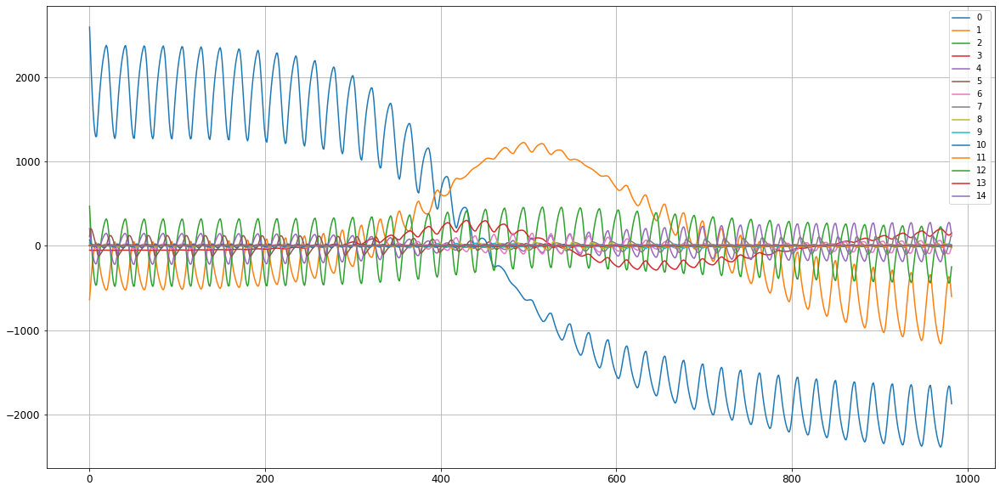

In [4]:
fig, ax = plt.subplots(1,1, figsize=[20,10])
ax.plot(X_train_compressed[:len(times)*1]);
ax.grid()
ax.legend(range(15))

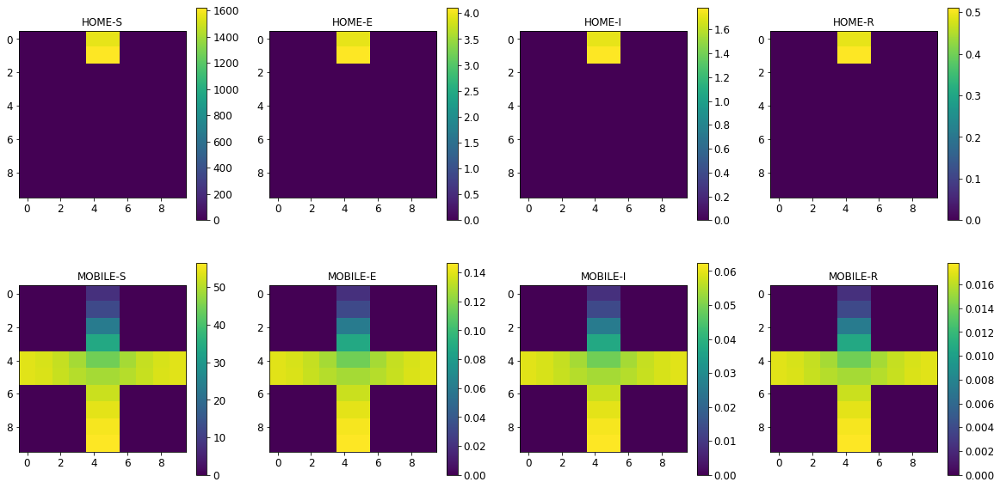

In [5]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_train_1D.reshape(nrun,len(times),len(groups),nl,nc)[0,100,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

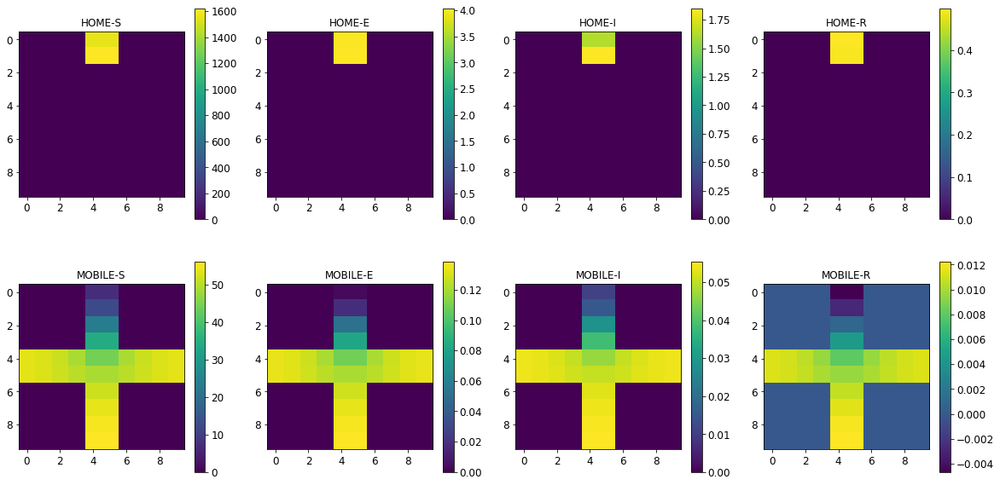

In [6]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_recovered.reshape(nrun,len(times),len(groups),nl,nc)[0,100,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

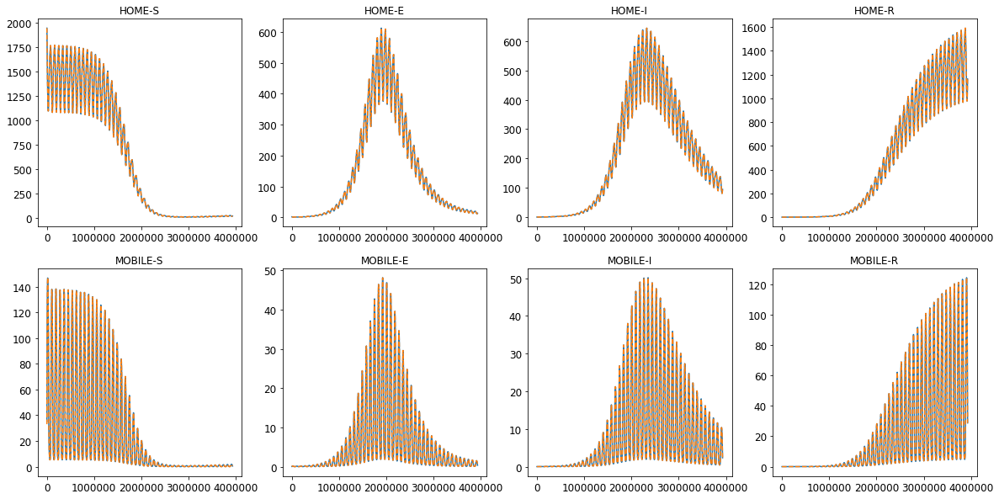

In [7]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(times, X_train_1D.reshape(nrun, len(times),len(groups),nl,nc)[0,:,i,0,4])
    ax.flatten()[i].plot(times, X_recovered.reshape(nrun, len(times),len(groups),nl,nc)[0,:,i,0,4],'--')
    ax.flatten()[i].set_title(group)

## Prepare data

In [8]:
pca_size = X_train_compressed.shape[1]
X_train_compressed.shape

(39320, 15)

In [9]:
X_train_R0s = R0s.repeat(len(times), axis=0)
X_train_R0s.shape

(39320, 2)

In [10]:
X_train_compressedplus = np.concatenate((X_train_compressed, X_train_R0s), axis=1) 
codings_size = X_train_compressedplus.shape[1]
X_train_compressedplus.shape

(39320, 17)

In [11]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler((-1,1))
X_train_scaled = scaler.fit_transform(X_train_compressedplus)
np.allclose(X_train_compressedplus, scaler.inverse_transform(X_train_scaled))

True

In [12]:
def concat_timesteps(X_train, ntimes, step, times):
    X_train_concat = []
    for j in range(len(X_train)//len(times)):
        for i in range(j*len(times), j*len(times)+(len(times)-ntimes*step)):
            X_train_concat.append(X_train[i:i+ntimes*step:step])
    return np.array(X_train_concat)

In [13]:
ntimes = 10 # Consecutive times for the GAN
step = 2 # step between times

X_train_concat = concat_timesteps(X_train_scaled, ntimes, step, times)
#X_train_concat_flatten = X_train_concat.reshape(X_train_concat.shape[0], codings_size*ntimes )

(38520, 10, 17)


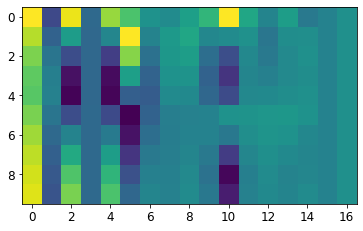

In [14]:
print(X_train_concat.shape)
plt.imshow(X_train_concat[0, :, :])

In [15]:
np.random.seed(42)
tf.random.set_seed(1234)

BATCH_SIZE = 128
latent_space = 100

# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], ntimes, codings_size , 1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_concat))
train_dataset = train_dataset.batch(BATCH_SIZE)
for data in train_dataset:
    print(data)
    break

tf.Tensor(
[[[[ 0.7721959 ]
   [-0.33461073]
   [ 0.26192167]
   ...
   [-0.07557973]
   [ 0.25579125]
   [ 0.10401603]]

  [[ 0.8286563 ]
   [-0.380571  ]
   [ 0.4846424 ]
   ...
   [-0.03660819]
   [ 0.25579125]
   [ 0.10401603]]

  [[ 0.8638956 ]
   [-0.40875682]
   [ 0.6251556 ]
   ...
   [-0.00311662]
   [ 0.25579125]
   [ 0.10401603]]

  ...

  [[ 0.4482724 ]
   [-0.06089072]
   [-0.95986944]
   ...
   [-0.02397341]
   [ 0.25579125]
   [ 0.10401603]]

  [[ 0.47749946]
   [-0.08438924]
   [-0.83158326]
   ...
   [ 0.090842  ]
   [ 0.25579125]
   [ 0.10401603]]

  [[ 0.5945618 ]
   [-0.17984095]
   [-0.36251575]
   ...
   [-0.08684829]
   [ 0.25579125]
   [ 0.10401603]]]


 [[[ 0.8833958 ]
   [-0.44594896]
   [ 0.5330885 ]
   ...
   [-0.03875915]
   [-0.10111754]
   [ 0.00999323]]

  [[ 0.77767324]
   [-0.3560126 ]
   [ 0.13200502]
   ...
   [-0.05539494]
   [-0.10111754]
   [ 0.00999323]]

  [[ 0.64117473]
   [-0.24013133]
   [-0.37952563]
   ...
   [-0.05919233]
   [-0.10111754]


## Train the GAN

In [16]:
init = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

In [17]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(keras.layers.Dense(5*5*256, use_bias=False, kernel_initializer=init, input_shape=(latent_space,)))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Reshape((5, 5, 256)))

    model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', kernel_initializer=init, use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(1, 2), padding='same', output_padding=[0,0], kernel_initializer=init, use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', output_padding=[1,0], kernel_initializer=init, use_bias=False, activation='tanh'))

    return model

In [18]:
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 6400)              640000    
_________________________________________________________________
batch_normalization (BatchNo (None, 6400)              25600     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 6400)              0         
_________________________________________________________________
reshape (Reshape)            (None, 5, 5, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 5, 5, 128)         294912    
_________________________________________________________________
batch_normalization_1 (Batch (None, 5, 5, 128)         512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 5, 5, 128)         0

(1, 10, 17, 1)


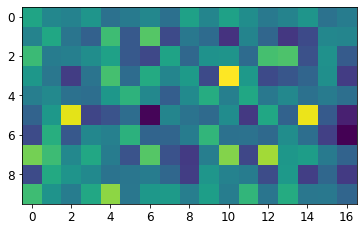

In [19]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)
plt.imshow(generated_image[0, :, :, 0])

In [20]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', kernel_initializer=init, input_shape=[10, 17, 1]))
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Conv2D(128, (3, 3), strides=(1, 2), padding='same', kernel_initializer=init))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(1, kernel_initializer=init))

    return model

In [21]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 5, 9, 64)          1664      
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 5, 9, 64)          0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 5, 5, 128)         73856     
_________________________________________________________________
batch_normalization_3 (Batch (None, 5, 5, 128)         512       
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 5, 5, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 3200)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                

In [22]:
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[1.7734892e-05]], shape=(1, 1), dtype=float32)


In [23]:
gan = keras.models.Sequential([generator, discriminator])

In [24]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

In [25]:
# The discriminator and the generator optimizers are different since we will train two networks separately.
generator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)

In [26]:
# We will reuse this seed overtime 
num_examples_to_generate = 5
seed = tf.random.normal([num_examples_to_generate, latent_space])

In [27]:
# logs to follow losses on tensorboard
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
print(current_time)
generator_log_dir = './logs/'+current_time+'/generator-dcgan'
discriminator_log_dir = './logs/'+current_time+'/discriminator-dcgan'

generator_summary_writer = tf.summary.create_file_writer(generator_log_dir)
discriminator_summary_writer = tf.summary.create_file_writer(discriminator_log_dir)

20220303-140419


In [28]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)


In [29]:
# calculate the kl divergence for independente variables
def kl_divergence(p, q):
    return sum(p[i] * math.log2(p[i]/q[i]) for i in range(len(p)) if p[i]!=0.0)
 
# calculate the js divergence for independente variables
def js_divergence(p, q):
    m = 0.5 * (p + q)
    return 0.5 * kl_divergence(p, m) + 0.5 * kl_divergence(q, m)

# calculate the BC divergence for independente variables
def bc_divergence(p, q):
    return sum(math.sqrt(p[i]*q[i]) for i in range(len(p)))

# calculate the kl divergence for multivariate variables
def KLdivergence(x, y):
    """Compute the Kullback-Leibler divergence between two multivariate samples.
    Parameters
    ----------
    x : 2D array (n,d)
    Samples from distribution P, which typically represents the true
    distribution.
    y : 2D array (m,d)
    Samples from distribution Q, which typically represents the approximate
    distribution.
    Returns
    -------
    out : float
    The estimated Kullback-Leibler divergence D(P||Q).
    References
    ----------
    Pérez-Cruz, F. Kullback-Leibler divergence estimation of
    continuous distributions IEEE International Symposium on Information
    Theory, 2008.
    """
    from scipy.spatial import cKDTree as KDTree

    # Check the dimensions are consistent
    x = np.atleast_2d(x)
    y = np.atleast_2d(y)

    n,d = x.shape
    m,dy = y.shape

    assert(d == dy)


    # Build a KD tree representation of the samples and find the nearest neighbour
    # of each point in x.
    xtree = KDTree(x)
    ytree = KDTree(y)

    # Get the first two nearest neighbours for x, since the closest one is the
    # sample itself.
    r = xtree.query(x, k=2, eps=.01, p=2)[0][:,1]
    s = ytree.query(x, k=1, eps=.01, p=2)[0]

    # There is a mistake in the paper. In Eq. 14, the right side misses a negative sign
    # on the first term of the right hand side.
    return -np.log(r/s).sum() * d / n + np.log(m / (n - 1.))

In [30]:
def train(dataset, epochs, model_name, start=0):
    hist, scores, weighted_scores, kl_score = [], [], [], [] # Only to print anplot results
    for epoch in range(start, start+epochs):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        with generator_summary_writer.as_default():
            tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        with discriminator_summary_writer.as_default():
            tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        
        print("discriminator", "{}: {:.6f}".format(discriminator.metrics_names[0], hist[-1][1]), end=' - ')
        print("generator", "{}: {:.6f}".format(gan.metrics_names[0], hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        # Print GAN outputs and scores
        if epoch%200 == 0: 
            # Plot generated data
            X_generated = scaler.inverse_transform(generator.predict(seed).reshape(num_examples_to_generate*ntimes,codings_size))
            R0_generated = X_generated[:,pca_size:]
            X_generated = pca_compress.inverse_transform(X_generated[:,:pca_size])
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, len(groups)*nl*nc)
            fig, ax = plt.subplots(num_examples_to_generate*2,len(groups), figsize=[20,num_examples_to_generate*5])
            for j in range(num_examples_to_generate):
                for i, group in enumerate(groups):
                    for k in range(0,10,10): 
                        ax.flatten()[i+2*j*len(groups)].plot(X_generated[j][:,i*nl*nc+4+10*k], '-')
                for i, group in enumerate(groups):
                    im = ax.flatten()[i+(2*j+1)*len(groups)].imshow(X_generated[j].reshape(ntimes,len(groups),nl,nc)[4,i,:,:])
                    fig.colorbar(im, ax=ax.flatten()[i+(2*j+1)*len(groups)])
            plt.show()
            
            print()
            print('R0 generated:')
            print(R0_generated)
            print()
                    
            # Save model
            gan.save('ganmodels/'+model_name+'_'+str(epoch)+'.h5')    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
            
            # mean/std real 
            means_real = np.mean(X_train_concat, axis=1)
            std_real = np.std(X_train_concat, axis=1)
            #reshaped_real = X_train_concat.reshape(-1,17)

            # mean/std generated
            noise = tf.random.normal([X_train_concat.shape[0], latent_space])
            generated_image = generator(noise, training=False)
            means_gen = np.mean(generated_image, axis=1) 
            std_gen = np.std(generated_image, axis=1) 
            #reshaped_gen = generated_image.numpy().reshape(-1,17)

            n_bins = 100
            kl, js, bc = [], [], []
            count = 0
            cols = range(17)
            #fig, axes = plt.subplots(len(cols), 2, figsize=(20,5*len(cols)))    
            for col in cols:

                fig, axes = plt.subplots(1, 2, figsize=(20,5))  

                # MEAN
                # Histogram min and max and number of bins
                bin_width = 0.01
                h_min = np.min([means_gen[:,col,0],means_real[:,col]])
                h_max = np.max([means_gen[:,col,0],means_real[:,col]])
                #n_bins = math.ceil((h_max - h_min)/bin_width)


                # Plot mean histogram
                n_real, bins, patches = axes[0].hist(means_real[:,col], bins = n_bins, alpha = 0.8, 
                                              label = 'real_means_PCA_'+ str(col),
                                              range = (h_min, h_max))

                n_gen, bins, patches = axes[0].hist(means_gen[:,col,0], bins = n_bins, alpha =0.8, 
                                              label = 'gen_means_PCA_' + str(col),
                                              range = (h_min, h_max))
                axes[0].legend()

                kl_mean = kl_divergence(n_real/sum(n_real), n_gen/sum(n_gen))
                js_mean = js_divergence(n_real/sum(n_real), n_gen/sum(n_gen))
                bc_mean = bc_divergence(n_real/sum(n_real), n_gen/sum(n_gen))
                print(f'{col}: mean KL divergence (r,g) = {kl_mean}')
                print(f'{col}: mean JS divergence = {js_mean}')
                print(f'{col}: mean 1-BC divergence = {1-bc_mean}')

                # STD
                # Histogram min and max and number of bins
                bin_width = 0.003
                h_min = np.min([std_gen[:,col,0],std_real[:,col]])
                h_max = np.max([std_gen[:,col,0],std_real[:,col]])
                #n_bins = math.ceil((h_max - h_min)/bin_width)

                # Plot std histogram
                n_real, bins, patches = axes[1].hist(std_real[:,col], bins = n_bins, alpha = 0.8, 
                                              label = 'real_std_PCA_'+ str(col),
                                              range = (h_min, h_max))

                n_gen, bins, patches = axes[1].hist(std_gen[:,col,0], bins = n_bins, alpha =0.8, 
                                              label = 'gen_std_PCA_' + str(col),
                                              range = (h_min, h_max))
                axes[1].legend()    

                kl_std = kl_divergence(n_real/sum(n_real), n_gen/sum(n_gen))
                js_std = js_divergence(n_real/sum(n_real), n_gen/sum(n_gen))
                bc_std = bc_divergence(n_real/sum(n_real), n_gen/sum(n_gen))
                print(f'\n{col}: std KL divergence (r,g) = {kl_std}')
                print(f'{col}: std JS divergence = {js_std}')
                print(f'{col}: std 1-BC divergence = {1-bc_std}')

                # SUM
                if (col < 15):
                    kl.append((kl_mean + kl_std)/2)
                    js.append((js_mean + js_std)/2)
                    bc.append((bc_mean + bc_std)/2)
                    count += 1


                # Histogram min and max and number of bins
            #     bin_width = 0.01
            #     h_min = np.min([reshaped_gen[:,col],reshaped_real[:,col]])
            #     h_max = np.max([reshaped_gen[:,col],reshaped_real[:,col]])
            #     n_bins = math.ceil((h_max - h_min)/bin_width)

            #     # Plot std histogram
            #     n_real, bins, patches = axes[2].hist(reshaped_real[:,col], bins = n_bins, alpha = 0.8, 
            #                                   label = 'real_std_PCA_'+ str(col),
            #                                   range = (h_min, h_max))

            #     n_gen, bins, patches = axes[2].hist(reshaped_gen[:,col], bins = n_bins, alpha =0.8, 
            #                                   label = 'gen_std_PCA_' + str(col),
            #                                   range = (h_min, h_max))
            #     axes[i,2].legend()    
            #     print(f'{col}: KL divergence (r,g) = {kl_divergence(n_real/sum(n_real), n_gen/sum(n_gen))}')
            #     print(f'{col}: JS divergence = {js_divergence(n_real/sum(n_real), n_gen/sum(n_gen))}')
            #     print(f'{col}: BC divergence = {bc_divergence(n_real/sum(n_real), n_gen/sum(n_gen))}')
            #     print()

                plt.show()

            # Print and plot scores    
            fig, axes = plt.subplots(3,1, figsize=[20,15])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            #ax.set_yscale('log')
            ax.grid()   
                
            scores.append([sum(kl)/count,
                           sum(js)/count,
                           1-sum(bc)/count])
            print('\n\n--------------------------------------------------------\n')
            print(f'Compose KL divergence (r,g) = {scores[-1][0]}')
            print(f'Compose JS divergence = {scores[-1][1]}')
            print(f'Compose 1-BC divergence = {scores[-1][2]}')
            print()
            axes[0].plot(scores)
            axes[0].legend(['Compose KL', 'Compose JS', '1-Compose BC'])
            axes[0].grid()
            
            weight = pca_compress.singular_values_/np.sum(pca_compress.singular_values_)
            weighted_scores.append([sum(np.array(kl)*weight),
                                    sum(np.array(js)*weight),
                                    1-sum(np.array(bc)*weight)])
            print(f'Compose weighted KL divergence (r,g) = {weighted_scores[-1][0]}')
            print(f'Compose weighted JS divergence = {weighted_scores[-1][1]}')
            print(f'Compose weighted 1-BC divergence = {weighted_scores[-1][2]}')
            print()   
            axes[1].plot(weighted_scores)
            axes[1].legend(['Compose weighted KL', 'Compose weighted JS', '1-Compose weighted BC'])
            axes[1].grid()
            
            kl_score.append(KLdivergence(X_train_concat.reshape(X_train_concat.shape[0],-1), generated_image.numpy().reshape(X_train_concat.shape[0],-1)))
            print('Multivariate KL divergence =', kl_score[-1])
            axes[2].plot(kl_score)
            axes[2].legend(['Multivariate KL divergence'])
            axes[2].grid()
            
            plt.show()

    # Save model
    gan.save('ganmodels/'+model_name+'_'+str(epoch)+'.h5')          
    return hist


Epoch 1/10000
discriminator loss: 0.839300 - generator loss: 1.120111 - 21s


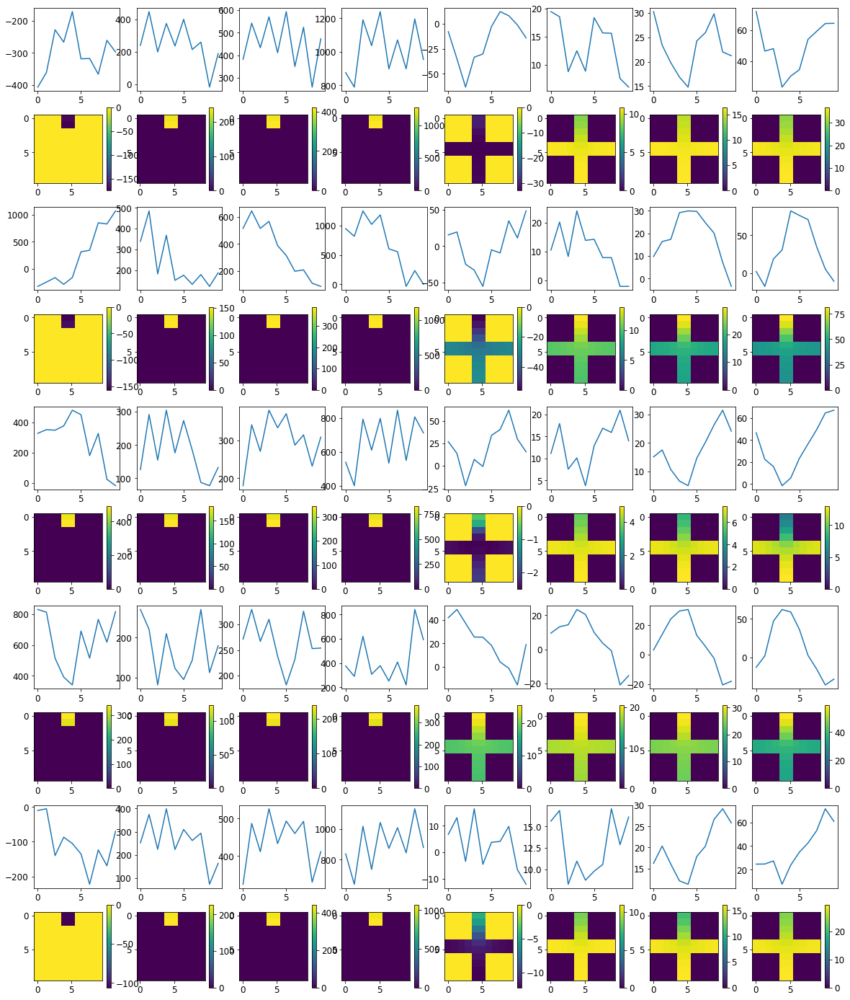


R0 generated:
[[13.761559   10.480271  ]
 [12.407589   15.65972   ]
 [12.046391   15.236199  ]
 [12.318095   16.625708  ]
 [11.090187   14.413618  ]
 [11.602262   16.354645  ]
 [12.022782   13.774815  ]
 [10.601971   15.498356  ]
 [10.717054   13.322927  ]
 [10.535797   14.476343  ]
 [ 9.387669   10.060189  ]
 [ 9.64997    12.447023  ]
 [ 6.163676   11.609559  ]
 [ 7.073188   15.078989  ]
 [ 6.6601524  10.023583  ]
 [ 7.8614693  13.360742  ]
 [ 6.2224755   9.5479    ]
 [ 4.3939967  13.076459  ]
 [ 4.93713     9.463367  ]
 [ 5.88578    10.8365    ]
 [ 4.061585    3.9569519 ]
 [ 3.469068    5.0271983 ]
 [ 1.3466244   2.2590508 ]
 [ 1.9131758   5.146479  ]
 [ 1.5789894   2.278155  ]
 [ 1.9615674   5.923288  ]
 [ 1.9952533   3.1767817 ]
 [ 1.7132596   6.500179  ]
 [ 2.1291397   5.250468  ]
 [ 3.2675178   7.169378  ]
 [11.953028   10.953667  ]
 [10.7159395  13.669144  ]
 [10.403515   14.724973  ]
 [ 9.801409   16.581446  ]
 [10.992738   13.779543  ]
 [11.790473   16.222416  ]
 [11.469528  

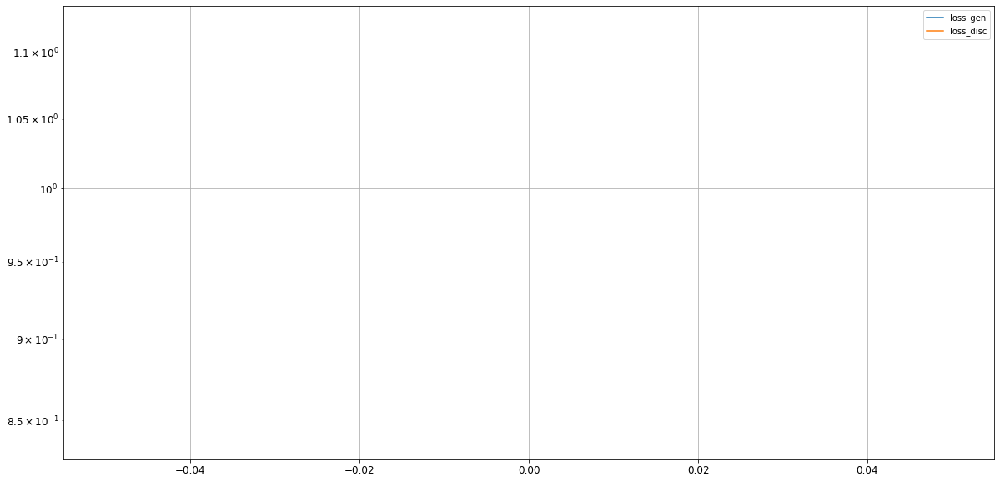

0: mean KL divergence (r,g) = 1.117665694483469
0: mean JS divergence = 0.2570972475551794
0: mean 1-BC divergence = 0.2174483384800645

0: std KL divergence (r,g) = 1.2772523656787502
0: std JS divergence = 0.35961083154410434
0: std 1-BC divergence = 0.32770090185410317


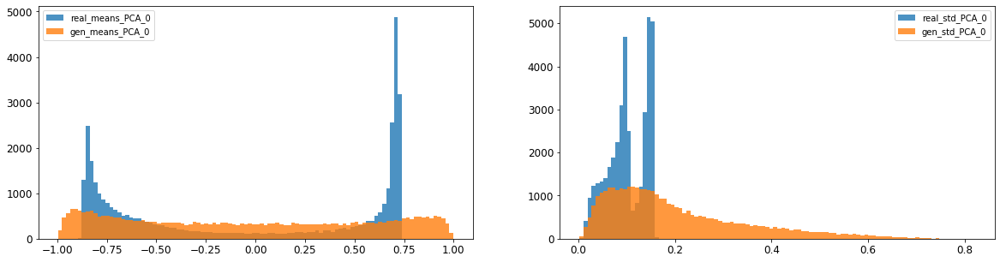

/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


1: mean KL divergence (r,g) = inf
1: mean JS divergence = 0.42422132621046177
1: mean 1-BC divergence = 0.35044054029758254

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.6196743016586077
1: std 1-BC divergence = 0.5643943721915607


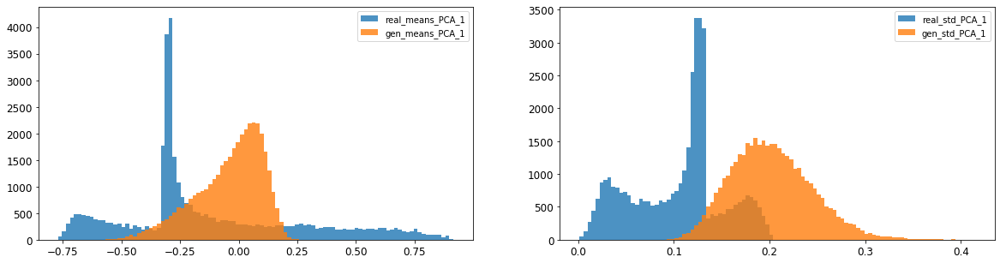

2: mean KL divergence (r,g) = inf
2: mean JS divergence = 0.48470511080362433
2: mean 1-BC divergence = 0.41662415613549963

2: std KL divergence (r,g) = 2.9432112678759688
2: std JS divergence = 0.6830953637385262
2: std 1-BC divergence = 0.6173426556304522


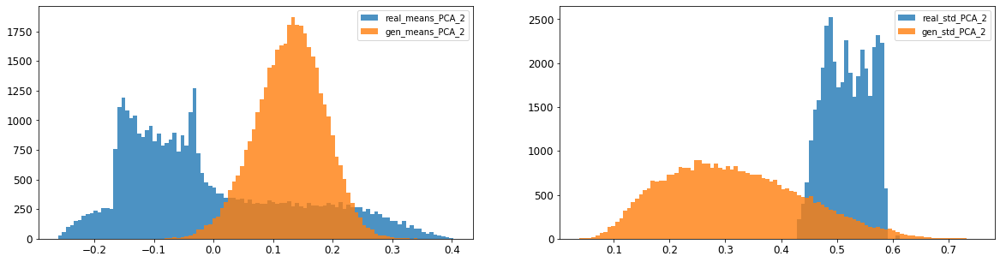

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.3498109262339484
3: mean 1-BC divergence = 0.3071902628657912

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.699065134098652
3: std 1-BC divergence = 0.6244992748286452


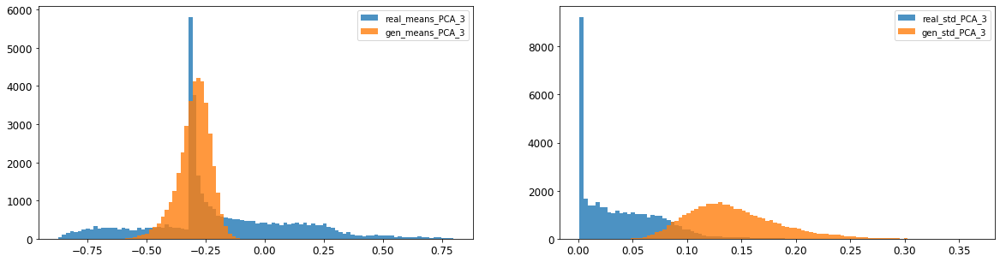

4: mean KL divergence (r,g) = 0.7461975750609068
4: mean JS divergence = 0.21680097187582942
4: mean 1-BC divergence = 0.19849099905537493

4: std KL divergence (r,g) = inf
4: std JS divergence = 0.3960614961877089
4: std 1-BC divergence = 0.3109141944240933


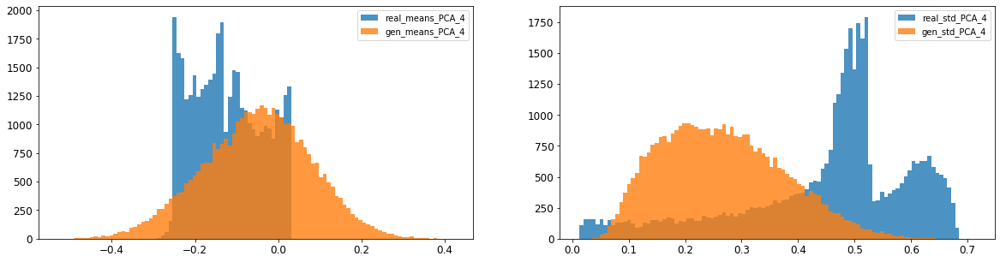

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.8628454538979897
5: mean 1-BC divergence = 0.8044248257440911

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.5935714388309997
5: std 1-BC divergence = 0.48618070560593574


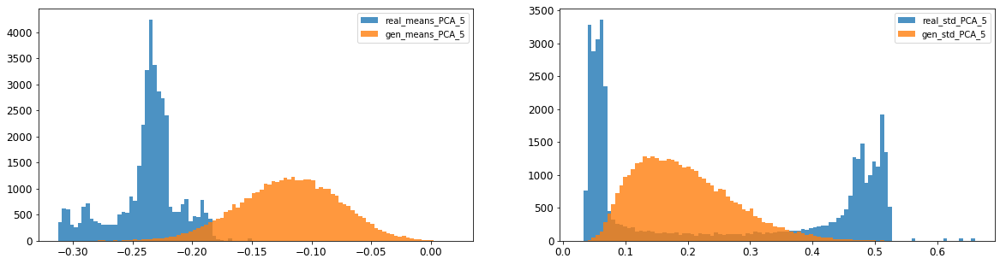

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.6310481244846229
6: mean 1-BC divergence = 0.5313768981959647

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.30551269481964716
6: std 1-BC divergence = 0.2616023044415269


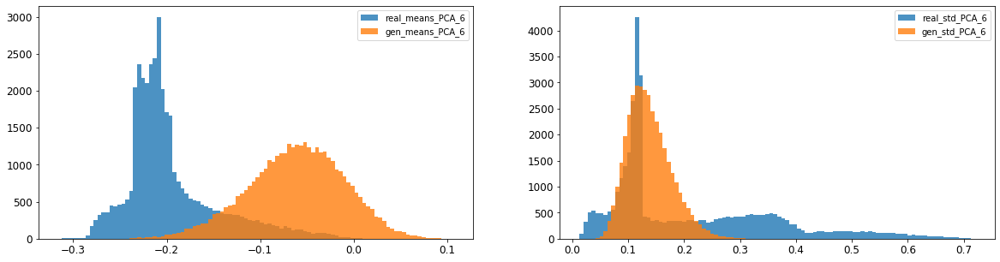

7: mean KL divergence (r,g) = 2.143013621314373
7: mean JS divergence = 0.5074340104893889
7: mean 1-BC divergence = 0.45771929446995085

7: std KL divergence (r,g) = inf
7: std JS divergence = 0.5644871435683021
7: std 1-BC divergence = 0.4683395775650865


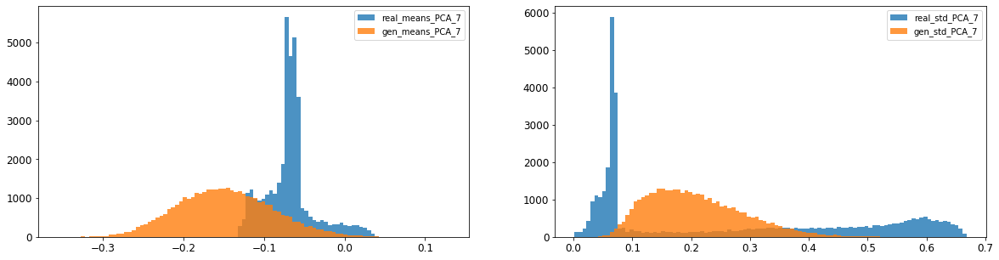

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.5091539693186726
8: mean 1-BC divergence = 0.4074186064817704

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.35827463691379846
8: std 1-BC divergence = 0.2903276222182407


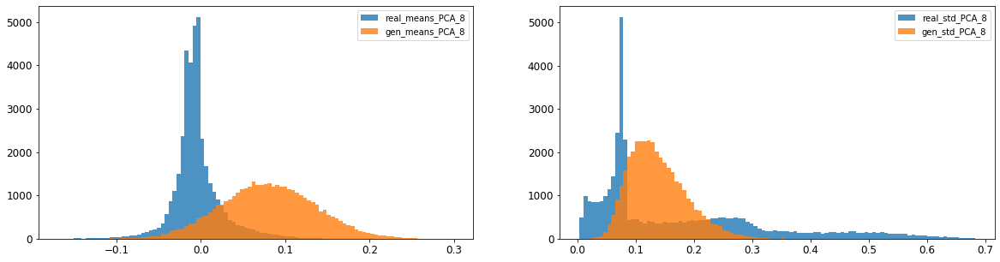

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.29924278562208984
9: mean 1-BC divergence = 0.2245876124776558

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.2722341772700152
9: std 1-BC divergence = 0.24382727248459224


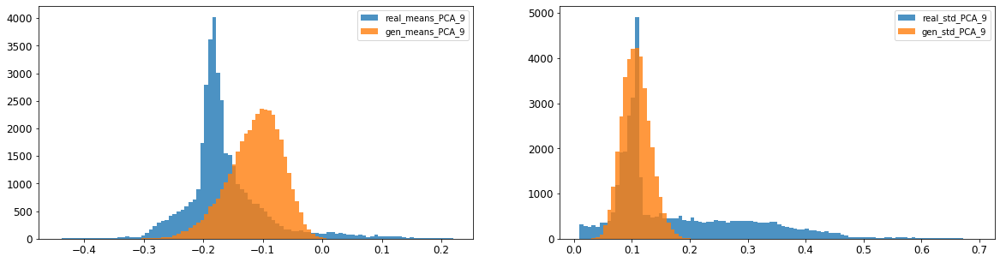

10: mean KL divergence (r,g) = 4.114946210062538
10: mean JS divergence = 0.781211141164796
10: mean 1-BC divergence = 0.6995365302815387

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.47545824788519686
10: std 1-BC divergence = 0.4043662981617452


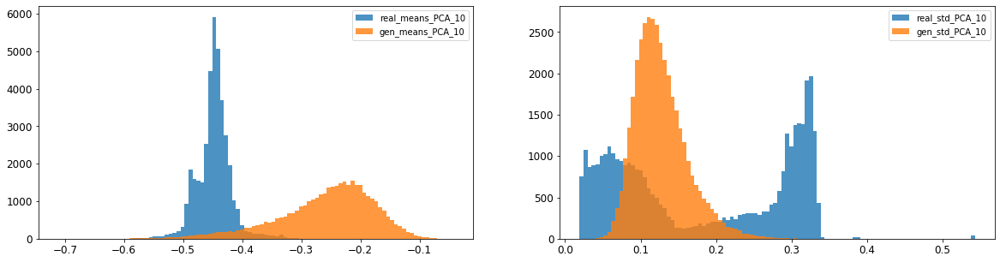

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.6654973599944967
11: mean 1-BC divergence = 0.5829828574201797

11: std KL divergence (r,g) = inf
11: std JS divergence = 0.7653455088910514
11: std 1-BC divergence = 0.6768319914818477


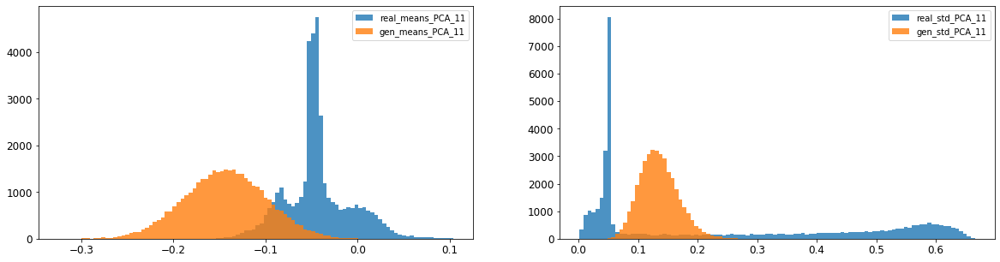

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.15318597480224055
12: mean 1-BC divergence = 0.11050788712602355

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.44490621849689194
12: std 1-BC divergence = 0.35979425827784217


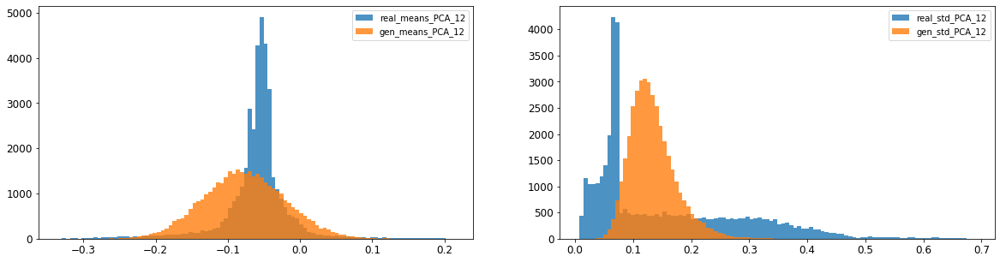

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.295997045186018
13: mean 1-BC divergence = 0.22526643138562985

13: std KL divergence (r,g) = inf
13: std JS divergence = 0.5333370603808121
13: std 1-BC divergence = 0.4480536503099215


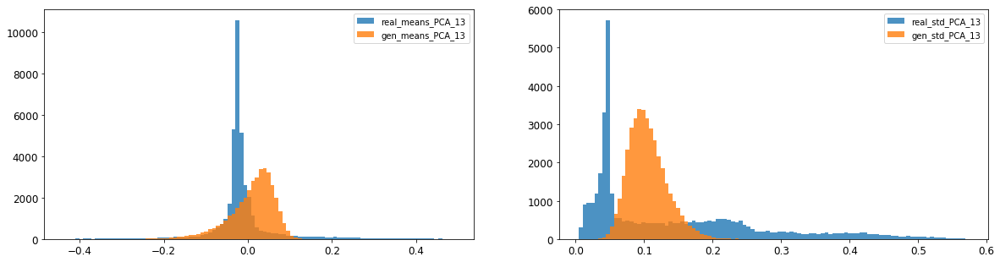

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.669671017539895
14: mean 1-BC divergence = 0.5472534173471867

14: std KL divergence (r,g) = inf
14: std JS divergence = 0.4574002094111176
14: std 1-BC divergence = 0.38949539275595835


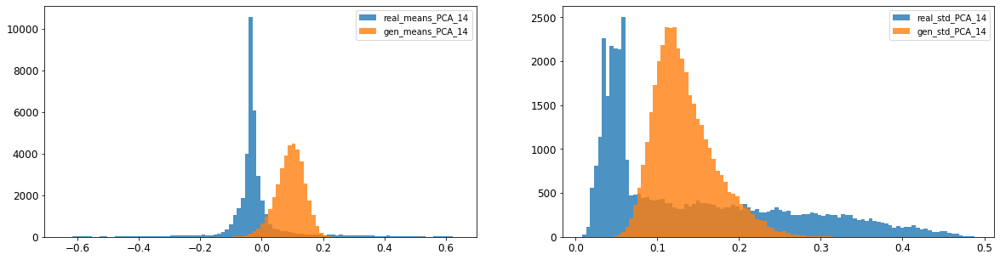

15: mean KL divergence (r,g) = 1.9967629638090971
15: mean JS divergence = 0.5159733926122928
15: mean 1-BC divergence = 0.47212902114941824

15: std KL divergence (r,g) = inf
15: std JS divergence = 1.0
15: std 1-BC divergence = 1.0


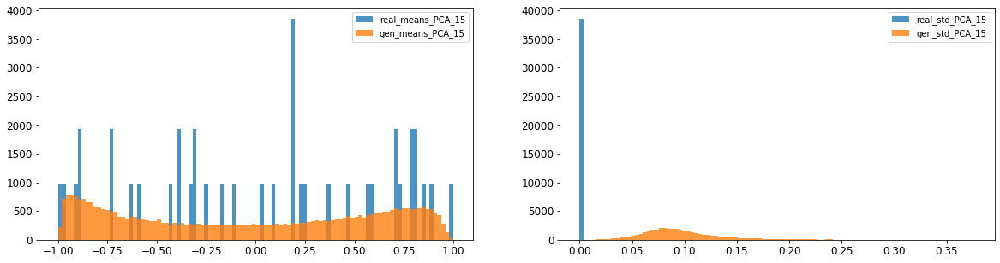

16: mean KL divergence (r,g) = 1.9225537417524095
16: mean JS divergence = 0.473434867296904
16: mean 1-BC divergence = 0.4331076626286786

16: std KL divergence (r,g) = 15.233320082730822
16: std JS divergence = 0.9997835405782707
16: std 1-BC divergence = 0.9949048513290355


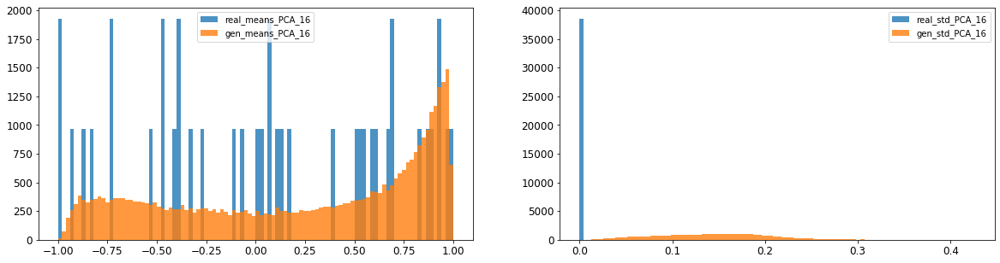



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.48786523096248946
Compose 1-BC divergence = 0.41849797099986175

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.4022384779262143
Compose weighted 1-BC divergence = 0.3535932705470355

Multivariate KL divergence = 420.15836164182224


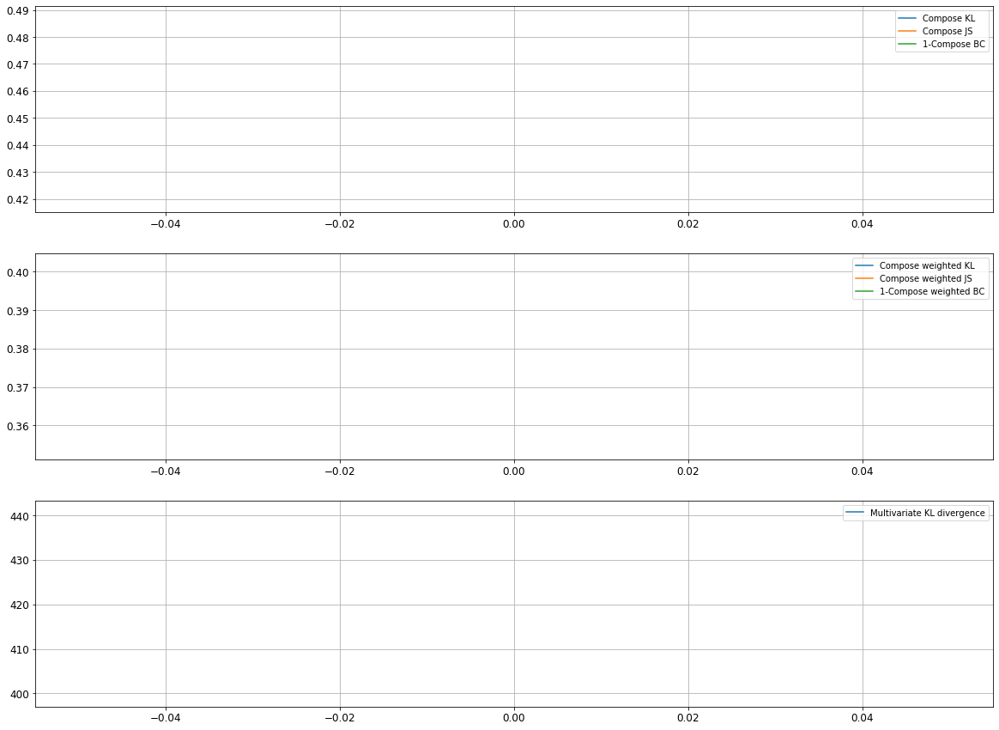

Epoch 2/10000
discriminator loss: 0.831783 - generator loss: 1.187297 - 19s
Epoch 3/10000
discriminator loss: 0.632766 - generator loss: 1.487567 - 23s
Epoch 4/10000
discriminator loss: 0.485820 - generator loss: 1.888608 - 23s
Epoch 5/10000
discriminator loss: 0.491274 - generator loss: 1.971481 - 24s
Epoch 6/10000
discriminator loss: 0.512236 - generator loss: 1.985124 - 26s
Epoch 7/10000
discriminator loss: 0.475995 - generator loss: 2.092999 - 28s
Epoch 8/10000
discriminator loss: 0.450576 - generator loss: 2.180826 - 30s
Epoch 9/10000
discriminator loss: 0.448022 - generator loss: 2.266796 - 29s
Epoch 10/10000
discriminator loss: 0.458284 - generator loss: 2.280022 - 29s
Epoch 11/10000
discriminator loss: 0.464798 - generator loss: 2.262605 - 28s
Epoch 12/10000
discriminator loss: 0.469033 - generator loss: 2.236720 - 31s
Epoch 13/10000
discriminator loss: 0.475509 - generator loss: 2.250368 - 30s
Epoch 14/10000
discriminator loss: 0.469322 - generator loss: 2.245698 - 30s
Epoch 1

discriminator loss: 0.412010 - generator loss: 3.436641 - 37s
Epoch 110/10000
discriminator loss: 0.312623 - generator loss: 3.555564 - 35s
Epoch 111/10000
discriminator loss: 0.319551 - generator loss: 3.605748 - 36s
Epoch 112/10000
discriminator loss: 0.239481 - generator loss: 3.667745 - 32s
Epoch 113/10000
discriminator loss: 0.374823 - generator loss: 3.501930 - 33s
Epoch 114/10000
discriminator loss: 0.236019 - generator loss: 3.703454 - 34s
Epoch 115/10000
discriminator loss: 0.369391 - generator loss: 3.518641 - 37s
Epoch 116/10000
discriminator loss: 0.342369 - generator loss: 3.636613 - 36s
Epoch 117/10000
discriminator loss: 0.359118 - generator loss: 3.588864 - 35s
Epoch 118/10000
discriminator loss: 0.309262 - generator loss: 3.630541 - 37s
Epoch 119/10000
discriminator loss: 0.240824 - generator loss: 3.754135 - 34s
Epoch 120/10000
discriminator loss: 0.371573 - generator loss: 3.607861 - 35s
Epoch 121/10000
discriminator loss: 0.380235 - generator loss: 3.587886 - 36s
Ep

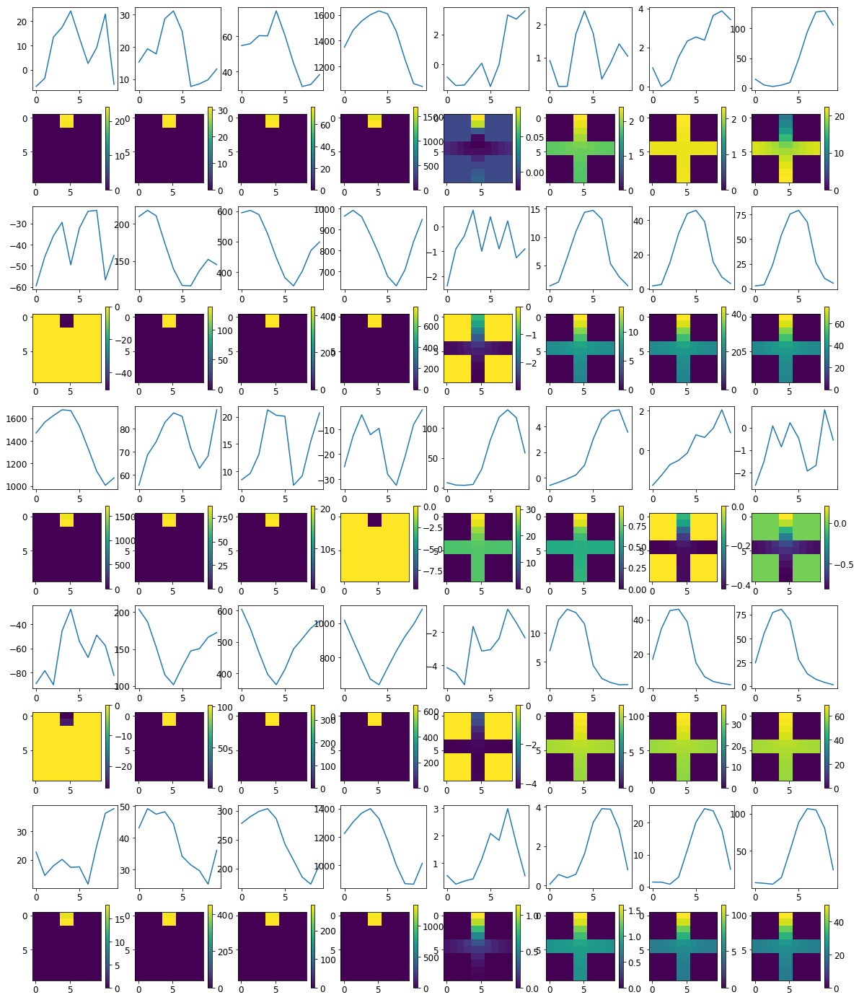


R0 generated:
[[19.844019   19.62852   ]
 [19.845387   19.630455  ]
 [19.858696   19.600946  ]
 [19.867275   19.581005  ]
 [19.871304   19.571032  ]
 [19.870888   19.57081   ]
 [19.872562   19.5744    ]
 [19.872906   19.59762   ]
 [19.858109   19.609257  ]
 [19.837059   19.609869  ]
 [16.805746    1.1925989 ]
 [16.785769    1.3877538 ]
 [16.773327    1.3987757 ]
 [16.812859    1.4816397 ]
 [16.834784    1.5279037 ]
 [16.793901    1.4177889 ]
 [16.918028    1.4114285 ]
 [16.89902     1.4285314 ]
 [16.931635    1.4941828 ]
 [16.904886    1.4853494 ]
 [16.052324    6.612912  ]
 [16.2751      6.418868  ]
 [16.248701    6.2154512 ]
 [16.156849    6.209469  ]
 [16.2458      6.3202157 ]
 [16.32051     6.25896   ]
 [16.33566     6.330322  ]
 [16.218607    6.2687387 ]
 [16.218681    6.241501  ]
 [16.164867    6.2893486 ]
 [19.797728   17.052267  ]
 [19.801262   16.874256  ]
 [19.798775   16.986786  ]
 [19.7981     17.130459  ]
 [19.797522   17.257162  ]
 [19.800713   17.173233  ]
 [19.787933  

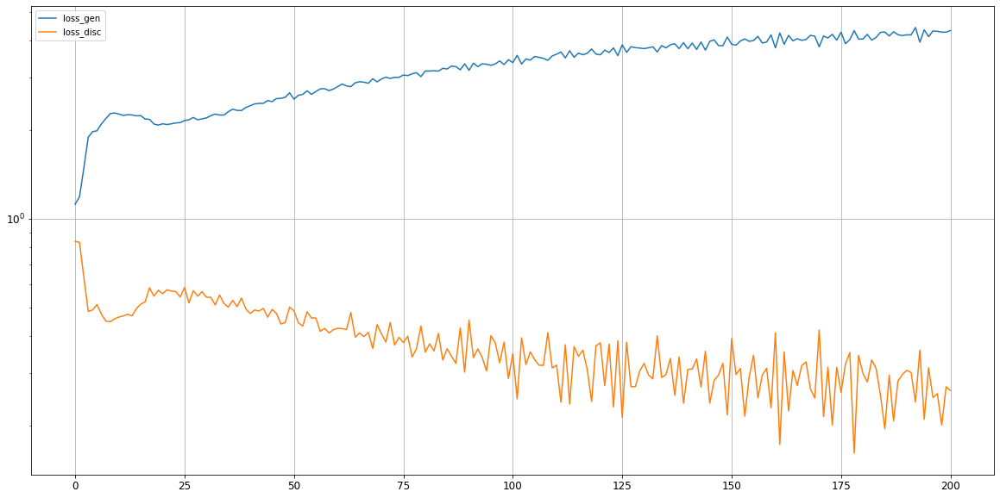

0: mean KL divergence (r,g) = 0.14738574744232988
0: mean JS divergence = 0.03960630308797709
0: mean 1-BC divergence = 0.03169750264125715

0: std KL divergence (r,g) = 0.08679880661440052
0: std JS divergence = 0.02613308066059357
0: std 1-BC divergence = 0.02322585234847452


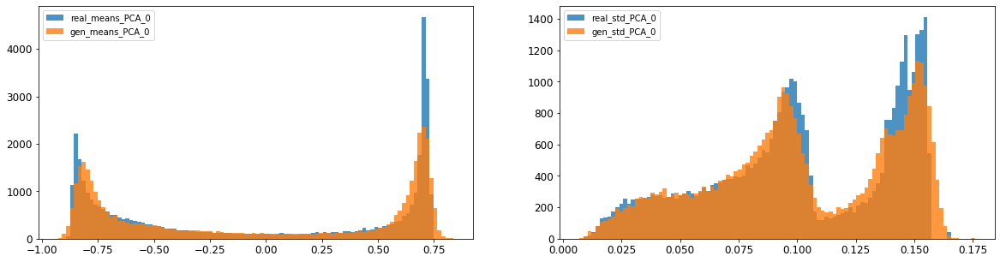

1: mean KL divergence (r,g) = 0.07937562534519985
1: mean JS divergence = 0.020026420039665337
1: mean 1-BC divergence = 0.014521151489709339

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.021859468552895243
1: std 1-BC divergence = 0.01585133859614274


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


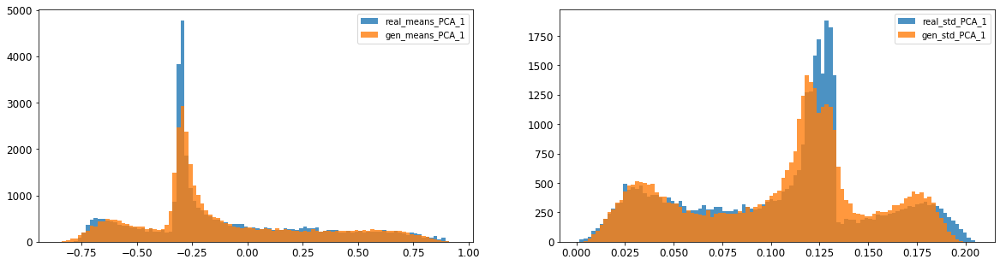

2: mean KL divergence (r,g) = 0.02422947332368483
2: mean JS divergence = 0.006113977457906906
2: mean 1-BC divergence = 0.004526128097844362

2: std KL divergence (r,g) = 0.06699699032426135
2: std JS divergence = 0.01977532460086678
2: std 1-BC divergence = 0.01711004383472392


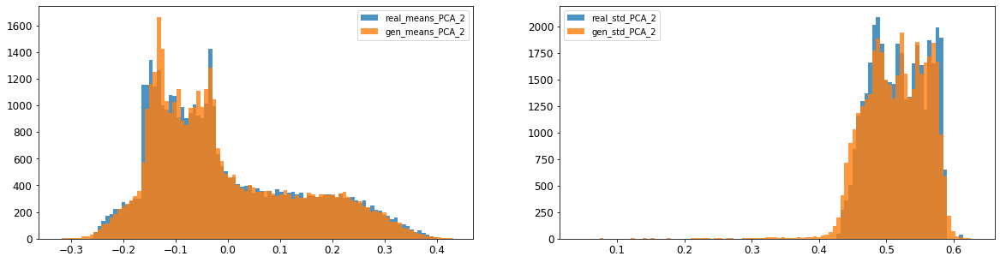

3: mean KL divergence (r,g) = 0.2006717243222604
3: mean JS divergence = 0.04732477047591032
3: mean 1-BC divergence = 0.0338689212396146

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.14260678472594157
3: std 1-BC divergence = 0.12219865407991393


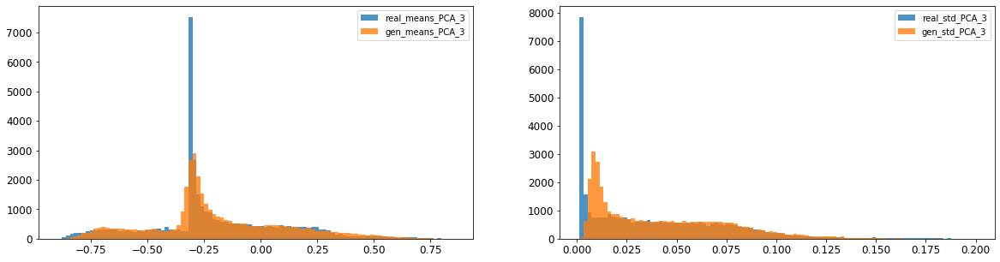

4: mean KL divergence (r,g) = 0.054431533745686364
4: mean JS divergence = 0.01379537656093156
4: mean 1-BC divergence = 0.010752928328889966

4: std KL divergence (r,g) = 0.04259602577100432
4: std JS divergence = 0.010325971214316929
4: std 1-BC divergence = 0.0073969279846402


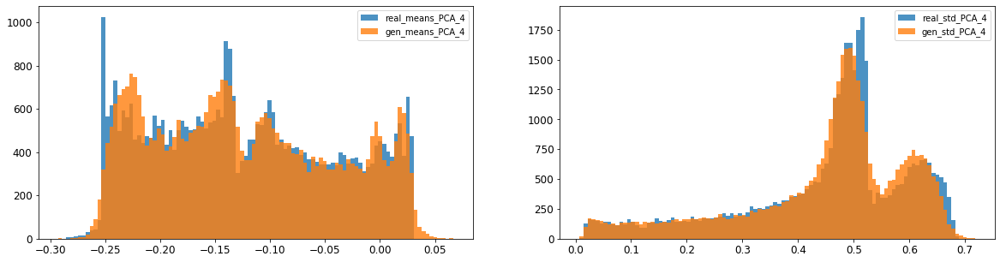

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.04125806711872397
5: mean 1-BC divergence = 0.029982240092949697

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.034728637954947385
5: std 1-BC divergence = 0.030482311428581044


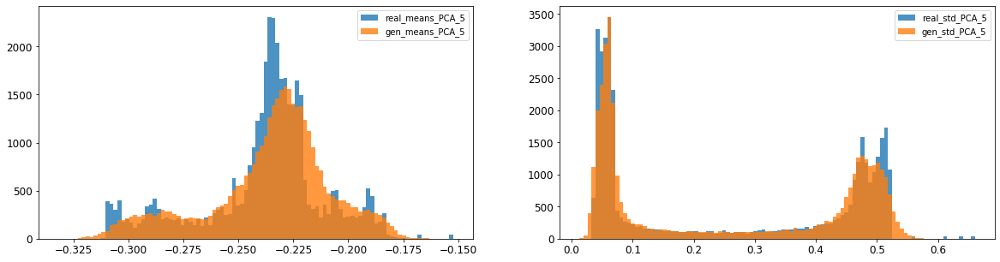

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.017215879133926328
6: mean 1-BC divergence = 0.0126383711495629

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.027965081141735935
6: std 1-BC divergence = 0.019801432994221657


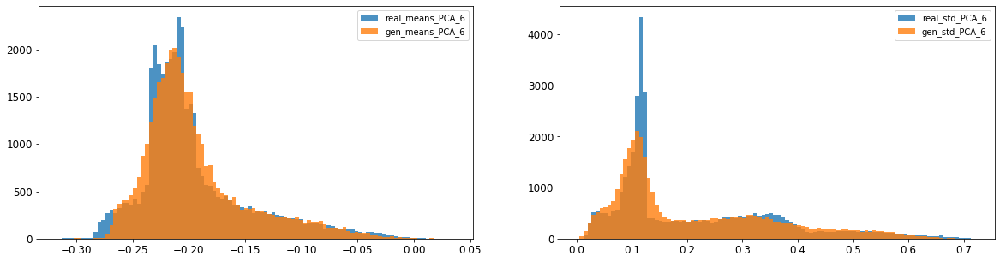

7: mean KL divergence (r,g) = 0.12580045756387498
7: mean JS divergence = 0.03144238276826196
7: mean 1-BC divergence = 0.024106904353023872

7: std KL divergence (r,g) = 0.14847109182149007
7: std JS divergence = 0.037260921329750146
7: std 1-BC divergence = 0.026937028433438814


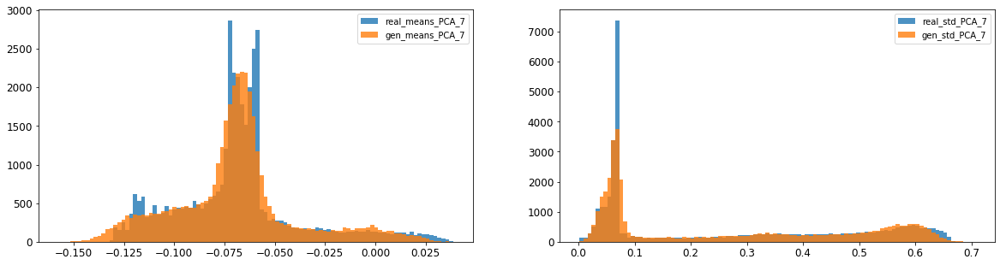

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.01616714988690677
8: mean 1-BC divergence = 0.011526305656216818

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.03162265757516096
8: std 1-BC divergence = 0.022367203944876568


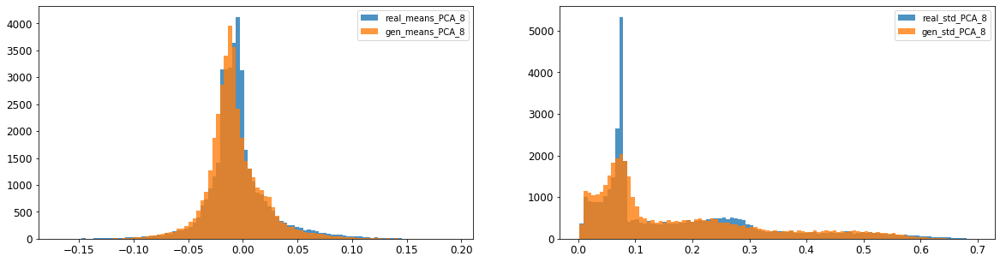

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.008528538470408952
9: mean 1-BC divergence = 0.0061830779404604685

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.019023323116787706
9: std 1-BC divergence = 0.013518558527852553


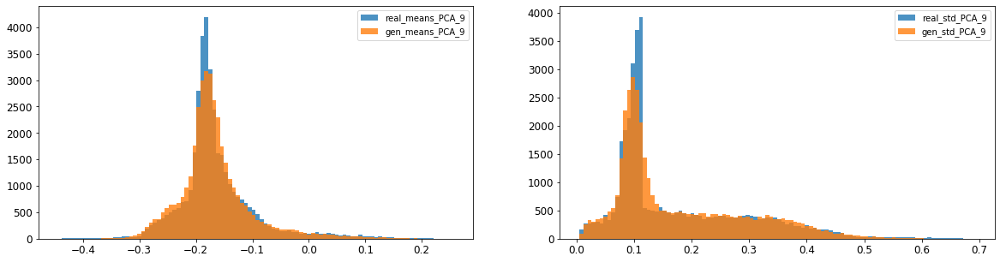

10: mean KL divergence (r,g) = 0.06565323225765594
10: mean JS divergence = 0.015992481036268505
10: mean 1-BC divergence = 0.01127317157736385

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.014159270352999924
10: std 1-BC divergence = 0.012077889214283988


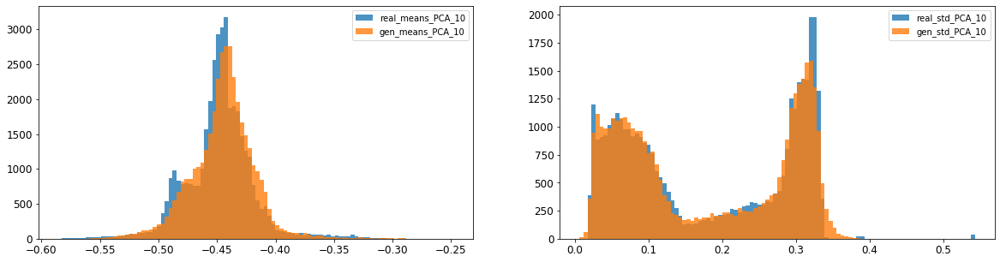

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.01638820464940168
11: mean 1-BC divergence = 0.011514720731321537

11: std KL divergence (r,g) = 0.10923801695998159
11: std JS divergence = 0.027329567039192613
11: std 1-BC divergence = 0.019882047323292684


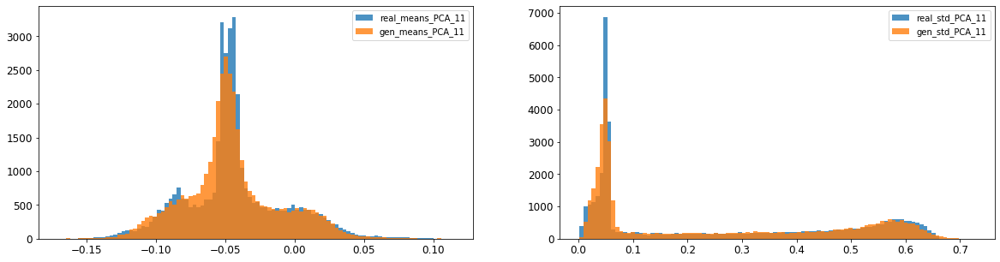

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.015937624971393706
12: mean 1-BC divergence = 0.01136075954111615

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.031916733707091687
12: std 1-BC divergence = 0.02264521634357808


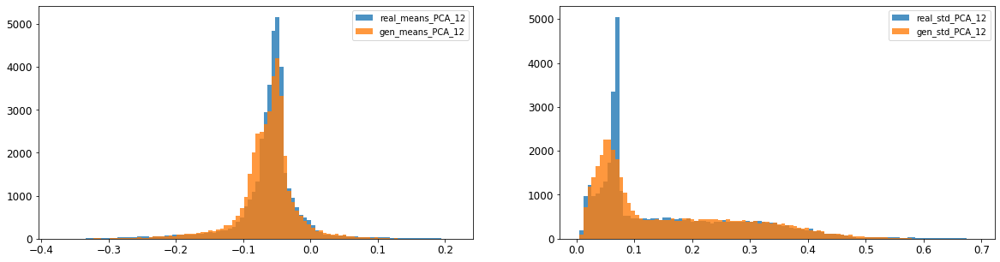

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.029261509378604087
13: mean 1-BC divergence = 0.020601963287806724

13: std KL divergence (r,g) = 0.16557724880576627
13: std JS divergence = 0.03828410074009801
13: std 1-BC divergence = 0.0269269229860869


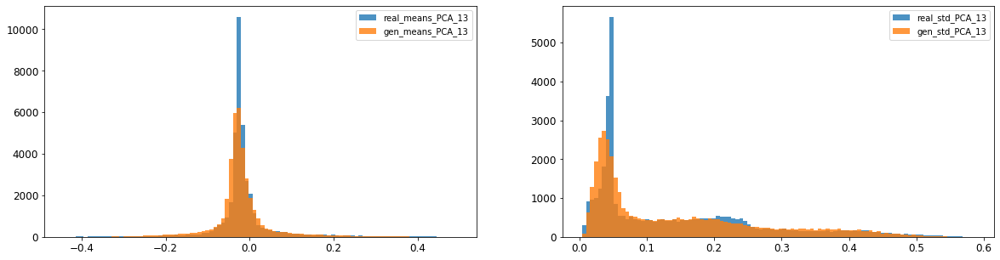

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.02380490071558611
14: mean 1-BC divergence = 0.016922972723516283

14: std KL divergence (r,g) = 0.036779982927495486
14: std JS divergence = 0.009348652652934103
14: std 1-BC divergence = 0.006589792511366377


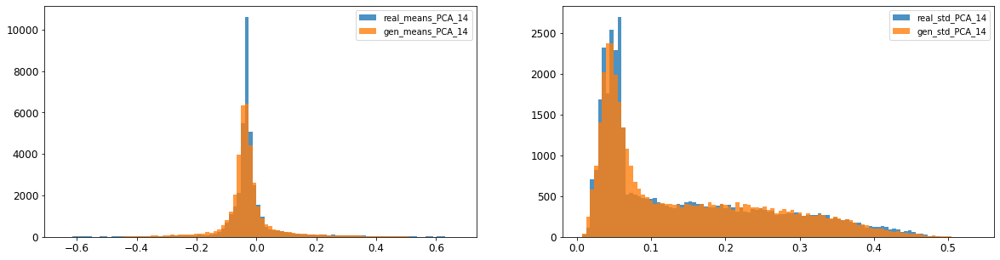

15: mean KL divergence (r,g) = 1.8438874201902218
15: mean JS divergence = 0.49787772497239247
15: mean 1-BC divergence = 0.4556787307313628

15: std KL divergence (r,g) = 7.815467567844924
15: std JS divergence = 0.9794432427146067
15: std 1-BC divergence = 0.9333722855228502


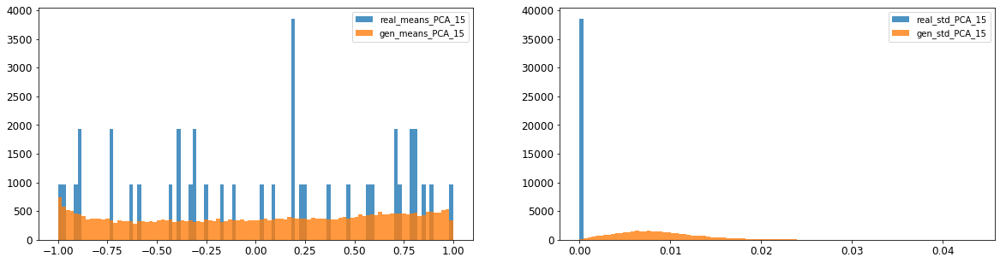

16: mean KL divergence (r,g) = 1.5933365594081157
16: mean JS divergence = 0.4434891603585477
16: mean 1-BC divergence = 0.4070943180424713

16: std KL divergence (r,g) = 5.9272583933024805
16: std JS divergence = 0.9393478285639676
16: std 1-BC divergence = 0.8718086515912498


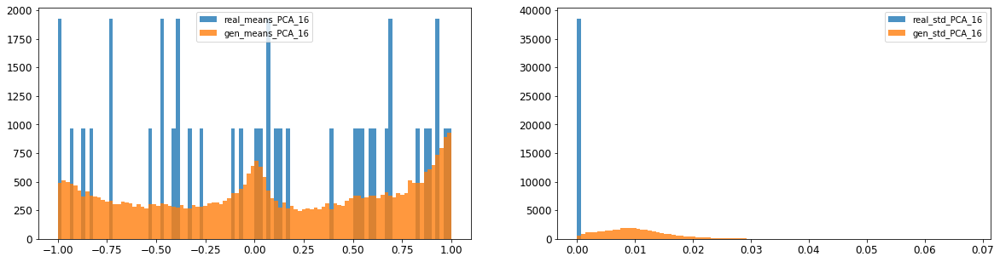



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.02784010537057286
Compose 1-BC divergence = 0.021282944646737523

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.03067922578467148
Compose weighted 1-BC divergence = 0.02491016805527746

Multivariate KL divergence = 90.1801497365404


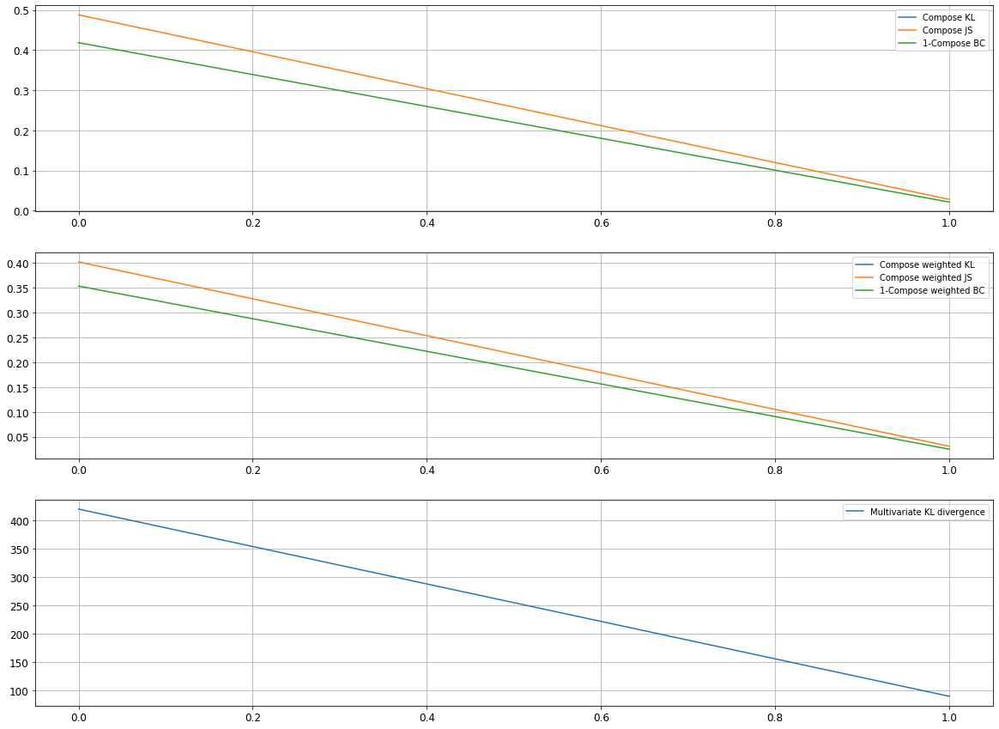

Epoch 202/10000
discriminator loss: 0.299752 - generator loss: 4.300743 - 34s
Epoch 203/10000
discriminator loss: 0.331533 - generator loss: 4.272718 - 38s
Epoch 204/10000
discriminator loss: 0.276694 - generator loss: 4.105702 - 35s
Epoch 205/10000
discriminator loss: 0.265643 - generator loss: 4.339607 - 33s
Epoch 206/10000
discriminator loss: 0.317824 - generator loss: 4.216417 - 34s
Epoch 207/10000
discriminator loss: 0.257841 - generator loss: 4.352104 - 34s
Epoch 208/10000
discriminator loss: 0.152886 - generator loss: 4.478683 - 39s
Epoch 209/10000
discriminator loss: 0.333709 - generator loss: 4.156398 - 30s
Epoch 210/10000
discriminator loss: 0.292768 - generator loss: 4.323546 - 37s
Epoch 211/10000
discriminator loss: 0.260133 - generator loss: 4.223078 - 38s
Epoch 212/10000
discriminator loss: 0.237695 - generator loss: 4.410538 - 40s
Epoch 213/10000
discriminator loss: 0.295868 - generator loss: 4.371704 - 34s
Epoch 214/10000
discriminator loss: 0.264886 - generator loss: 4

discriminator loss: 0.140853 - generator loss: 4.901086 - 39s
Epoch 308/10000
discriminator loss: 0.351217 - generator loss: 4.785914 - 39s
Epoch 309/10000
discriminator loss: 0.183597 - generator loss: 4.767814 - 35s
Epoch 310/10000
discriminator loss: 0.299253 - generator loss: 4.704103 - 38s
Epoch 311/10000
discriminator loss: 0.307572 - generator loss: 4.552739 - 32s
Epoch 312/10000
discriminator loss: 0.220063 - generator loss: 5.035676 - 33s
Epoch 313/10000
discriminator loss: 0.176432 - generator loss: 4.839386 - 34s
Epoch 314/10000
discriminator loss: 0.329919 - generator loss: 4.516836 - 35s
Epoch 315/10000
discriminator loss: 0.131626 - generator loss: 4.973354 - 32s
Epoch 316/10000
discriminator loss: 0.305162 - generator loss: 4.660282 - 34s
Epoch 317/10000
discriminator loss: 0.260062 - generator loss: 4.740965 - 35s
Epoch 318/10000
discriminator loss: 0.280796 - generator loss: 4.762730 - 38s
Epoch 319/10000
discriminator loss: 0.129748 - generator loss: 4.920061 - 36s
Ep

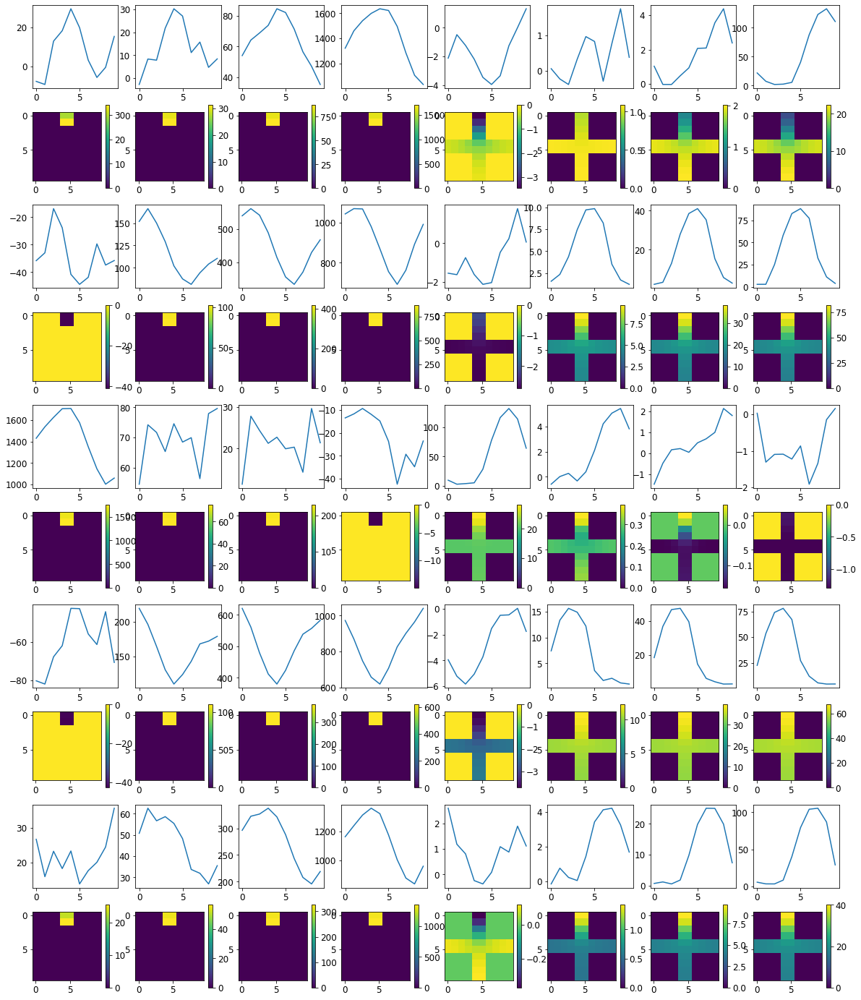


R0 generated:
[[19.841896   19.666296  ]
 [19.849874   19.658627  ]
 [19.85184    19.630117  ]
 [19.866241   19.6296    ]
 [19.857817   19.622345  ]
 [19.859701   19.622547  ]
 [19.853579   19.635311  ]
 [19.853458   19.652891  ]
 [19.827854   19.655079  ]
 [19.83628    19.647112  ]
 [17.923258    1.6877046 ]
 [17.753382    1.9140241 ]
 [17.826145    1.8828194 ]
 [17.807617    1.9812884 ]
 [17.853329    2.0142694 ]
 [17.831495    1.8844742 ]
 [17.968164    1.9166551 ]
 [17.879288    1.907232  ]
 [17.922459    1.9489338 ]
 [17.870134    1.7991716 ]
 [18.30152     1.9522569 ]
 [18.303345    1.8504677 ]
 [18.408838    1.7441384 ]
 [18.389935    1.756365  ]
 [18.368269    1.760997  ]
 [18.397398    1.78812   ]
 [18.3901      1.7983949 ]
 [18.283236    1.9606209 ]
 [18.287407    2.0645885 ]
 [18.340796    2.0045753 ]
 [19.887636   18.585535  ]
 [19.882208   18.50495   ]
 [19.88208    18.476583  ]
 [19.886543   18.565193  ]
 [19.88473    18.566875  ]
 [19.888445   18.504799  ]
 [19.891258  

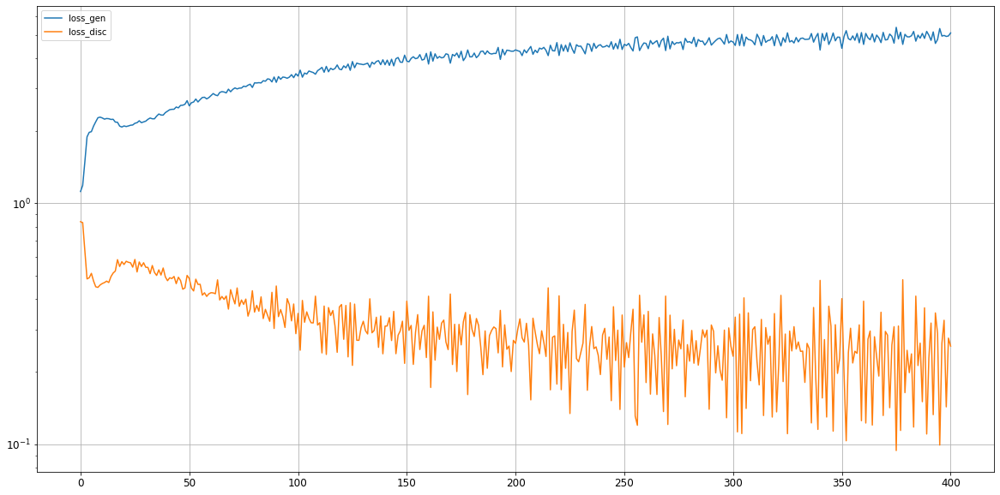

0: mean KL divergence (r,g) = 0.09089550066223882
0: mean JS divergence = 0.02424962925526758
0: mean 1-BC divergence = 0.018927250116144267

0: std KL divergence (r,g) = 0.15804272032812325
0: std JS divergence = 0.0454864019797571
0: std 1-BC divergence = 0.03885589155356006


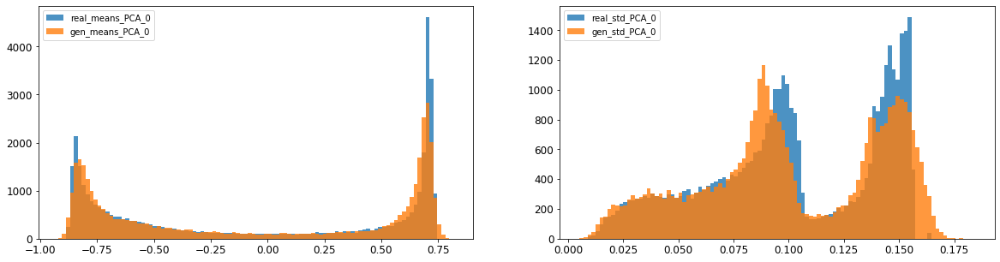

1: mean KL divergence (r,g) = 0.06344501427652469
1: mean JS divergence = 0.0157485445129571
1: mean 1-BC divergence = 0.011135191742424166

1: std KL divergence (r,g) = 0.06907098259410203
1: std JS divergence = 0.0189803630964959
1: std 1-BC divergence = 0.013607283206250154


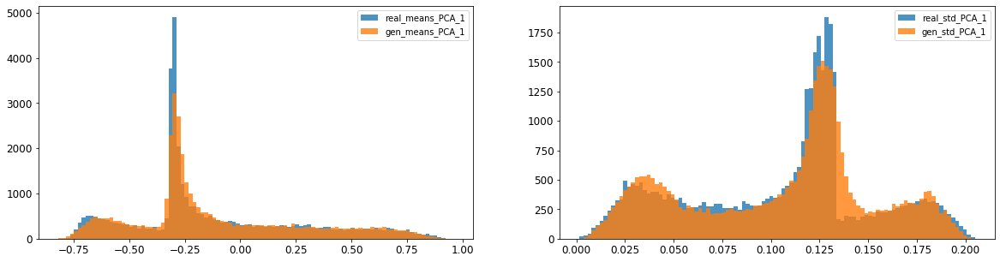

2: mean KL divergence (r,g) = 0.03891397900151562
2: mean JS divergence = 0.009511411366869463
2: mean 1-BC divergence = 0.006736435431618393

2: std KL divergence (r,g) = 0.07235341579591295
2: std JS divergence = 0.022557438430913707
2: std 1-BC divergence = 0.020688025877765193


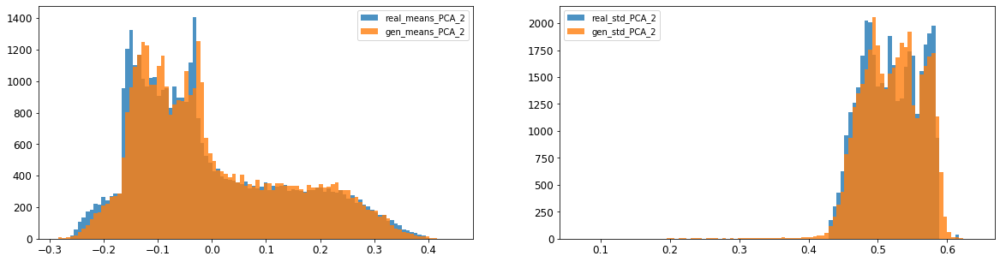

3: mean KL divergence (r,g) = 0.14434869399539824
3: mean JS divergence = 0.038675523833404654
3: mean 1-BC divergence = 0.028095183720935002

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.15230883867497574
3: std 1-BC divergence = 0.13244373487729932


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


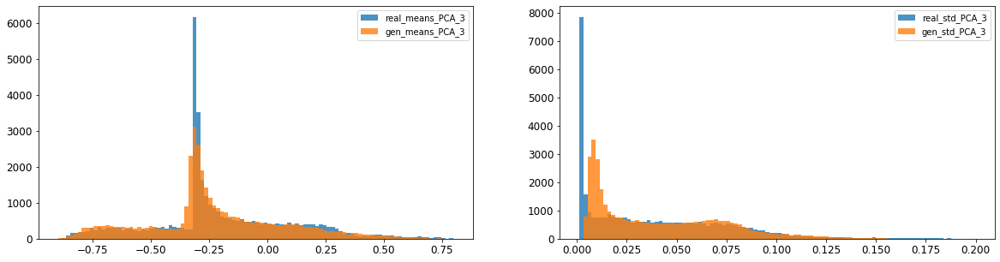

4: mean KL divergence (r,g) = 0.12933850194980195
4: mean JS divergence = 0.026532773539443628
4: mean 1-BC divergence = 0.019453526478583005

4: std KL divergence (r,g) = 0.02443466646708488
4: std JS divergence = 0.006295915070204076
4: std 1-BC divergence = 0.00462501792195924


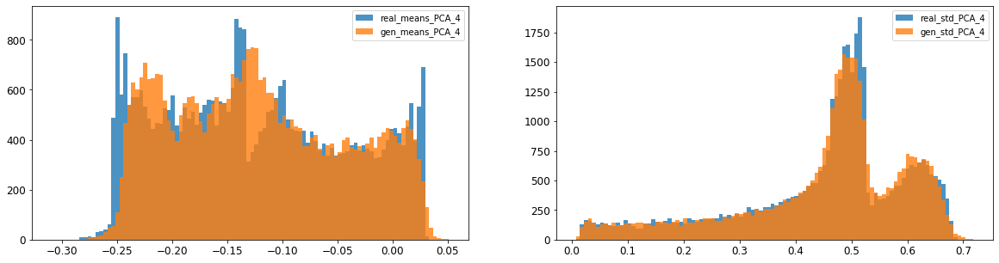

5: mean KL divergence (r,g) = 0.10485353333523907
5: mean JS divergence = 0.025480487327567955
5: mean 1-BC divergence = 0.018427743222296566

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.039878356561549554
5: std 1-BC divergence = 0.034362582322034596


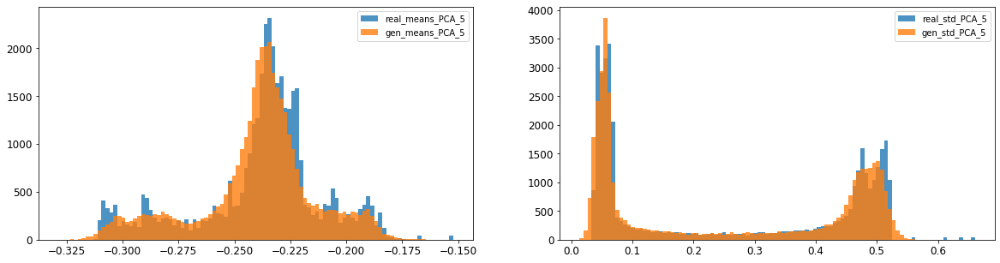

6: mean KL divergence (r,g) = 0.04475142528277118
6: mean JS divergence = 0.01199044648761837
6: mean 1-BC divergence = 0.00867686966902359

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.030170606816647117
6: std 1-BC divergence = 0.02156471186169806


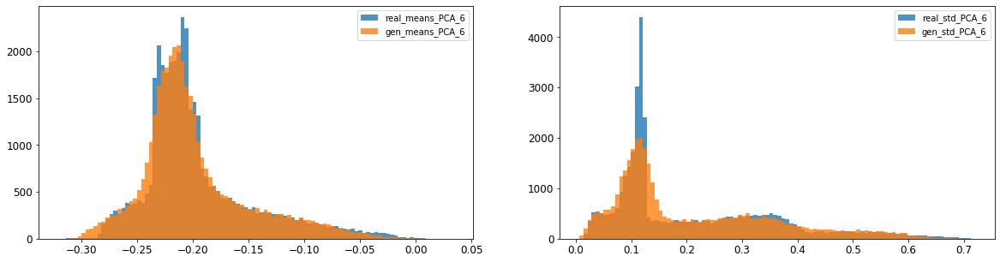

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.027377533993304524
7: mean 1-BC divergence = 0.021447465408728106

7: std KL divergence (r,g) = 0.12326224744566415
7: std JS divergence = 0.029560618815234092
7: std 1-BC divergence = 0.020939439864846587


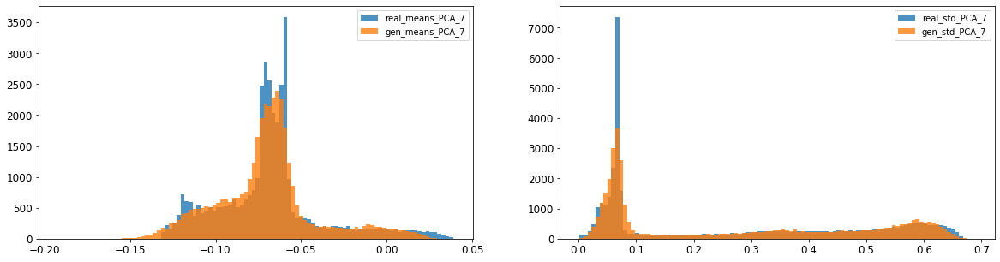

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.009728711897352586
8: mean 1-BC divergence = 0.006979961818080693

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.03109188084708608
8: std 1-BC divergence = 0.02203195913943401


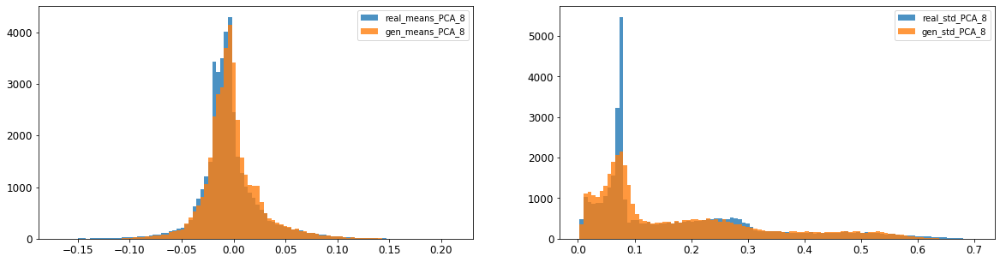

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.007445095082629851
9: mean 1-BC divergence = 0.005347459031553092

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.02061556361758108
9: std 1-BC divergence = 0.014593402332264693


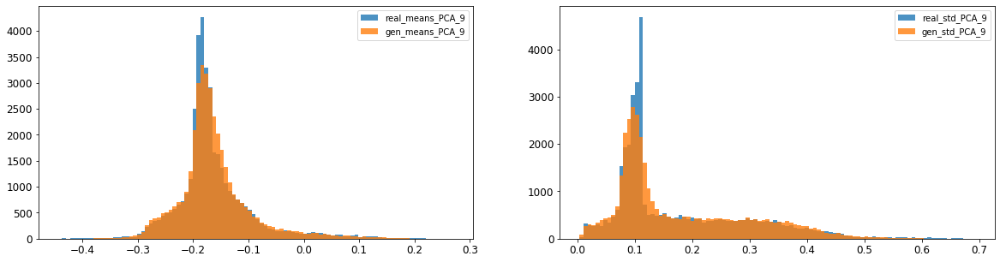

10: mean KL divergence (r,g) = 0.03621793538526653
10: mean JS divergence = 0.009180069884290265
10: mean 1-BC divergence = 0.006578989815062775

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.013052453794159192
10: std 1-BC divergence = 0.010865311341172412


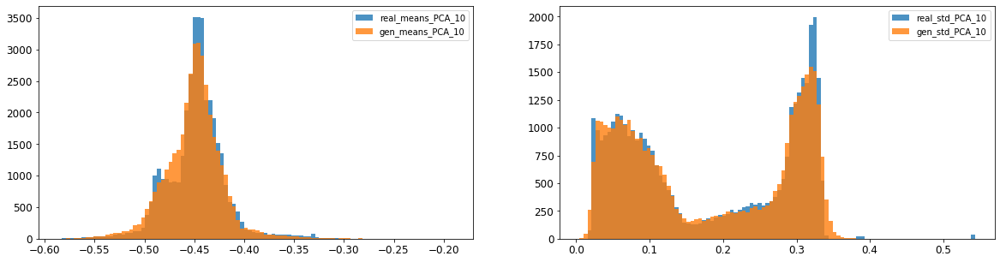

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.01654681279983631
11: mean 1-BC divergence = 0.011634696193916994

11: std KL divergence (r,g) = 0.11194992525477607
11: std JS divergence = 0.028375559488301297
11: std 1-BC divergence = 0.02065534350341547


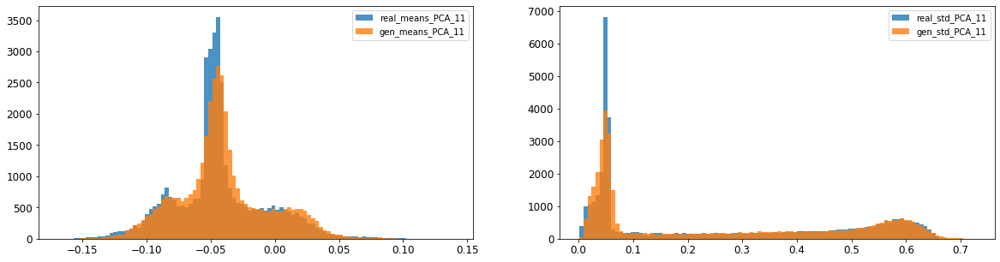

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.017154966032868972
12: mean 1-BC divergence = 0.01218738491506921

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.032281161693354335
12: std 1-BC divergence = 0.02290154059511884


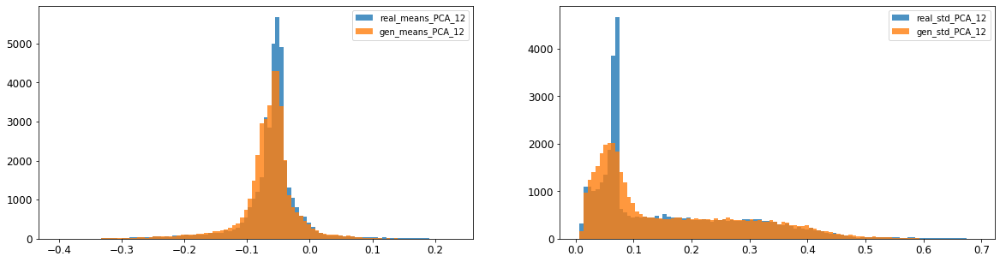

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.04765281633904375
13: mean 1-BC divergence = 0.03353406264734948

13: std KL divergence (r,g) = 0.11134896795979324
13: std JS divergence = 0.026787890720577197
13: std 1-BC divergence = 0.018735955275174465


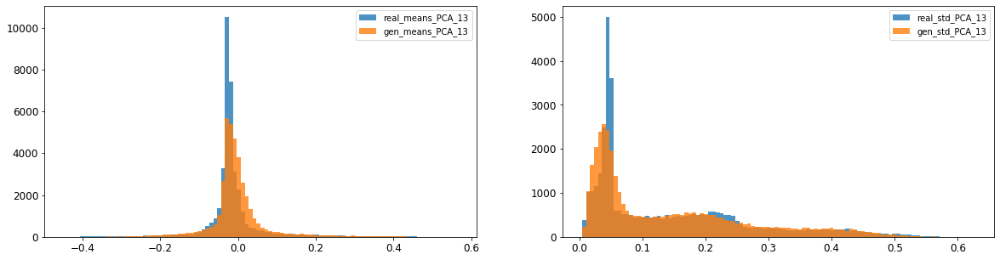

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.040813446942733936
14: mean 1-BC divergence = 0.02868277236248762

14: std KL divergence (r,g) = 0.03747167623581902
14: std JS divergence = 0.009629736097002291
14: std 1-BC divergence = 0.00678818461651054


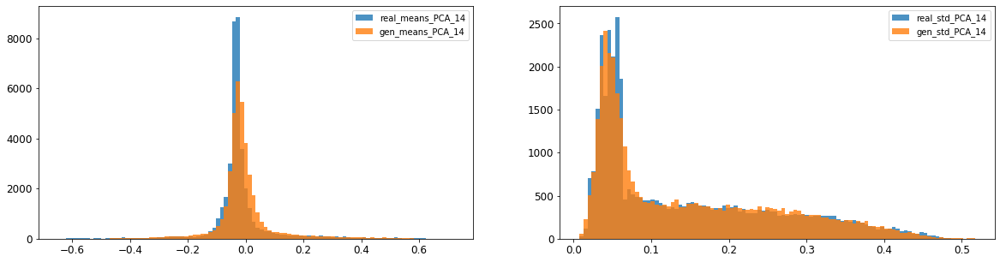

15: mean KL divergence (r,g) = 1.836297617051691
15: mean JS divergence = 0.49796450027403927
15: mean 1-BC divergence = 0.4557820459172106

15: std KL divergence (r,g) = 7.194401093438519
15: std JS divergence = 0.9704978109603494
15: std 1-BC divergence = 0.9173705741606666


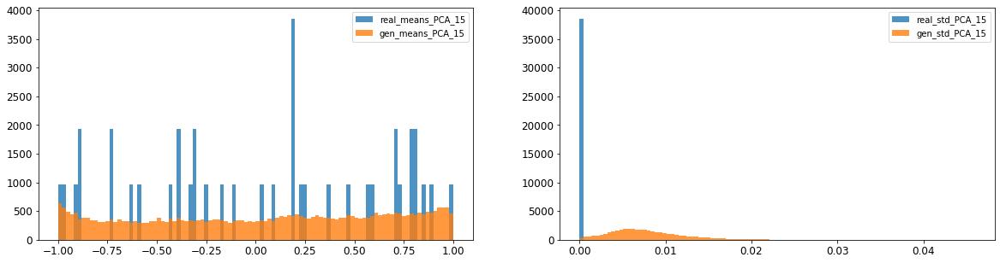

16: mean KL divergence (r,g) = 1.5709508508084222
16: mean JS divergence = 0.43551078235007484
16: mean 1-BC divergence = 0.3997398404276924

16: std KL divergence (r,g) = 5.495227823110331
16: std JS divergence = 0.9229160970010672
16: std 1-BC divergence = 0.8511030519377117


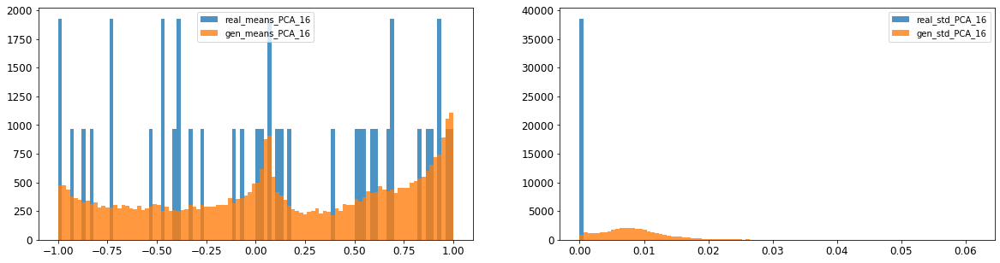



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.027838701833300925
Compose 1-BC divergence = 0.021383445895392428

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.031322010112537046
Compose weighted 1-BC divergence = 0.025461446299556934

Multivariate KL divergence = 85.06934050055872


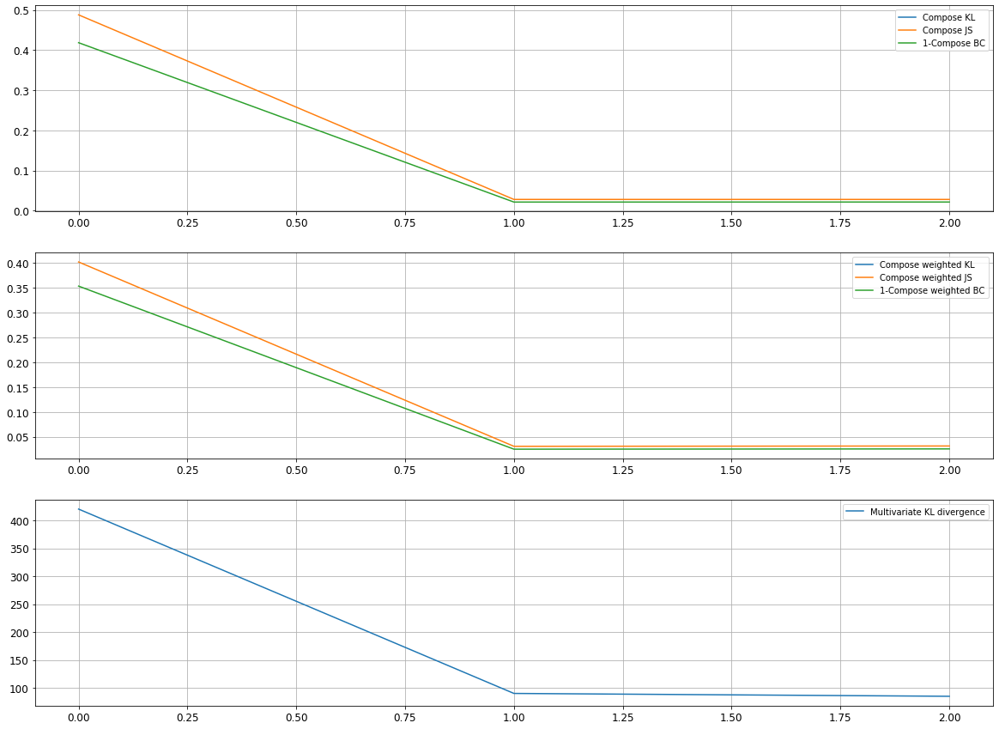

Epoch 402/10000
discriminator loss: 0.303252 - generator loss: 4.606072 - 35s
Epoch 403/10000
discriminator loss: 0.114794 - generator loss: 5.231735 - 39s
Epoch 404/10000
discriminator loss: 0.249736 - generator loss: 5.135765 - 40s
Epoch 405/10000
discriminator loss: 0.137828 - generator loss: 5.025827 - 39s
Epoch 406/10000
discriminator loss: 0.216663 - generator loss: 4.936290 - 38s
Epoch 407/10000
discriminator loss: 0.273832 - generator loss: 4.871040 - 38s
Epoch 408/10000
discriminator loss: 0.311000 - generator loss: 4.819347 - 39s
Epoch 409/10000
discriminator loss: 0.101092 - generator loss: 5.300998 - 39s
Epoch 410/10000
discriminator loss: 0.337237 - generator loss: 4.945546 - 39s
Epoch 411/10000
discriminator loss: 0.168837 - generator loss: 4.973289 - 39s
Epoch 412/10000
discriminator loss: 0.313622 - generator loss: 4.828591 - 37s
Epoch 413/10000
discriminator loss: 0.152286 - generator loss: 5.151276 - 40s
Epoch 414/10000
discriminator loss: 0.261889 - generator loss: 4

discriminator loss: 0.290647 - generator loss: 4.989571 - 40s
Epoch 508/10000
discriminator loss: 0.328819 - generator loss: 4.961552 - 36s
Epoch 509/10000
discriminator loss: 0.096017 - generator loss: 5.487163 - 37s
Epoch 510/10000
discriminator loss: 0.284303 - generator loss: 5.083714 - 34s
Epoch 511/10000
discriminator loss: 0.095562 - generator loss: 5.540178 - 37s
Epoch 512/10000
discriminator loss: 0.324011 - generator loss: 4.896152 - 38s
Epoch 513/10000
discriminator loss: 0.275325 - generator loss: 5.078845 - 40s
Epoch 514/10000
discriminator loss: 0.190721 - generator loss: 5.258360 - 36s
Epoch 515/10000
discriminator loss: 0.236621 - generator loss: 5.076043 - 38s
Epoch 516/10000
discriminator loss: 0.219329 - generator loss: 5.422801 - 38s
Epoch 517/10000
discriminator loss: 0.239963 - generator loss: 4.984823 - 40s
Epoch 518/10000
discriminator loss: 0.218079 - generator loss: 5.211083 - 40s
Epoch 519/10000
discriminator loss: 0.113183 - generator loss: 5.396930 - 36s
Ep

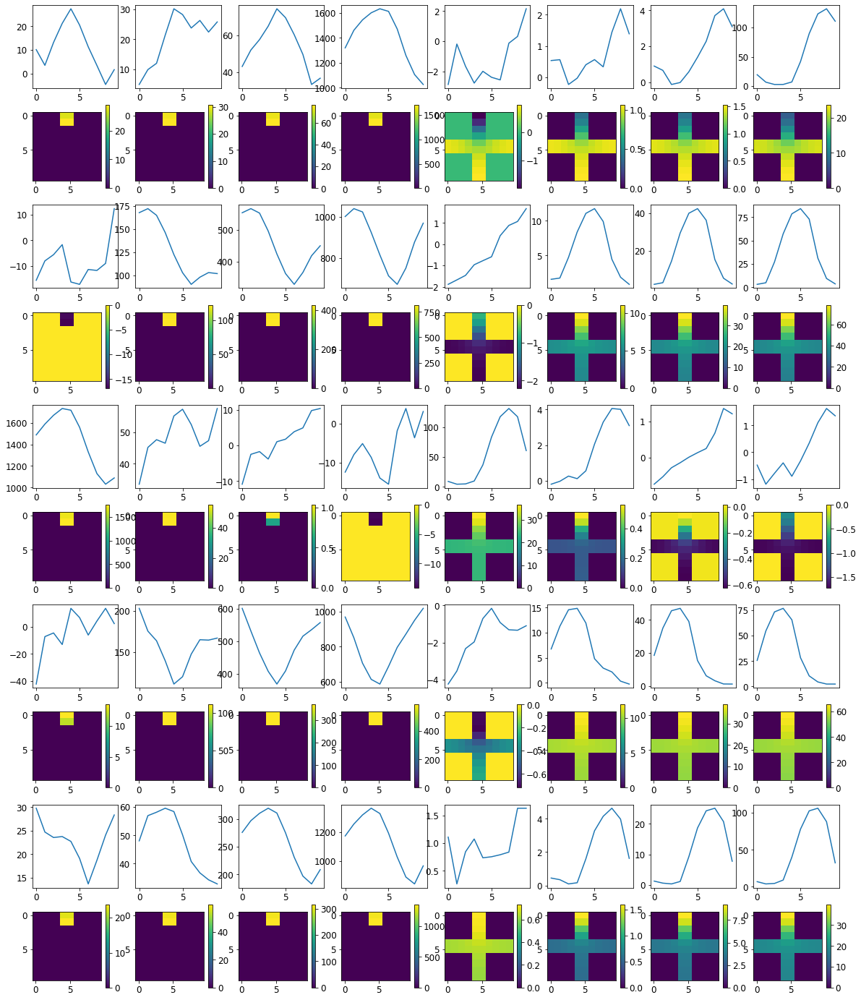


R0 generated:
[[19.924229   19.464848  ]
 [19.922228   19.450603  ]
 [19.920952   19.408092  ]
 [19.922297   19.386555  ]
 [19.923143   19.401192  ]
 [19.920261   19.39801   ]
 [19.921146   19.406584  ]
 [19.915369   19.402742  ]
 [19.914724   19.381332  ]
 [19.924551   19.379147  ]
 [17.736195    0.83555317]
 [17.471977    0.9409442 ]
 [17.464334    0.9611732 ]
 [17.49675     0.9433069 ]
 [17.463564    0.93017083]
 [17.449131    0.8955322 ]
 [17.450735    0.9156586 ]
 [17.432617    0.8775179 ]
 [17.503948    0.9001731 ]
 [17.46991     0.8759015 ]
 [17.731035    1.483318  ]
 [17.767653    1.5957996 ]
 [17.77072     1.5419891 ]
 [17.727749    1.5179018 ]
 [17.67257     1.5206943 ]
 [17.721127    1.5715454 ]
 [17.630058    1.5746335 ]
 [17.590012    1.6629409 ]
 [17.636274    1.7406235 ]
 [17.645235    1.6418016 ]
 [19.895882   18.886703  ]
 [19.881178   18.784353  ]
 [19.87867    18.791525  ]
 [19.881262   18.811827  ]
 [19.887053   18.813974  ]
 [19.883795   18.783386  ]
 [19.886583  

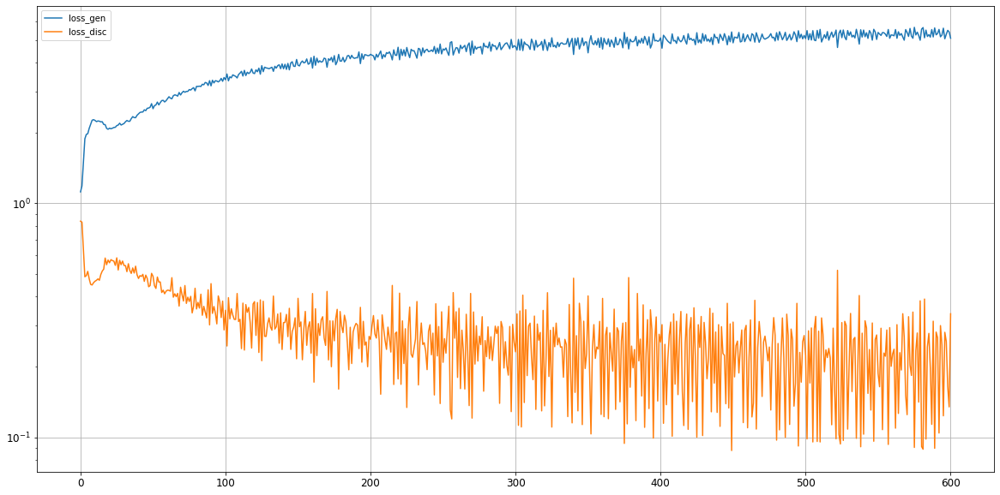

0: mean KL divergence (r,g) = 0.08742582434160212
0: mean JS divergence = 0.02527851445502137
0: mean 1-BC divergence = 0.021607805325102536

0: std KL divergence (r,g) = 0.11859746422308491
0: std JS divergence = 0.03544061730551318
0: std 1-BC divergence = 0.03065980325276474


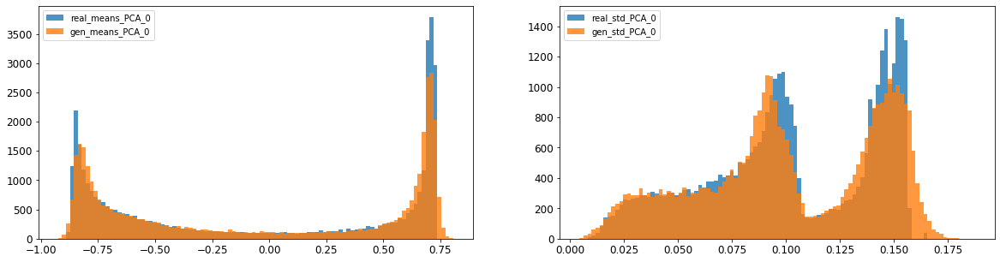

1: mean KL divergence (r,g) = 0.05691662686648455
1: mean JS divergence = 0.014950314982580499
1: mean 1-BC divergence = 0.01092328841421053

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.01586977788819251
1: std 1-BC divergence = 0.011638638540405366


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


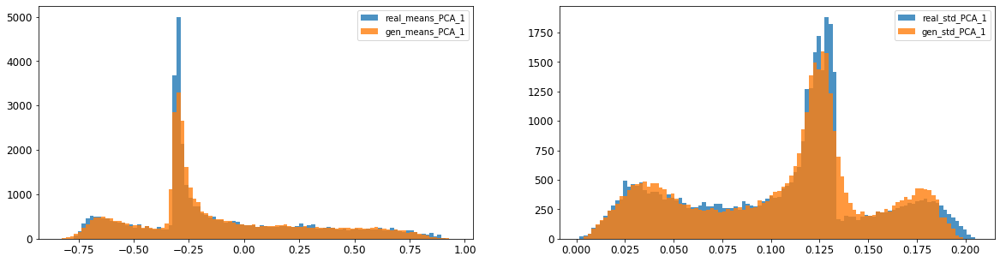

2: mean KL divergence (r,g) = 0.01919286117672087
2: mean JS divergence = 0.005001282841440123
2: mean 1-BC divergence = 0.003636118429787061

2: std KL divergence (r,g) = 0.05583000713883106
2: std JS divergence = 0.014993816973164209
2: std 1-BC divergence = 0.012513116140799307


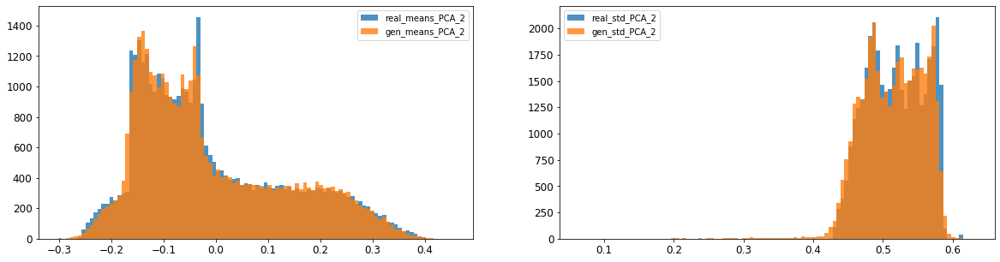

3: mean KL divergence (r,g) = 0.1031828558255563
3: mean JS divergence = 0.02498783381469622
3: mean 1-BC divergence = 0.01767599097676431

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.11721538200073138
3: std 1-BC divergence = 0.09195160842739858


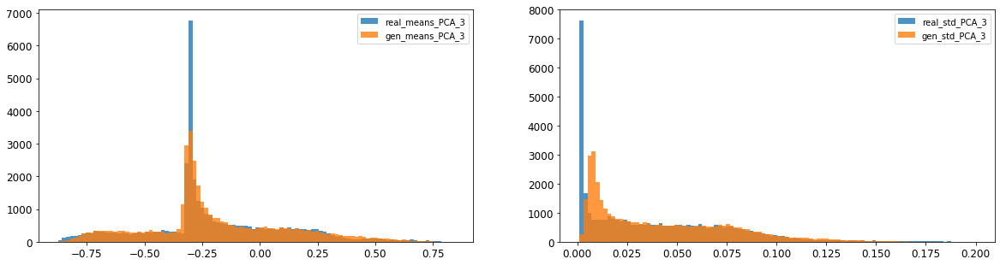

4: mean KL divergence (r,g) = 0.06483650623783546
4: mean JS divergence = 0.017770514801891128
4: mean 1-BC divergence = 0.01511669534986848

4: std KL divergence (r,g) = 0.04735933775327136
4: std JS divergence = 0.010961806476332768
4: std 1-BC divergence = 0.007798444843535979


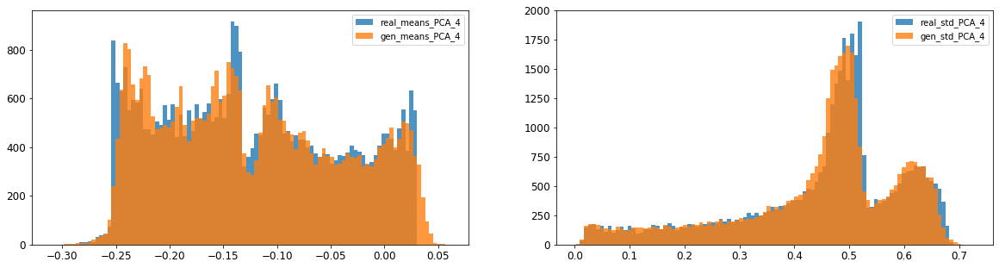

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.02313679564315326
5: mean 1-BC divergence = 0.016725070686926413

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.027555111286814586
5: std 1-BC divergence = 0.022829634724108372


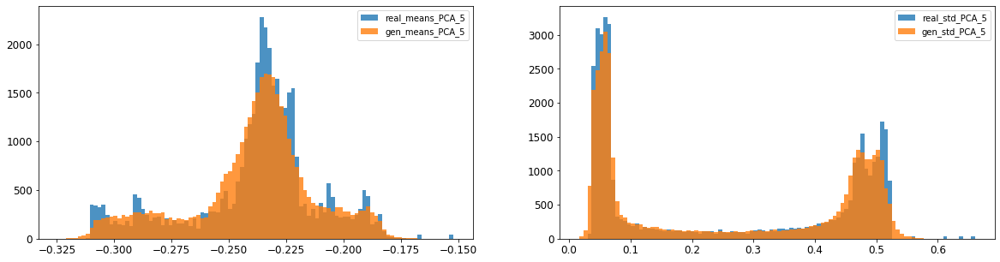

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.006579251548496347
6: mean 1-BC divergence = 0.00464215779368915

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.02027911471265443
6: std 1-BC divergence = 0.014540214355246106


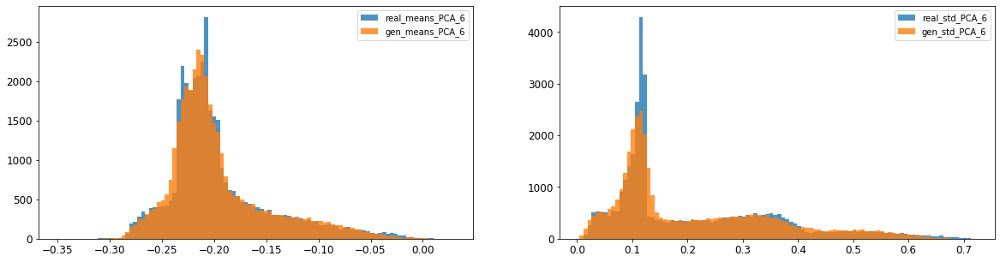

7: mean KL divergence (r,g) = 0.16622341314488037
7: mean JS divergence = 0.040614466714478284
7: mean 1-BC divergence = 0.03225352950756588

7: std KL divergence (r,g) = 0.09461832231498031
7: std JS divergence = 0.022122220663903635
7: std 1-BC divergence = 0.01554576740214475


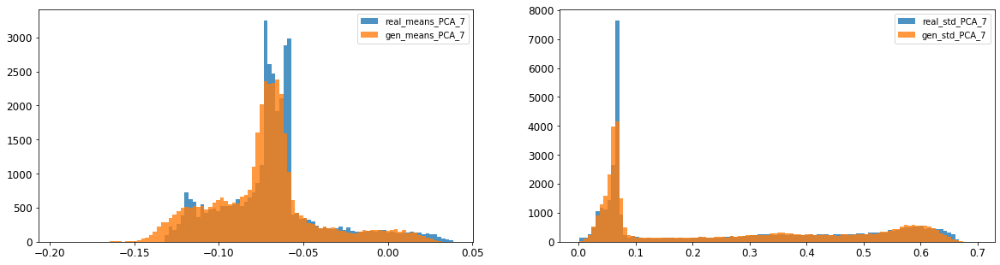

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.003143262804512843
8: mean 1-BC divergence = 0.002298206291039384

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.025374790647834794
8: std 1-BC divergence = 0.017968066649727277


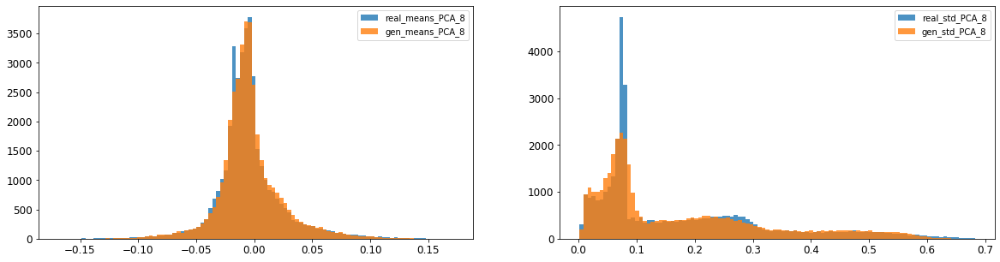

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.005859902064119715
9: mean 1-BC divergence = 0.0041958670219142125

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.019111633869829055
9: std 1-BC divergence = 0.013572461431229255


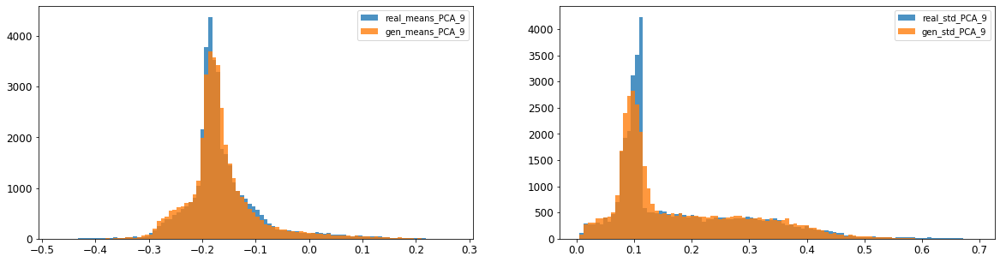

10: mean KL divergence (r,g) = 0.02420120934017268
10: mean JS divergence = 0.006073817927093571
10: mean 1-BC divergence = 0.004339850809437773

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.012366818837180257
10: std 1-BC divergence = 0.009939667440308941


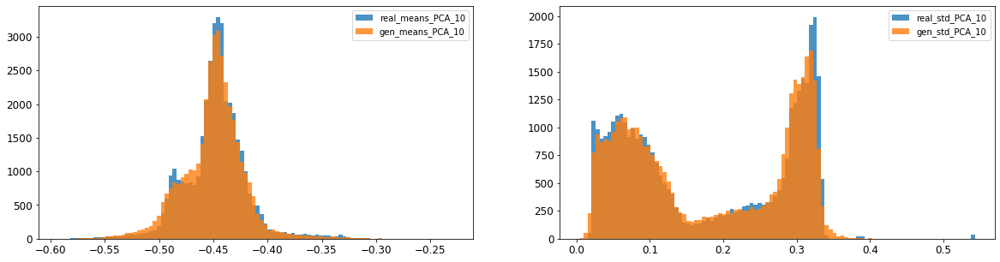

11: mean KL divergence (r,g) = 0.1613689464887888
11: mean JS divergence = 0.04106298005191941
11: mean 1-BC divergence = 0.028991467345781285

11: std KL divergence (r,g) = 0.08834856340190064
11: std JS divergence = 0.022623568743525398
11: std 1-BC divergence = 0.01629176313907621


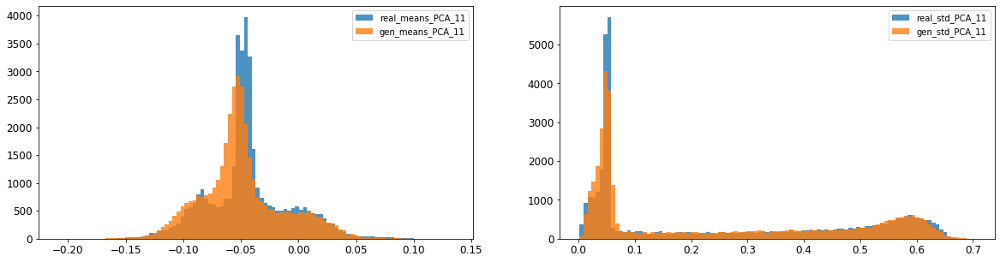

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.007838251094998168
12: mean 1-BC divergence = 0.005519678180981646

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.03393072685470097
12: std 1-BC divergence = 0.02417645343383168


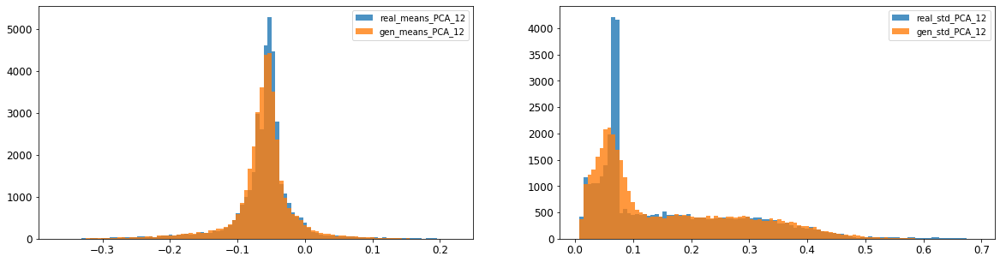

13: mean KL divergence (r,g) = 0.10346415558721399
13: mean JS divergence = 0.026554752385278
13: mean 1-BC divergence = 0.01864020265023869

13: std KL divergence (r,g) = 0.15027428731358278
13: std JS divergence = 0.03456098461005804
13: std 1-BC divergence = 0.02428947654091662


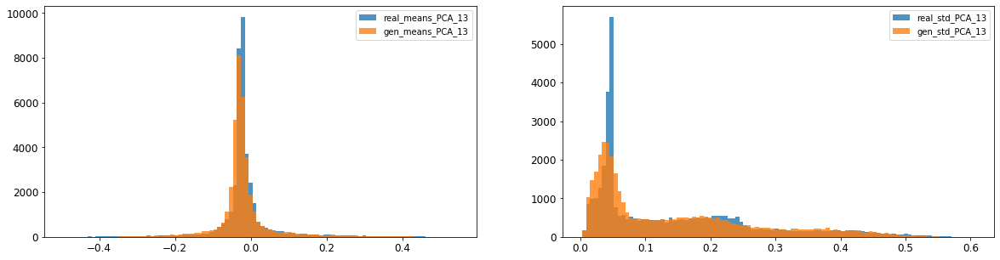

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.022868878040377273
14: mean 1-BC divergence = 0.016044946906758617

14: std KL divergence (r,g) = 0.037585313754796526
14: std JS divergence = 0.009373989140242914
14: std 1-BC divergence = 0.0065776071978822515


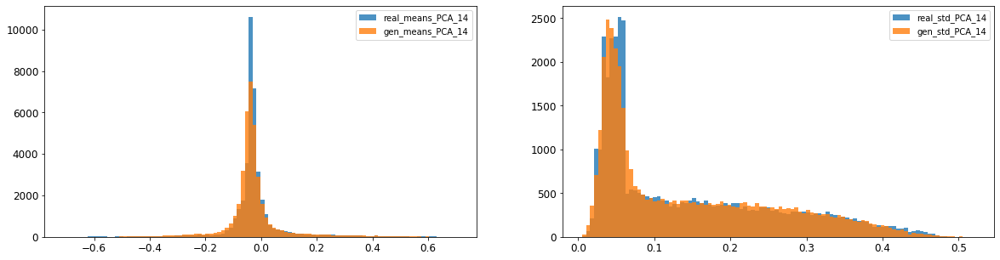

15: mean KL divergence (r,g) = 1.7973067244016925
15: mean JS divergence = 0.49085496115070065
15: mean 1-BC divergence = 0.44902042909532336

15: std KL divergence (r,g) = 7.308507579125041
15: std JS divergence = 0.9723825843195737
15: std 1-BC divergence = 0.9205744926679517


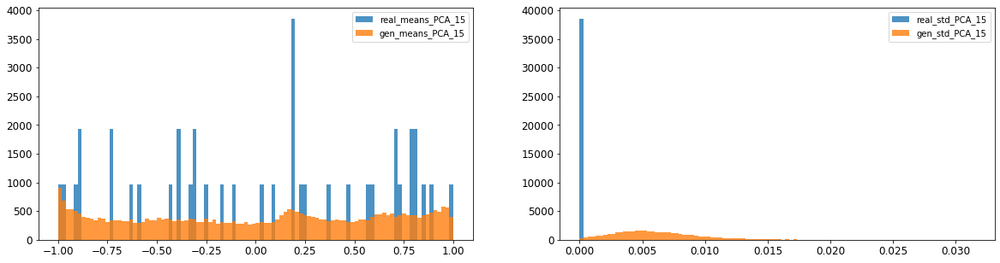

16: mean KL divergence (r,g) = 1.533404097049703
16: mean JS divergence = 0.43014267595429334
16: mean 1-BC divergence = 0.39528423722145545

16: std KL divergence (r,g) = 5.471768850286343
16: std JS divergence = 0.9219138251919057
16: std 1-BC divergence = 0.8498875464794043


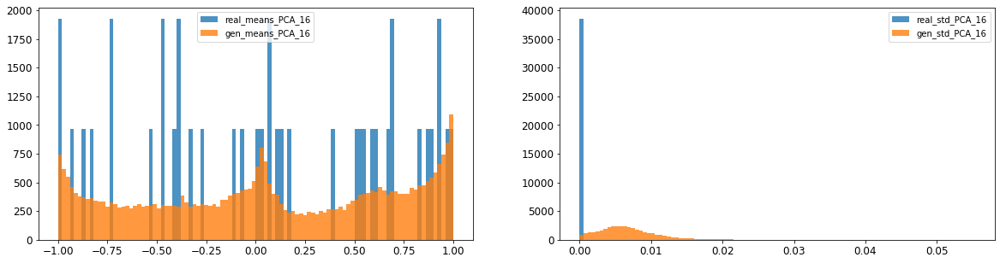



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.023116705972691148
Compose 1-BC divergence = 0.01743011997364796

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.026359594036042343
Compose weighted 1-BC divergence = 0.02173894160243217

Multivariate KL divergence = 75.11510112868511


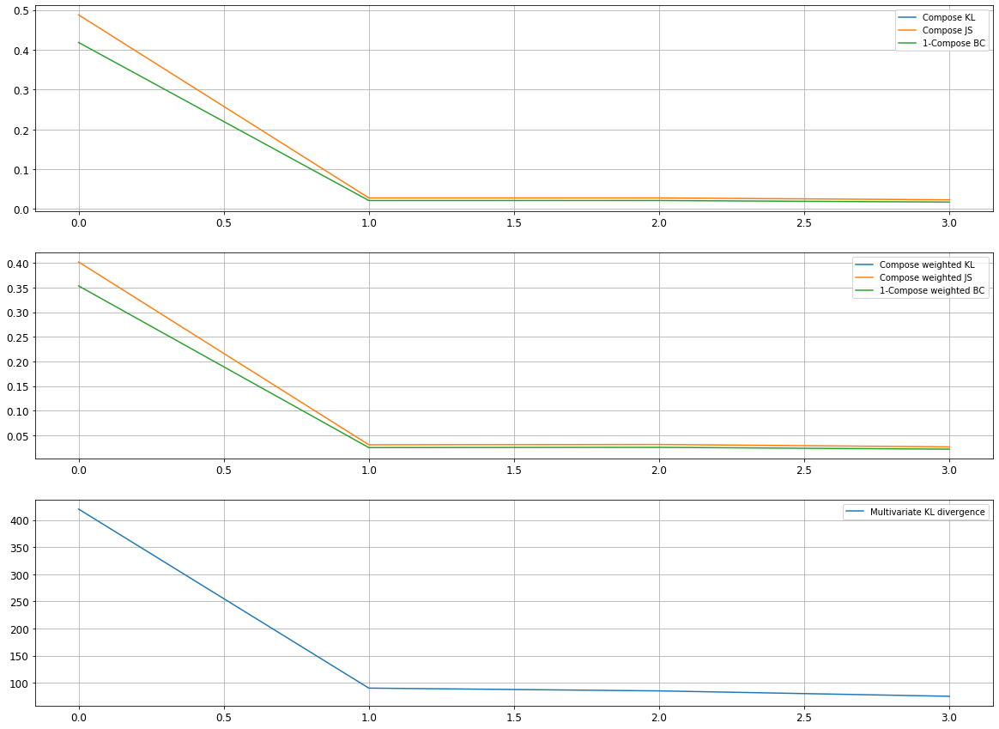

Epoch 602/10000
discriminator loss: 0.231664 - generator loss: 5.352292 - 36s
Epoch 603/10000
discriminator loss: 0.088736 - generator loss: 5.707754 - 37s
Epoch 604/10000
discriminator loss: 0.262875 - generator loss: 5.220385 - 39s
Epoch 605/10000
discriminator loss: 0.289541 - generator loss: 5.103549 - 38s
Epoch 606/10000
discriminator loss: 0.085157 - generator loss: 5.666439 - 39s
Epoch 607/10000
discriminator loss: 0.285915 - generator loss: 5.161353 - 39s
Epoch 608/10000
discriminator loss: 0.240226 - generator loss: 5.488891 - 40s
Epoch 609/10000
discriminator loss: 0.163831 - generator loss: 5.149140 - 39s
Epoch 610/10000
discriminator loss: 0.286786 - generator loss: 5.151882 - 38s
Epoch 611/10000
discriminator loss: 0.088483 - generator loss: 5.647998 - 39s
Epoch 612/10000
discriminator loss: 0.320360 - generator loss: 5.451774 - 39s
Epoch 613/10000
discriminator loss: 0.196573 - generator loss: 5.032217 - 41s
Epoch 614/10000
discriminator loss: 0.328361 - generator loss: 5

discriminator loss: 0.125692 - generator loss: 5.500358 - 38s
Epoch 708/10000
discriminator loss: 0.212282 - generator loss: 5.434880 - 37s
Epoch 709/10000
discriminator loss: 0.327580 - generator loss: 5.338955 - 39s
Epoch 710/10000
discriminator loss: 0.083862 - generator loss: 5.766339 - 36s
Epoch 711/10000
discriminator loss: 0.125665 - generator loss: 5.757986 - 35s
Epoch 712/10000
discriminator loss: 0.227971 - generator loss: 5.359221 - 34s
Epoch 713/10000
discriminator loss: 0.436768 - generator loss: 4.983935 - 31s
Epoch 714/10000
discriminator loss: 0.083866 - generator loss: 5.733492 - 36s
Epoch 715/10000
discriminator loss: 0.083618 - generator loss: 5.769278 - 34s
Epoch 716/10000
discriminator loss: 0.330108 - generator loss: 5.213459 - 35s
Epoch 717/10000
discriminator loss: 0.081526 - generator loss: 5.825736 - 37s
Epoch 718/10000
discriminator loss: 0.381036 - generator loss: 5.062350 - 34s
Epoch 719/10000
discriminator loss: 0.080466 - generator loss: 5.879228 - 38s
Ep

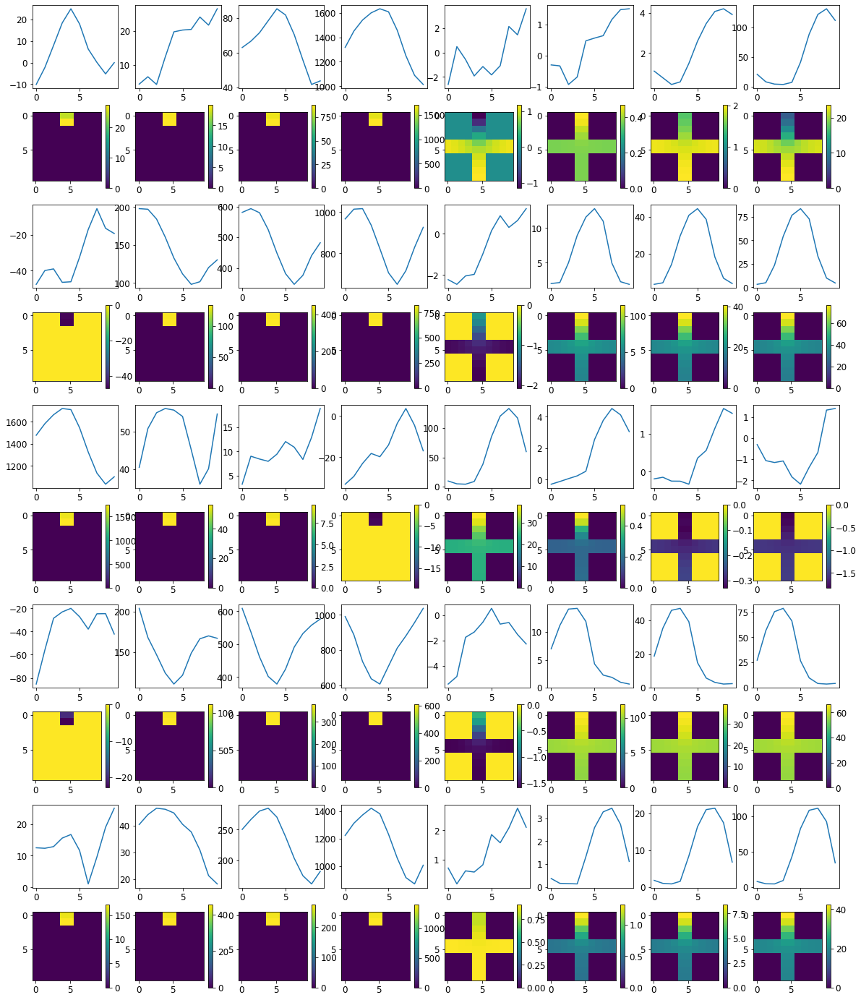


R0 generated:
[[19.846807   19.596142  ]
 [19.834635   19.600418  ]
 [19.836535   19.576447  ]
 [19.839815   19.587345  ]
 [19.847065   19.575298  ]
 [19.841429   19.584974  ]
 [19.839937   19.591183  ]
 [19.835999   19.593124  ]
 [19.839298   19.572187  ]
 [19.85336    19.598244  ]
 [17.84605     0.87666184]
 [17.6505      0.95109075]
 [17.740465    0.9708953 ]
 [17.728323    0.95294565]
 [17.755556    0.9626671 ]
 [17.765408    0.94238275]
 [17.855358    0.94651693]
 [17.808258    0.9561434 ]
 [17.852419    0.9973897 ]
 [17.879086    0.9562291 ]
 [19.273396    1.9126054 ]
 [19.161108    2.0964954 ]
 [19.159424    2.1256454 ]
 [19.139778    2.0602136 ]
 [19.147953    2.004501  ]
 [19.170115    2.055309  ]
 [19.139772    2.0516136 ]
 [19.101759    2.036254  ]
 [19.128738    2.0427706 ]
 [19.201344    1.9446404 ]
 [19.880308   18.762596  ]
 [19.853127   18.751238  ]
 [19.84662    18.749802  ]
 [19.848867   18.796892  ]
 [19.864473   18.798851  ]
 [19.862059   18.758316  ]
 [19.866201  

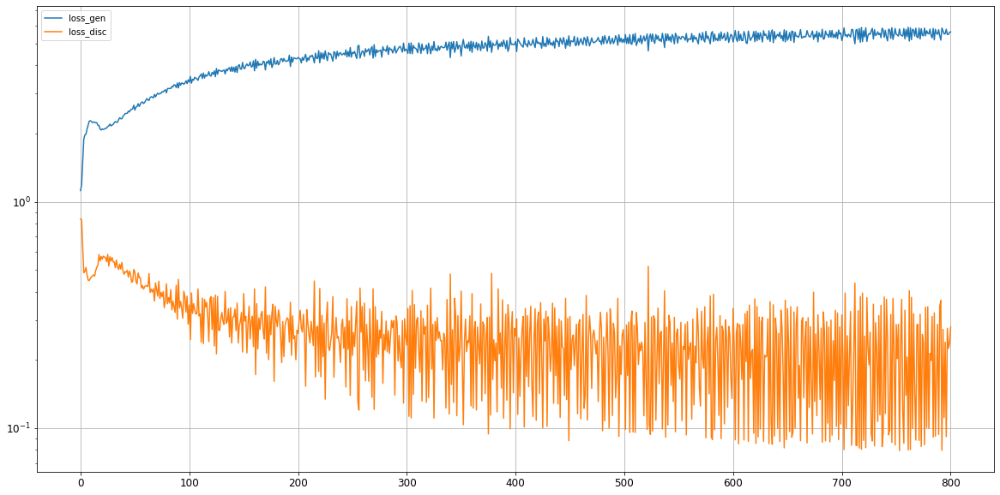

0: mean KL divergence (r,g) = 0.059417245474529284
0: mean JS divergence = 0.017447015661800177
0: mean 1-BC divergence = 0.015022325479131404

0: std KL divergence (r,g) = 0.14169022975357565
0: std JS divergence = 0.04112079378475755
0: std 1-BC divergence = 0.03539758421836103


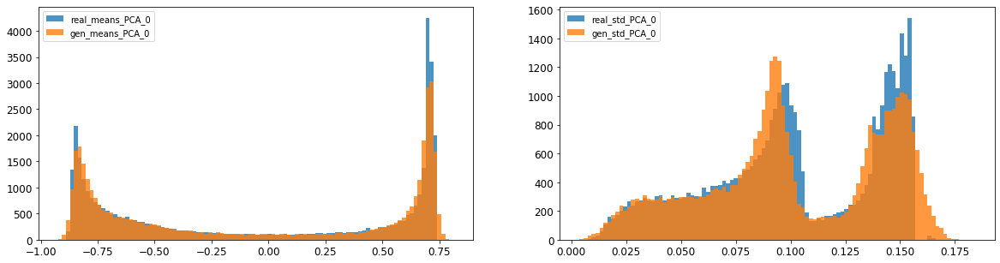

1: mean KL divergence (r,g) = 0.04657924008602919
1: mean JS divergence = 0.01185141423338573
1: mean 1-BC divergence = 0.008445427170501674

1: std KL divergence (r,g) = 0.06765734973754699
1: std JS divergence = 0.0157916000983293
1: std 1-BC divergence = 0.011099479928183054


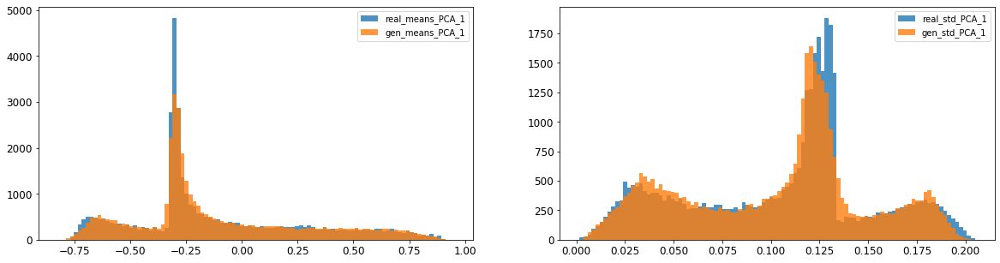

2: mean KL divergence (r,g) = 0.01159205877230046
2: mean JS divergence = 0.003172956980527032
2: mean 1-BC divergence = 0.002496771059912084

2: std KL divergence (r,g) = 0.04069149534563915
2: std JS divergence = 0.0122058255371592
2: std 1-BC divergence = 0.0107267702709396


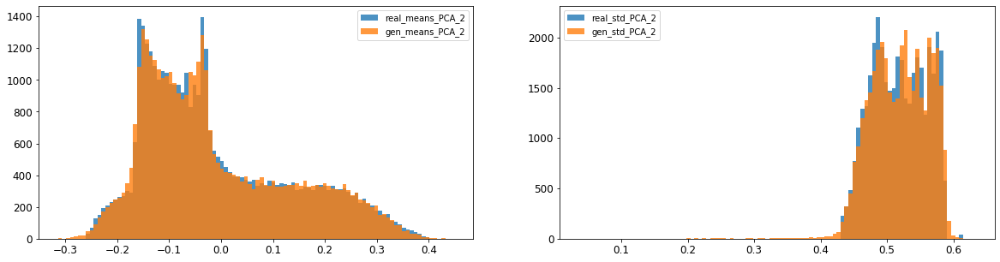

3: mean KL divergence (r,g) = 0.12751341034829003
3: mean JS divergence = 0.035259230476809414
3: mean 1-BC divergence = 0.025820424012275356

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.1386870213517074
3: std 1-BC divergence = 0.11567880720623946


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


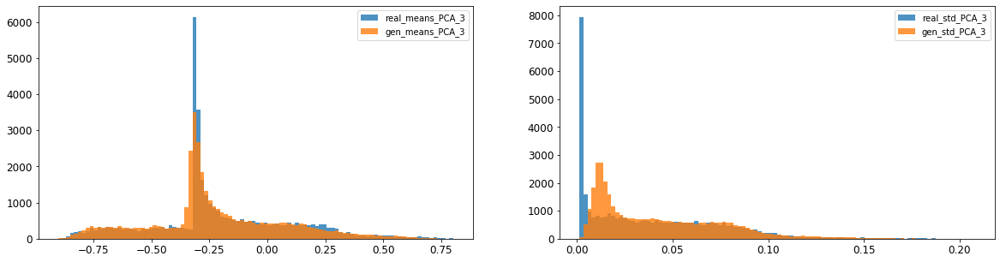

4: mean KL divergence (r,g) = 0.06867256686135953
4: mean JS divergence = 0.016813778360767185
4: mean 1-BC divergence = 0.012924047591921672

4: std KL divergence (r,g) = 0.030755835105044826
4: std JS divergence = 0.007075720102289129
4: std 1-BC divergence = 0.005029312946384756


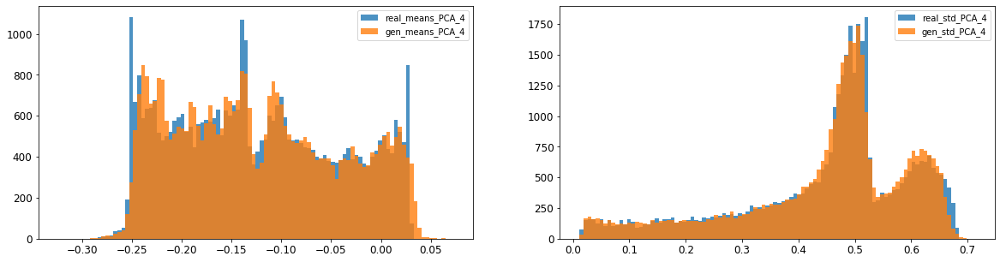

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.02337392118496479
5: mean 1-BC divergence = 0.017584461885879588

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.02800828713429765
5: std 1-BC divergence = 0.024980528252100065


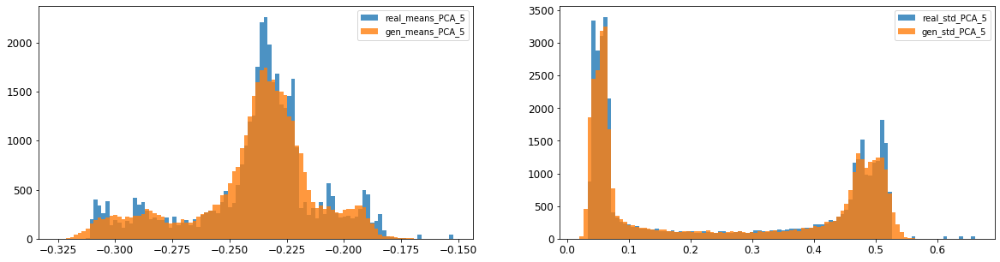

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.006119100288724559
6: mean 1-BC divergence = 0.004328881624483527

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.020160634038969623
6: std 1-BC divergence = 0.014680126037101449


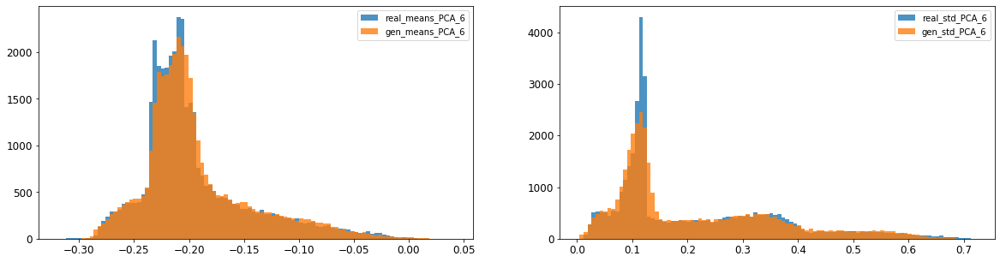

7: mean KL divergence (r,g) = 0.0859837887392483
7: mean JS divergence = 0.022190582843042872
7: mean 1-BC divergence = 0.01735470784739468

7: std KL divergence (r,g) = 0.08034496169499017
7: std JS divergence = 0.019418467422268652
7: std 1-BC divergence = 0.013726135667266881


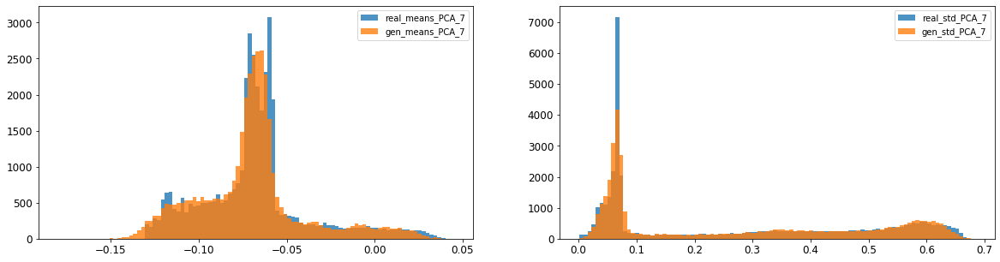

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.008425053116431842
8: mean 1-BC divergence = 0.005970290774507725

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.021858120634574
8: std 1-BC divergence = 0.015469977151674308


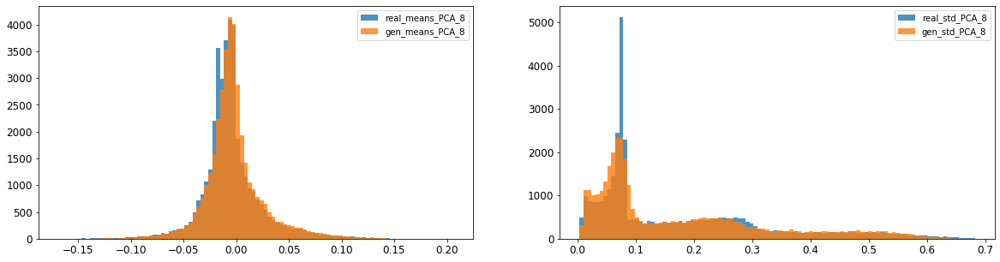

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0065788300070524245
9: mean 1-BC divergence = 0.004716622356337852

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.0214519299780166
9: std 1-BC divergence = 0.015272920262094147


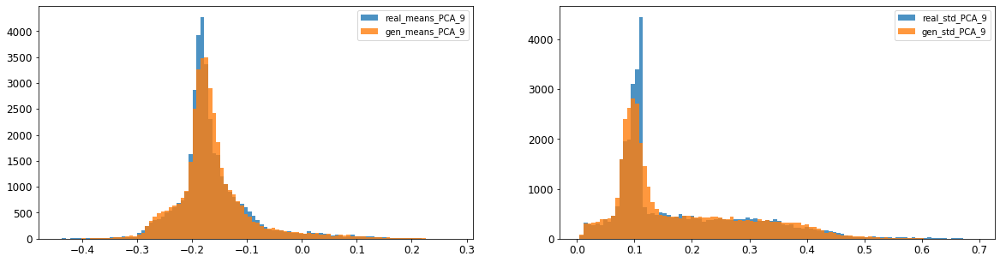

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.013326998998939733
10: mean 1-BC divergence = 0.009572500365441439

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.010894024475542559
10: std 1-BC divergence = 0.008583092672909465


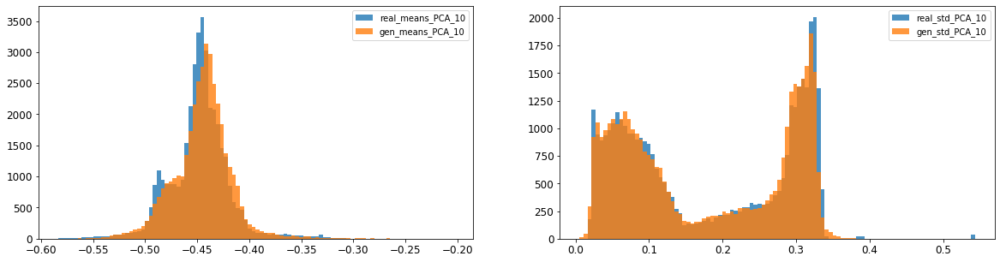

11: mean KL divergence (r,g) = 0.0473497594762615
11: mean JS divergence = 0.012015343431273702
11: mean 1-BC divergence = 0.00850105487898345

11: std KL divergence (r,g) = 0.06727919451422357
11: std JS divergence = 0.016981621047919525
11: std 1-BC divergence = 0.012065406929850253


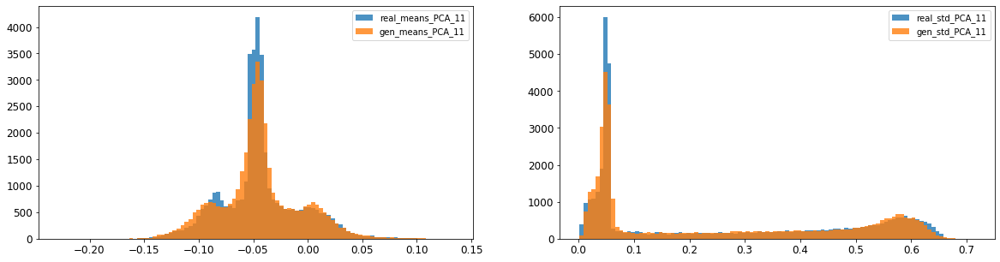

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.010801217573288939
12: mean 1-BC divergence = 0.007666567799828994

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.032250173921449896
12: std 1-BC divergence = 0.02306079311443976


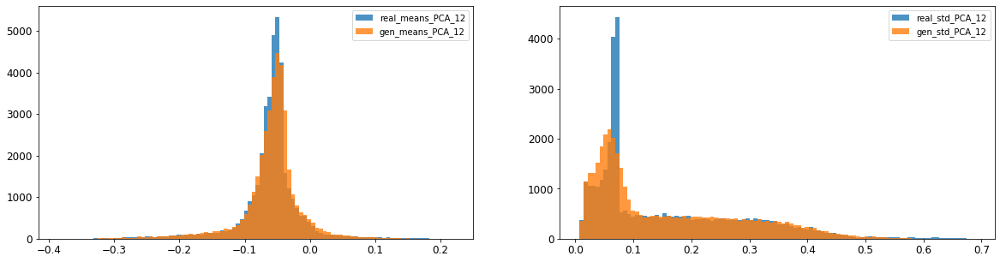

13: mean KL divergence (r,g) = 0.16581063311975125
13: mean JS divergence = 0.042218658608277566
13: mean 1-BC divergence = 0.029694686474536325

13: std KL divergence (r,g) = inf
13: std JS divergence = 0.0306754178850664
13: std 1-BC divergence = 0.02157515821348832


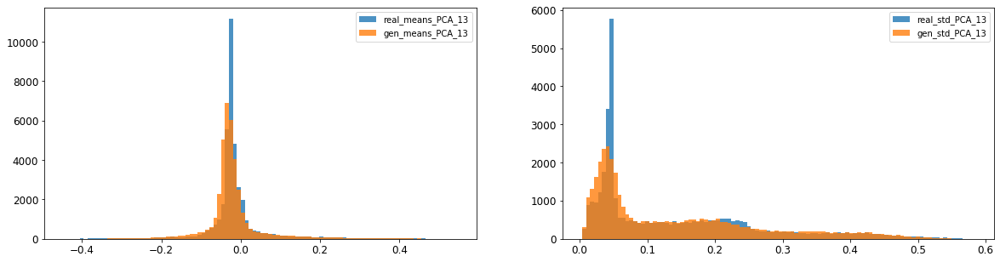

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.02504547337547152
14: mean 1-BC divergence = 0.017663465802187917

14: std KL divergence (r,g) = 0.030650784074017827
14: std JS divergence = 0.0075397982273297595
14: std 1-BC divergence = 0.005333743552194847


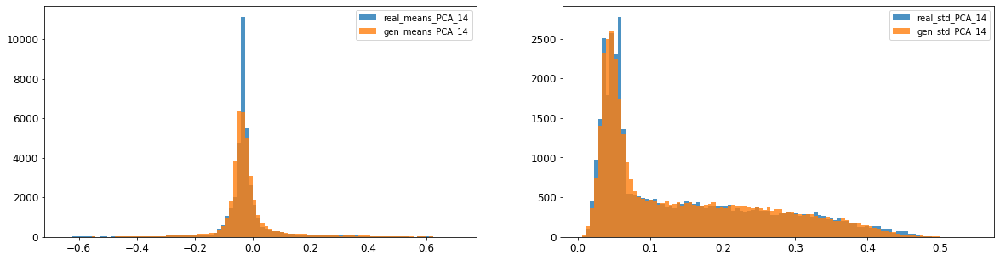

15: mean KL divergence (r,g) = 1.7701268409774253
15: mean JS divergence = 0.4860330499897322
15: mean 1-BC divergence = 0.4445313879374193

15: std KL divergence (r,g) = 5.85394171565956
15: std JS divergence = 0.9368143963999893
15: std 1-BC divergence = 0.8685096215452697


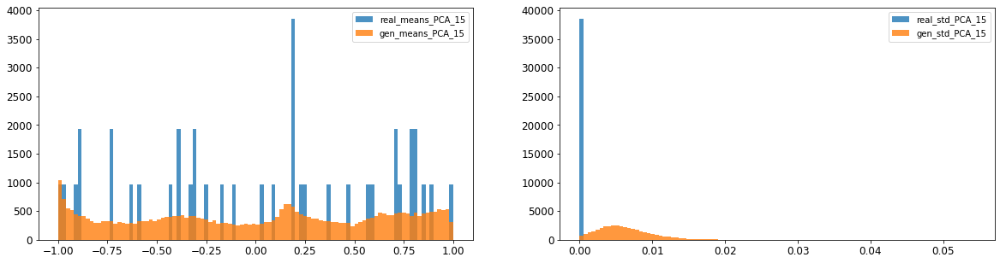

16: mean KL divergence (r,g) = 1.5115368304689778
16: mean JS divergence = 0.42507733719089086
16: mean 1-BC divergence = 0.3908671705068607

16: std KL divergence (r,g) = 5.397269727672752
16: std JS divergence = 0.9186494079125218
16: std 1-BC divergence = 0.8459612596097409


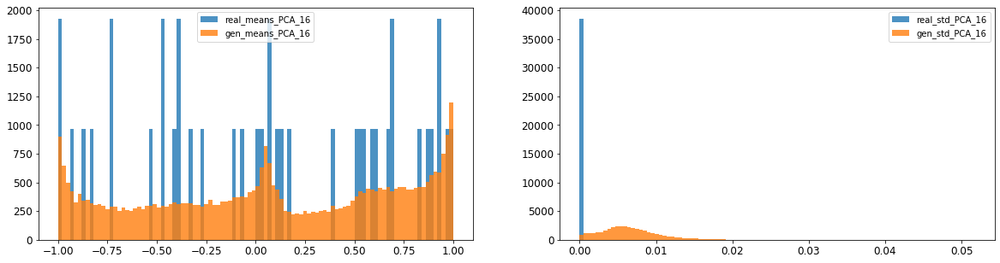



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.022625300359347823
Compose 1-BC divergence = 0.01734806905155184

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.025769134356473947
Compose weighted 1-BC divergence = 0.021381791346287482

Multivariate KL divergence = 70.43576321092213


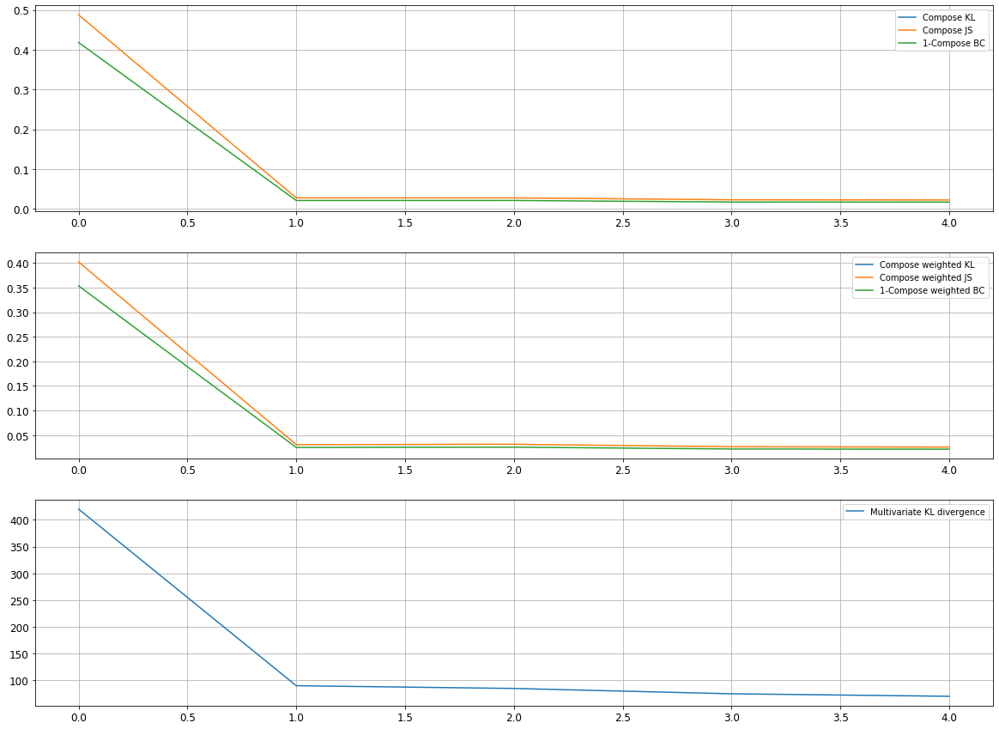

Epoch 802/10000
discriminator loss: 0.109227 - generator loss: 5.507144 - 37s
Epoch 803/10000
discriminator loss: 0.328377 - generator loss: 5.295576 - 39s
Epoch 804/10000
discriminator loss: 0.080755 - generator loss: 5.778094 - 37s
Epoch 805/10000
discriminator loss: 0.093282 - generator loss: 5.776671 - 39s
Epoch 806/10000
discriminator loss: 0.284241 - generator loss: 5.513368 - 36s
Epoch 807/10000
discriminator loss: 0.103230 - generator loss: 5.722503 - 40s
Epoch 808/10000
discriminator loss: 0.285501 - generator loss: 5.391497 - 40s
Epoch 809/10000
discriminator loss: 0.090458 - generator loss: 5.822725 - 39s
Epoch 810/10000
discriminator loss: 0.301581 - generator loss: 5.444217 - 41s
Epoch 811/10000
discriminator loss: 0.087657 - generator loss: 5.834267 - 37s
Epoch 812/10000
discriminator loss: 0.318233 - generator loss: 5.229999 - 39s
Epoch 813/10000
discriminator loss: 0.091603 - generator loss: 5.809599 - 36s
Epoch 814/10000
discriminator loss: 0.250123 - generator loss: 5

discriminator loss: 0.244281 - generator loss: 5.700525 - 39s
Epoch 908/10000
discriminator loss: 0.311067 - generator loss: 5.338019 - 38s
Epoch 909/10000
discriminator loss: 0.084261 - generator loss: 5.926456 - 37s
Epoch 910/10000
discriminator loss: 0.380218 - generator loss: 5.287939 - 39s
Epoch 911/10000
discriminator loss: 0.079839 - generator loss: 5.979202 - 36s
Epoch 912/10000
discriminator loss: 0.105796 - generator loss: 5.966153 - 39s
Epoch 913/10000
discriminator loss: 0.353145 - generator loss: 5.238063 - 38s
Epoch 914/10000
discriminator loss: 0.082775 - generator loss: 5.926916 - 37s
Epoch 915/10000
discriminator loss: 0.198908 - generator loss: 5.652224 - 38s
Epoch 916/10000
discriminator loss: 0.237077 - generator loss: 5.591258 - 39s
Epoch 917/10000
discriminator loss: 0.319567 - generator loss: 5.625687 - 39s
Epoch 918/10000
discriminator loss: 0.100978 - generator loss: 5.610045 - 39s
Epoch 919/10000
discriminator loss: 0.079612 - generator loss: 5.958407 - 37s
Ep

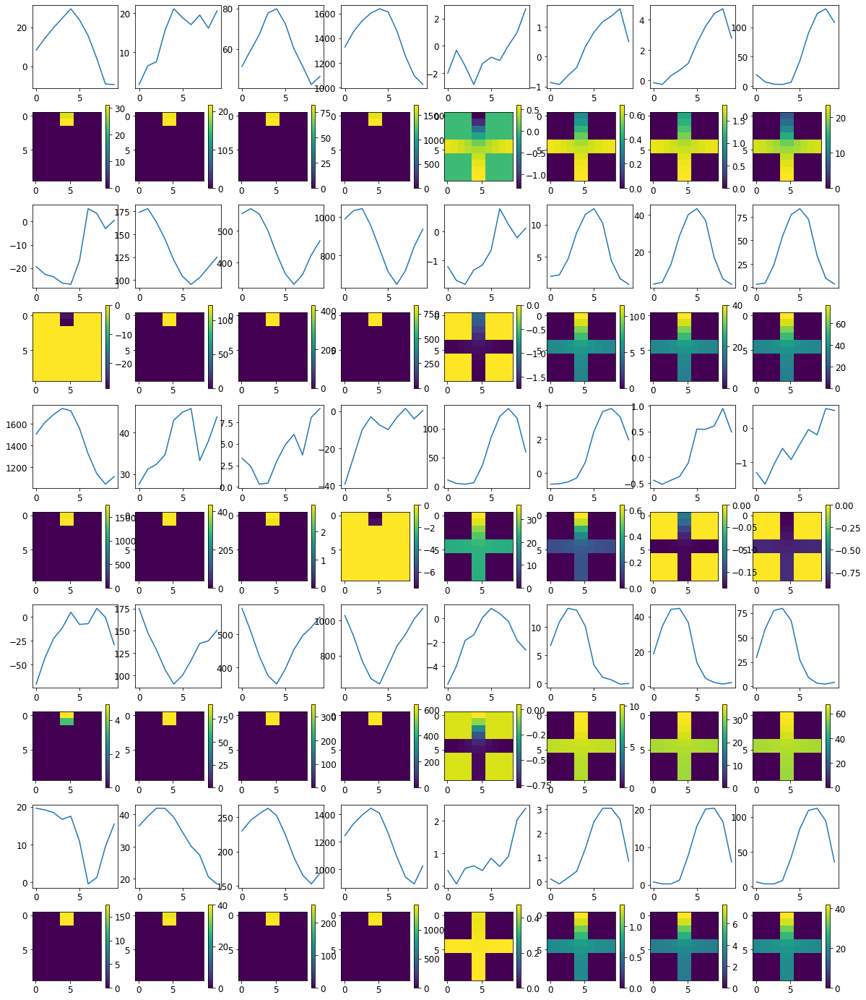


R0 generated:
[[19.749117   19.542326  ]
 [19.733612   19.54945   ]
 [19.723772   19.53325   ]
 [19.731163   19.5389    ]
 [19.73111    19.532822  ]
 [19.721317   19.52975   ]
 [19.714258   19.541767  ]
 [19.71754    19.542295  ]
 [19.71681    19.525158  ]
 [19.738497   19.569407  ]
 [18.174217    0.71702945]
 [17.913254    0.76742464]
 [17.861094    0.75701684]
 [17.854925    0.7345581 ]
 [17.860054    0.77820915]
 [17.855583    0.7561778 ]
 [17.88916     0.78408563]
 [17.809355    0.7635091 ]
 [17.794401    0.808089  ]
 [17.840536    0.78185004]
 [19.273386    1.5982585 ]
 [19.11348     1.7392135 ]
 [19.058327    1.772564  ]
 [19.056976    1.7176772 ]
 [19.057276    1.7396159 ]
 [19.079594    1.7395004 ]
 [19.058681    1.7574897 ]
 [19.009012    1.7401949 ]
 [19.023897    1.7949115 ]
 [19.14502     1.6606003 ]
 [19.816828   18.476593  ]
 [19.774849   18.450932  ]
 [19.757364   18.48478   ]
 [19.75566    18.45243   ]
 [19.769072   18.50912   ]
 [19.770977   18.406298  ]
 [19.770868  

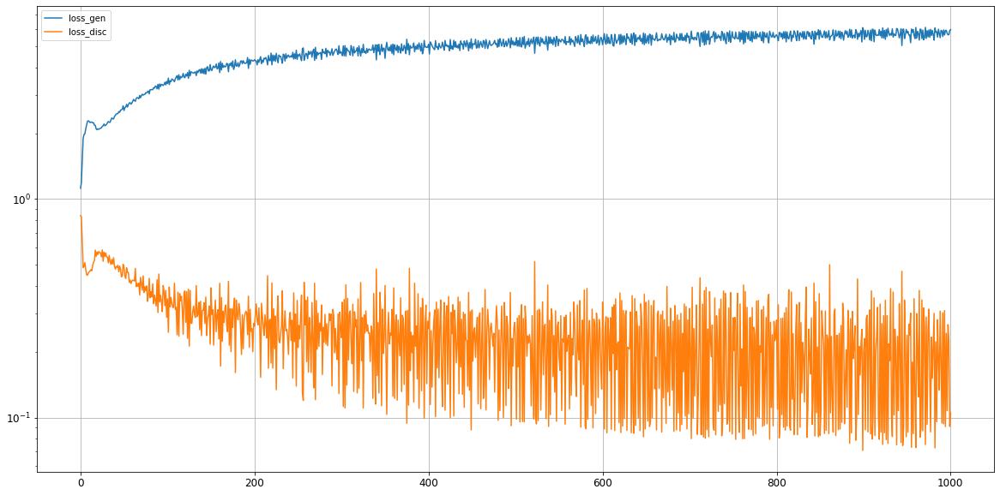

0: mean KL divergence (r,g) = 0.0675507391236187
0: mean JS divergence = 0.020681898910492224
0: mean 1-BC divergence = 0.0182757571892338

0: std KL divergence (r,g) = 0.1276225733133064
0: std JS divergence = 0.03767789737824499
0: std 1-BC divergence = 0.032858709961266164


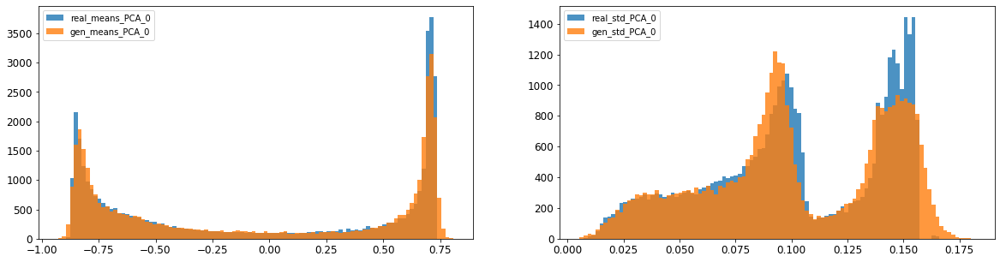

1: mean KL divergence (r,g) = 0.03511488192250661
1: mean JS divergence = 0.00918111142543417
1: mean 1-BC divergence = 0.006628781283652296

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.013821672787453027
1: std 1-BC divergence = 0.009910809965613554


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


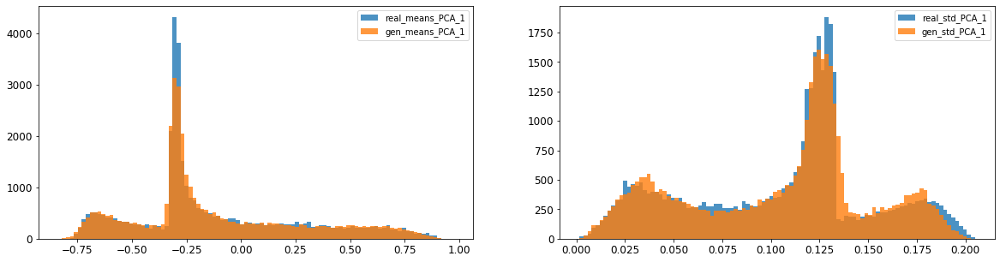

2: mean KL divergence (r,g) = 0.020776063823596203
2: mean JS divergence = 0.005054152033833001
2: mean 1-BC divergence = 0.003695008149423362

2: std KL divergence (r,g) = 0.0411086674465462
2: std JS divergence = 0.012618076456083422
2: std 1-BC divergence = 0.01132525219220426


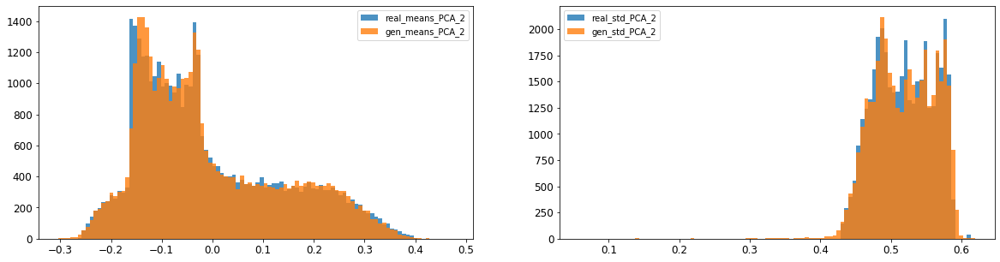

3: mean KL divergence (r,g) = 0.05874608764639267
3: mean JS divergence = 0.014081346349710233
3: mean 1-BC divergence = 0.009837910371325753

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.12496679081068754
3: std 1-BC divergence = 0.09841151000073478


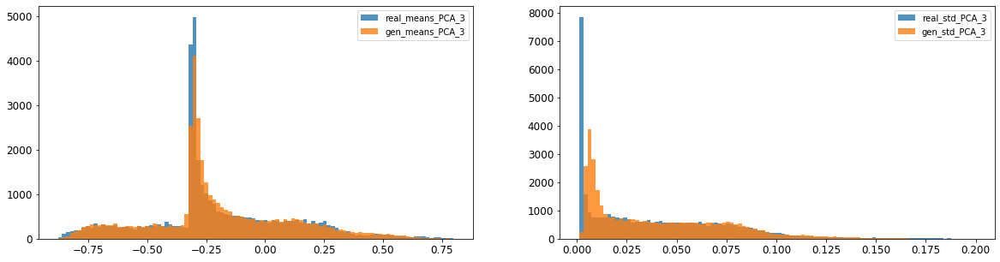

4: mean KL divergence (r,g) = 0.05398175603582363
4: mean JS divergence = 0.013362872578652223
4: mean 1-BC divergence = 0.010104116402888663

4: std KL divergence (r,g) = 0.02283877231702702
4: std JS divergence = 0.005701366234384253
4: std 1-BC divergence = 0.004149229747919869


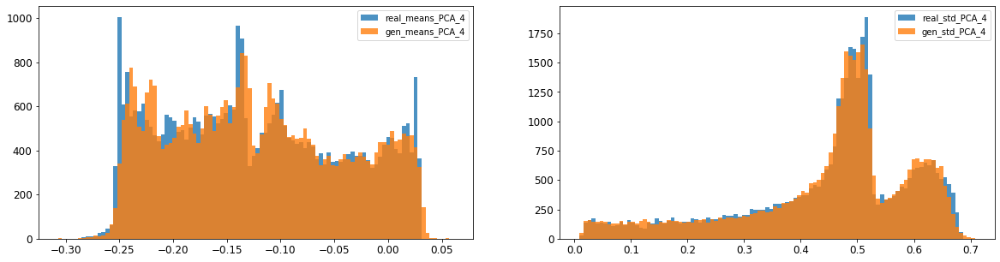

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.03396226989313371
5: mean 1-BC divergence = 0.02630817741758329

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.019735435528680793
5: std 1-BC divergence = 0.015607043699180756


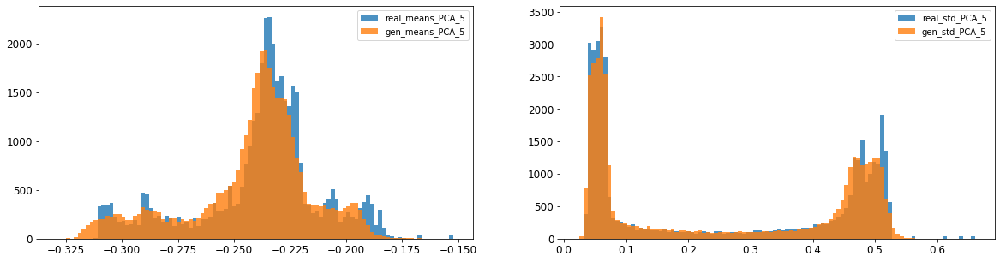

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.006197338153687613
6: mean 1-BC divergence = 0.00435774617068474

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.0194380844613181
6: std 1-BC divergence = 0.013899513589985202


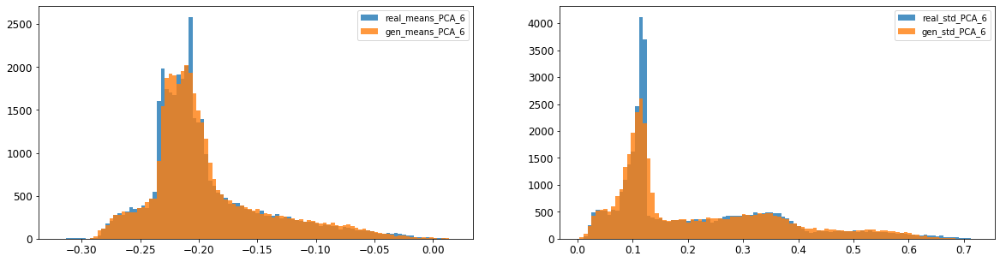

7: mean KL divergence (r,g) = 0.13313840044961994
7: mean JS divergence = 0.03106539614585723
7: mean 1-BC divergence = 0.022618838595818147

7: std KL divergence (r,g) = 0.09849848764376819
7: std JS divergence = 0.02350855244012886
7: std 1-BC divergence = 0.016605771450898255


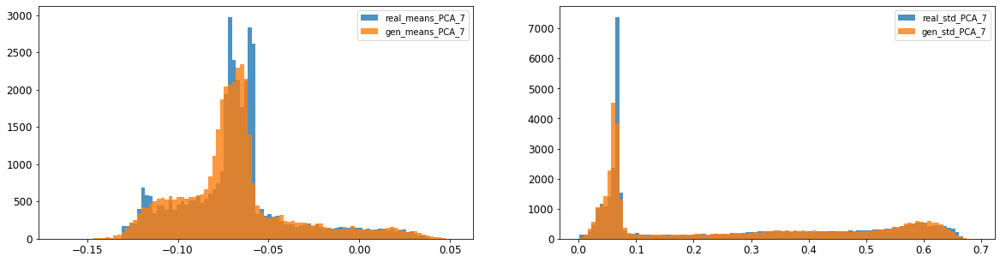

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.004546598755020092
8: mean 1-BC divergence = 0.0032240031287907867

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.02648899685585552
8: std 1-BC divergence = 0.018678525793622724


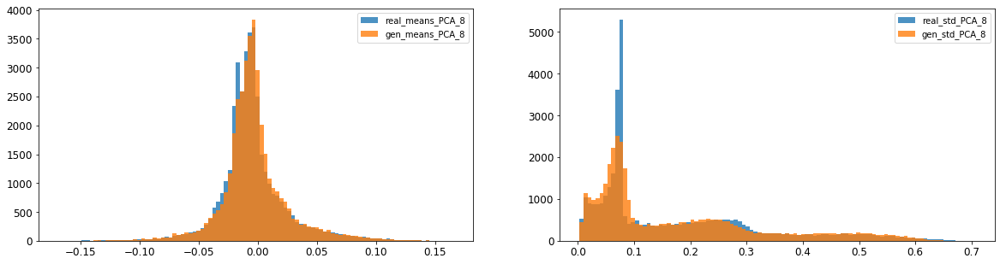

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.00821206096456702
9: mean 1-BC divergence = 0.005832861729315741

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.02086889179661774
9: std 1-BC divergence = 0.014831426924296953


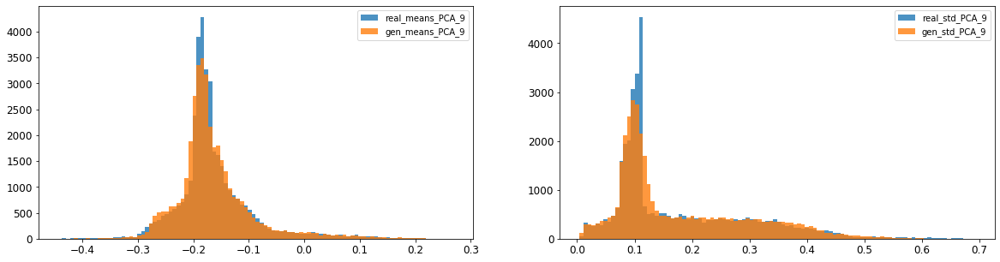

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.018736446659309527
10: mean 1-BC divergence = 0.013249451636980214

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.00976851947866441
10: std 1-BC divergence = 0.008416663700318572


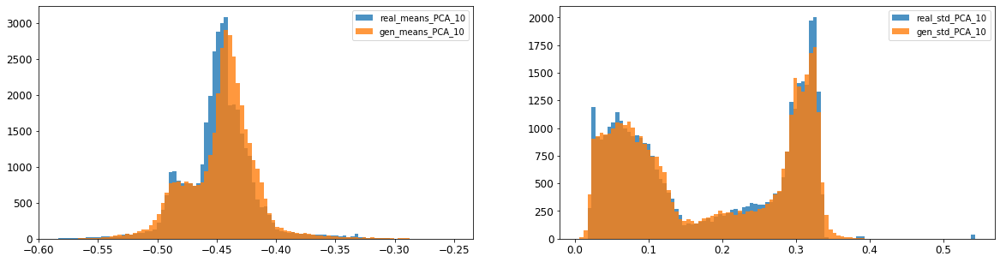

11: mean KL divergence (r,g) = 0.035276561145736005
11: mean JS divergence = 0.008865863886115957
11: mean 1-BC divergence = 0.006260682386151739

11: std KL divergence (r,g) = 0.05420234748012619
11: std JS divergence = 0.014013795735314635
11: std 1-BC divergence = 0.010019452422000974


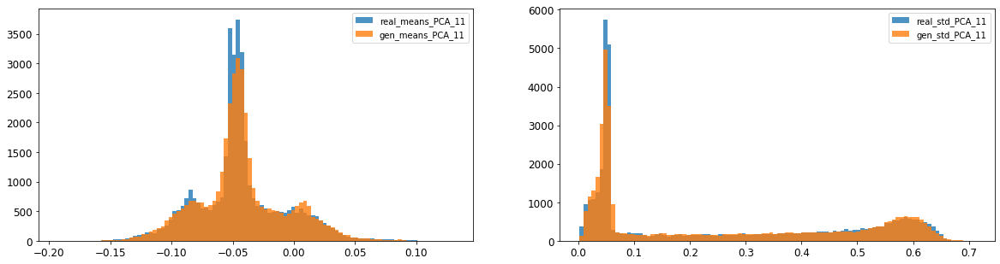

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.0037711964376737793
12: mean 1-BC divergence = 0.0027050517245782446

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.031689999705970986
12: std 1-BC divergence = 0.022580048639839756


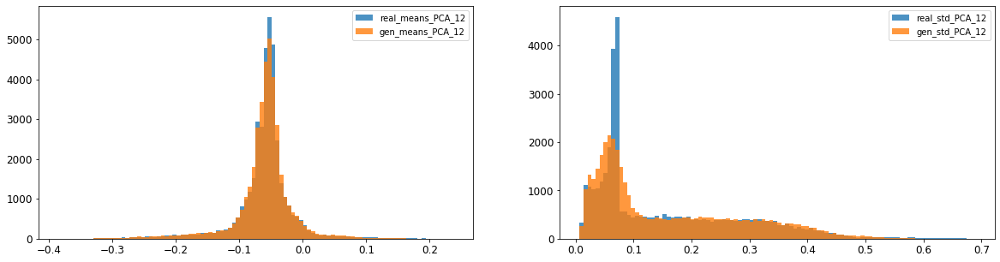

13: mean KL divergence (r,g) = 0.09866394566219729
13: mean JS divergence = 0.024652177943664387
13: mean 1-BC divergence = 0.017243066632663173

13: std KL divergence (r,g) = 0.12776102718546933
13: std JS divergence = 0.03004084616389755
13: std 1-BC divergence = 0.021092314136640034


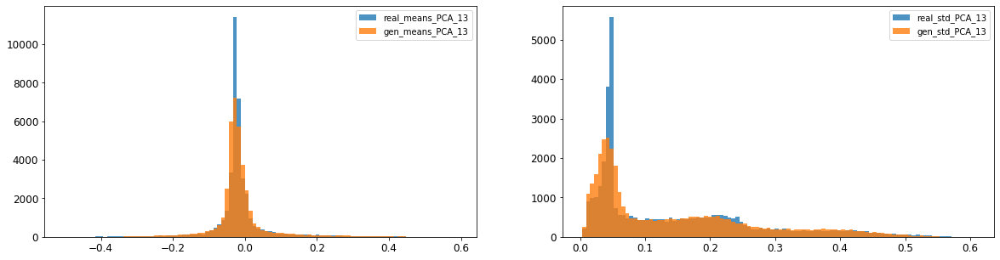

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.023455132303340686
14: mean 1-BC divergence = 0.01646208609419242

14: std KL divergence (r,g) = 0.03302232648777873
14: std JS divergence = 0.007957473885691697
14: std 1-BC divergence = 0.005581231293756872


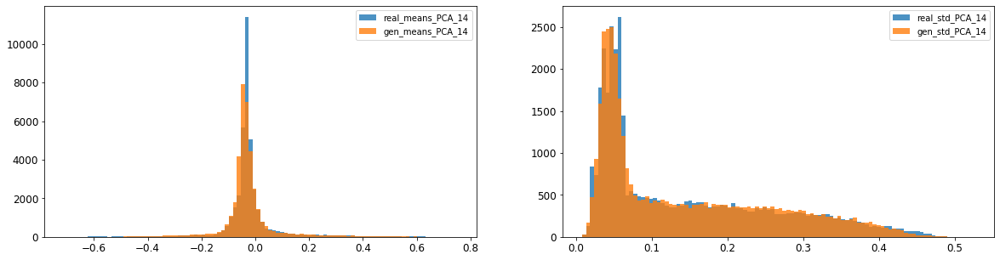

15: mean KL divergence (r,g) = 1.7637143328812617
15: mean JS divergence = 0.48400813756549
15: mean 1-BC divergence = 0.44255830865575096

15: std KL divergence (r,g) = 5.891245414731683
15: std JS divergence = 0.9381156402185451
15: std 1-BC divergence = 0.8701986500589409


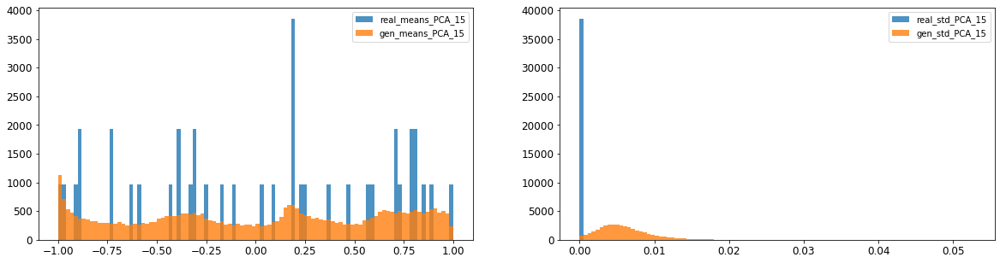

16: mean KL divergence (r,g) = 1.524930048010892
16: mean JS divergence = 0.4288987779628083
16: mean 1-BC divergence = 0.39389826098616243

16: std KL divergence (r,g) = 5.411546100760254
16: std JS divergence = 0.9192846957455898
16: std 1-BC divergence = 0.8467215322323303


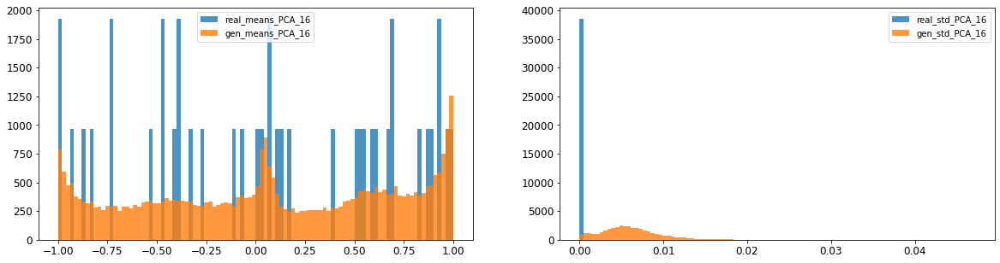



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.02080407540531618
Compose 1-BC divergence = 0.01569236808105212

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.024468813691875833
Compose weighted 1-BC divergence = 0.020490146173928636

Multivariate KL divergence = 65.21709451177168


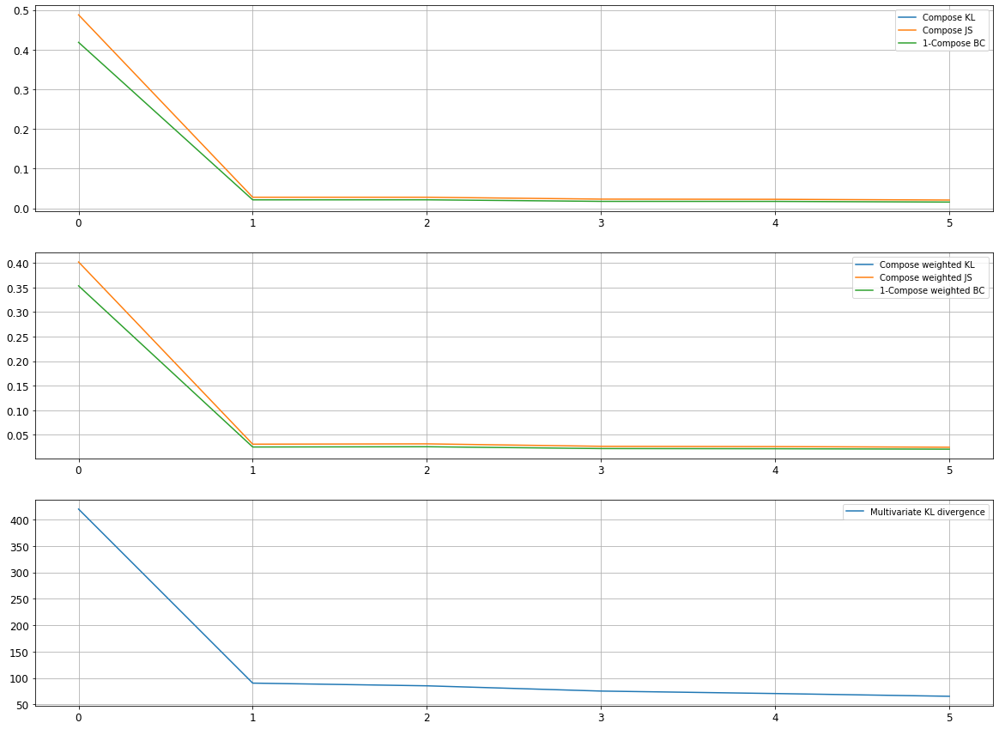

Epoch 1002/10000
discriminator loss: 0.368439 - generator loss: 5.350552 - 35s
Epoch 1003/10000
discriminator loss: 0.083965 - generator loss: 6.014489 - 38s
Epoch 1004/10000
discriminator loss: 0.304097 - generator loss: 5.574903 - 38s
Epoch 1005/10000
discriminator loss: 0.080329 - generator loss: 6.040526 - 38s
Epoch 1006/10000
discriminator loss: 0.321209 - generator loss: 5.476961 - 39s
Epoch 1007/10000
discriminator loss: 0.144007 - generator loss: 5.887866 - 39s
Epoch 1008/10000
discriminator loss: 0.078925 - generator loss: 6.081839 - 38s
Epoch 1009/10000
discriminator loss: 0.396474 - generator loss: 5.269650 - 39s
Epoch 1010/10000
discriminator loss: 0.073850 - generator loss: 6.062783 - 41s
Epoch 1011/10000
discriminator loss: 0.244840 - generator loss: 5.778620 - 40s
Epoch 1012/10000
discriminator loss: 0.114701 - generator loss: 5.732033 - 39s
Epoch 1013/10000
discriminator loss: 0.269516 - generator loss: 5.696692 - 38s
Epoch 1014/10000
discriminator loss: 0.077793 - gene

discriminator loss: 0.067935 - generator loss: 6.197907 - 39s
Epoch 1107/10000
discriminator loss: 0.299104 - generator loss: 5.473440 - 39s
Epoch 1108/10000
discriminator loss: 0.225163 - generator loss: 5.711562 - 41s
Epoch 1109/10000
discriminator loss: 0.084474 - generator loss: 6.021808 - 42s
Epoch 1110/10000
discriminator loss: 0.075177 - generator loss: 6.152557 - 39s
Epoch 1111/10000
discriminator loss: 0.403314 - generator loss: 5.515862 - 39s
Epoch 1112/10000
discriminator loss: 0.080211 - generator loss: 6.049051 - 39s
Epoch 1113/10000
discriminator loss: 0.381312 - generator loss: 5.577411 - 38s
Epoch 1114/10000
discriminator loss: 0.073644 - generator loss: 6.178088 - 40s
Epoch 1115/10000
discriminator loss: 0.259002 - generator loss: 5.773385 - 38s
Epoch 1116/10000
discriminator loss: 0.079395 - generator loss: 6.076594 - 34s
Epoch 1117/10000
discriminator loss: 0.258614 - generator loss: 5.510502 - 32s
Epoch 1118/10000
discriminator loss: 0.080199 - generator loss: 6.145

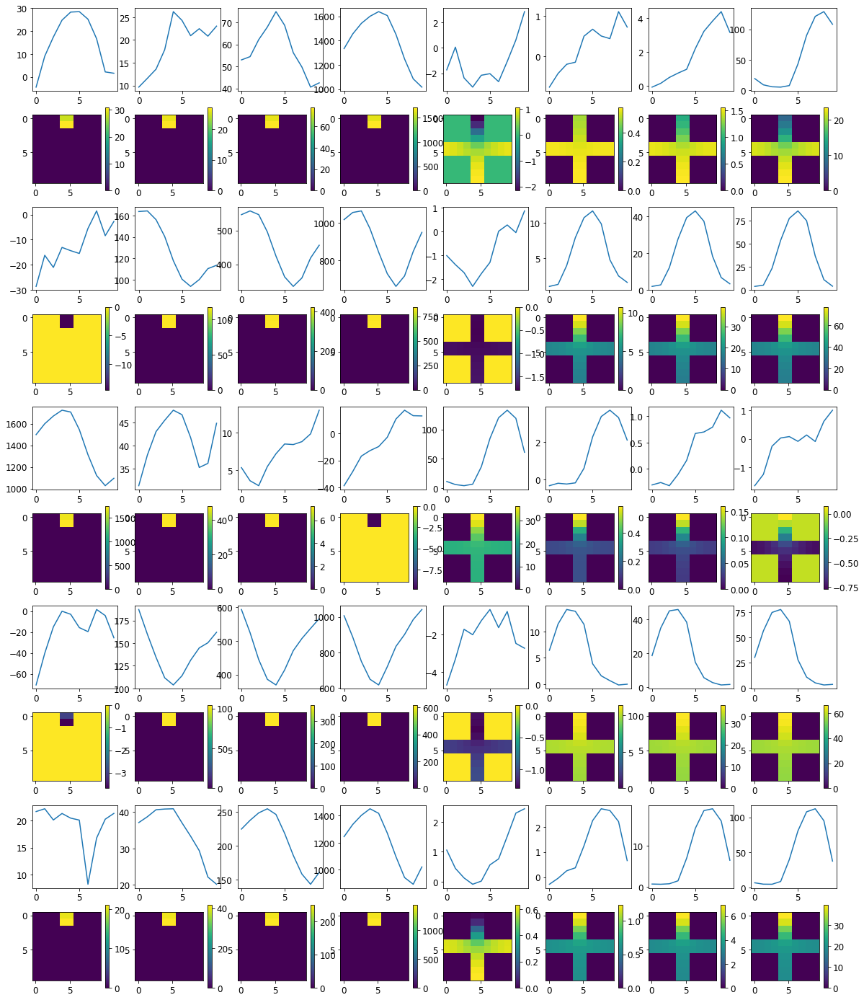


R0 generated:
[[19.703066   19.457102  ]
 [19.656      19.474926  ]
 [19.662052   19.452961  ]
 [19.671175   19.468004  ]
 [19.685844   19.4533    ]
 [19.678267   19.461485  ]
 [19.67798    19.458487  ]
 [19.672556   19.472157  ]
 [19.675331   19.440544  ]
 [19.699696   19.508661  ]
 [17.791817    0.7963296 ]
 [17.562336    0.90200174]
 [17.545511    0.84426296]
 [17.536263    0.851915  ]
 [17.583672    0.8761149 ]
 [17.542442    0.86913633]
 [17.555029    0.86954975]
 [17.468687    0.85845274]
 [17.511879    0.88981724]
 [17.508144    0.8418151 ]
 [19.282442    0.99989116]
 [19.080393    1.1473076 ]
 [19.062914    1.1317761 ]
 [19.070179    1.0690612 ]
 [19.08996     1.1228296 ]
 [19.102064    1.1273842 ]
 [19.095804    1.0557373 ]
 [19.028793    1.1292577 ]
 [19.003933    1.0822794 ]
 [19.149412    1.0157843 ]
 [19.797203   18.512857  ]
 [19.751934   18.520475  ]
 [19.737066   18.5151    ]
 [19.73231    18.546741  ]
 [19.752417   18.552675  ]
 [19.75178    18.514116  ]
 [19.759413  

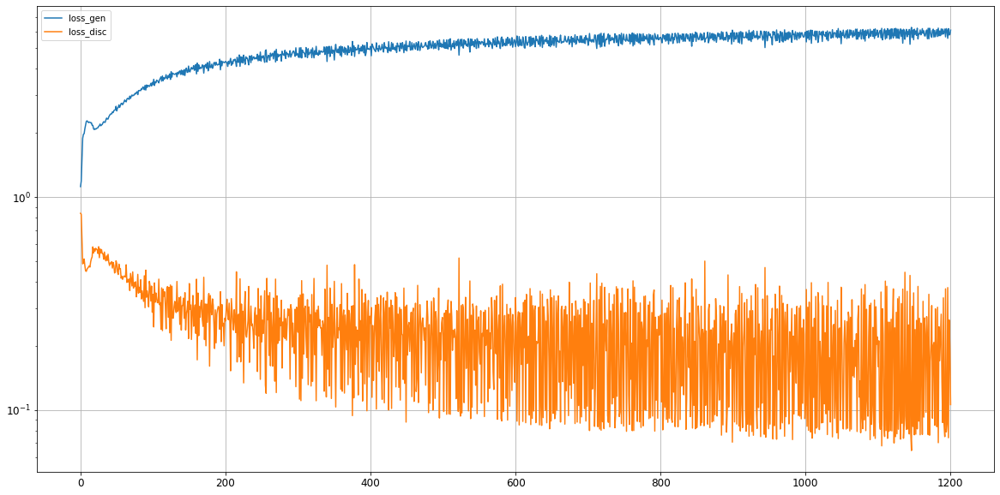

0: mean KL divergence (r,g) = 0.05341353623607252
0: mean JS divergence = 0.014924031069988408
0: mean 1-BC divergence = 0.012269905417623406

0: std KL divergence (r,g) = 0.11301777010870839
0: std JS divergence = 0.034343746976570624
0: std 1-BC divergence = 0.03064619902323129


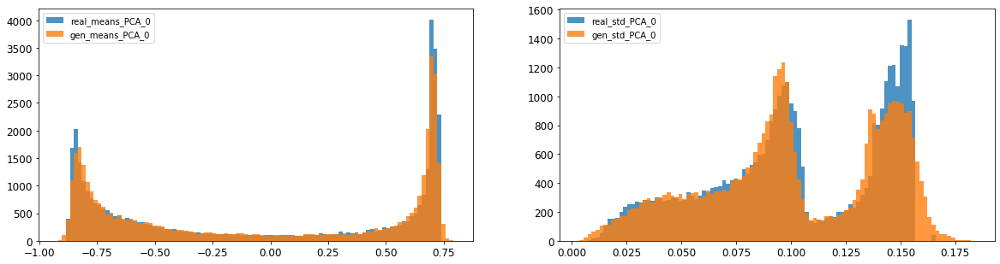

1: mean KL divergence (r,g) = 0.03749518580252825
1: mean JS divergence = 0.009928560272284271
1: mean 1-BC divergence = 0.007128343605760534

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.011821568420780939
1: std 1-BC divergence = 0.008441612906386675


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


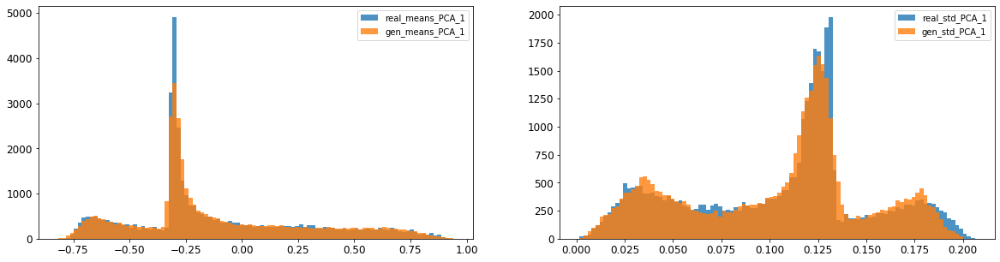

2: mean KL divergence (r,g) = 0.013476380709226125
2: mean JS divergence = 0.0034635947716629015
2: mean 1-BC divergence = 0.002540504796193388

2: std KL divergence (r,g) = 0.05005021453959619
2: std JS divergence = 0.015990667259581103
2: std 1-BC divergence = 0.015128090772229319


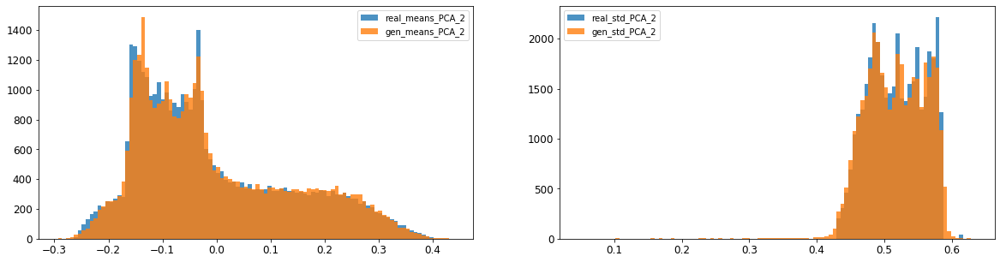

3: mean KL divergence (r,g) = 0.11160289959248118
3: mean JS divergence = 0.027795707078198395
3: mean 1-BC divergence = 0.019691021877792148

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.10261071312588771
3: std 1-BC divergence = 0.07811556865780278


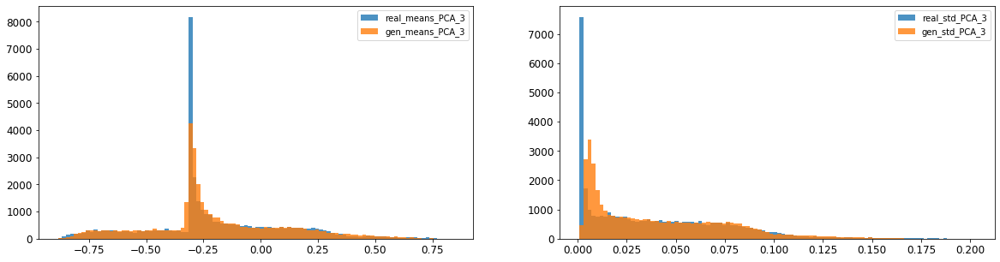

4: mean KL divergence (r,g) = 0.06064971420116236
4: mean JS divergence = 0.014828150851530586
4: mean 1-BC divergence = 0.010939372989779983

4: std KL divergence (r,g) = 0.025226307731828903
4: std JS divergence = 0.00603885277327507
4: std 1-BC divergence = 0.0042561112762387054


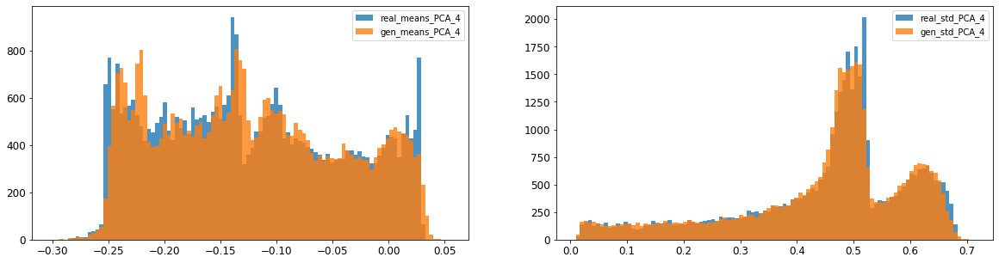

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.0334704152593063
5: mean 1-BC divergence = 0.024105445895316047

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.01794959218870973
5: std 1-BC divergence = 0.015579752232607436


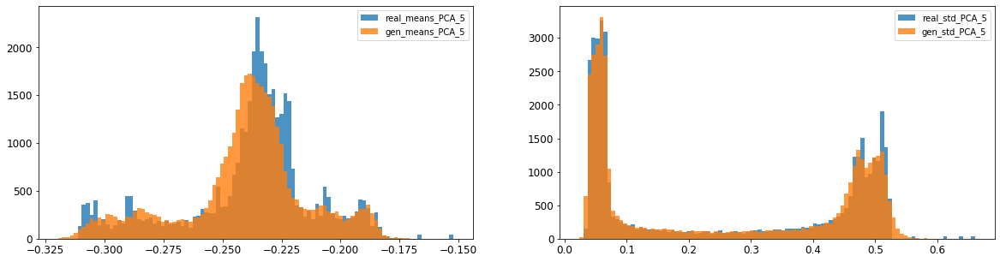

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0035498171882116175
6: mean 1-BC divergence = 0.0025274580190765006

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.014697984582111003
6: std 1-BC divergence = 0.01050284527895251


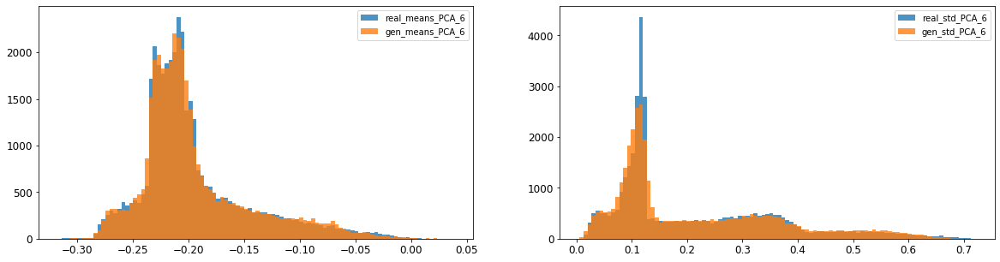

7: mean KL divergence (r,g) = 0.07323330548269513
7: mean JS divergence = 0.01819687613798874
7: mean 1-BC divergence = 0.013592768426231694

7: std KL divergence (r,g) = 0.0643179154890104
7: std JS divergence = 0.01526377033062857
7: std 1-BC divergence = 0.010691994173424257


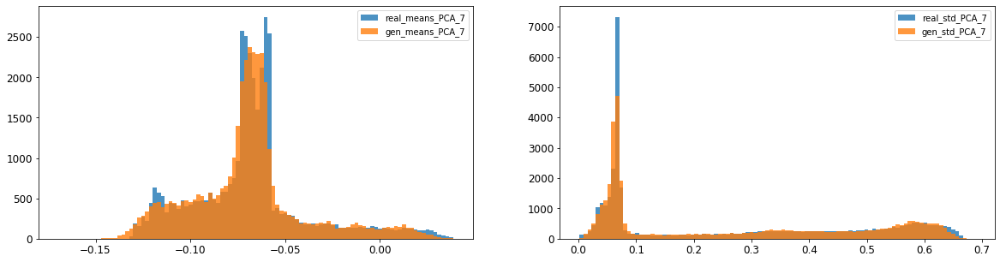

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0025966622231636868
8: mean 1-BC divergence = 0.0018410388308799375

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.017133867700475855
8: std 1-BC divergence = 0.012084757818576763


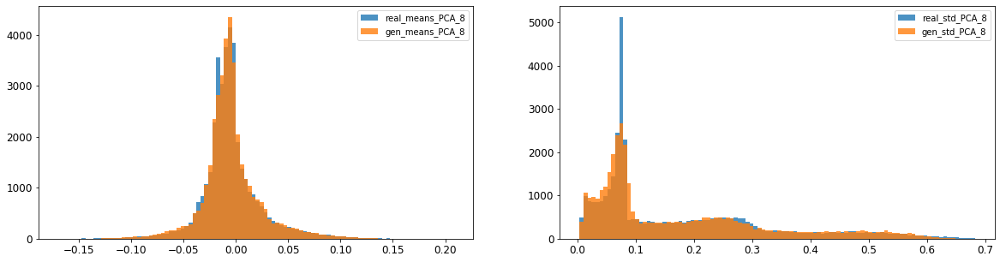

9: mean KL divergence (r,g) = 0.031195554571466638
9: mean JS divergence = 0.007954300626979514
9: mean 1-BC divergence = 0.005577700204514202

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.018074731028171934
9: std 1-BC divergence = 0.012870652528798598


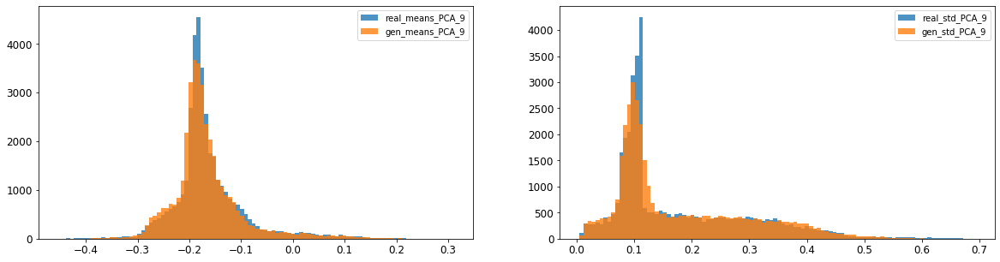

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.012230324549896743
10: mean 1-BC divergence = 0.00867462138181041

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.009871934969103663
10: std 1-BC divergence = 0.008171101992243135


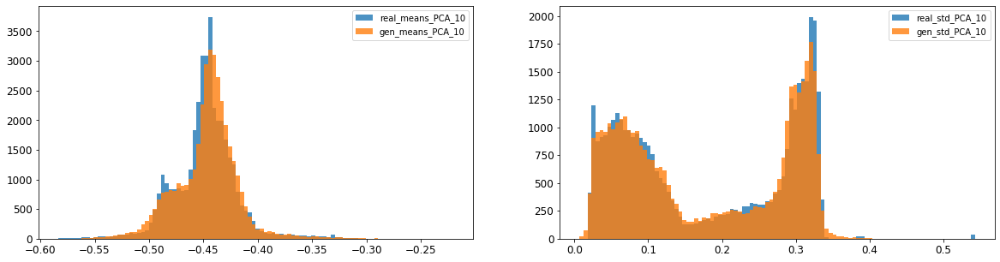

11: mean KL divergence (r,g) = 0.03366042984794164
11: mean JS divergence = 0.008553943852720184
11: mean 1-BC divergence = 0.006094344251146078

11: std KL divergence (r,g) = 0.08273189795519544
11: std JS divergence = 0.021108502847141886
11: std 1-BC divergence = 0.01510929530759264


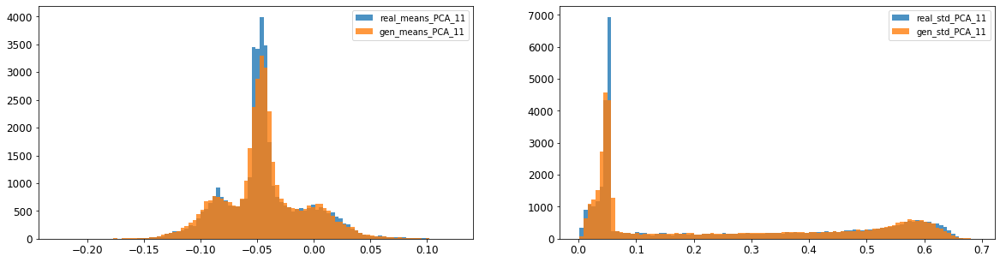

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.005638415164339564
12: mean 1-BC divergence = 0.004005815926251266

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.026912193842983913
12: std 1-BC divergence = 0.01924158659913111


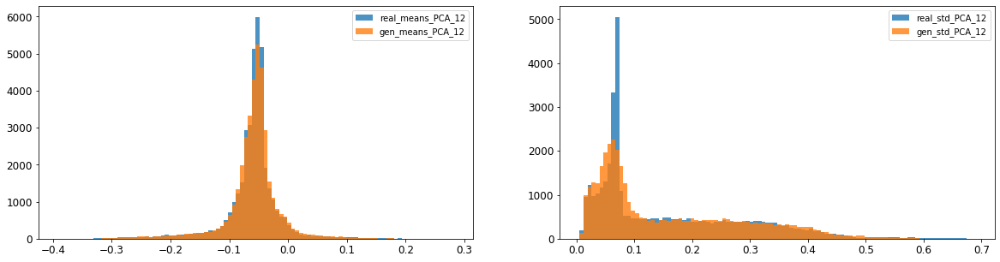

13: mean KL divergence (r,g) = 0.11500481833286216
13: mean JS divergence = 0.028164632683339845
13: mean 1-BC divergence = 0.019750637899550894

13: std KL divergence (r,g) = 0.09666959164728517
13: std JS divergence = 0.023545610691016884
13: std 1-BC divergence = 0.016484966051854566


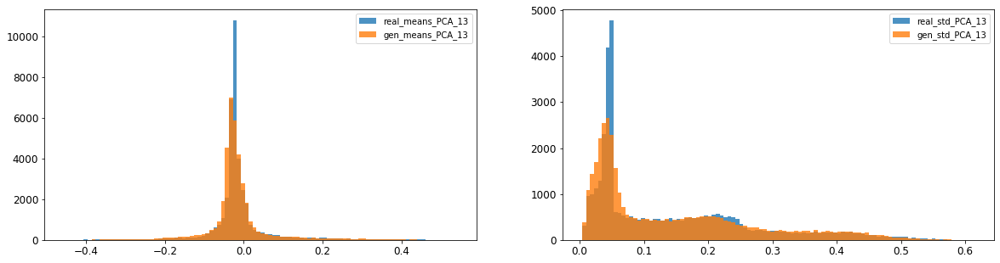

14: mean KL divergence (r,g) = 0.09881521903970533
14: mean JS divergence = 0.023977976548508965
14: mean 1-BC divergence = 0.01680895267443816

14: std KL divergence (r,g) = 0.029234872172764968
14: std JS divergence = 0.00708740261817788
14: std 1-BC divergence = 0.004965850561086449


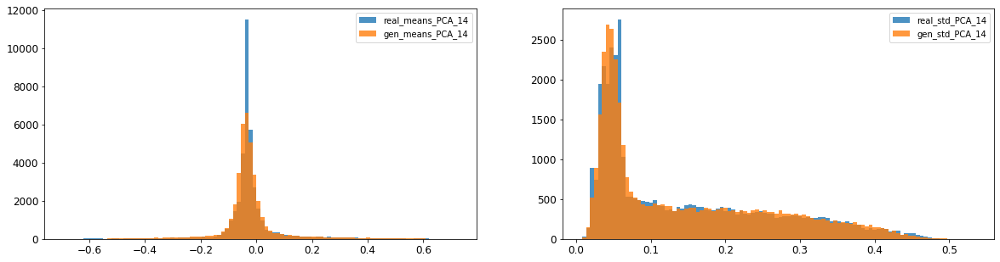

15: mean KL divergence (r,g) = 1.7410188327083989
15: mean JS divergence = 0.47995394235980826
15: mean 1-BC divergence = 0.43898862963160645

15: std KL divergence (r,g) = 5.86918542772277
15: std JS divergence = 0.9373492232855323
15: std 1-BC divergence = 0.8692024623843644


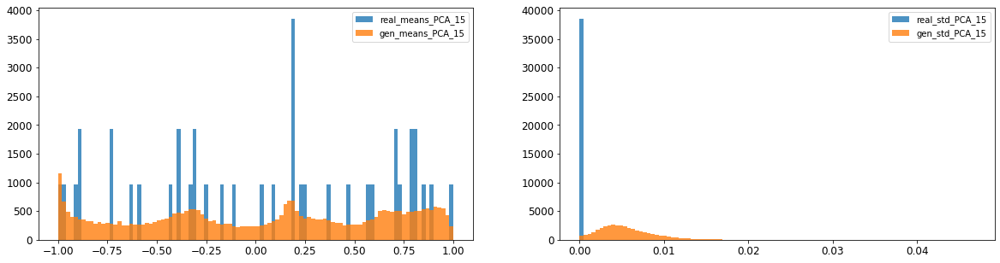

16: mean KL divergence (r,g) = 1.5130681908864274
16: mean JS divergence = 0.42534920082760924
16: mean 1-BC divergence = 0.3905212411471808

16: std KL divergence (r,g) = 5.493539472957561
16: std JS divergence = 0.9228443675438552
16: std 1-BC divergence = 0.8510159012436462


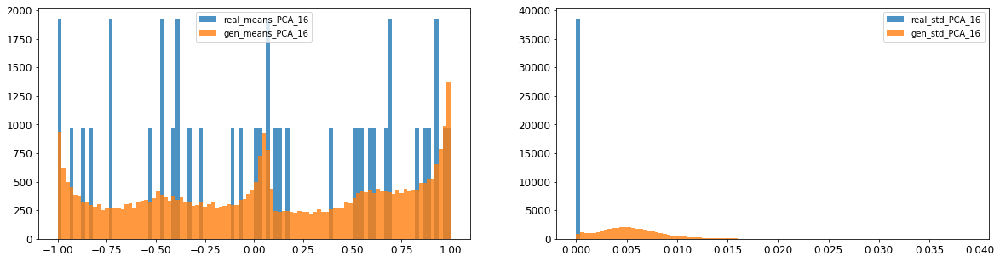



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01859081825442455
Compose 1-BC divergence = 0.013927943912550589

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.02146094059629574
Compose weighted 1-BC divergence = 0.017797764541465422

Multivariate KL divergence = 60.84442892638247


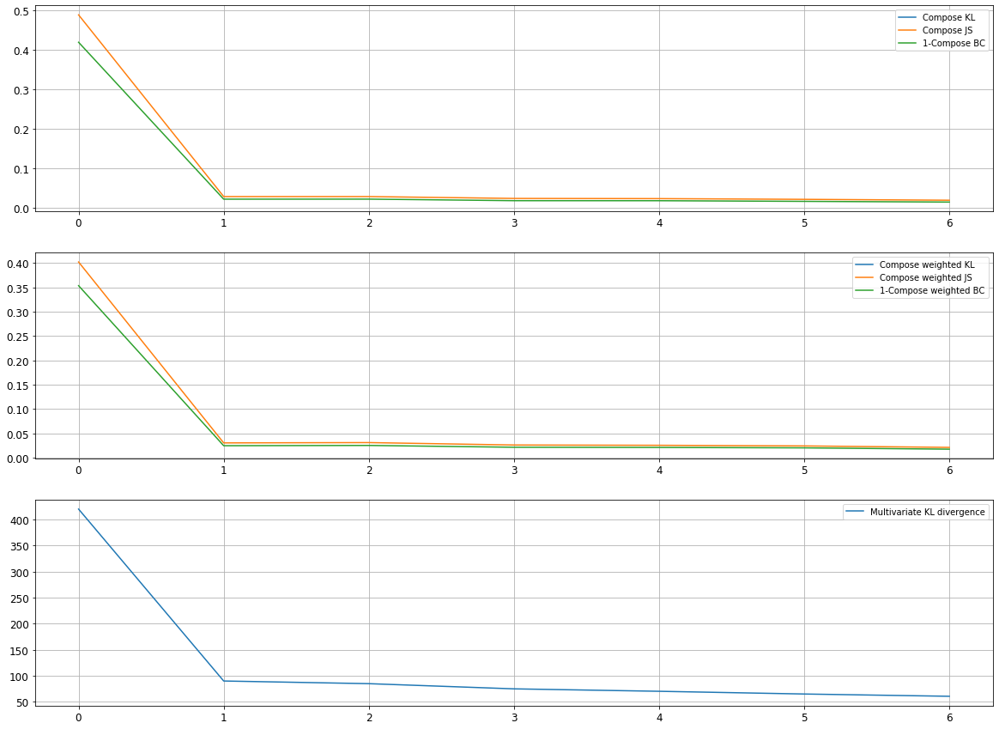

Epoch 1202/10000
discriminator loss: 0.176948 - generator loss: 6.075065 - 37s
Epoch 1203/10000
discriminator loss: 0.138900 - generator loss: 6.233750 - 39s
Epoch 1204/10000
discriminator loss: 0.208231 - generator loss: 5.761599 - 39s
Epoch 1205/10000
discriminator loss: 0.320592 - generator loss: 5.906734 - 36s
Epoch 1206/10000
discriminator loss: 0.137976 - generator loss: 5.551250 - 36s
Epoch 1207/10000
discriminator loss: 0.073502 - generator loss: 6.241279 - 38s
Epoch 1208/10000
discriminator loss: 0.314216 - generator loss: 5.651239 - 37s
Epoch 1209/10000
discriminator loss: 0.085154 - generator loss: 6.221307 - 36s
Epoch 1210/10000
discriminator loss: 0.347426 - generator loss: 5.539064 - 35s
Epoch 1211/10000
discriminator loss: 0.078160 - generator loss: 6.151800 - 33s
Epoch 1212/10000
discriminator loss: 0.235228 - generator loss: 5.901499 - 39s
Epoch 1213/10000
discriminator loss: 0.133339 - generator loss: 6.018547 - 36s
Epoch 1214/10000
discriminator loss: 0.323271 - gene

discriminator loss: 0.174195 - generator loss: 5.897985 - 39s
Epoch 1307/10000
discriminator loss: 0.074270 - generator loss: 6.253764 - 35s
Epoch 1308/10000
discriminator loss: 0.322873 - generator loss: 5.687475 - 36s
Epoch 1309/10000
discriminator loss: 0.070839 - generator loss: 6.223075 - 36s
Epoch 1310/10000
discriminator loss: 0.307746 - generator loss: 5.711164 - 35s
Epoch 1311/10000
discriminator loss: 0.075051 - generator loss: 6.163156 - 35s
Epoch 1312/10000
discriminator loss: 0.220271 - generator loss: 5.938333 - 37s
Epoch 1313/10000
discriminator loss: 0.264712 - generator loss: 5.903945 - 31s
Epoch 1314/10000
discriminator loss: 0.125148 - generator loss: 6.019183 - 33s
Epoch 1315/10000
discriminator loss: 0.079028 - generator loss: 6.227786 - 36s
Epoch 1316/10000
discriminator loss: 0.354832 - generator loss: 6.123580 - 37s
Epoch 1317/10000
discriminator loss: 0.108322 - generator loss: 5.769022 - 40s
Epoch 1318/10000
discriminator loss: 0.217373 - generator loss: 5.883

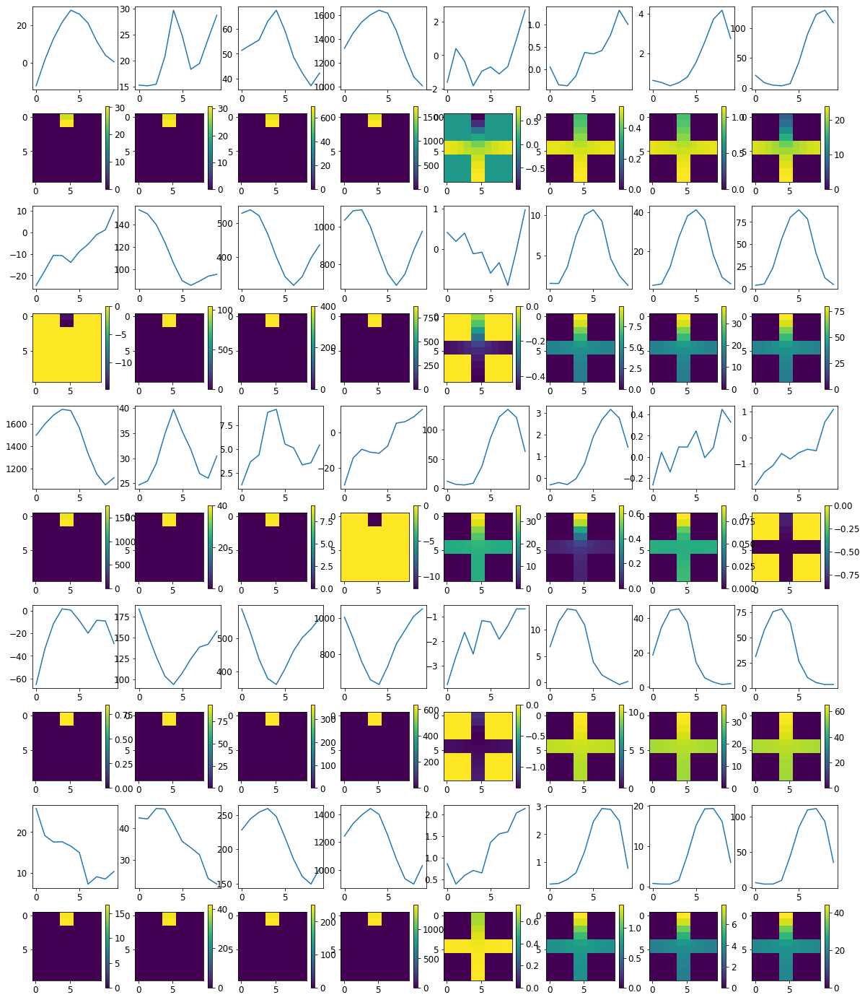


R0 generated:
[[19.753412  19.146223 ]
 [19.725512  19.164532 ]
 [19.728594  19.131866 ]
 [19.729353  19.127243 ]
 [19.737167  19.139065 ]
 [19.737103  19.14946  ]
 [19.733252  19.164152 ]
 [19.725082  19.167097 ]
 [19.715193  19.143885 ]
 [19.736908  19.228014 ]
 [18.367697   1.1320397]
 [18.155611   1.2521803]
 [18.127234   1.2809576]
 [18.117151   1.2340983]
 [18.162355   1.2321595]
 [18.169598   1.2104208]
 [18.207315   1.2038574]
 [18.153072   1.1626315]
 [18.159397   1.2475265]
 [18.163422   1.1823404]
 [19.077848   1.1346   ]
 [18.86704    1.2511272]
 [18.856447   1.2942616]
 [18.868887   1.223361 ]
 [18.87702    1.269681 ]
 [18.879423   1.291577 ]
 [18.855225   1.2355864]
 [18.831297   1.3491076]
 [18.836718   1.33187  ]
 [18.94072    1.1368275]
 [19.78968   18.78018  ]
 [19.763792  18.769646 ]
 [19.746996  18.787035 ]
 [19.742207  18.772936 ]
 [19.75342   18.776344 ]
 [19.753181  18.727436 ]
 [19.758717  18.73107  ]
 [19.753208  18.715963 ]
 [19.746037  18.707914 ]
 [19.75602

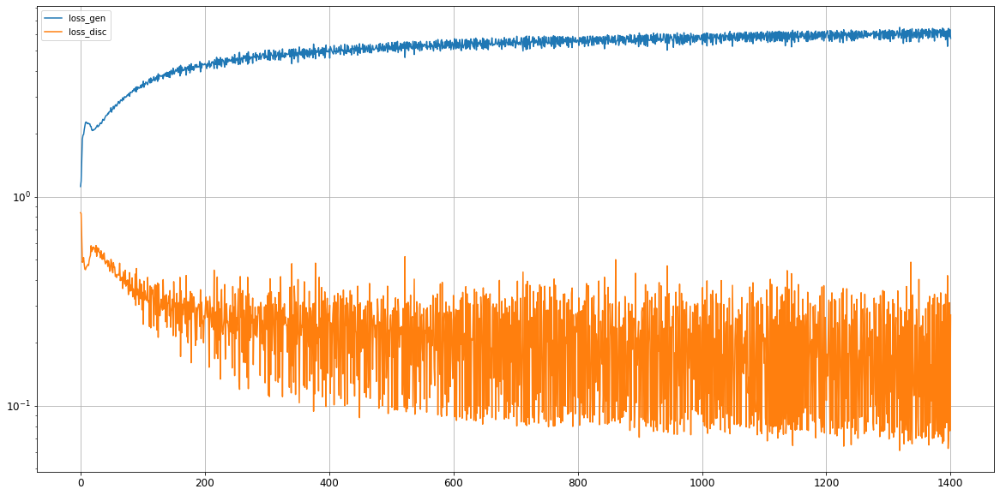

0: mean KL divergence (r,g) = 0.06547124614555133
0: mean JS divergence = 0.018159227408002465
0: mean 1-BC divergence = 0.015099465511772436

0: std KL divergence (r,g) = 0.09299694349116945
0: std JS divergence = 0.02760442934099005
0: std 1-BC divergence = 0.024206544157782672


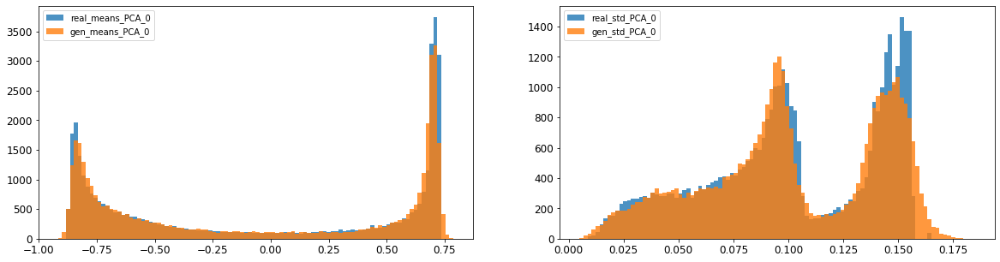

1: mean KL divergence (r,g) = 0.045264651531074444
1: mean JS divergence = 0.012446310794605356
1: mean 1-BC divergence = 0.008968641397713806

1: std KL divergence (r,g) = 0.0422993879788537
1: std JS divergence = 0.009741394318214995
1: std 1-BC divergence = 0.006821050684641006


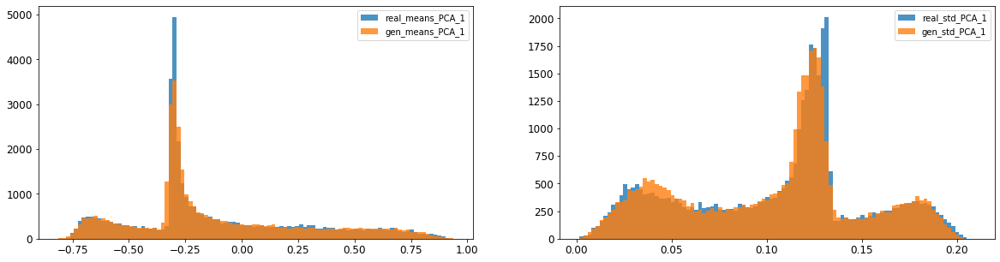

2: mean KL divergence (r,g) = 0.019056350226857945
2: mean JS divergence = 0.004888247930101296
2: mean 1-BC divergence = 0.0036452157617959946

2: std KL divergence (r,g) = 0.039160974465142384
2: std JS divergence = 0.012004317654631134
2: std 1-BC divergence = 0.010996479267750714


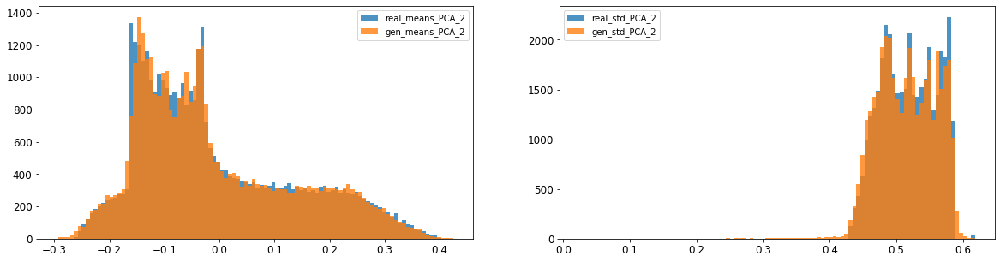

3: mean KL divergence (r,g) = 0.10283910786011444
3: mean JS divergence = 0.024967793014789186
3: mean 1-BC divergence = 0.017516017123183403

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.08401922739087525
3: std 1-BC divergence = 0.061512044598516225


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


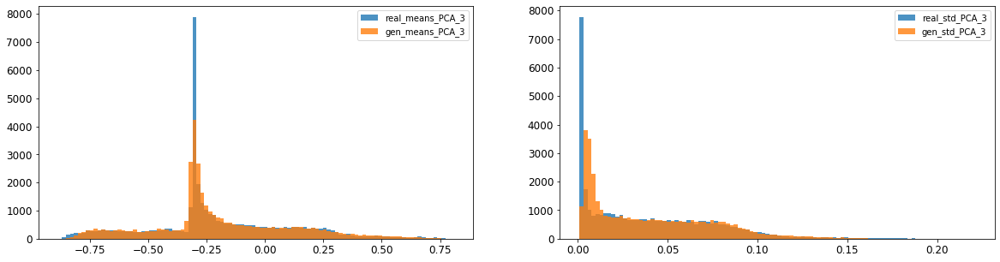

4: mean KL divergence (r,g) = 0.049358460459367814
4: mean JS divergence = 0.014334642178163135
4: mean 1-BC divergence = 0.011770937506744739

4: std KL divergence (r,g) = 0.023567431847182237
4: std JS divergence = 0.0057910407165322085
4: std 1-BC divergence = 0.004156948186817888


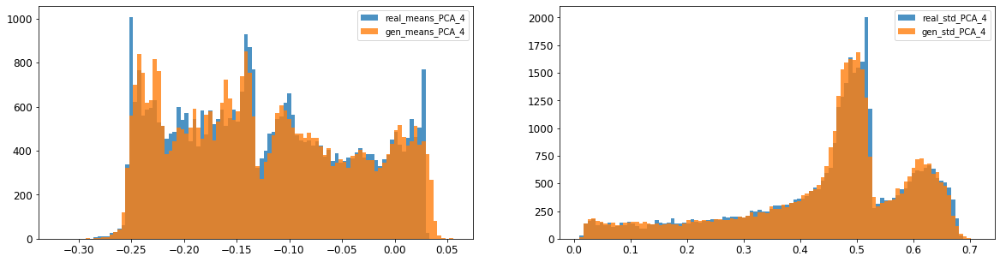

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.01769266371200888
5: mean 1-BC divergence = 0.012885653217665438

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.02284136708427801
5: std 1-BC divergence = 0.01876272356958608


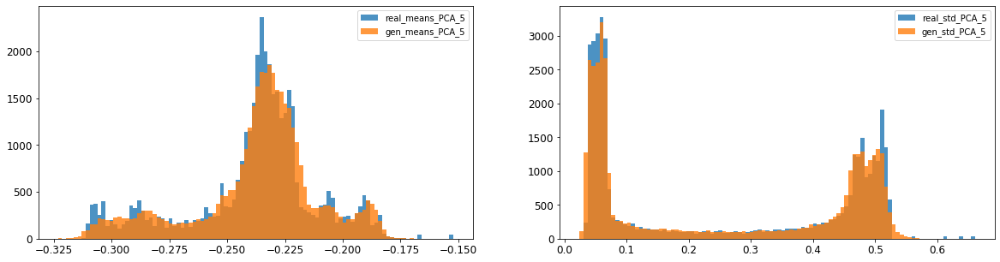

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.005382032491131666
6: mean 1-BC divergence = 0.003794449446181125

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.013264560403859427
6: std 1-BC divergence = 0.009420713109533074


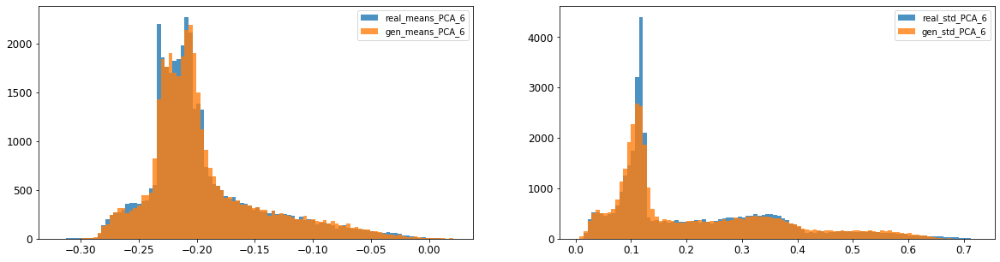

7: mean KL divergence (r,g) = 0.1211243338756774
7: mean JS divergence = 0.03187257514049065
7: mean 1-BC divergence = 0.023245458971044686

7: std KL divergence (r,g) = 0.05223880513813349
7: std JS divergence = 0.013088878124355297
7: std 1-BC divergence = 0.00918371604566981


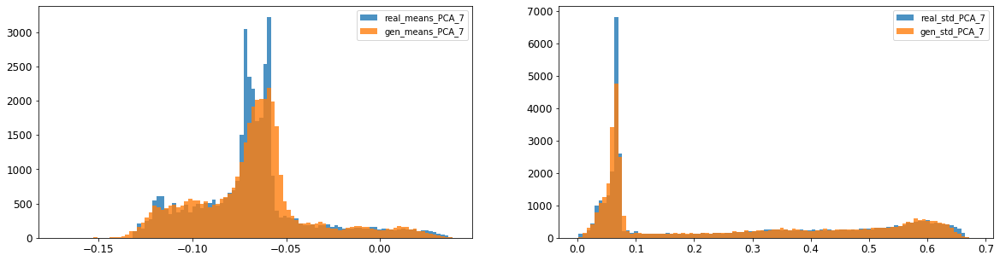

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002771411754167093
8: mean 1-BC divergence = 0.0019664839229485143

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.015200120958085764
8: std 1-BC divergence = 0.010734577874426443


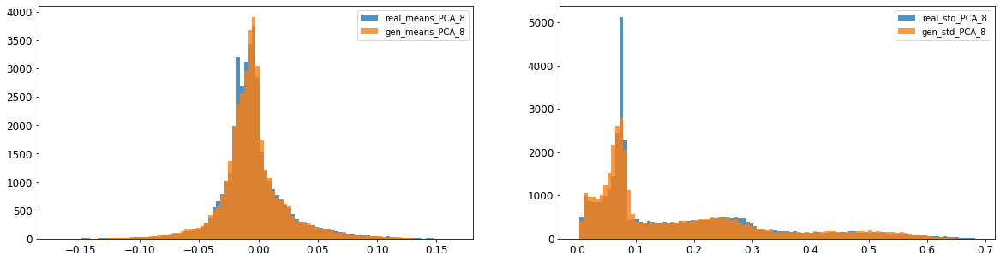

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004413253800618673
9: mean 1-BC divergence = 0.003137691170504664

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.017005486910960127
9: std 1-BC divergence = 0.012114185861298532


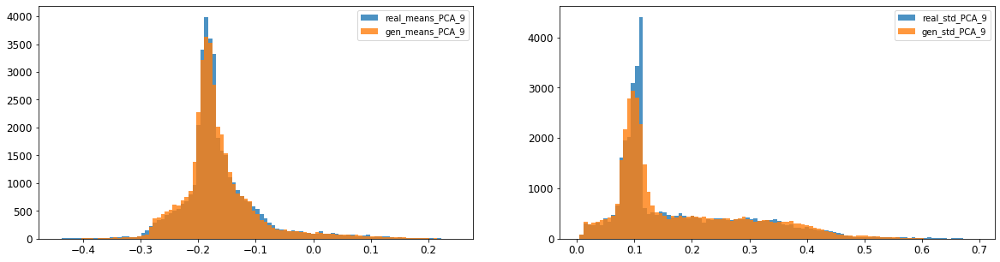

10: mean KL divergence (r,g) = 0.026940047511581498
10: mean JS divergence = 0.006719441651005508
10: mean 1-BC divergence = 0.004815809957548267

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.0076332670355095025
10: std 1-BC divergence = 0.006598713149336799


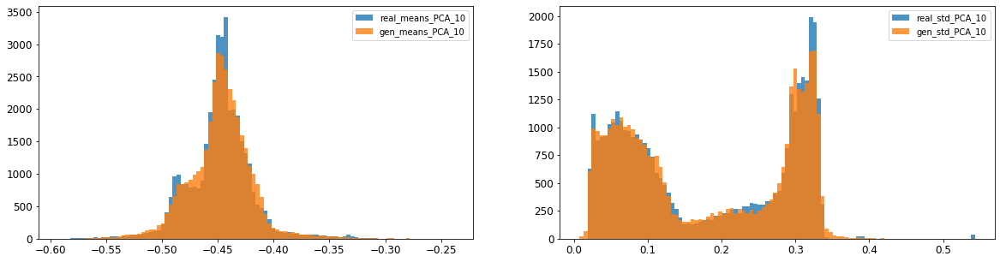

11: mean KL divergence (r,g) = 0.04856452964317848
11: mean JS divergence = 0.012653096582690999
11: mean 1-BC divergence = 0.009002231401684213

11: std KL divergence (r,g) = 0.06617304193479903
11: std JS divergence = 0.016662515426149264
11: std 1-BC divergence = 0.011870015068097262


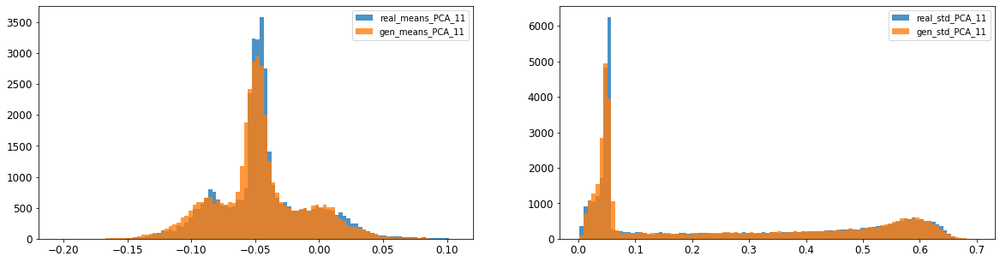

12: mean KL divergence (r,g) = 0.014594767690751811
12: mean JS divergence = 0.003569196824961242
12: mean 1-BC divergence = 0.00248934170275239

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.026156744231277722
12: std 1-BC divergence = 0.018644453086290924


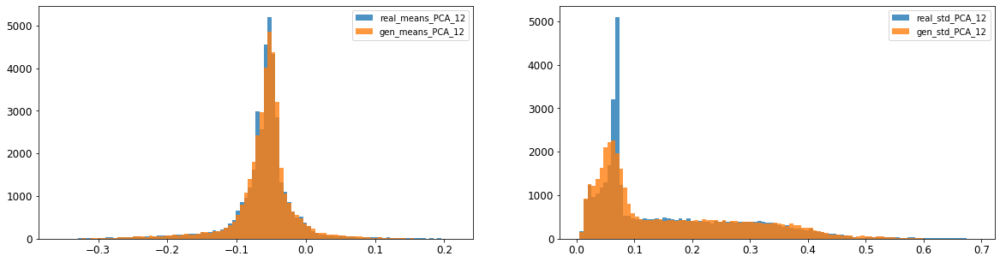

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.018019173858779148
13: mean 1-BC divergence = 0.012629173647868419

13: std KL divergence (r,g) = 0.11462119591974318
13: std JS divergence = 0.027292099140912674
13: std 1-BC divergence = 0.019160159185823145


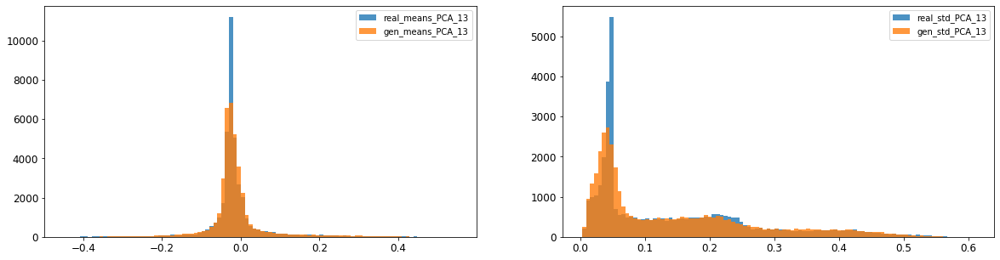

14: mean KL divergence (r,g) = 0.11425225960900402
14: mean JS divergence = 0.028051219892514884
14: mean 1-BC divergence = 0.019637803028033973

14: std KL divergence (r,g) = 0.030142690126289104
14: std JS divergence = 0.007238897977227581
14: std 1-BC divergence = 0.0050541521720385285


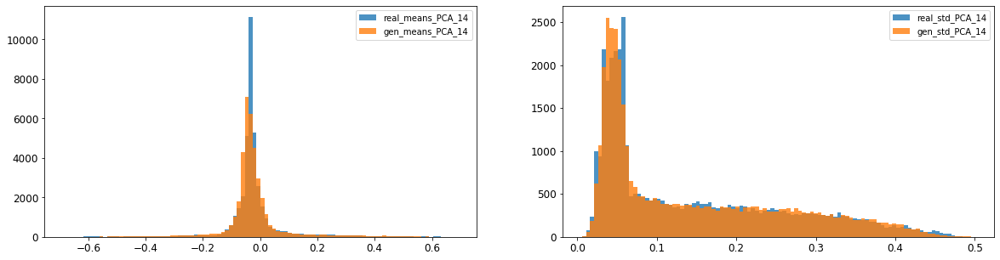

15: mean KL divergence (r,g) = 1.7377666165234646
15: mean JS divergence = 0.4786834282850512
15: mean 1-BC divergence = 0.43772479964510436

15: std KL divergence (r,g) = 5.882380901184391
15: std JS divergence = 0.9378087353963923
15: std 1-BC divergence = 0.8697992603460403


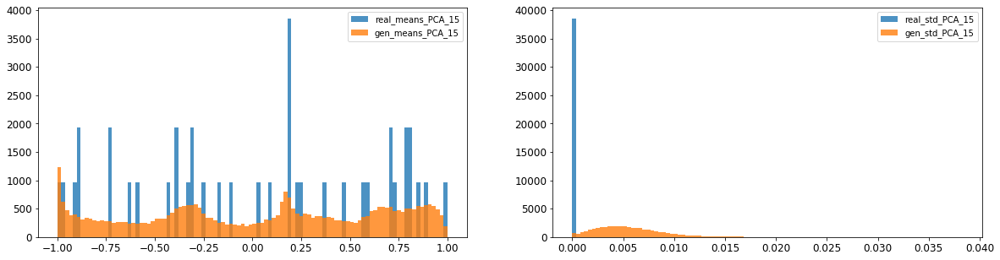

16: mean KL divergence (r,g) = 1.517036066153125
16: mean JS divergence = 0.42527642280020683
16: mean 1-BC divergence = 0.39005214611381245

16: std KL divergence (r,g) = 5.573324190300844
16: std JS divergence = 0.9261665260764296
16: std 1-BC divergence = 0.8550790669254495


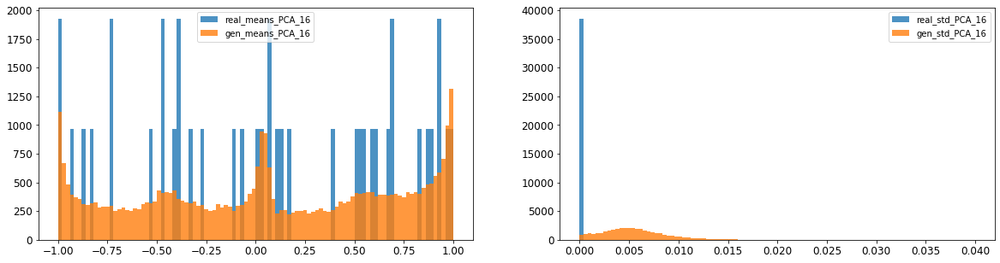



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.017049487791596308
Compose 1-BC divergence = 0.012661361659501824

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.019822711747014426
Compose weighted 1-BC divergence = 0.016193875480496445

Multivariate KL divergence = 59.21115176450851


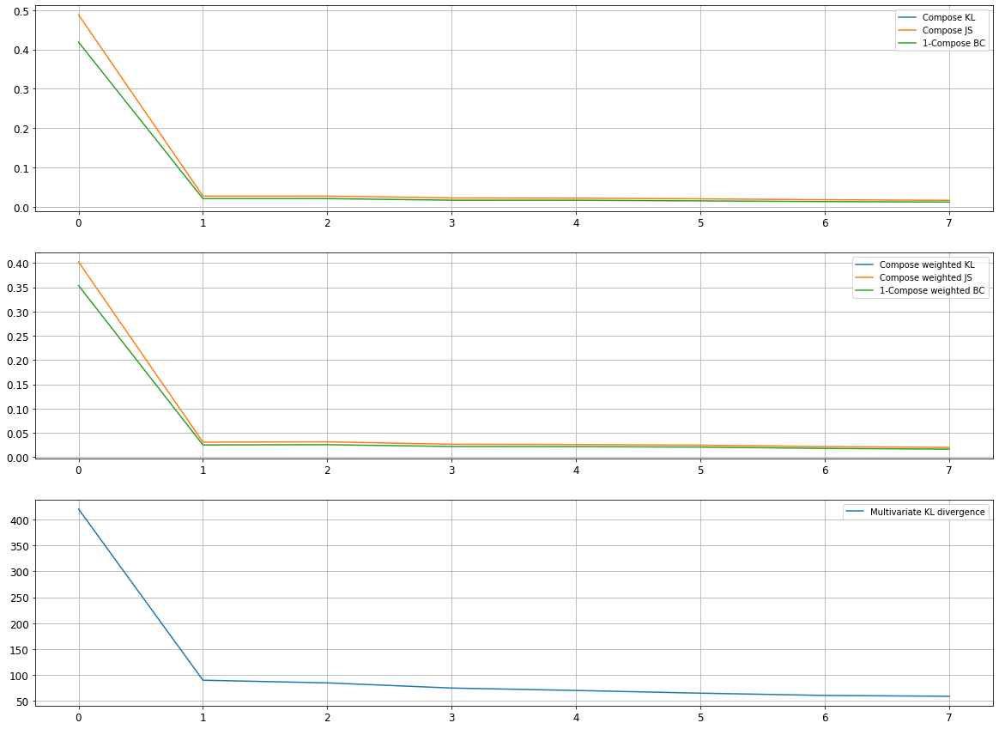

Epoch 1402/10000
discriminator loss: 0.073907 - generator loss: 6.356436 - 37s
Epoch 1403/10000
discriminator loss: 0.256804 - generator loss: 5.780412 - 36s
Epoch 1404/10000
discriminator loss: 0.093041 - generator loss: 6.206248 - 39s
Epoch 1405/10000
discriminator loss: 0.095780 - generator loss: 6.090050 - 39s
Epoch 1406/10000
discriminator loss: 0.376202 - generator loss: 5.665060 - 37s
Epoch 1407/10000
discriminator loss: 0.073811 - generator loss: 6.319344 - 35s
Epoch 1408/10000
discriminator loss: 0.365425 - generator loss: 5.411738 - 37s
Epoch 1409/10000
discriminator loss: 0.064394 - generator loss: 6.413322 - 39s
Epoch 1410/10000
discriminator loss: 0.074554 - generator loss: 6.301662 - 34s
Epoch 1411/10000
discriminator loss: 0.383589 - generator loss: 5.625937 - 40s
Epoch 1412/10000
discriminator loss: 0.069617 - generator loss: 6.372870 - 41s
Epoch 1413/10000
discriminator loss: 0.248300 - generator loss: 5.906330 - 37s
Epoch 1414/10000
discriminator loss: 0.066841 - gene

discriminator loss: 0.076261 - generator loss: 6.435988 - 35s
Epoch 1507/10000
discriminator loss: 0.252321 - generator loss: 5.926495 - 36s
Epoch 1508/10000
discriminator loss: 0.186356 - generator loss: 6.035982 - 33s
Epoch 1509/10000
discriminator loss: 0.070239 - generator loss: 6.398422 - 34s
Epoch 1510/10000
discriminator loss: 0.278045 - generator loss: 5.926217 - 35s
Epoch 1511/10000
discriminator loss: 0.073753 - generator loss: 6.358036 - 34s
Epoch 1512/10000
discriminator loss: 0.233355 - generator loss: 6.169046 - 33s
Epoch 1513/10000
discriminator loss: 0.249170 - generator loss: 6.191161 - 34s
Epoch 1514/10000
discriminator loss: 0.099976 - generator loss: 6.087533 - 32s
Epoch 1515/10000
discriminator loss: 0.265108 - generator loss: 6.097536 - 34s
Epoch 1516/10000
discriminator loss: 0.074982 - generator loss: 6.250006 - 34s
Epoch 1517/10000
discriminator loss: 0.224567 - generator loss: 6.038457 - 34s
Epoch 1518/10000
discriminator loss: 0.068154 - generator loss: 6.403

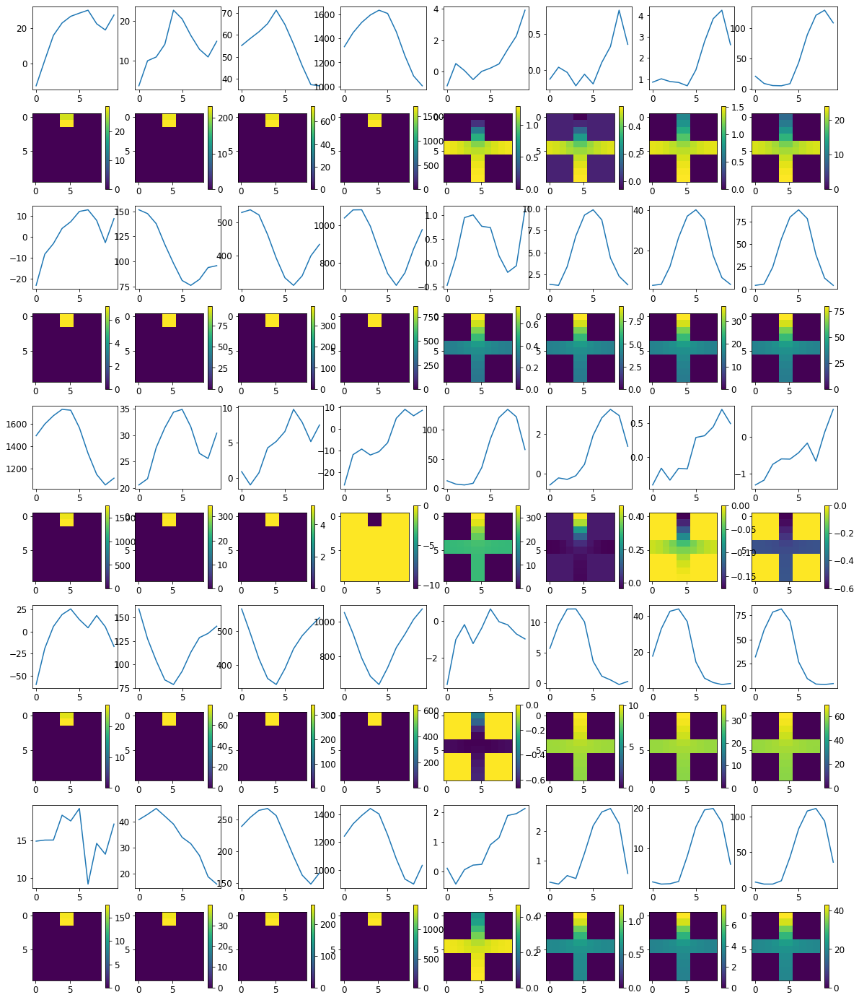


R0 generated:
[[19.710209   19.12714   ]
 [19.660448   19.133253  ]
 [19.665699   19.12169   ]
 [19.662638   19.151472  ]
 [19.668598   19.158962  ]
 [19.663027   19.169102  ]
 [19.66946    19.163635  ]
 [19.658985   19.174461  ]
 [19.650265   19.139776  ]
 [19.665142   19.24103   ]
 [17.7731      0.77107894]
 [17.52812     0.86907864]
 [17.558037    0.82081115]
 [17.518768    0.8015414 ]
 [17.561958    0.82865274]
 [17.537033    0.8204928 ]
 [17.5847      0.8129171 ]
 [17.537529    0.7866694 ]
 [17.569979    0.8342161 ]
 [17.51936     0.8344062 ]
 [18.895016    0.83254844]
 [18.688152    0.8911362 ]
 [18.68449     0.8866906 ]
 [18.679262    0.84152764]
 [18.695929    0.8574323 ]
 [18.682884    0.84821403]
 [18.662767    0.79942936]
 [18.649439    0.909122  ]
 [18.653496    0.888493  ]
 [18.728899    0.7946351 ]
 [19.81413    18.450855  ]
 [19.785872   18.446249  ]
 [19.77133    18.465885  ]
 [19.763252   18.481503  ]
 [19.774857   18.473185  ]
 [19.769955   18.417168  ]
 [19.779167  

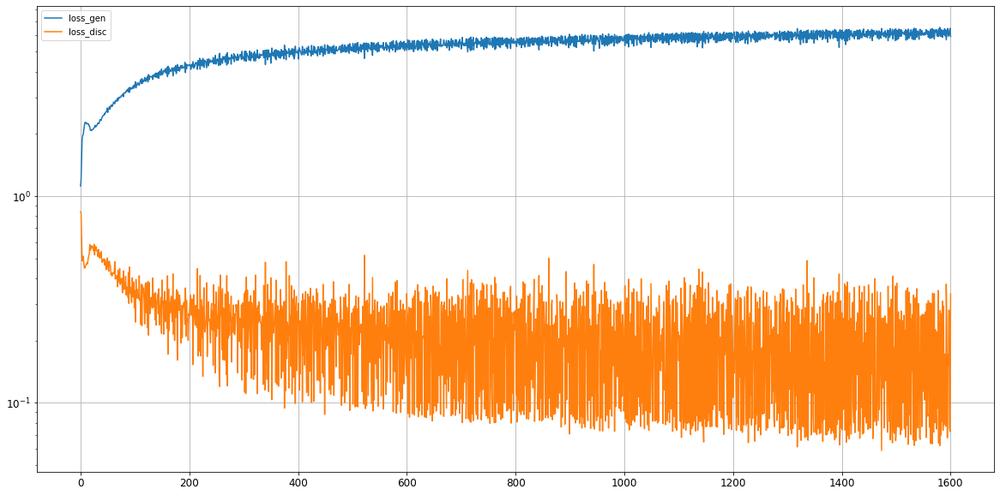

0: mean KL divergence (r,g) = 0.05400084245195923
0: mean JS divergence = 0.013916879876172603
0: mean 1-BC divergence = 0.010192895090159304

0: std KL divergence (r,g) = 0.11276946824707476
0: std JS divergence = 0.03590971952644634
0: std 1-BC divergence = 0.0334049195976055


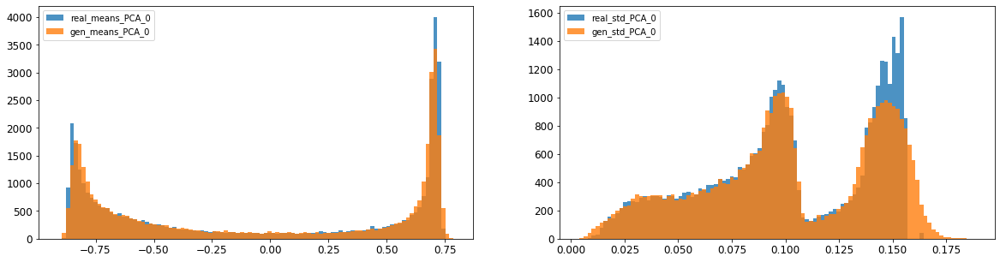

1: mean KL divergence (r,g) = 0.024315663258197184
1: mean JS divergence = 0.006107675820245651
1: mean 1-BC divergence = 0.0043056699960437594

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.011845598787070772
1: std 1-BC divergence = 0.008394237473540955


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


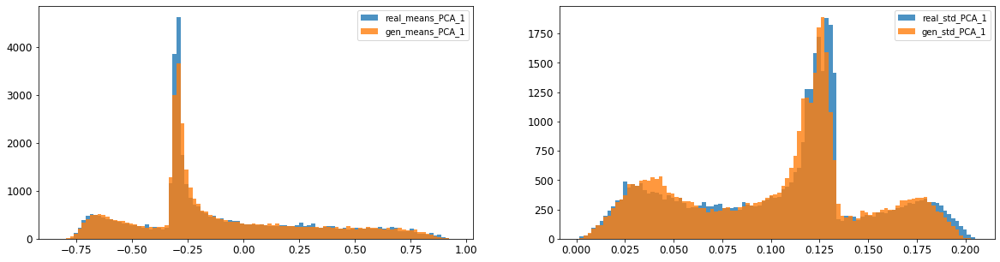

2: mean KL divergence (r,g) = 0.012644904014359859
2: mean JS divergence = 0.003375512517813994
2: mean 1-BC divergence = 0.0025341119566523185

2: std KL divergence (r,g) = 0.04431707349613998
2: std JS divergence = 0.01219665860136528
2: std 1-BC divergence = 0.010075237164896444


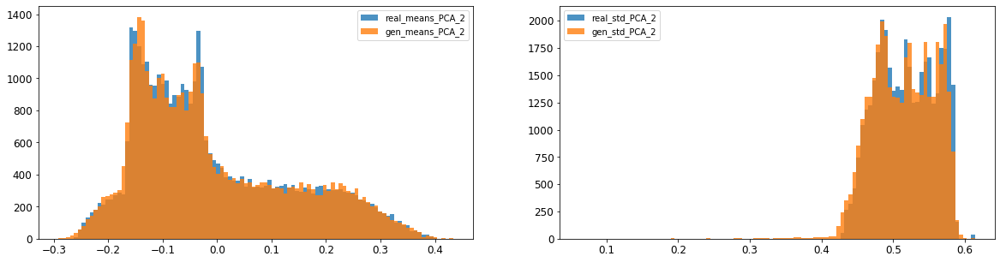

3: mean KL divergence (r,g) = 0.09597807324684364
3: mean JS divergence = 0.024409234639019596
3: mean 1-BC divergence = 0.017324286250454124

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.10013354119711149
3: std 1-BC divergence = 0.07552888577426597


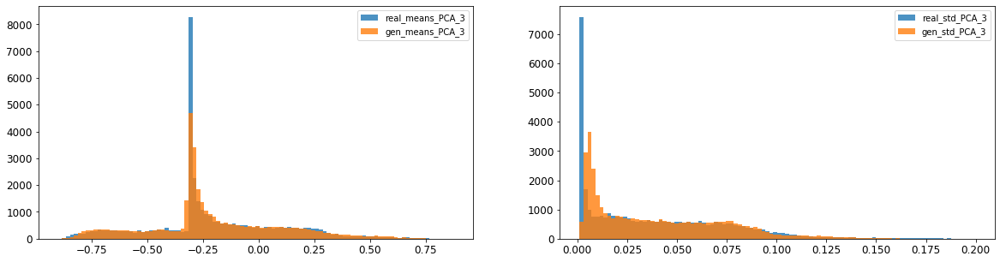

4: mean KL divergence (r,g) = 0.031584030979958655
4: mean JS divergence = 0.008506178335474842
4: mean 1-BC divergence = 0.00648592836630002

4: std KL divergence (r,g) = 0.029080521276775666
4: std JS divergence = 0.006842099123003117
4: std 1-BC divergence = 0.0048134303554666635


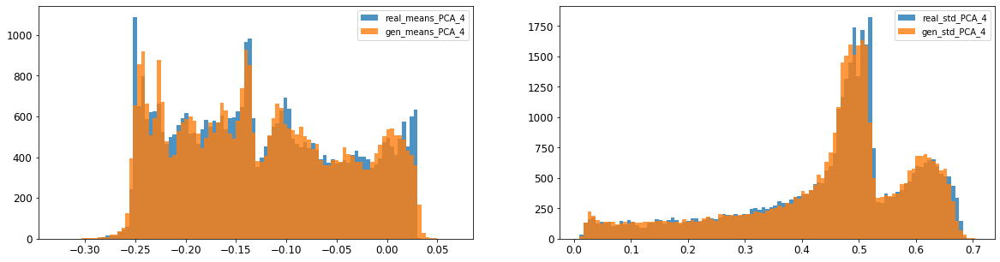

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.02085359704747461
5: mean 1-BC divergence = 0.015495008557248391

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.019657083850436206
5: std 1-BC divergence = 0.01608694877467376


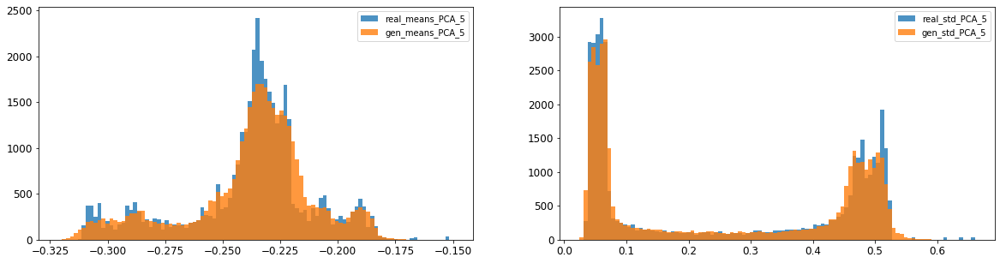

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004961091831186695
6: mean 1-BC divergence = 0.003497576752956366

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.011964800593165226
6: std 1-BC divergence = 0.008580489881632847


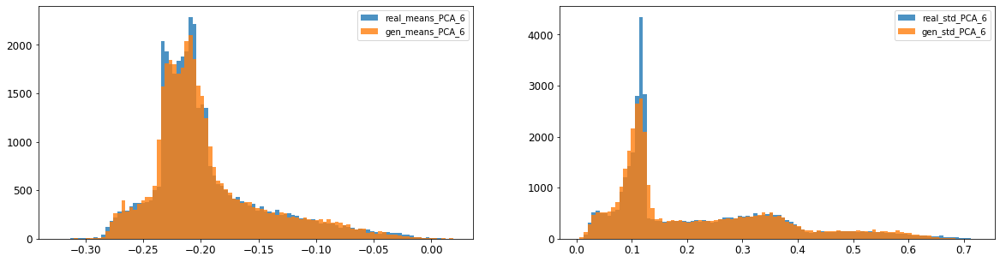

7: mean KL divergence (r,g) = 0.053027367405408976
7: mean JS divergence = 0.014073767279146204
7: mean 1-BC divergence = 0.01074680937658612

7: std KL divergence (r,g) = 0.0752303744360109
7: std JS divergence = 0.018282035855803788
7: std 1-BC divergence = 0.012810699662382241


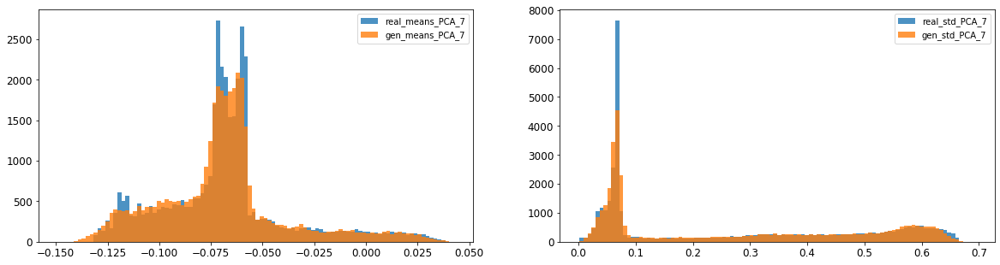

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002750470252731418
8: mean 1-BC divergence = 0.0019860163546392418

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.014201366997801274
8: std 1-BC divergence = 0.010056085425221406


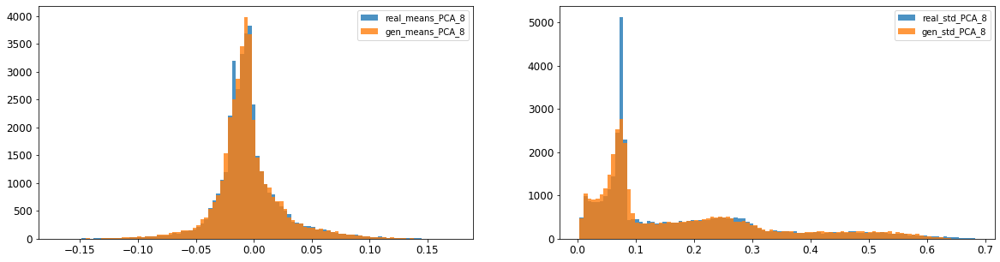

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0038151104446453037
9: mean 1-BC divergence = 0.0027330603337503145

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.0161254687336538
9: std 1-BC divergence = 0.011498248417511459


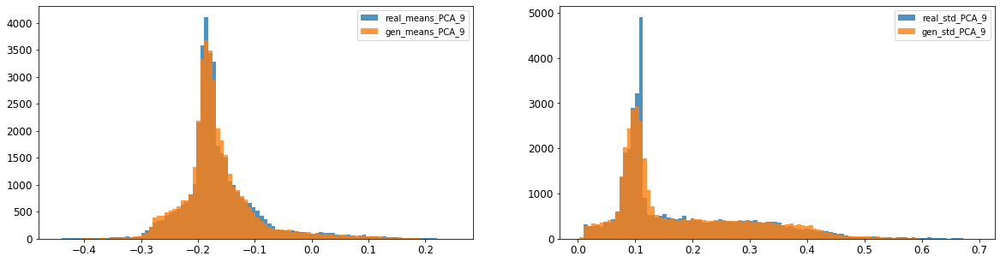

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.005489537834743636
10: mean 1-BC divergence = 0.00391881007112338

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.008416022315566866
10: std 1-BC divergence = 0.007209382004233711


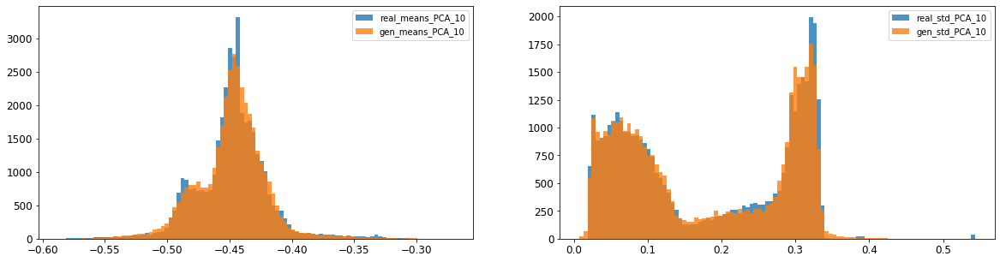

11: mean KL divergence (r,g) = 0.06702470735475044
11: mean JS divergence = 0.01777601043140084
11: mean 1-BC divergence = 0.012802445773424487

11: std KL divergence (r,g) = 0.05406512368469234
11: std JS divergence = 0.014486283600925168
11: std 1-BC divergence = 0.010424636707861978


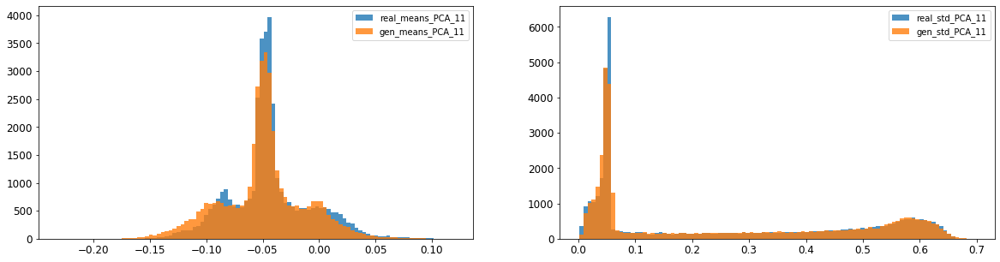

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004310776932659452
12: mean 1-BC divergence = 0.003073879725315365

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.02188772863066229
12: std 1-BC divergence = 0.015532157616263365


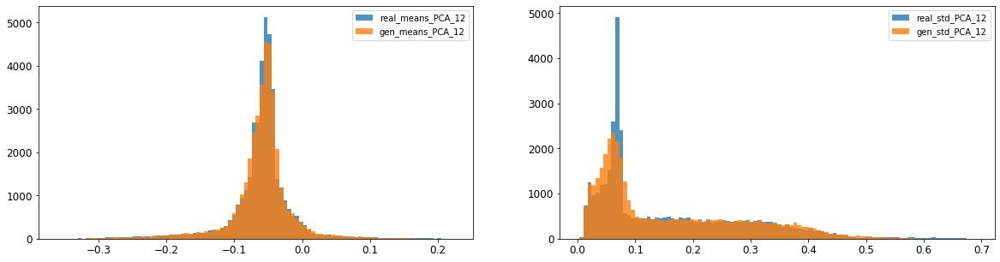

13: mean KL divergence (r,g) = 0.07155774106737614
13: mean JS divergence = 0.017945374170190917
13: mean 1-BC divergence = 0.012554619850004722

13: std KL divergence (r,g) = 0.1022867571549372
13: std JS divergence = 0.024475216975291418
13: std 1-BC divergence = 0.017174245380551234


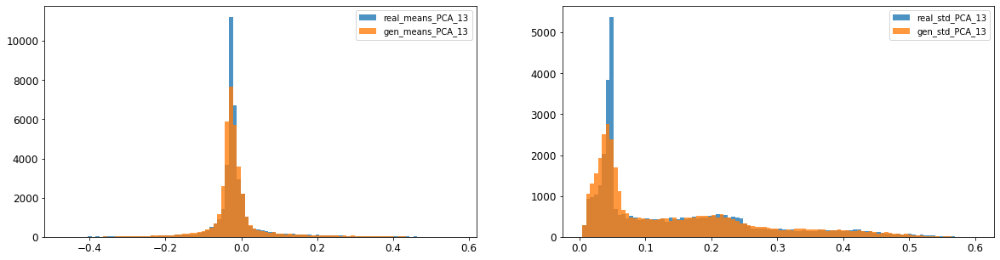

14: mean KL divergence (r,g) = 0.08354364381627265
14: mean JS divergence = 0.020568182010904358
14: mean 1-BC divergence = 0.014410219114799339

14: std KL divergence (r,g) = inf
14: std JS divergence = 0.008483779264806425
14: std 1-BC divergence = 0.005934758570833365


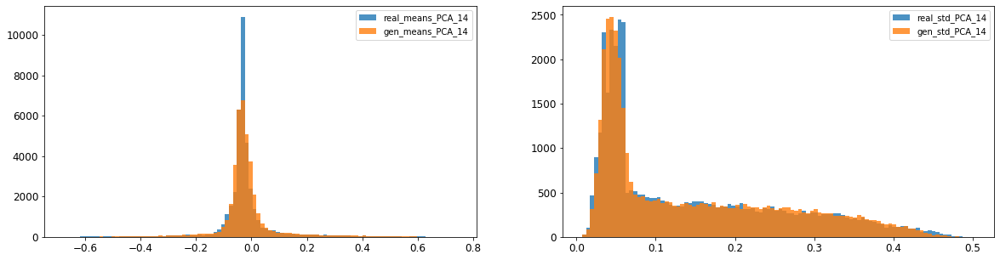

15: mean KL divergence (r,g) = 1.7399200318896209
15: mean JS divergence = 0.47768803575791474
15: mean 1-BC divergence = 0.4367465100918817

15: std KL divergence (r,g) = 5.815467567844924
15: std JS divergence = 0.9354453120427206
15: std 1-BC divergence = 0.8667445710457004


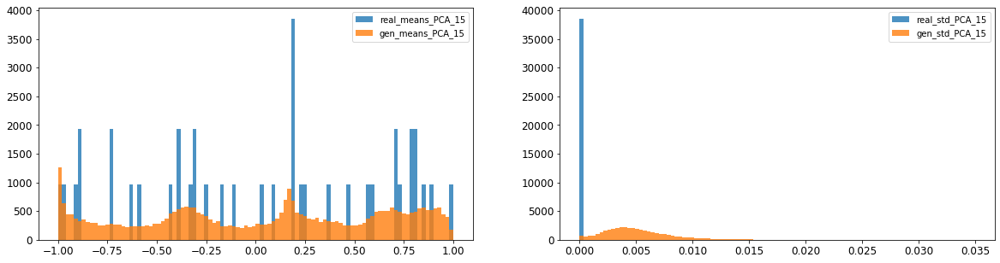

16: mean KL divergence (r,g) = 1.4941231663533026
16: mean JS divergence = 0.4203851644925112
16: mean 1-BC divergence = 0.385894989438306

16: std KL divergence (r,g) = 5.28203536776385
16: std JS divergence = 0.913347848269485
16: std 1-BC divergence = 0.8396848897345005


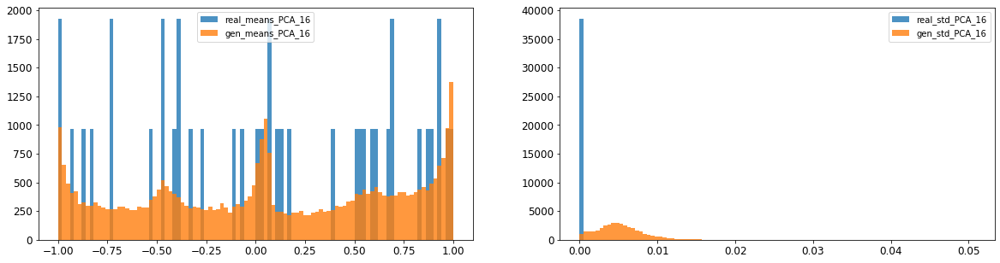



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.016458893449230655
Compose 1-BC divergence = 0.012319523345880046

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.020650176913156224
Compose weighted 1-BC divergence = 0.017161354196388867

Multivariate KL divergence = 56.443705685013626


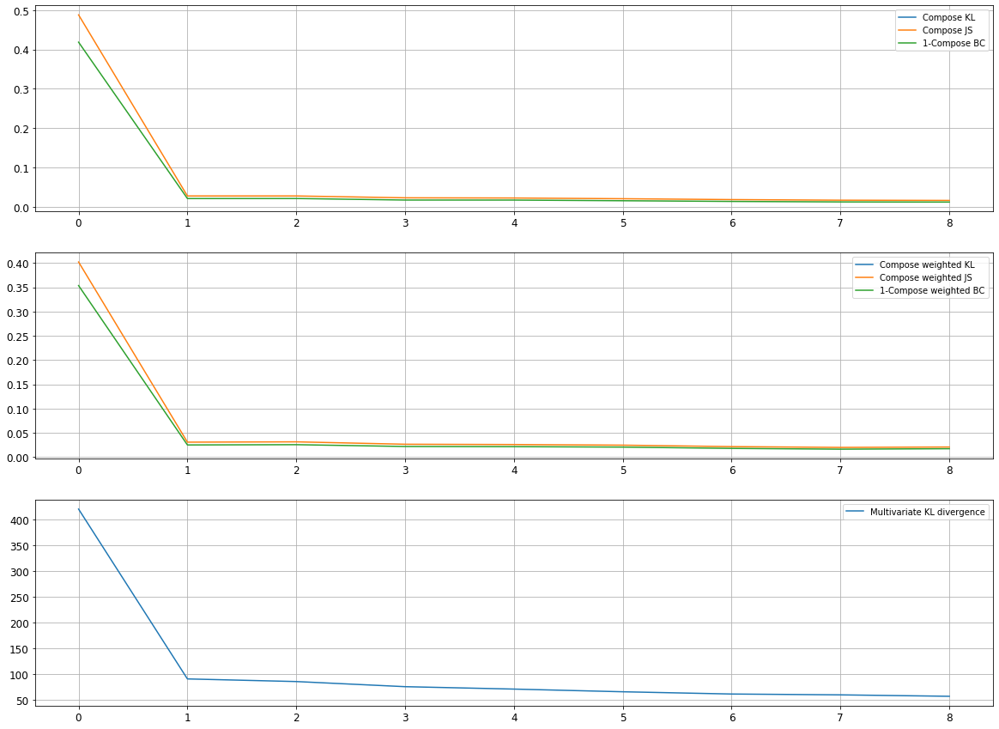

Epoch 1602/10000
discriminator loss: 0.076084 - generator loss: 6.310512 - 35s
Epoch 1603/10000
discriminator loss: 0.285039 - generator loss: 5.841423 - 40s
Epoch 1604/10000
discriminator loss: 0.122256 - generator loss: 6.194202 - 39s
Epoch 1605/10000
discriminator loss: 0.223873 - generator loss: 6.323388 - 39s
Epoch 1606/10000
discriminator loss: 0.079548 - generator loss: 6.214890 - 38s
Epoch 1607/10000
discriminator loss: 0.073224 - generator loss: 6.374046 - 40s
Epoch 1608/10000
discriminator loss: 0.394759 - generator loss: 5.808701 - 39s
Epoch 1609/10000
discriminator loss: 0.059110 - generator loss: 6.570861 - 39s
Epoch 1610/10000
discriminator loss: 0.342296 - generator loss: 5.965633 - 38s
Epoch 1611/10000
discriminator loss: 0.080840 - generator loss: 6.153319 - 40s
Epoch 1612/10000
discriminator loss: 0.319730 - generator loss: 6.132304 - 38s
Epoch 1613/10000
discriminator loss: 0.069204 - generator loss: 6.360922 - 38s
Epoch 1614/10000
discriminator loss: 0.125961 - gene

discriminator loss: 0.266220 - generator loss: 6.070681 - 37s
Epoch 1707/10000
discriminator loss: 0.073959 - generator loss: 6.460329 - 38s
Epoch 1708/10000
discriminator loss: 0.265045 - generator loss: 6.053719 - 38s
Epoch 1709/10000
discriminator loss: 0.279839 - generator loss: 6.349402 - 38s
Epoch 1710/10000
discriminator loss: 0.111367 - generator loss: 6.105227 - 37s
Epoch 1711/10000
discriminator loss: 0.068702 - generator loss: 6.551516 - 39s
Epoch 1712/10000
discriminator loss: 0.311833 - generator loss: 5.933202 - 37s
Epoch 1713/10000
discriminator loss: 0.069707 - generator loss: 6.465051 - 39s
Epoch 1714/10000
discriminator loss: 0.234594 - generator loss: 6.162265 - 37s
Epoch 1715/10000
discriminator loss: 0.091057 - generator loss: 6.356926 - 39s
Epoch 1716/10000
discriminator loss: 0.062639 - generator loss: 6.597323 - 39s
Epoch 1717/10000
discriminator loss: 0.324653 - generator loss: 6.029081 - 39s
Epoch 1718/10000
discriminator loss: 0.087176 - generator loss: 6.330

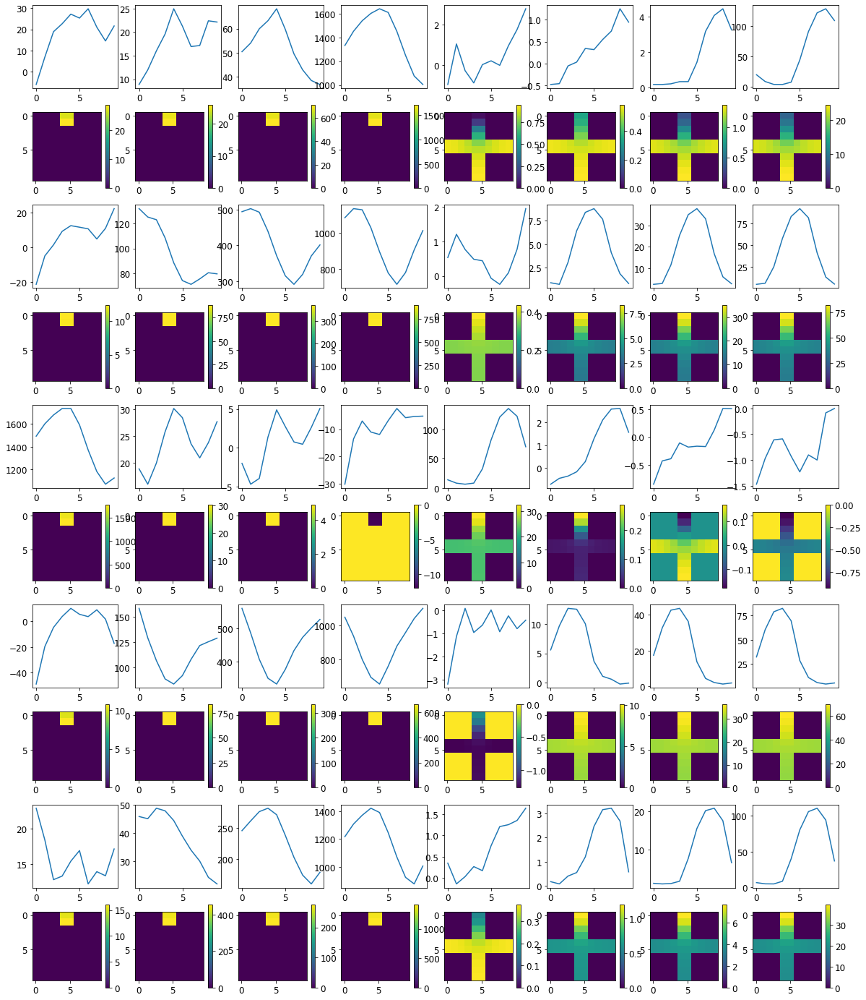


R0 generated:
[[19.757334   19.066647  ]
 [19.710741   19.076477  ]
 [19.712923   19.051683  ]
 [19.714455   19.086927  ]
 [19.719332   19.112455  ]
 [19.723768   19.11849   ]
 [19.73218    19.13033   ]
 [19.723473   19.145428  ]
 [19.714125   19.111824  ]
 [19.72986    19.219088  ]
 [18.02387     0.8362191 ]
 [17.841208    0.9275754 ]
 [17.828772    0.903814  ]
 [17.860954    0.8841524 ]
 [17.894024    0.9182318 ]
 [17.917595    0.90846306]
 [17.949194    0.93190324]
 [17.93965     0.9075027 ]
 [17.97816     0.94969076]
 [17.962091    0.96130496]
 [19.01004     1.164554  ]
 [18.875751    1.2635164 ]
 [18.873941    1.2930925 ]
 [18.877064    1.2195644 ]
 [18.878134    1.2492945 ]
 [18.870077    1.2450349 ]
 [18.85153     1.2041577 ]
 [18.847578    1.3364269 ]
 [18.818617    1.2538118 ]
 [18.915653    1.1239911 ]
 [19.854807   18.645748  ]
 [19.833206   18.629242  ]
 [19.81884    18.627895  ]
 [19.817371   18.64109   ]
 [19.825556   18.643007  ]
 [19.826317   18.6131    ]
 [19.834826  

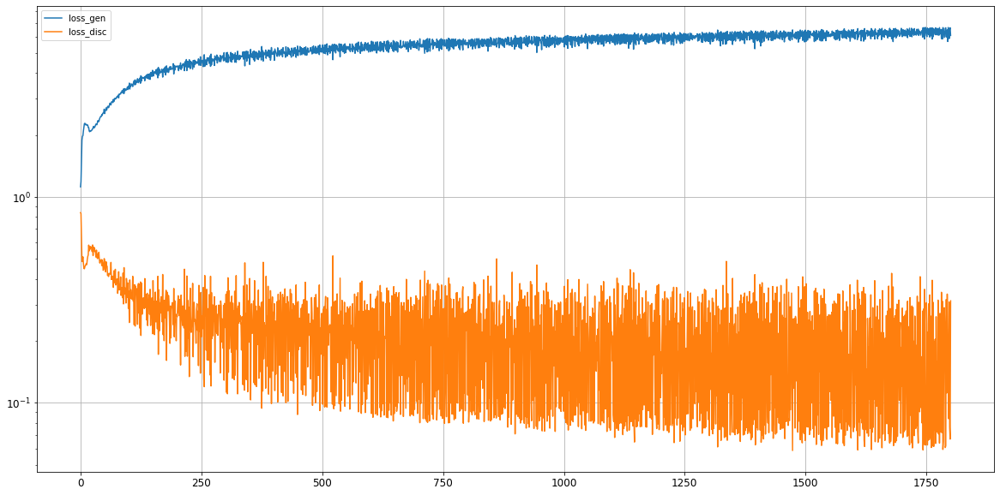

0: mean KL divergence (r,g) = 0.04964162660536978
0: mean JS divergence = 0.01407595095812508
0: mean 1-BC divergence = 0.011936507793465445

0: std KL divergence (r,g) = 0.0731794499426019
0: std JS divergence = 0.021124365517624817
0: std 1-BC divergence = 0.01754558991869981


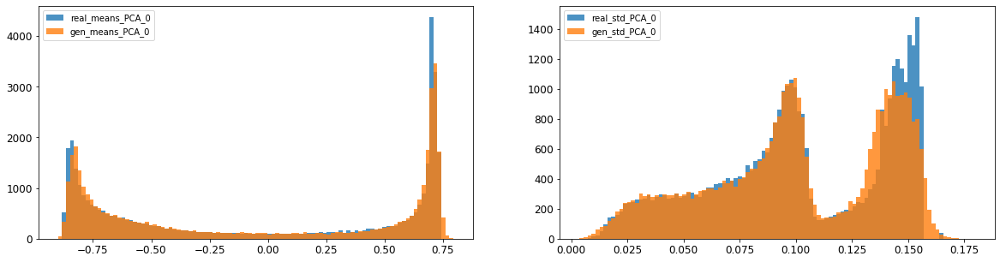

1: mean KL divergence (r,g) = 0.023661151940210796
1: mean JS divergence = 0.005973346924369098
1: mean 1-BC divergence = 0.004283453642202062

1: std KL divergence (r,g) = 0.037242646922504424
1: std JS divergence = 0.008852783270551483
1: std 1-BC divergence = 0.006200382069213473


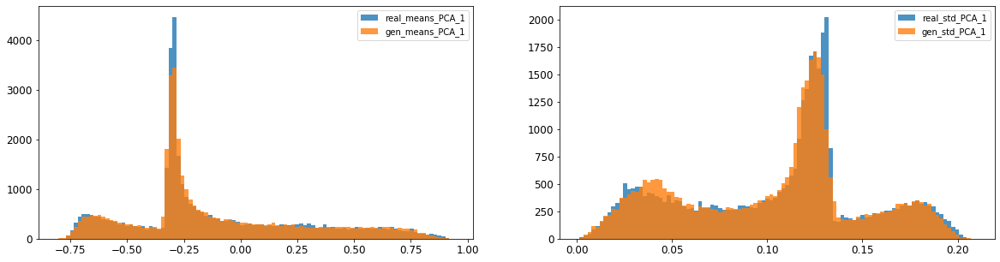

2: mean KL divergence (r,g) = 0.011109003570791792
2: mean JS divergence = 0.002860793115234495
2: mean 1-BC divergence = 0.0020714907074609323

2: std KL divergence (r,g) = 0.041560424409437156
2: std JS divergence = 0.012644471797036297
2: std 1-BC divergence = 0.01158469418391006


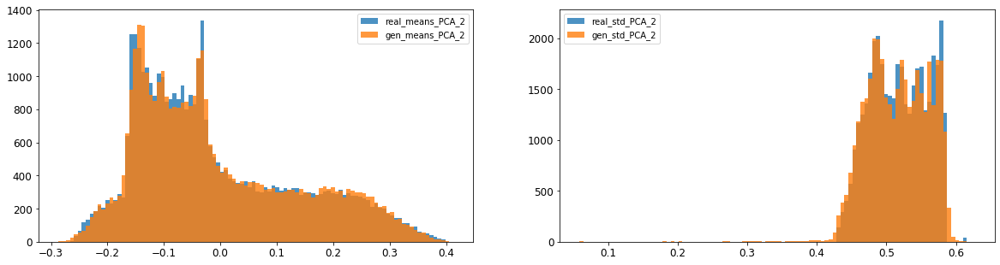

/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.022271739060639256
3: mean 1-BC divergence = 0.015778729802175095

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.08735469081227183
3: std 1-BC divergence = 0.06538843001086392


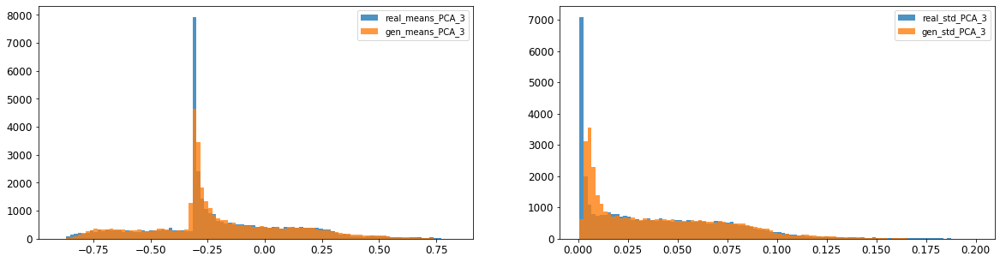

4: mean KL divergence (r,g) = 0.0435759146407145
4: mean JS divergence = 0.011414706507566246
4: mean 1-BC divergence = 0.009130457173866402

4: std KL divergence (r,g) = 0.02154178219744435
4: std JS divergence = 0.005221674959613204
4: std 1-BC divergence = 0.003692268883179306


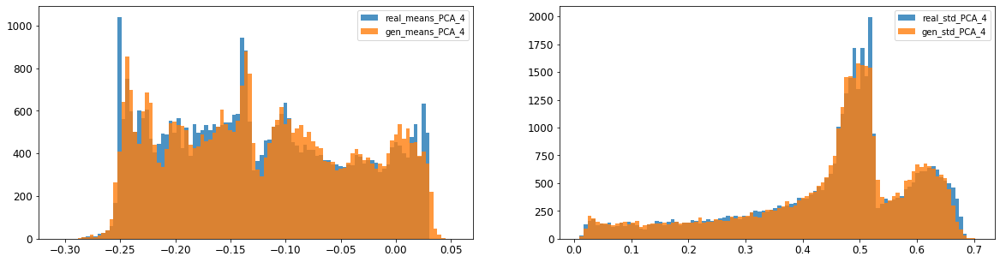

5: mean KL divergence (r,g) = 0.10857868072481153
5: mean JS divergence = 0.028273958867608612
5: mean 1-BC divergence = 0.02089307885117797

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.017450679331444553
5: std 1-BC divergence = 0.01511799431246097


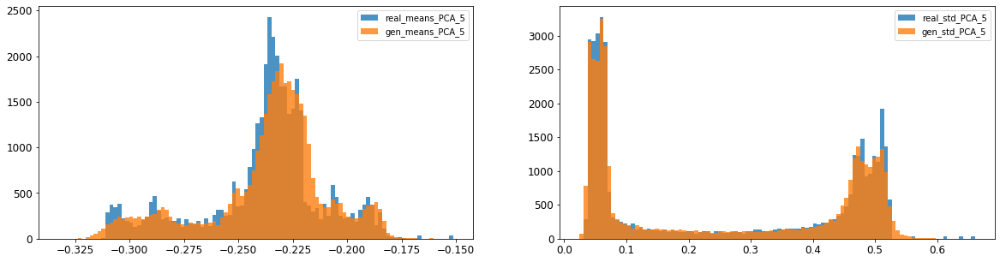

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.005934330816357471
6: mean 1-BC divergence = 0.004209262953752568

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.011603811002740941
6: std 1-BC divergence = 0.008313645803594727


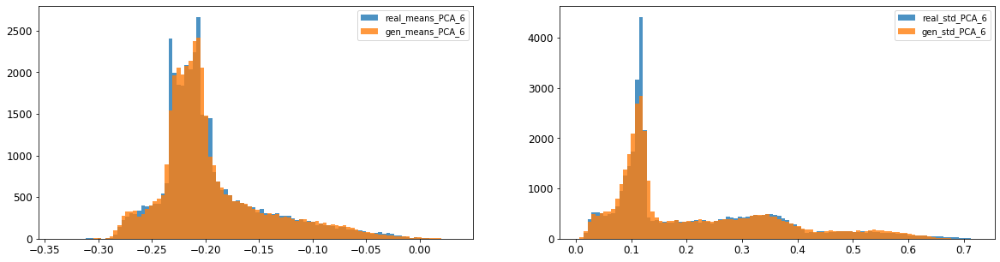

7: mean KL divergence (r,g) = 0.087481367186784
7: mean JS divergence = 0.02327339257630985
7: mean 1-BC divergence = 0.016668986511198414

7: std KL divergence (r,g) = 0.05306709325597008
7: std JS divergence = 0.01276176875250155
7: std 1-BC divergence = 0.008959925477381558


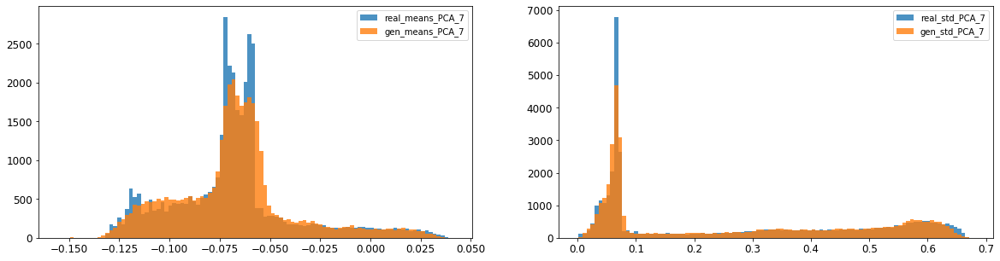

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.003683061378871086
8: mean 1-BC divergence = 0.0026033597742353143

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.01409883849988422
8: std 1-BC divergence = 0.009966920775319799


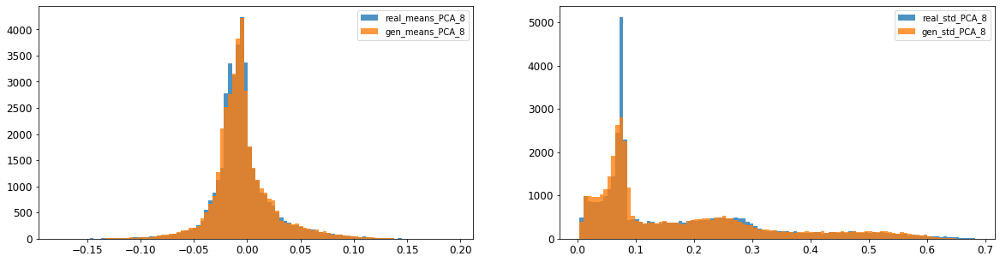

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.00449648313996706
9: mean 1-BC divergence = 0.0031745263816097546

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.01635923276556305
9: std 1-BC divergence = 0.011639295646538539


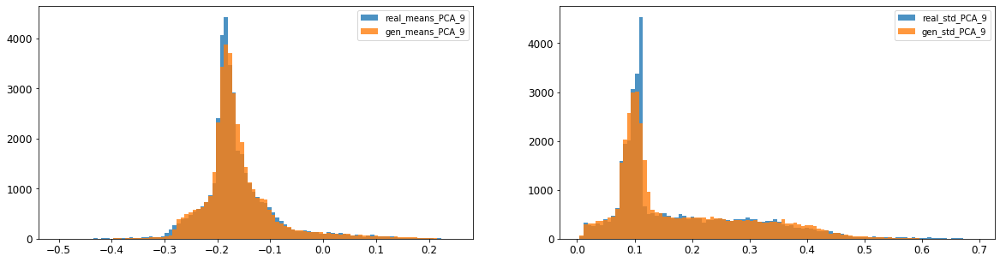

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.005483354647851267
10: mean 1-BC divergence = 0.0038948909227135564

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.008388391886036085
10: std 1-BC divergence = 0.00727856166838492


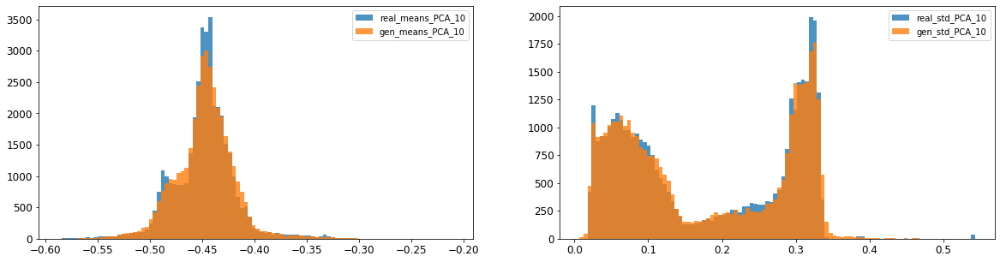

11: mean KL divergence (r,g) = 0.03625623198699387
11: mean JS divergence = 0.009484724575579386
11: mean 1-BC divergence = 0.006739711805787918

11: std KL divergence (r,g) = 0.07745791497540977
11: std JS divergence = 0.020650538907678956
11: std 1-BC divergence = 0.014874926269525357


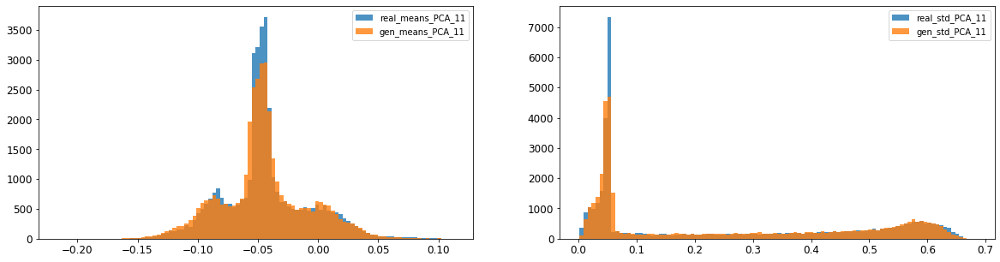

12: mean KL divergence (r,g) = 0.024547701542373138
12: mean JS divergence = 0.006186824763584757
12: mean 1-BC divergence = 0.0043300781311415015

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.022560771037301093
12: std 1-BC divergence = 0.016106885155888317


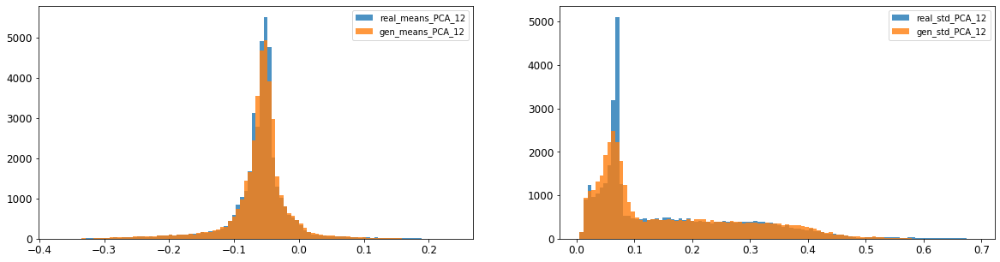

13: mean KL divergence (r,g) = 0.05052434173371472
13: mean JS divergence = 0.0123115731047462
13: mean 1-BC divergence = 0.008610467825143409

13: std KL divergence (r,g) = 0.09514807704316483
13: std JS divergence = 0.022981520700526437
13: std 1-BC divergence = 0.01611259794880504


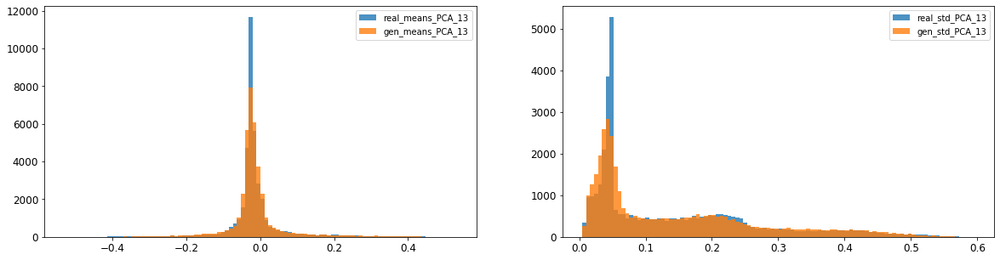

14: mean KL divergence (r,g) = 0.08393646698252578
14: mean JS divergence = 0.020947592582192816
14: mean 1-BC divergence = 0.014677361250304943

14: std KL divergence (r,g) = 0.028470350019622222
14: std JS divergence = 0.006897478925032065
14: std 1-BC divergence = 0.004798289377025866


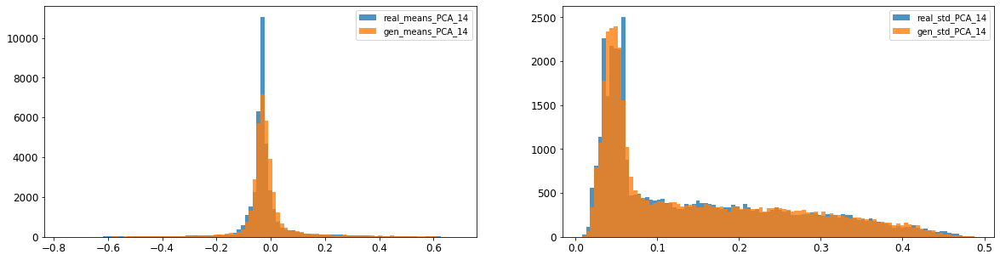

15: mean KL divergence (r,g) = 1.7260068909799138
15: mean JS divergence = 0.4752105717017068
15: mean 1-BC divergence = 0.4342858386112659

15: std KL divergence (r,g) = 5.475096868004097
15: std JS divergence = 0.9220567520883505
15: std 1-BC divergence = 0.8500605868291644


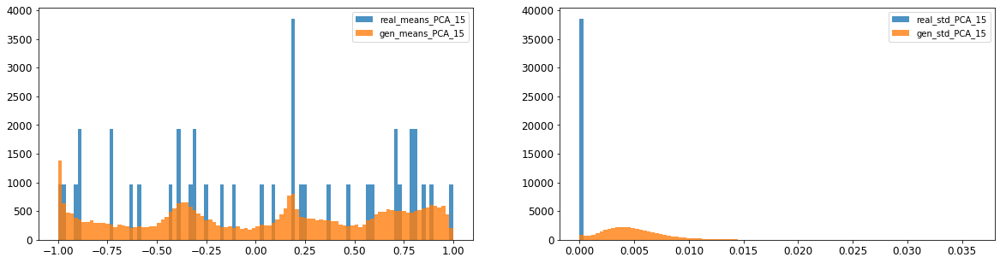

16: mean KL divergence (r,g) = 1.4791418651946477
16: mean JS divergence = 0.416698128637677
16: mean 1-BC divergence = 0.3827947305160263

16: std KL divergence (r,g) = 5.4083613422023
16: std JS divergence = 0.9191433797336419
16: std 1-BC divergence = 0.8465522572301468


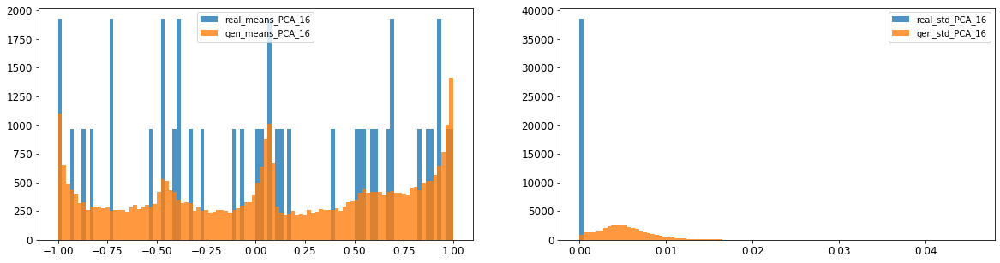



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.015520761706160307
Compose 1-BC divergence = 0.01155275903423425

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.01599307949384859
Compose weighted 1-BC divergence = 0.012853584860903489

Multivariate KL divergence = 54.785579783168906


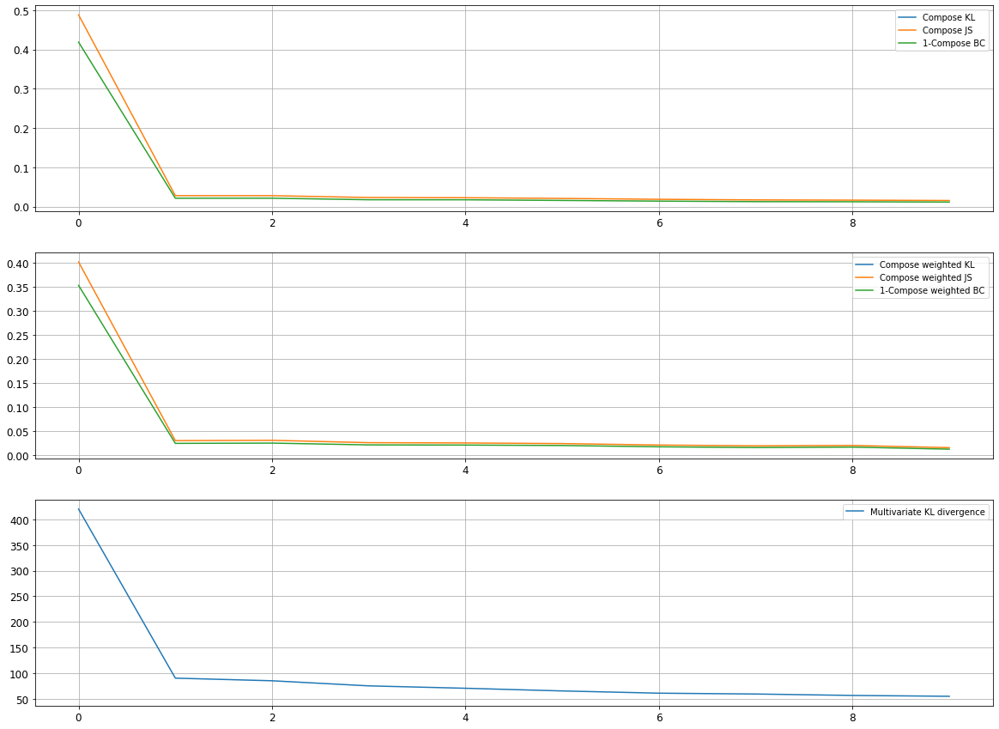

Epoch 1802/10000
discriminator loss: 0.064447 - generator loss: 6.586242 - 37s
Epoch 1803/10000
discriminator loss: 0.284380 - generator loss: 6.343491 - 37s
Epoch 1804/10000
discriminator loss: 0.104703 - generator loss: 6.234538 - 36s
Epoch 1805/10000
discriminator loss: 0.075583 - generator loss: 6.506464 - 39s
Epoch 1806/10000
discriminator loss: 0.279190 - generator loss: 6.038353 - 39s
Epoch 1807/10000
discriminator loss: 0.074446 - generator loss: 6.545894 - 39s
Epoch 1808/10000
discriminator loss: 0.257288 - generator loss: 6.177322 - 38s
Epoch 1809/10000
discriminator loss: 0.062898 - generator loss: 6.629370 - 40s
Epoch 1810/10000
discriminator loss: 0.061565 - generator loss: 6.662946 - 39s
Epoch 1811/10000
discriminator loss: 0.469105 - generator loss: 5.738498 - 40s
Epoch 1812/10000
discriminator loss: 0.069342 - generator loss: 6.440332 - 38s
Epoch 1813/10000
discriminator loss: 0.175011 - generator loss: 6.406376 - 39s
Epoch 1814/10000
discriminator loss: 0.206032 - gene

discriminator loss: 0.229019 - generator loss: 6.174831 - 40s
Epoch 1907/10000
discriminator loss: 0.068170 - generator loss: 6.704875 - 39s
Epoch 1908/10000
discriminator loss: 0.232918 - generator loss: 6.316933 - 39s
Epoch 1909/10000
discriminator loss: 0.199568 - generator loss: 6.172688 - 38s
Epoch 1910/10000
discriminator loss: 0.071417 - generator loss: 6.703266 - 39s
Epoch 1911/10000
discriminator loss: 0.284444 - generator loss: 6.116931 - 39s
Epoch 1912/10000
discriminator loss: 0.103698 - generator loss: 6.492824 - 36s
Epoch 1913/10000
discriminator loss: 0.068853 - generator loss: 6.591822 - 39s
Epoch 1914/10000
discriminator loss: 0.420530 - generator loss: 6.042355 - 36s
Epoch 1915/10000
discriminator loss: 0.068392 - generator loss: 6.583818 - 37s
Epoch 1916/10000
discriminator loss: 0.214642 - generator loss: 6.697859 - 37s
Epoch 1917/10000
discriminator loss: 0.116695 - generator loss: 6.306165 - 36s
Epoch 1918/10000
discriminator loss: 0.062003 - generator loss: 6.665

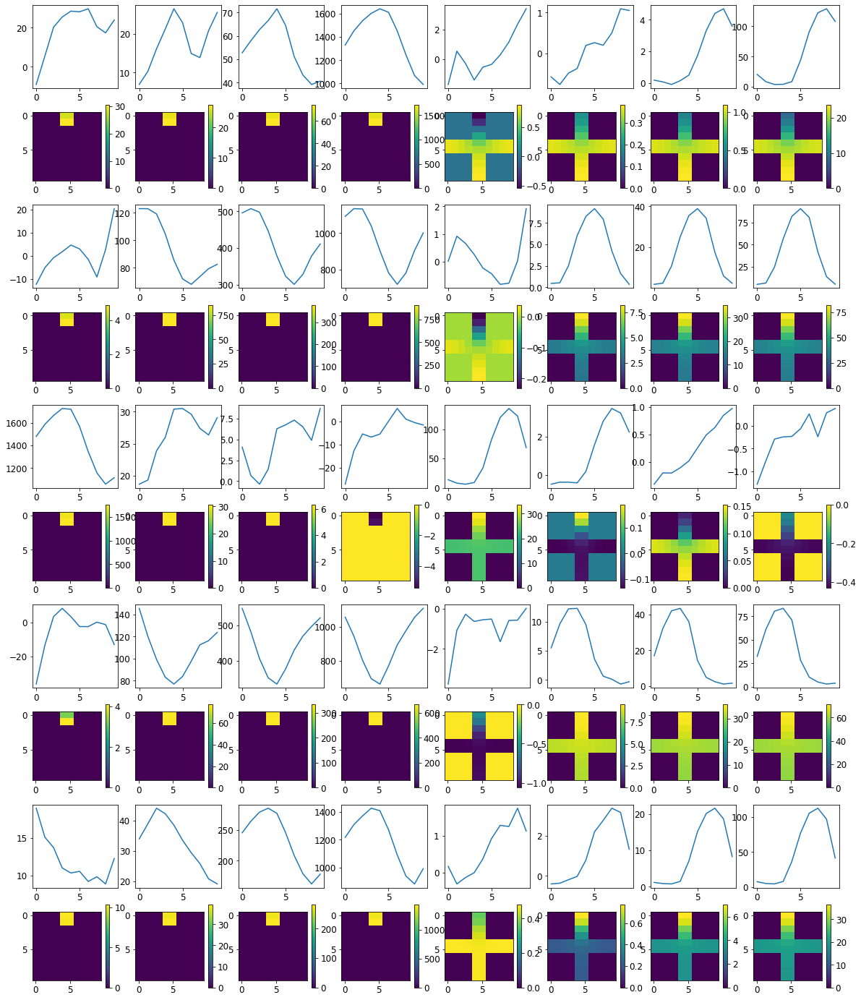


R0 generated:
[[19.773817   18.975166  ]
 [19.731358   18.961563  ]
 [19.740408   18.931515  ]
 [19.740444   18.949104  ]
 [19.753262   18.97943   ]
 [19.752567   18.977232  ]
 [19.762312   18.992859  ]
 [19.749678   19.003305  ]
 [19.740221   18.97829   ]
 [19.74264    19.044773  ]
 [18.173027    1.0202572 ]
 [18.027845    1.1221467 ]
 [18.091074    1.1253788 ]
 [18.139513    1.094545  ]
 [18.204119    1.1250727 ]
 [18.18842     1.1032699 ]
 [18.218908    1.1128072 ]
 [18.197058    1.0621945 ]
 [18.242699    1.1067493 ]
 [18.169912    1.1257479 ]
 [18.92649     1.1262081 ]
 [18.813723    1.1765018 ]
 [18.834929    1.1689838 ]
 [18.83845     1.1102339 ]
 [18.840197    1.1187164 ]
 [18.815668    1.1461192 ]
 [18.79371     1.1146877 ]
 [18.796873    1.2073858 ]
 [18.800276    1.2136366 ]
 [18.839664    1.0356103 ]
 [19.853724   18.637745  ]
 [19.832447   18.58592   ]
 [19.824135   18.56995   ]
 [19.821201   18.57334   ]
 [19.828768   18.573471  ]
 [19.825953   18.545403  ]
 [19.833248  

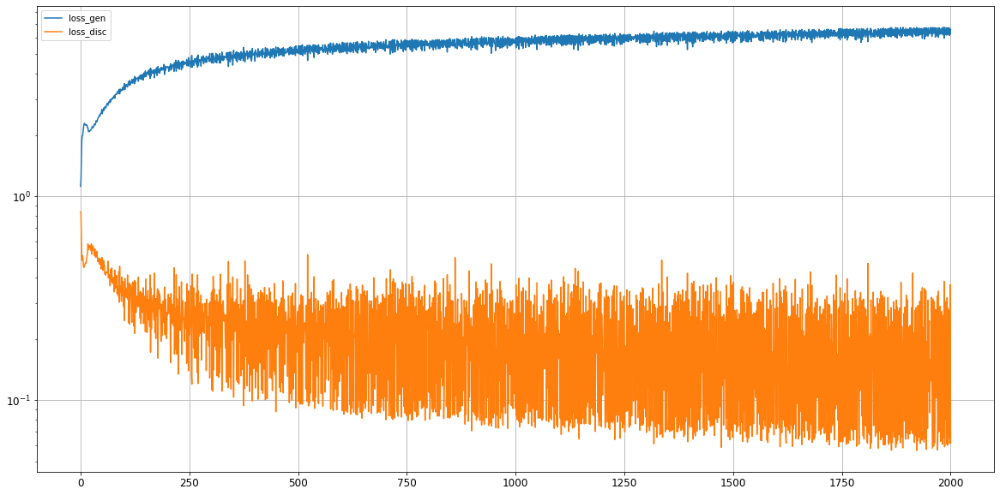

0: mean KL divergence (r,g) = 0.03964115318538461
0: mean JS divergence = 0.011842532838776926
0: mean 1-BC divergence = 0.010439441274080807

0: std KL divergence (r,g) = 0.09388773325845677
0: std JS divergence = 0.02815644781960283
0: std 1-BC divergence = 0.02416713340860055


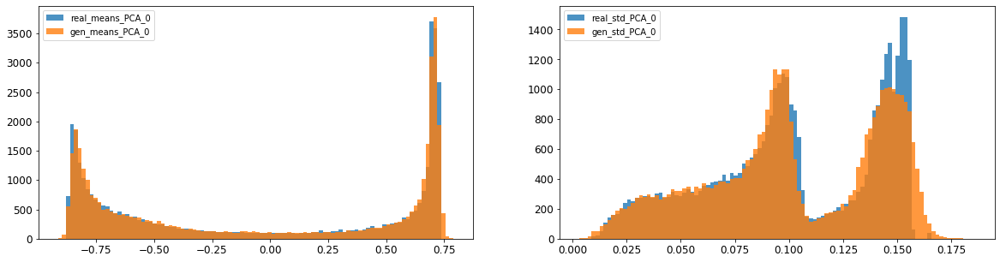

1: mean KL divergence (r,g) = 0.02387248832143785
1: mean JS divergence = 0.006291833439456617
1: mean 1-BC divergence = 0.004476566991880482

1: std KL divergence (r,g) = 0.03306126509668681
1: std JS divergence = 0.009084394792912141
1: std 1-BC divergence = 0.0064673522319183


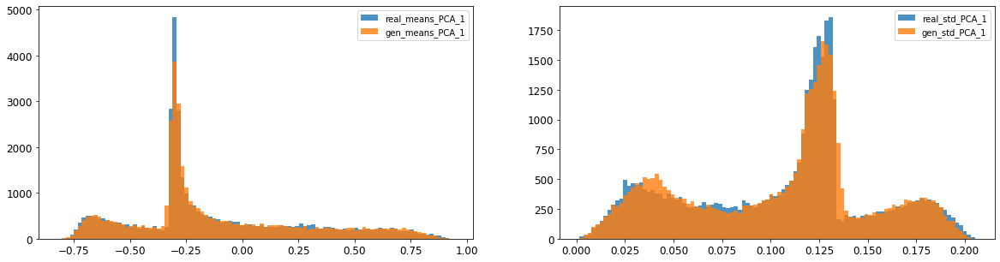

2: mean KL divergence (r,g) = 0.013839149655964349
2: mean JS divergence = 0.0035310422556363544
2: mean 1-BC divergence = 0.002566807419705386

2: std KL divergence (r,g) = 0.02432664827632988
2: std JS divergence = 0.0068602257684254545
2: std 1-BC divergence = 0.00603516366688206


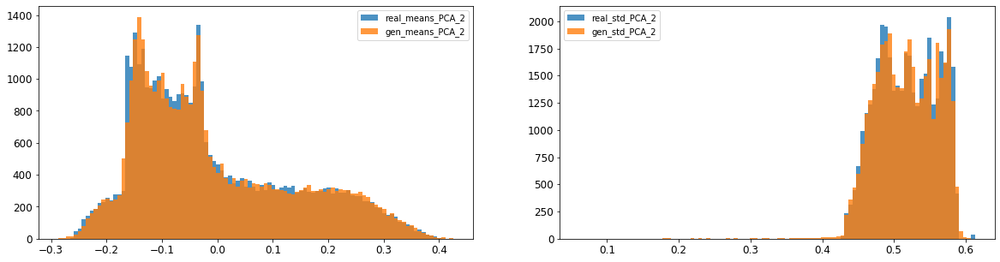

3: mean KL divergence (r,g) = 0.06873342636986034
3: mean JS divergence = 0.0172339614480771
3: mean 1-BC divergence = 0.012060203327548424

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.08055181528074412
3: std 1-BC divergence = 0.05882829719100413


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


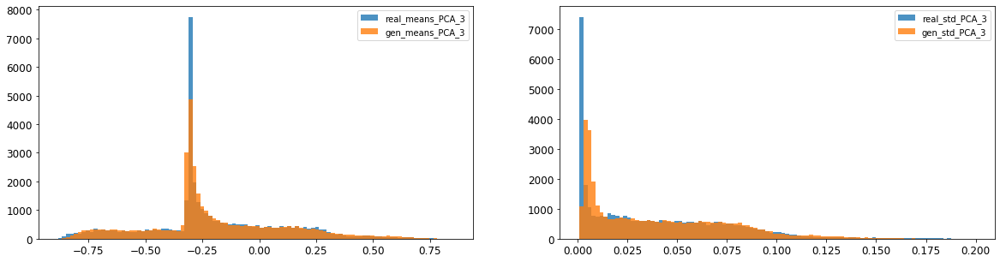

4: mean KL divergence (r,g) = 0.059663243032707286
4: mean JS divergence = 0.015039145735886987
4: mean 1-BC divergence = 0.011993567274739436

4: std KL divergence (r,g) = 0.026673224238585053
4: std JS divergence = 0.006448448561473342
4: std 1-BC divergence = 0.004581643444958261


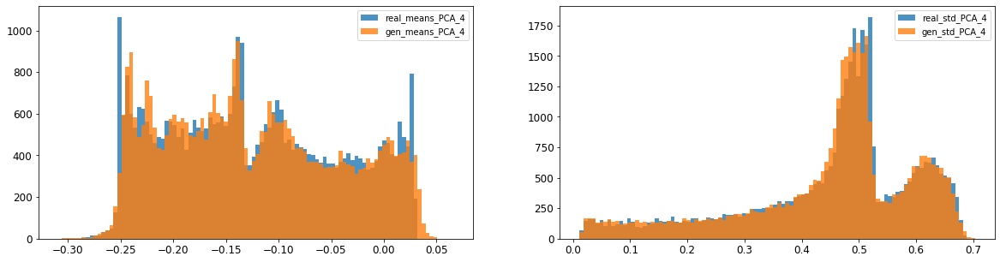

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.016301550327572016
5: mean 1-BC divergence = 0.011874620614479081

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.016685020059499265
5: std 1-BC divergence = 0.013840670274662514


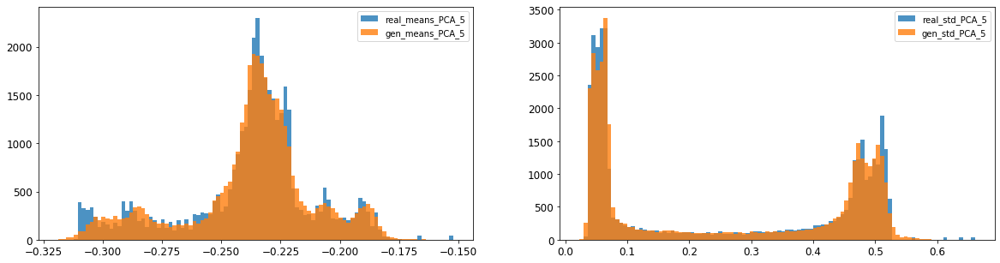

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004165300165363414
6: mean 1-BC divergence = 0.002933252282972698

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.009926205376310424
6: std 1-BC divergence = 0.0070770036504661515


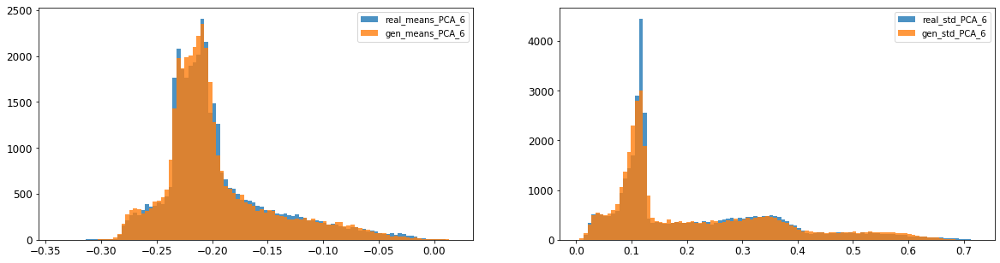

7: mean KL divergence (r,g) = 0.12778647989078878
7: mean JS divergence = 0.030218555974753734
7: mean 1-BC divergence = 0.02276974757180117

7: std KL divergence (r,g) = 0.046179924374165356
7: std JS divergence = 0.011563620752442593
7: std 1-BC divergence = 0.008135666982617362


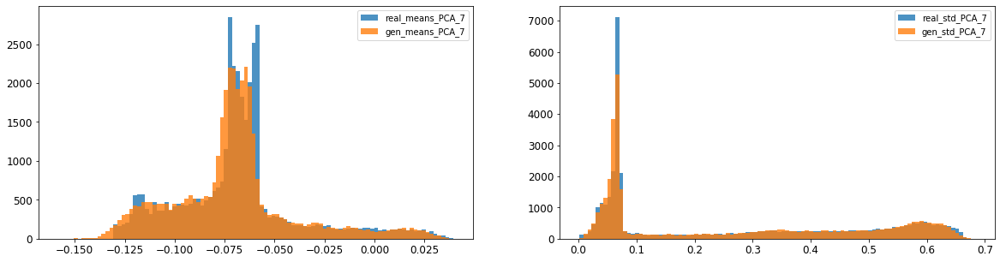

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0028043661181710684
8: mean 1-BC divergence = 0.00198002726779567

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.011855898672513174
8: std 1-BC divergence = 0.008400575218372341


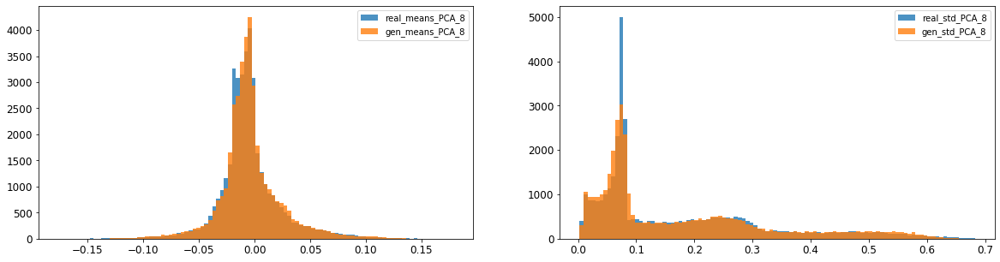

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.005124491365991645
9: mean 1-BC divergence = 0.003644344318213366

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.014263256665960383
9: std 1-BC divergence = 0.010127930242238792


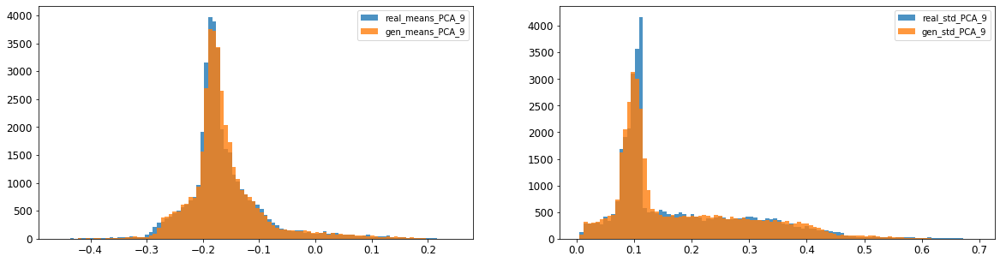

10: mean KL divergence (r,g) = 0.024583980562314155
10: mean JS divergence = 0.006056151755644315
10: mean 1-BC divergence = 0.004277846478999758

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007494050029857843
10: std 1-BC divergence = 0.006591742825112323


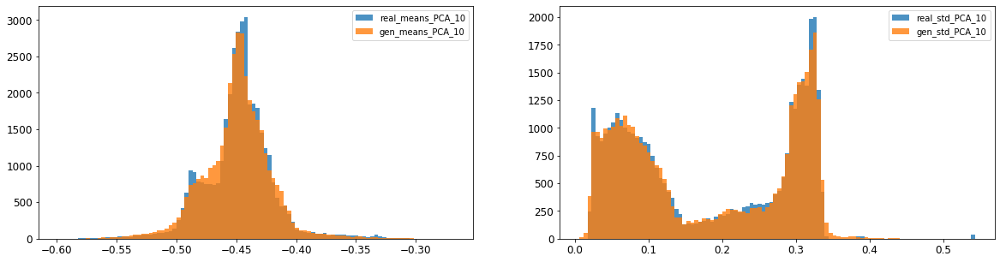

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.0106676836034619
11: mean 1-BC divergence = 0.007607818573979408

11: std KL divergence (r,g) = 0.050745049019482326
11: std JS divergence = 0.01333900302453243
11: std 1-BC divergence = 0.00950717141141788


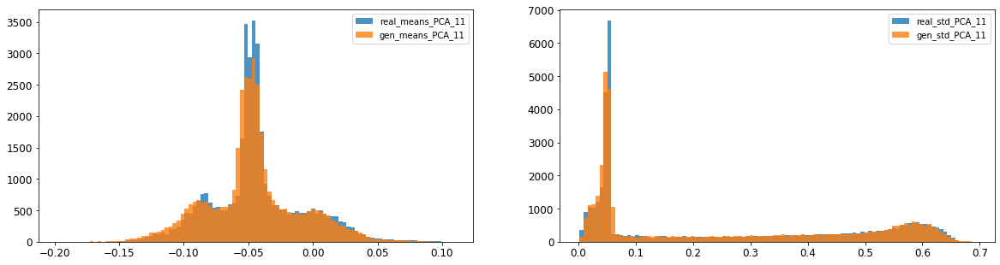

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.007407560899123443
12: mean 1-BC divergence = 0.005190677420940815

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.021794865557255207
12: std 1-BC divergence = 0.015428393358416725


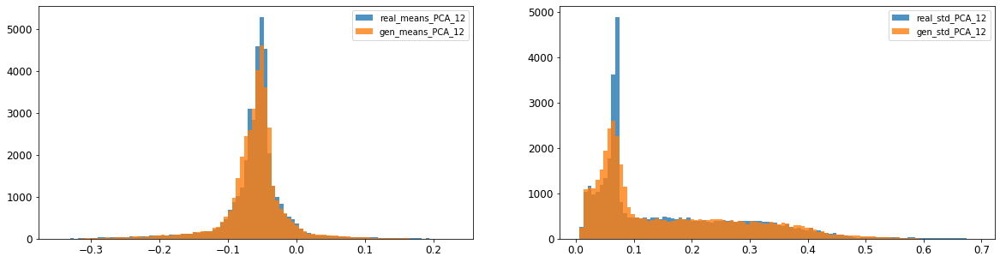

13: mean KL divergence (r,g) = 0.03354976415201195
13: mean JS divergence = 0.008294611937368978
13: mean 1-BC divergence = 0.005817225475967525

13: std KL divergence (r,g) = 0.09527905572527513
13: std JS divergence = 0.022776341017856413
13: std 1-BC divergence = 0.015990632590631937


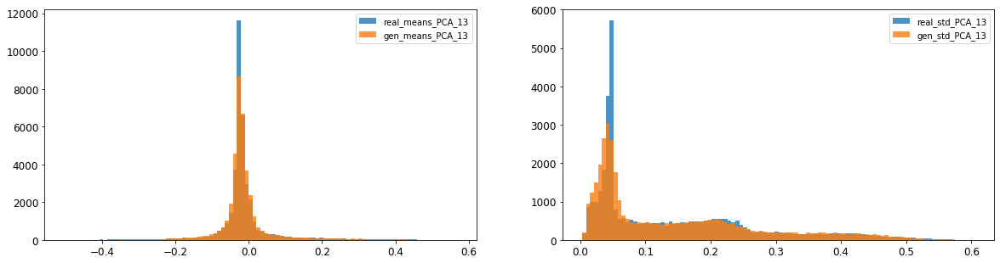

14: mean KL divergence (r,g) = 0.06877626338038495
14: mean JS divergence = 0.017122911639600814
14: mean 1-BC divergence = 0.011993437773123783

14: std KL divergence (r,g) = 0.030249382213692746
14: std JS divergence = 0.007417655546402731
14: std 1-BC divergence = 0.005179186344261955


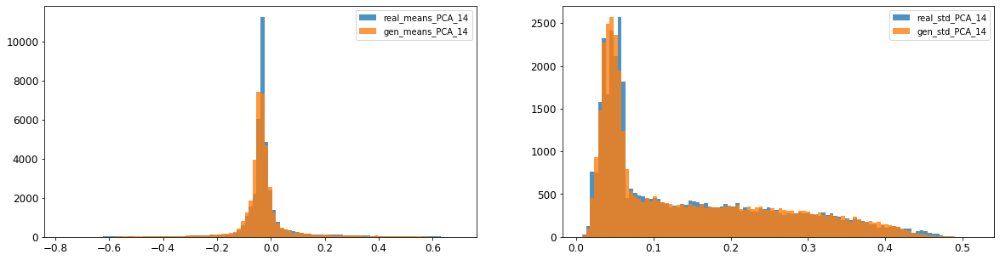

15: mean KL divergence (r,g) = 1.704300712969707
15: mean JS divergence = 0.46949075801271334
15: mean 1-BC divergence = 0.42905106207966426

15: std KL divergence (r,g) = 5.414737905249964
15: std JS divergence = 0.9194260926270112
15: std 1-BC divergence = 0.846890994382283


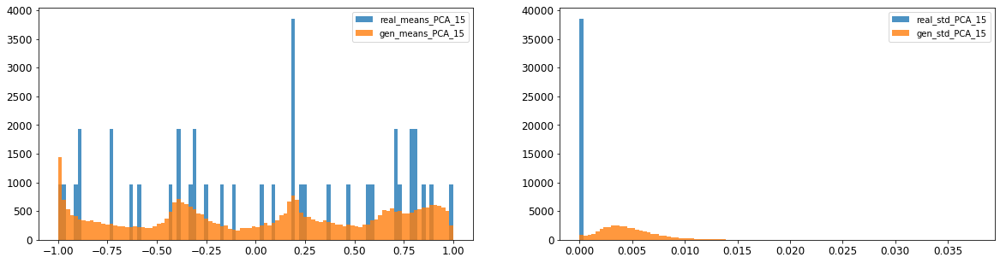

16: mean KL divergence (r,g) = 1.4780940104217475
16: mean JS divergence = 0.4160199000477819
16: mean 1-BC divergence = 0.3817675886274716

16: std KL divergence (r,g) = 5.625989768981211
16: std JS divergence = 0.9282854197119166
16: std 1-BC divergence = 0.8577002417999222


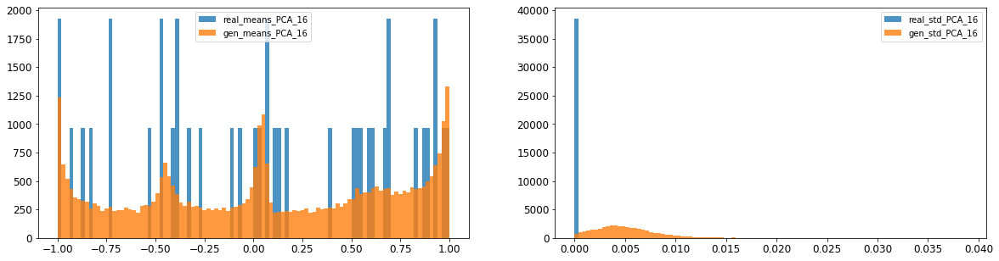



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01434396494768912
Compose 1-BC divergence = 0.010666138230259525

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.016842144466711922
Compose weighted 1-BC divergence = 0.013834439056943815

Multivariate KL divergence = 53.59006252960689


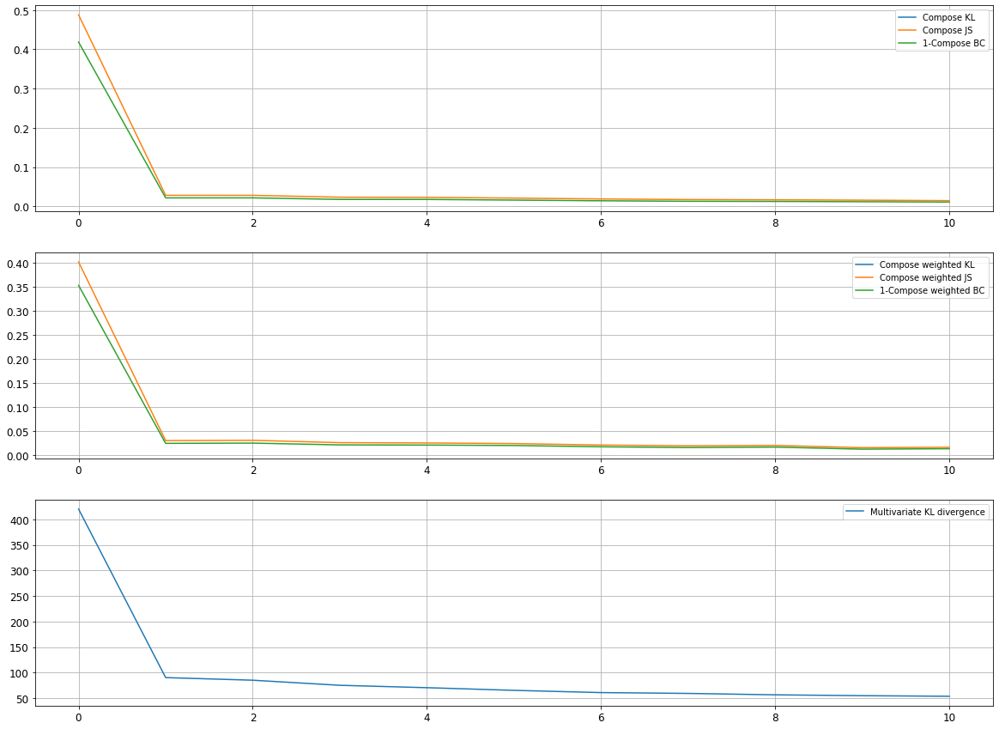

Epoch 2002/10000
discriminator loss: 0.210788 - generator loss: 6.234254 - 35s
Epoch 2003/10000
discriminator loss: 0.060529 - generator loss: 6.747544 - 40s
Epoch 2004/10000
discriminator loss: 0.078765 - generator loss: 6.604058 - 39s
Epoch 2005/10000
discriminator loss: 0.374789 - generator loss: 5.953493 - 37s
Epoch 2006/10000
discriminator loss: 0.061003 - generator loss: 6.731771 - 39s
Epoch 2007/10000
discriminator loss: 0.062026 - generator loss: 6.722316 - 39s
Epoch 2008/10000
discriminator loss: 0.334343 - generator loss: 6.032479 - 39s
Epoch 2009/10000
discriminator loss: 0.057791 - generator loss: 6.652746 - 40s
Epoch 2010/10000
discriminator loss: 0.059375 - generator loss: 6.739180 - 41s
Epoch 2011/10000
discriminator loss: 0.371499 - generator loss: 6.141585 - 39s
Epoch 2012/10000
discriminator loss: 0.139585 - generator loss: 6.381223 - 40s
Epoch 2013/10000
discriminator loss: 0.110940 - generator loss: 6.786231 - 39s
Epoch 2014/10000
discriminator loss: 0.238398 - gene

discriminator loss: 0.214551 - generator loss: 6.420322 - 37s
Epoch 2107/10000
discriminator loss: 0.063514 - generator loss: 6.764004 - 38s
Epoch 2108/10000
discriminator loss: 0.319700 - generator loss: 6.435760 - 40s
Epoch 2109/10000
discriminator loss: 0.063366 - generator loss: 6.673504 - 38s
Epoch 2110/10000
discriminator loss: 0.160297 - generator loss: 6.808011 - 39s
Epoch 2111/10000
discriminator loss: 0.182759 - generator loss: 6.382680 - 39s
Epoch 2112/10000
discriminator loss: 0.074283 - generator loss: 6.678944 - 40s
Epoch 2113/10000
discriminator loss: 0.072157 - generator loss: 6.697543 - 38s
Epoch 2114/10000
discriminator loss: 0.369532 - generator loss: 6.107678 - 39s
Epoch 2115/10000
discriminator loss: 0.058418 - generator loss: 6.806837 - 38s
Epoch 2116/10000
discriminator loss: 0.255934 - generator loss: 6.555900 - 38s
Epoch 2117/10000
discriminator loss: 0.109352 - generator loss: 6.367530 - 39s
Epoch 2118/10000
discriminator loss: 0.063326 - generator loss: 6.780

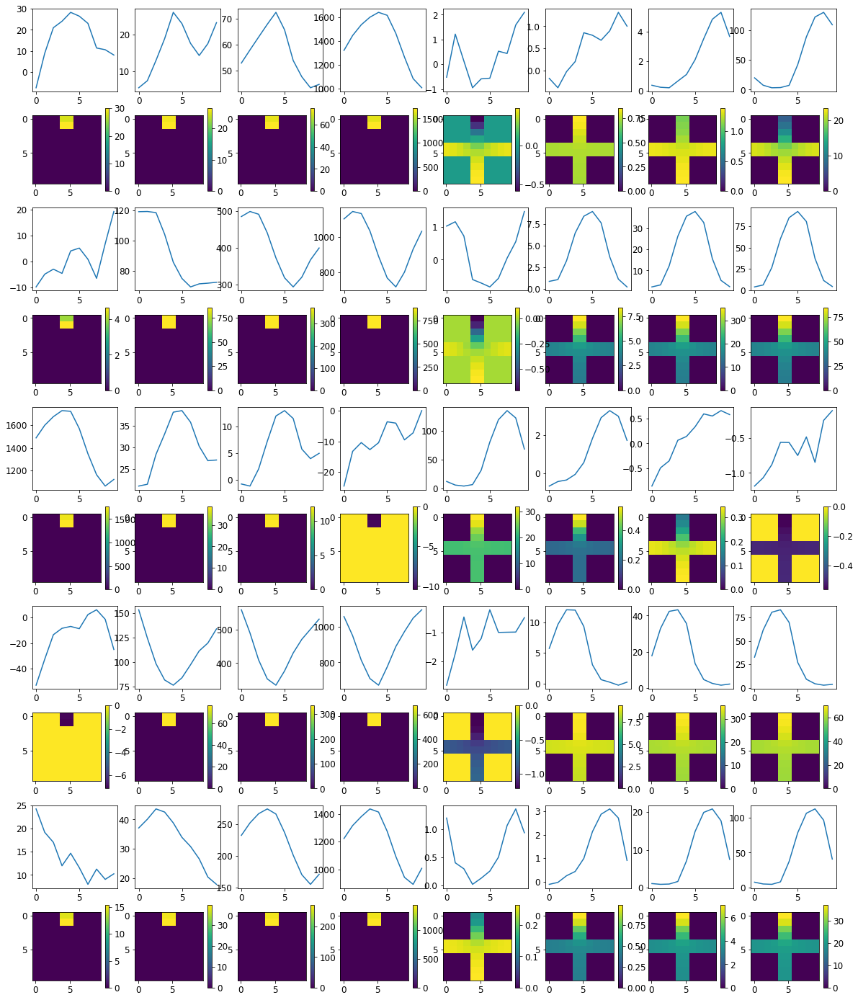


R0 generated:
[[19.696693   18.453209  ]
 [19.644585   18.40517   ]
 [19.648018   18.39667   ]
 [19.648151   18.417587  ]
 [19.652332   18.452278  ]
 [19.65077    18.4123    ]
 [19.655848   18.481966  ]
 [19.648724   18.468025  ]
 [19.638027   18.460796  ]
 [19.640543   18.556086  ]
 [17.809101    0.70357436]
 [17.660477    0.73096794]
 [17.678083    0.71555656]
 [17.699219    0.6891286 ]
 [17.705338    0.68885744]
 [17.665339    0.67504203]
 [17.673275    0.6685398 ]
 [17.682732    0.66226393]
 [17.751068    0.7043056 ]
 [17.66771     0.73211783]
 [18.559973    1.0998892 ]
 [18.446188    1.1006122 ]
 [18.476011    1.1224138 ]
 [18.489792    1.077747  ]
 [18.469784    1.0421375 ]
 [18.45087     1.0640645 ]
 [18.400236    1.0486957 ]
 [18.42899     1.1414894 ]
 [18.418434    1.1221433 ]
 [18.43138     0.9713536 ]
 [19.820478   18.624619  ]
 [19.801565   18.543327  ]
 [19.782232   18.53263   ]
 [19.777285   18.537039  ]
 [19.784277   18.552765  ]
 [19.783354   18.500145  ]
 [19.79321   

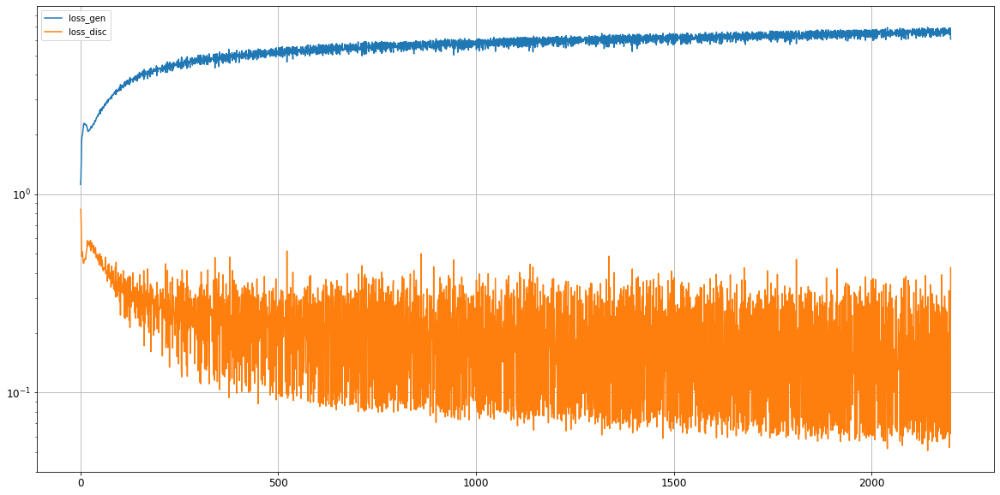

0: mean KL divergence (r,g) = 0.03529788485861158
0: mean JS divergence = 0.010254971020719272
0: mean 1-BC divergence = 0.008493553943000776

0: std KL divergence (r,g) = 0.09016586038963882
0: std JS divergence = 0.026052210977823946
0: std 1-BC divergence = 0.02253589357513086


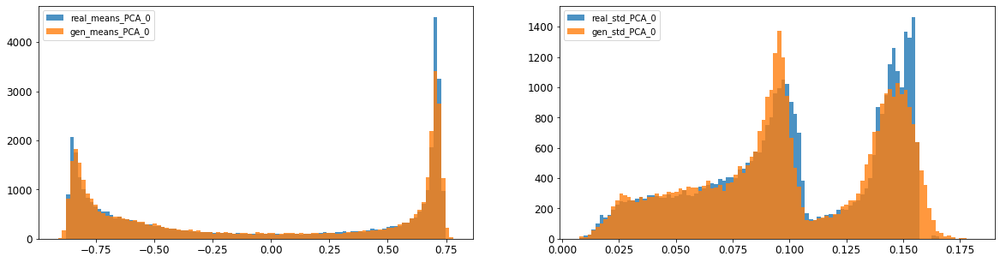

1: mean KL divergence (r,g) = 0.038090231583987874
1: mean JS divergence = 0.010367297491978313
1: mean 1-BC divergence = 0.00744704094854598

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.013623919518109026
1: std 1-BC divergence = 0.009613120324315494


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


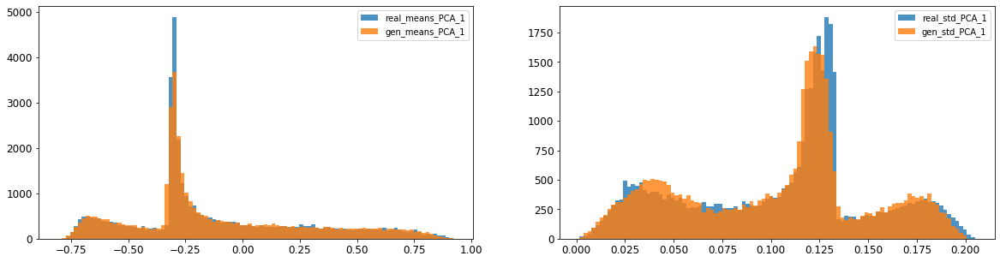

2: mean KL divergence (r,g) = 0.01114124243447624
2: mean JS divergence = 0.002815618739840562
2: mean 1-BC divergence = 0.0020070172917641127

2: std KL divergence (r,g) = 0.04913628750795445
2: std JS divergence = 0.01578852887335326
2: std 1-BC divergence = 0.015032194768080043


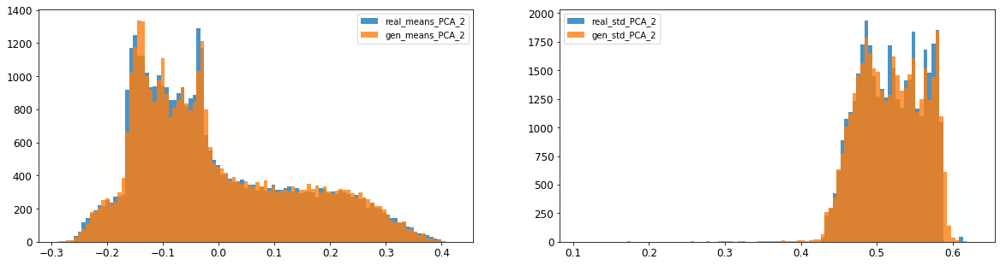

3: mean KL divergence (r,g) = 0.03745182922708376
3: mean JS divergence = 0.009097188673508366
3: mean 1-BC divergence = 0.006401380381112265

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.07286810622442019
3: std 1-BC divergence = 0.05313115780175226


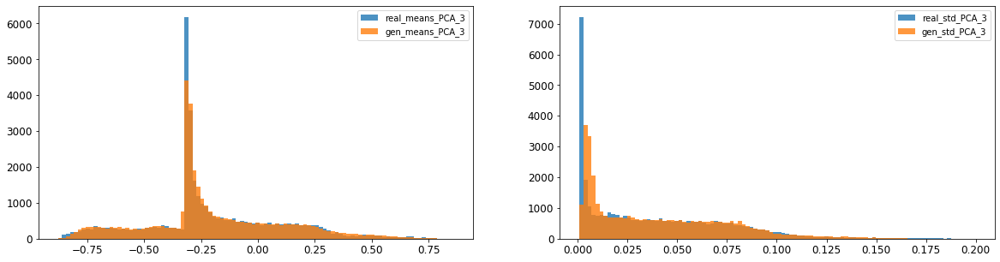

4: mean KL divergence (r,g) = 0.05306239441112562
4: mean JS divergence = 0.015202225979065561
4: mean 1-BC divergence = 0.012085477755021556

4: std KL divergence (r,g) = 0.014494022037978133
4: std JS divergence = 0.0037382904106911443
4: std 1-BC divergence = 0.0026998591315323672


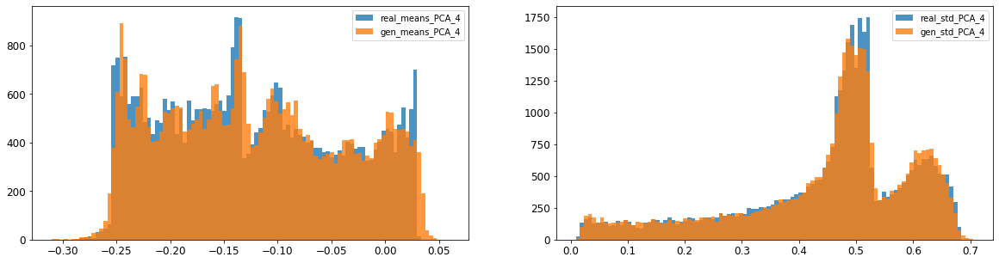

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.02006598374593037
5: mean 1-BC divergence = 0.016073664435920287

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.018972230575301285
5: std 1-BC divergence = 0.01599336079097735


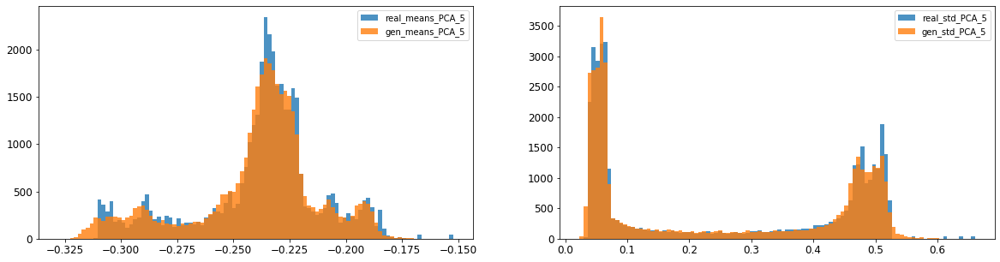

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.006020952945196078
6: mean 1-BC divergence = 0.004256890627613696

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.011468541725023778
6: std 1-BC divergence = 0.008231795078035509


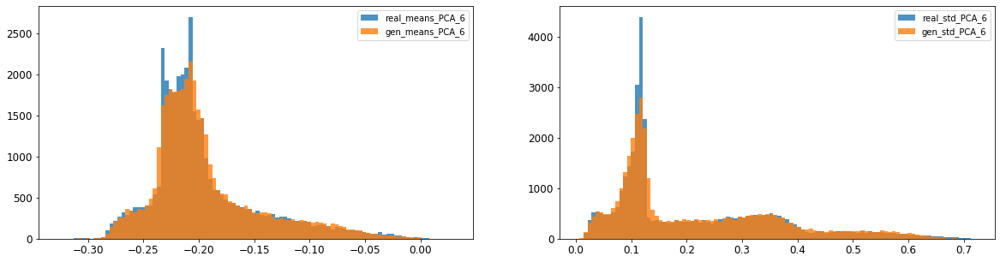

7: mean KL divergence (r,g) = 0.04205417330456398
7: mean JS divergence = 0.010926946240381239
7: mean 1-BC divergence = 0.00831959466200749

7: std KL divergence (r,g) = 0.04963976519809398
7: std JS divergence = 0.012176198451551046
7: std 1-BC divergence = 0.008584350467268242


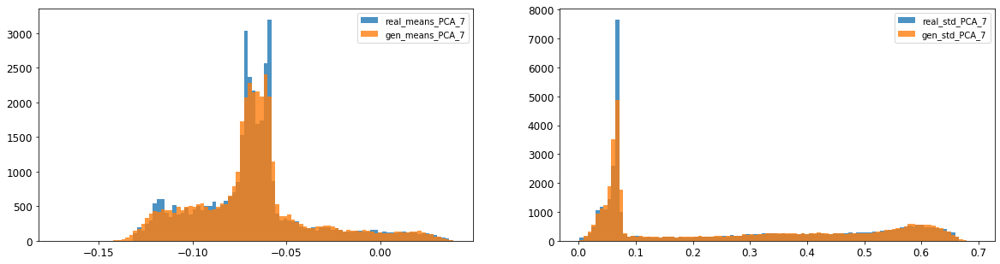

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0034154945153574826
8: mean 1-BC divergence = 0.0023920705137092657

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.012070010154789706
8: std 1-BC divergence = 0.008599699906906233


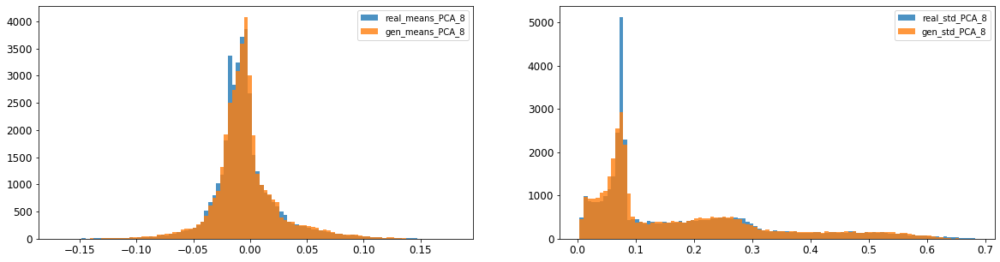

9: mean KL divergence (r,g) = 0.0189342136090449
9: mean JS divergence = 0.004648798253975043
9: mean 1-BC divergence = 0.003246683690261265

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.016125469138264126
9: std 1-BC divergence = 0.011627717926528836


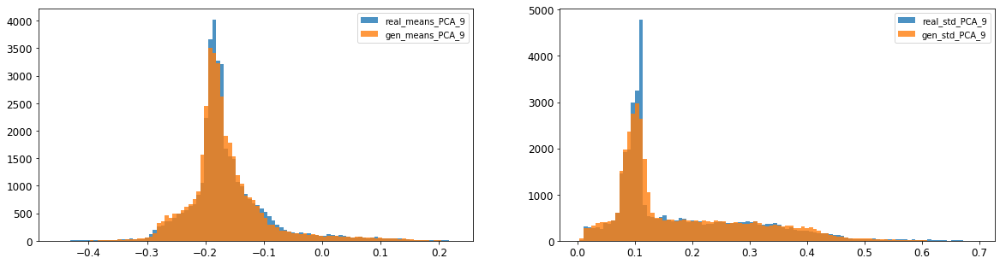

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.0048100897333260405
10: mean 1-BC divergence = 0.003450537925187347

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007571936895394588
10: std 1-BC divergence = 0.006329873264755759


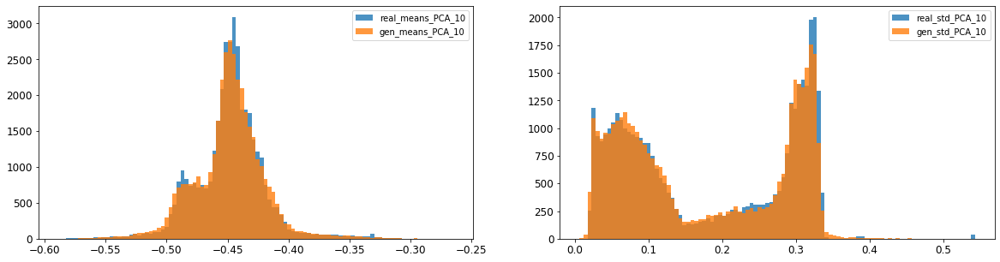

11: mean KL divergence (r,g) = 0.07343396871984541
11: mean JS divergence = 0.018473251532468392
11: mean 1-BC divergence = 0.013023987810889981

11: std KL divergence (r,g) = 0.05494671896380609
11: std JS divergence = 0.01409887672322168
11: std 1-BC divergence = 0.01007039929334208


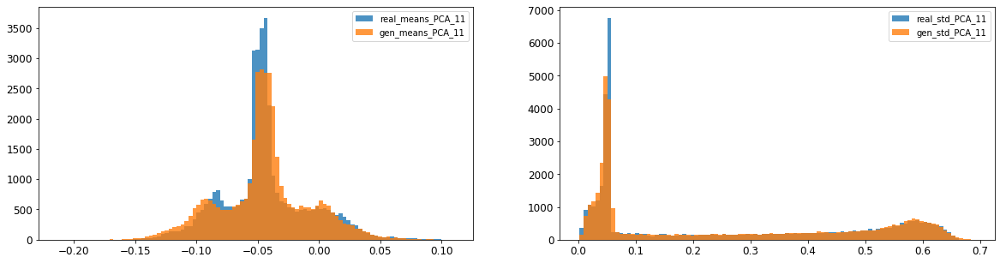

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004044366603148712
12: mean 1-BC divergence = 0.0028352218984830646

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.02087219810267336
12: std 1-BC divergence = 0.01493321292620231


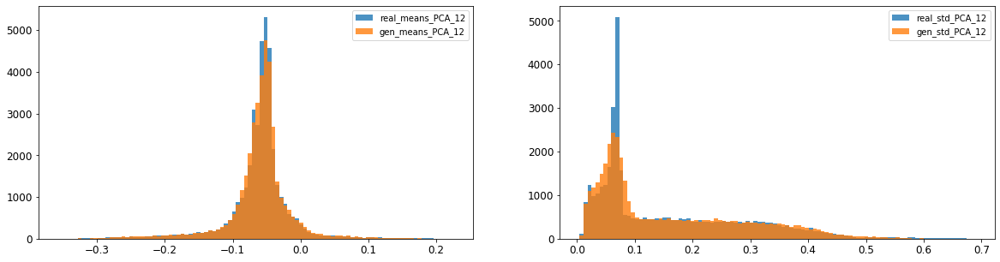

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.010927881081310403
13: mean 1-BC divergence = 0.007635947493646045

13: std KL divergence (r,g) = 0.06885487794404856
13: std JS divergence = 0.01622765638947916
13: std 1-BC divergence = 0.011334867585960251


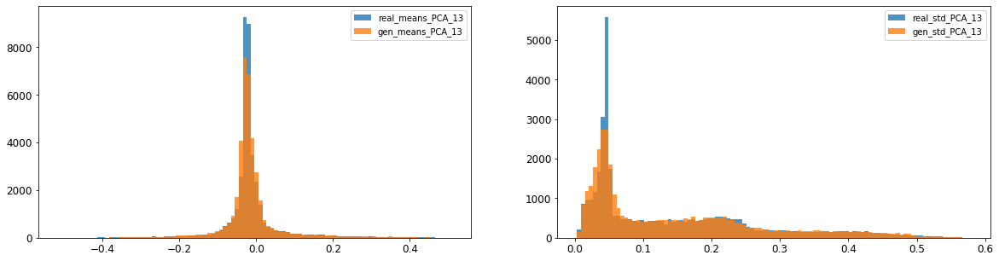

14: mean KL divergence (r,g) = 0.04666669984185689
14: mean JS divergence = 0.011599670605475123
14: mean 1-BC divergence = 0.008107432104665802

14: std KL divergence (r,g) = 0.02673204203102898
14: std JS divergence = 0.006359018659232698
14: std 1-BC divergence = 0.0044355661001656


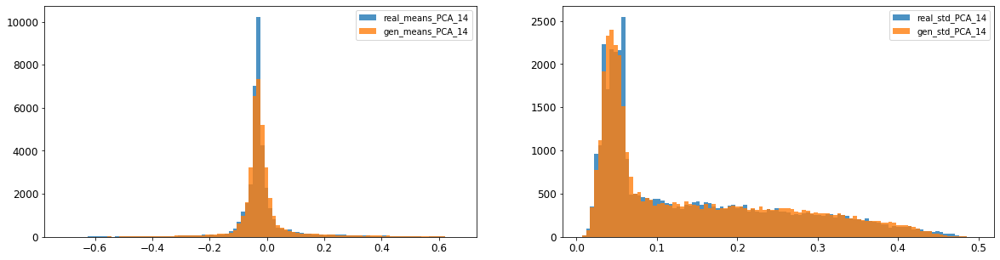

15: mean KL divergence (r,g) = 1.7076874675686424
15: mean JS divergence = 0.47041348928307153
15: mean 1-BC divergence = 0.4303845051324341

15: std KL divergence (r,g) = 5.539833125231496
15: std JS divergence = 0.9247886689386098
15: std 1-BC divergence = 0.8533871523269405


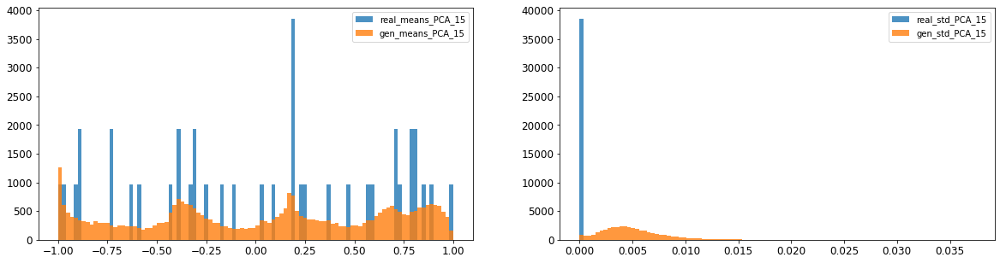

16: mean KL divergence (r,g) = 1.4634742264839895
16: mean JS divergence = 0.4130647927076781
16: mean 1-BC divergence = 0.37966394901384826

16: std KL divergence (r,g) = 5.777992862426261
16: std JS divergence = 0.9340849444255788
16: std 1-BC divergence = 0.8650025960789595


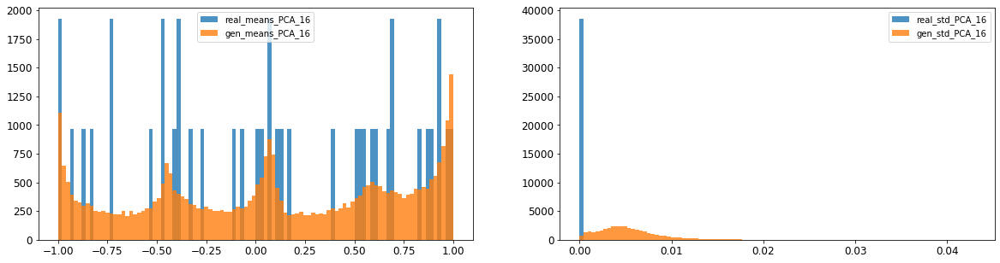



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.013689464332700333
Compose 1-BC divergence = 0.010297652347426078

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.01656808309749713
Compose weighted 1-BC divergence = 0.013499399884770003

Multivariate KL divergence = 52.93278483976079


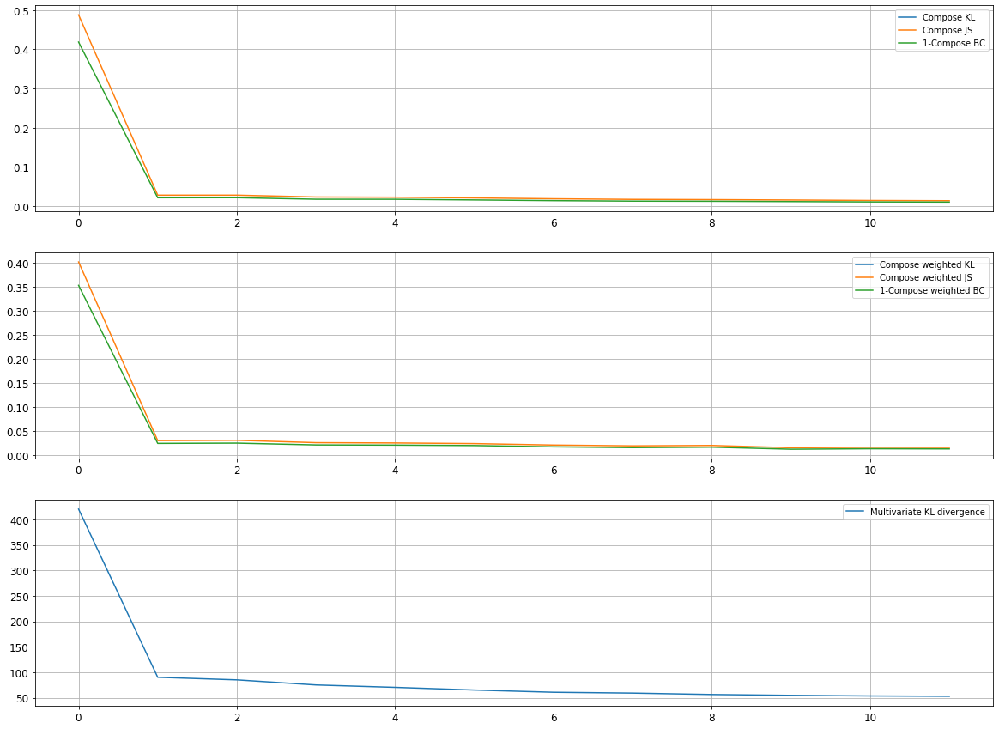

Epoch 2202/10000
discriminator loss: 0.054036 - generator loss: 6.913578 - 39s
Epoch 2203/10000
discriminator loss: 0.061124 - generator loss: 6.879256 - 38s
Epoch 2204/10000
discriminator loss: 0.202829 - generator loss: 6.379653 - 39s
Epoch 2205/10000
discriminator loss: 0.069432 - generator loss: 6.699836 - 40s
Epoch 2206/10000
discriminator loss: 0.318210 - generator loss: 6.431337 - 39s
Epoch 2207/10000
discriminator loss: 0.066809 - generator loss: 6.695749 - 40s
Epoch 2208/10000
discriminator loss: 0.093139 - generator loss: 6.828278 - 36s
Epoch 2209/10000
discriminator loss: 0.307068 - generator loss: 6.408615 - 39s
Epoch 2210/10000
discriminator loss: 0.068643 - generator loss: 6.839703 - 39s
Epoch 2211/10000
discriminator loss: 0.317897 - generator loss: 6.597588 - 38s
Epoch 2212/10000
discriminator loss: 0.082857 - generator loss: 6.455463 - 39s
Epoch 2213/10000
discriminator loss: 0.170796 - generator loss: 6.607272 - 41s
Epoch 2214/10000
discriminator loss: 0.088350 - gene

discriminator loss: 0.136104 - generator loss: 6.578061 - 34s
Epoch 2307/10000
discriminator loss: 0.061127 - generator loss: 6.878222 - 34s
Epoch 2308/10000
discriminator loss: 0.302237 - generator loss: 6.398843 - 36s
Epoch 2309/10000
discriminator loss: 0.051825 - generator loss: 6.963169 - 37s
Epoch 2310/10000
discriminator loss: 0.255863 - generator loss: 6.510687 - 39s
Epoch 2311/10000
discriminator loss: 0.056292 - generator loss: 6.861394 - 39s
Epoch 2312/10000
discriminator loss: 0.227061 - generator loss: 6.937618 - 35s
Epoch 2313/10000
discriminator loss: 0.118837 - generator loss: 6.389165 - 37s
Epoch 2314/10000
discriminator loss: 0.059499 - generator loss: 6.922700 - 29s
Epoch 2315/10000
discriminator loss: 0.350953 - generator loss: 6.477918 - 33s
Epoch 2316/10000
discriminator loss: 0.071621 - generator loss: 6.666920 - 33s
Epoch 2317/10000
discriminator loss: 0.058688 - generator loss: 6.880056 - 35s
Epoch 2318/10000
discriminator loss: 0.331713 - generator loss: 6.183

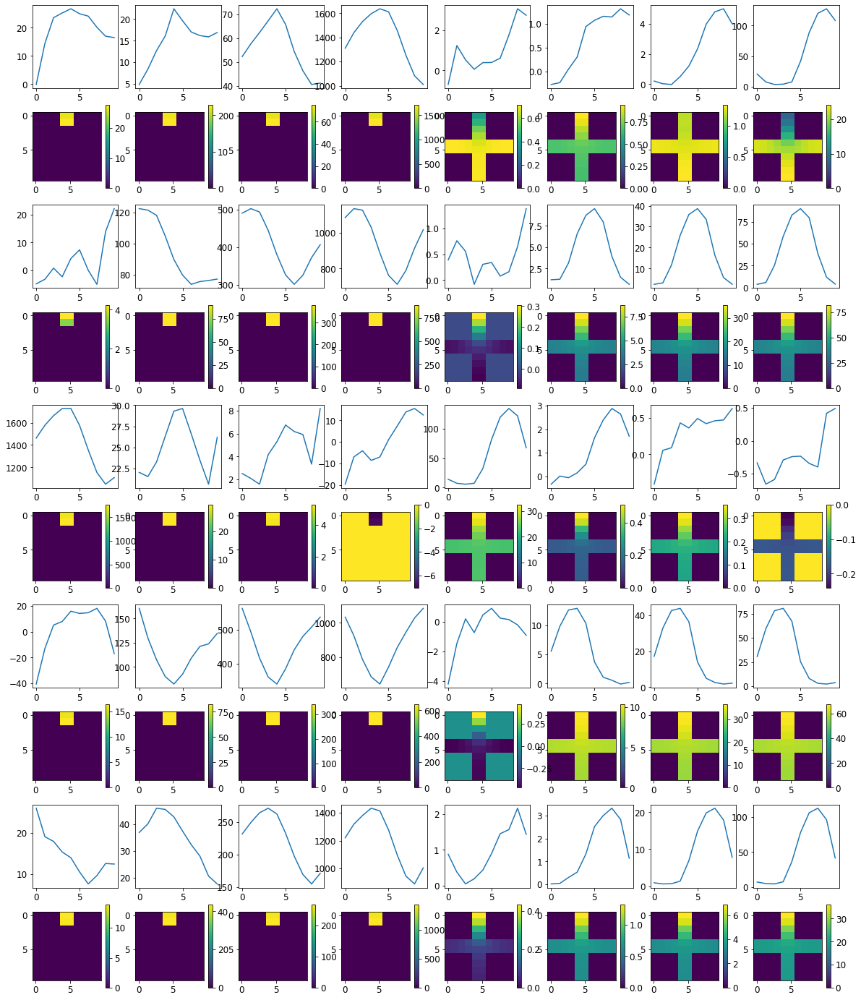


R0 generated:
[[19.697573   18.351744  ]
 [19.645552   18.307854  ]
 [19.647495   18.257885  ]
 [19.6404     18.268568  ]
 [19.650156   18.311392  ]
 [19.651506   18.293438  ]
 [19.663181   18.366827  ]
 [19.65489    18.35588   ]
 [19.645323   18.343105  ]
 [19.649193   18.382254  ]
 [17.52949     0.7634036 ]
 [17.415226    0.7872023 ]
 [17.454647    0.7447198 ]
 [17.458675    0.7334683 ]
 [17.470217    0.76539373]
 [17.470592    0.76861537]
 [17.495203    0.76157147]
 [17.491095    0.7571696 ]
 [17.529219    0.7970136 ]
 [17.422726    0.8053881 ]
 [18.419445    1.0383631 ]
 [18.3262      1.00684   ]
 [18.339733    0.97770125]
 [18.328165    0.9130457 ]
 [18.310158    0.8984017 ]
 [18.31104     0.9233013 ]
 [18.281063    0.9048986 ]
 [18.317816    0.9583731 ]
 [18.352066    1.0191429 ]
 [18.387901    0.8786287 ]
 [19.807165   18.194351  ]
 [19.78786    18.10038   ]
 [19.772093   18.067818  ]
 [19.768427   18.042923  ]
 [19.77933    18.039675  ]
 [19.776852   17.960539  ]
 [19.7867    

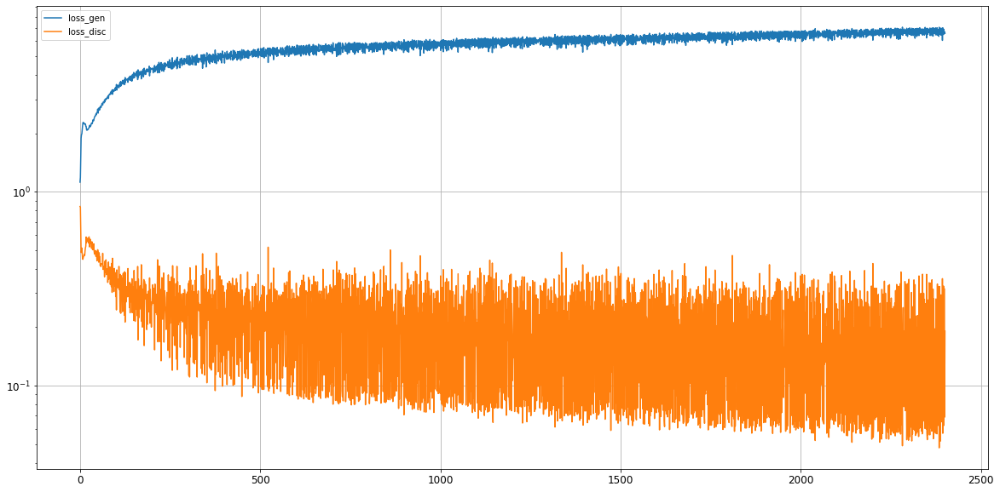

0: mean KL divergence (r,g) = 0.03008369851579205
0: mean JS divergence = 0.007839505703601318
0: mean 1-BC divergence = 0.005867135969772841

0: std KL divergence (r,g) = 0.08770815786145303
0: std JS divergence = 0.02719221609147294
0: std 1-BC divergence = 0.024868834822841746


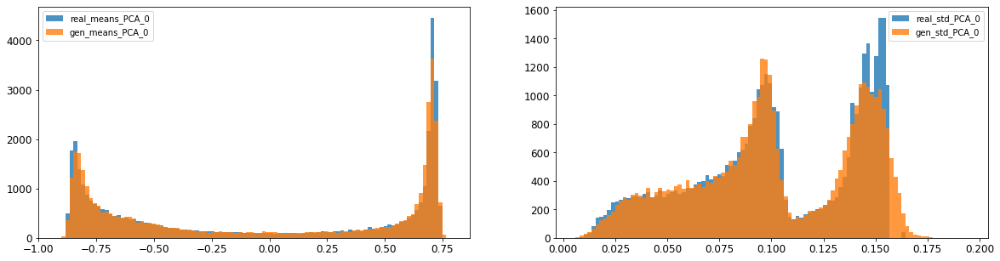

1: mean KL divergence (r,g) = 0.02622761763328368
1: mean JS divergence = 0.0066640065457911485
1: mean 1-BC divergence = 0.004731187753360455

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.018604363846649395
1: std 1-BC divergence = 0.013210158948107176


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


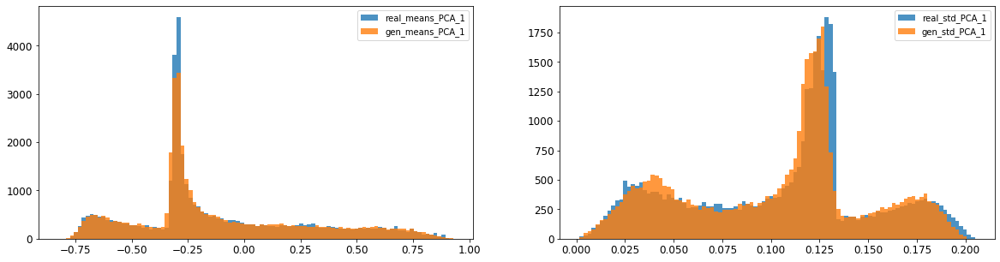

2: mean KL divergence (r,g) = 0.0137491885701674
2: mean JS divergence = 0.0035255876033693967
2: mean 1-BC divergence = 0.002605977018251493

2: std KL divergence (r,g) = 0.0399766824940549
2: std JS divergence = 0.010492814713051354
2: std 1-BC divergence = 0.0084811023213478


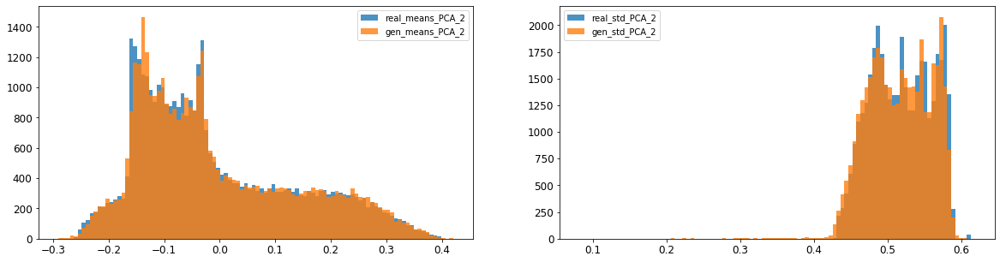

3: mean KL divergence (r,g) = 0.09677512218640644
3: mean JS divergence = 0.026694060316370245
3: mean 1-BC divergence = 0.01949681344235865

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0862089370314332
3: std 1-BC divergence = 0.06422915704477083


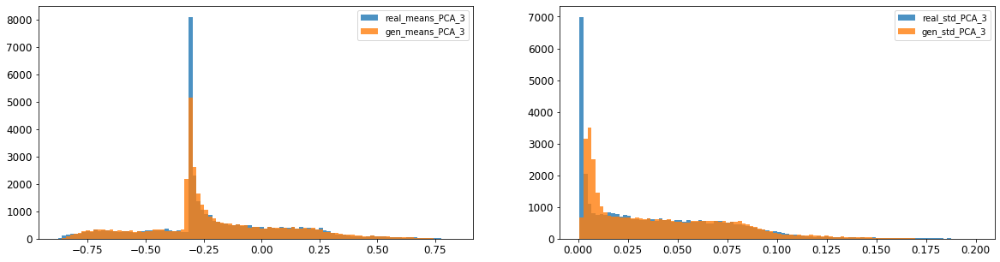

4: mean KL divergence (r,g) = 0.06137201466275575
4: mean JS divergence = 0.014368298640646822
4: mean 1-BC divergence = 0.010531663395898283

4: std KL divergence (r,g) = 0.022595572334716967
4: std JS divergence = 0.005385107306094247
4: std 1-BC divergence = 0.0037648387332311906


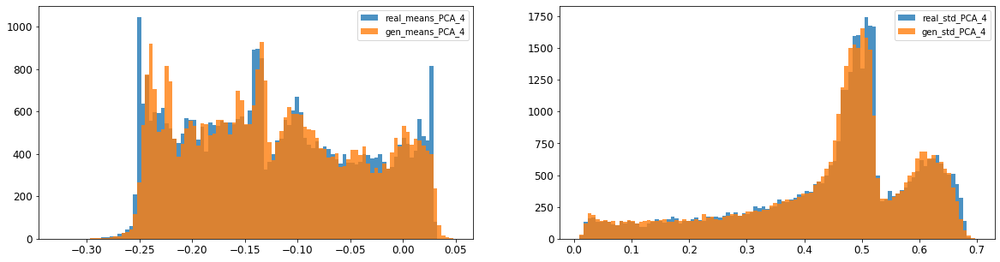

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.020234148801579595
5: mean 1-BC divergence = 0.015076460699246175

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.0192833245387325
5: std 1-BC divergence = 0.015907637292424504


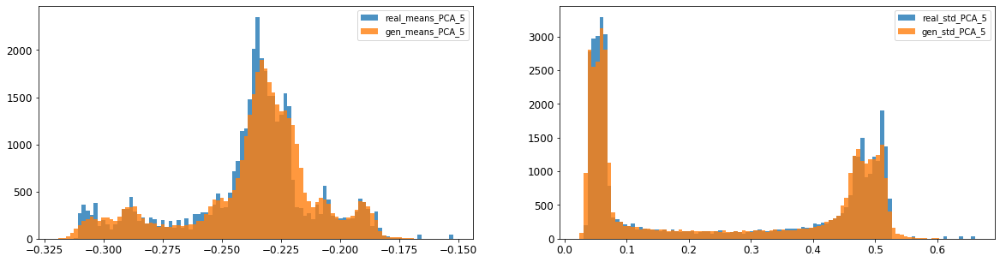

6: mean KL divergence (r,g) = 0.04950348064655446
6: mean JS divergence = 0.011061819802667013
6: mean 1-BC divergence = 0.007887407955034953

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.012516479832959455
6: std 1-BC divergence = 0.00916385054239488


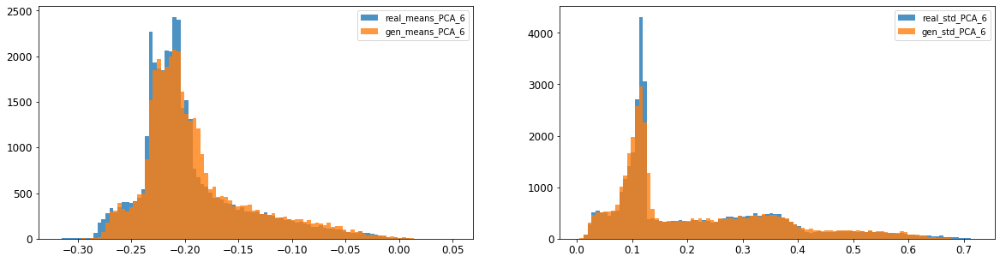

7: mean KL divergence (r,g) = 0.11351106282689744
7: mean JS divergence = 0.025561598298477622
7: mean 1-BC divergence = 0.018727302384938915

7: std KL divergence (r,g) = 0.04435381520813726
7: std JS divergence = 0.010853933715377127
7: std 1-BC divergence = 0.007597346099621927


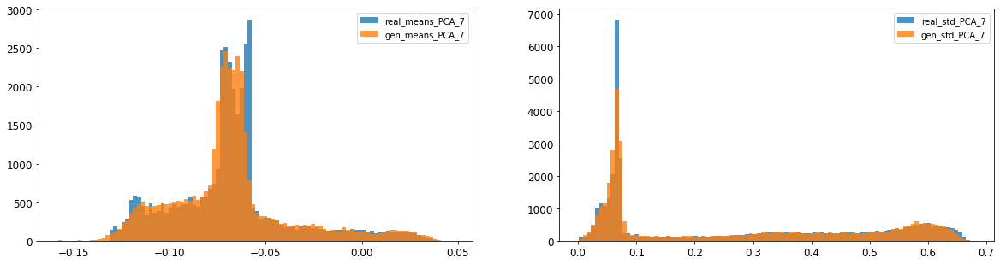

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.00549222639938945
8: mean 1-BC divergence = 0.003884795403703567

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.011574111971049647
8: std 1-BC divergence = 0.008154750509428488


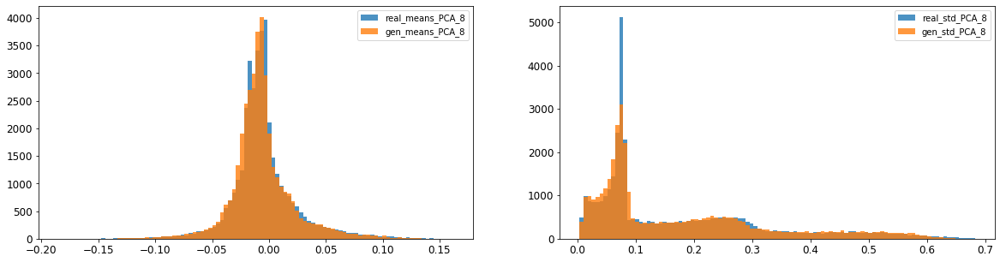

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003753432581618768
9: mean 1-BC divergence = 0.002703790264936501

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.013648281428835118
9: std 1-BC divergence = 0.009714745009504422


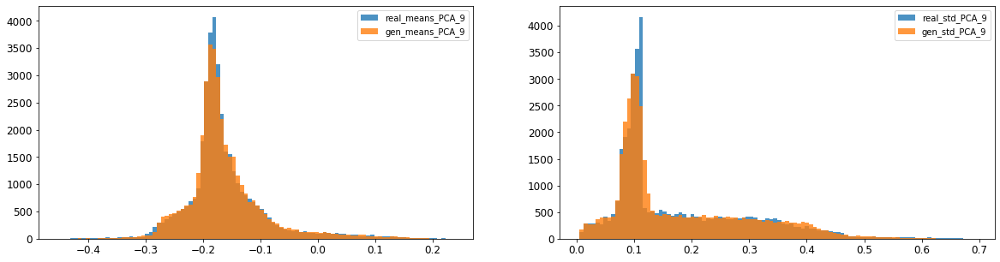

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.027776883098402483
10: mean 1-BC divergence = 0.01955009238246619

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007359203621395965
10: std 1-BC divergence = 0.0063535254187894186


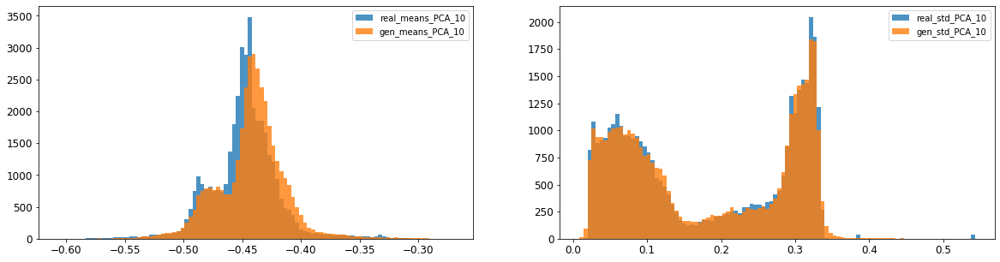

11: mean KL divergence (r,g) = 0.031120246378495912
11: mean JS divergence = 0.008083641297628189
11: mean 1-BC divergence = 0.0057158039903228985

11: std KL divergence (r,g) = 0.04960353327120848
11: std JS divergence = 0.012800992380968646
11: std 1-BC divergence = 0.00908708913284273


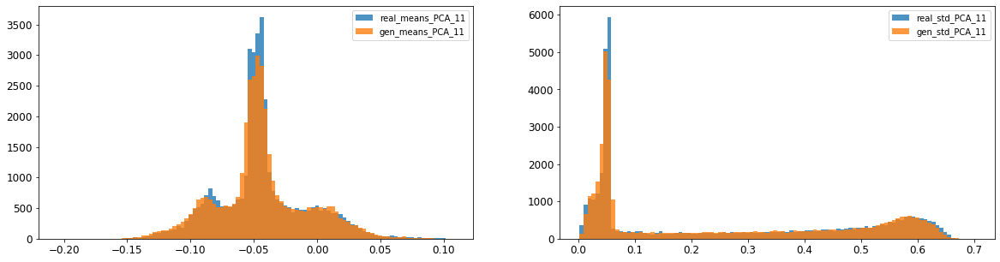

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.007103183727471418
12: mean 1-BC divergence = 0.004994149549236049

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.020167434943275497
12: std 1-BC divergence = 0.014317565294131085


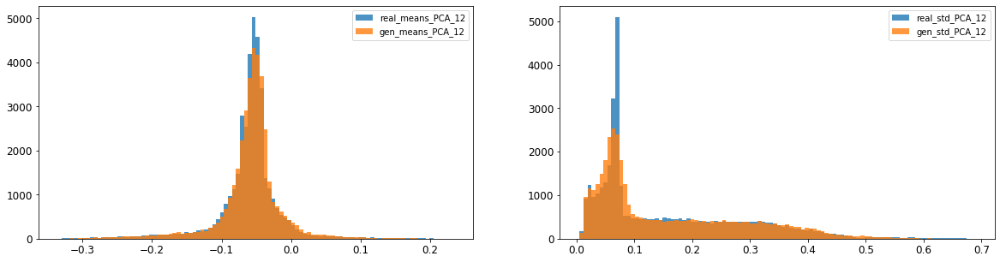

13: mean KL divergence (r,g) = 0.048931008384361076
13: mean JS divergence = 0.012347435793310844
13: mean 1-BC divergence = 0.008648749886804308

13: std KL divergence (r,g) = 0.07637435200671136
13: std JS divergence = 0.018797020592567437
13: std 1-BC divergence = 0.013188123293672027


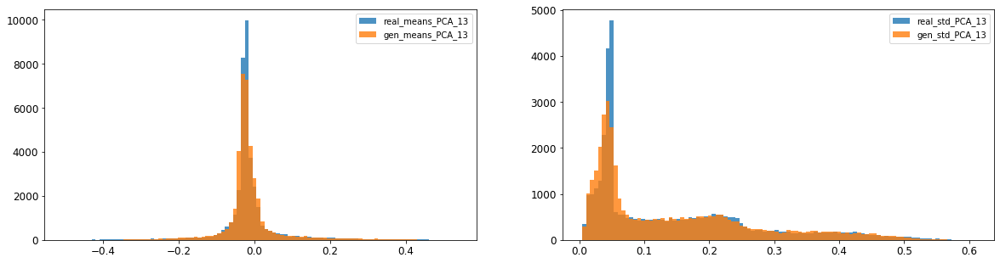

14: mean KL divergence (r,g) = 0.05296008189476222
14: mean JS divergence = 0.013314431771315145
14: mean 1-BC divergence = 0.009330418887766867

14: std KL divergence (r,g) = 0.02739714631419667
14: std JS divergence = 0.006579649223339702
14: std 1-BC divergence = 0.004584127523989512


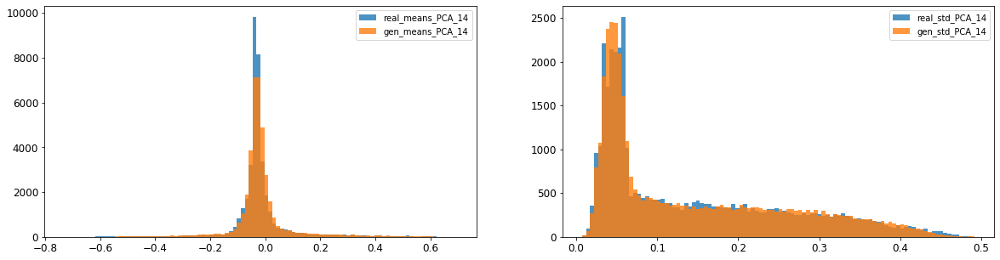

15: mean KL divergence (r,g) = 1.7139203160509078
15: mean JS divergence = 0.4710524008113244
15: mean 1-BC divergence = 0.43077543674988483

15: std KL divergence (r,g) = 5.546819555547604
15: std JS divergence = 0.9250780735488311
15: std 1-BC divergence = 0.8537417183784562


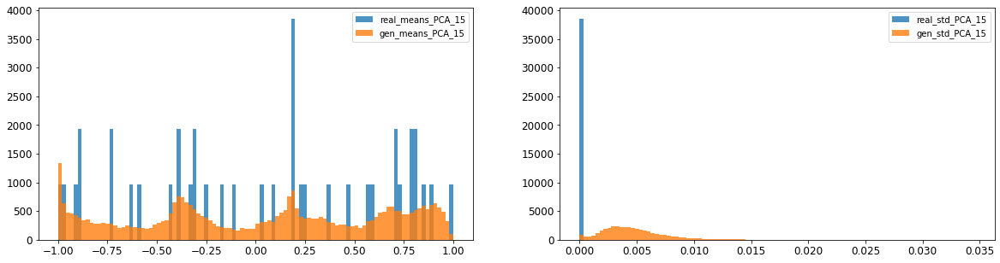

16: mean KL divergence (r,g) = 1.4932081191709559
16: mean JS divergence = 0.4165944615751845
16: mean 1-BC divergence = 0.3824064380134179

16: std KL divergence (r,g) = 5.678731231053185
16: std JS divergence = 0.930350022601316
16: std 1-BC divergence = 0.8602776822966991


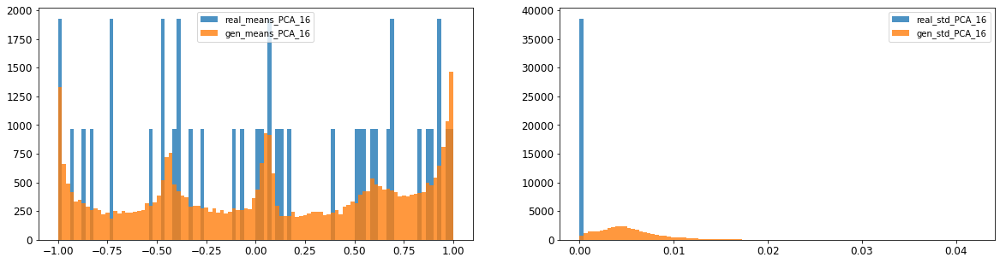



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01584280438729472
Compose 1-BC divergence = 0.011745820032373233

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.017088399682259982
Compose weighted 1-BC divergence = 0.013940134528731551

Multivariate KL divergence = 51.06540961349585


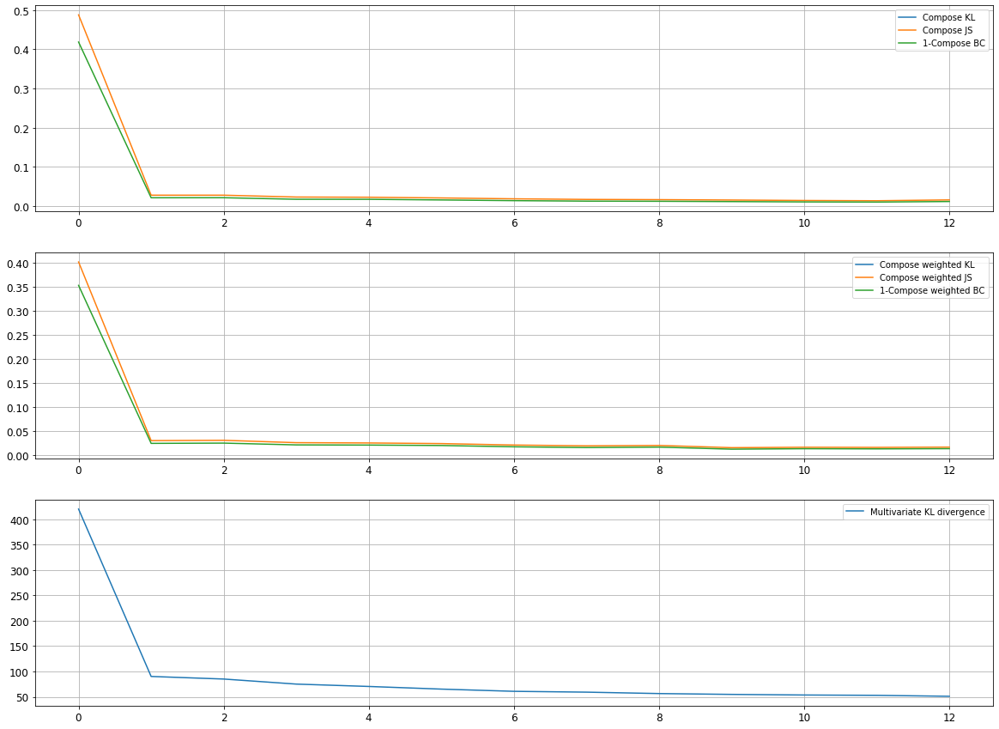

Epoch 2402/10000
discriminator loss: 0.057490 - generator loss: 6.905161 - 29s
Epoch 2403/10000
discriminator loss: 0.058137 - generator loss: 7.034257 - 29s
Epoch 2404/10000
discriminator loss: 0.340064 - generator loss: 6.756599 - 29s
Epoch 2405/10000
discriminator loss: 0.078509 - generator loss: 6.511195 - 29s
Epoch 2406/10000
discriminator loss: 0.066126 - generator loss: 6.875717 - 29s
Epoch 2407/10000
discriminator loss: 0.242914 - generator loss: 6.552331 - 29s
Epoch 2408/10000
discriminator loss: 0.071004 - generator loss: 6.796812 - 29s
Epoch 2409/10000
discriminator loss: 0.271851 - generator loss: 6.378308 - 29s
Epoch 2410/10000
discriminator loss: 0.060330 - generator loss: 6.897793 - 29s
Epoch 2411/10000
discriminator loss: 0.060597 - generator loss: 6.991071 - 29s
Epoch 2412/10000
discriminator loss: 0.341690 - generator loss: 6.296752 - 29s
Epoch 2413/10000
discriminator loss: 0.064092 - generator loss: 6.954332 - 29s
Epoch 2414/10000
discriminator loss: 0.165274 - gene

discriminator loss: 0.057533 - generator loss: 7.036124 - 29s
Epoch 2507/10000
discriminator loss: 0.279072 - generator loss: 6.751319 - 29s
Epoch 2508/10000
discriminator loss: 0.063726 - generator loss: 6.803699 - 29s
Epoch 2509/10000
discriminator loss: 0.063573 - generator loss: 6.917930 - 29s
Epoch 2510/10000
discriminator loss: 0.345363 - generator loss: 6.423655 - 28s
Epoch 2511/10000
discriminator loss: 0.056432 - generator loss: 7.013687 - 29s
Epoch 2512/10000
discriminator loss: 0.286330 - generator loss: 6.507655 - 29s
Epoch 2513/10000
discriminator loss: 0.052125 - generator loss: 7.030164 - 29s
Epoch 2514/10000
discriminator loss: 0.218364 - generator loss: 6.850205 - 28s
Epoch 2515/10000
discriminator loss: 0.097394 - generator loss: 6.647490 - 28s
Epoch 2516/10000
discriminator loss: 0.058796 - generator loss: 6.964161 - 29s
Epoch 2517/10000
discriminator loss: 0.067414 - generator loss: 6.950803 - 28s
Epoch 2518/10000
discriminator loss: 0.335866 - generator loss: 6.417

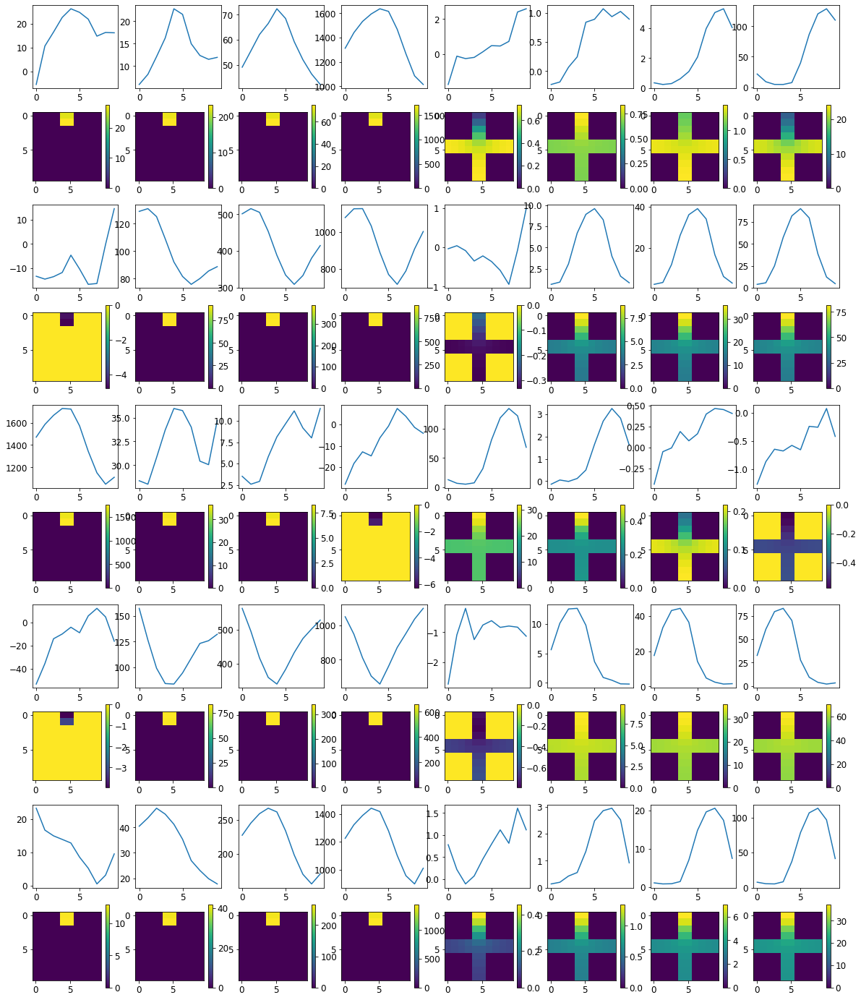


R0 generated:
[[19.67508    18.46437   ]
 [19.629      18.479988  ]
 [19.631115   18.419912  ]
 [19.628506   18.44985   ]
 [19.631475   18.497158  ]
 [19.632174   18.491045  ]
 [19.64072    18.539406  ]
 [19.636225   18.52835   ]
 [19.631      18.512209  ]
 [19.634092   18.585365  ]
 [17.46448     0.82836056]
 [17.352203    0.8643899 ]
 [17.380121    0.84041274]
 [17.39044     0.7970754 ]
 [17.406427    0.8180916 ]
 [17.414635    0.8015315 ]
 [17.44867     0.77801377]
 [17.446821    0.7694247 ]
 [17.454355    0.80801326]
 [17.401716    0.8183015 ]
 [17.990267    1.9623009 ]
 [17.862022    2.0316813 ]
 [17.906298    2.0549762 ]
 [17.918036    1.9341283 ]
 [17.88116     1.8852689 ]
 [17.870878    1.9900168 ]
 [17.820107    1.9932805 ]
 [17.876322    2.0769458 ]
 [17.936237    2.1159115 ]
 [17.893023    1.8067816 ]
 [19.793562   17.75167   ]
 [19.775064   17.676819  ]
 [19.759457   17.667128  ]
 [19.757286   17.623537  ]
 [19.76286    17.644342  ]
 [19.761992   17.592009  ]
 [19.770544  

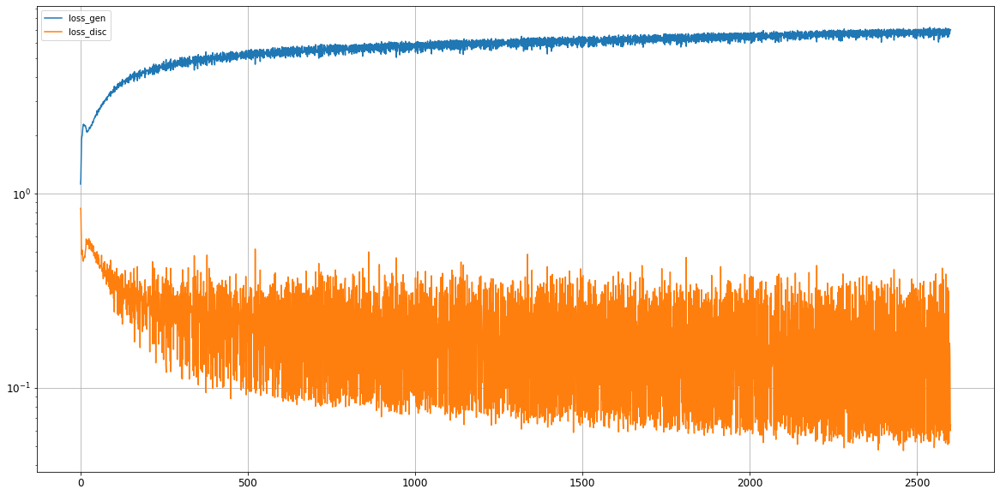

0: mean KL divergence (r,g) = 0.040040431544897725
0: mean JS divergence = 0.011822298297674276
0: mean 1-BC divergence = 0.01027318079600903

0: std KL divergence (r,g) = 0.09761752816154509
0: std JS divergence = 0.0278886324541947
0: std 1-BC divergence = 0.024411532272070158


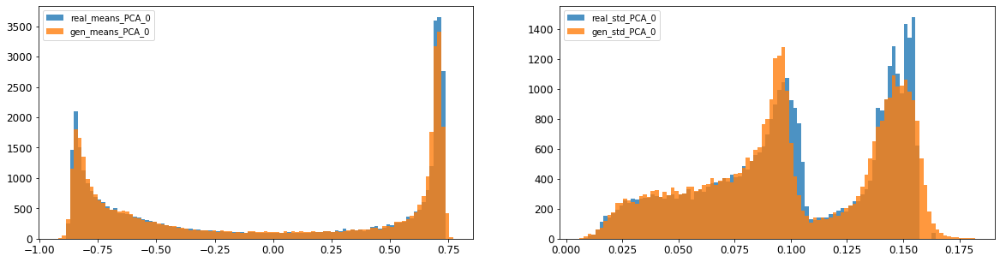

1: mean KL divergence (r,g) = 0.024416896294906097
1: mean JS divergence = 0.006190071613816499
1: mean 1-BC divergence = 0.0044735168700391625

1: std KL divergence (r,g) = 0.04001415430767045
1: std JS divergence = 0.009119975514876562
1: std 1-BC divergence = 0.006398232192129649


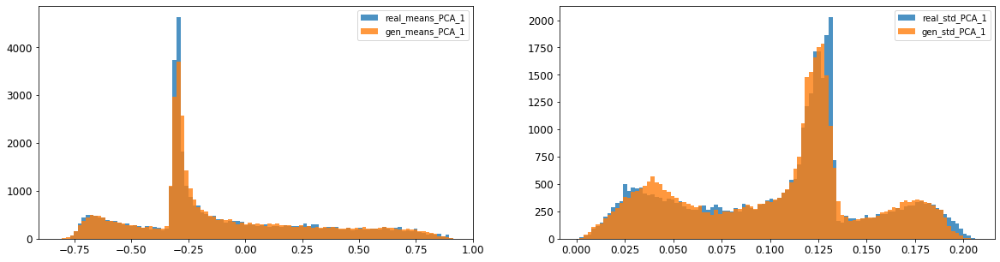

2: mean KL divergence (r,g) = 0.02195056606207037
2: mean JS divergence = 0.005278179564199443
2: mean 1-BC divergence = 0.0037808836163151227

2: std KL divergence (r,g) = 0.034561077700286706
2: std JS divergence = 0.010174615041054606
2: std 1-BC divergence = 0.009220830870508179


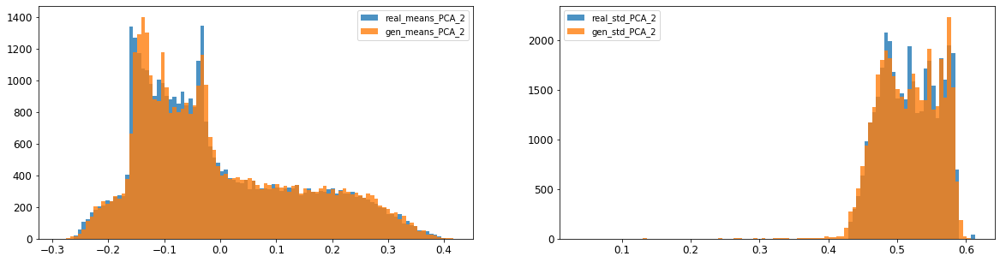

3: mean KL divergence (r,g) = 0.035441108461004546
3: mean JS divergence = 0.008369753756309602
3: mean 1-BC divergence = 0.005860957385761534

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.09947716303442578
3: std 1-BC divergence = 0.07498139703853435


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


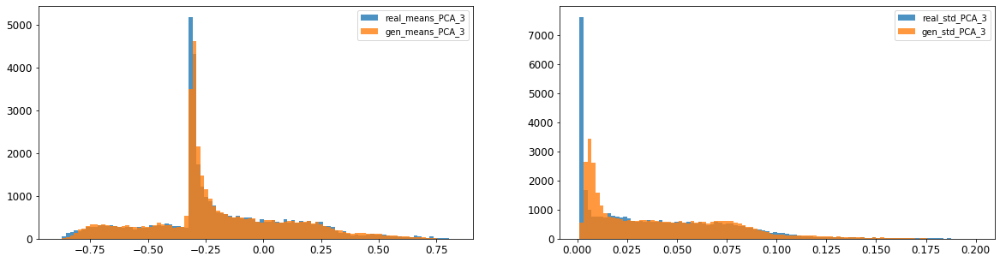

4: mean KL divergence (r,g) = 0.03618183734552701
4: mean JS divergence = 0.00937383405602513
4: mean 1-BC divergence = 0.007185055407474938

4: std KL divergence (r,g) = 0.033535559462449724
4: std JS divergence = 0.007875374118401134
4: std 1-BC divergence = 0.005580799645223844


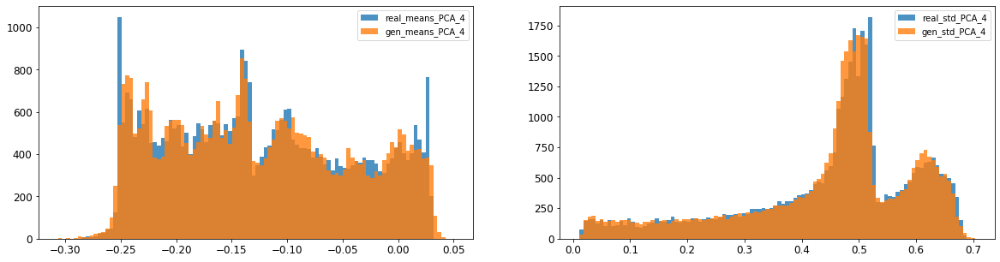

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.014083371052446524
5: mean 1-BC divergence = 0.010182763258153482

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.012063994611617062
5: std 1-BC divergence = 0.010470775658125486


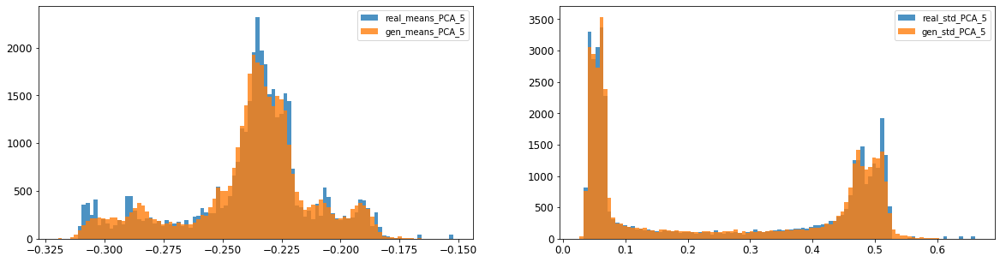

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004687446032283655
6: mean 1-BC divergence = 0.0033267542803944172

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.012699025408720054
6: std 1-BC divergence = 0.009157900251199447


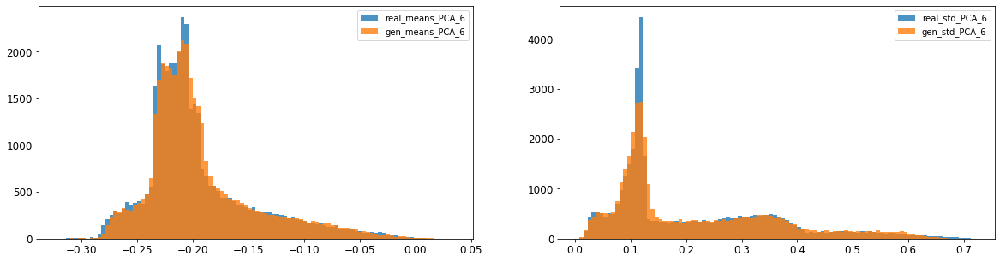

7: mean KL divergence (r,g) = 0.06073120157805328
7: mean JS divergence = 0.016274411948796884
7: mean 1-BC divergence = 0.012370454567882216

7: std KL divergence (r,g) = 0.036978734181653546
7: std JS divergence = 0.008926736840706185
7: std 1-BC divergence = 0.006246142174915148


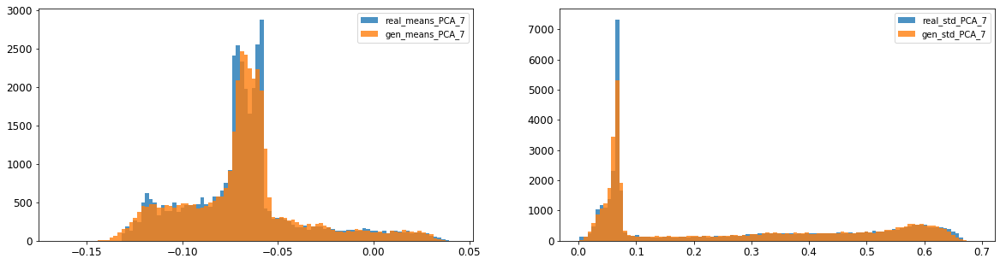

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.003918582861639975
8: mean 1-BC divergence = 0.0027684633963867

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.0103864966559492
8: std 1-BC divergence = 0.007467821027581922


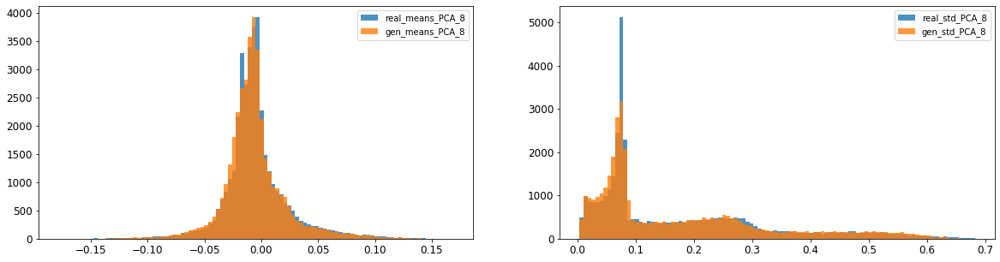

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.002398887673589073
9: mean 1-BC divergence = 0.0016872555609045436

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.013844212752610267
9: std 1-BC divergence = 0.009840276899330314


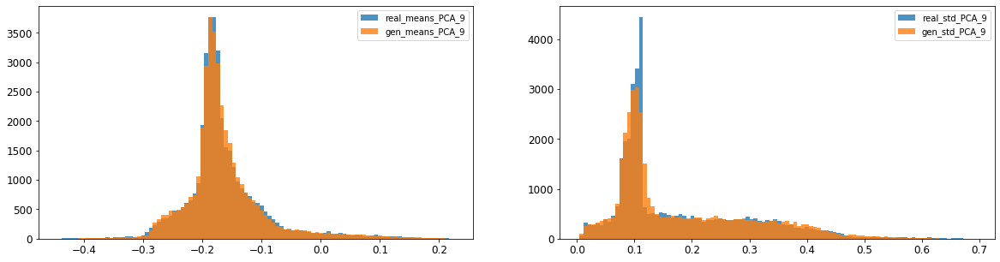

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.004636685294369495
10: mean 1-BC divergence = 0.0033192341706684836

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.00783250751311311
10: std 1-BC divergence = 0.006936641534635912


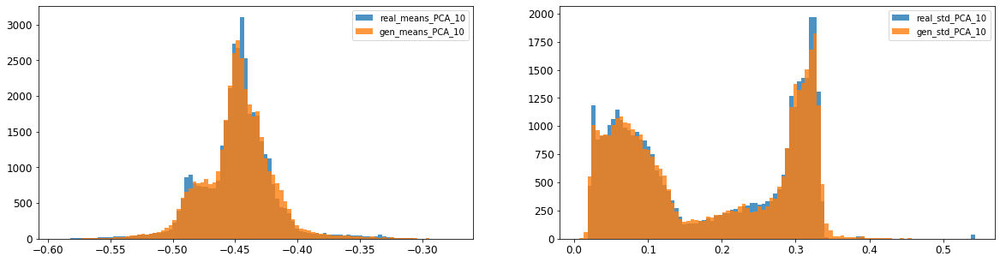

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.012913421873650357
11: mean 1-BC divergence = 0.00912380025778936

11: std KL divergence (r,g) = 0.050412504718163054
11: std JS divergence = 0.012490564381064915
11: std 1-BC divergence = 0.008833541869849859


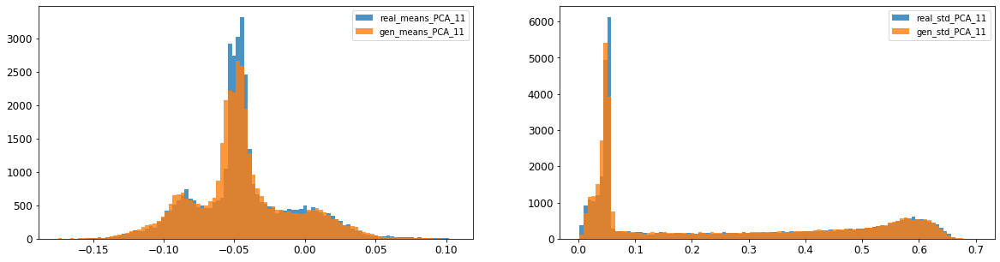

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.005967692110193746
12: mean 1-BC divergence = 0.004199824223744653

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01899227567036111
12: std 1-BC divergence = 0.013536216143095858


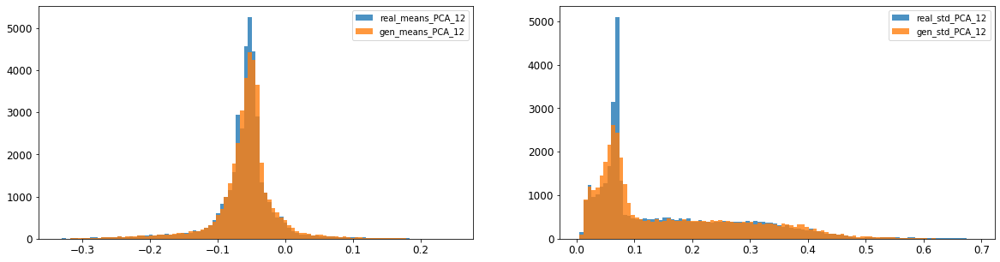

13: mean KL divergence (r,g) = 0.038293476840859084
13: mean JS divergence = 0.00937345447091147
13: mean 1-BC divergence = 0.006549744959561066

13: std KL divergence (r,g) = 0.0811451357874083
13: std JS divergence = 0.019778884021493755
13: std 1-BC divergence = 0.013870086569402473


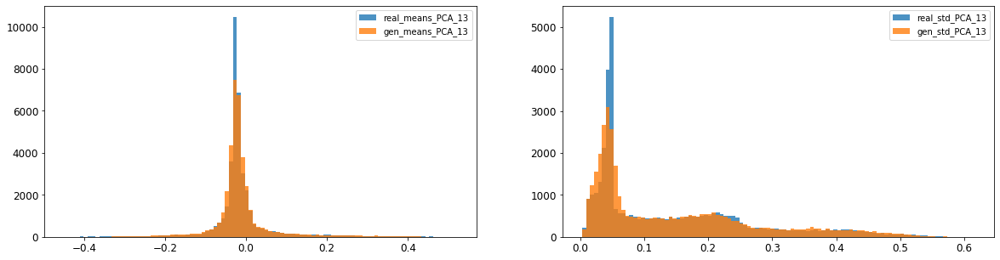

14: mean KL divergence (r,g) = 0.05714037681250497
14: mean JS divergence = 0.014195486765402717
14: mean 1-BC divergence = 0.009908684681619317

14: std KL divergence (r,g) = 0.03199286962581756
14: std JS divergence = 0.007880102902975313
14: std 1-BC divergence = 0.005501916740516477


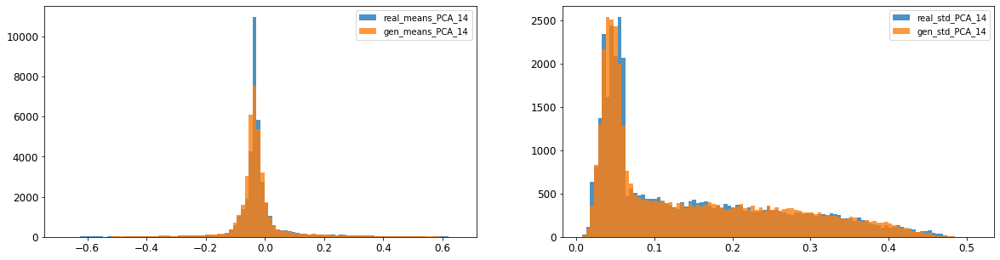

15: mean KL divergence (r,g) = 1.7069596038654948
15: mean JS divergence = 0.46927859513390396
15: mean 1-BC divergence = 0.429522838808683

15: std KL divergence (r,g) = 5.777992862426261
15: std JS divergence = 0.9340849444255788
15: std 1-BC divergence = 0.8650025960789595


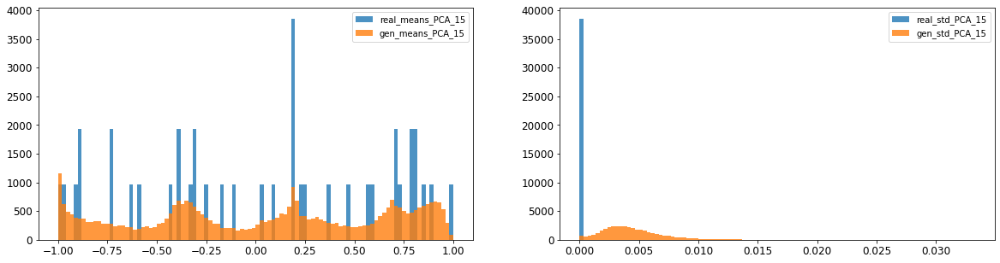

16: mean KL divergence (r,g) = 1.438196409927262
16: mean JS divergence = 0.4034819778356994
16: mean 1-BC divergence = 0.3708878694343497

16: std KL divergence (r,g) = 5.709758126673809
16: std JS divergence = 0.9315383483571507
16: std 1-BC divergence = 0.8617720816017458


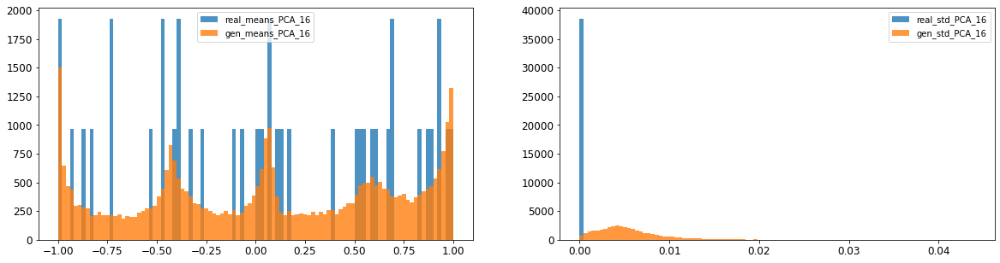



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01363047127642909
Compose 1-BC divergence = 0.010248822810660752

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.016981645548444436
Compose weighted 1-BC divergence = 0.014094424885205736

Multivariate KL divergence = 48.98779068568402


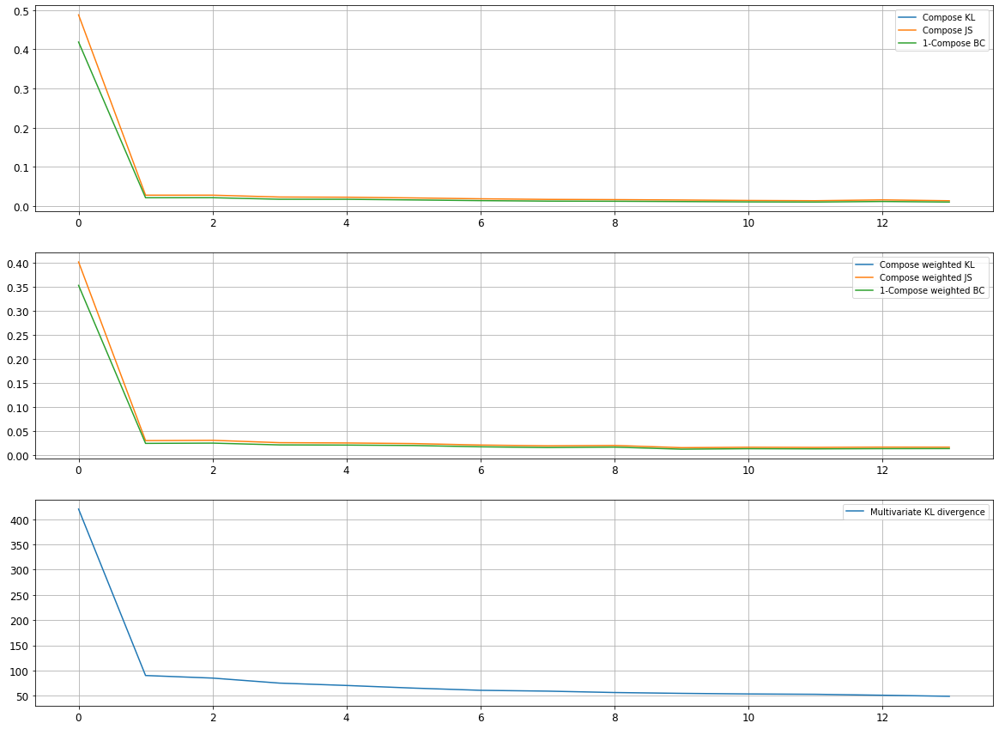

Epoch 2602/10000
discriminator loss: 0.326340 - generator loss: 6.401789 - 28s
Epoch 2603/10000
discriminator loss: 0.060553 - generator loss: 7.042091 - 28s
Epoch 2604/10000
discriminator loss: 0.321753 - generator loss: 6.400920 - 29s
Epoch 2605/10000
discriminator loss: 0.056552 - generator loss: 6.935330 - 28s
Epoch 2606/10000
discriminator loss: 0.064924 - generator loss: 6.978212 - 28s
Epoch 2607/10000
discriminator loss: 0.053307 - generator loss: 7.082640 - 29s
Epoch 2608/10000
discriminator loss: 0.313607 - generator loss: 6.492538 - 29s
Epoch 2609/10000
discriminator loss: 0.058336 - generator loss: 7.050507 - 28s
Epoch 2610/10000
discriminator loss: 0.284022 - generator loss: 6.458525 - 28s
Epoch 2611/10000
discriminator loss: 0.065473 - generator loss: 6.938394 - 28s
Epoch 2612/10000
discriminator loss: 0.282866 - generator loss: 6.644463 - 28s
Epoch 2613/10000
discriminator loss: 0.069292 - generator loss: 6.782902 - 29s
Epoch 2614/10000
discriminator loss: 0.057096 - gene

discriminator loss: 0.118229 - generator loss: 6.800741 - 28s
Epoch 2707/10000
discriminator loss: 0.054827 - generator loss: 7.136024 - 28s
Epoch 2708/10000
discriminator loss: 0.332279 - generator loss: 6.717980 - 28s
Epoch 2709/10000
discriminator loss: 0.060960 - generator loss: 6.977885 - 28s
Epoch 2710/10000
discriminator loss: 0.056849 - generator loss: 7.142319 - 29s
Epoch 2711/10000
discriminator loss: 0.296721 - generator loss: 6.688815 - 29s
Epoch 2712/10000
discriminator loss: 0.055909 - generator loss: 7.072989 - 29s
Epoch 2713/10000
discriminator loss: 0.135807 - generator loss: 6.881958 - 29s
Epoch 2714/10000
discriminator loss: 0.077357 - generator loss: 6.920929 - 29s
Epoch 2715/10000
discriminator loss: 0.333961 - generator loss: 6.539956 - 29s
Epoch 2716/10000
discriminator loss: 0.056726 - generator loss: 7.096935 - 29s
Epoch 2717/10000
discriminator loss: 0.245655 - generator loss: 6.596652 - 28s
Epoch 2718/10000
discriminator loss: 0.058497 - generator loss: 7.130

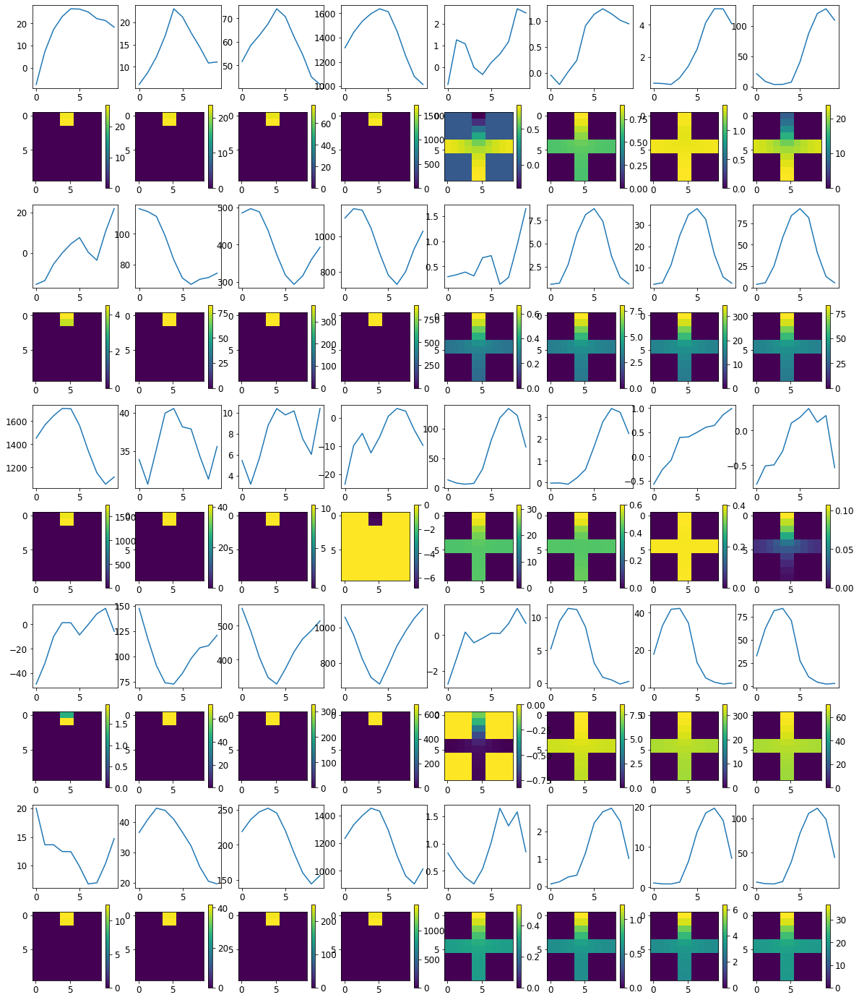


R0 generated:
[[19.63657    17.98784   ]
 [19.59265    17.968311  ]
 [19.600613   17.895206  ]
 [19.593666   17.934452  ]
 [19.604994   17.933218  ]
 [19.60354    17.905594  ]
 [19.619051   17.929995  ]
 [19.605402   17.946182  ]
 [19.601501   17.894457  ]
 [19.59547    17.968588  ]
 [17.190619    0.8607799 ]
 [17.12561     0.9003609 ]
 [17.230333    0.8716087 ]
 [17.214783    0.83563656]
 [17.251398    0.84295624]
 [17.220825    0.85409814]
 [17.24184     0.83886343]
 [17.238228    0.83960456]
 [17.247587    0.8810777 ]
 [17.13103     0.8728962 ]
 [17.807419    1.7311463 ]
 [17.712725    1.7407033 ]
 [17.75658     1.7928333 ]
 [17.757368    1.7299329 ]
 [17.761377    1.6955502 ]
 [17.752783    1.7325976 ]
 [17.711882    1.6469405 ]
 [17.749395    1.7220056 ]
 [17.801657    1.7136818 ]
 [17.736452    1.4235494 ]
 [19.771753   17.445734  ]
 [19.755968   17.402765  ]
 [19.741306   17.346033  ]
 [19.735306   17.305521  ]
 [19.745281   17.283802  ]
 [19.736223   17.193068  ]
 [19.748177  

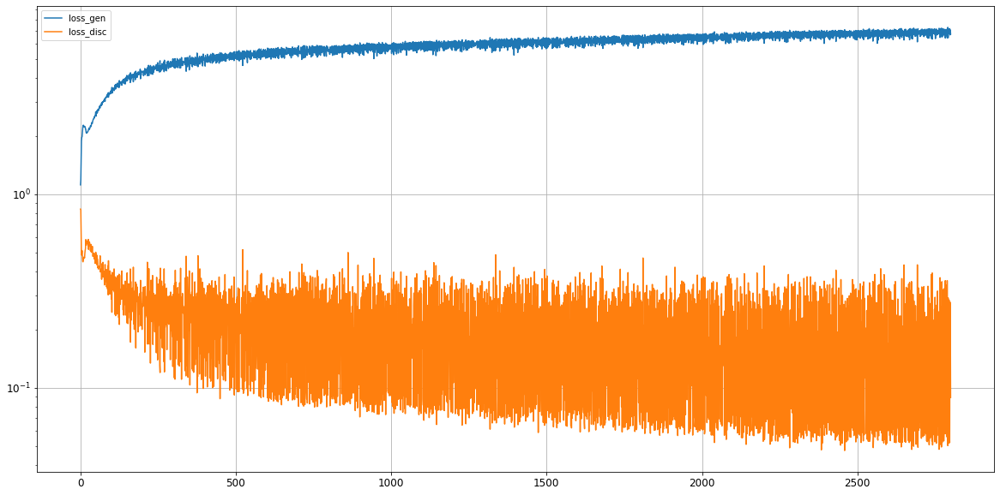

0: mean KL divergence (r,g) = 0.0416915129661425
0: mean JS divergence = 0.011480216878686045
0: mean 1-BC divergence = 0.008687328180031595

0: std KL divergence (r,g) = 0.07271805686592504
0: std JS divergence = 0.0208049669280716
0: std 1-BC divergence = 0.018071439075980522


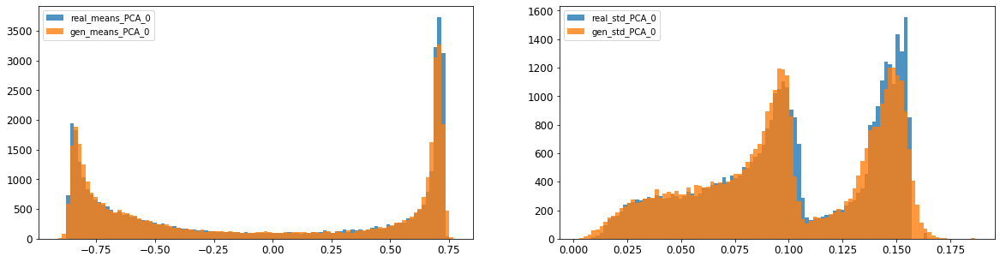

1: mean KL divergence (r,g) = 0.024442160174417416
1: mean JS divergence = 0.006056836017576865
1: mean 1-BC divergence = 0.004285777472751828

1: std KL divergence (r,g) = 0.048745250137056925
1: std JS divergence = 0.01084178510907027
1: std 1-BC divergence = 0.007630197889356705


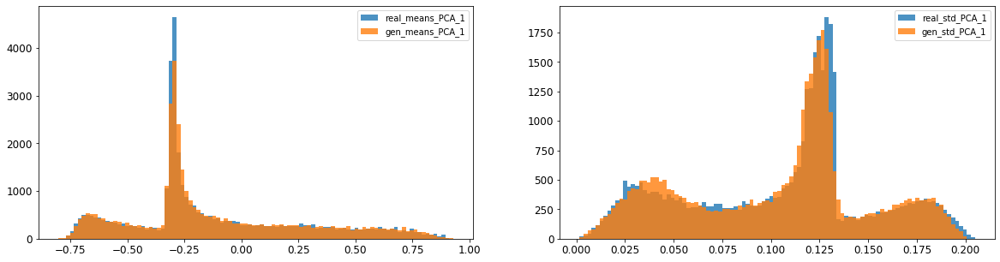

2: mean KL divergence (r,g) = 0.013372285719610534
2: mean JS divergence = 0.0032781306945223023
2: mean 1-BC divergence = 0.0023202405472206866

2: std KL divergence (r,g) = 0.03854330675578581
2: std JS divergence = 0.010593733006323727
2: std 1-BC divergence = 0.008773435371048577


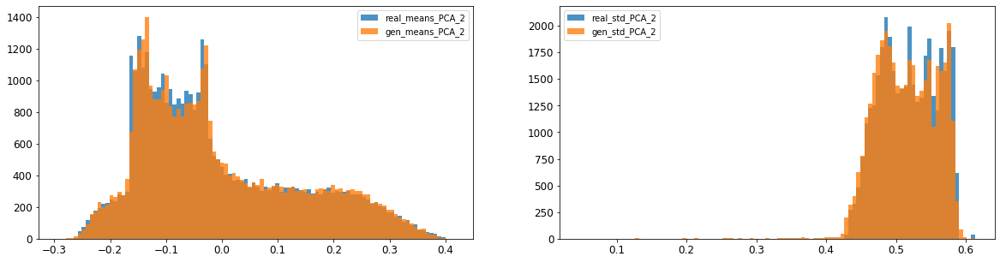

3: mean KL divergence (r,g) = 0.047966212279116904
3: mean JS divergence = 0.01145315669749352
3: mean 1-BC divergence = 0.008035042482706034

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0733417882967926
3: std 1-BC divergence = 0.05399577763051


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


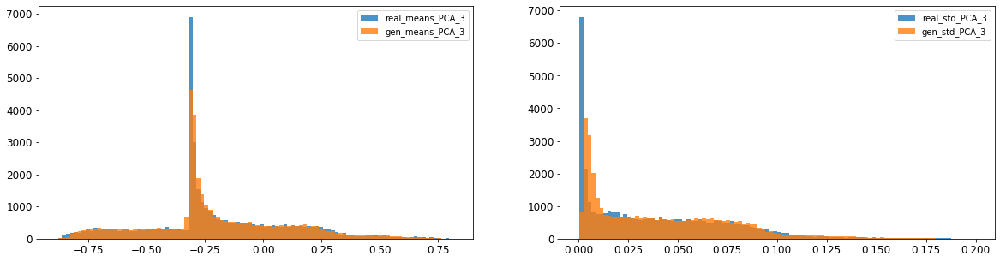

4: mean KL divergence (r,g) = 0.03592482456298103
4: mean JS divergence = 0.009194107337697294
4: mean 1-BC divergence = 0.006803981538814008

4: std KL divergence (r,g) = 0.033284956977562064
4: std JS divergence = 0.007809083795302879
4: std 1-BC divergence = 0.005476113691396778


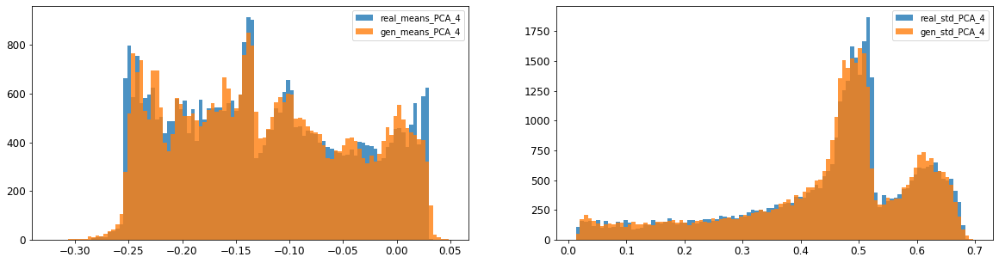

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.019222728159700962
5: mean 1-BC divergence = 0.013816017640977396

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.014119992874751047
5: std 1-BC divergence = 0.011616092306361292


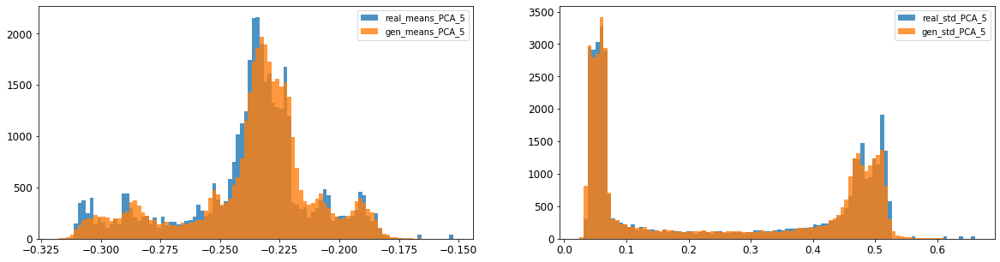

6: mean KL divergence (r,g) = 0.018309190208926296
6: mean JS divergence = 0.004509480042498614
6: mean 1-BC divergence = 0.0031819084369308914

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.011591833555921662
6: std 1-BC divergence = 0.008297704593547839


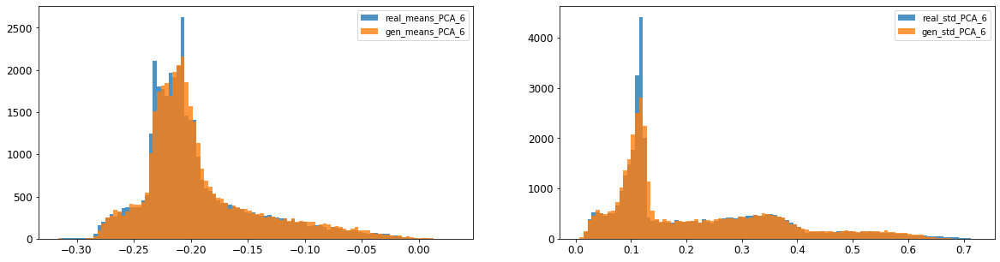

7: mean KL divergence (r,g) = 0.1013744100324147
7: mean JS divergence = 0.023402705924452927
7: mean 1-BC divergence = 0.017381624089246706

7: std KL divergence (r,g) = 0.03911020621762492
7: std JS divergence = 0.00934955154385813
7: std 1-BC divergence = 0.006564001633880934


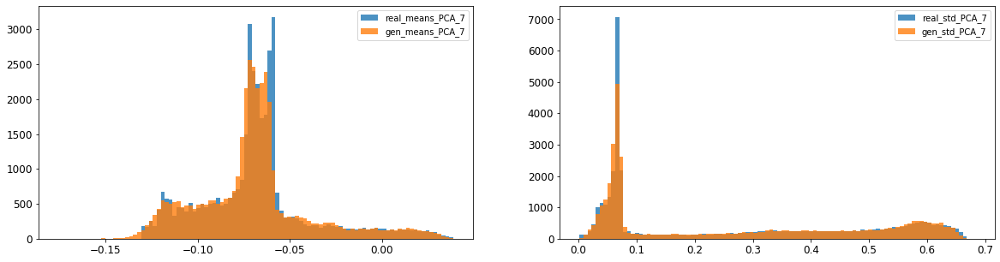

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.005036713252386568
8: mean 1-BC divergence = 0.003546236395644331

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.011739450161487202
8: std 1-BC divergence = 0.008440258724881966


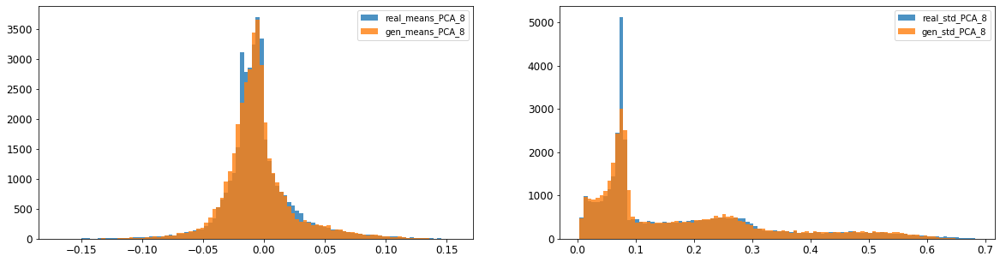

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0029309004792863564
9: mean 1-BC divergence = 0.0020942042561277185

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.015082552982821353
9: std 1-BC divergence = 0.010690147619121237


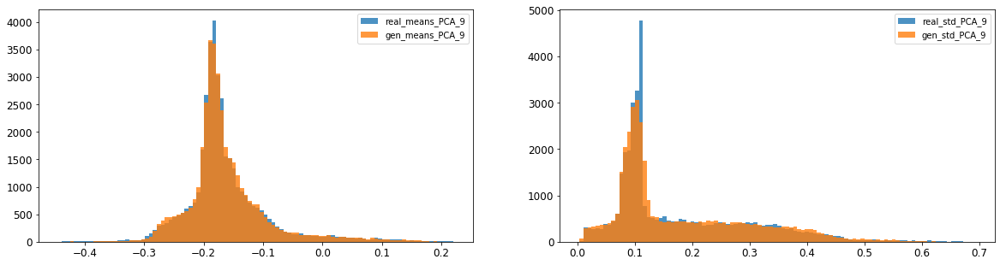

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.007115342159534115
10: mean 1-BC divergence = 0.0050103361998597995

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007435886912810569
10: std 1-BC divergence = 0.0063308154543787465


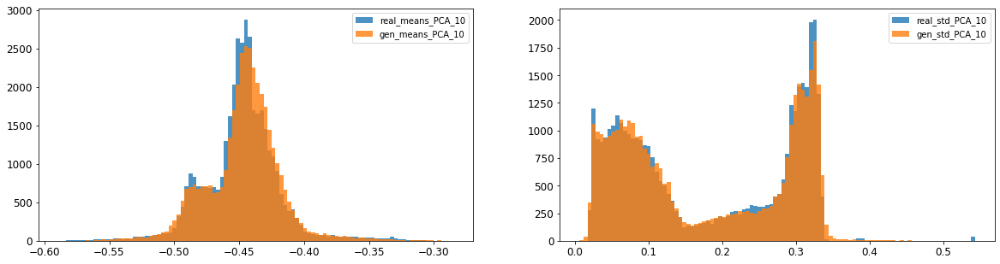

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.013209905094569105
11: mean 1-BC divergence = 0.00937550154150113

11: std KL divergence (r,g) = 0.060838585408201896
11: std JS divergence = 0.016330490263348967
11: std 1-BC divergence = 0.01174263147569754


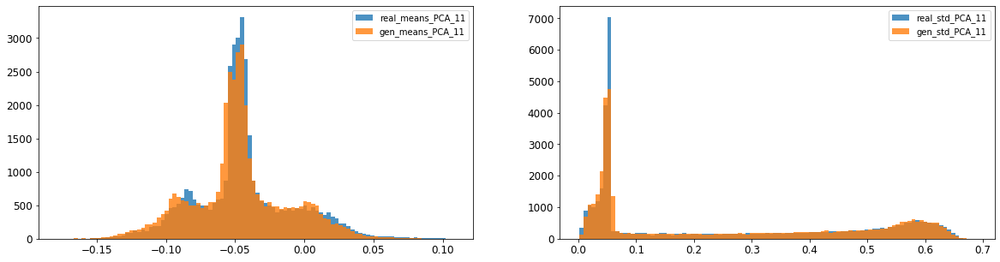

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.005468939171205847
12: mean 1-BC divergence = 0.0038176518797863324

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.020058045308287874
12: std 1-BC divergence = 0.014260185931672553


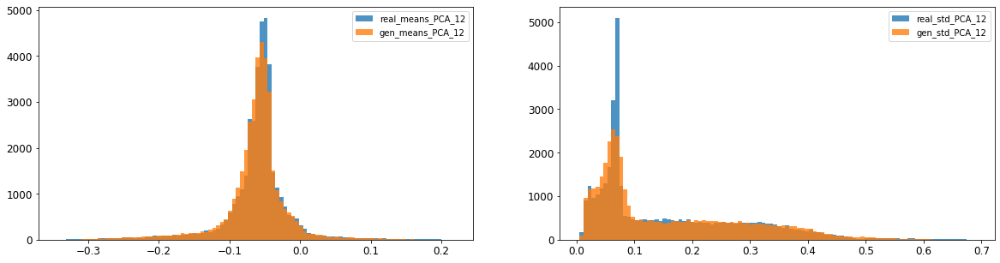

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.012104610107686726
13: mean 1-BC divergence = 0.008491513598862022

13: std KL divergence (r,g) = 0.07281192106444231
13: std JS divergence = 0.018288683548065718
13: std 1-BC divergence = 0.012839058600492392


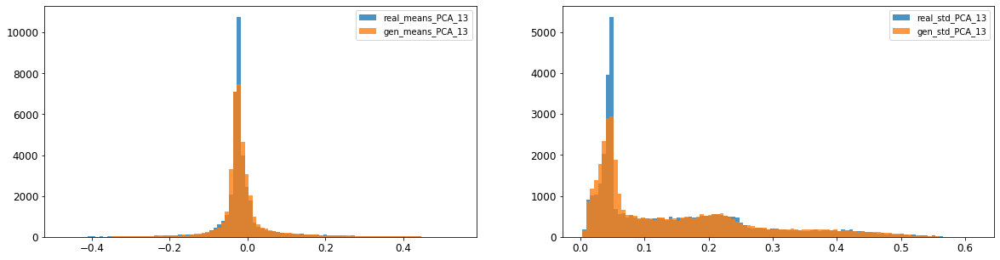

14: mean KL divergence (r,g) = 0.05254527088200339
14: mean JS divergence = 0.013002713681492008
14: mean 1-BC divergence = 0.009122267887284763

14: std KL divergence (r,g) = 0.03470292039205167
14: std JS divergence = 0.008300768473679613
14: std 1-BC divergence = 0.005801487109514225


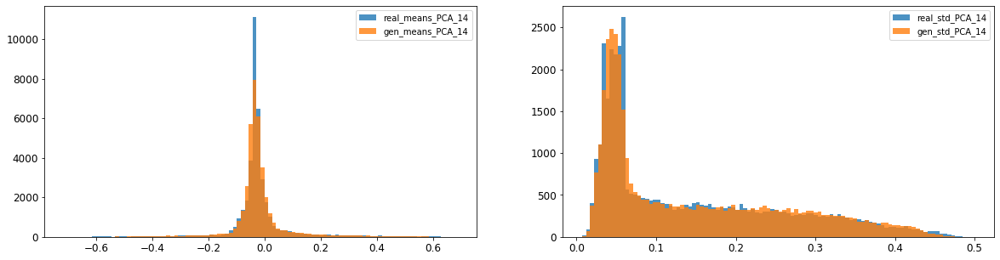

15: mean KL divergence (r,g) = 1.7368106480017298
15: mean JS divergence = 0.4741348021605288
15: mean 1-BC divergence = 0.43395184456323965

15: std KL divergence (r,g) = 5.686425622843185
15: std JS divergence = 0.9306465124715866
15: std 1-BC divergence = 0.8606497796755771


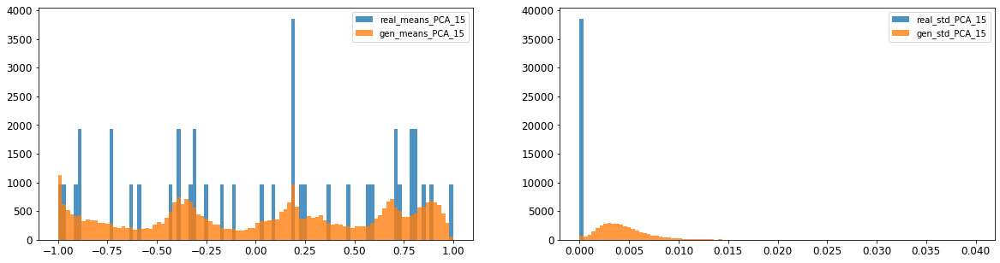

16: mean KL divergence (r,g) = 1.4277172117302885
16: mean JS divergence = 0.40105241104108225
16: mean 1-BC divergence = 0.3688530906444628

16: std KL divergence (r,g) = 5.524236270180478
16: std JS divergence = 0.9241388011546434
16: std 1-BC divergence = 0.8525924969256421


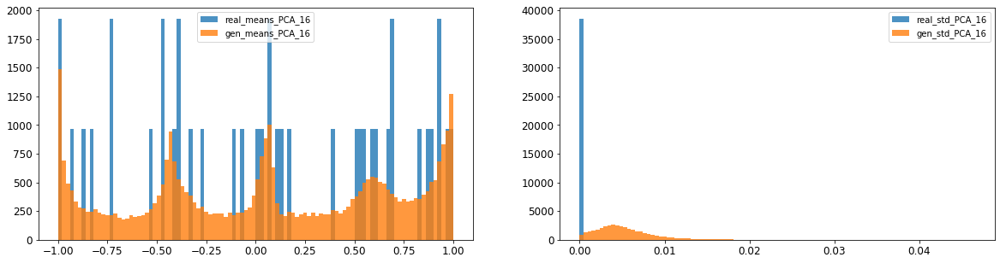



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.013438503281979415
Compose 1-BC divergence = 0.009883299308519389

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.014556334836735447
Compose weighted 1-BC divergence = 0.011520307586568301

Multivariate KL divergence = 48.330728226984135


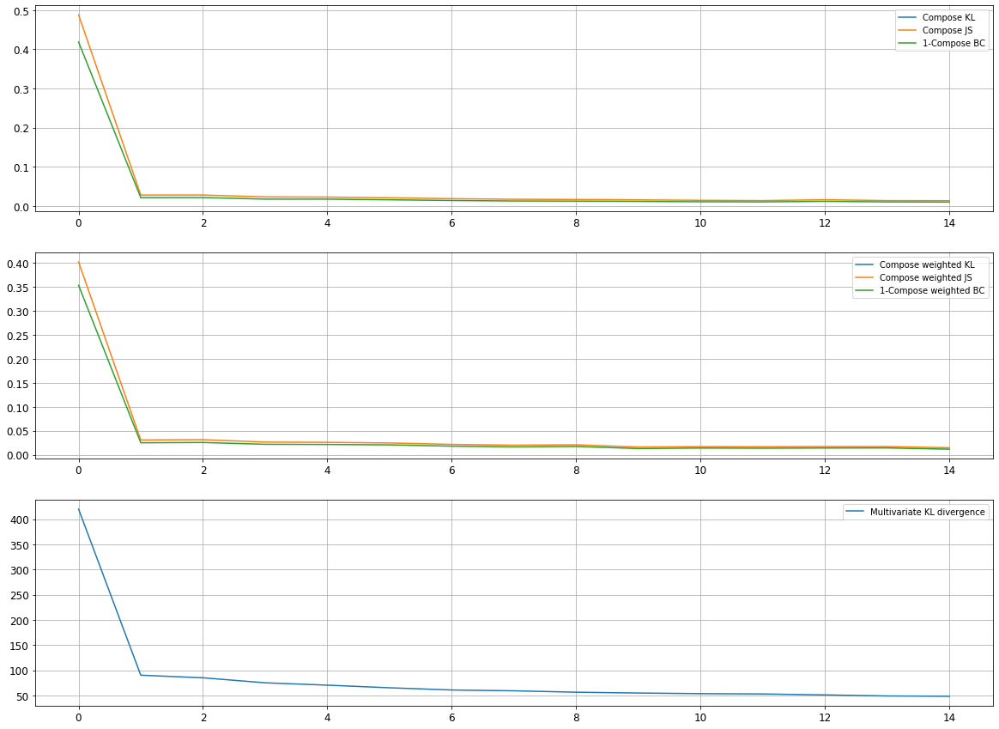

Epoch 2802/10000
discriminator loss: 0.053363 - generator loss: 7.256178 - 28s
Epoch 2803/10000
discriminator loss: 0.090354 - generator loss: 6.972302 - 29s
Epoch 2804/10000
discriminator loss: 0.305875 - generator loss: 7.036504 - 29s
Epoch 2805/10000
discriminator loss: 0.121499 - generator loss: 6.607113 - 29s
Epoch 2806/10000
discriminator loss: 0.050567 - generator loss: 7.205687 - 29s
Epoch 2807/10000
discriminator loss: 0.149797 - generator loss: 6.750481 - 29s
Epoch 2808/10000
discriminator loss: 0.158075 - generator loss: 7.052598 - 28s
Epoch 2809/10000
discriminator loss: 0.072678 - generator loss: 6.921817 - 29s
Epoch 2810/10000
discriminator loss: 0.257440 - generator loss: 6.908093 - 29s
Epoch 2811/10000
discriminator loss: 0.060152 - generator loss: 7.040881 - 29s
Epoch 2812/10000
discriminator loss: 0.061540 - generator loss: 7.130240 - 28s
Epoch 2813/10000
discriminator loss: 0.292968 - generator loss: 6.529497 - 28s
Epoch 2814/10000
discriminator loss: 0.053952 - gene

discriminator loss: 0.063464 - generator loss: 6.999221 - 29s
Epoch 2907/10000
discriminator loss: 0.263473 - generator loss: 6.881314 - 28s
Epoch 2908/10000
discriminator loss: 0.076702 - generator loss: 6.771518 - 28s
Epoch 2909/10000
discriminator loss: 0.147106 - generator loss: 7.022383 - 28s
Epoch 2910/10000
discriminator loss: 0.064347 - generator loss: 7.127500 - 29s
Epoch 2911/10000
discriminator loss: 0.055446 - generator loss: 7.283352 - 29s
Epoch 2912/10000
discriminator loss: 0.376775 - generator loss: 6.573693 - 29s
Epoch 2913/10000
discriminator loss: 0.052159 - generator loss: 7.173674 - 29s
Epoch 2914/10000
discriminator loss: 0.110431 - generator loss: 7.155111 - 28s
Epoch 2915/10000
discriminator loss: 0.293323 - generator loss: 6.633383 - 28s
Epoch 2916/10000
discriminator loss: 0.062758 - generator loss: 6.984913 - 29s
Epoch 2917/10000
discriminator loss: 0.047360 - generator loss: 7.297635 - 28s
Epoch 2918/10000
discriminator loss: 0.325475 - generator loss: 6.686

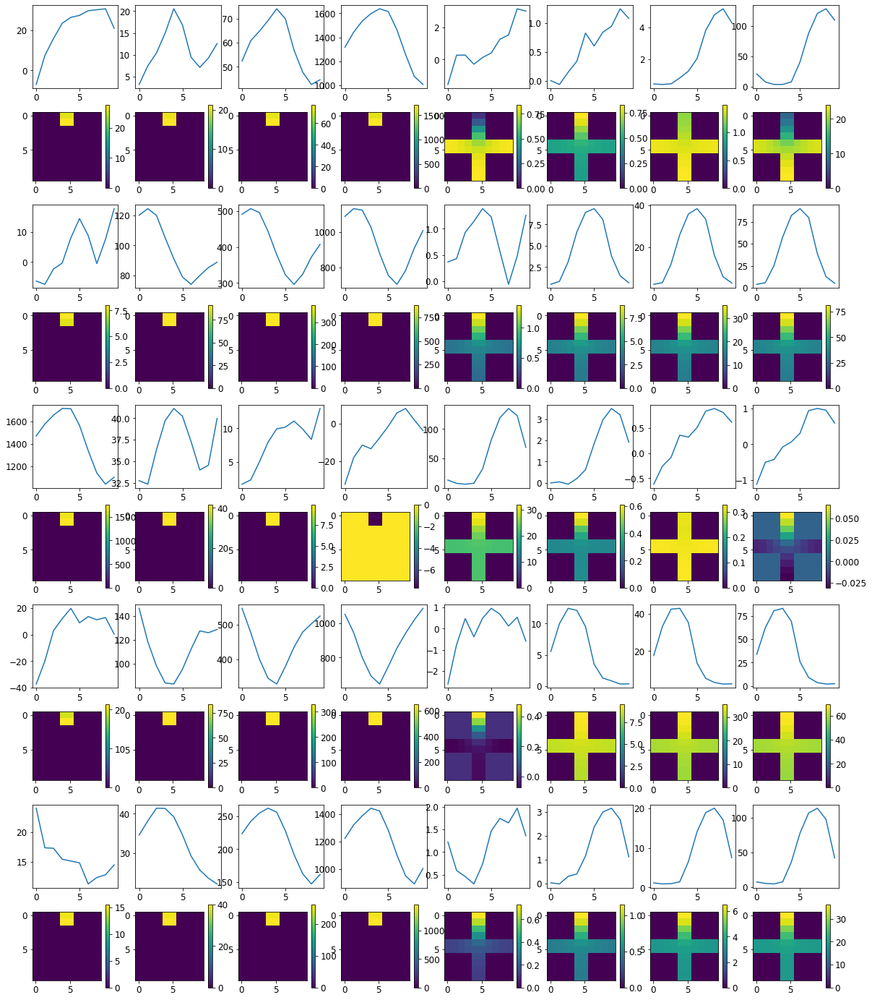


R0 generated:
[[19.645056   18.525352  ]
 [19.621521   18.50888   ]
 [19.632677   18.424253  ]
 [19.627922   18.469883  ]
 [19.639763   18.51537   ]
 [19.640347   18.506529  ]
 [19.652325   18.536522  ]
 [19.643991   18.524837  ]
 [19.635881   18.45166   ]
 [19.633099   18.571833  ]
 [17.394812    0.5835294 ]
 [17.369059    0.586077  ]
 [17.461906    0.569504  ]
 [17.473063    0.5361564 ]
 [17.482958    0.53114873]
 [17.503897    0.5310368 ]
 [17.504278    0.49817082]
 [17.500174    0.5061121 ]
 [17.538559    0.53331673]
 [17.431395    0.5444878 ]
 [17.711658    1.6239337 ]
 [17.688868    1.577872  ]
 [17.782816    1.6648831 ]
 [17.778059    1.6317664 ]
 [17.754276    1.5967902 ]
 [17.763103    1.6442851 ]
 [17.750072    1.5855795 ]
 [17.779978    1.666341  ]
 [17.811045    1.6547639 ]
 [17.759195    1.3588897 ]
 [19.784086   17.504444  ]
 [19.776651   17.450035  ]
 [19.766932   17.452374  ]
 [19.762249   17.468529  ]
 [19.765354   17.420568  ]
 [19.759768   17.335758  ]
 [19.769716  

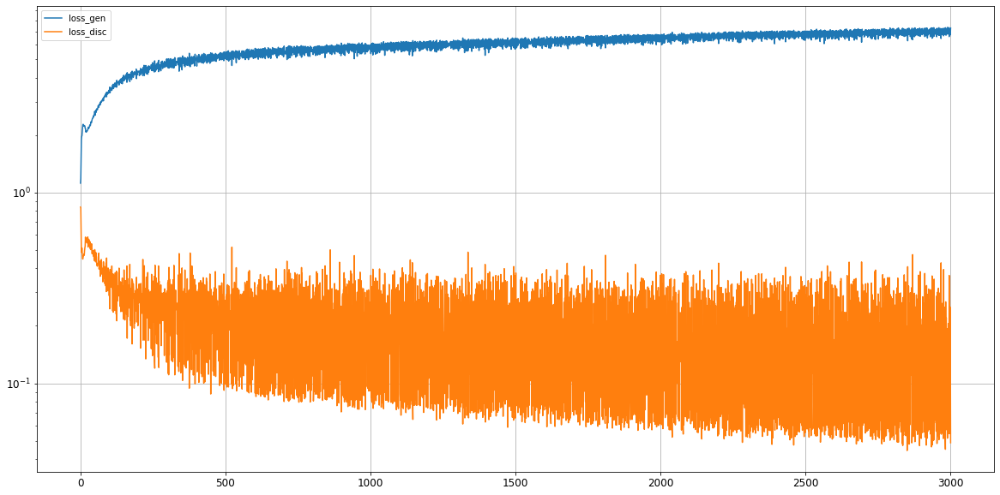

0: mean KL divergence (r,g) = 0.03383705478612588
0: mean JS divergence = 0.00864911025428565
0: mean 1-BC divergence = 0.006309820857618664

0: std KL divergence (r,g) = 0.07778639427394819
0: std JS divergence = 0.024198335615513086
0: std 1-BC divergence = 0.02196045101464017


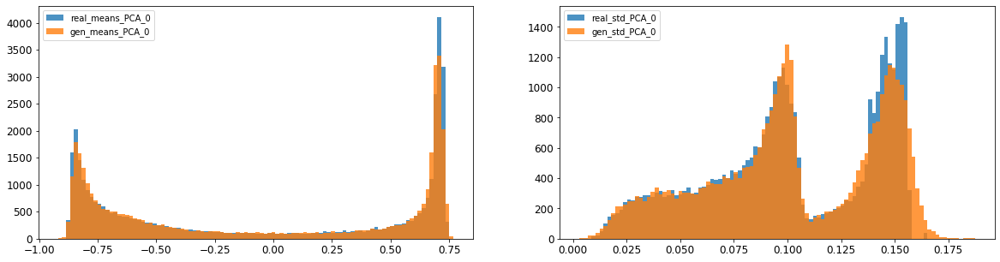

1: mean KL divergence (r,g) = 0.024607582906875137
1: mean JS divergence = 0.006183739499453069
1: mean 1-BC divergence = 0.004397207754645027

1: std KL divergence (r,g) = 0.031258986905137724
1: std JS divergence = 0.0070960647483727605
1: std 1-BC divergence = 0.005007142212926641


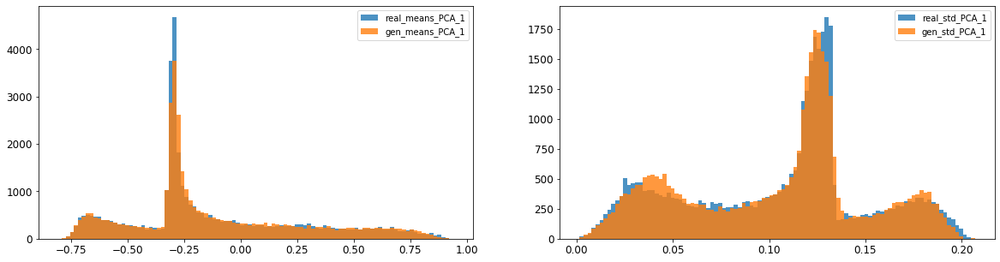

2: mean KL divergence (r,g) = 0.015756994301360704
2: mean JS divergence = 0.003916869535941692
2: mean 1-BC divergence = 0.0028136389728431466

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.01019518538817878
2: std 1-BC divergence = 0.00894189214968677


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


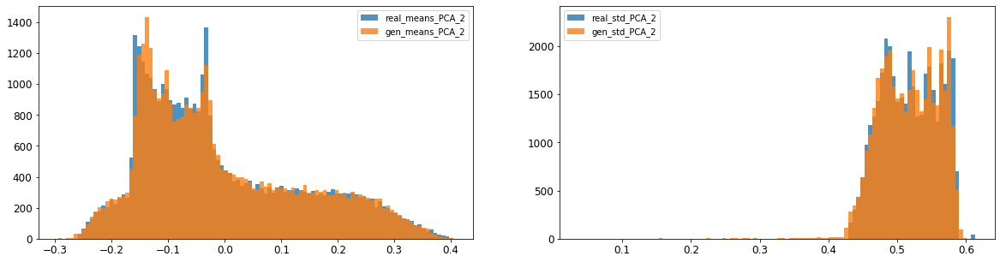

3: mean KL divergence (r,g) = 0.08175302295253532
3: mean JS divergence = 0.021590685701014335
3: mean 1-BC divergence = 0.015456472839263435

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0840252685531323
3: std 1-BC divergence = 0.06360564808801417


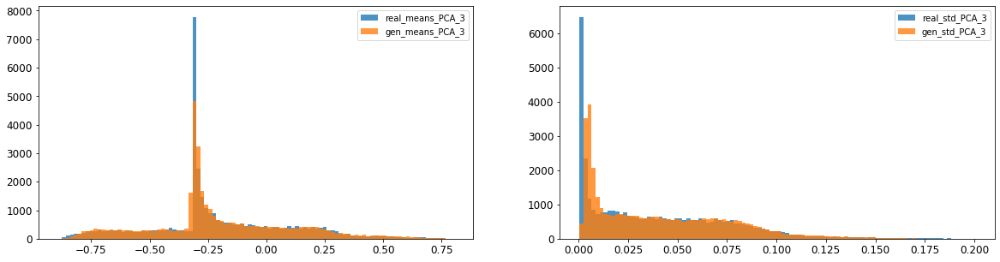

4: mean KL divergence (r,g) = 0.05266992797340406
4: mean JS divergence = 0.013039919605867123
4: mean 1-BC divergence = 0.009885370791651749

4: std KL divergence (r,g) = 0.028576475647274936
4: std JS divergence = 0.006817933999712252
4: std 1-BC divergence = 0.0048172352929480855


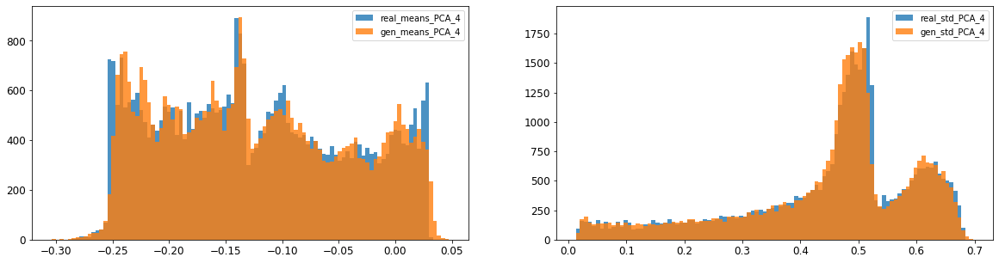

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.02448433804518315
5: mean 1-BC divergence = 0.017620823061865964

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.014073823343184532
5: std 1-BC divergence = 0.011469062973918698


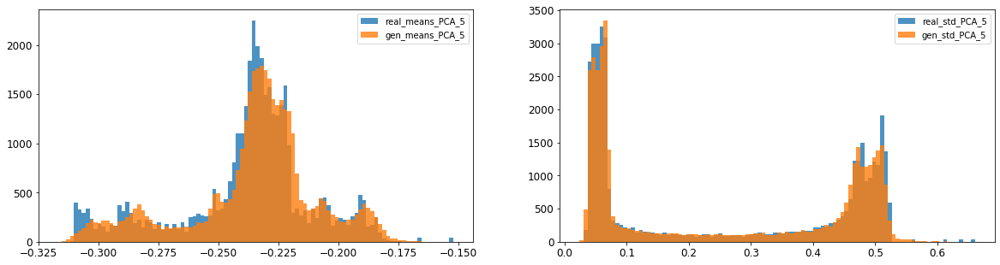

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.006891373705967705
6: mean 1-BC divergence = 0.004911681532332124

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.010454790362477448
6: std 1-BC divergence = 0.007530328103721229


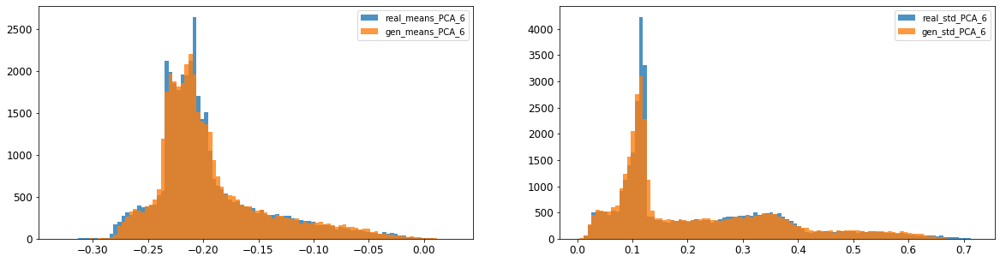

7: mean KL divergence (r,g) = 0.1592305504802168
7: mean JS divergence = 0.03558237784860649
7: mean 1-BC divergence = 0.02580998725144601

7: std KL divergence (r,g) = 0.044096081964816694
7: std JS divergence = 0.010542120883218618
7: std 1-BC divergence = 0.007377951042397246


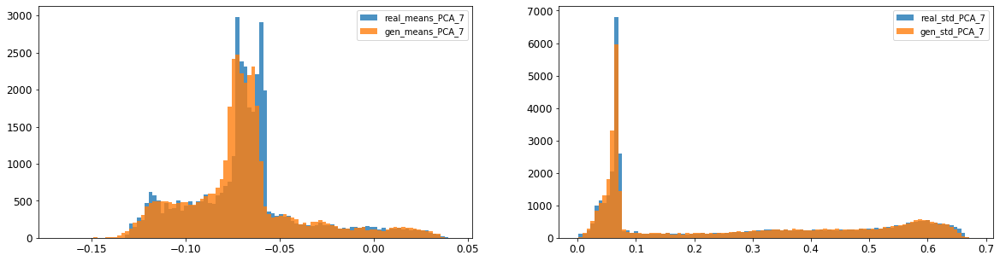

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.003866052506170602
8: mean 1-BC divergence = 0.002744587106786711

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.010135719345670556
8: std 1-BC divergence = 0.007155267960995193


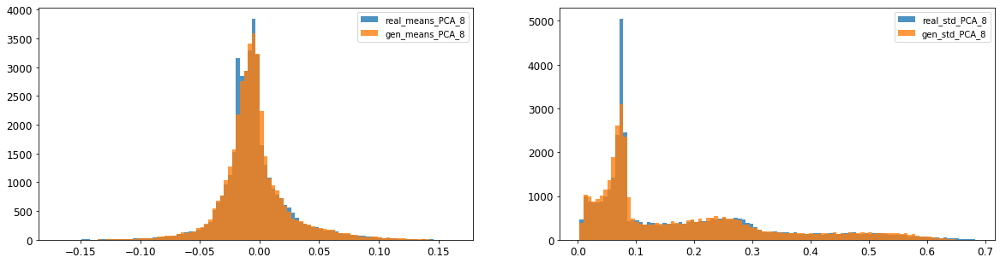

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.00545045752748756
9: mean 1-BC divergence = 0.003839699270686392

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.013761975609415155
9: std 1-BC divergence = 0.00973414008872242


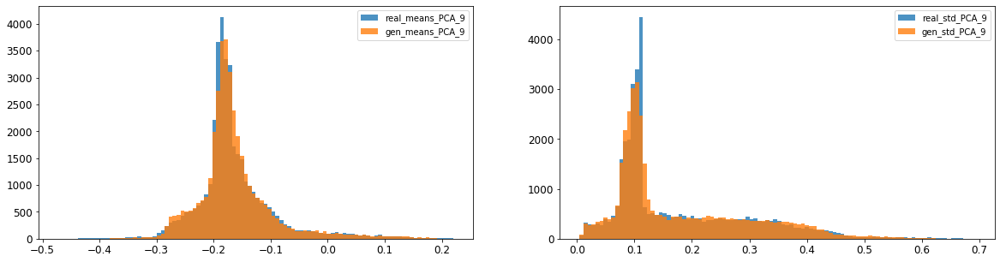

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.006675976046958566
10: mean 1-BC divergence = 0.004717770741960892

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.006477572672597335
10: std 1-BC divergence = 0.005666190844567209


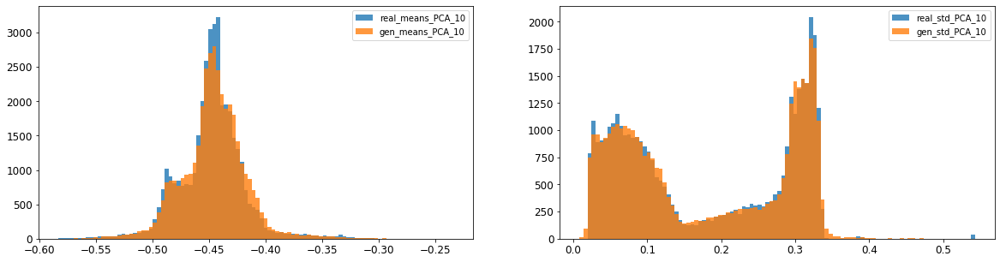

11: mean KL divergence (r,g) = 0.05491804128407416
11: mean JS divergence = 0.014400122698301291
11: mean 1-BC divergence = 0.010148354644455626

11: std KL divergence (r,g) = 0.04497482721224794
11: std JS divergence = 0.011118287089989914
11: std 1-BC divergence = 0.007825830760777697


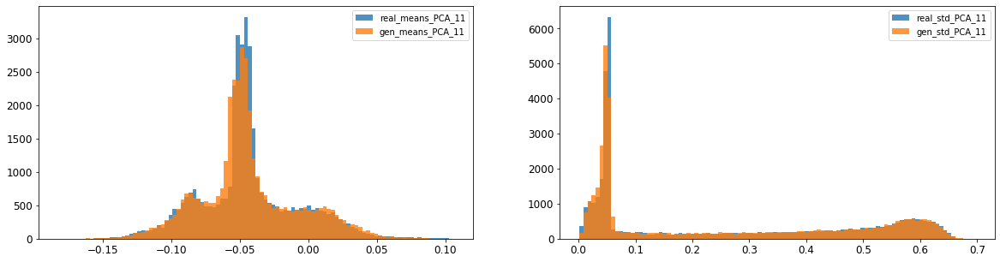

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.003936811607019851
12: mean 1-BC divergence = 0.0028040270929216016

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.020533919495649332
12: std 1-BC divergence = 0.014518850466620048


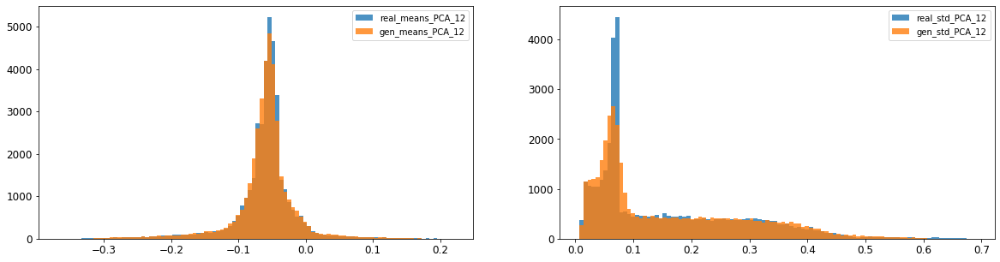

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.01454240040682914
13: mean 1-BC divergence = 0.010158966304510075

13: std KL divergence (r,g) = 0.06589417140271026
13: std JS divergence = 0.016400953097728863
13: std 1-BC divergence = 0.011520932065126832


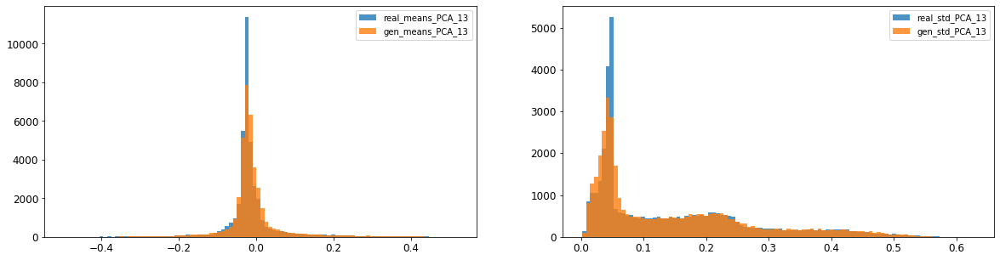

14: mean KL divergence (r,g) = 0.07272211413554258
14: mean JS divergence = 0.01773762121592392
14: mean 1-BC divergence = 0.012397577484563493

14: std KL divergence (r,g) = inf
14: std JS divergence = 0.008711419292705365
14: std 1-BC divergence = 0.006102350261267597


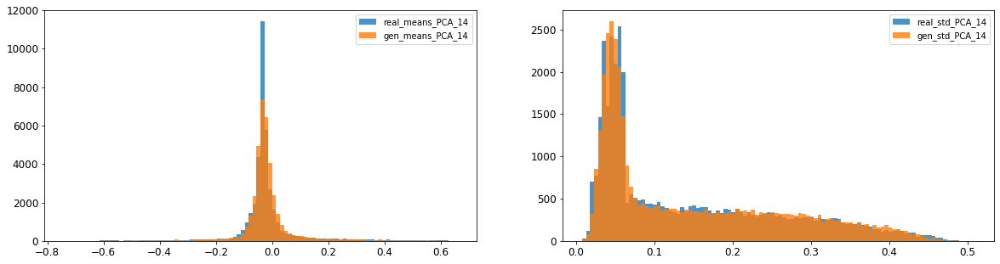

15: mean KL divergence (r,g) = 1.7506455789735842
15: mean JS divergence = 0.47663002742337
15: mean 1-BC divergence = 0.4357482540970432

15: std KL divergence (r,g) = 5.625989768981211
15: std JS divergence = 0.9282854197119166
15: std 1-BC divergence = 0.8577002417999222


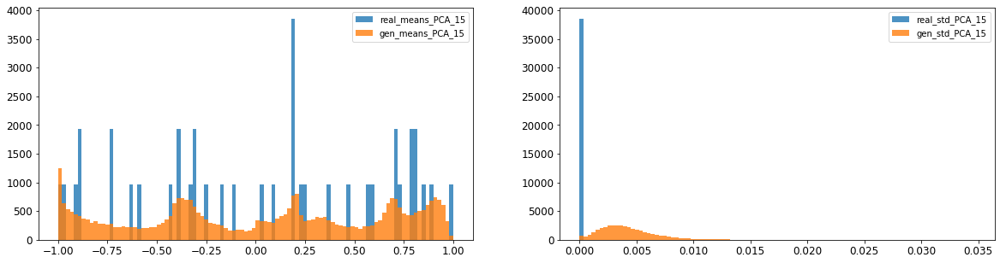

16: mean KL divergence (r,g) = 1.4430404210205088
16: mean JS divergence = 0.4027350295208548
16: mean 1-BC divergence = 0.3703746283371606

16: std KL divergence (r,g) = 5.5328803645897295
16: std JS divergence = 0.9244996185811556
16: std 1-BC divergence = 0.8530334416858016


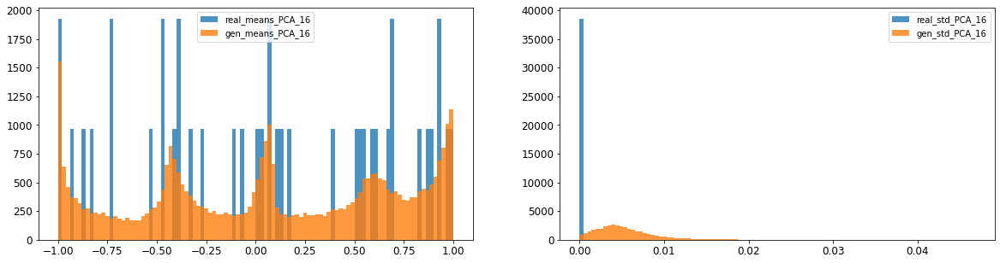



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.014716374190085214
Compose 1-BC divergence = 0.010908308634462793

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.01506352361093198
Compose weighted 1-BC divergence = 0.012278693306518096

Multivariate KL divergence = 47.136728162468195


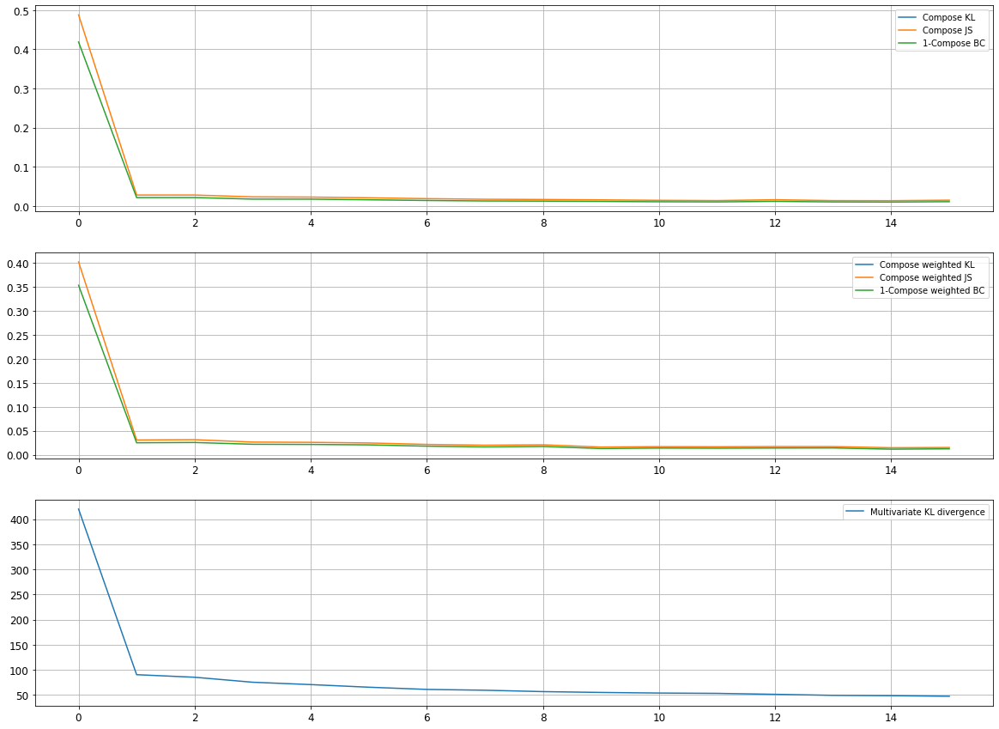

Epoch 3002/10000
discriminator loss: 0.049391 - generator loss: 7.348754 - 28s
Epoch 3003/10000
discriminator loss: 0.292597 - generator loss: 6.796348 - 29s
Epoch 3004/10000
discriminator loss: 0.069915 - generator loss: 7.090320 - 29s
Epoch 3005/10000
discriminator loss: 0.189307 - generator loss: 6.769947 - 29s
Epoch 3006/10000
discriminator loss: 0.049374 - generator loss: 7.372282 - 29s
Epoch 3007/10000
discriminator loss: 0.169295 - generator loss: 6.929306 - 29s
Epoch 3008/10000
discriminator loss: 0.058055 - generator loss: 7.172435 - 29s
Epoch 3009/10000
discriminator loss: 0.082816 - generator loss: 7.323414 - 29s
Epoch 3010/10000
discriminator loss: 0.276047 - generator loss: 6.607928 - 29s
Epoch 3011/10000
discriminator loss: 0.051289 - generator loss: 7.187116 - 28s
Epoch 3012/10000
discriminator loss: 0.160262 - generator loss: 6.858294 - 28s
Epoch 3013/10000
discriminator loss: 0.310250 - generator loss: 6.710697 - 28s
Epoch 3014/10000
discriminator loss: 0.050133 - gene

discriminator loss: 0.382564 - generator loss: 6.573738 - 23s
Epoch 3107/10000
discriminator loss: 0.052058 - generator loss: 7.276250 - 23s
Epoch 3108/10000
discriminator loss: 0.064658 - generator loss: 7.230370 - 23s
Epoch 3109/10000
discriminator loss: 0.243276 - generator loss: 6.769095 - 23s
Epoch 3110/10000
discriminator loss: 0.054802 - generator loss: 7.232618 - 23s
Epoch 3111/10000
discriminator loss: 0.052682 - generator loss: 7.326666 - 23s
Epoch 3112/10000
discriminator loss: 0.255253 - generator loss: 6.717845 - 23s
Epoch 3113/10000
discriminator loss: 0.047044 - generator loss: 7.395313 - 23s
Epoch 3114/10000
discriminator loss: 0.081556 - generator loss: 7.306254 - 23s
Epoch 3115/10000
discriminator loss: 0.285344 - generator loss: 6.686440 - 23s
Epoch 3116/10000
discriminator loss: 0.049233 - generator loss: 7.321302 - 23s
Epoch 3117/10000
discriminator loss: 0.182633 - generator loss: 6.944101 - 23s
Epoch 3118/10000
discriminator loss: 0.051658 - generator loss: 7.356

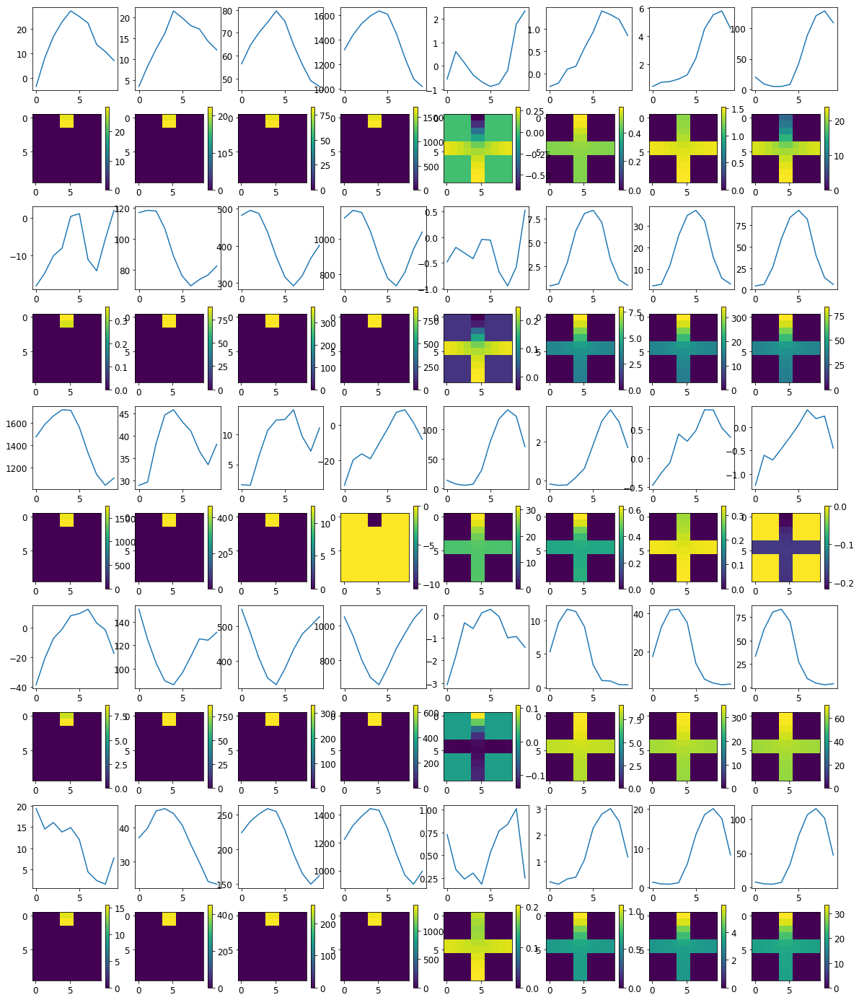


R0 generated:
[[19.701765   17.857904  ]
 [19.679558   17.861897  ]
 [19.6833     17.814981  ]
 [19.681429   17.812677  ]
 [19.687143   17.87615   ]
 [19.690182   17.786299  ]
 [19.695898   17.849195  ]
 [19.695675   17.844624  ]
 [19.687626   17.801926  ]
 [19.682117   17.868252  ]
 [17.151146    0.5848676 ]
 [17.10453     0.57765406]
 [17.14777     0.5561697 ]
 [17.168667    0.53398085]
 [17.154156    0.5265854 ]
 [17.175537    0.53027874]
 [17.152987    0.49403837]
 [17.188446    0.48526677]
 [17.240253    0.504403  ]
 [17.14316     0.5065343 ]
 [17.76178     1.5436625 ]
 [17.728653    1.5156865 ]
 [17.777063    1.5886658 ]
 [17.767681    1.5049645 ]
 [17.748764    1.4535022 ]
 [17.786135    1.482982  ]
 [17.735905    1.4216735 ]
 [17.775362    1.457543  ]
 [17.801699    1.4502904 ]
 [17.75871     1.1704346 ]
 [19.76868    17.251017  ]
 [19.75961    17.196993  ]
 [19.746002   17.234163  ]
 [19.743296   17.219898  ]
 [19.747898   17.272615  ]
 [19.74406    17.195887  ]
 [19.751862  

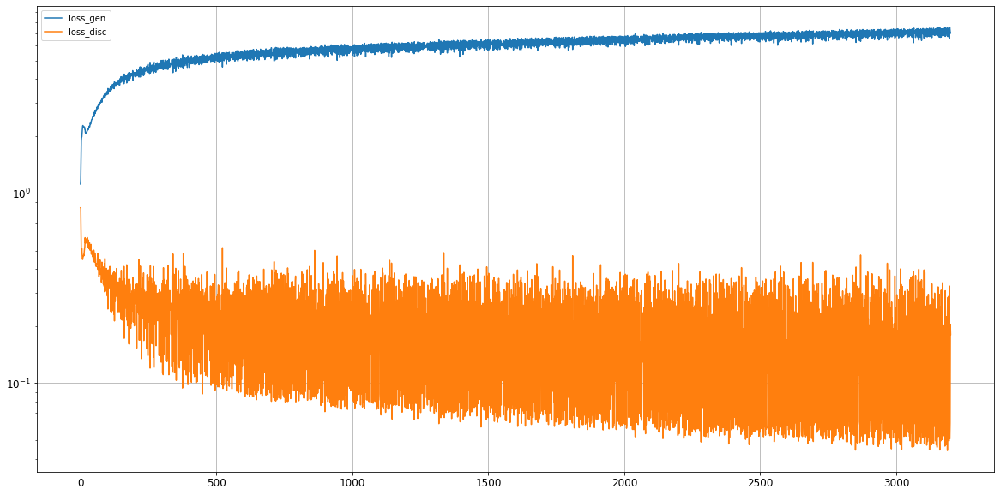

0: mean KL divergence (r,g) = 0.041993819133470466
0: mean JS divergence = 0.012559346791477315
0: mean 1-BC divergence = 0.01098199076091455

0: std KL divergence (r,g) = 0.08790692559520207
0: std JS divergence = 0.025309373174725314
0: std 1-BC divergence = 0.022035875537883776


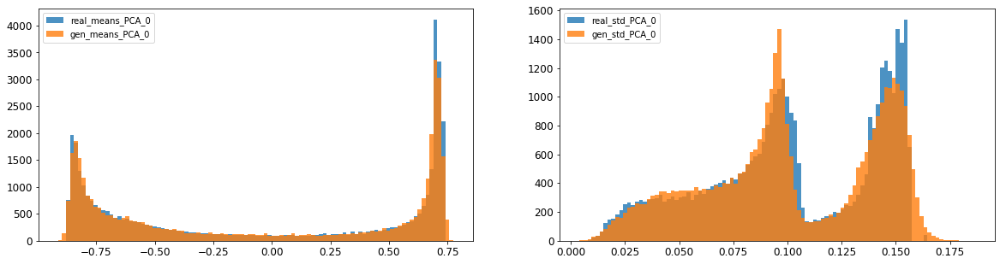

1: mean KL divergence (r,g) = 0.024479505727775696
1: mean JS divergence = 0.006106171421674357
1: mean 1-BC divergence = 0.004288875925691937

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.011106492682720218
1: std 1-BC divergence = 0.007807117213788239


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


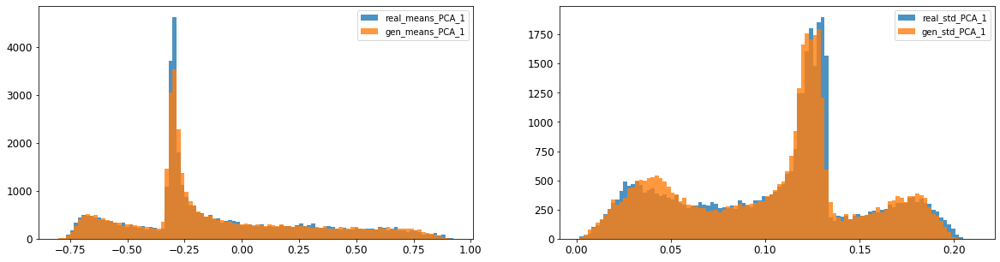

2: mean KL divergence (r,g) = 0.015137491361777805
2: mean JS divergence = 0.003641634283350754
2: mean 1-BC divergence = 0.002563310899230231

2: std KL divergence (r,g) = 0.03292871822048319
2: std JS divergence = 0.008929298844050682
2: std 1-BC divergence = 0.007571936810034097


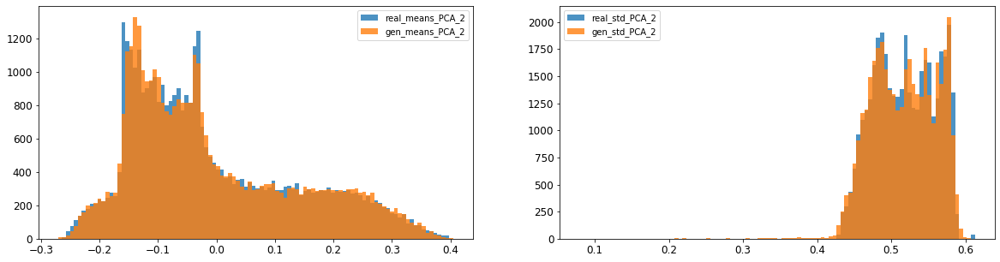

3: mean KL divergence (r,g) = 0.04372209242470221
3: mean JS divergence = 0.010692287430598694
3: mean 1-BC divergence = 0.007548692982149885

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.07931844098897471
3: std 1-BC divergence = 0.058092670807034286


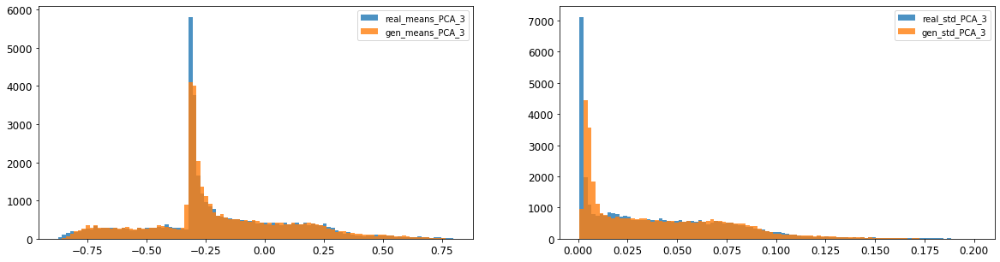

4: mean KL divergence (r,g) = 0.053501959412827704
4: mean JS divergence = 0.015523786893633545
4: mean 1-BC divergence = 0.013095978850883538

4: std KL divergence (r,g) = 0.03086922138021406
4: std JS divergence = 0.007383583769573268
4: std 1-BC divergence = 0.005211253600367782


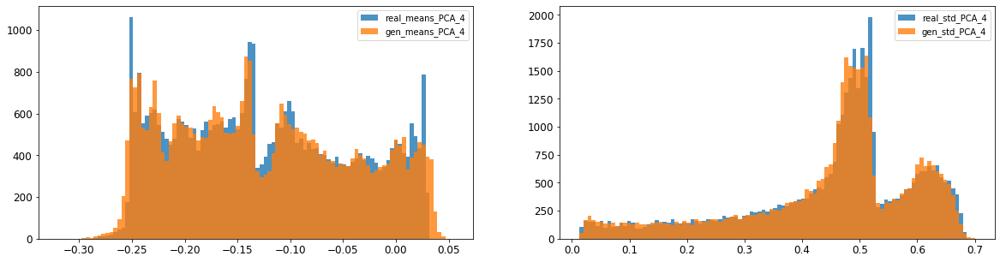

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.016341316972629645
5: mean 1-BC divergence = 0.012126746492046592

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.015989831963746752
5: std 1-BC divergence = 0.01389312790703967


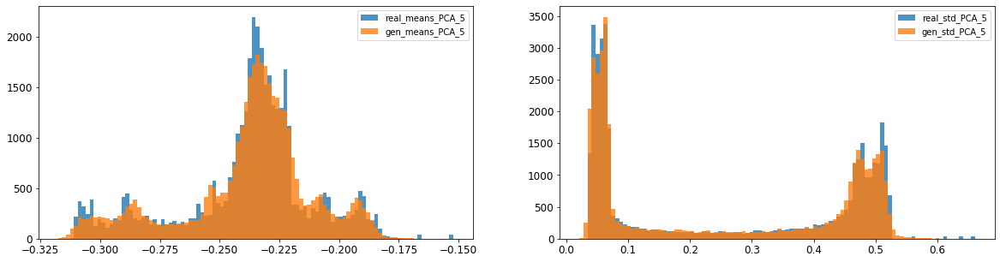

6: mean KL divergence (r,g) = 0.03478688129426941
6: mean JS divergence = 0.008780211622171966
6: mean 1-BC divergence = 0.006196394729662824

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.009476632613282347
6: std 1-BC divergence = 0.006822036023682032


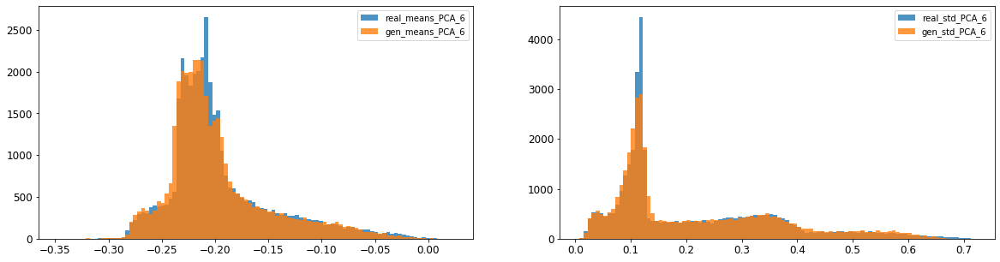

7: mean KL divergence (r,g) = 0.10328983855382981
7: mean JS divergence = 0.02764052358018388
7: mean 1-BC divergence = 0.020369465806857612

7: std KL divergence (r,g) = 0.03851884998580148
7: std JS divergence = 0.009425926379977804
7: std 1-BC divergence = 0.006615590944843763


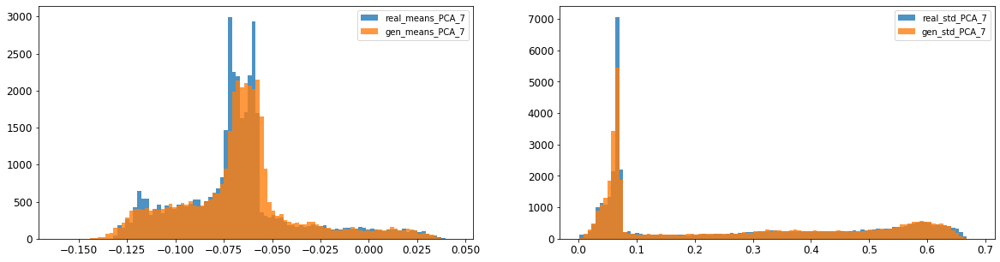

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.006455730813940181
8: mean 1-BC divergence = 0.004589486650370622

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.012121241375326976
8: std 1-BC divergence = 0.00857125119304658


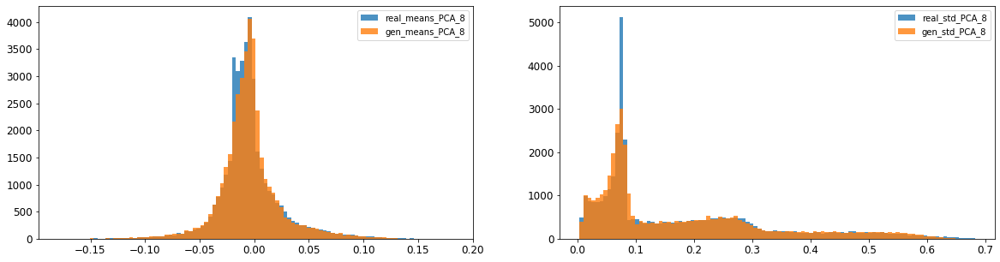

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0040074646409283335
9: mean 1-BC divergence = 0.002867129330450635

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.013885385018740844
9: std 1-BC divergence = 0.009837615788167553


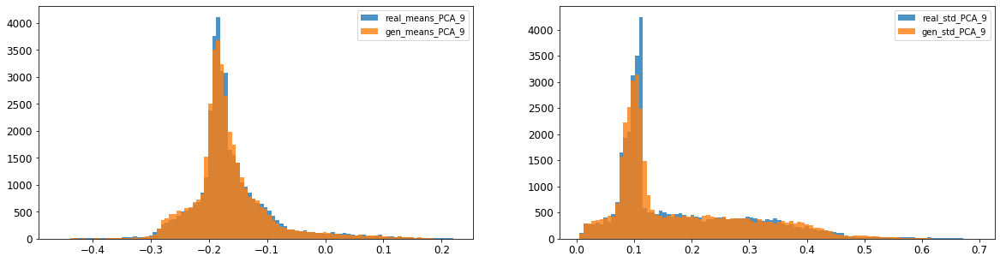

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.0051805227580692375
10: mean 1-BC divergence = 0.0037136501944594613

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005906666082104748
10: std 1-BC divergence = 0.005181983529339518


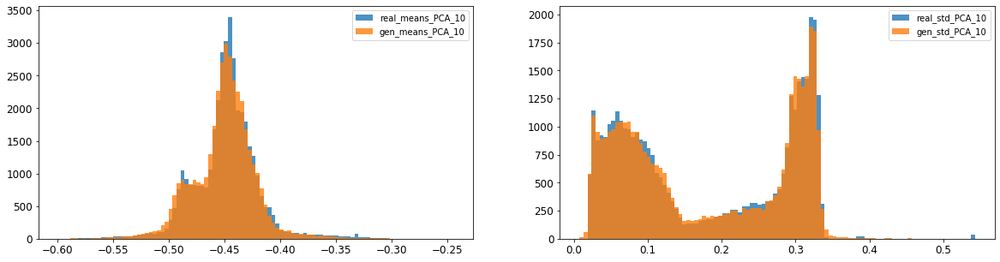

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.01538917322318752
11: mean 1-BC divergence = 0.010834636565961953

11: std KL divergence (r,g) = 0.05939632286919923
11: std JS divergence = 0.01571835097375759
11: std 1-BC divergence = 0.011258163259082465


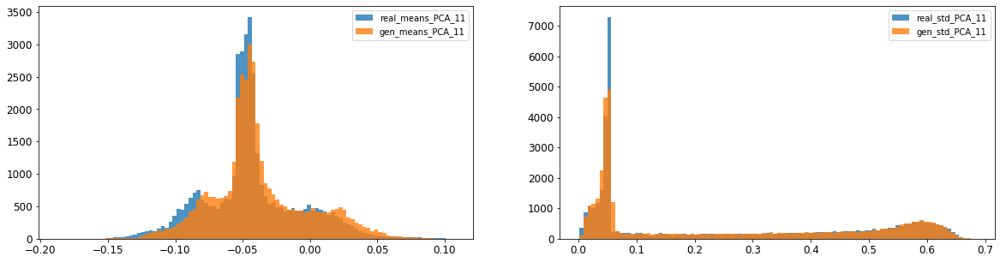

12: mean KL divergence (r,g) = 0.027005916123926124
12: mean JS divergence = 0.006795251728224521
12: mean 1-BC divergence = 0.0047511302515381715

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.018466424523768003
12: std 1-BC divergence = 0.013045082713248002


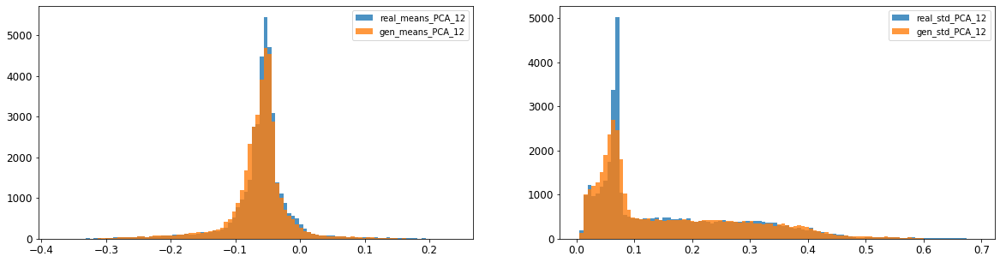

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.01694583372350724
13: mean 1-BC divergence = 0.01186695728277598

13: std KL divergence (r,g) = 0.06436661924791869
13: std JS divergence = 0.016074823852463463
13: std 1-BC divergence = 0.011276355044636421


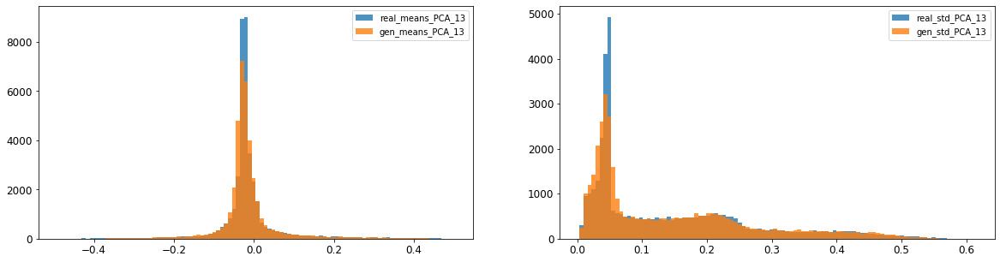

14: mean KL divergence (r,g) = 0.04738995465827728
14: mean JS divergence = 0.011852894656118291
14: mean 1-BC divergence = 0.008293932242622537

14: std KL divergence (r,g) = 0.03613872294475966
14: std JS divergence = 0.0086245716882381
14: std 1-BC divergence = 0.006029575455017477


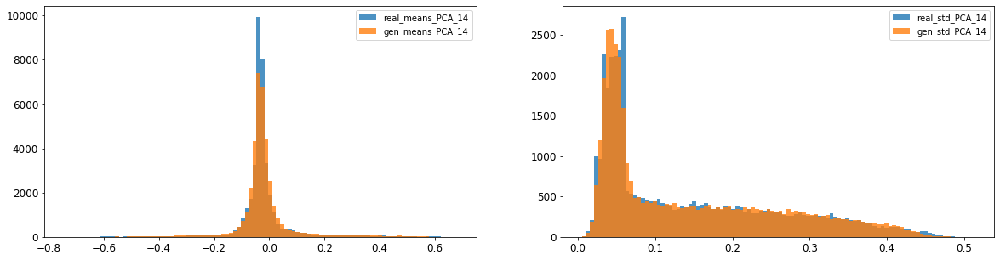

15: mean KL divergence (r,g) = 1.7246627929593878
15: mean JS divergence = 0.47082968945295506
15: mean 1-BC divergence = 0.4308256323765879

15: std KL divergence (r,g) = 5.97593224003817
15: std JS divergence = 0.9409764152688209
15: std 1-BC divergence = 0.8739529831083269


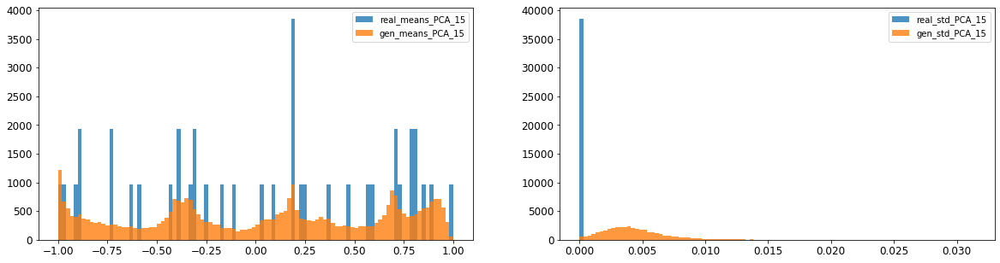

16: mean KL divergence (r,g) = 1.4365192078466467
16: mean JS divergence = 0.40327198209045034
16: mean 1-BC divergence = 0.370888716716387

16: std KL divergence (r,g) = 5.701938622214509
16: std JS divergence = 0.9312406731850158
16: std 1-BC divergence = 0.8613969712285068


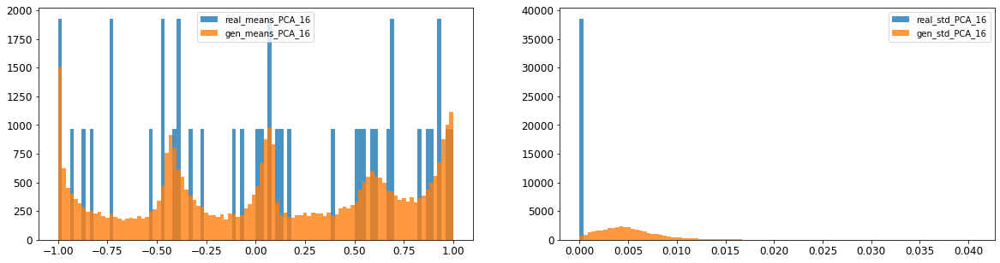



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.014188306482371547
Compose 1-BC divergence = 0.010577933826427688

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.016369261244655577
Compose weighted 1-BC divergence = 0.013485874276158993

Multivariate KL divergence = 46.65811531528988


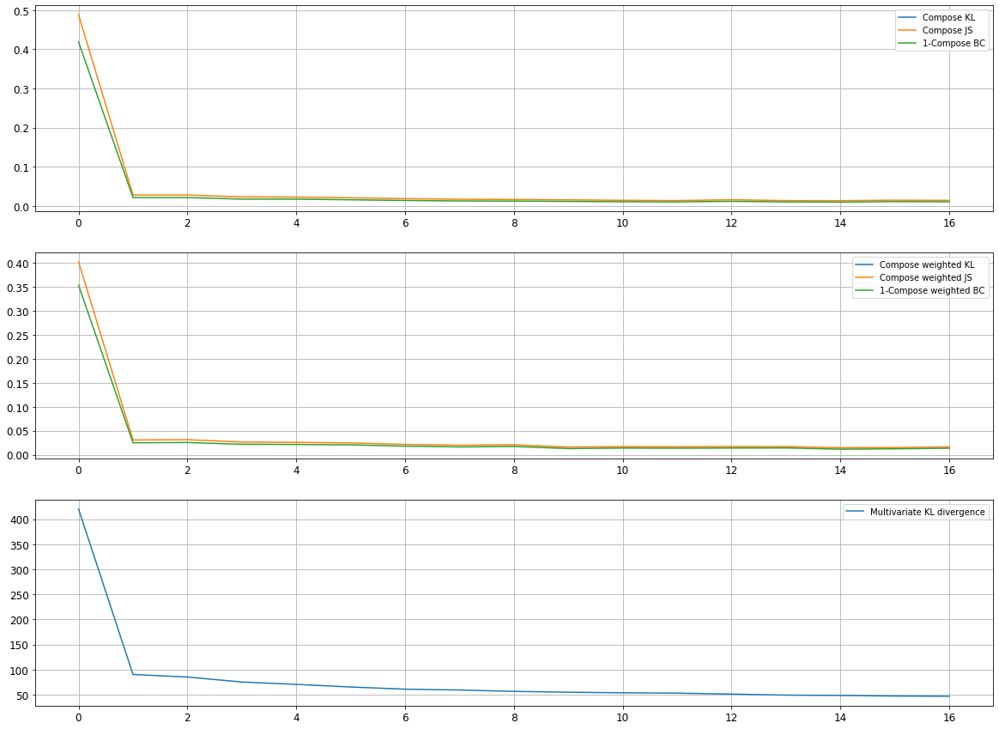

Epoch 3202/10000
discriminator loss: 0.046224 - generator loss: 7.495064 - 22s
Epoch 3203/10000
discriminator loss: 0.052545 - generator loss: 7.337386 - 24s
Epoch 3204/10000
discriminator loss: 0.350958 - generator loss: 6.684405 - 28s
Epoch 3205/10000
discriminator loss: 0.054820 - generator loss: 7.286867 - 28s
Epoch 3206/10000
discriminator loss: 0.060683 - generator loss: 7.285334 - 28s
Epoch 3207/10000
discriminator loss: 0.296602 - generator loss: 7.041859 - 28s
Epoch 3208/10000
discriminator loss: 0.063509 - generator loss: 7.119902 - 29s
Epoch 3209/10000
discriminator loss: 0.055024 - generator loss: 7.338077 - 29s
Epoch 3210/10000
discriminator loss: 0.303478 - generator loss: 6.800412 - 29s
Epoch 3211/10000
discriminator loss: 0.078031 - generator loss: 7.177855 - 29s
Epoch 3212/10000
discriminator loss: 0.043827 - generator loss: 7.530951 - 29s
Epoch 3213/10000
discriminator loss: 0.246543 - generator loss: 6.730121 - 29s
Epoch 3214/10000
discriminator loss: 0.053908 - gene

discriminator loss: 0.083257 - generator loss: 7.230433 - 29s
Epoch 3307/10000
discriminator loss: 0.236413 - generator loss: 6.960115 - 29s
Epoch 3308/10000
discriminator loss: 0.054021 - generator loss: 7.344435 - 29s
Epoch 3309/10000
discriminator loss: 0.060621 - generator loss: 7.383324 - 29s
Epoch 3310/10000
discriminator loss: 0.346959 - generator loss: 6.706242 - 28s
Epoch 3311/10000
discriminator loss: 0.044848 - generator loss: 7.433854 - 29s
Epoch 3312/10000
discriminator loss: 0.053036 - generator loss: 7.399584 - 28s
Epoch 3313/10000
discriminator loss: 0.236114 - generator loss: 7.115689 - 29s
Epoch 3314/10000
discriminator loss: 0.051918 - generator loss: 7.358772 - 28s
Epoch 3315/10000
discriminator loss: 0.060800 - generator loss: 7.397237 - 28s
Epoch 3316/10000
discriminator loss: 0.353508 - generator loss: 6.793827 - 28s
Epoch 3317/10000
discriminator loss: 0.045546 - generator loss: 7.449383 - 28s
Epoch 3318/10000
discriminator loss: 0.140886 - generator loss: 7.186

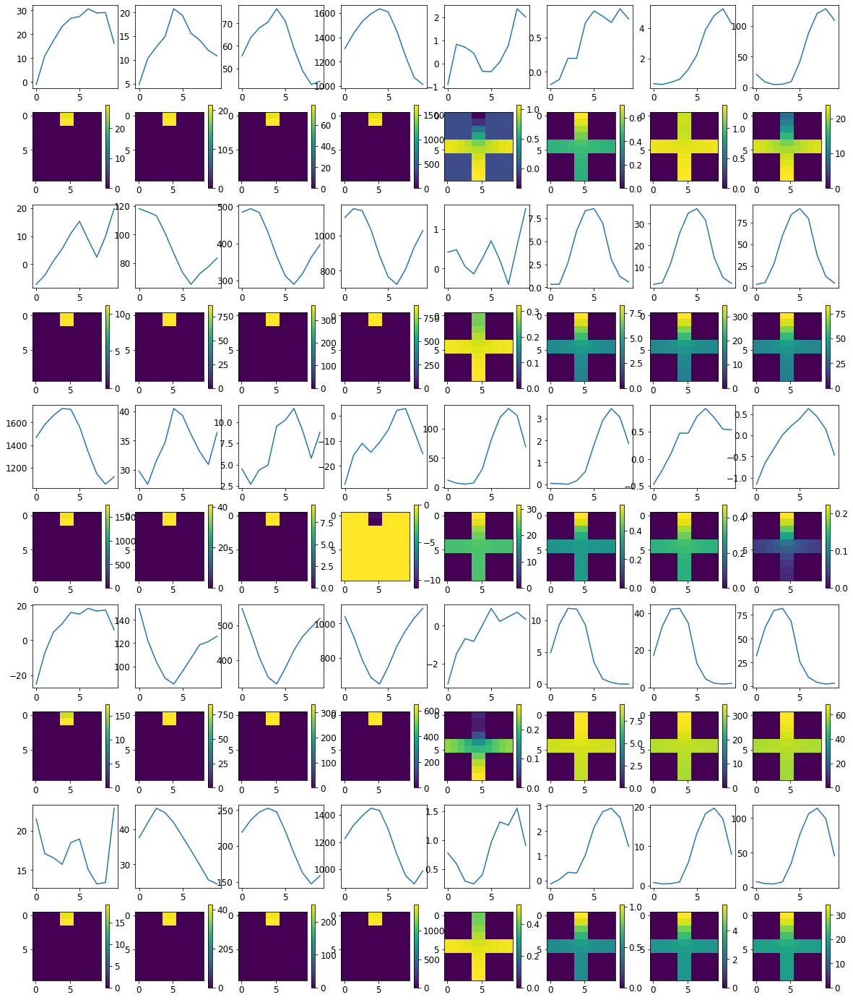


R0 generated:
[[19.654783   17.57363   ]
 [19.636925   17.601442  ]
 [19.656176   17.50979   ]
 [19.65079    17.513832  ]
 [19.662762   17.524952  ]
 [19.66587    17.52053   ]
 [19.676218   17.58796   ]
 [19.665838   17.633097  ]
 [19.658604   17.583141  ]
 [19.652916   17.67287   ]
 [16.970562    0.6095054 ]
 [16.914167    0.6125999 ]
 [16.96114     0.5896496 ]
 [16.95081     0.5782628 ]
 [16.94791     0.578348  ]
 [16.95419     0.5837195 ]
 [16.92789     0.550313  ]
 [16.969694    0.55548334]
 [17.064379    0.57107025]
 [16.978796    0.5853662 ]
 [17.4415      1.1240809 ]
 [17.415201    1.1005877 ]
 [17.462082    1.1026443 ]
 [17.462915    1.0800421 ]
 [17.480198    1.0709748 ]
 [17.507135    1.0884097 ]
 [17.453114    1.054992  ]
 [17.489748    1.1389629 ]
 [17.509613    1.1684835 ]
 [17.468214    0.9525375 ]
 [19.753807   17.085634  ]
 [19.74084    17.07904   ]
 [19.727213   17.013763  ]
 [19.718048   17.002546  ]
 [19.7226     16.98729   ]
 [19.714302   16.941101  ]
 [19.724081  

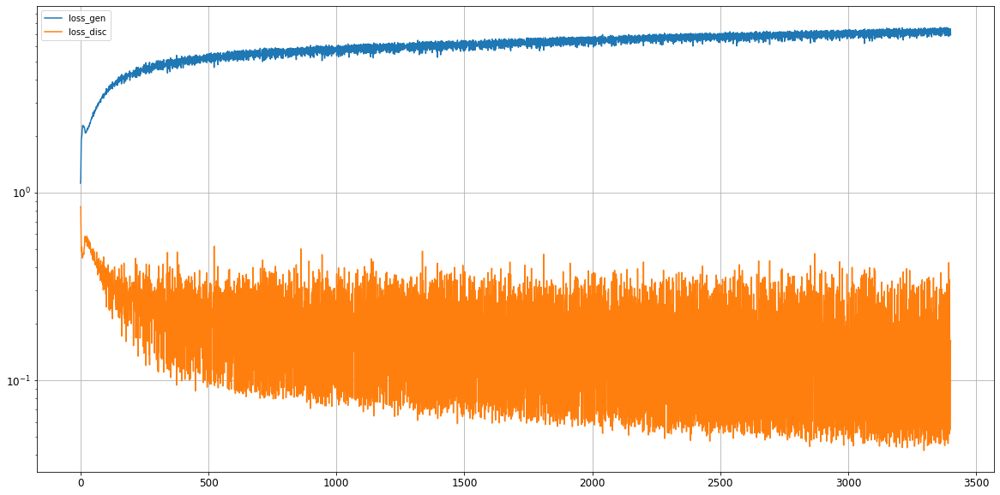

0: mean KL divergence (r,g) = 0.030426502520374505
0: mean JS divergence = 0.008005051564699819
0: mean 1-BC divergence = 0.006103267719154926

0: std KL divergence (r,g) = 0.05970333942107195
0: std JS divergence = 0.018979204036829903
0: std 1-BC divergence = 0.01688845574642106


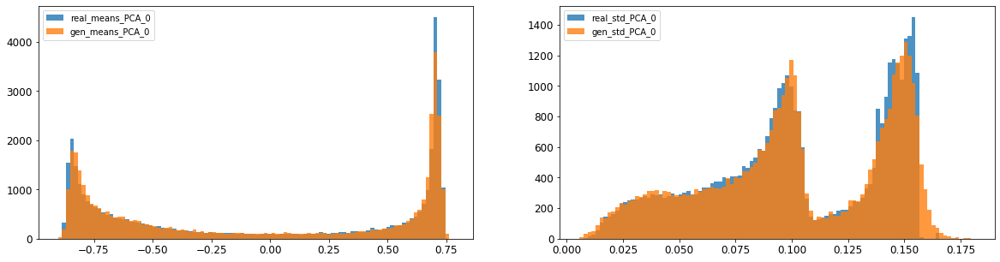

1: mean KL divergence (r,g) = 0.022026005244007763
1: mean JS divergence = 0.005380374648549394
1: mean 1-BC divergence = 0.0038118108620572855

1: std KL divergence (r,g) = 0.0242927590336679
1: std JS divergence = 0.005737674328378104
1: std 1-BC divergence = 0.004029863912145437


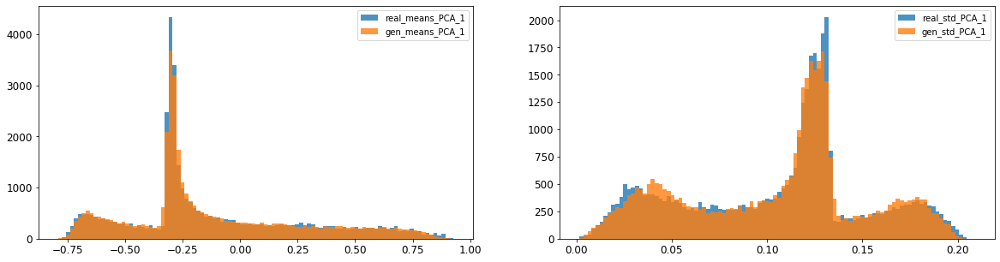

2: mean KL divergence (r,g) = 0.014117484908450792
2: mean JS divergence = 0.003520629815532391
2: mean 1-BC divergence = 0.002523673282547101

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.010016182424222107
2: std 1-BC divergence = 0.00855551180960401


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


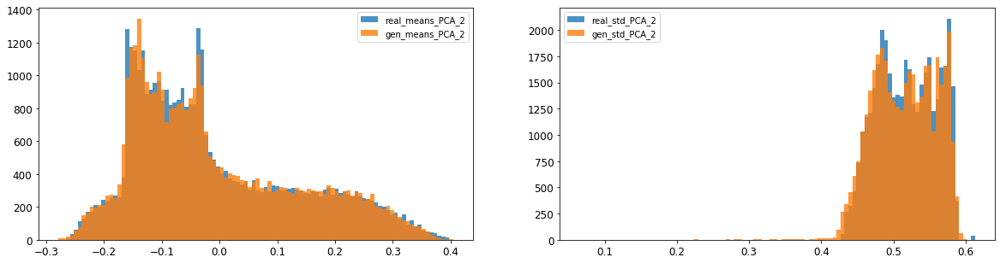

3: mean KL divergence (r,g) = 0.05145169286840424
3: mean JS divergence = 0.012140533682100151
3: mean 1-BC divergence = 0.008492523085828818

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0777075287321943
3: std 1-BC divergence = 0.057218274954674575


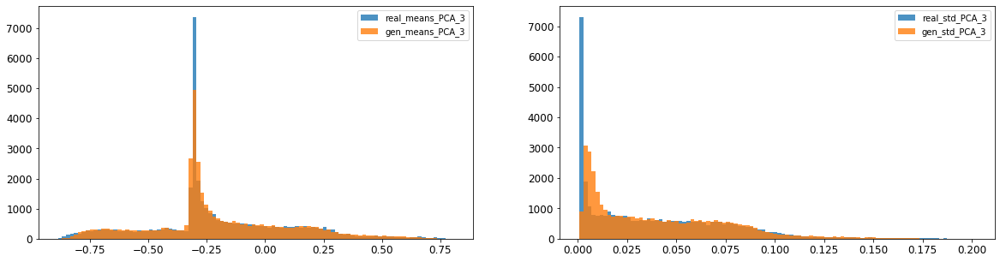

4: mean KL divergence (r,g) = 0.04215864665396794
4: mean JS divergence = 0.01184608543896857
4: mean 1-BC divergence = 0.009710367925534147

4: std KL divergence (r,g) = 0.025762590639003963
4: std JS divergence = 0.0062154084036614085
4: std 1-BC divergence = 0.004416788558073592


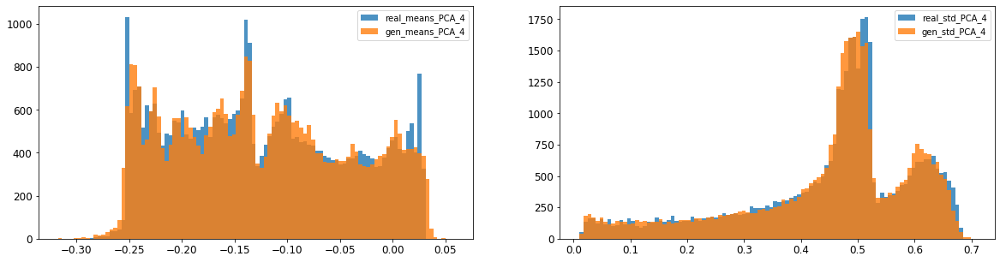

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.018649012572003524
5: mean 1-BC divergence = 0.01337525495982994

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.021272842855499886
5: std 1-BC divergence = 0.01712407961957907


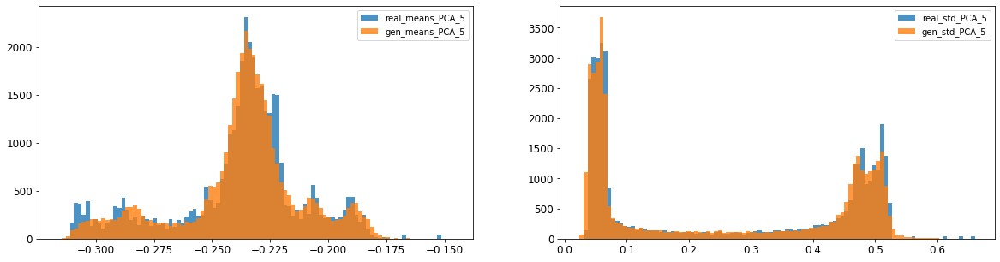

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0035654767090310844
6: mean 1-BC divergence = 0.0025628754586458635

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.008907126309907629
6: std 1-BC divergence = 0.0064638939643471005


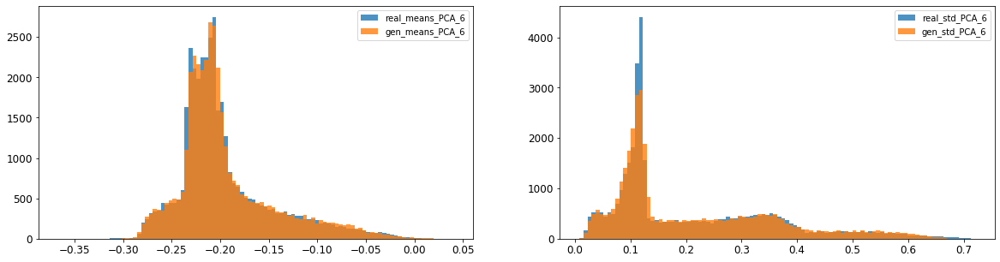

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.021604422199829984
7: mean 1-BC divergence = 0.016389414233259236

7: std KL divergence (r,g) = 0.04084149397388112
7: std JS divergence = 0.00950459933584789
7: std 1-BC divergence = 0.006661721063182968


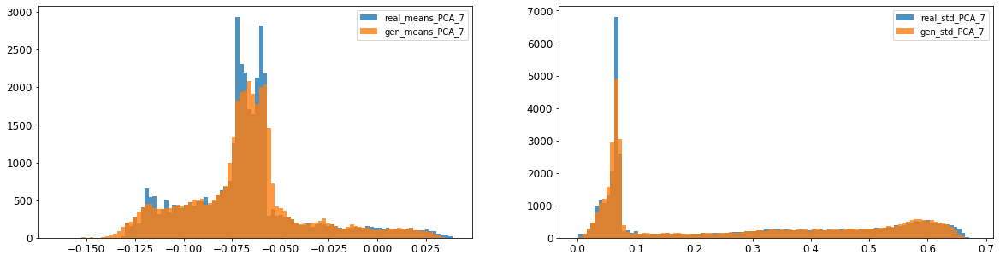

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.004385006178612439
8: mean 1-BC divergence = 0.0030898662432221613

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.011230350122469465
8: std 1-BC divergence = 0.007913299525151185


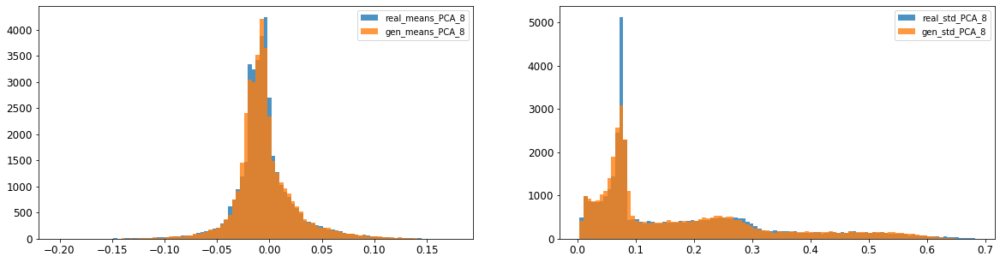

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.005210558750163099
9: mean 1-BC divergence = 0.003716523321710241

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.014446633118704639
9: std 1-BC divergence = 0.01024965753472451


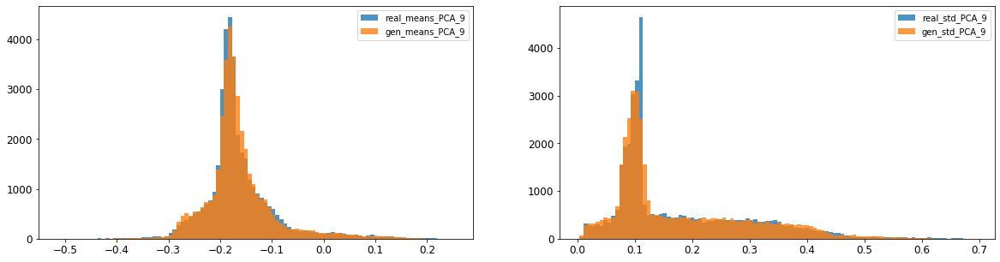

10: mean KL divergence (r,g) = 0.018886994100464214
10: mean JS divergence = 0.0046741467312625
10: mean 1-BC divergence = 0.003307381036885104

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.0064319579689488355
10: std 1-BC divergence = 0.005300591103245544


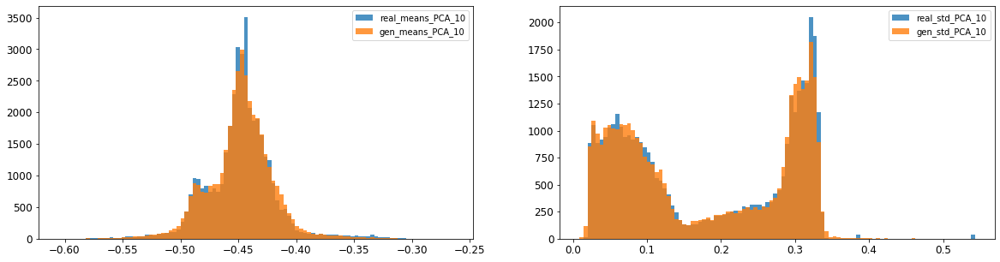

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.007512850069325755
11: mean 1-BC divergence = 0.005341555040836554

11: std KL divergence (r,g) = 0.05326404561646742
11: std JS divergence = 0.013296143574120064
11: std 1-BC divergence = 0.009322811053717683


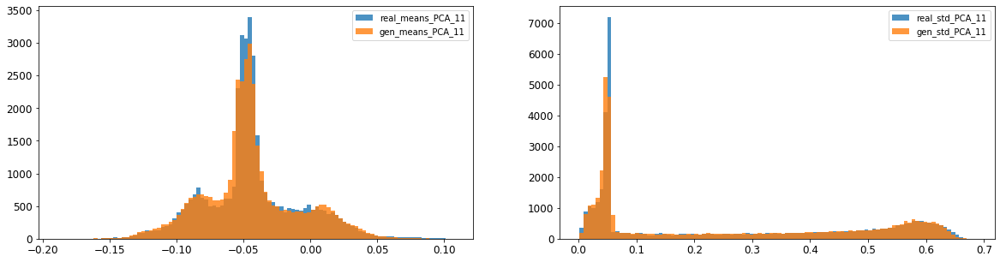

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.006008488406828432
12: mean 1-BC divergence = 0.0042469715588819845

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.021728587664282012
12: std 1-BC divergence = 0.015414290173297318


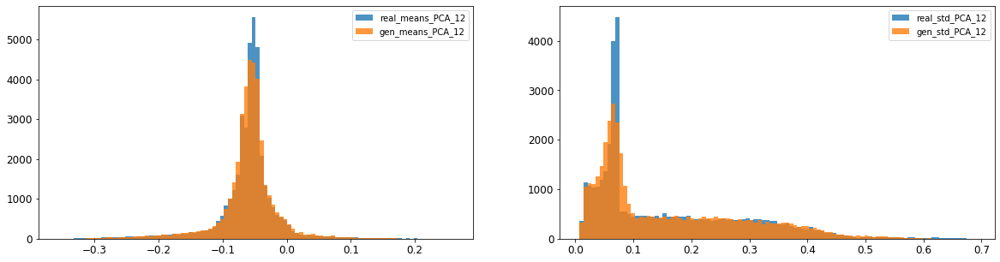

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.010905614379636146
13: mean 1-BC divergence = 0.007653096051128627

13: std KL divergence (r,g) = 0.07712160539788611
13: std JS divergence = 0.018549588158600284
13: std 1-BC divergence = 0.012975995350609781


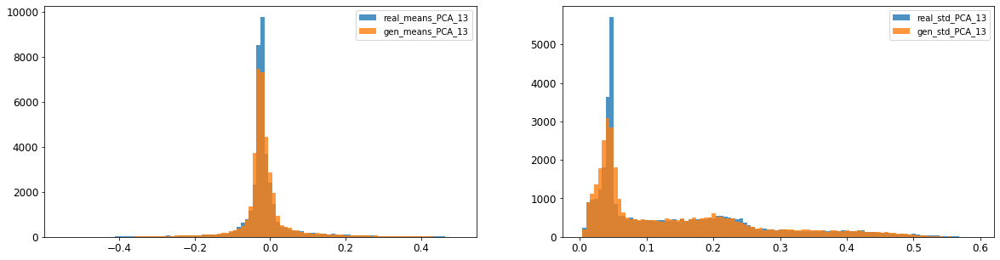

14: mean KL divergence (r,g) = 0.07287264396644635
14: mean JS divergence = 0.018291334490504182
14: mean 1-BC divergence = 0.012820837327907286

14: std KL divergence (r,g) = 0.032019669968421136
14: std JS divergence = 0.00806064719011191
14: std 1-BC divergence = 0.005625694297103578


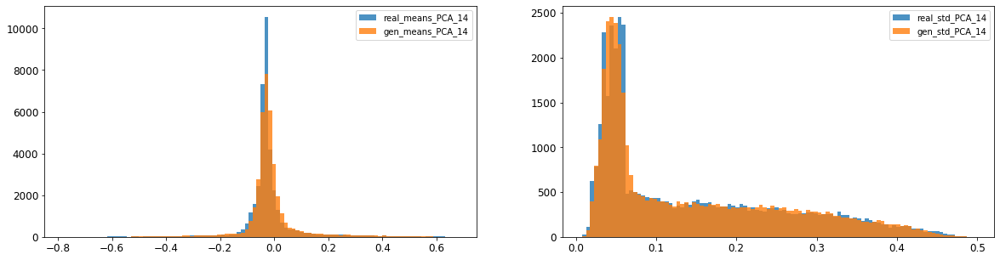

15: mean KL divergence (r,g) = 1.7833436407728978
15: mean JS divergence = 0.48196394548878685
15: mean 1-BC divergence = 0.440879125433155

15: std KL divergence (r,g) = 5.98776737647514
15: std JS divergence = 0.9413661148202739
15: std 1-BC divergence = 0.8744689370418877


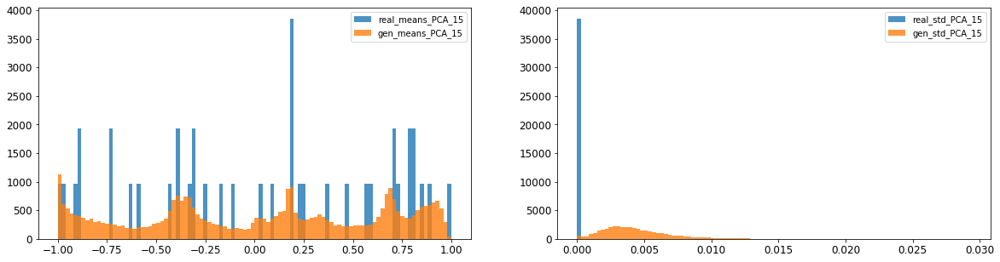

16: mean KL divergence (r,g) = 1.4313904113328209
16: mean JS divergence = 0.4007667160251931
16: mean 1-BC divergence = 0.36870393462226114

16: std KL divergence (r,g) = 6.132657743725623
16: std JS divergence = 0.9459438439627805
16: std 1-BC divergence = 0.8806168502317093


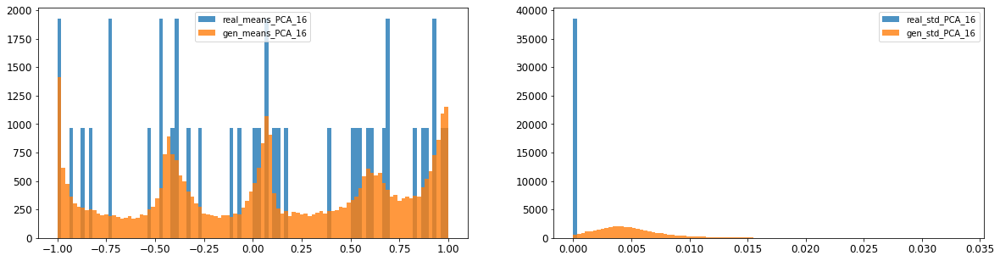



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.013126135328694194
Compose 1-BC divergence = 0.009710211559110005

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.012634559268469117
Compose weighted 1-BC divergence = 0.010197329817661416

Multivariate KL divergence = 46.012529696323824


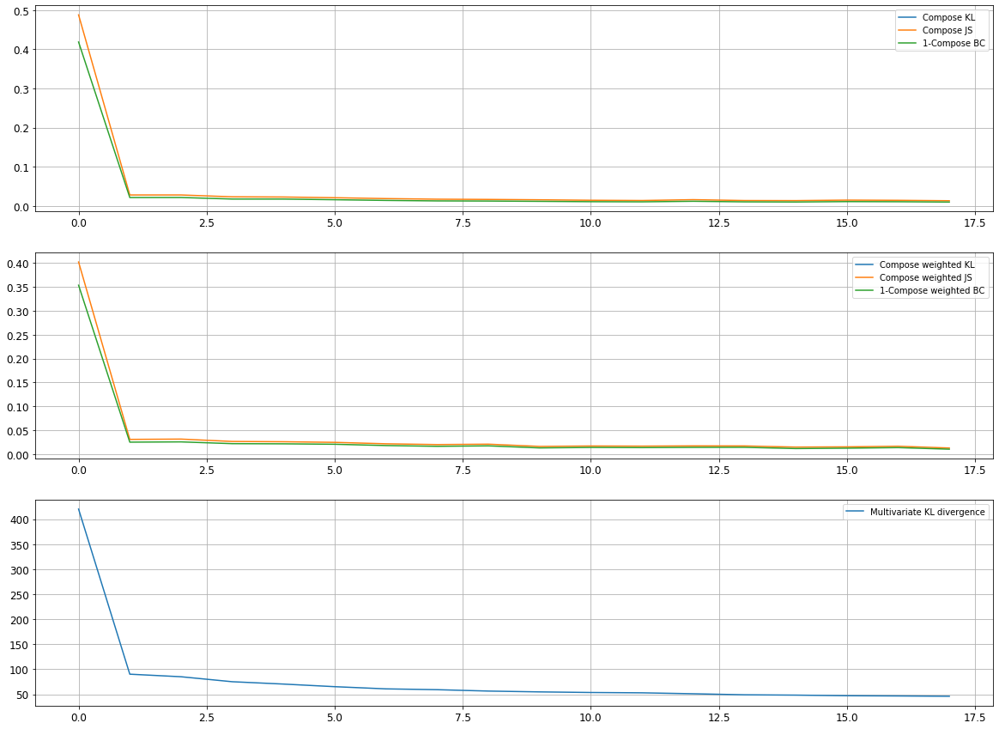

Epoch 3402/10000
discriminator loss: 0.053769 - generator loss: 7.405559 - 28s
Epoch 3403/10000
discriminator loss: 0.108879 - generator loss: 7.256703 - 25s
Epoch 3404/10000
discriminator loss: 0.062369 - generator loss: 7.347202 - 23s
Epoch 3405/10000
discriminator loss: 0.349373 - generator loss: 6.919446 - 23s
Epoch 3406/10000
discriminator loss: 0.049306 - generator loss: 7.468706 - 23s
Epoch 3407/10000
discriminator loss: 0.316444 - generator loss: 6.904367 - 23s
Epoch 3408/10000
discriminator loss: 0.052048 - generator loss: 7.435166 - 23s
Epoch 3409/10000
discriminator loss: 0.053267 - generator loss: 7.515102 - 23s
Epoch 3410/10000
discriminator loss: 0.212420 - generator loss: 7.017398 - 23s
Epoch 3411/10000
discriminator loss: 0.051295 - generator loss: 7.449891 - 28s
Epoch 3412/10000
discriminator loss: 0.282882 - generator loss: 7.350877 - 29s
Epoch 3413/10000
discriminator loss: 0.068371 - generator loss: 7.028913 - 29s
Epoch 3414/10000
discriminator loss: 0.047425 - gene

discriminator loss: 0.240254 - generator loss: 7.221162 - 29s
Epoch 3507/10000
discriminator loss: 0.054794 - generator loss: 7.389918 - 28s
Epoch 3508/10000
discriminator loss: 0.195223 - generator loss: 7.103217 - 28s
Epoch 3509/10000
discriminator loss: 0.045370 - generator loss: 7.594570 - 28s
Epoch 3510/10000
discriminator loss: 0.372305 - generator loss: 7.174964 - 28s
Epoch 3511/10000
discriminator loss: 0.058841 - generator loss: 7.149441 - 29s
Epoch 3512/10000
discriminator loss: 0.050519 - generator loss: 7.541852 - 28s
Epoch 3513/10000
discriminator loss: 0.211390 - generator loss: 7.043919 - 28s
Epoch 3514/10000
discriminator loss: 0.047390 - generator loss: 7.606092 - 28s
Epoch 3515/10000
discriminator loss: 0.271562 - generator loss: 7.289247 - 28s
Epoch 3516/10000
discriminator loss: 0.077678 - generator loss: 7.110427 - 28s
Epoch 3517/10000
discriminator loss: 0.047402 - generator loss: 7.591261 - 28s
Epoch 3518/10000
discriminator loss: 0.244158 - generator loss: 7.018

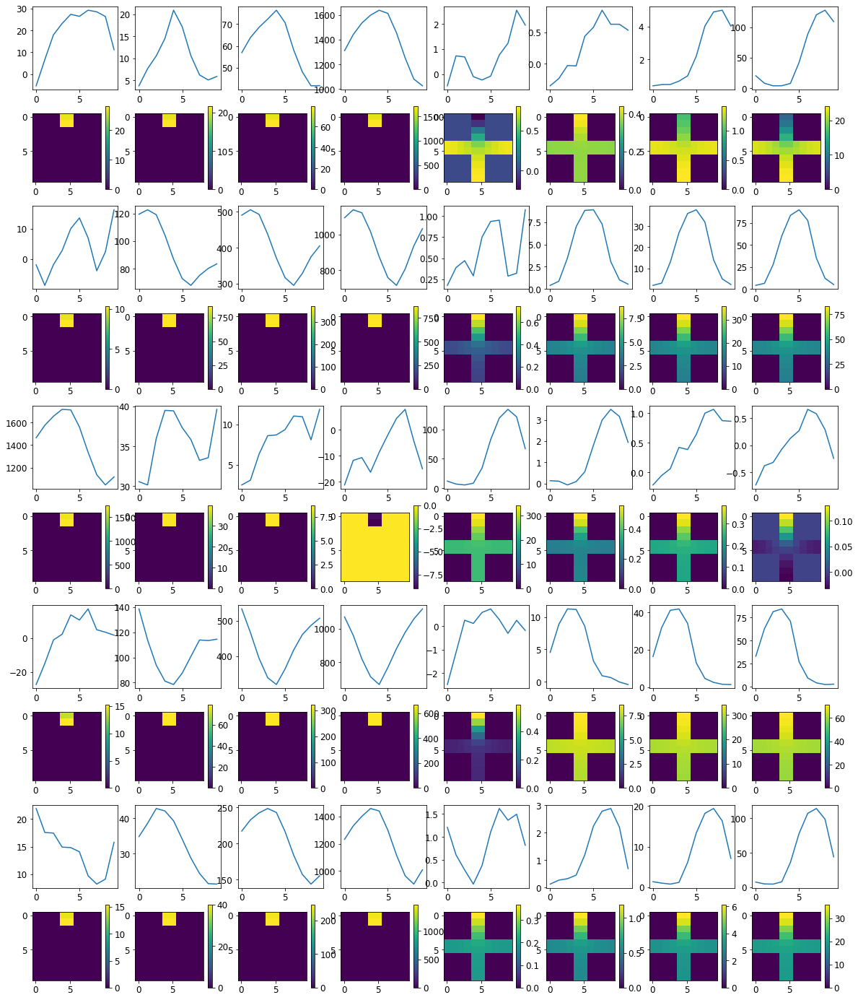


R0 generated:
[[19.70376    17.930874  ]
 [19.689857   17.904764  ]
 [19.6969     17.82776   ]
 [19.68712    17.829725  ]
 [19.692827   17.83868   ]
 [19.69234    17.806108  ]
 [19.703188   17.856627  ]
 [19.693861   17.874002  ]
 [19.681858   17.846167  ]
 [19.678463   17.985043  ]
 [17.08603     0.6130827 ]
 [16.99887     0.60044056]
 [17.041569    0.58118355]
 [17.040909    0.56978625]
 [17.092407    0.56791335]
 [17.116295    0.5605103 ]
 [17.13731     0.5225183 ]
 [17.099066    0.5267918 ]
 [17.218271    0.5426971 ]
 [17.123512    0.54581726]
 [17.335508    0.9638578 ]
 [17.334455    0.8826591 ]
 [17.413134    0.8842445 ]
 [17.387945    0.86494964]
 [17.40151     0.872288  ]
 [17.395166    0.8845075 ]
 [17.422981    0.8762974 ]
 [17.425732    0.90623564]
 [17.489279    0.9462551 ]
 [17.443195    0.79730165]
 [19.750969   17.100542  ]
 [19.742237   17.042843  ]
 [19.729795   16.965618  ]
 [19.721813   16.913025  ]
 [19.728802   16.879028  ]
 [19.721998   16.79791   ]
 [19.740181  

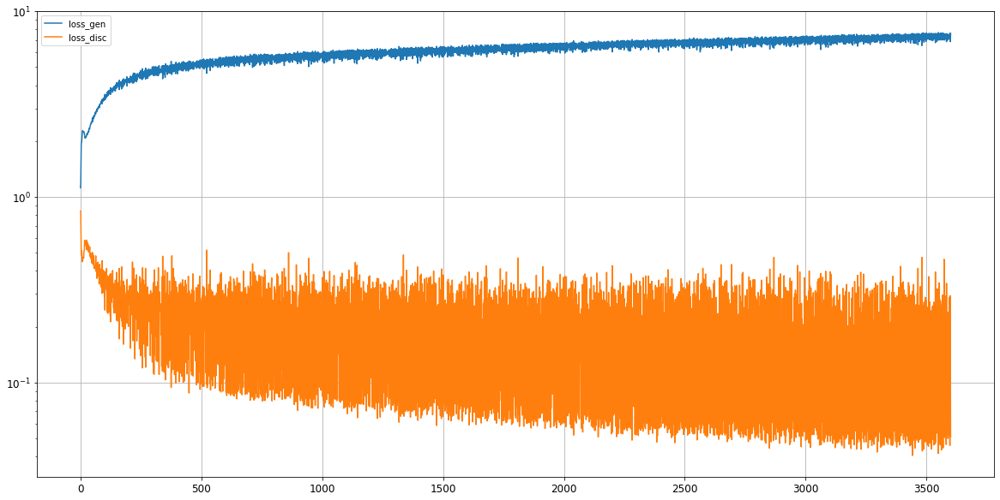

0: mean KL divergence (r,g) = 0.025096228523906805
0: mean JS divergence = 0.00685769135100355
0: mean 1-BC divergence = 0.005167895121401922

0: std KL divergence (r,g) = 0.059524167200055315
0: std JS divergence = 0.016520518173454568
0: std 1-BC divergence = 0.01374092116023129


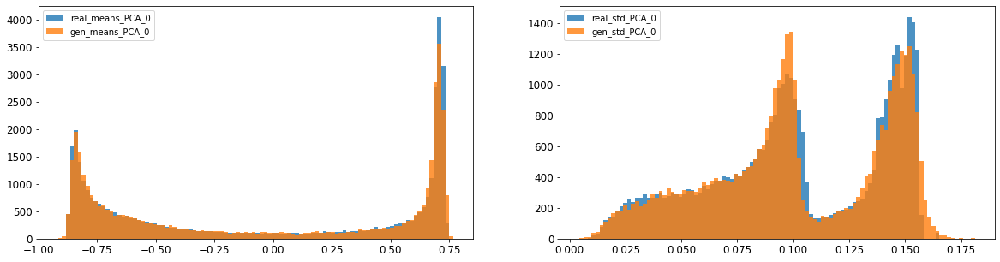

1: mean KL divergence (r,g) = 0.018269345381934914
1: mean JS divergence = 0.004492763132033523
1: mean 1-BC divergence = 0.0032262993300623544

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.010132346296625572
1: std 1-BC divergence = 0.0072876079774941704


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


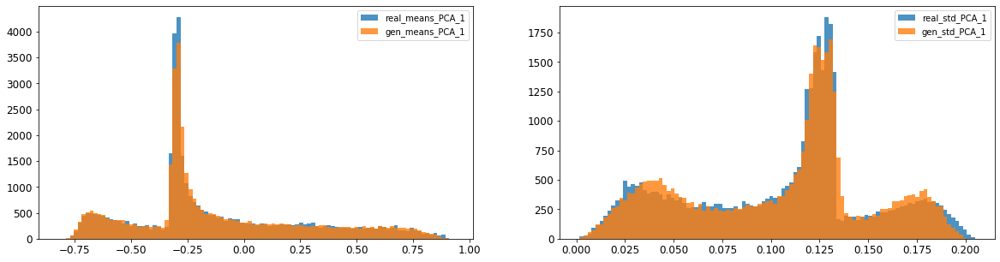

2: mean KL divergence (r,g) = inf
2: mean JS divergence = 0.003791491751889855
2: mean 1-BC divergence = 0.002763031309113262

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.009793988699902471
2: std 1-BC divergence = 0.008197139925499086


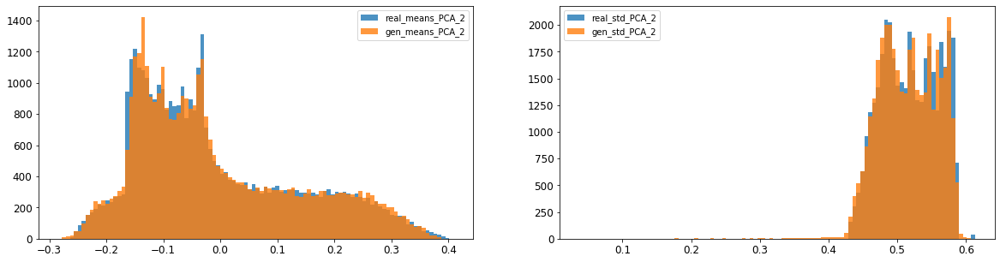

3: mean KL divergence (r,g) = 0.07787477998604637
3: mean JS divergence = 0.020197777865817897
3: mean 1-BC divergence = 0.014461596464010684

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.08655981165042101
3: std 1-BC divergence = 0.06474526941801673


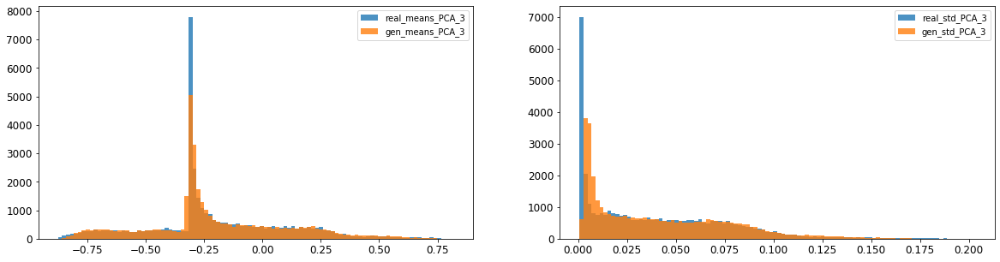

4: mean KL divergence (r,g) = 0.02982080287175544
4: mean JS divergence = 0.007909515661731821
4: mean 1-BC divergence = 0.005895000275748408

4: std KL divergence (r,g) = 0.03596987804319222
4: std JS divergence = 0.008529902547437296
4: std 1-BC divergence = 0.0060107726380984605


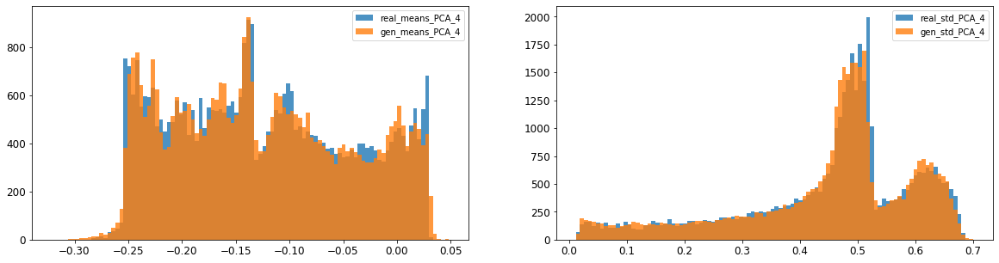

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.017527693865826838
5: mean 1-BC divergence = 0.013041973969054266

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.013618292620314078
5: std 1-BC divergence = 0.011190715424882147


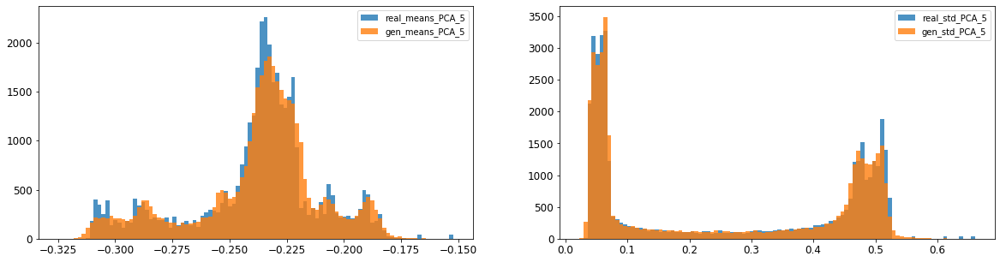

6: mean KL divergence (r,g) = 0.02037617986236562
6: mean JS divergence = 0.004984103290442243
6: mean 1-BC divergence = 0.003516285807152353

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.009079298900594012
6: std 1-BC divergence = 0.006626905260085469


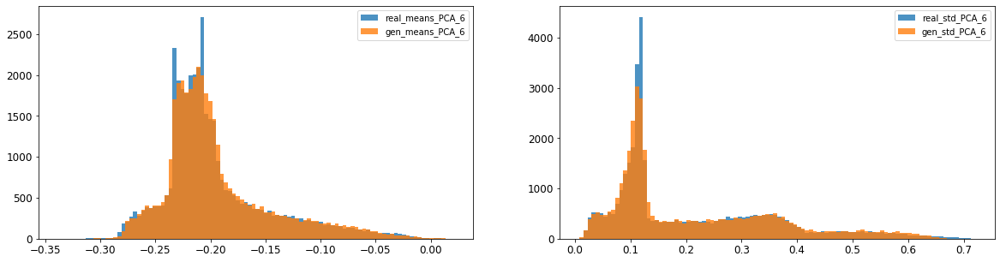

7: mean KL divergence (r,g) = 0.059602833396661344
7: mean JS divergence = 0.015666089512278384
7: mean 1-BC divergence = 0.011847006380852898

7: std KL divergence (r,g) = 0.03320151862520461
7: std JS divergence = 0.008090395472450447
7: std 1-BC divergence = 0.005674842842246064


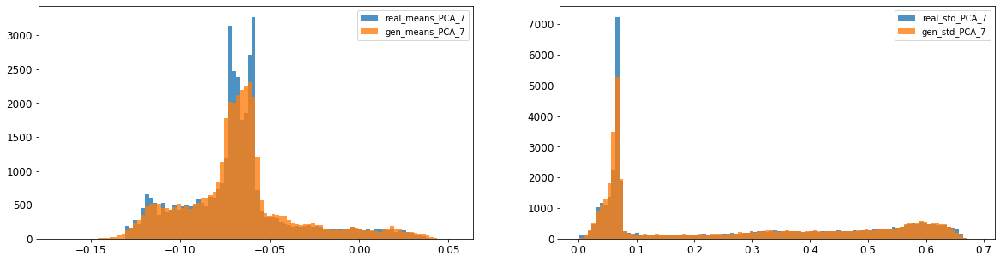

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0026238909471899925
8: mean 1-BC divergence = 0.001849957363395549

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.01031489525852204
8: std 1-BC divergence = 0.007352466521895251


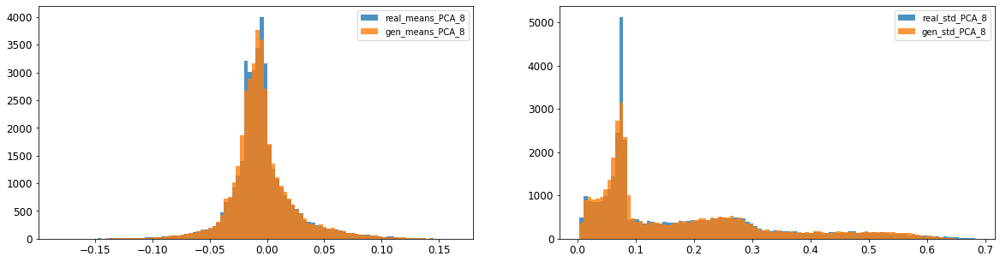

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003785406629036506
9: mean 1-BC divergence = 0.0027213285448447477

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.012475112775486906
9: std 1-BC divergence = 0.0089038036098803


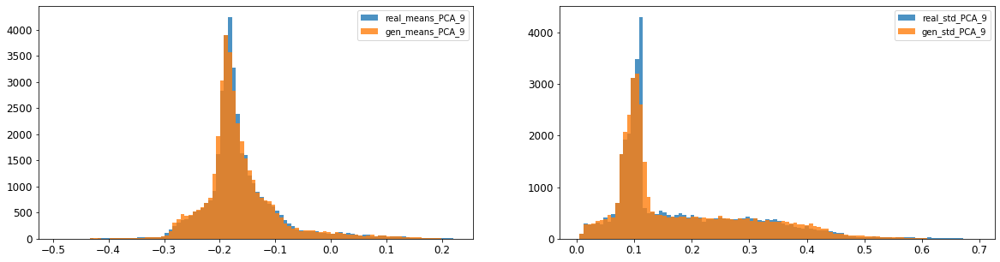

10: mean KL divergence (r,g) = 0.02318803581796235
10: mean JS divergence = 0.005850695918545328
10: mean 1-BC divergence = 0.004131266499129427

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.006090324526075089
10: std 1-BC divergence = 0.005012833577192288


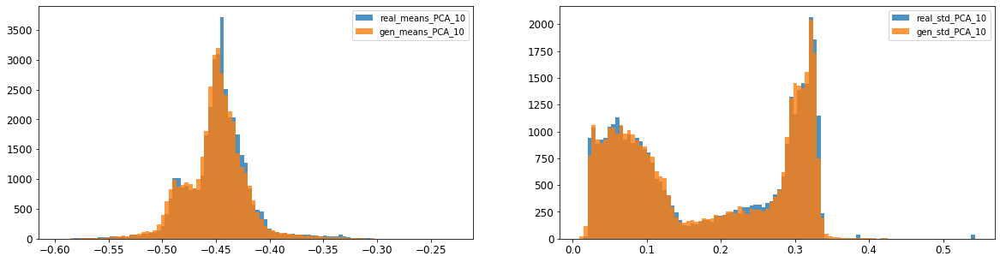

11: mean KL divergence (r,g) = 0.027445543793366067
11: mean JS divergence = 0.007028719207413836
11: mean 1-BC divergence = 0.004933462400680266

11: std KL divergence (r,g) = 0.033346988018452234
11: std JS divergence = 0.008655852746087852
11: std 1-BC divergence = 0.006126657616936093


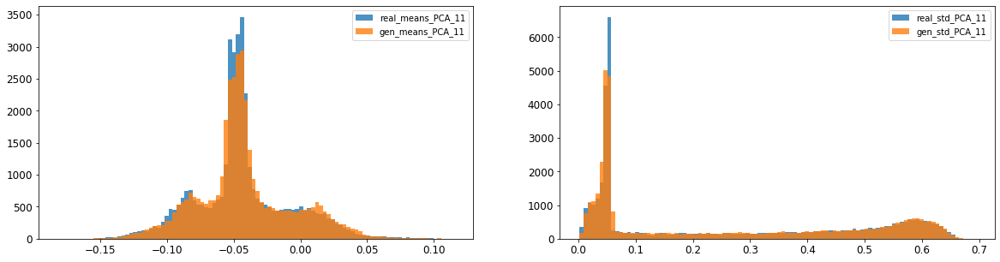

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004995118252455582
12: mean 1-BC divergence = 0.0035205481101961977

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.02066372605907259
12: std 1-BC divergence = 0.0146972431280038


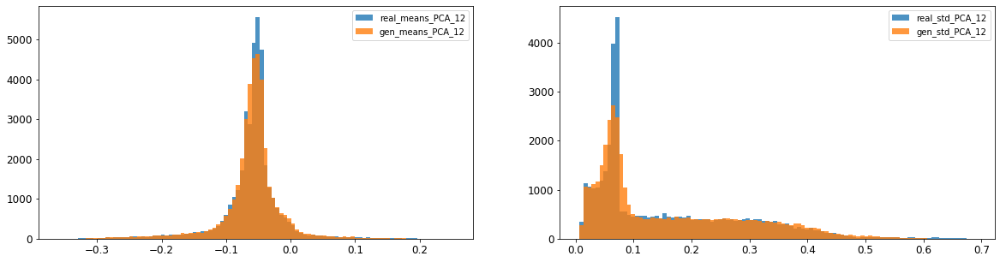

13: mean KL divergence (r,g) = 0.04545585987685491
13: mean JS divergence = 0.011206813387535656
13: mean 1-BC divergence = 0.007814782672705745

13: std KL divergence (r,g) = 0.06613729325802929
13: std JS divergence = 0.016638141731777953
13: std 1-BC divergence = 0.011674717944169632


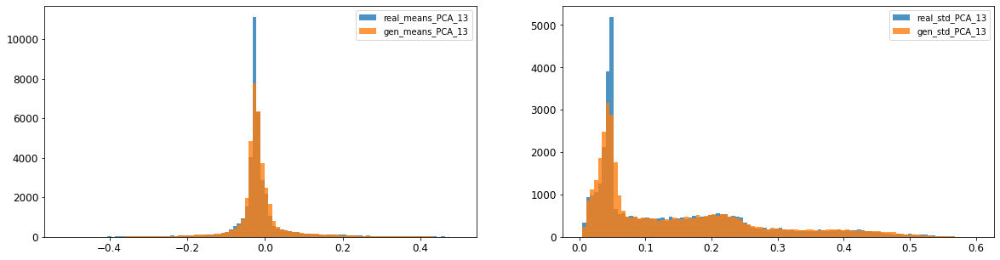

14: mean KL divergence (r,g) = 0.03864363547471713
14: mean JS divergence = 0.009737105156533248
14: mean 1-BC divergence = 0.006873984739147576

14: std KL divergence (r,g) = 0.03261377012286581
14: std JS divergence = 0.008192109647673307
14: std 1-BC divergence = 0.005719710100187014


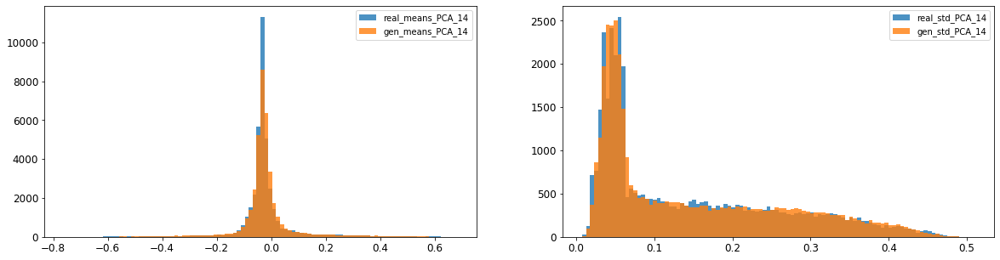

15: mean KL divergence (r,g) = 1.7334713513321491
15: mean JS divergence = 0.47122291285463347
15: mean 1-BC divergence = 0.4309612746057109

15: std KL divergence (r,g) = 5.682573297347578
15: std JS divergence = 0.9304982185526032
15: std 1-BC divergence = 0.8604636069535131


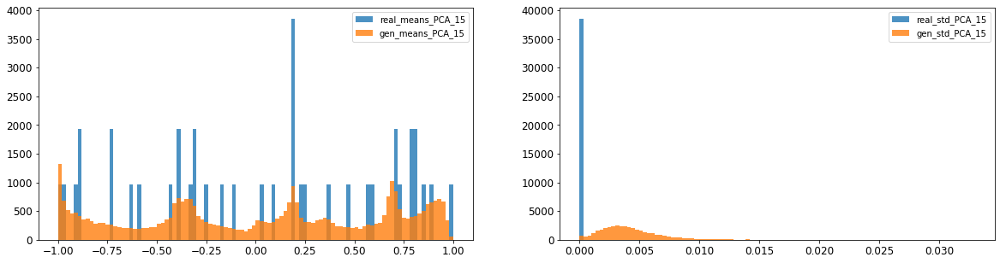

16: mean KL divergence (r,g) = 1.4093167872750265
16: mean JS divergence = 0.39680950375979485
16: mean 1-BC divergence = 0.36512609336488444

16: std KL divergence (r,g) = 5.591268389802845
16: std JS divergence = 0.926894989220592
16: std 1-BC divergence = 0.8559775314632956


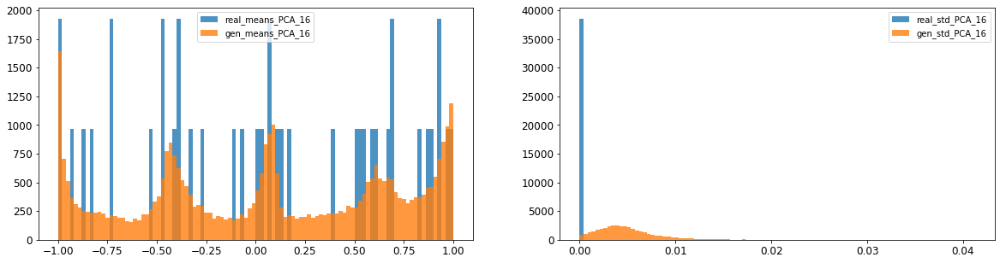



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.012400319767854313
Compose 1-BC divergence = 0.009157534204410567

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.012238656422436276
Compose weighted 1-BC divergence = 0.009517703732530025

Multivariate KL divergence = 44.94735888495162


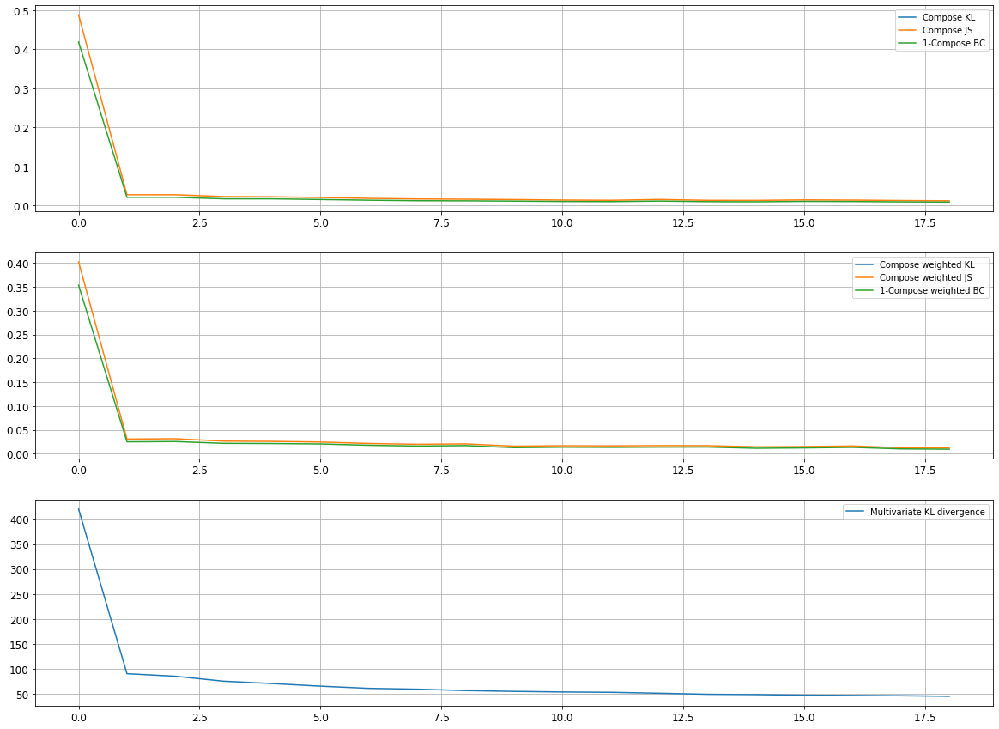

Epoch 3602/10000
discriminator loss: 0.047387 - generator loss: 7.596613 - 27s
Epoch 3603/10000
discriminator loss: 0.322545 - generator loss: 6.954577 - 28s
Epoch 3604/10000
discriminator loss: 0.045290 - generator loss: 7.542695 - 28s
Epoch 3605/10000
discriminator loss: 0.051055 - generator loss: 7.539751 - 28s
Epoch 3606/10000
discriminator loss: 0.203378 - generator loss: 7.105938 - 28s
Epoch 3607/10000
discriminator loss: 0.047517 - generator loss: 7.559294 - 29s
Epoch 3608/10000
discriminator loss: 0.239873 - generator loss: 7.369014 - 29s
Epoch 3609/10000
discriminator loss: 0.065328 - generator loss: 7.278942 - 27s
Epoch 3610/10000
discriminator loss: 0.051507 - generator loss: 7.594268 - 23s
Epoch 3611/10000
discriminator loss: 0.233843 - generator loss: 7.098924 - 23s
Epoch 3612/10000
discriminator loss: 0.046553 - generator loss: 7.668890 - 23s
Epoch 3613/10000
discriminator loss: 0.312582 - generator loss: 7.157976 - 23s
Epoch 3614/10000
discriminator loss: 0.061547 - gene

discriminator loss: 0.245479 - generator loss: 7.089582 - 29s
Epoch 3707/10000
discriminator loss: 0.045840 - generator loss: 7.570296 - 28s
Epoch 3708/10000
discriminator loss: 0.053201 - generator loss: 7.606701 - 28s
Epoch 3709/10000
discriminator loss: 0.338764 - generator loss: 7.152791 - 28s
Epoch 3710/10000
discriminator loss: 0.058402 - generator loss: 7.401146 - 28s
Epoch 3711/10000
discriminator loss: 0.048458 - generator loss: 7.690102 - 28s
Epoch 3712/10000
discriminator loss: 0.242043 - generator loss: 7.161564 - 28s
Epoch 3713/10000
discriminator loss: 0.051350 - generator loss: 7.604618 - 29s
Epoch 3714/10000
discriminator loss: 0.057753 - generator loss: 7.609115 - 28s
Epoch 3715/10000
discriminator loss: 0.343891 - generator loss: 6.990778 - 29s
Epoch 3716/10000
discriminator loss: 0.046689 - generator loss: 7.655127 - 28s
Epoch 3717/10000
discriminator loss: 0.045967 - generator loss: 7.700651 - 28s
Epoch 3718/10000
discriminator loss: 0.273909 - generator loss: 6.996

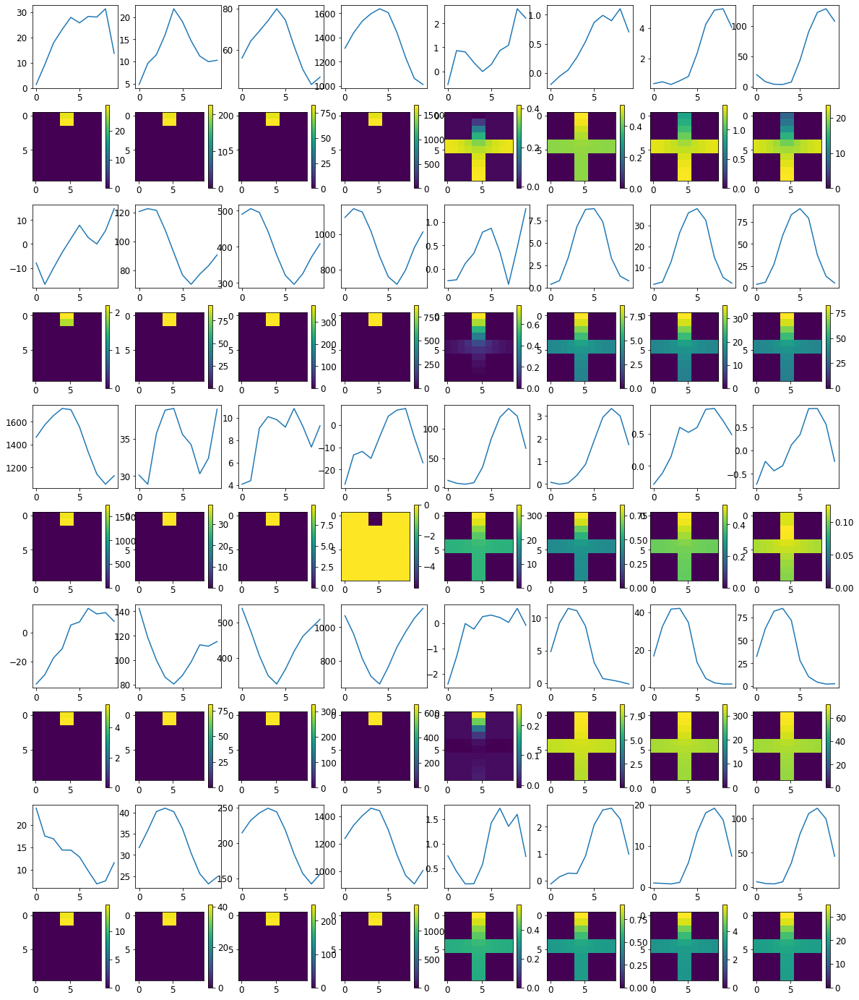


R0 generated:
[[19.699093   17.800419  ]
 [19.688875   17.740957  ]
 [19.695318   17.671158  ]
 [19.690548   17.651623  ]
 [19.695372   17.646757  ]
 [19.699127   17.594973  ]
 [19.708105   17.689531  ]
 [19.69968    17.66293   ]
 [19.688395   17.6451    ]
 [19.689648   17.802532  ]
 [17.189985    0.3928503 ]
 [17.152248    0.37079212]
 [17.22068     0.35486236]
 [17.24832     0.33915883]
 [17.260355    0.33825037]
 [17.276531    0.3387116 ]
 [17.222155    0.32181796]
 [17.228426    0.321671  ]
 [17.309303    0.33250272]
 [17.24205     0.3388148 ]
 [17.2938      0.78789854]
 [17.349798    0.7124976 ]
 [17.393368    0.72091293]
 [17.410225    0.6950984 ]
 [17.448545    0.7252524 ]
 [17.462736    0.7383926 ]
 [17.443861    0.75002664]
 [17.441813    0.78506875]
 [17.435354    0.80725634]
 [17.443453    0.68642944]
 [19.75373    16.92389   ]
 [19.746435   16.816366  ]
 [19.733482   16.780968  ]
 [19.728693   16.757742  ]
 [19.736519   16.799658  ]
 [19.733366   16.71932   ]
 [19.747143  

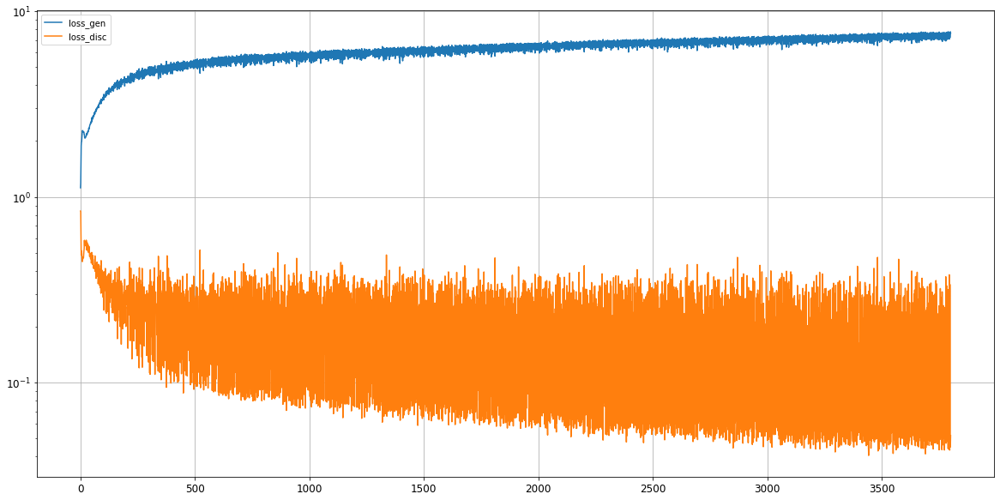

0: mean KL divergence (r,g) = 0.034128213869797405
0: mean JS divergence = 0.009501007420864443
0: mean 1-BC divergence = 0.007583639143102006

0: std KL divergence (r,g) = 0.0583013345773137
0: std JS divergence = 0.017341310014603522
0: std 1-BC divergence = 0.015529699361621074


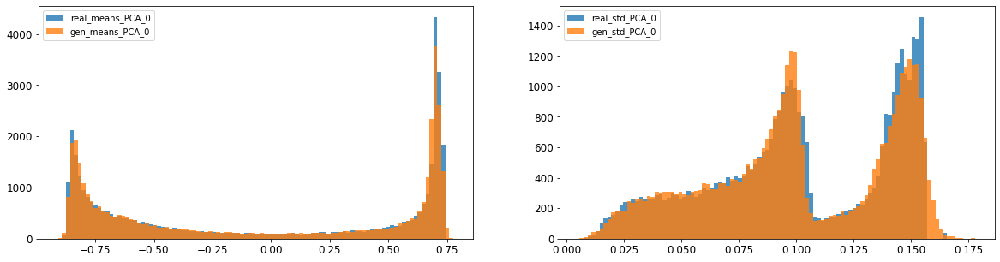

1: mean KL divergence (r,g) = 0.019413687226009137
1: mean JS divergence = 0.005048680872382564
1: mean 1-BC divergence = 0.003631465890566843

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.01053273528659348
1: std 1-BC divergence = 0.007757052248893115


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


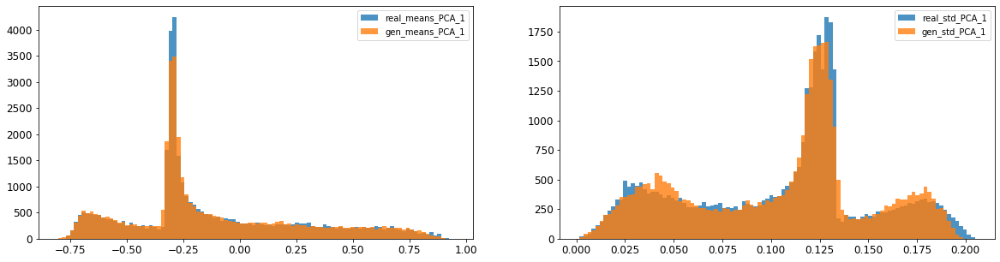

2: mean KL divergence (r,g) = 0.013140491926329604
2: mean JS divergence = 0.00327649411230973
2: mean 1-BC divergence = 0.0023574411713677135

2: std KL divergence (r,g) = 0.031700886704729835
2: std JS divergence = 0.008768798928735005
2: std 1-BC divergence = 0.007735785762228442


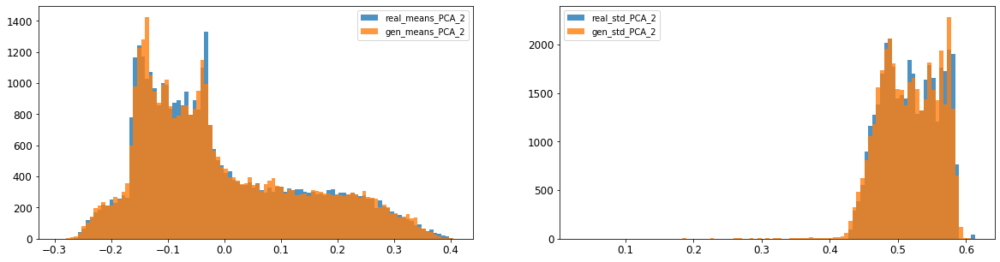

3: mean KL divergence (r,g) = 0.08184283454856524
3: mean JS divergence = 0.020830872728868688
3: mean 1-BC divergence = 0.015000883517030661

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.062150038762364565
3: std 1-BC divergence = 0.04479751493014372


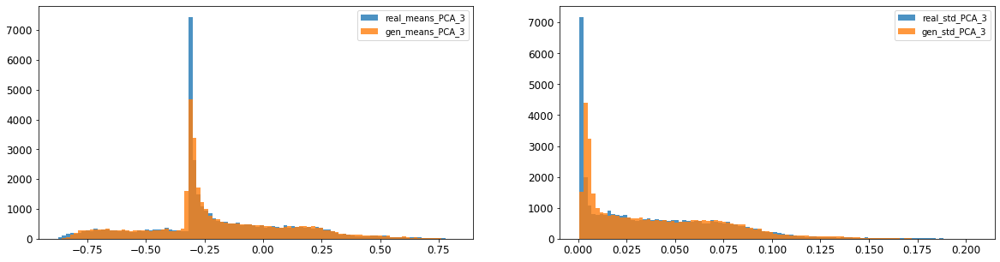

4: mean KL divergence (r,g) = 0.042231767435901506
4: mean JS divergence = 0.011158856112821188
4: mean 1-BC divergence = 0.008609728963179353

4: std KL divergence (r,g) = 0.022333248593339124
4: std JS divergence = 0.005319044013540615
4: std 1-BC divergence = 0.0037453866385648293


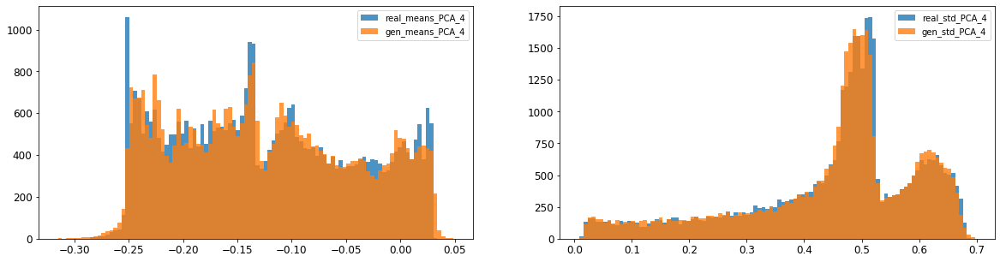

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.0173315530004007
5: mean 1-BC divergence = 0.012664521419271435

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.01015141321592268
5: std 1-BC divergence = 0.009038310029462981


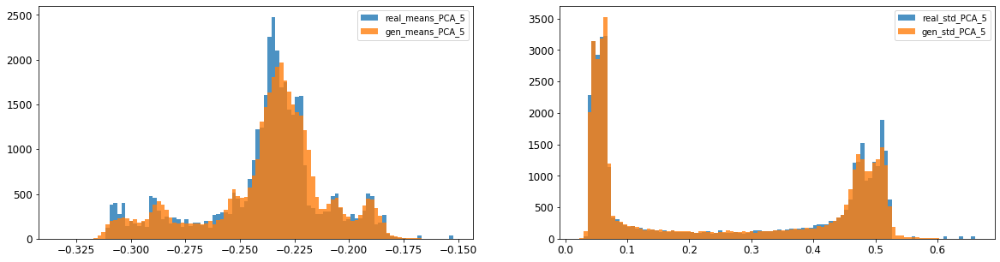

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0047005276634582895
6: mean 1-BC divergence = 0.003318015898230997

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.010489217216930299
6: std 1-BC divergence = 0.007536354489312447


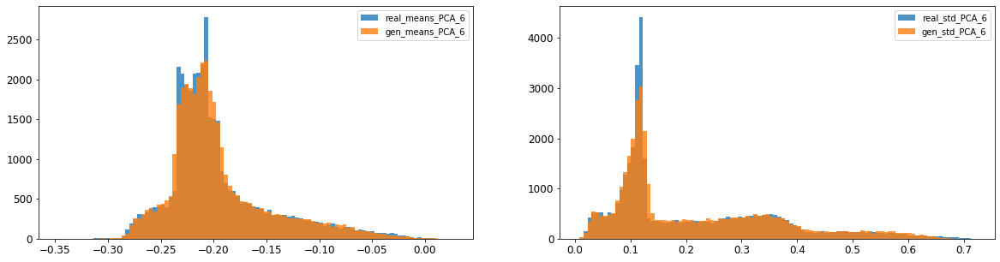

7: mean KL divergence (r,g) = 0.05676589380409956
7: mean JS divergence = 0.014383900336413175
7: mean 1-BC divergence = 0.010815856681680391

7: std KL divergence (r,g) = 0.025711574106367693
7: std JS divergence = 0.00623149633993865
7: std 1-BC divergence = 0.004391417716851476


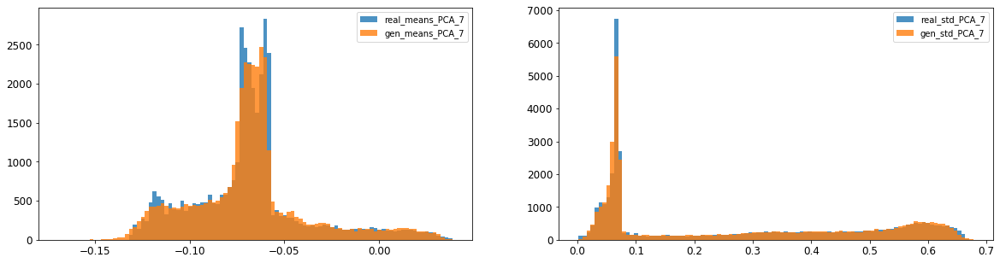

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002768942769801666
8: mean 1-BC divergence = 0.00195190466956352

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.011495758504710242
8: std 1-BC divergence = 0.008090477246848748


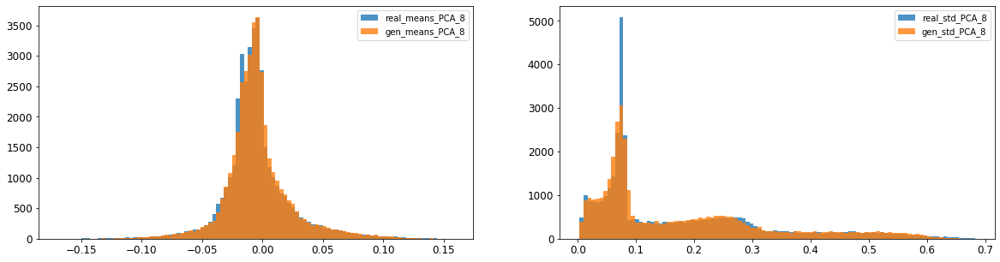

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003907954518587964
9: mean 1-BC divergence = 0.0027503876313301756

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.012412189167169853
9: std 1-BC divergence = 0.008808894686804458


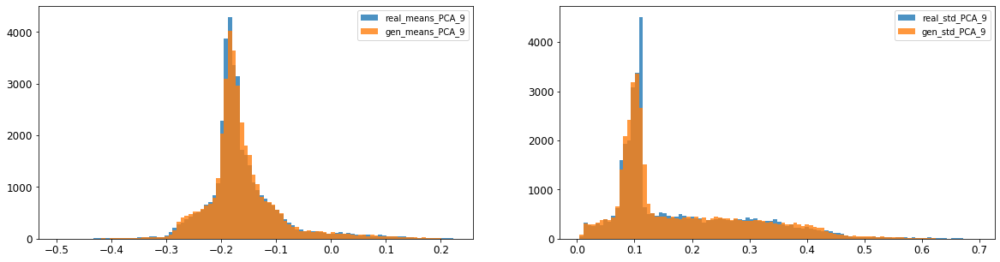

10: mean KL divergence (r,g) = 0.018808478705604606
10: mean JS divergence = 0.004519883781285311
10: mean 1-BC divergence = 0.0031653658943286977

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005043160899517521
10: std 1-BC divergence = 0.0043185165195915864


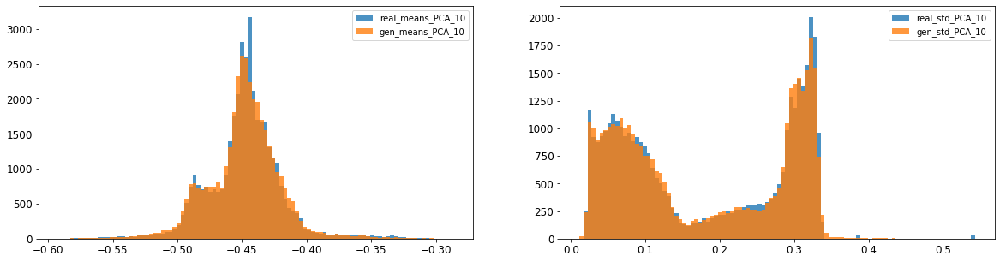

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.005093424225306804
11: mean 1-BC divergence = 0.0036354310508400767

11: std KL divergence (r,g) = 0.055181591357022074
11: std JS divergence = 0.01451179305649276
11: std 1-BC divergence = 0.010335482577447208


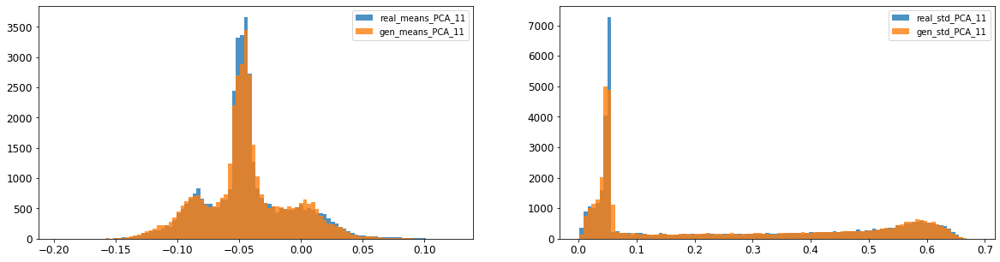

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004869359302214746
12: mean 1-BC divergence = 0.003436635422285894

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01989106697938435
12: std 1-BC divergence = 0.014099741474289496


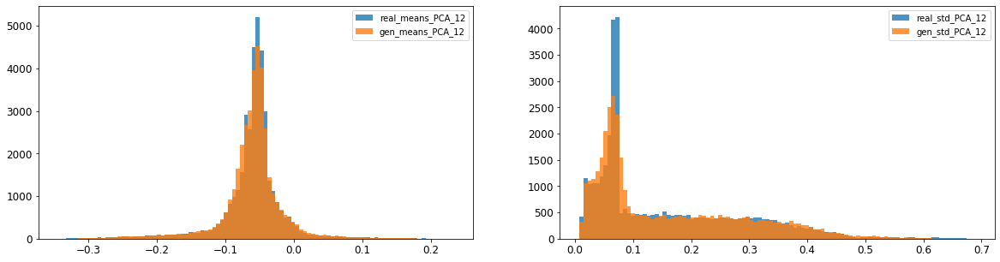

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.014187809840767434
13: mean 1-BC divergence = 0.00995337906397653

13: std KL divergence (r,g) = 0.07046667530566267
13: std JS divergence = 0.01747455142915226
13: std 1-BC divergence = 0.012264401195087427


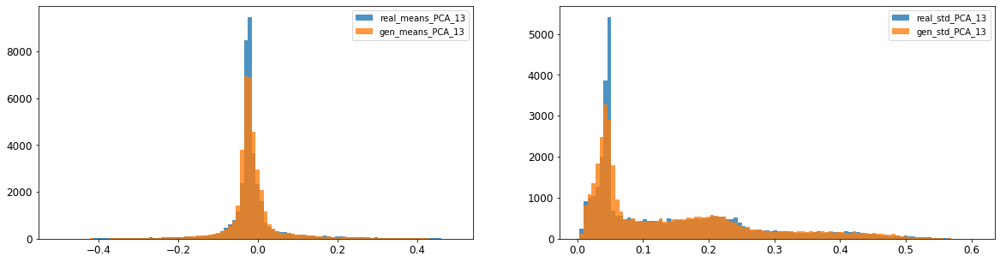

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.011955848316424777
14: mean 1-BC divergence = 0.008399669919575192

14: std KL divergence (r,g) = 0.028946148987163547
14: std JS divergence = 0.007267757457352359
14: std 1-BC divergence = 0.0050740978021813765


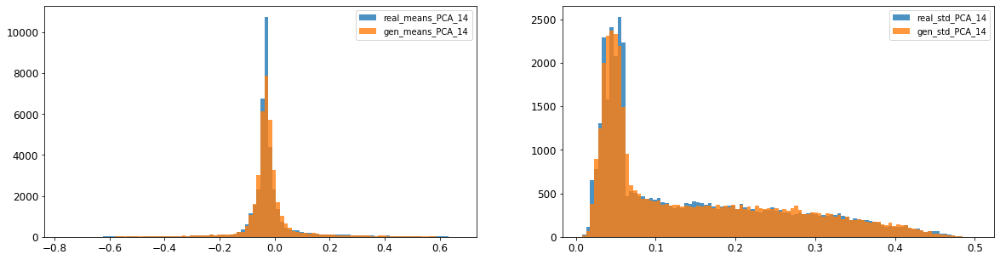

15: mean KL divergence (r,g) = 1.738084616717015
15: mean JS divergence = 0.4692676102218255
15: mean 1-BC divergence = 0.4295868500368708

15: std KL divergence (r,g) = 6.050925729326293
15: std JS divergence = 0.9434049392099364
15: std 1-BC divergence = 0.8771868340611091


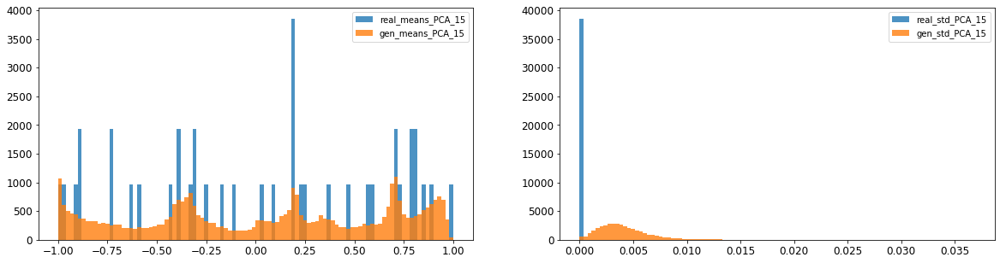

16: mean KL divergence (r,g) = 1.423425782030264
16: mean JS divergence = 0.39849255446431564
16: mean 1-BC divergence = 0.36649039481308476

16: std KL divergence (r,g) = 5.389399031441787
16: std JS divergence = 0.9182971717614972
16: std 1-BC divergence = 0.8455405029112363


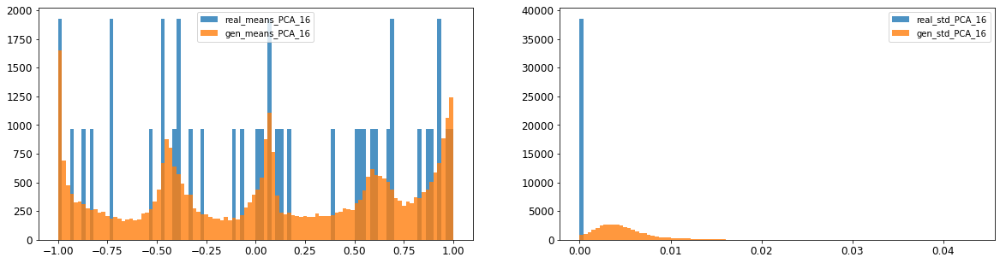



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.011753848209143854
Compose 1-BC divergence = 0.008693248633855233

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.01260248494004368
Compose weighted 1-BC divergence = 0.010236168474220486

Multivariate KL divergence = 44.19108090076677


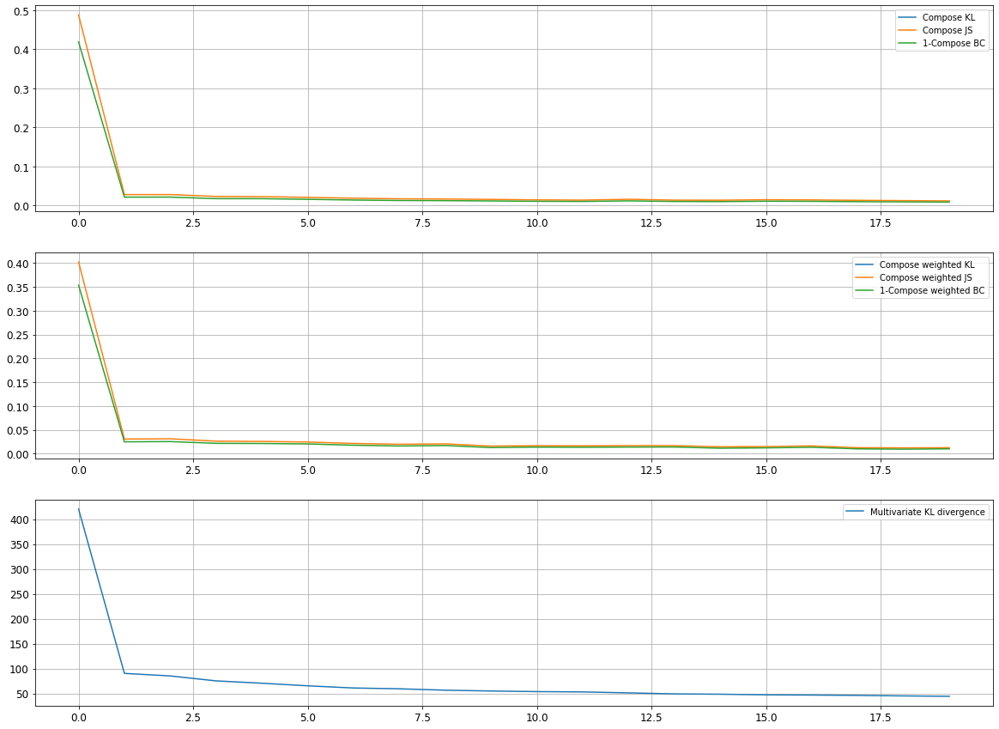

Epoch 3802/10000
discriminator loss: 0.296840 - generator loss: 7.085186 - 27s
Epoch 3803/10000
discriminator loss: 0.052896 - generator loss: 7.575134 - 28s
Epoch 3804/10000
discriminator loss: 0.042692 - generator loss: 7.761289 - 29s
Epoch 3805/10000
discriminator loss: 0.202069 - generator loss: 7.512713 - 29s
Epoch 3806/10000
discriminator loss: 0.139081 - generator loss: 7.156482 - 29s
Epoch 3807/10000
discriminator loss: 0.256187 - generator loss: 7.105878 - 29s
Epoch 3808/10000
discriminator loss: 0.042420 - generator loss: 7.718096 - 29s
Epoch 3809/10000
discriminator loss: 0.201398 - generator loss: 7.194229 - 29s
Epoch 3810/10000
discriminator loss: 0.045093 - generator loss: 7.705473 - 28s
Epoch 3811/10000
discriminator loss: 0.046755 - generator loss: 7.761929 - 29s
Epoch 3812/10000
discriminator loss: 0.296006 - generator loss: 7.183427 - 28s
Epoch 3813/10000
discriminator loss: 0.046347 - generator loss: 7.620871 - 29s
Epoch 3814/10000
discriminator loss: 0.049100 - gene

discriminator loss: 0.253152 - generator loss: 7.106224 - 29s
Epoch 3907/10000
discriminator loss: 0.052420 - generator loss: 7.719167 - 29s
Epoch 3908/10000
discriminator loss: 0.185563 - generator loss: 7.374001 - 28s
Epoch 3909/10000
discriminator loss: 0.068108 - generator loss: 7.383764 - 28s
Epoch 3910/10000
discriminator loss: 0.057510 - generator loss: 7.686132 - 29s
Epoch 3911/10000
discriminator loss: 0.252124 - generator loss: 7.121456 - 28s
Epoch 3912/10000
discriminator loss: 0.081304 - generator loss: 7.639421 - 28s
Epoch 3913/10000
discriminator loss: 0.088968 - generator loss: 7.470591 - 28s
Epoch 3914/10000
discriminator loss: 0.051304 - generator loss: 7.717152 - 28s
Epoch 3915/10000
discriminator loss: 0.233411 - generator loss: 7.245040 - 28s
Epoch 3916/10000
discriminator loss: 0.057910 - generator loss: 7.648693 - 28s
Epoch 3917/10000
discriminator loss: 0.347701 - generator loss: 7.072588 - 28s
Epoch 3918/10000
discriminator loss: 0.045922 - generator loss: 7.662

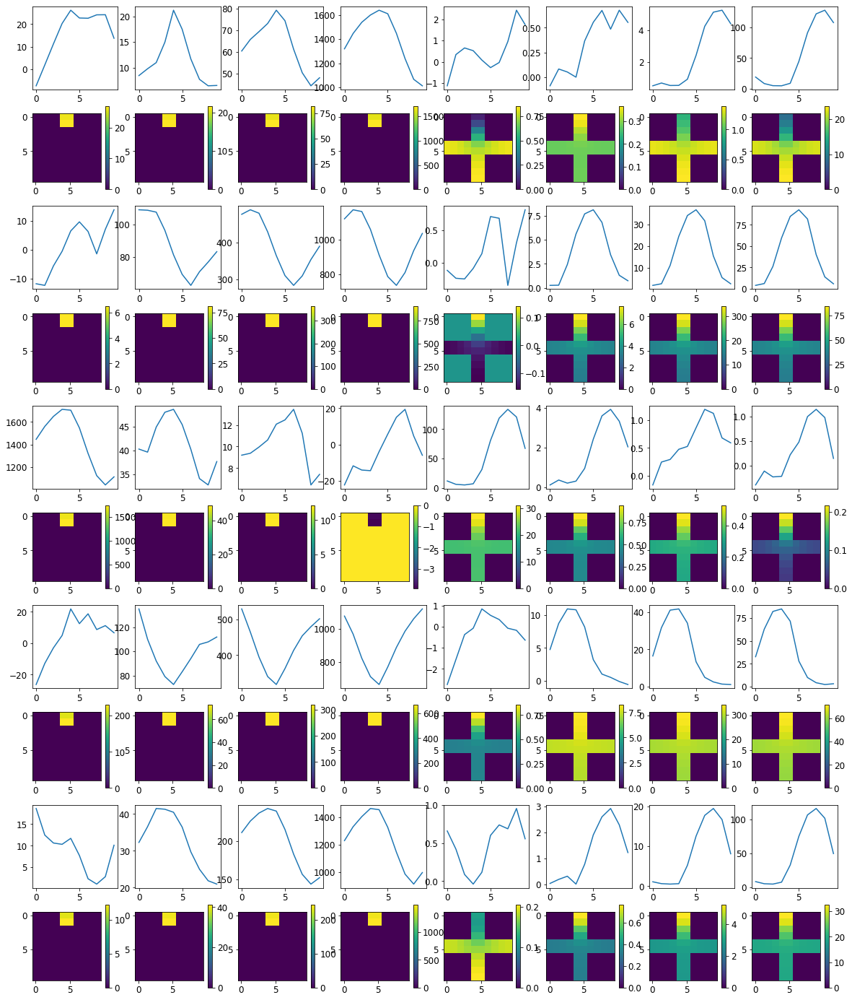


R0 generated:
[[19.657248   17.744375  ]
 [19.64653    17.70142   ]
 [19.661425   17.658808  ]
 [19.661379   17.690561  ]
 [19.662867   17.72068   ]
 [19.65973    17.703054  ]
 [19.672901   17.791807  ]
 [19.664335   17.780514  ]
 [19.644114   17.746092  ]
 [19.641254   17.897713  ]
 [17.167595    0.44242623]
 [17.078085    0.4251151 ]
 [17.16558     0.4086582 ]
 [17.157465    0.3964049 ]
 [17.135103    0.39089924]
 [17.137978    0.3943722 ]
 [17.080036    0.36379898]
 [17.076118    0.36859092]
 [17.18422     0.37607503]
 [17.096191    0.3797025 ]
 [16.930506    0.84134275]
 [16.953299    0.8090074 ]
 [16.990282    0.8245226 ]
 [16.986135    0.8249459 ]
 [16.964712    0.85097563]
 [16.962816    0.88454425]
 [16.96587     0.8906476 ]
 [16.951378    0.9254967 ]
 [16.962029    0.9330531 ]
 [17.018806    0.7842133 ]
 [19.751587   16.935179  ]
 [19.744808   16.8755    ]
 [19.735666   16.888672  ]
 [19.727018   16.872355  ]
 [19.730242   16.858267  ]
 [19.72608    16.771376  ]
 [19.73765   

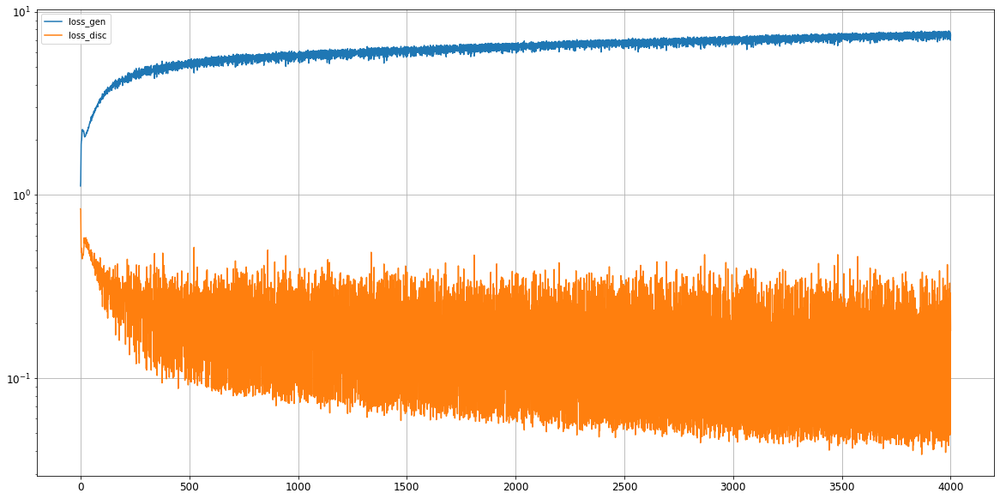

0: mean KL divergence (r,g) = 0.047130243670249435
0: mean JS divergence = 0.011599365314392977
0: mean 1-BC divergence = 0.008427743296698043

0: std KL divergence (r,g) = 0.11484859098263754
0: std JS divergence = 0.03601285843551184
0: std 1-BC divergence = 0.03272353159260888


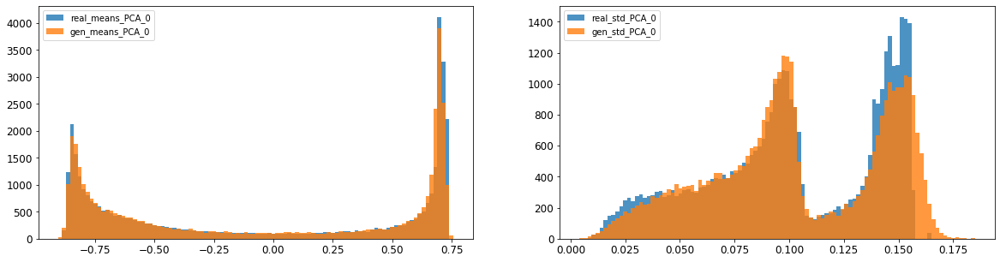

1: mean KL divergence (r,g) = 0.024468985255076625
1: mean JS divergence = 0.005996164265187155
1: mean 1-BC divergence = 0.004191836017686135

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.021397592587912254
1: std 1-BC divergence = 0.015180990037863995


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


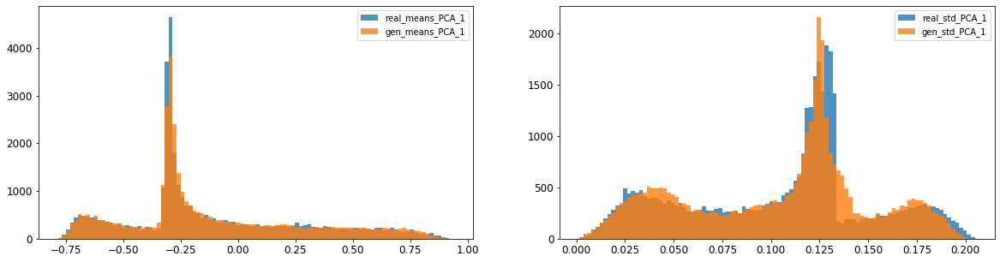

2: mean KL divergence (r,g) = inf
2: mean JS divergence = 0.0037070736480383
2: mean 1-BC divergence = 0.00276504239569042

2: std KL divergence (r,g) = 0.03271224313242354
2: std JS divergence = 0.00966125060858327
2: std 1-BC divergence = 0.008695211727312468


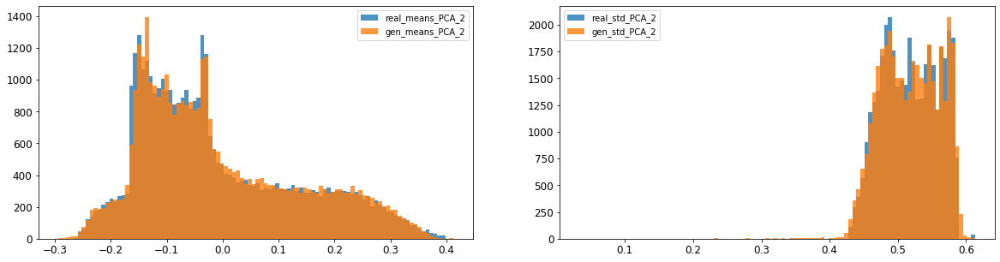

3: mean KL divergence (r,g) = 0.06155741428176042
3: mean JS divergence = 0.01443534436399993
3: mean 1-BC divergence = 0.010130963134483584

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.09697889853547267
3: std 1-BC divergence = 0.07336723153408109


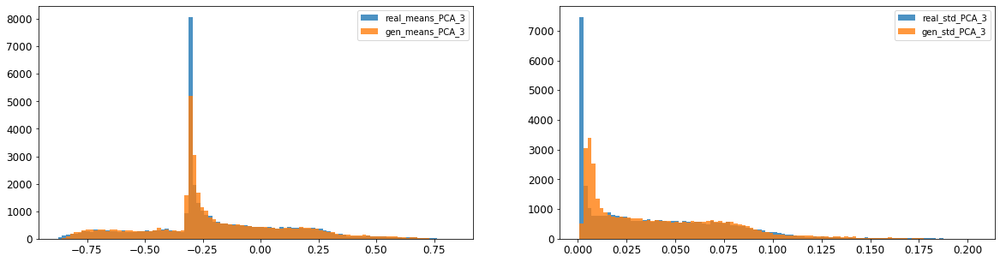

4: mean KL divergence (r,g) = 0.05219209637991002
4: mean JS divergence = 0.01407596649828842
4: mean 1-BC divergence = 0.011120579110521

4: std KL divergence (r,g) = 0.01542602542754848
4: std JS divergence = 0.0037918214330592403
4: std 1-BC divergence = 0.0027084832161979877


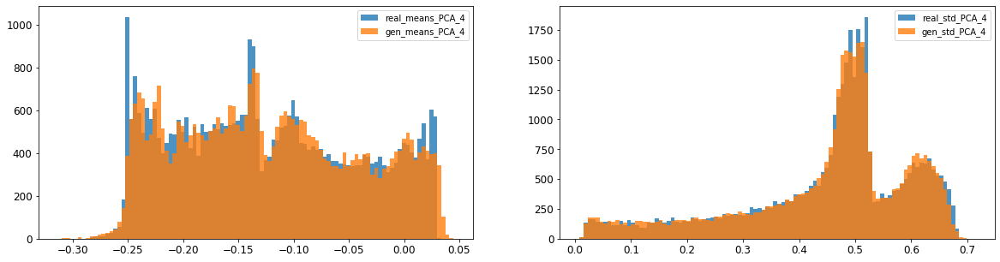

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.015349445921794106
5: mean 1-BC divergence = 0.011583193880553622

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.012830217181933428
5: std 1-BC divergence = 0.011614600248870843


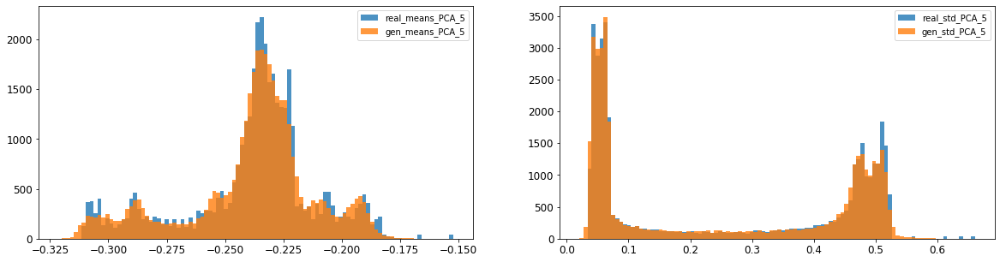

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004865212090180048
6: mean 1-BC divergence = 0.0034665443929031703

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.009150196122400218
6: std 1-BC divergence = 0.006559428480889529


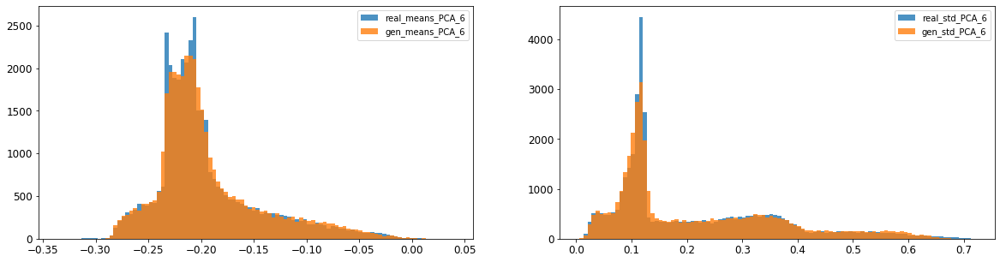

7: mean KL divergence (r,g) = 0.15237611941001228
7: mean JS divergence = 0.03242862668355272
7: mean 1-BC divergence = 0.023918012973274894

7: std KL divergence (r,g) = 0.03497718566693749
7: std JS divergence = 0.008445116140186261
7: std 1-BC divergence = 0.005971830451444338


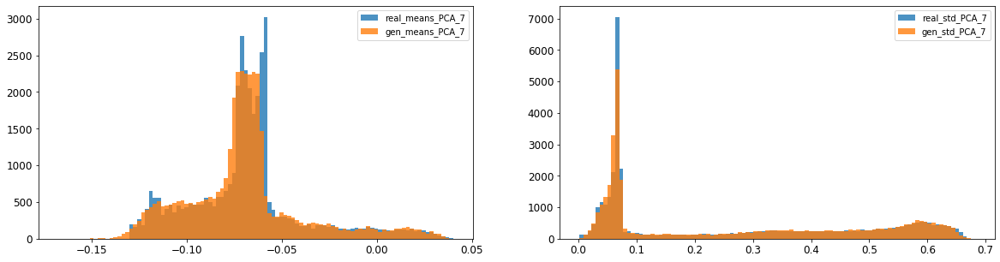

8: mean KL divergence (r,g) = 0.014570642344279069
8: mean JS divergence = 0.003711283368764853
8: mean 1-BC divergence = 0.002600140627490366

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.011199298997520039
8: std 1-BC divergence = 0.00792311908582366


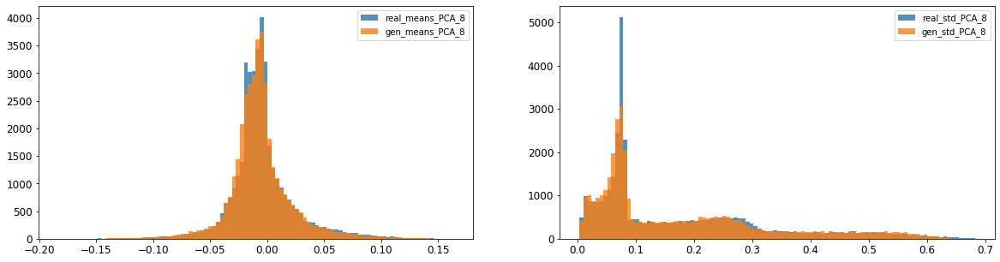

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.00436868329859121
9: mean 1-BC divergence = 0.0031309640710404096

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.011774010253403255
9: std 1-BC divergence = 0.008418848051988781


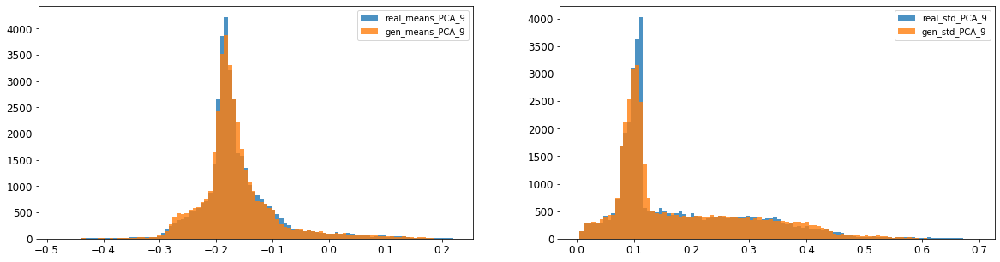

10: mean KL divergence (r,g) = 0.03118956582213469
10: mean JS divergence = 0.007648425640161899
10: mean 1-BC divergence = 0.005398463728606417

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005085576955593122
10: std 1-BC divergence = 0.004397107838998715


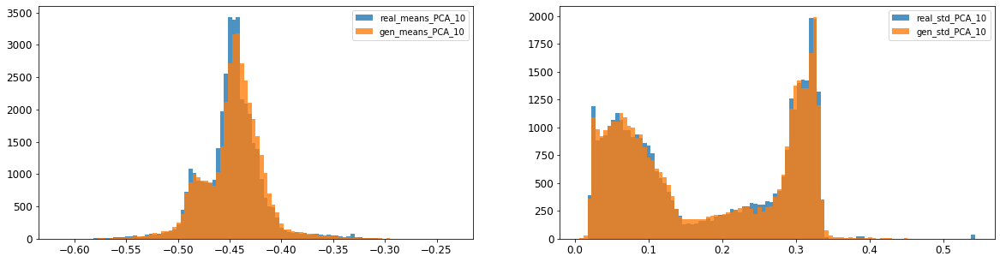

11: mean KL divergence (r,g) = 0.05413945203519042
11: mean JS divergence = 0.013863412974742305
11: mean 1-BC divergence = 0.009755699722000188

11: std KL divergence (r,g) = 0.05864136731361017
11: std JS divergence = 0.01626760261655538
11: std 1-BC divergence = 0.01177876865091776


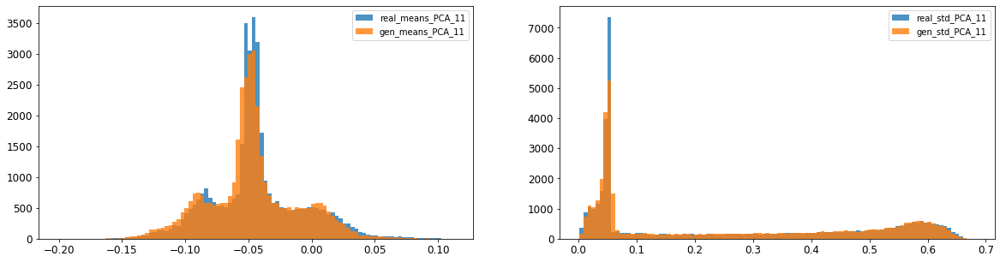

12: mean KL divergence (r,g) = 0.018418709756503768
12: mean JS divergence = 0.0046021197278456084
12: mean 1-BC divergence = 0.0032322432062148465

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.019985990950634774
12: std 1-BC divergence = 0.014127354854090668


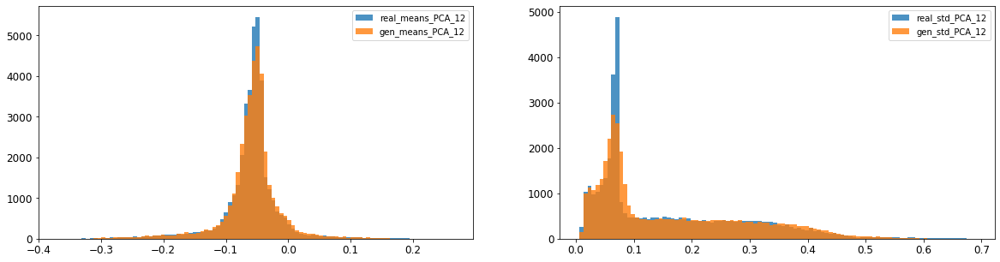

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.020421580704149518
13: mean 1-BC divergence = 0.014371820080939623

13: std KL divergence (r,g) = 0.07483465182230432
13: std JS divergence = 0.01835792318830452
13: std 1-BC divergence = 0.01287480145631903


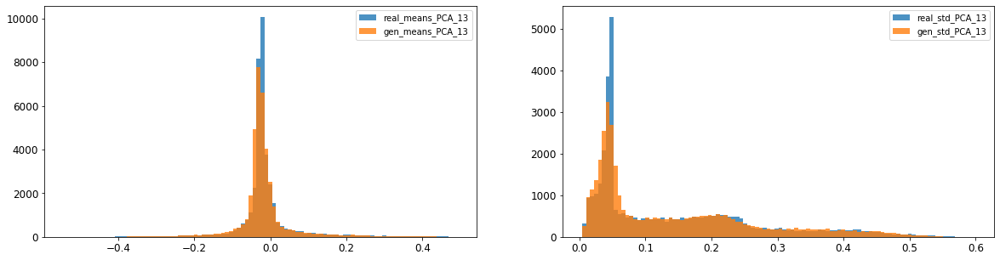

14: mean KL divergence (r,g) = 0.08440123616596733
14: mean JS divergence = 0.021027082022074976
14: mean 1-BC divergence = 0.014723345610887617

14: std KL divergence (r,g) = 0.030724228863656552
14: std JS divergence = 0.007281040009950541
14: std 1-BC divergence = 0.005093516311896806


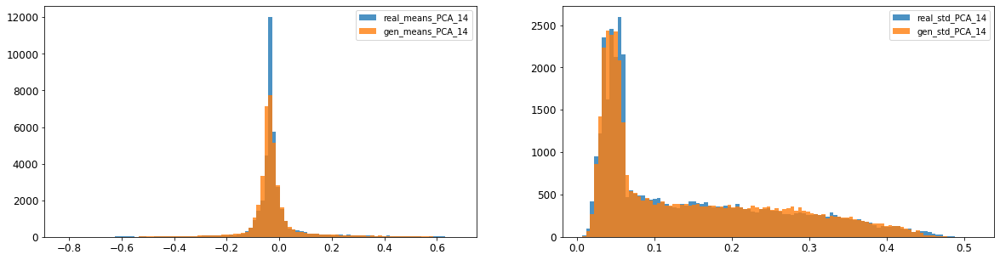

15: mean KL divergence (r,g) = 1.7682506758864072
15: mean JS divergence = 0.47737900251065146
15: mean 1-BC divergence = 0.43707650853368807

15: std KL divergence (r,g) = 6.390969739317014
15: std JS divergence = 0.9532764552331459
15: std 1-BC divergence = 0.8908400813005648


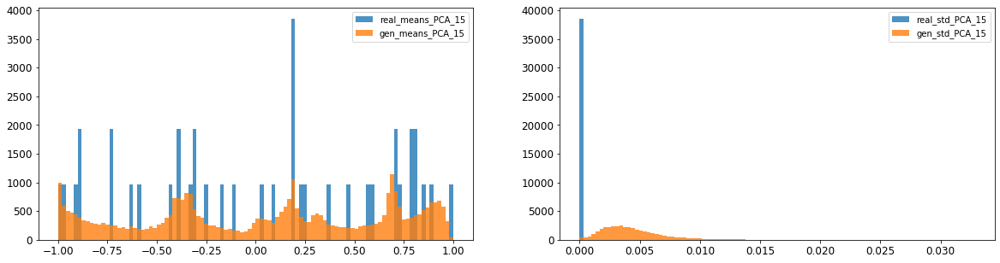

16: mean KL divergence (r,g) = 1.4095195277746526
16: mean JS divergence = 0.3954391297261409
16: mean 1-BC divergence = 0.36421609756545315

16: std KL divergence (r,g) = 5.674899369462158
16: std JS divergence = 0.9302019243521963
16: std 1-BC divergence = 0.8600920047161685


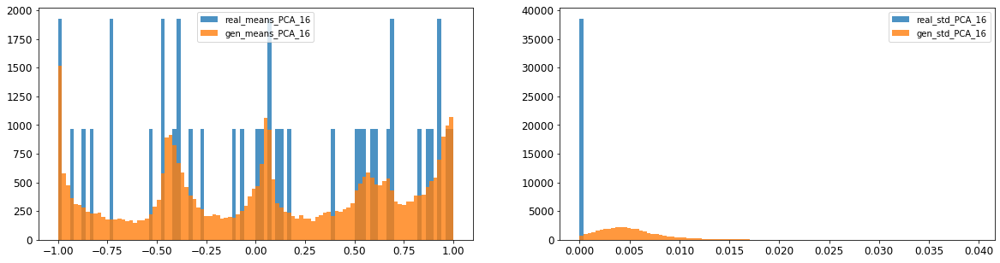



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.015543972684626163
Compose 1-BC divergence = 0.0116750471929431

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.020526840706106553
Compose weighted 1-BC divergence = 0.016864107895019798

Multivariate KL divergence = 45.368341746470065


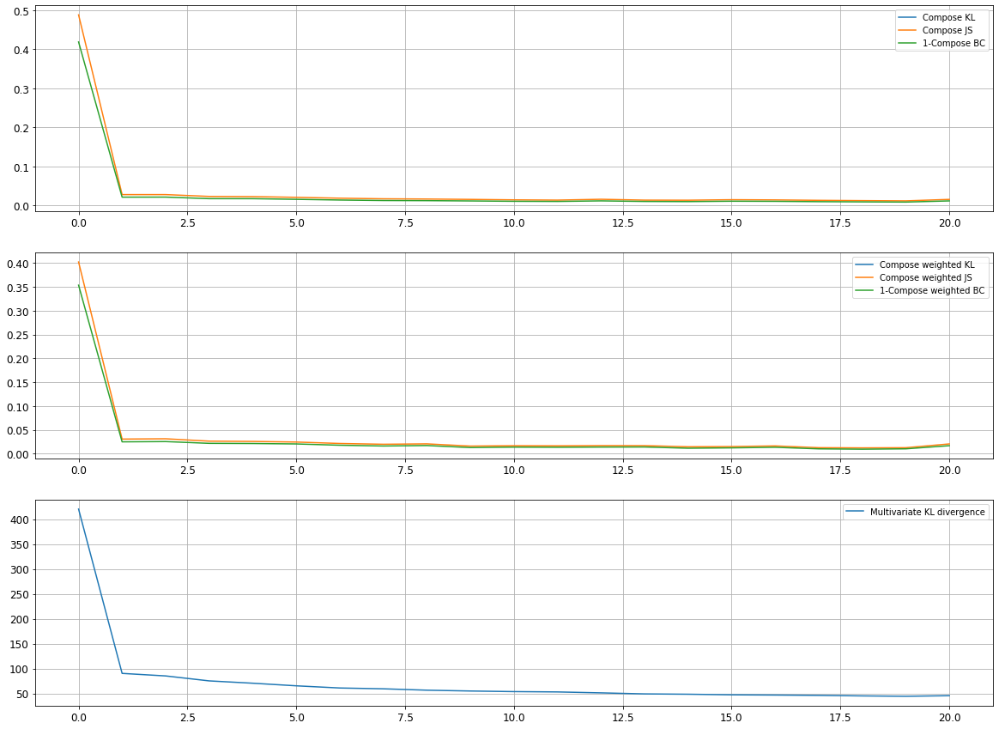

Epoch 4002/10000
discriminator loss: 0.043681 - generator loss: 7.659675 - 27s
Epoch 4003/10000
discriminator loss: 0.046453 - generator loss: 7.838480 - 28s
Epoch 4004/10000
discriminator loss: 0.053764 - generator loss: 7.733728 - 28s
Epoch 4005/10000
discriminator loss: 0.336836 - generator loss: 7.042319 - 28s
Epoch 4006/10000
discriminator loss: 0.040853 - generator loss: 7.824902 - 28s
Epoch 4007/10000
discriminator loss: 0.050384 - generator loss: 7.850315 - 29s
Epoch 4008/10000
discriminator loss: 0.349431 - generator loss: 6.883658 - 28s
Epoch 4009/10000
discriminator loss: 0.051093 - generator loss: 7.707927 - 28s
Epoch 4010/10000
discriminator loss: 0.113212 - generator loss: 7.521300 - 28s
Epoch 4011/10000
discriminator loss: 0.048798 - generator loss: 7.784656 - 28s
Epoch 4012/10000
discriminator loss: 0.318154 - generator loss: 7.403268 - 28s
Epoch 4013/10000
discriminator loss: 0.059944 - generator loss: 7.362632 - 28s
Epoch 4014/10000
discriminator loss: 0.041047 - gene

discriminator loss: 0.245357 - generator loss: 7.204534 - 29s
Epoch 4107/10000
discriminator loss: 0.041803 - generator loss: 7.838764 - 28s
Epoch 4108/10000
discriminator loss: 0.303493 - generator loss: 7.435210 - 28s
Epoch 4109/10000
discriminator loss: 0.051782 - generator loss: 7.550948 - 29s
Epoch 4110/10000
discriminator loss: 0.058633 - generator loss: 7.784374 - 29s
Epoch 4111/10000
discriminator loss: 0.213719 - generator loss: 7.460072 - 29s
Epoch 4112/10000
discriminator loss: 0.051202 - generator loss: 7.627586 - 29s
Epoch 4113/10000
discriminator loss: 0.045624 - generator loss: 7.783252 - 29s
Epoch 4114/10000
discriminator loss: 0.250164 - generator loss: 7.203274 - 29s
Epoch 4115/10000
discriminator loss: 0.044198 - generator loss: 7.829379 - 28s
Epoch 4116/10000
discriminator loss: 0.052747 - generator loss: 7.784034 - 28s
Epoch 4117/10000
discriminator loss: 0.301372 - generator loss: 7.363618 - 29s
Epoch 4118/10000
discriminator loss: 0.057943 - generator loss: 7.518

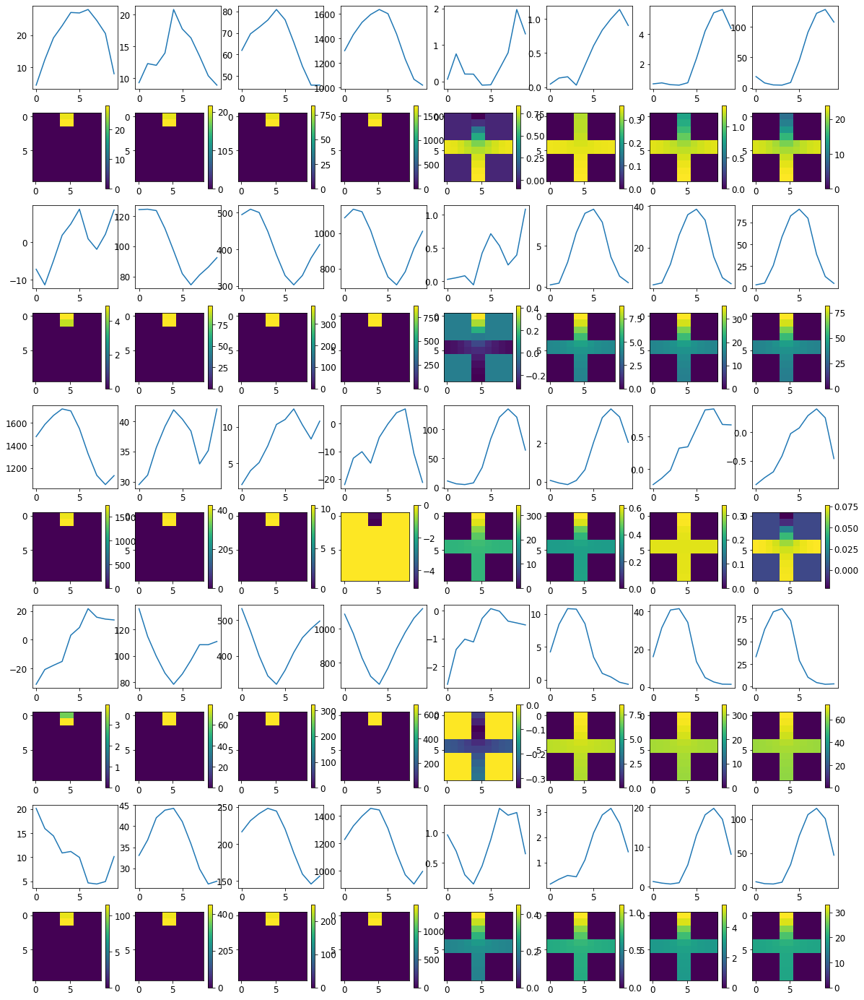


R0 generated:
[[19.682281   17.812546  ]
 [19.67409    17.719826  ]
 [19.676323   17.65931   ]
 [19.670446   17.671515  ]
 [19.668613   17.676311  ]
 [19.665888   17.668135  ]
 [19.682344   17.737926  ]
 [19.678568   17.738642  ]
 [19.663858   17.693987  ]
 [19.66567    17.892677  ]
 [17.189419    0.3996417 ]
 [17.119764    0.38294163]
 [17.158525    0.36556986]
 [17.114887    0.35346234]
 [17.108109    0.34604236]
 [17.12771     0.34949315]
 [17.152678    0.32892072]
 [17.145782    0.33071318]
 [17.255919    0.34158337]
 [17.140862    0.34534845]
 [17.197466    0.86750543]
 [17.248571    0.8267571 ]
 [17.280197    0.8267349 ]
 [17.292402    0.85241413]
 [17.326866    0.88870466]
 [17.319185    0.88834196]
 [17.36991     0.9064409 ]
 [17.352213    0.90886426]
 [17.405622    0.9299137 ]
 [17.402302    0.7930345 ]
 [19.744732   16.864365  ]
 [19.732588   16.755362  ]
 [19.716684   16.716331  ]
 [19.709051   16.693825  ]
 [19.718565   16.665567  ]
 [19.716755   16.635708  ]
 [19.730795  

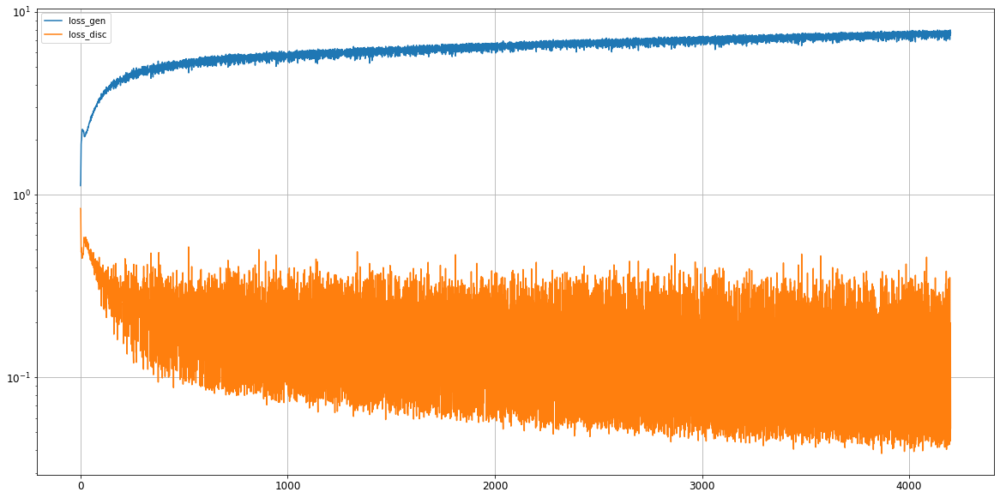

0: mean KL divergence (r,g) = 0.0434327733012201
0: mean JS divergence = 0.01236315049065369
0: mean 1-BC divergence = 0.010393244173147353

0: std KL divergence (r,g) = 0.08374234205952251
0: std JS divergence = 0.026146505549499398
0: std 1-BC divergence = 0.024134313602845903


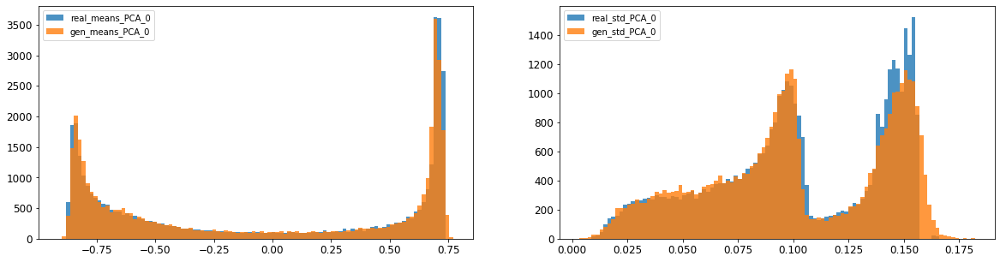

1: mean KL divergence (r,g) = 0.021149206639589607
1: mean JS divergence = 0.005232793288320874
1: mean 1-BC divergence = 0.0036505265711582746

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.00942234723759433
1: std 1-BC divergence = 0.0068910779681382595


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


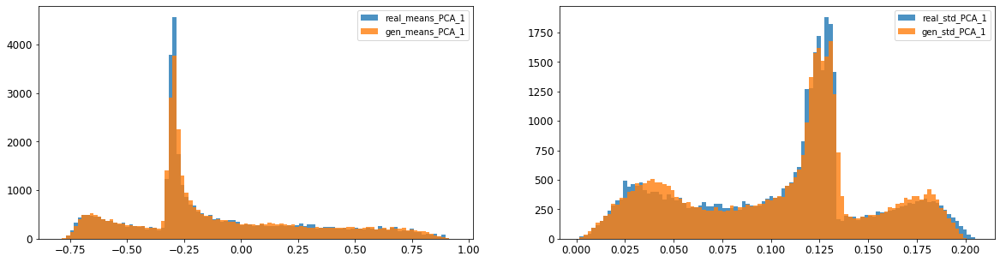

2: mean KL divergence (r,g) = 0.02000483187573868
2: mean JS divergence = 0.004657751991818407
2: mean 1-BC divergence = 0.0032703317743358884

2: std KL divergence (r,g) = 0.039115205002676776
2: std JS divergence = 0.011352027283266328
2: std 1-BC divergence = 0.010360670664534943


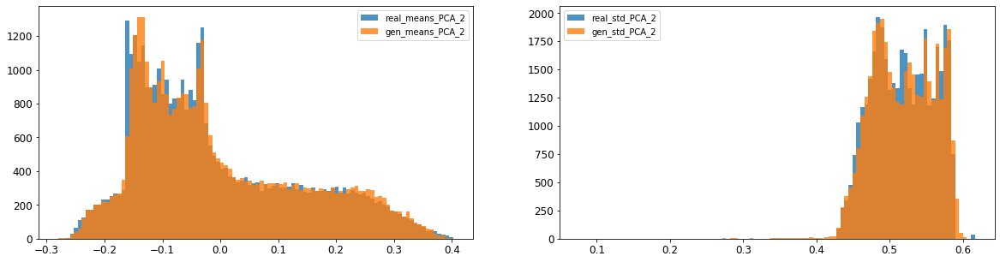

3: mean KL divergence (r,g) = 0.08507337818547983
3: mean JS divergence = 0.022102331611816062
3: mean 1-BC divergence = 0.015806678662503848

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.08535362652259851
3: std 1-BC divergence = 0.06392913401114031


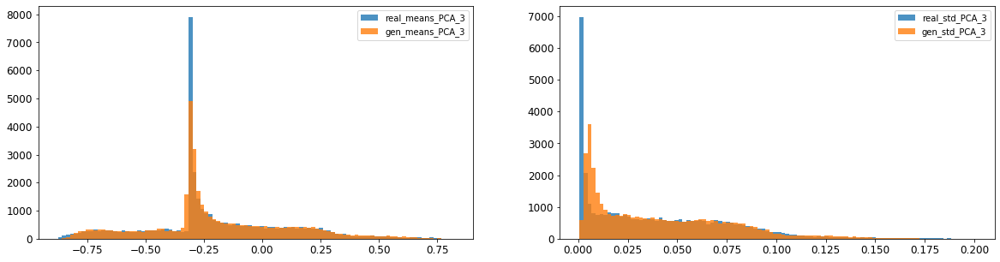

4: mean KL divergence (r,g) = 0.03870123569776851
4: mean JS divergence = 0.010827322958888299
4: mean 1-BC divergence = 0.008749617107281393

4: std KL divergence (r,g) = 0.016797290346671524
4: std JS divergence = 0.004097310270276747
4: std 1-BC divergence = 0.0029027182741226953


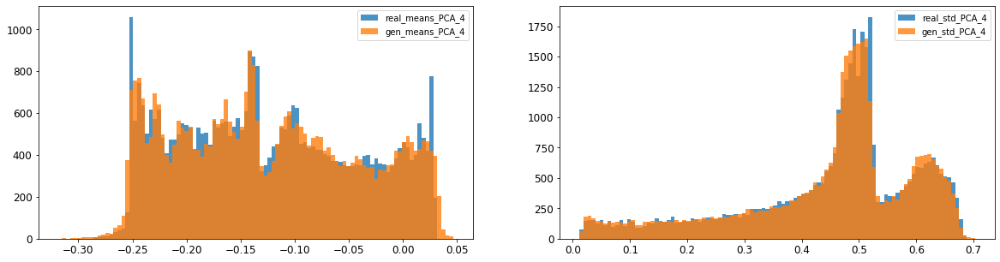

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.0143873195889819
5: mean 1-BC divergence = 0.01061738012196567

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.012335952744162632
5: std 1-BC divergence = 0.011037868851526245


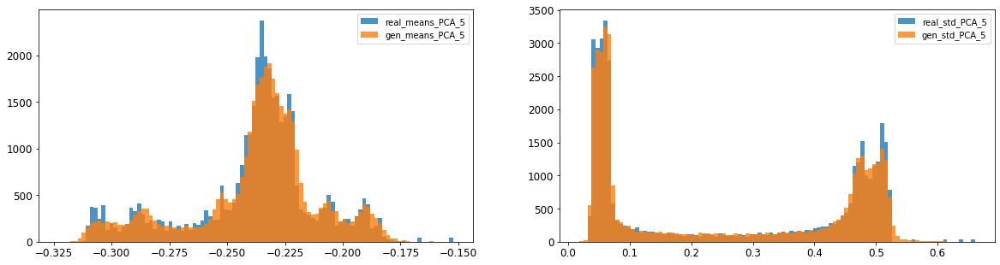

6: mean KL divergence (r,g) = 0.020557349079342993
6: mean JS divergence = 0.005146235756482816
6: mean 1-BC divergence = 0.003624657960698663

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.008496865787717198
6: std 1-BC divergence = 0.006057783680988527


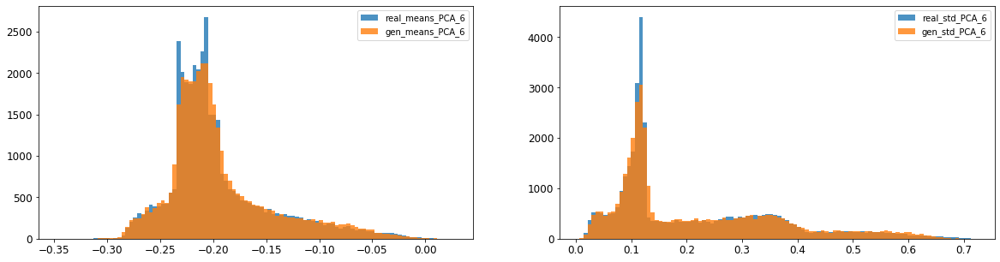

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.021454131963893255
7: mean 1-BC divergence = 0.01644604397273175

7: std KL divergence (r,g) = 0.03024368679681189
7: std JS divergence = 0.007143522692824077
7: std 1-BC divergence = 0.005044758629375812


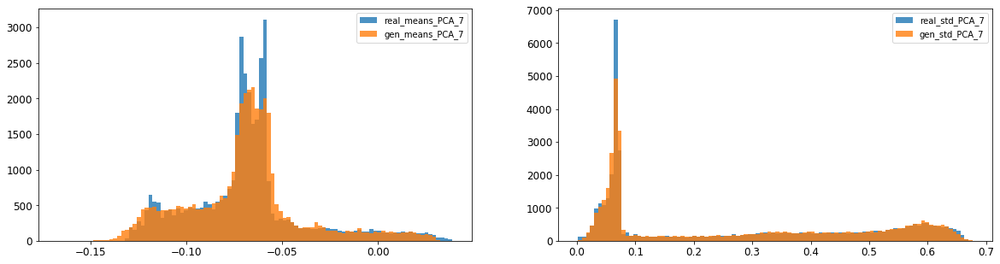

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.006767674643860654
8: mean 1-BC divergence = 0.0047669185118865975

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.010920411384268287
8: std 1-BC divergence = 0.007748565146501907


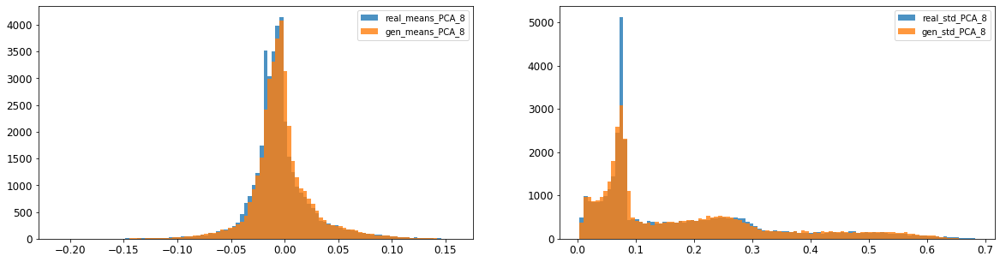

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003440193546511831
9: mean 1-BC divergence = 0.002453081889812192

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010964680012393676
9: std 1-BC divergence = 0.007819804274657671


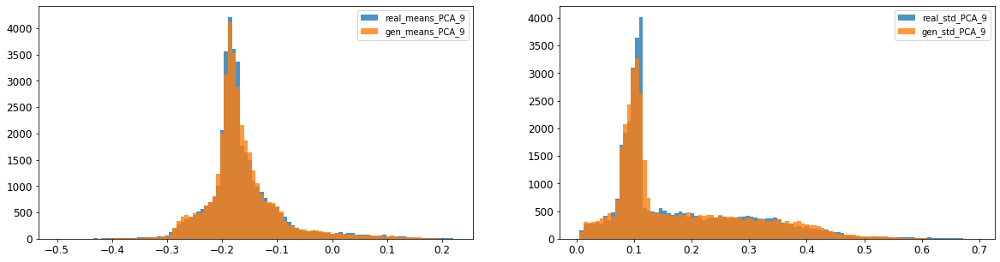

10: mean KL divergence (r,g) = 0.02266784432282488
10: mean JS divergence = 0.005600208337271227
10: mean 1-BC divergence = 0.003916982262892832

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004863484740130177
10: std 1-BC divergence = 0.004234715178070281


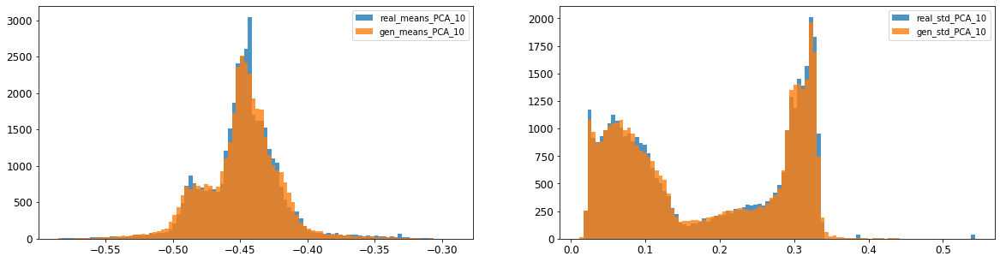

11: mean KL divergence (r,g) = 0.0852303814627966
11: mean JS divergence = 0.021456968215404715
11: mean 1-BC divergence = 0.015054255826748353

11: std KL divergence (r,g) = 0.027170320736654745
11: std JS divergence = 0.007059798109276937
11: std 1-BC divergence = 0.005010299569802035


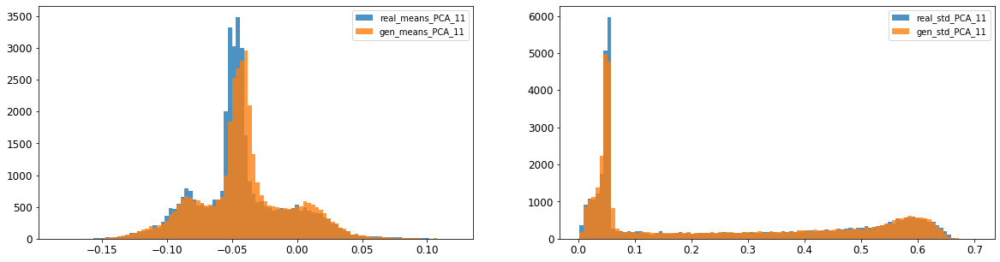

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.00684936742487038
12: mean 1-BC divergence = 0.004841777322580509

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.019747921058341313
12: std 1-BC divergence = 0.014040726228609857


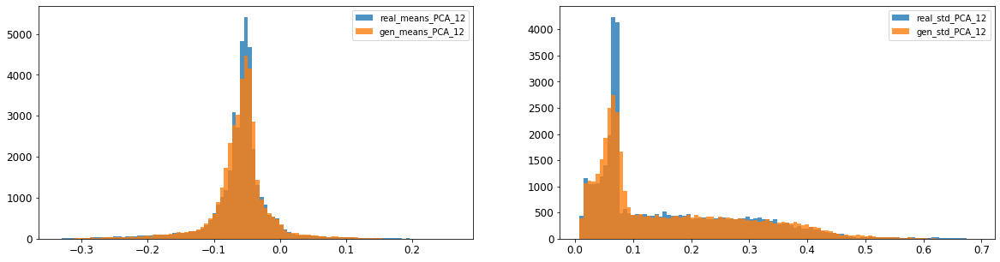

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.01304288881697372
13: mean 1-BC divergence = 0.009121001088409963

13: std KL divergence (r,g) = 0.06909035806607595
13: std JS divergence = 0.01711505821203052
13: std 1-BC divergence = 0.012002229504546214


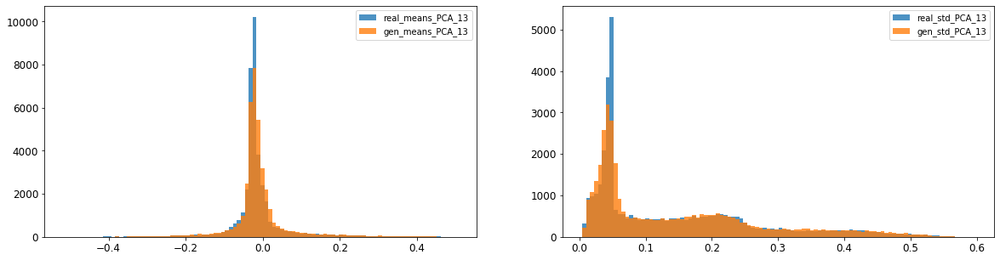

14: mean KL divergence (r,g) = 0.04186927186201423
14: mean JS divergence = 0.010291175958731708
14: mean 1-BC divergence = 0.007202056655106648

14: std KL divergence (r,g) = 0.027079888191423394
14: std JS divergence = 0.006780421460263788
14: std 1-BC divergence = 0.004735849868155562


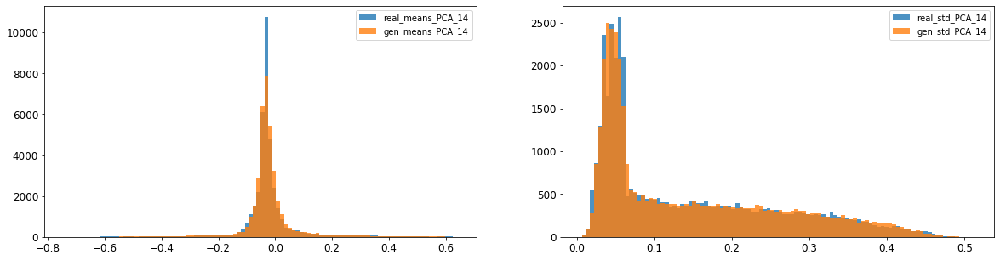

15: mean KL divergence (r,g) = 1.7114505803549296
15: mean JS divergence = 0.4648340934631725
15: mean 1-BC divergence = 0.42521036532476675

15: std KL divergence (r,g) = 5.4340384612089
15: std JS divergence = 0.9202761824923533
15: std 1-BC divergence = 0.8479117324659942


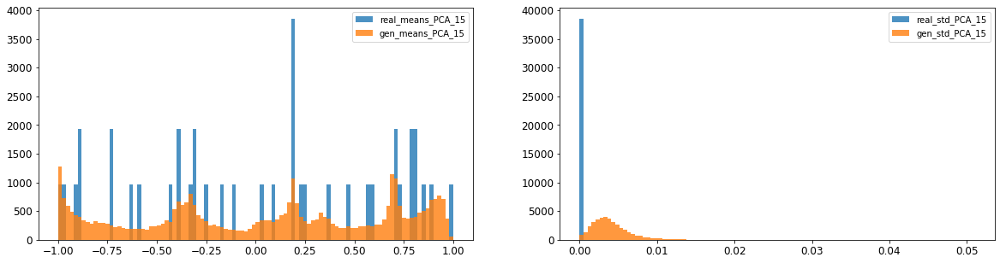

16: mean KL divergence (r,g) = 1.428976572127783
16: mean JS divergence = 0.39748428117062984
16: mean 1-BC divergence = 0.365796523327353

16: std KL divergence (r,g) = 5.329438236994641
16: std JS divergence = 0.9155665950032355
16: std 1-BC divergence = 0.8422971233613545


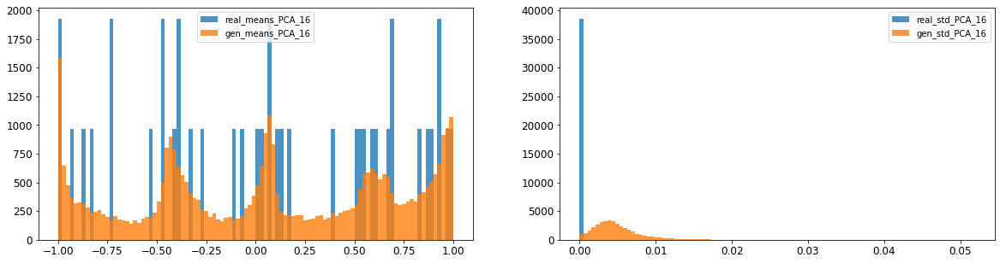



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.013513981588637449
Compose 1-BC divergence = 0.010195502311809101

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.016555398031955118
Compose weighted 1-BC divergence = 0.014005406971729362

Multivariate KL divergence = 43.263909843608054


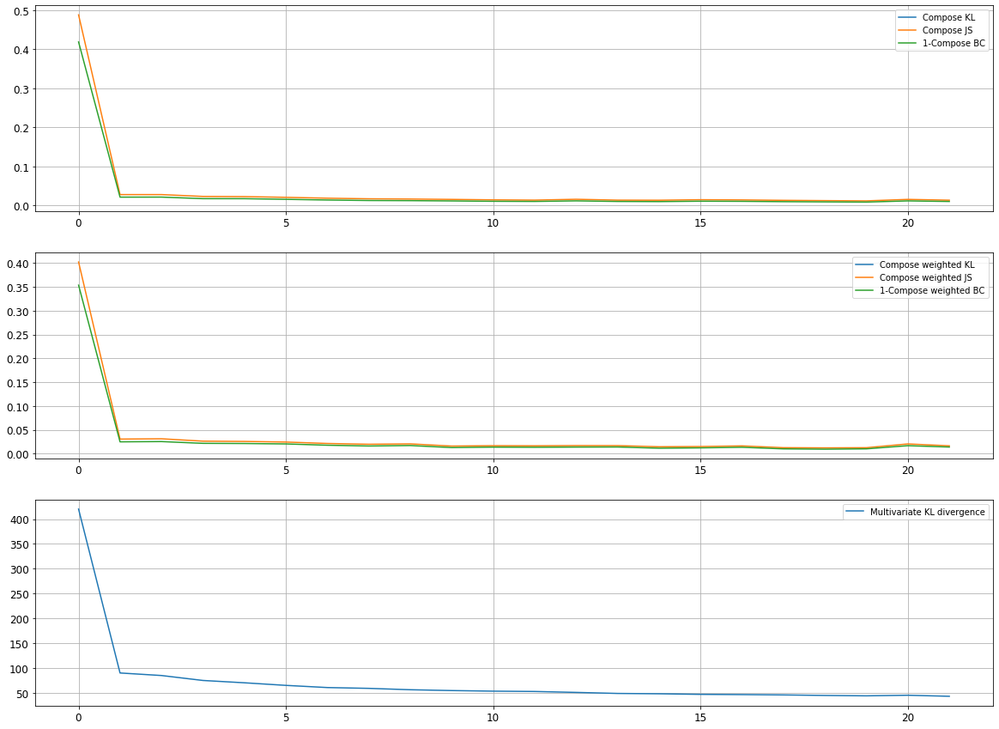

Epoch 4202/10000
discriminator loss: 0.291467 - generator loss: 7.198919 - 27s
Epoch 4203/10000
discriminator loss: 0.046490 - generator loss: 7.826569 - 28s
Epoch 4204/10000
discriminator loss: 0.165653 - generator loss: 7.418406 - 28s
Epoch 4205/10000
discriminator loss: 0.049354 - generator loss: 7.840797 - 28s
Epoch 4206/10000
discriminator loss: 0.245063 - generator loss: 7.473840 - 28s
Epoch 4207/10000
discriminator loss: 0.048700 - generator loss: 7.717332 - 28s
Epoch 4208/10000
discriminator loss: 0.197616 - generator loss: 7.654431 - 28s
Epoch 4209/10000
discriminator loss: 0.056108 - generator loss: 7.667765 - 28s
Epoch 4210/10000
discriminator loss: 0.046658 - generator loss: 7.824987 - 28s
Epoch 4211/10000
discriminator loss: 0.273149 - generator loss: 7.271680 - 28s
Epoch 4212/10000
discriminator loss: 0.050330 - generator loss: 7.697029 - 29s
Epoch 4213/10000
discriminator loss: 0.056899 - generator loss: 7.737130 - 29s
Epoch 4214/10000
discriminator loss: 0.208691 - gene

discriminator loss: 0.344947 - generator loss: 7.073923 - 28s
Epoch 4307/10000
discriminator loss: 0.045080 - generator loss: 7.807590 - 28s
Epoch 4308/10000
discriminator loss: 0.055723 - generator loss: 7.787026 - 28s
Epoch 4309/10000
discriminator loss: 0.269036 - generator loss: 7.312476 - 29s
Epoch 4310/10000
discriminator loss: 0.054540 - generator loss: 7.851995 - 28s
Epoch 4311/10000
discriminator loss: 0.043773 - generator loss: 7.919344 - 28s
Epoch 4312/10000
discriminator loss: 0.275676 - generator loss: 7.749969 - 28s
Epoch 4313/10000
discriminator loss: 0.067539 - generator loss: 7.457361 - 28s
Epoch 4314/10000
discriminator loss: 0.040134 - generator loss: 8.020799 - 28s
Epoch 4315/10000
discriminator loss: 0.157886 - generator loss: 7.753609 - 28s
Epoch 4316/10000
discriminator loss: 0.148968 - generator loss: 7.345568 - 28s
Epoch 4317/10000
discriminator loss: 0.038951 - generator loss: 7.955287 - 28s
Epoch 4318/10000
discriminator loss: 0.047296 - generator loss: 7.879

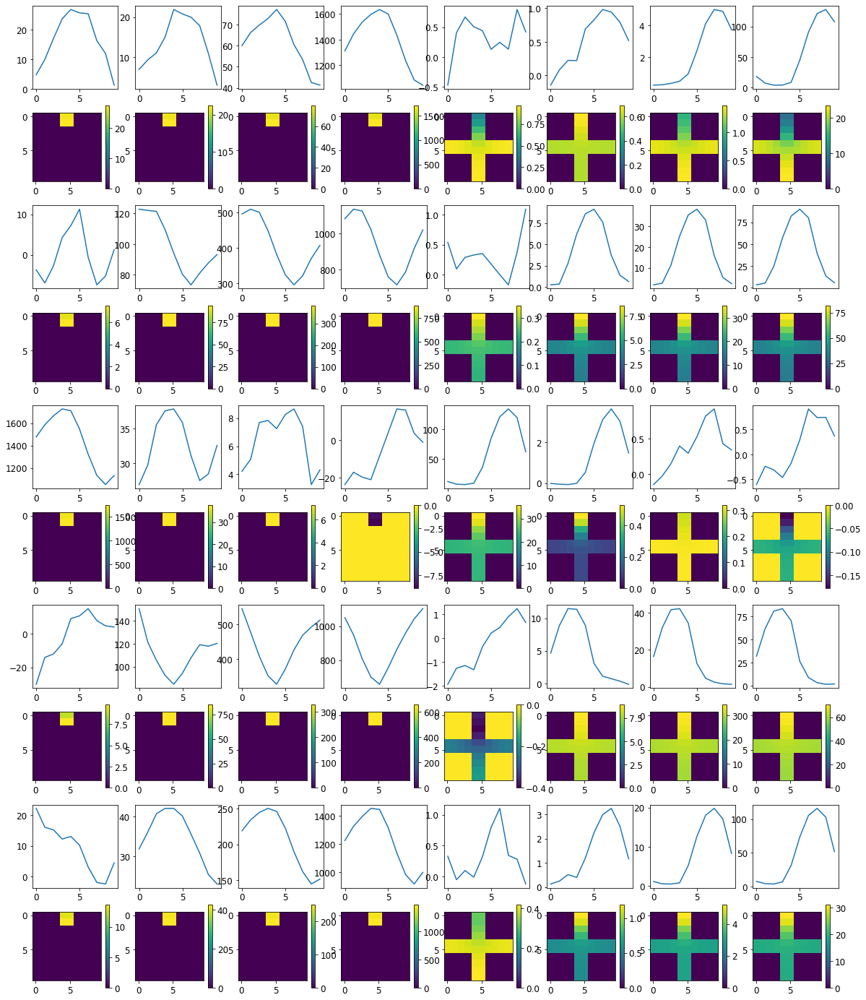


R0 generated:
[[19.580591   18.057484  ]
 [19.579374   17.98105   ]
 [19.594666   17.915401  ]
 [19.5853     17.907377  ]
 [19.587736   17.941654  ]
 [19.579779   17.996262  ]
 [19.601332   18.050827  ]
 [19.588964   18.068792  ]
 [19.57064    18.04643   ]
 [19.572832   18.213278  ]
 [17.097378    0.3855242 ]
 [17.02566     0.36718273]
 [17.100597    0.3516238 ]
 [17.050404    0.3400778 ]
 [17.030447    0.3387979 ]
 [17.028288    0.34237581]
 [17.024761    0.32924375]
 [17.01077     0.33247706]
 [17.147161    0.34232625]
 [17.040913    0.3432149 ]
 [17.03118     0.63990253]
 [17.13755     0.6069987 ]
 [17.20519     0.59198964]
 [17.192993    0.5783573 ]
 [17.212881    0.58924437]
 [17.191963    0.59916   ]
 [17.17876     0.5911383 ]
 [17.151072    0.60341436]
 [17.164148    0.64538133]
 [17.205345    0.56378907]
 [19.730816   16.82773   ]
 [19.721296   16.736338  ]
 [19.712048   16.672497  ]
 [19.704506   16.665928  ]
 [19.71575    16.69043   ]
 [19.709991   16.619638  ]
 [19.723068  

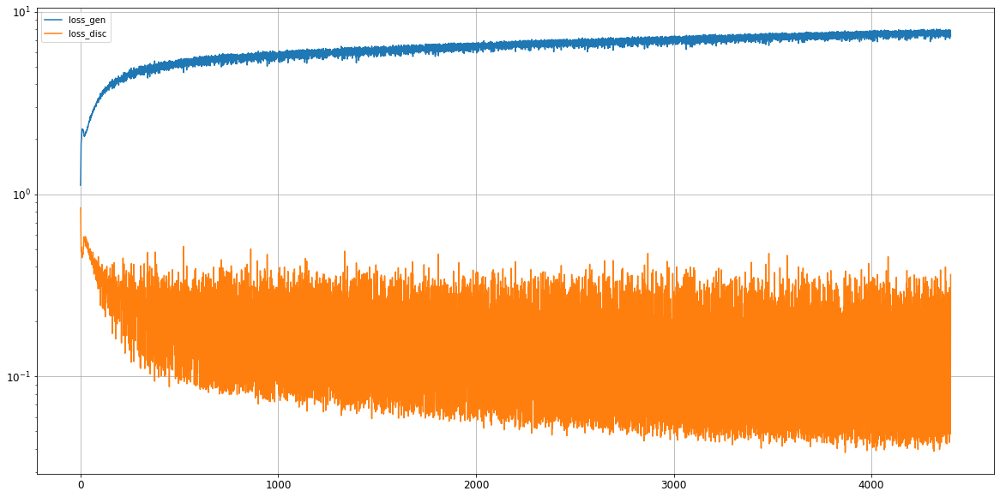

0: mean KL divergence (r,g) = 0.036523631605493795
0: mean JS divergence = 0.011147995983515728
0: mean 1-BC divergence = 0.009874721857603075

0: std KL divergence (r,g) = 0.09574504881459572
0: std JS divergence = 0.030302746610151574
0: std 1-BC divergence = 0.028348222053128147


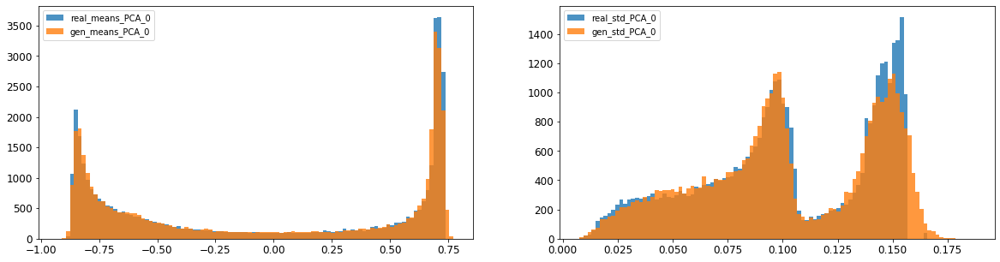

1: mean KL divergence (r,g) = 0.02948360322867602
1: mean JS divergence = 0.007625708466297705
1: mean 1-BC divergence = 0.005405577632859093

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.016432935958842508
1: std 1-BC divergence = 0.0116780286745507


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


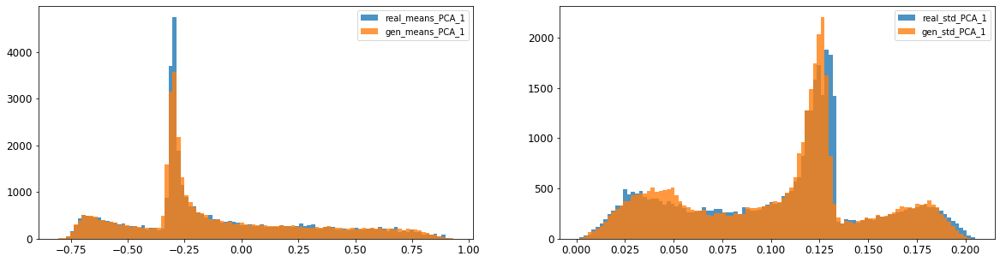

2: mean KL divergence (r,g) = 0.01649369620430375
2: mean JS divergence = 0.00405434975931397
2: mean 1-BC divergence = 0.0029285959030744824

2: std KL divergence (r,g) = 0.06412344375060754
2: std JS divergence = 0.015674087314780663
2: std 1-BC divergence = 0.012209703066427102


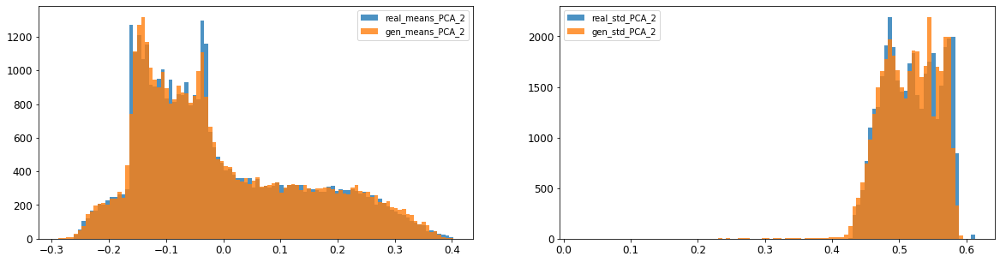

3: mean KL divergence (r,g) = 0.04022642621466307
3: mean JS divergence = 0.009614551678265519
3: mean 1-BC divergence = 0.0067321265216079285

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.07205055099371366
3: std 1-BC divergence = 0.05265210438393764


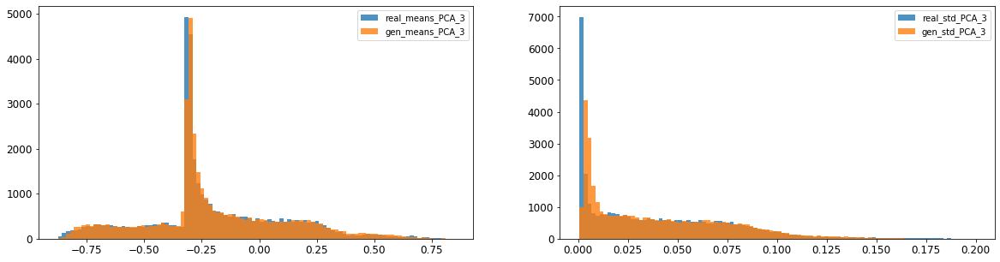

4: mean KL divergence (r,g) = 0.06815746718982348
4: mean JS divergence = 0.015467258869516633
4: mean 1-BC divergence = 0.011099418272151995

4: std KL divergence (r,g) = 0.03944965834054787
4: std JS divergence = 0.009176210818809023
4: std 1-BC divergence = 0.006480464144163367


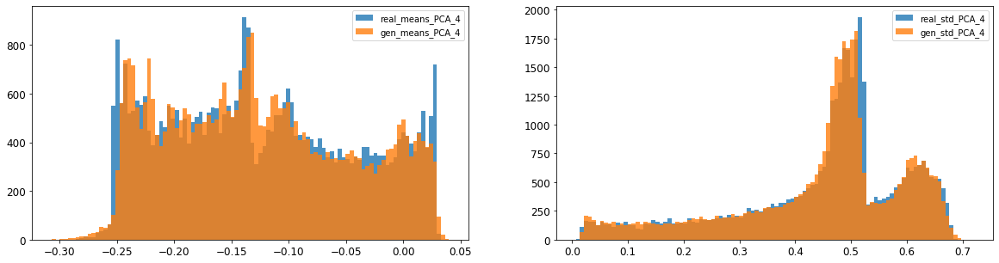

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.017038719757619107
5: mean 1-BC divergence = 0.012238652375075931

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.016023013549960836
5: std 1-BC divergence = 0.01359883545635443


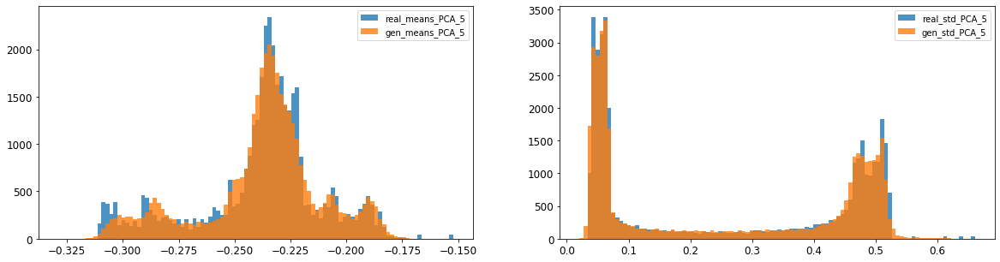

6: mean KL divergence (r,g) = 0.017804921996238673
6: mean JS divergence = 0.004569452427665854
6: mean 1-BC divergence = 0.0032274001076267878

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.008477568515601924
6: std 1-BC divergence = 0.006051192808111838


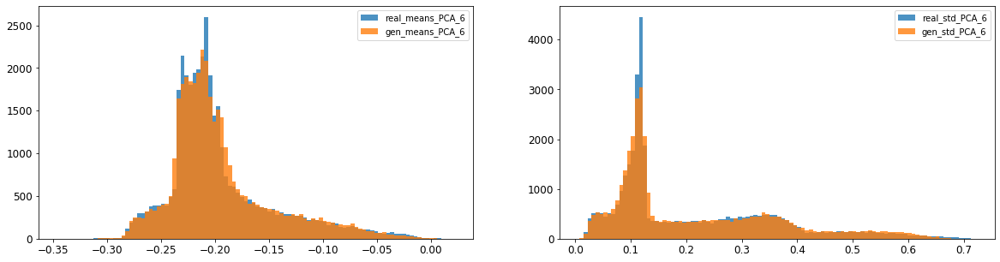

7: mean KL divergence (r,g) = 0.04469552852124091
7: mean JS divergence = 0.012477164882166214
7: mean 1-BC divergence = 0.009942490223872058

7: std KL divergence (r,g) = 0.029821897547905866
7: std JS divergence = 0.0072910538646353195
7: std 1-BC divergence = 0.005122940630429507


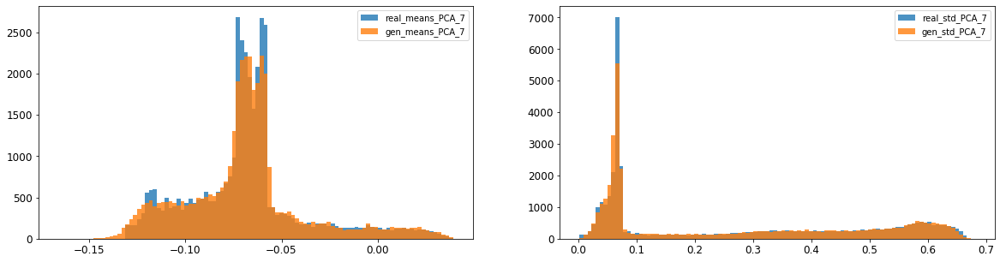

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002974884301269567
8: mean 1-BC divergence = 0.002074952840868005

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.010423063077364111
8: std 1-BC divergence = 0.007369133215664347


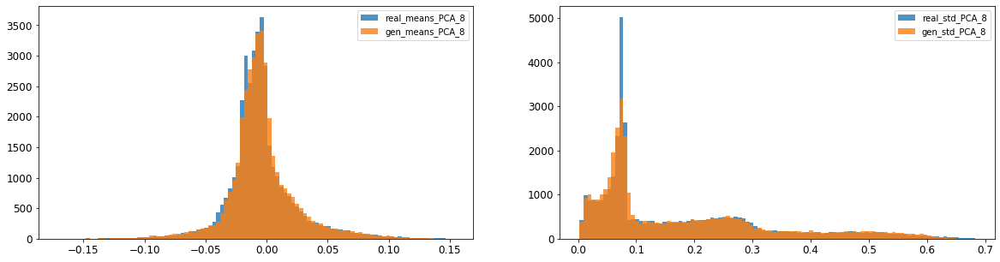

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0028238129987103273
9: mean 1-BC divergence = 0.002033028451882246

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.011664058293121959
9: std 1-BC divergence = 0.008315014918804042


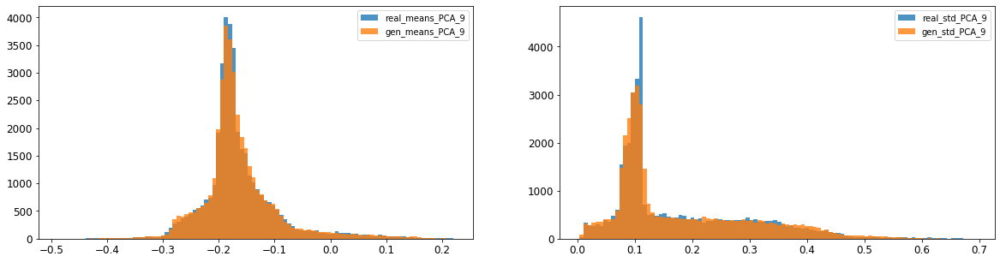

10: mean KL divergence (r,g) = 0.01625829550947429
10: mean JS divergence = 0.004049283556273103
10: mean 1-BC divergence = 0.0028711393975658916

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.00790556852935663
10: std 1-BC divergence = 0.006257733903663687


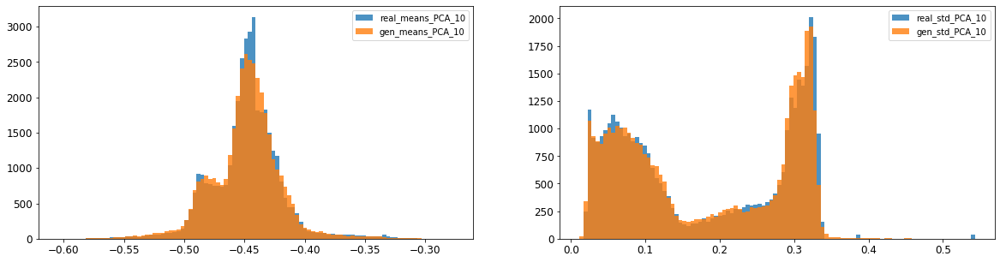

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.00805607895175942
11: mean 1-BC divergence = 0.00573758725205753

11: std KL divergence (r,g) = 0.04231026819810256
11: std JS divergence = 0.011415754800224739
11: std 1-BC divergence = 0.008159327427509577


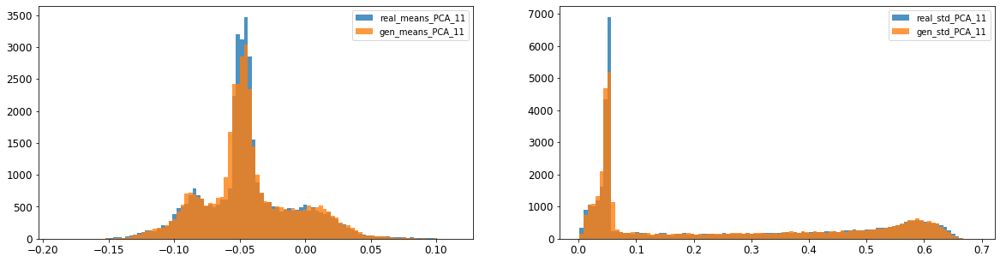

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.013400149817195457
12: mean 1-BC divergence = 0.009352404159098215

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.018693759253370017
12: std 1-BC divergence = 0.013268740184008143


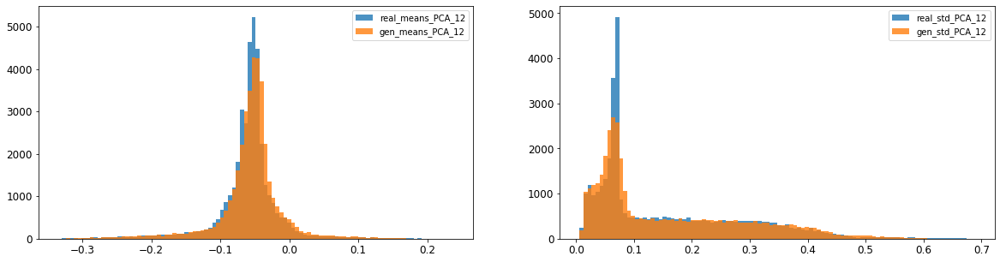

13: mean KL divergence (r,g) = 0.10340448613537583
13: mean JS divergence = 0.025733619892044222
13: mean 1-BC divergence = 0.018047442357411403

13: std KL divergence (r,g) = 0.06458552035348386
13: std JS divergence = 0.016076291209148337
13: std 1-BC divergence = 0.01126078783110207


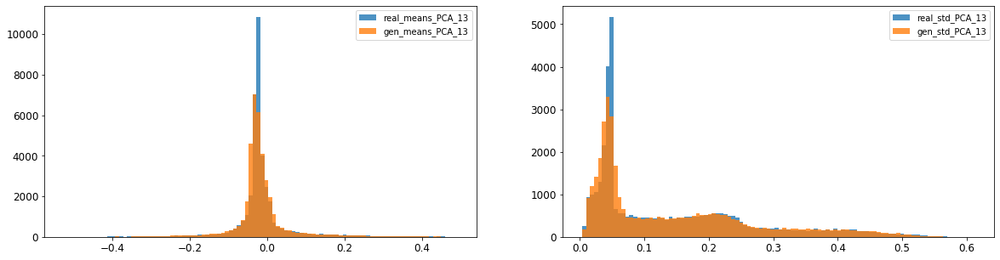

14: mean KL divergence (r,g) = 0.2067062250059486
14: mean JS divergence = 0.05207360895944935
14: mean 1-BC divergence = 0.03659575390059522

14: std KL divergence (r,g) = 0.029673982103142645
14: std JS divergence = 0.0073421876233746835
14: std 1-BC divergence = 0.005121594943065966


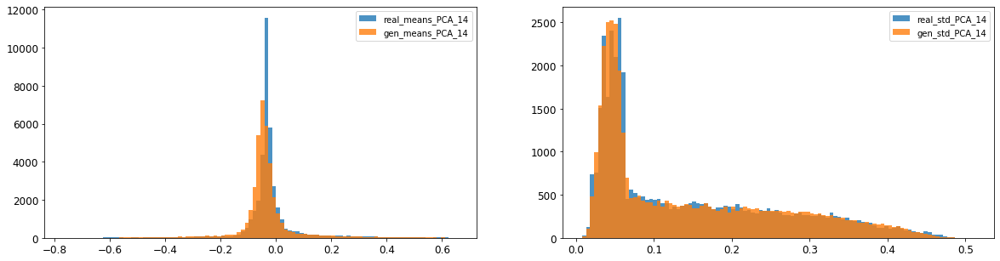

15: mean KL divergence (r,g) = 1.7221406505121797
15: mean JS divergence = 0.4670214439169642
15: mean 1-BC divergence = 0.4278200206302214

15: std KL divergence (r,g) = 6.3385023194228785
15: std JS divergence = 0.9518681780231939
15: std 1-BC divergence = 0.8888369799343585


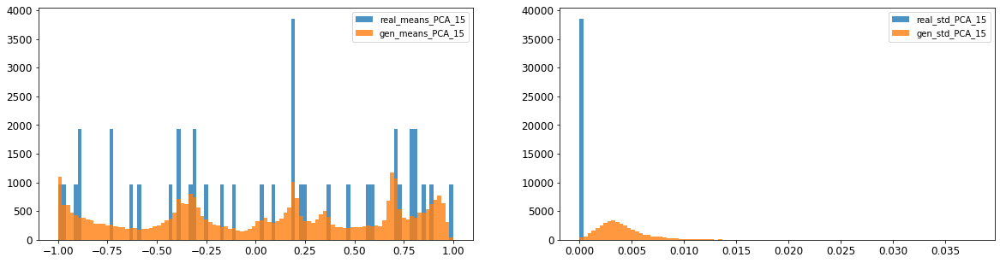

16: mean KL divergence (r,g) = 1.43084277698758
16: mean JS divergence = 0.3993476144688498
16: mean 1-BC divergence = 0.36692518889917647

16: std KL divergence (r,g) = 5.705843076670425
16: std JS divergence = 0.9313894609755318
16: std 1-BC divergence = 0.8615843993450417


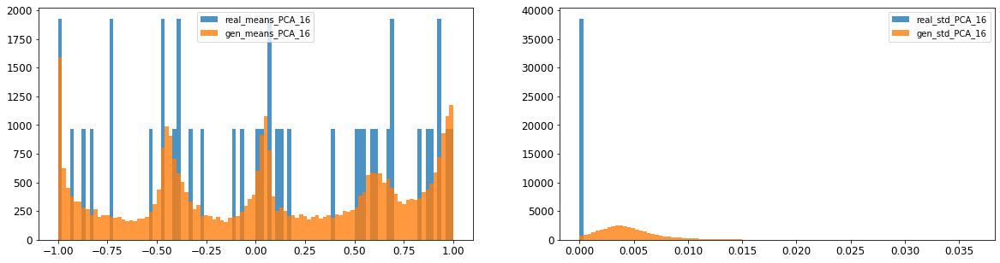



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.015001849690450604
Compose 1-BC divergence = 0.0111351704964755

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.018039677871171767
Compose weighted 1-BC divergence = 0.015368715128740273

Multivariate KL divergence = 46.83979670751652


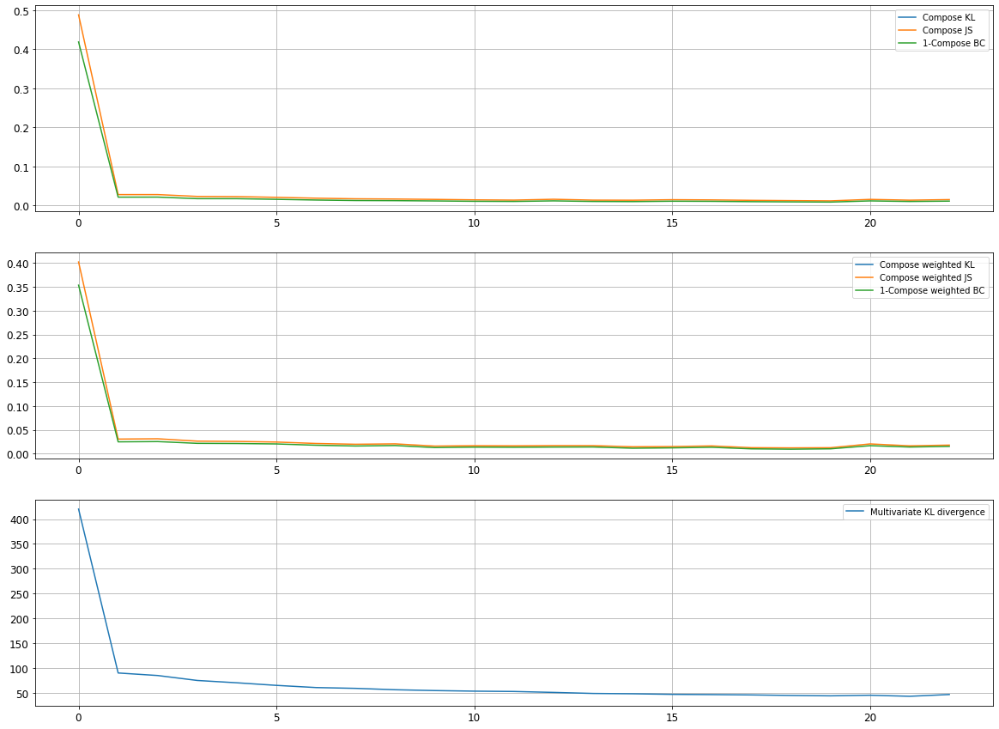

Epoch 4402/10000
discriminator loss: 0.052658 - generator loss: 7.620377 - 27s
Epoch 4403/10000
discriminator loss: 0.276147 - generator loss: 7.597868 - 28s
Epoch 4404/10000
discriminator loss: 0.062266 - generator loss: 7.451537 - 28s
Epoch 4405/10000
discriminator loss: 0.041660 - generator loss: 8.089426 - 29s
Epoch 4406/10000
discriminator loss: 0.249695 - generator loss: 7.549882 - 29s
Epoch 4407/10000
discriminator loss: 0.046252 - generator loss: 7.834086 - 28s
Epoch 4408/10000
discriminator loss: 0.044318 - generator loss: 7.913955 - 29s
Epoch 4409/10000
discriminator loss: 0.320825 - generator loss: 7.369064 - 28s
Epoch 4410/10000
discriminator loss: 0.044465 - generator loss: 7.885963 - 28s
Epoch 4411/10000
discriminator loss: 0.180089 - generator loss: 7.570395 - 27s
Epoch 4412/10000
discriminator loss: 0.039227 - generator loss: 7.966972 - 28s
Epoch 4413/10000
discriminator loss: 0.040840 - generator loss: 8.106037 - 29s
Epoch 4414/10000
discriminator loss: 0.303345 - gene

discriminator loss: 0.044429 - generator loss: 8.011396 - 29s
Epoch 4507/10000
discriminator loss: 0.219133 - generator loss: 7.515453 - 29s
Epoch 4508/10000
discriminator loss: 0.049877 - generator loss: 7.736992 - 29s
Epoch 4509/10000
discriminator loss: 0.048138 - generator loss: 7.958865 - 29s
Epoch 4510/10000
discriminator loss: 0.210852 - generator loss: 7.498171 - 28s
Epoch 4511/10000
discriminator loss: 0.049500 - generator loss: 7.931628 - 28s
Epoch 4512/10000
discriminator loss: 0.182107 - generator loss: 7.518077 - 28s
Epoch 4513/10000
discriminator loss: 0.042680 - generator loss: 7.963809 - 28s
Epoch 4514/10000
discriminator loss: 0.241796 - generator loss: 7.367559 - 29s
Epoch 4515/10000
discriminator loss: 0.043214 - generator loss: 8.021935 - 29s
Epoch 4516/10000
discriminator loss: 0.126010 - generator loss: 7.642821 - 28s
Epoch 4517/10000
discriminator loss: 0.064184 - generator loss: 7.971195 - 28s
Epoch 4518/10000
discriminator loss: 0.229759 - generator loss: 7.360

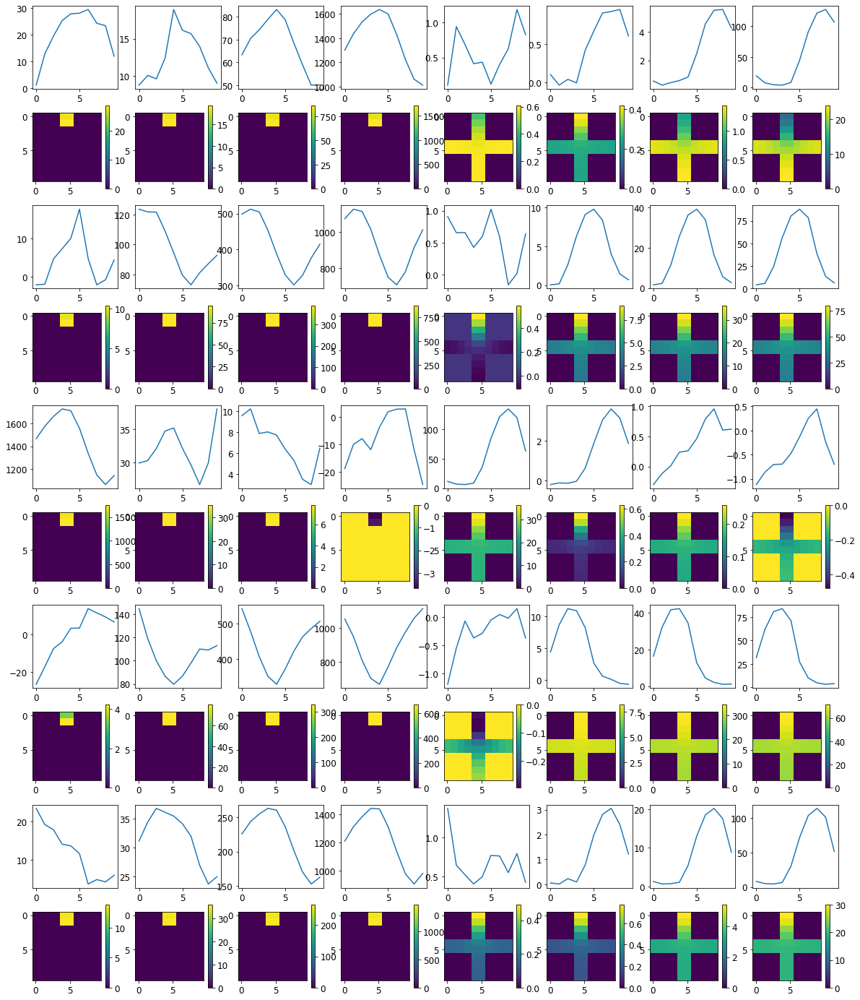


R0 generated:
[[19.662846   17.86214   ]
 [19.6651     17.78365   ]
 [19.675753   17.744932  ]
 [19.670656   17.732311  ]
 [19.67302    17.763954  ]
 [19.672045   17.74287   ]
 [19.688786   17.81574   ]
 [19.683046   17.800589  ]
 [19.661438   17.728628  ]
 [19.665344   17.835037  ]
 [17.05331     0.38173988]
 [17.00823     0.36995247]
 [17.110125    0.3573732 ]
 [17.082731    0.34549016]
 [17.06492     0.3429175 ]
 [17.077412    0.3488045 ]
 [17.048944    0.33146712]
 [17.049885    0.333722  ]
 [17.181242    0.3369104 ]
 [17.078182    0.33619142]
 [17.078224    0.6169353 ]
 [17.205397    0.5945605 ]
 [17.282854    0.5825585 ]
 [17.29517     0.56974953]
 [17.315477    0.5941984 ]
 [17.321636    0.5967023 ]
 [17.345581    0.5956993 ]
 [17.333755    0.5901377 ]
 [17.35462     0.6241582 ]
 [17.333965    0.5477934 ]
 [19.763779   17.13517   ]
 [19.76127    16.988684  ]
 [19.752947   16.968088  ]
 [19.74639    16.923498  ]
 [19.751112   16.923943  ]
 [19.747822   16.871489  ]
 [19.755314  

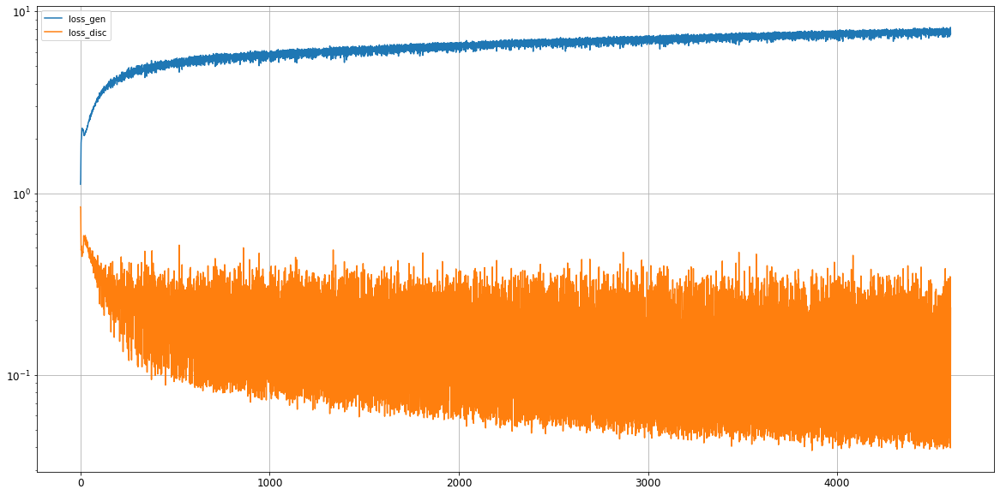

0: mean KL divergence (r,g) = 0.031111540485240723
0: mean JS divergence = 0.007978309599645145
0: mean 1-BC divergence = 0.0059760201351322095

0: std KL divergence (r,g) = 0.05875476686942758
0: std JS divergence = 0.018640798732703575
0: std 1-BC divergence = 0.01736958041992165


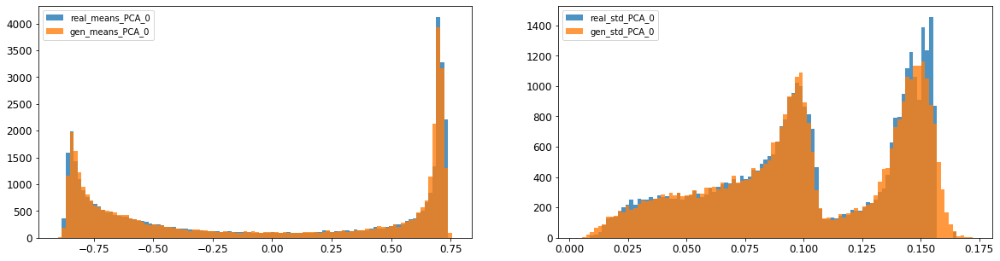

1: mean KL divergence (r,g) = 0.01976181326252368
1: mean JS divergence = 0.00511219133398005
1: mean 1-BC divergence = 0.0036199493580338915

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.0066591537844178286
1: std 1-BC divergence = 0.004721845430400773


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


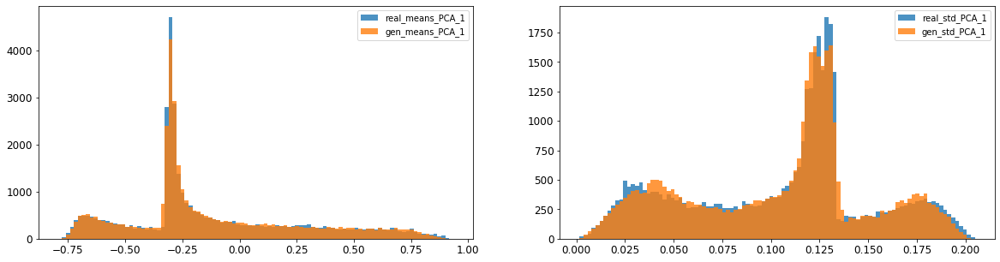

2: mean KL divergence (r,g) = 0.012066139619658264
2: mean JS divergence = 0.002976385549611585
2: mean 1-BC divergence = 0.002121355841185224

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.013270789906349287
2: std 1-BC divergence = 0.012240327348499225


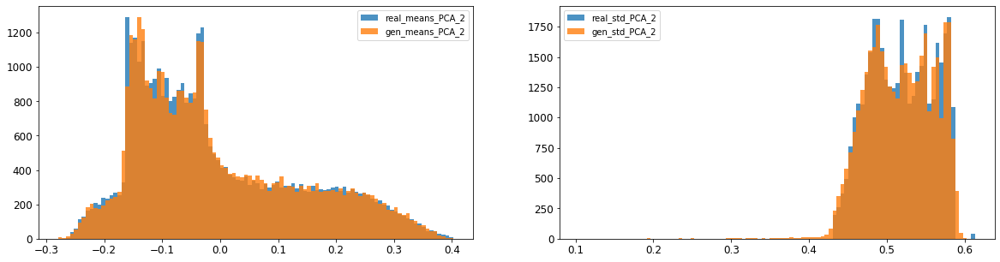

3: mean KL divergence (r,g) = 0.06183496422517649
3: mean JS divergence = 0.016023491046636786
3: mean 1-BC divergence = 0.011404025735256895

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0796273065454419
3: std 1-BC divergence = 0.058748018027469096


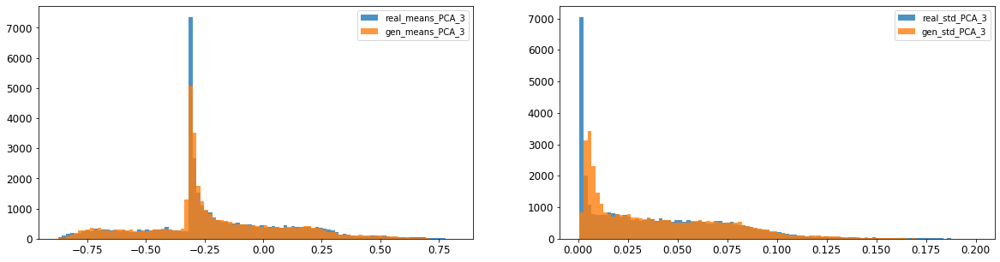

4: mean KL divergence (r,g) = 0.035169236921837446
4: mean JS divergence = 0.009377289949295195
4: mean 1-BC divergence = 0.006990760657881401

4: std KL divergence (r,g) = 0.02490035134674834
4: std JS divergence = 0.0058959207566675175
4: std 1-BC divergence = 0.004127267325407136


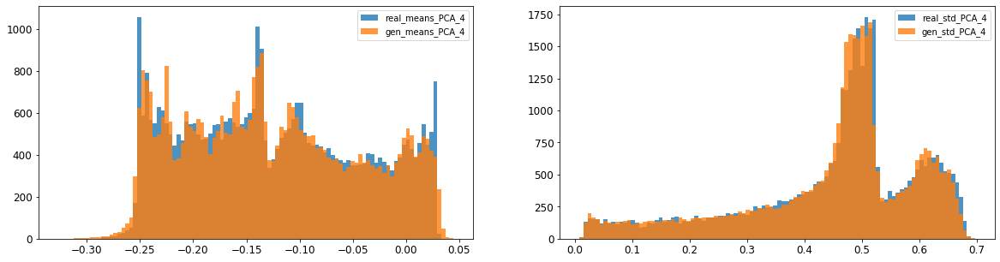

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.016474454451309295
5: mean 1-BC divergence = 0.012026169709986934

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.012221570646354278
5: std 1-BC divergence = 0.010803277145978174


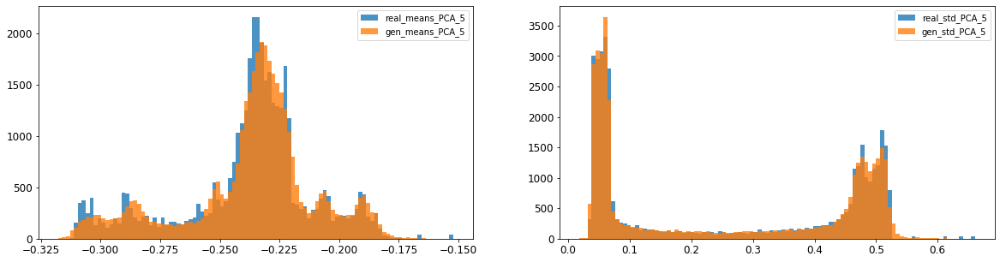

6: mean KL divergence (r,g) = 0.016644571533489798
6: mean JS divergence = 0.004206572498898943
6: mean 1-BC divergence = 0.0029751634180935627

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.00874781058536631
6: std 1-BC divergence = 0.006210975502445981


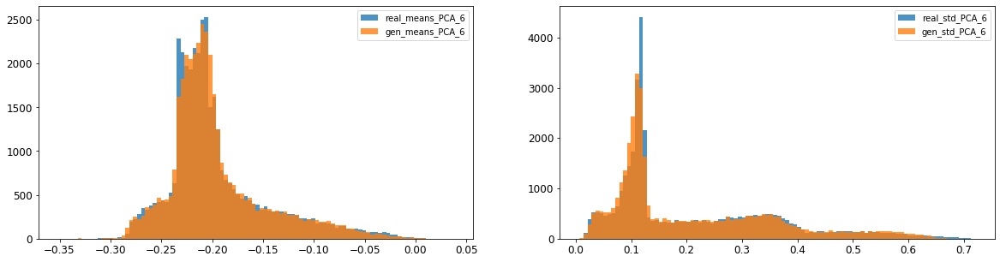

7: mean KL divergence (r,g) = 0.06657082506006143
7: mean JS divergence = 0.01747531982939764
7: mean 1-BC divergence = 0.012687780457250386

7: std KL divergence (r,g) = 0.02325848918805454
7: std JS divergence = 0.005600351745044339
7: std 1-BC divergence = 0.003931519234410374


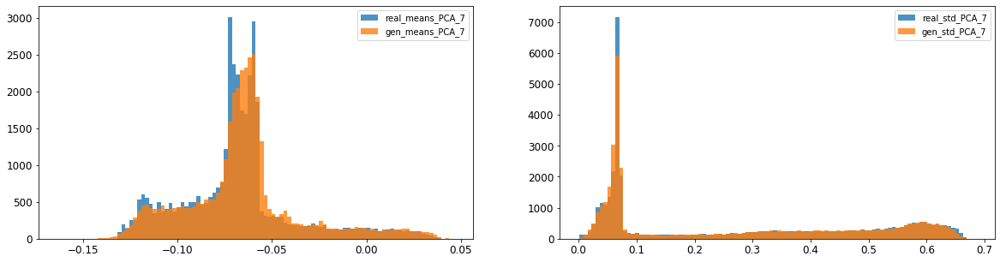

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0020634143521738235
8: mean 1-BC divergence = 0.0014835307802302244

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.010007026325794957
8: std 1-BC divergence = 0.007051201403951324


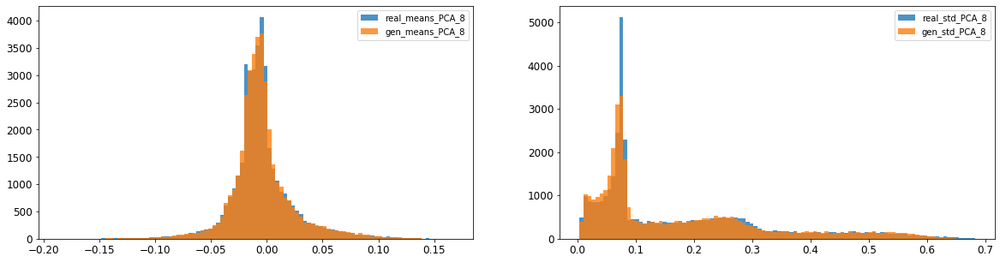

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0032504753798457586
9: mean 1-BC divergence = 0.002346626964924492

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.01166759020896027
9: std 1-BC divergence = 0.00833671754297649


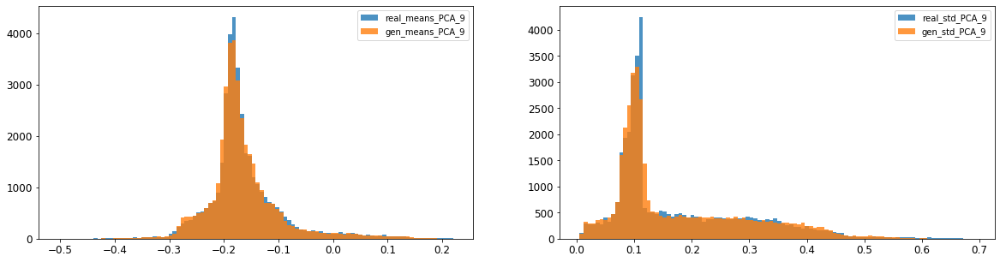

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.004964704983707316
10: mean 1-BC divergence = 0.003525249162012245

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.00540293622685422
10: std 1-BC divergence = 0.004452373782306007


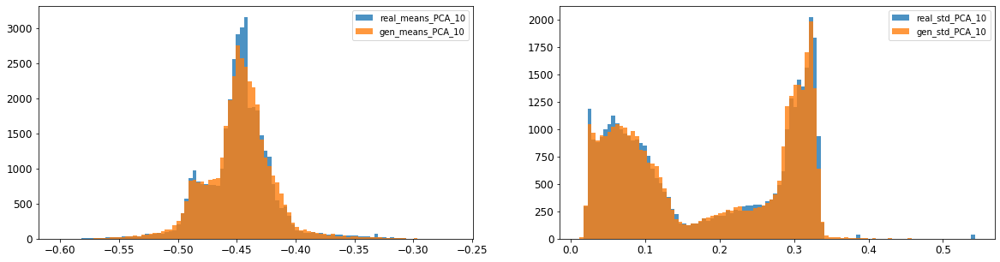

11: mean KL divergence (r,g) = 0.06779031456289086
11: mean JS divergence = 0.016990846611299355
11: mean 1-BC divergence = 0.011877178399430699

11: std KL divergence (r,g) = 0.0456088240619226
11: std JS divergence = 0.012113041906711738
11: std 1-BC divergence = 0.008626986297520234


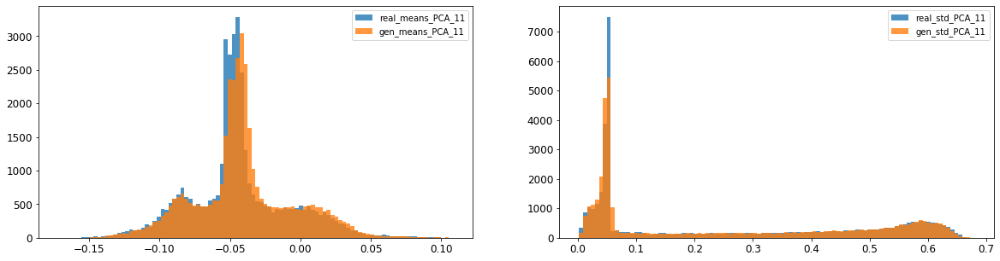

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.008189355522882462
12: mean 1-BC divergence = 0.00575408603915839

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01669185969333387
12: std 1-BC divergence = 0.012079936312133888


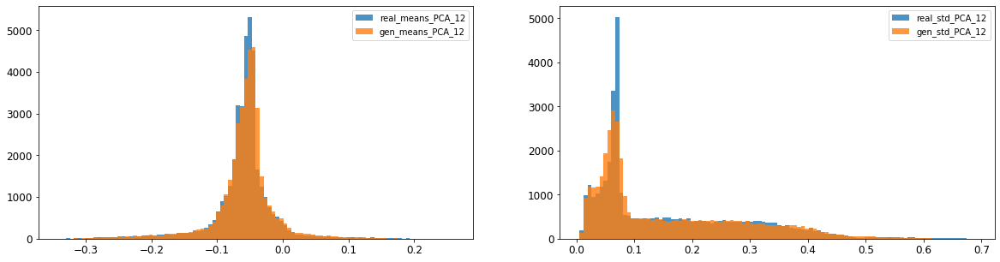

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.016855844136329463
13: mean 1-BC divergence = 0.011790520874502497

13: std KL divergence (r,g) = 0.07000130271802178
13: std JS divergence = 0.017235882171424813
13: std 1-BC divergence = 0.012088119355120996


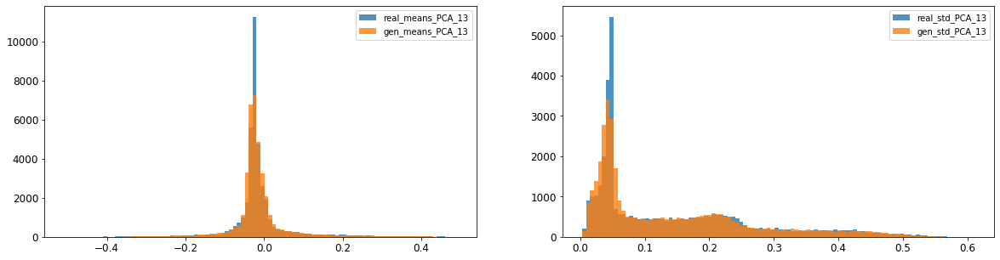

14: mean KL divergence (r,g) = 0.07932710204532657
14: mean JS divergence = 0.01948242120200928
14: mean 1-BC divergence = 0.013613524882922778

14: std KL divergence (r,g) = 0.030073407209498443
14: std JS divergence = 0.00745929818053479
14: std 1-BC divergence = 0.0052018476288707705


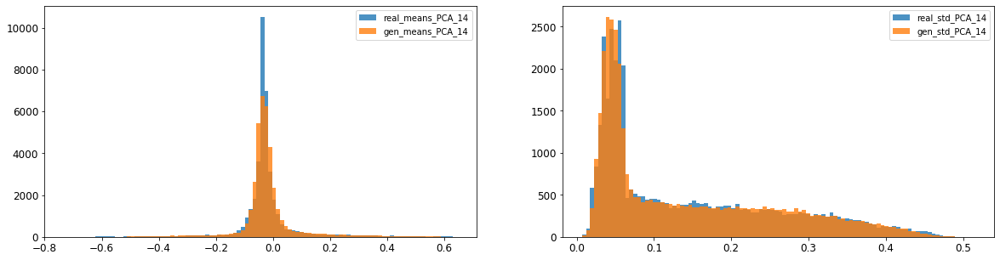

15: mean KL divergence (r,g) = 1.7466097559164309
15: mean JS divergence = 0.47021986496370416
15: mean 1-BC divergence = 0.43028904458318373

15: std KL divergence (r,g) = 6.611268263274446
15: std JS divergence = 0.9587726023011577
15: std 1-BC divergence = 0.8988641866012972


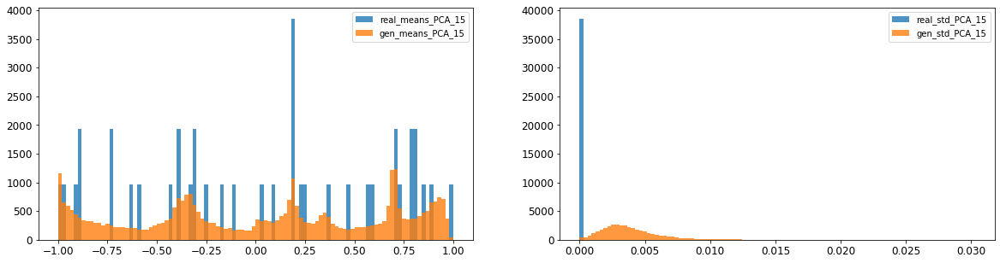

16: mean KL divergence (r,g) = 1.3900422322069628
16: mean JS divergence = 0.39185182930733586
16: mean 1-BC divergence = 0.361222792926444

16: std KL divergence (r,g) = 5.559127814585138
16: std JS divergence = 0.9255853893284517
16: std 1-BC divergence = 0.8543642861004479


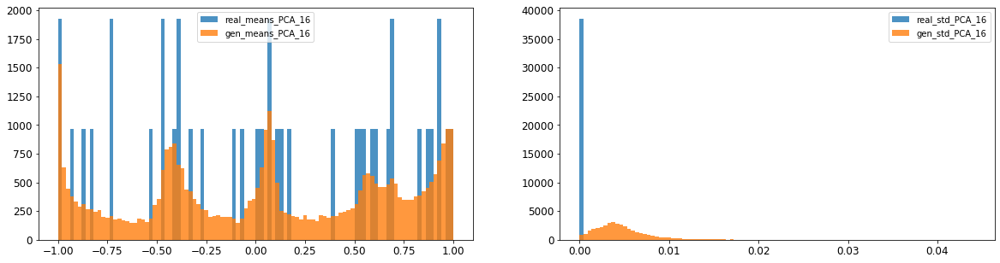



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.012755413795432725
Compose 1-BC divergence = 0.009472731172447069

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.012647168090621842
Compose weighted 1-BC divergence = 0.010423786713769978

Multivariate KL divergence = 43.6623584597025


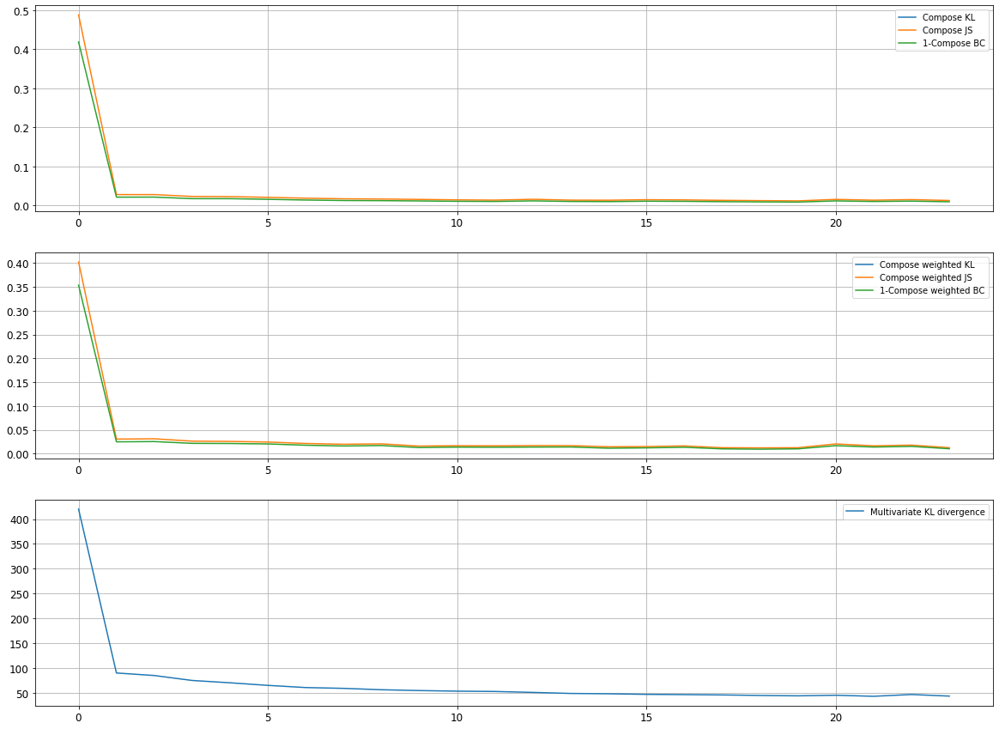

Epoch 4602/10000
discriminator loss: 0.046093 - generator loss: 7.933205 - 27s
Epoch 4603/10000
discriminator loss: 0.249198 - generator loss: 7.486768 - 29s
Epoch 4604/10000
discriminator loss: 0.043750 - generator loss: 7.892729 - 29s
Epoch 4605/10000
discriminator loss: 0.173574 - generator loss: 7.829429 - 28s
Epoch 4606/10000
discriminator loss: 0.078353 - generator loss: 7.547215 - 28s
Epoch 4607/10000
discriminator loss: 0.038661 - generator loss: 8.071482 - 28s
Epoch 4608/10000
discriminator loss: 0.048657 - generator loss: 8.063754 - 28s
Epoch 4609/10000
discriminator loss: 0.330961 - generator loss: 7.446266 - 28s
Epoch 4610/10000
discriminator loss: 0.043738 - generator loss: 7.969278 - 29s
Epoch 4611/10000
discriminator loss: 0.046347 - generator loss: 8.021993 - 29s
Epoch 4612/10000
discriminator loss: 0.253973 - generator loss: 7.955368 - 28s
Epoch 4613/10000
discriminator loss: 0.089944 - generator loss: 7.499860 - 28s
Epoch 4614/10000
discriminator loss: 0.040787 - gene

discriminator loss: 0.277971 - generator loss: 7.676406 - 28s
Epoch 4707/10000
discriminator loss: 0.055541 - generator loss: 7.730063 - 28s
Epoch 4708/10000
discriminator loss: 0.040117 - generator loss: 8.092486 - 28s
Epoch 4709/10000
discriminator loss: 0.284342 - generator loss: 7.639266 - 28s
Epoch 4710/10000
discriminator loss: 0.057721 - generator loss: 7.654365 - 28s
Epoch 4711/10000
discriminator loss: 0.043167 - generator loss: 8.117000 - 28s
Epoch 4712/10000
discriminator loss: 0.213254 - generator loss: 7.916581 - 28s
Epoch 4713/10000
discriminator loss: 0.080606 - generator loss: 7.615187 - 28s
Epoch 4714/10000
discriminator loss: 0.042754 - generator loss: 8.146857 - 28s
Epoch 4715/10000
discriminator loss: 0.202608 - generator loss: 7.605093 - 28s
Epoch 4716/10000
discriminator loss: 0.053798 - generator loss: 7.944975 - 28s
Epoch 4717/10000
discriminator loss: 0.225664 - generator loss: 7.935191 - 28s
Epoch 4718/10000
discriminator loss: 0.057496 - generator loss: 7.791

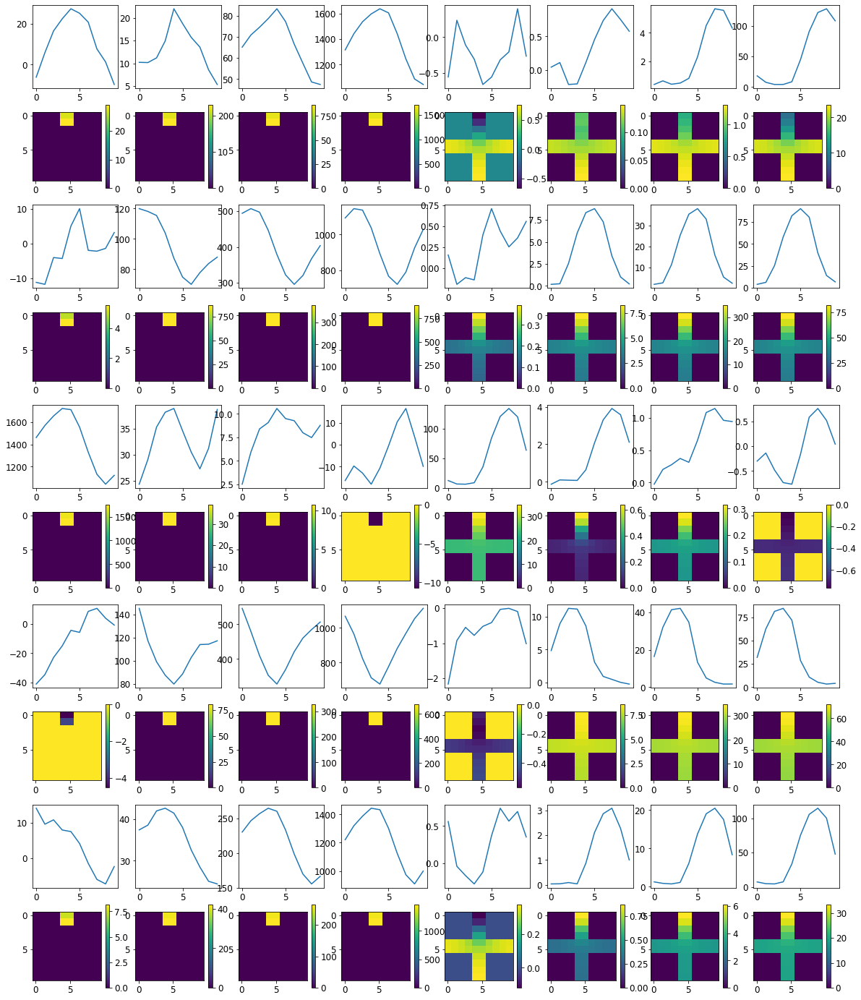


R0 generated:
[[19.641373   17.476765  ]
 [19.641546   17.394049  ]
 [19.645355   17.380764  ]
 [19.644361   17.385616  ]
 [19.640326   17.446917  ]
 [19.644217   17.426693  ]
 [19.664917   17.4837    ]
 [19.666677   17.454103  ]
 [19.643517   17.415302  ]
 [19.65501    17.523603  ]
 [17.11333     0.38359356]
 [17.044119    0.36951804]
 [17.083252    0.35803676]
 [17.070803    0.34473214]
 [17.061954    0.3443286 ]
 [17.087996    0.34758234]
 [17.043325    0.33227473]
 [17.047293    0.33340478]
 [17.130465    0.3387868 ]
 [17.106157    0.33911628]
 [16.990385    0.6714787 ]
 [17.09872     0.63199335]
 [17.122648    0.61562914]
 [17.130934    0.6265244 ]
 [17.139126    0.6552865 ]
 [17.134523    0.65500194]
 [17.125544    0.65393835]
 [17.116634    0.64861405]
 [17.14701     0.687935  ]
 [17.194748    0.6154589 ]
 [19.742788   16.731968  ]
 [19.735727   16.563307  ]
 [19.719578   16.564106  ]
 [19.716946   16.497822  ]
 [19.724094   16.535917  ]
 [19.726358   16.445587  ]
 [19.73786   

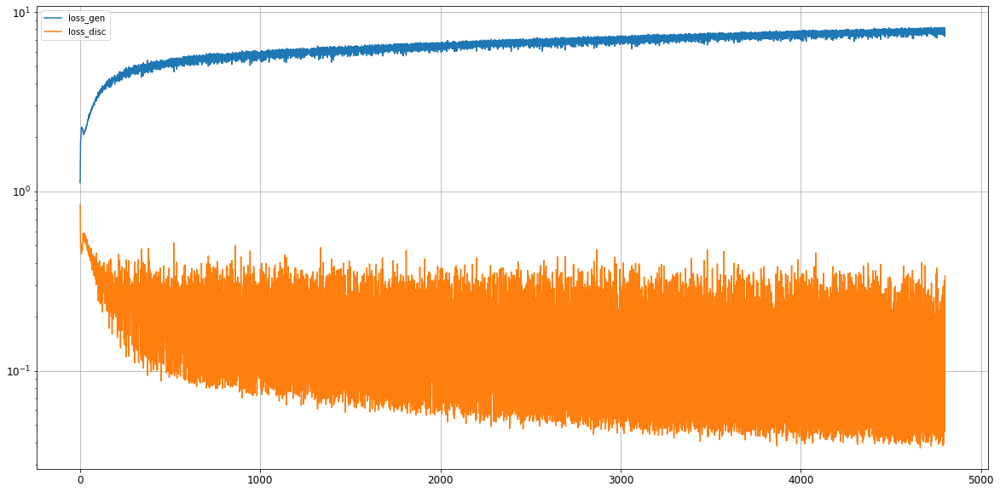

0: mean KL divergence (r,g) = 0.04390448694781156
0: mean JS divergence = 0.012170612499107395
0: mean 1-BC divergence = 0.009555090375863773

0: std KL divergence (r,g) = 0.20643497176076256
0: std JS divergence = 0.055093183485614206
0: std 1-BC divergence = 0.047203604993307446


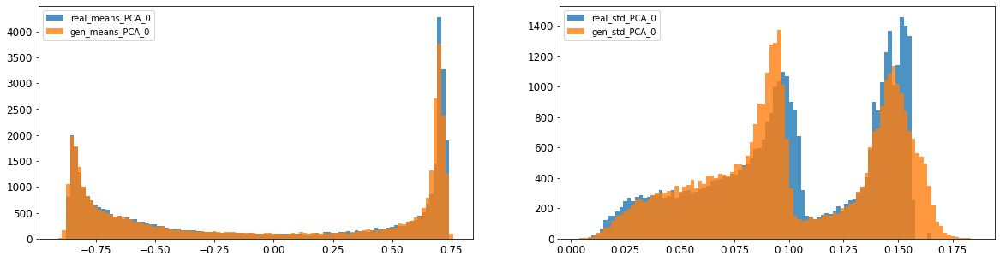

1: mean KL divergence (r,g) = 0.016192385608608206
1: mean JS divergence = 0.004161163717520137
1: mean 1-BC divergence = 0.0029848873500505357

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.020273150579474424
1: std 1-BC divergence = 0.015337472967415056


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


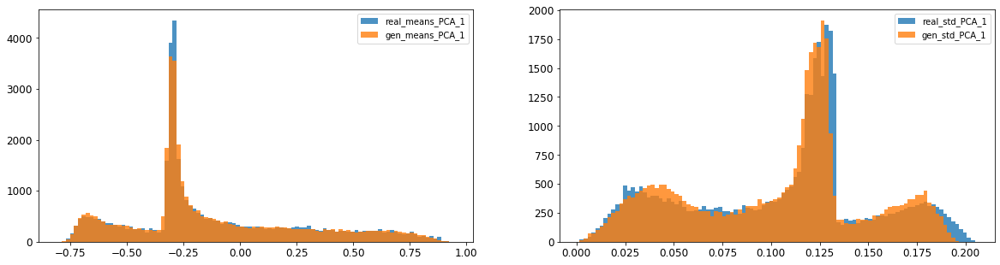

2: mean KL divergence (r,g) = 0.014283889375000787
2: mean JS divergence = 0.003578353258553822
2: mean 1-BC divergence = 0.0025661443743122403

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.011716250360475404
2: std 1-BC divergence = 0.009248504893600407


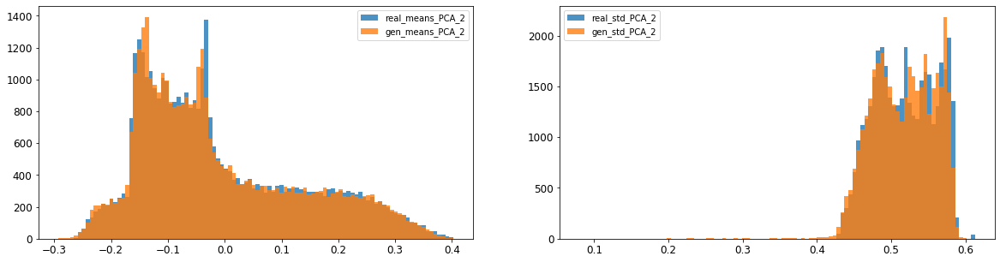

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.0209276004440335
3: mean 1-BC divergence = 0.015006686283036585

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.08243320774770603
3: std 1-BC divergence = 0.06123083150829689


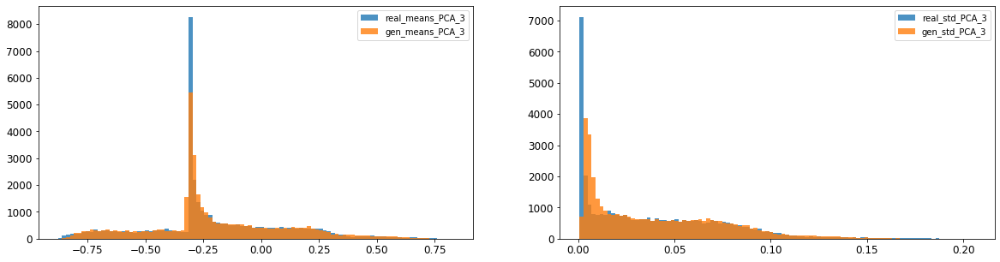

4: mean KL divergence (r,g) = 0.050433791852156046
4: mean JS divergence = 0.013167544744273322
4: mean 1-BC divergence = 0.00967067444714964

4: std KL divergence (r,g) = 0.04452775306013957
4: std JS divergence = 0.009868740255994587
4: std 1-BC divergence = 0.006960190749198181


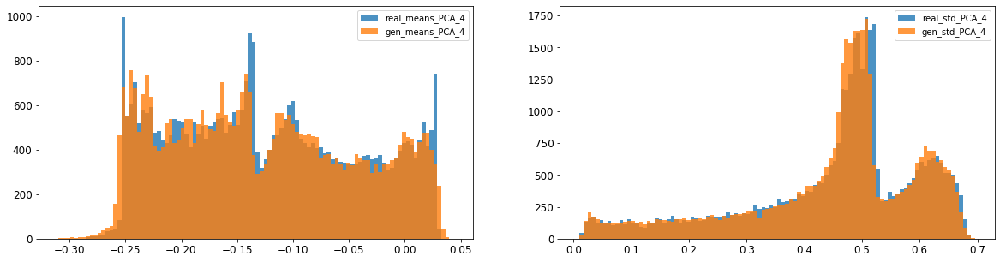

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.028672082289149095
5: mean 1-BC divergence = 0.02109703215179104

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.018291742699928636
5: std 1-BC divergence = 0.01500535679918602


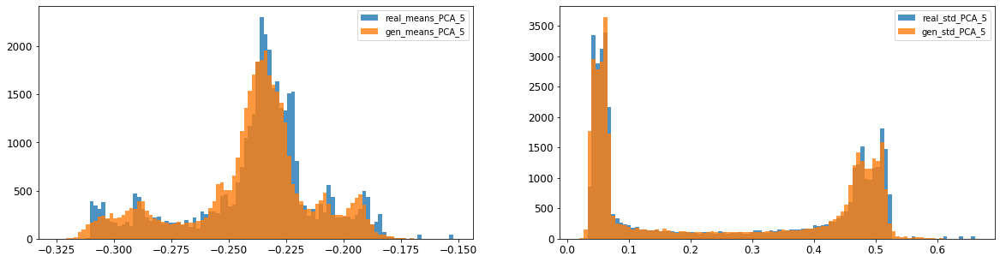

6: mean KL divergence (r,g) = 0.017842828773403634
6: mean JS divergence = 0.0046495274230542874
6: mean 1-BC divergence = 0.0033070441081419766

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.008312328450561839
6: std 1-BC divergence = 0.005885409082164728


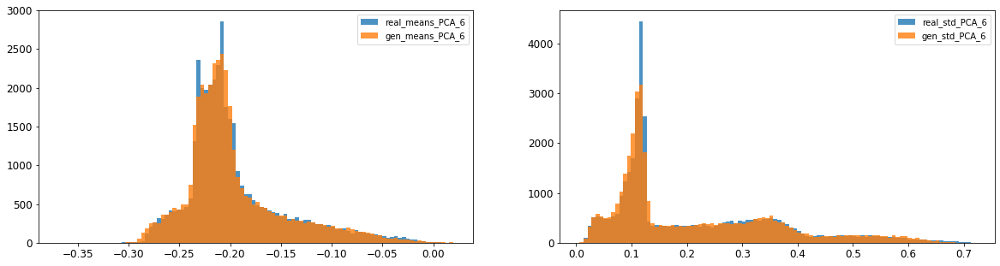

7: mean KL divergence (r,g) = 0.10531455631115154
7: mean JS divergence = 0.024723379129450062
7: mean 1-BC divergence = 0.018437032797947617

7: std KL divergence (r,g) = 0.034075094974234006
7: std JS divergence = 0.008557460897932157
7: std 1-BC divergence = 0.00602420652525637


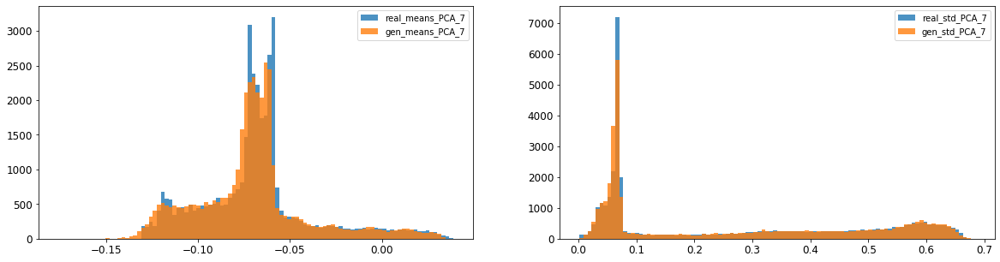

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0057481423387622365
8: mean 1-BC divergence = 0.004045179290117273

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.01006448580378559
8: std 1-BC divergence = 0.007178757769549904


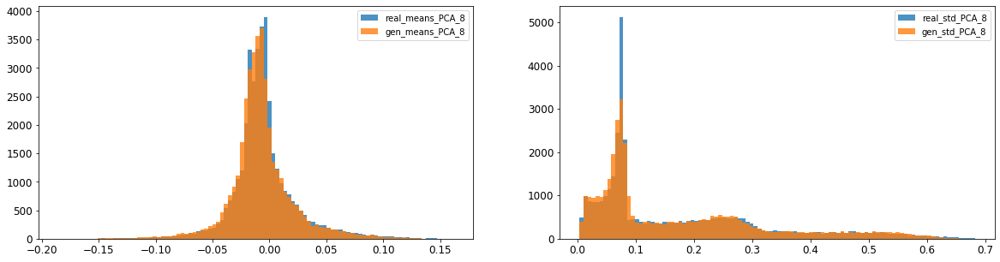

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003486800404854098
9: mean 1-BC divergence = 0.002494867492452646

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.011629465335833459
9: std 1-BC divergence = 0.008295641042884494


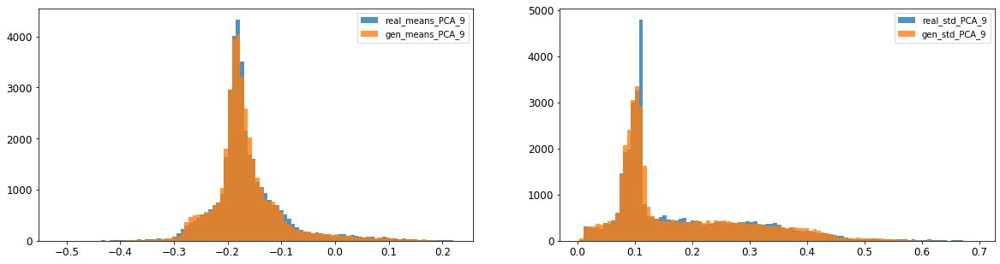

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.006926774863069591
10: mean 1-BC divergence = 0.004911687341996651

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007296153242753459
10: std 1-BC divergence = 0.006032647805680136


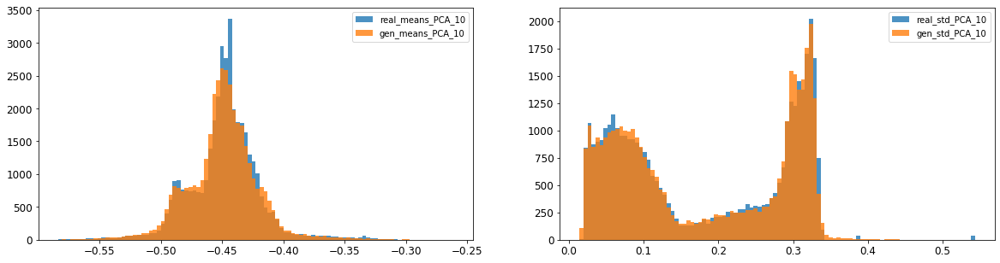

11: mean KL divergence (r,g) = 0.028929258869945153
11: mean JS divergence = 0.007356430983641287
11: mean 1-BC divergence = 0.005180362738131716

11: std KL divergence (r,g) = 0.04357220089837471
11: std JS divergence = 0.012055390465756271
11: std 1-BC divergence = 0.008656581860297496


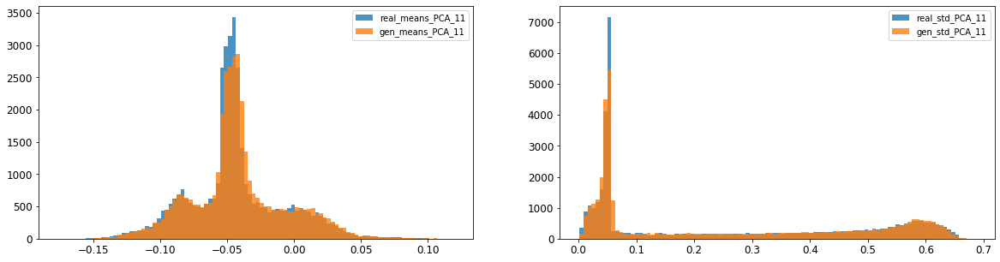

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.005918564394493588
12: mean 1-BC divergence = 0.004172055462629998

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01741103429570668
12: std 1-BC divergence = 0.01237740018127298


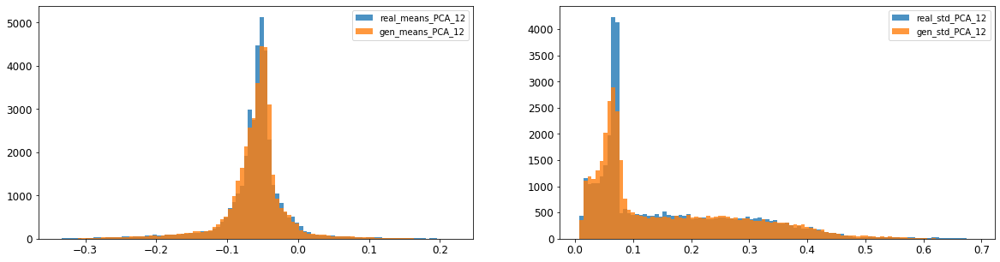

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.01818412161674687
13: mean 1-BC divergence = 0.012730214165335485

13: std KL divergence (r,g) = 0.06721080373631763
13: std JS divergence = 0.016787988424788687
13: std 1-BC divergence = 0.011776509525007861


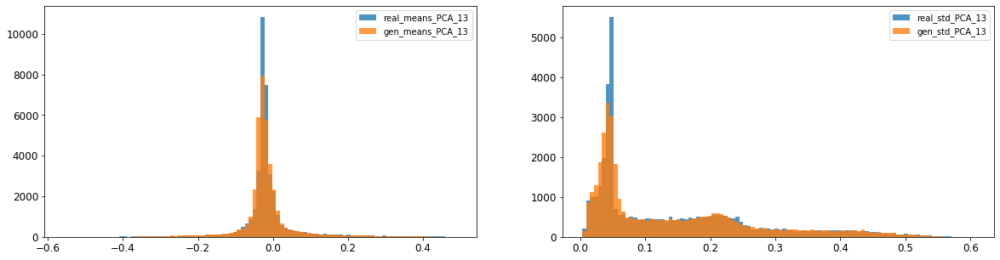

14: mean KL divergence (r,g) = 0.052900741703460374
14: mean JS divergence = 0.01281651296601637
14: mean 1-BC divergence = 0.008965875948138136

14: std KL divergence (r,g) = 0.031764091917155755
14: std JS divergence = 0.007861688154999774
14: std 1-BC divergence = 0.005478244222700601


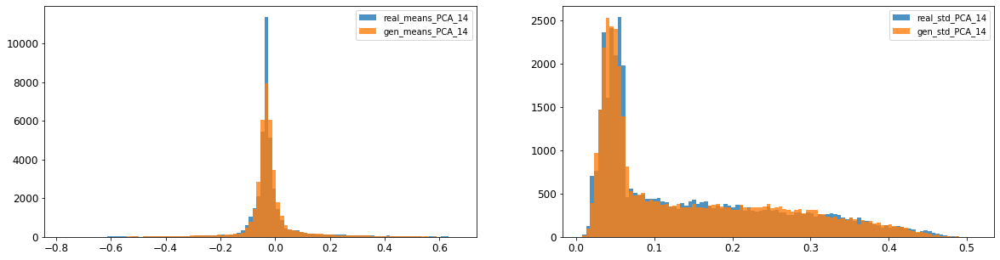

15: mean KL divergence (r,g) = 1.7799113663850228
15: mean JS divergence = 0.47767139436978423
15: mean 1-BC divergence = 0.43709078025866255

15: std KL divergence (r,g) = 6.241798236655127
15: std JS divergence = 0.9491661792945085
15: std 1-BC divergence = 0.8850482064105616


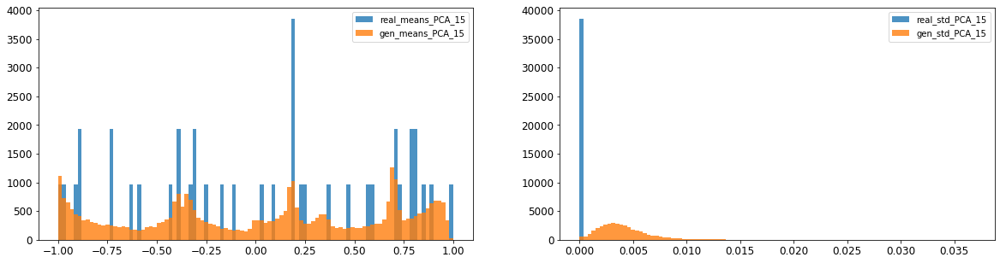

16: mean KL divergence (r,g) = 1.4387227422035498
16: mean JS divergence = 0.40107020667417925
16: mean 1-BC divergence = 0.36888085676616555

16: std KL divergence (r,g) = 5.631549294323111
16: std JS divergence = 0.9285057325736582
16: std 1-BC divergence = 0.8579741588165628


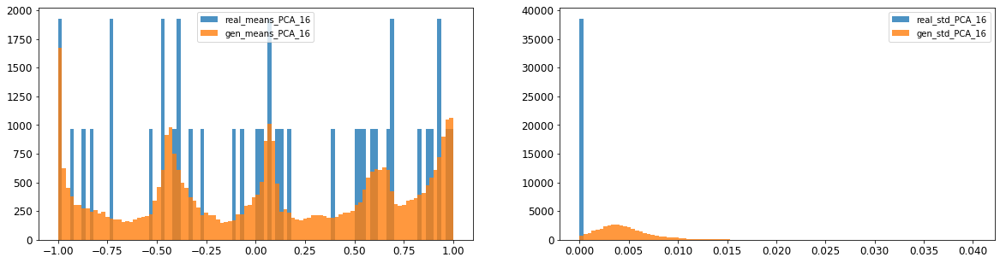



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.015671329375801228
Compose 1-BC divergence = 0.011727206475097174

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.02577681230622889
Compose weighted 1-BC divergence = 0.0210535631124964

Multivariate KL divergence = 43.79544322596502


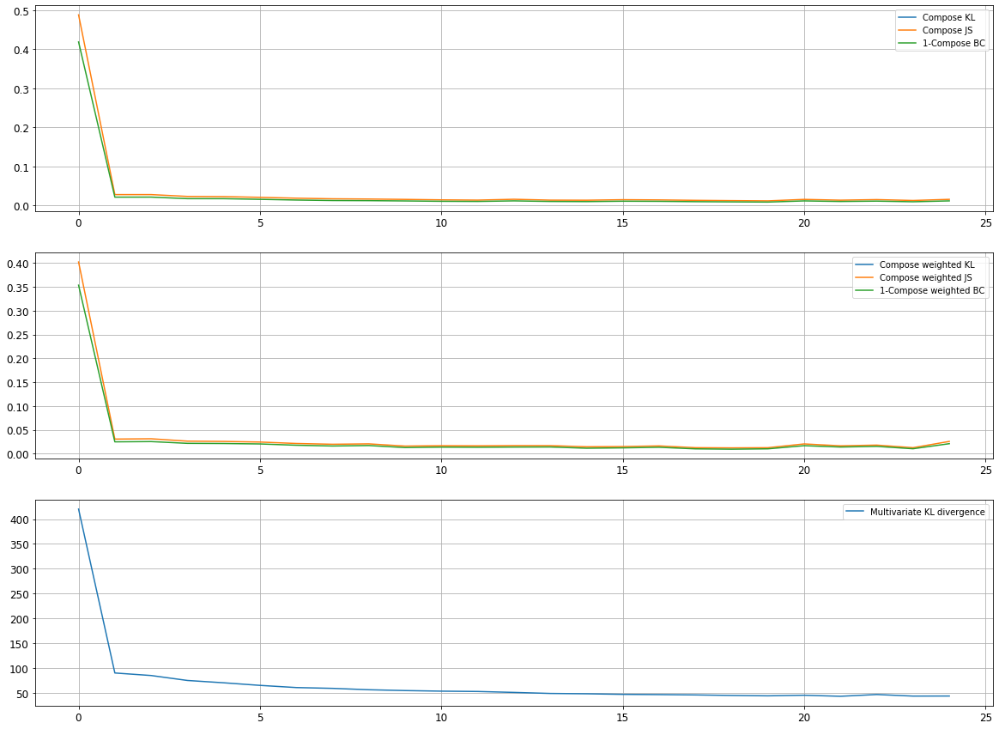

Epoch 4802/10000
discriminator loss: 0.042876 - generator loss: 7.950517 - 28s
Epoch 4803/10000
discriminator loss: 0.048144 - generator loss: 8.071560 - 28s
Epoch 4804/10000
discriminator loss: 0.221671 - generator loss: 7.569157 - 28s
Epoch 4805/10000
discriminator loss: 0.043542 - generator loss: 8.115827 - 29s
Epoch 4806/10000
discriminator loss: 0.045111 - generator loss: 8.148960 - 29s
Epoch 4807/10000
discriminator loss: 0.275256 - generator loss: 7.462480 - 29s
Epoch 4808/10000
discriminator loss: 0.043928 - generator loss: 8.022406 - 29s
Epoch 4809/10000
discriminator loss: 0.164356 - generator loss: 8.108017 - 29s
Epoch 4810/10000
discriminator loss: 0.067938 - generator loss: 7.731118 - 29s
Epoch 4811/10000
discriminator loss: 0.051362 - generator loss: 8.119852 - 29s
Epoch 4812/10000
discriminator loss: 0.230335 - generator loss: 7.681022 - 29s
Epoch 4813/10000
discriminator loss: 0.050013 - generator loss: 8.036903 - 29s
Epoch 4814/10000
discriminator loss: 0.041274 - gene

discriminator loss: 0.294517 - generator loss: 7.437410 - 28s
Epoch 4907/10000
discriminator loss: 0.039318 - generator loss: 8.198467 - 28s
Epoch 4908/10000
discriminator loss: 0.041514 - generator loss: 8.255563 - 28s
Epoch 4909/10000
discriminator loss: 0.287661 - generator loss: 7.442260 - 29s
Epoch 4910/10000
discriminator loss: 0.037707 - generator loss: 8.216611 - 28s
Epoch 4911/10000
discriminator loss: 0.054964 - generator loss: 8.068768 - 28s
Epoch 4912/10000
discriminator loss: 0.059913 - generator loss: 8.062612 - 28s
Epoch 4913/10000
discriminator loss: 0.320705 - generator loss: 7.368588 - 28s
Epoch 4914/10000
discriminator loss: 0.042515 - generator loss: 8.104270 - 28s
Epoch 4915/10000
discriminator loss: 0.049571 - generator loss: 8.129569 - 28s
Epoch 4916/10000
discriminator loss: 0.275552 - generator loss: 7.743557 - 28s
Epoch 4917/10000
discriminator loss: 0.056221 - generator loss: 7.784832 - 28s
Epoch 4918/10000
discriminator loss: 0.176741 - generator loss: 7.960

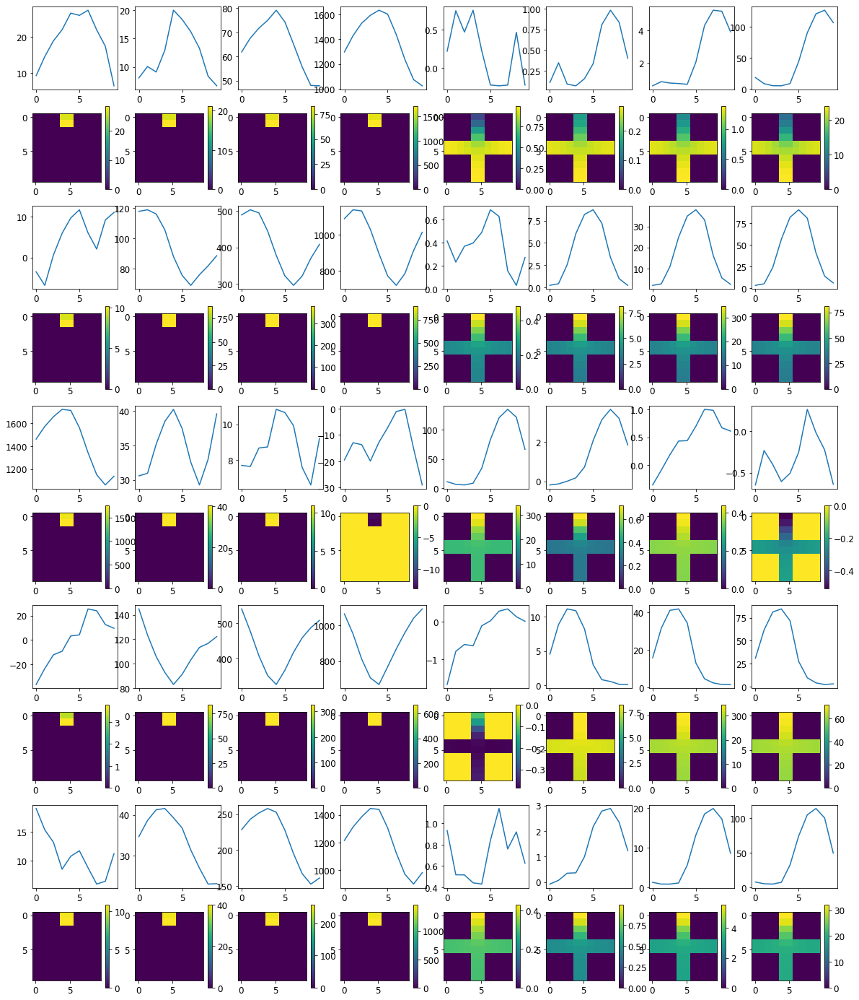


R0 generated:
[[19.660896   17.363081  ]
 [19.65947    17.238667  ]
 [19.660746   17.19964   ]
 [19.661777   17.204294  ]
 [19.660978   17.248884  ]
 [19.668058   17.224155  ]
 [19.687243   17.262499  ]
 [19.687609   17.247648  ]
 [19.670597   17.190615  ]
 [19.674164   17.29951   ]
 [17.103378    0.36791977]
 [17.100586    0.35964787]
 [17.15942     0.34471697]
 [17.18018     0.33183214]
 [17.162       0.3299837 ]
 [17.185423    0.33365202]
 [17.16524     0.32135904]
 [17.14087     0.32440636]
 [17.191223    0.3274274 ]
 [17.165947    0.33187065]
 [16.897783    0.5517311 ]
 [17.075766    0.5416732 ]
 [17.12794     0.5198296 ]
 [17.150427    0.5193036 ]
 [17.169636    0.5327587 ]
 [17.188646    0.5433542 ]
 [17.188808    0.53237677]
 [17.154877    0.5424411 ]
 [17.173187    0.58125645]
 [17.191067    0.5297161 ]
 [19.723185   17.065128  ]
 [19.71985    16.934362  ]
 [19.702534   16.893883  ]
 [19.700481   16.861301  ]
 [19.704727   16.855934  ]
 [19.706772   16.766573  ]
 [19.714045  

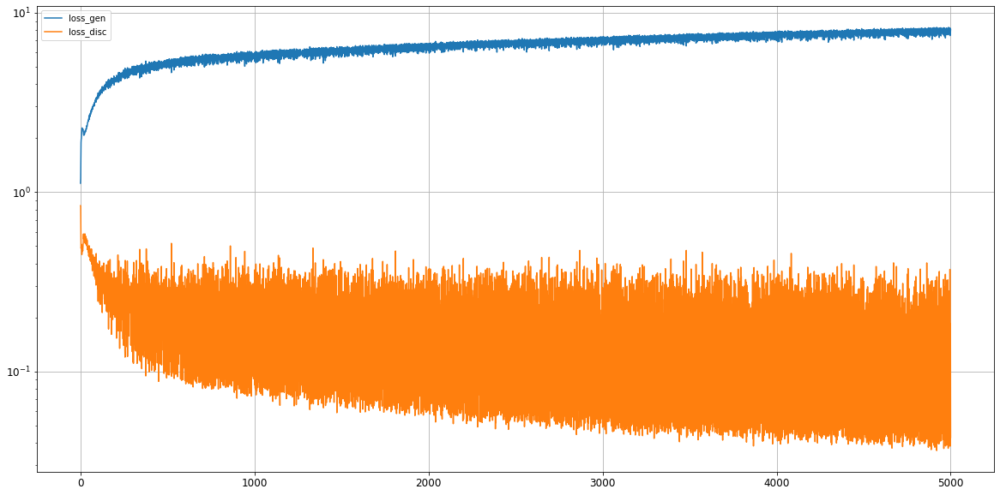

0: mean KL divergence (r,g) = 0.025926165832961968
0: mean JS divergence = 0.006690553503902718
0: mean 1-BC divergence = 0.005041390524079148

0: std KL divergence (r,g) = 0.04507342181420584
0: std JS divergence = 0.013195050053121025
0: std 1-BC divergence = 0.01122216717259139


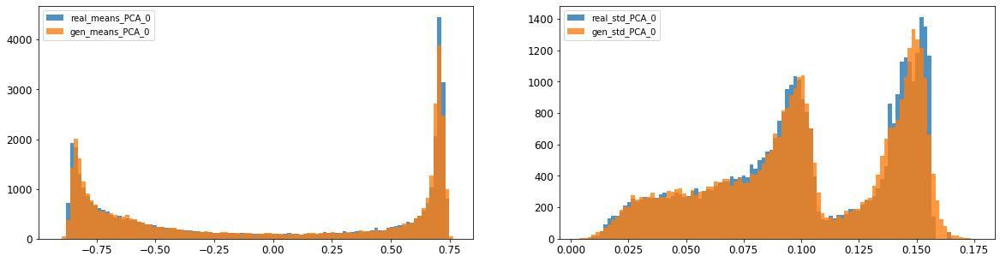

1: mean KL divergence (r,g) = 0.027751317642094164
1: mean JS divergence = 0.006811567635101334
1: mean 1-BC divergence = 0.004774560192945865

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.0062852045224009055
1: std 1-BC divergence = 0.00444487966070628


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


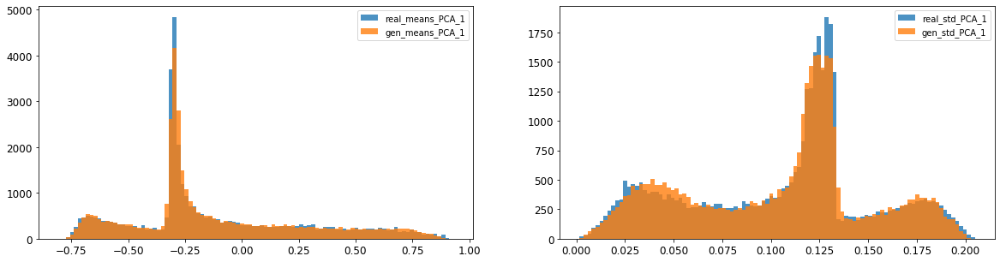

2: mean KL divergence (r,g) = 0.012377481448526247
2: mean JS divergence = 0.003151135556588721
2: mean 1-BC divergence = 0.0022876657826775837

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.01336567764022829
2: std 1-BC divergence = 0.010824899575588298


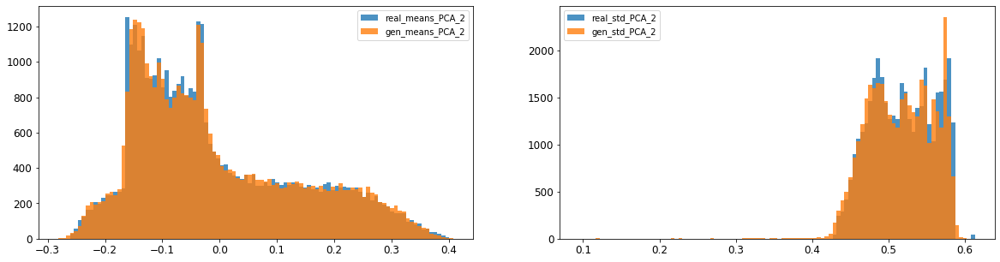

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.01017304141332886
3: mean 1-BC divergence = 0.0071290867247325584

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0460661915628411
3: std 1-BC divergence = 0.03279363857473394


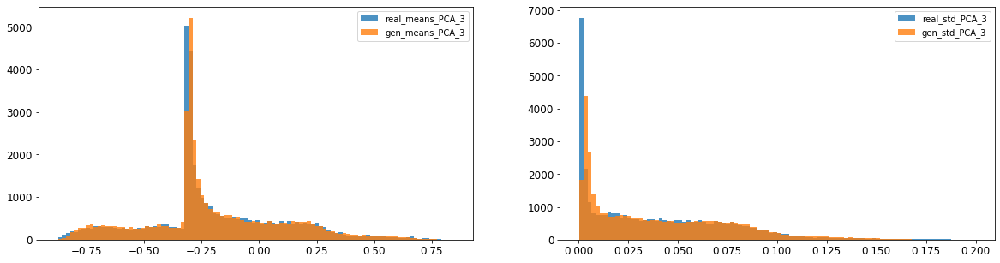

4: mean KL divergence (r,g) = 0.048878189292702046
4: mean JS divergence = 0.012994442966534472
4: mean 1-BC divergence = 0.010053237463093057

4: std KL divergence (r,g) = 0.021952453048109492
4: std JS divergence = 0.005291104697118533
4: std 1-BC divergence = 0.003745681533289469


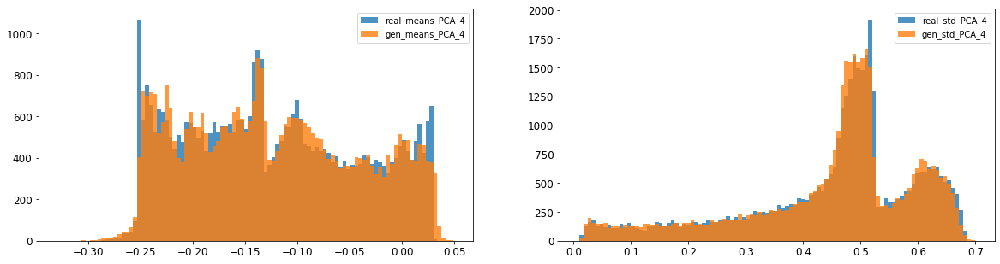

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.015341558299793744
5: mean 1-BC divergence = 0.011546648425688533

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.015733337010716324
5: std 1-BC divergence = 0.013037941941890119


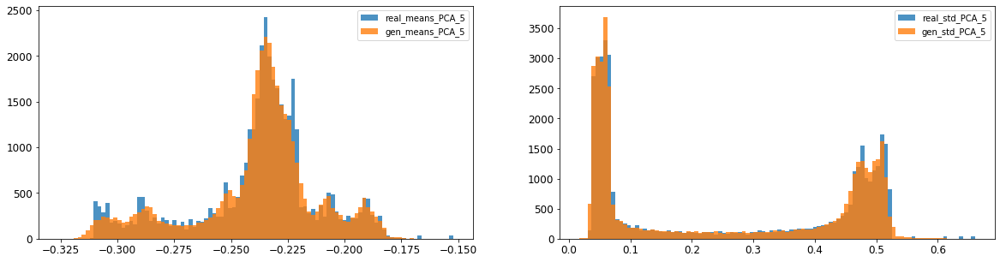

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.006039852651431074
6: mean 1-BC divergence = 0.0042471913000232675

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.007482509642903971
6: std 1-BC divergence = 0.005370205794611005


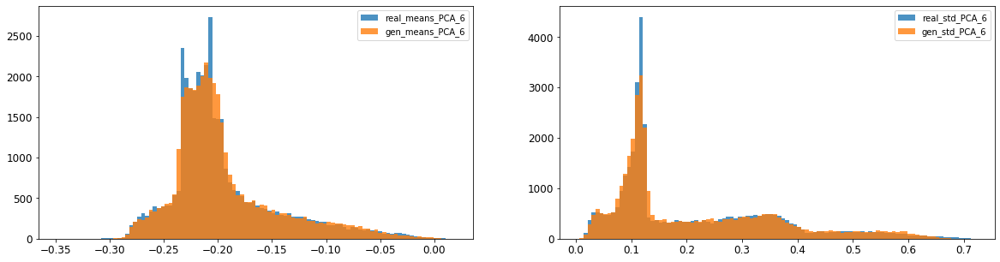

7: mean KL divergence (r,g) = 0.04199654057142108
7: mean JS divergence = 0.010424517843695403
7: mean 1-BC divergence = 0.007800133794978237

7: std KL divergence (r,g) = 0.027472376851175345
7: std JS divergence = 0.006506804671529682
7: std 1-BC divergence = 0.004572483826059015


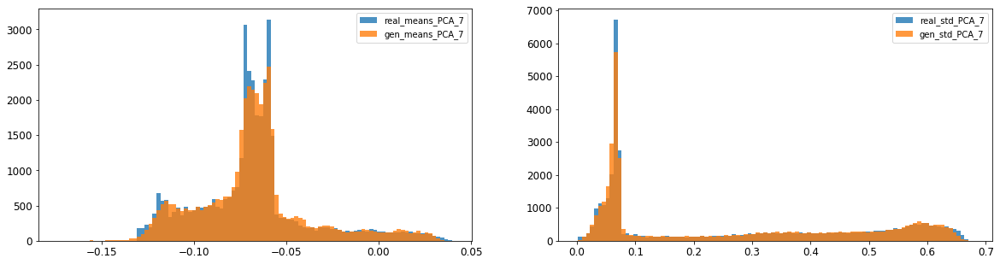

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0032394099266972983
8: mean 1-BC divergence = 0.0023100409214059647

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.009870490977424567
8: std 1-BC divergence = 0.006973378811808484


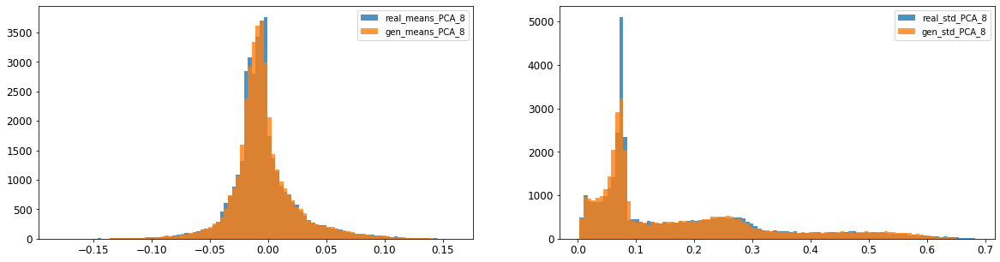

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0037057233862841576
9: mean 1-BC divergence = 0.002684405058493211

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.011354630768837595
9: std 1-BC divergence = 0.008026939855188098


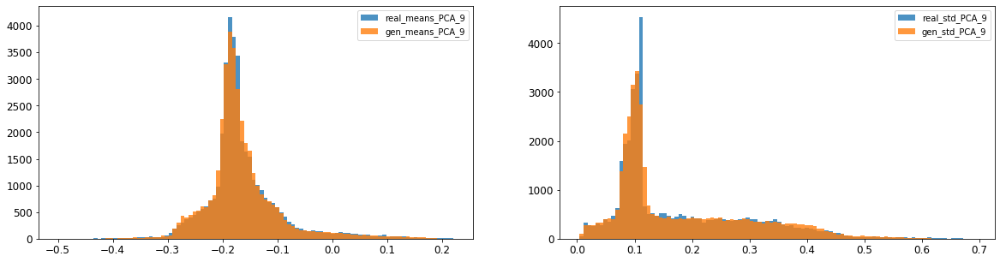

10: mean KL divergence (r,g) = 0.019326751333687466
10: mean JS divergence = 0.004676510116513653
10: mean 1-BC divergence = 0.0033234822194709857

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005248864229495697
10: std 1-BC divergence = 0.004363686184615134


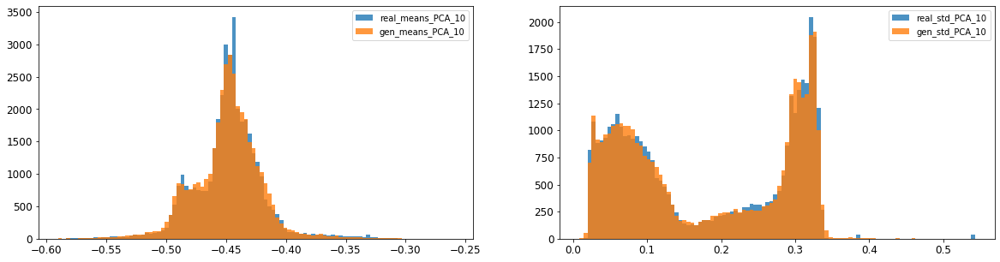

11: mean KL divergence (r,g) = 0.02845084012182445
11: mean JS divergence = 0.007292136967192469
11: mean 1-BC divergence = 0.005146856959452939

11: std KL divergence (r,g) = 0.022847056241837638
11: std JS divergence = 0.005629370539408141
11: std 1-BC divergence = 0.003967785532033252


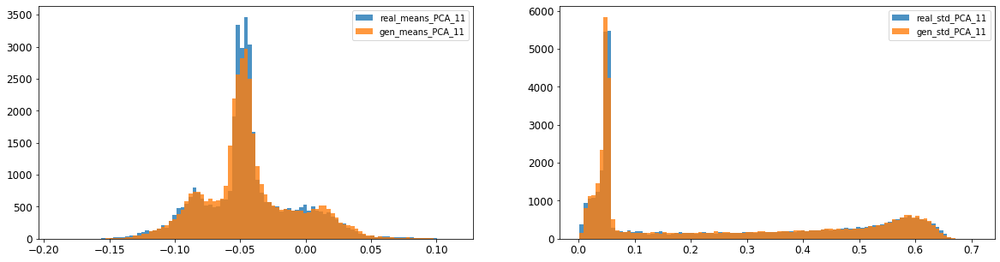

12: mean KL divergence (r,g) = 0.029515111091034836
12: mean JS divergence = 0.0073397281576366895
12: mean 1-BC divergence = 0.005114632077058756

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.018116272967488703
12: std 1-BC divergence = 0.012844728926228122


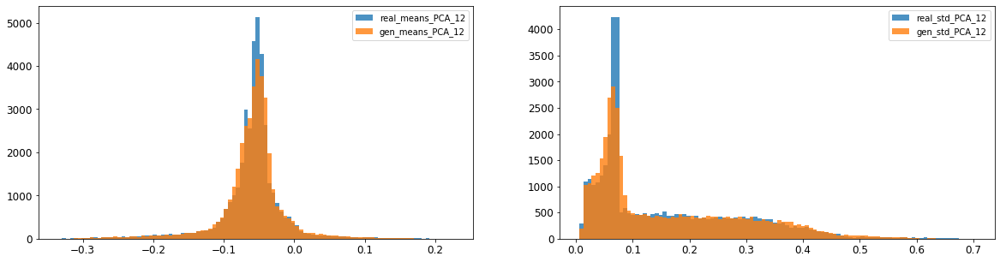

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.013240859937096913
13: mean 1-BC divergence = 0.009253381336224997

13: std KL divergence (r,g) = 0.06384483152539774
13: std JS divergence = 0.015623326250583904
13: std 1-BC divergence = 0.010937380991928536


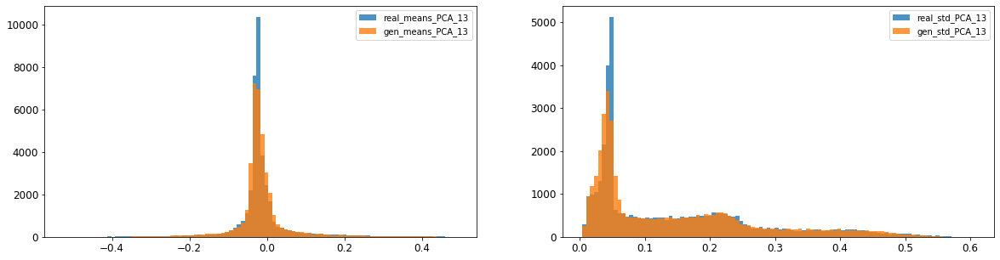

14: mean KL divergence (r,g) = 0.06614029365130082
14: mean JS divergence = 0.016321812868031055
14: mean 1-BC divergence = 0.01140308922014266

14: std KL divergence (r,g) = 0.03001974821180585
14: std JS divergence = 0.007270563368136149
14: std 1-BC divergence = 0.0050865999232901915


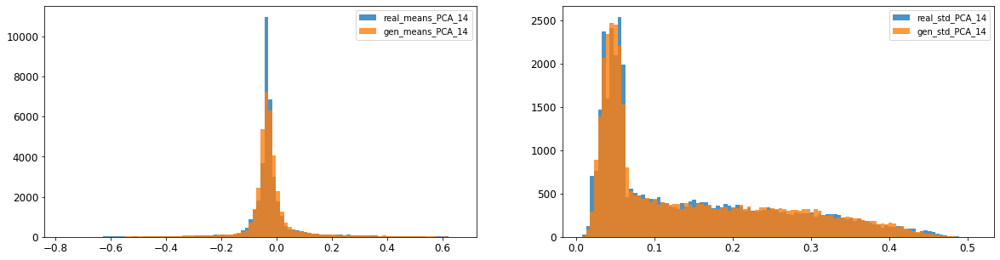

15: mean KL divergence (r,g) = 1.7365270091392528
15: mean JS divergence = 0.469223938102712
15: mean 1-BC divergence = 0.429756722198836

15: std KL divergence (r,g) = 6.686425622843185
15: std JS divergence = 0.9605023093255214
15: std 1-BC divergence = 0.9014645142487611


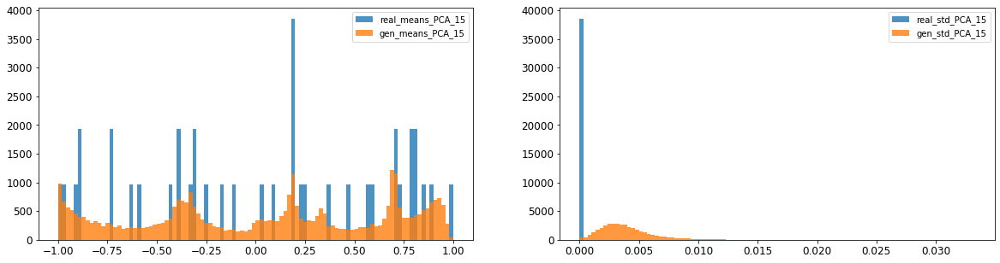

16: mean KL divergence (r,g) = 1.3792524648024822
16: mean JS divergence = 0.3873442091408897
16: mean 1-BC divergence = 0.3570756911440114

16: std KL divergence (r,g) = 5.817578314440731
16: std JS divergence = 0.9355211414487592
16: std 1-BC divergence = 0.8668420156137261


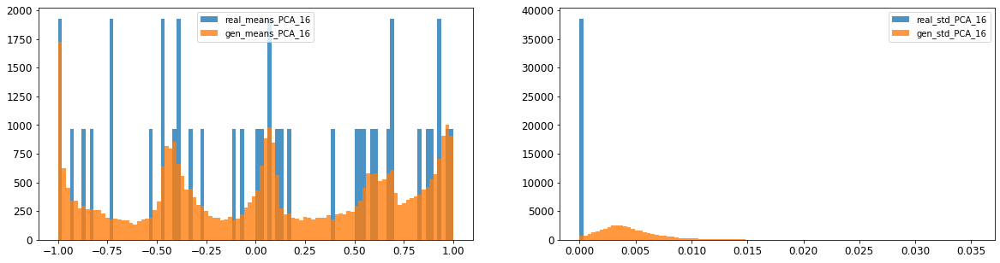



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010482741671068772
Compose 1-BC divergence = 0.007677606676834259

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.009967657989733359
Compose weighted 1-BC divergence = 0.0077684558502277845

Multivariate KL divergence = 42.03641693965918


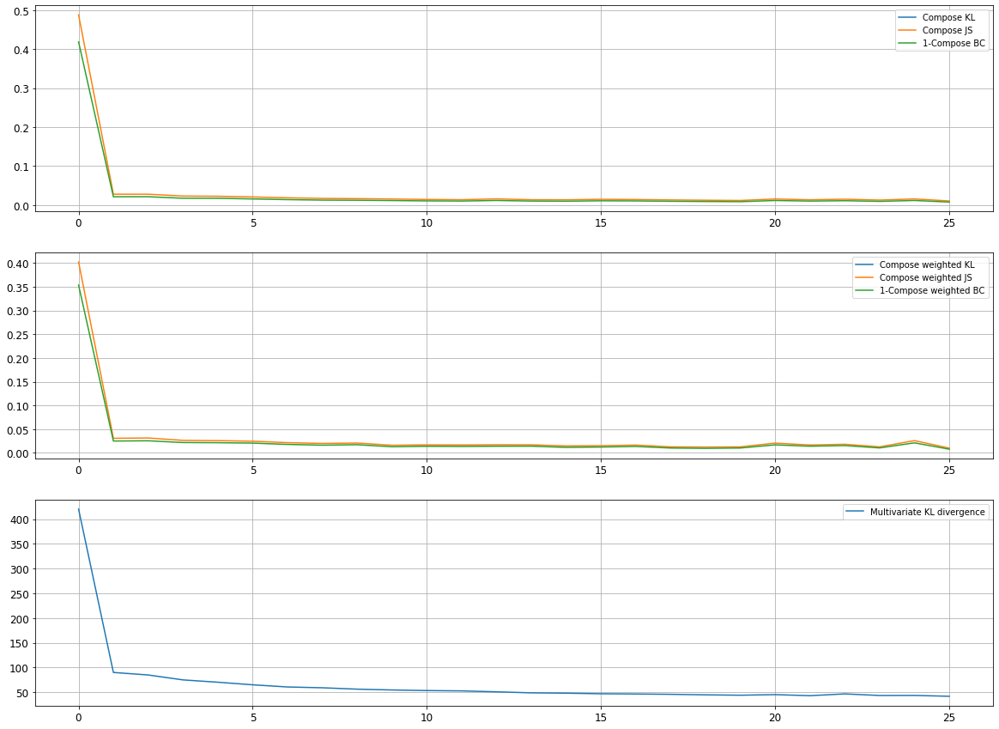

Epoch 5002/10000
discriminator loss: 0.045137 - generator loss: 8.171363 - 27s
Epoch 5003/10000
discriminator loss: 0.284687 - generator loss: 7.343525 - 28s
Epoch 5004/10000
discriminator loss: 0.039092 - generator loss: 8.195701 - 28s
Epoch 5005/10000
discriminator loss: 0.040414 - generator loss: 8.278279 - 29s
Epoch 5006/10000
discriminator loss: 0.248502 - generator loss: 7.632939 - 28s
Epoch 5007/10000
discriminator loss: 0.042522 - generator loss: 8.209564 - 29s
Epoch 5008/10000
discriminator loss: 0.147721 - generator loss: 7.821153 - 28s
Epoch 5009/10000
discriminator loss: 0.040519 - generator loss: 8.153038 - 28s
Epoch 5010/10000
discriminator loss: 0.045744 - generator loss: 8.226321 - 28s
Epoch 5011/10000
discriminator loss: 0.240746 - generator loss: 7.682081 - 29s
Epoch 5012/10000
discriminator loss: 0.051126 - generator loss: 8.069836 - 28s
Epoch 5013/10000
discriminator loss: 0.039508 - generator loss: 8.309083 - 28s
Epoch 5014/10000
discriminator loss: 0.304799 - gene

discriminator loss: 0.043742 - generator loss: 8.288476 - 28s
Epoch 5107/10000
discriminator loss: 0.226314 - generator loss: 7.773743 - 28s
Epoch 5108/10000
discriminator loss: 0.043525 - generator loss: 8.177840 - 28s
Epoch 5109/10000
discriminator loss: 0.245035 - generator loss: 7.890268 - 28s
Epoch 5110/10000
discriminator loss: 0.111553 - generator loss: 7.522817 - 28s
Epoch 5111/10000
discriminator loss: 0.037051 - generator loss: 8.293113 - 28s
Epoch 5112/10000
discriminator loss: 0.160492 - generator loss: 8.043780 - 28s
Epoch 5113/10000
discriminator loss: 0.146635 - generator loss: 7.574845 - 28s
Epoch 5114/10000
discriminator loss: 0.036852 - generator loss: 8.363692 - 28s
Epoch 5115/10000
discriminator loss: 0.044095 - generator loss: 8.257751 - 28s
Epoch 5116/10000
discriminator loss: 0.275354 - generator loss: 7.745432 - 28s
Epoch 5117/10000
discriminator loss: 0.042317 - generator loss: 8.137137 - 28s
Epoch 5118/10000
discriminator loss: 0.043737 - generator loss: 8.161

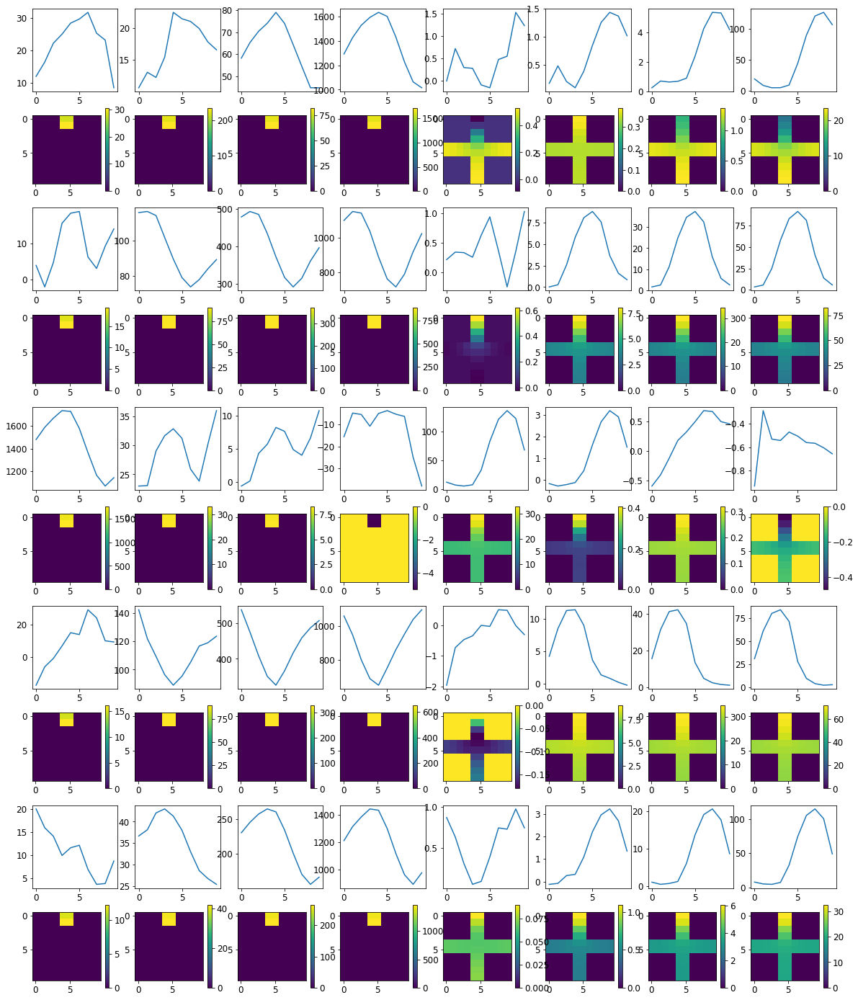


R0 generated:
[[19.669378   17.408218  ]
 [19.66698    17.363186  ]
 [19.67288    17.311186  ]
 [19.670172   17.305449  ]
 [19.669136   17.326487  ]
 [19.669401   17.343512  ]
 [19.688854   17.382235  ]
 [19.687881   17.384401  ]
 [19.673693   17.328285  ]
 [19.675411   17.411766  ]
 [17.042957    0.32425708]
 [16.988884    0.31468078]
 [17.028357    0.30263156]
 [17.004108    0.29400632]
 [16.99187     0.29321855]
 [17.012426    0.2980997 ]
 [17.005787    0.28744408]
 [16.998053    0.29049838]
 [17.12705     0.29719704]
 [17.05978     0.2983994 ]
 [16.839294    0.7726936 ]
 [16.965384    0.75290656]
 [16.993244    0.741248  ]
 [17.002907    0.743946  ]
 [17.011978    0.7667179 ]
 [17.007246    0.77456534]
 [17.017275    0.7608356 ]
 [16.993029    0.7625068 ]
 [17.054823    0.81076837]
 [17.06488     0.71349937]
 [19.756964   16.6728    ]
 [19.747456   16.64157   ]
 [19.735004   16.657087  ]
 [19.731047   16.618614  ]
 [19.73888    16.606611  ]
 [19.738138   16.515244  ]
 [19.746695  

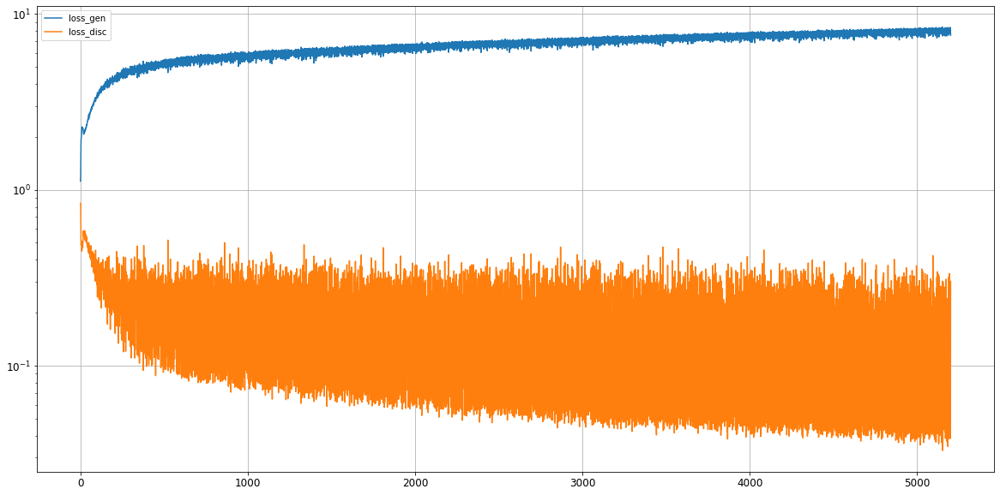

0: mean KL divergence (r,g) = 0.03602205925436125
0: mean JS divergence = 0.009343725113263354
0: mean 1-BC divergence = 0.007258215348230568

0: std KL divergence (r,g) = 0.06753284934242076
0: std JS divergence = 0.0159997538393152
0: std 1-BC divergence = 0.011872018229286074


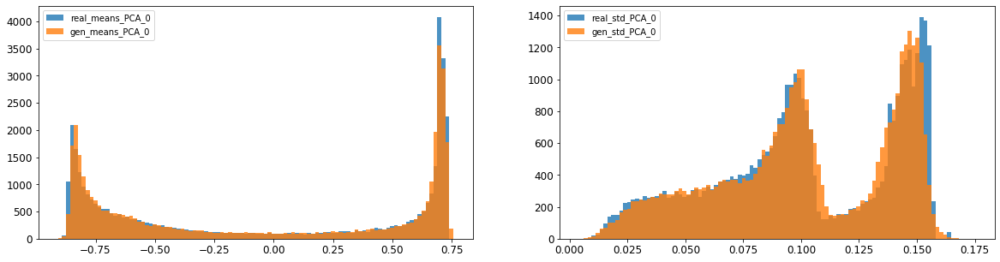

1: mean KL divergence (r,g) = 0.0201278060073011
1: mean JS divergence = 0.005041653650311514
1: mean 1-BC divergence = 0.0035350419920077147

1: std KL divergence (r,g) = 0.030747787074480754
1: std JS divergence = 0.008219630241230349
1: std 1-BC divergence = 0.005812897811655615


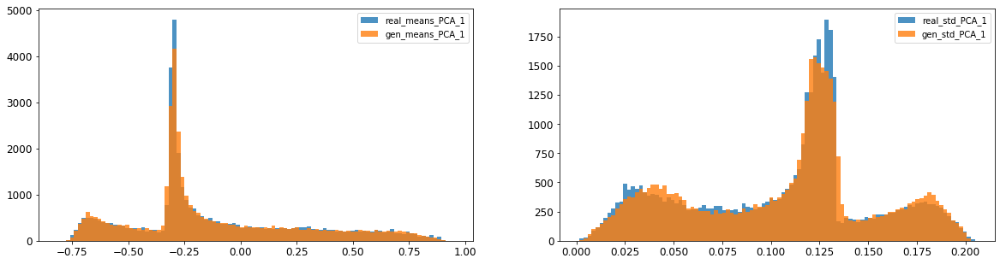

2: mean KL divergence (r,g) = 0.013933310758466459
2: mean JS divergence = 0.0034730834211893344
2: mean 1-BC divergence = 0.0025134989411045305

2: std KL divergence (r,g) = 0.02522878936492467
2: std JS divergence = 0.006894354636863326
2: std 1-BC divergence = 0.005869564825221718


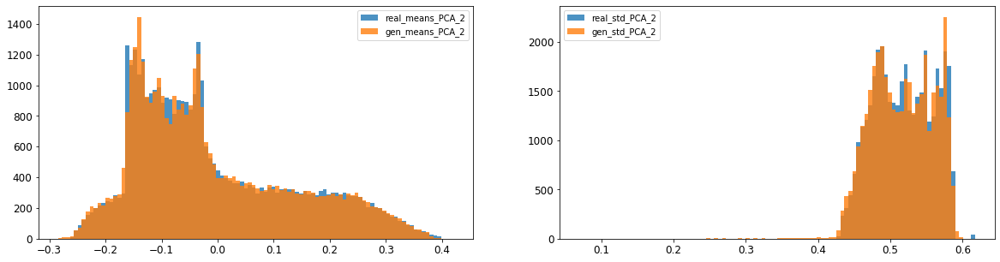

/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.014100885572779904
3: mean 1-BC divergence = 0.009969071972433019

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.07645552016538604
3: std 1-BC divergence = 0.055863781721288364


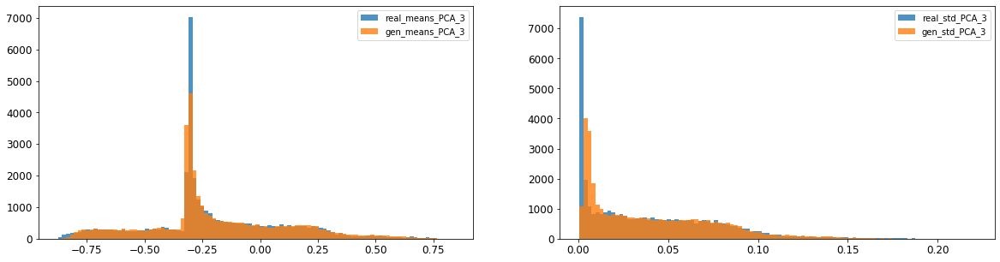

4: mean KL divergence (r,g) = 0.046449463908036816
4: mean JS divergence = 0.013713202041114859
4: mean 1-BC divergence = 0.011904660612727436

4: std KL divergence (r,g) = 0.021126155294124514
4: std JS divergence = 0.005063247619360217
4: std 1-BC divergence = 0.0036178760159653045


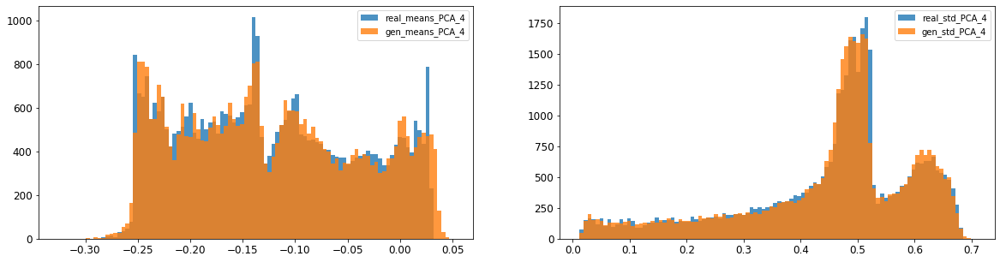

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.01875048836385744
5: mean 1-BC divergence = 0.01346359479036563

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.013970491715339282
5: std 1-BC divergence = 0.012440800899144344


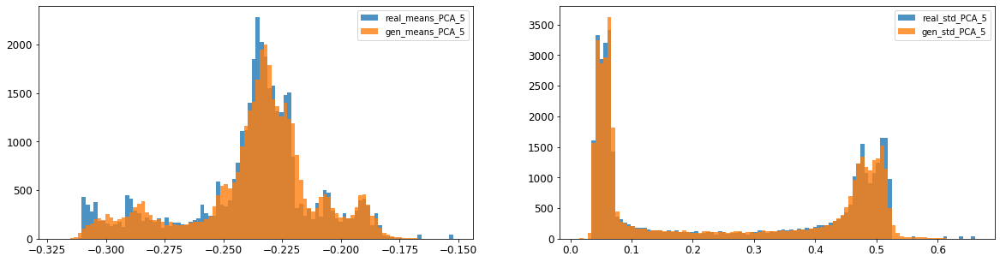

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0036614929194183007
6: mean 1-BC divergence = 0.0026115803564867868

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.008024372822354402
6: std 1-BC divergence = 0.005790038547781817


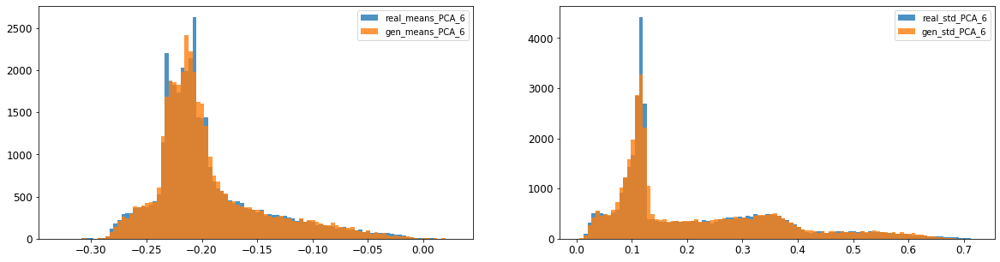

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.03169809387591037
7: mean 1-BC divergence = 0.023633496657137654

7: std KL divergence (r,g) = 0.028185962697343993
7: std JS divergence = 0.006799198833000825
7: std 1-BC divergence = 0.004840305528915789


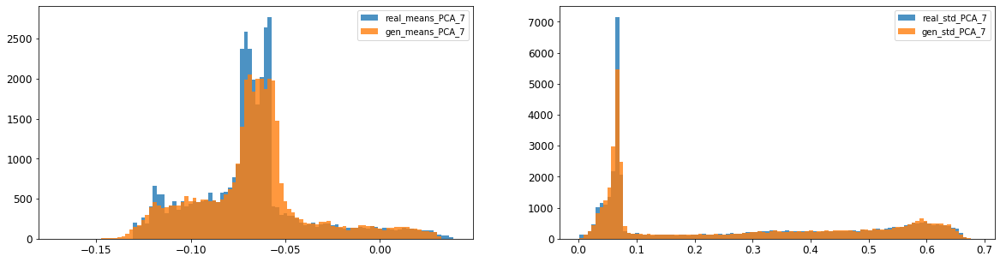

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0025035139579747943
8: mean 1-BC divergence = 0.0017559957374927437

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.00991132658076776
8: std 1-BC divergence = 0.006985839380584058


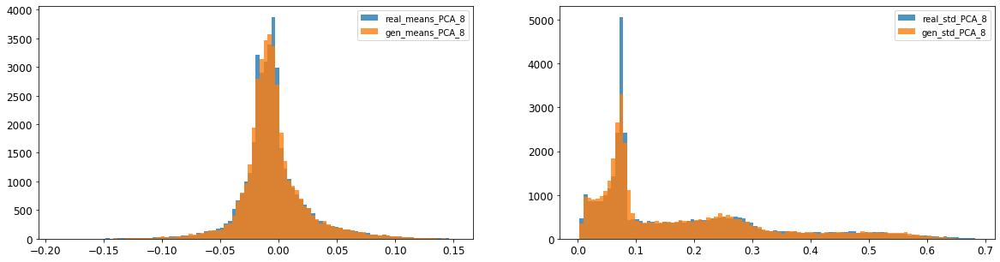

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004942653031955101
9: mean 1-BC divergence = 0.003570675425836778

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.009679556519327063
9: std 1-BC divergence = 0.0068836299721931615


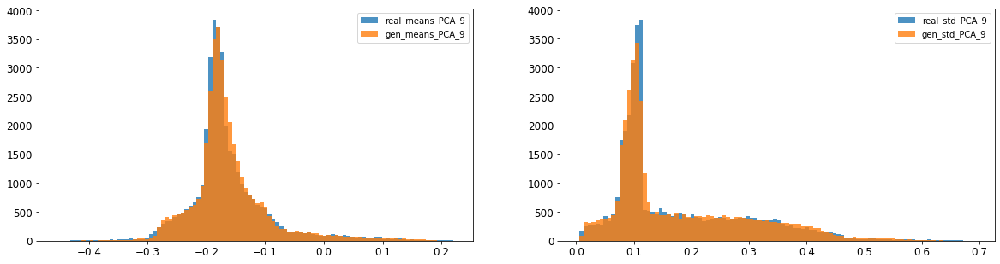

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.011889728540452501
10: mean 1-BC divergence = 0.008339616375001913

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.006527423064083699
10: std 1-BC divergence = 0.005576915404530869


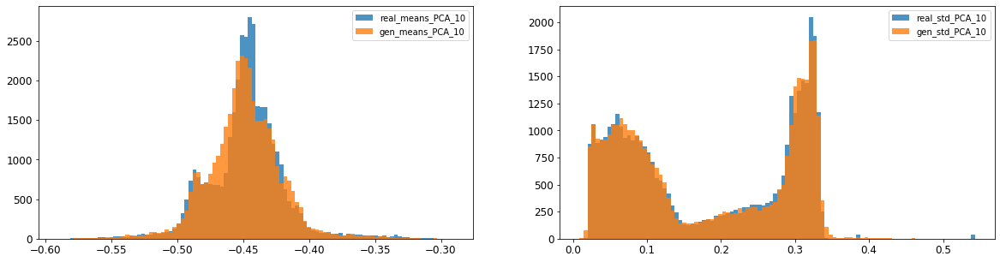

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.006378307865595626
11: mean 1-BC divergence = 0.0044595600999611795

11: std KL divergence (r,g) = 0.041624749522988926
11: std JS divergence = 0.011657469674735025
11: std 1-BC divergence = 0.00841385361816327


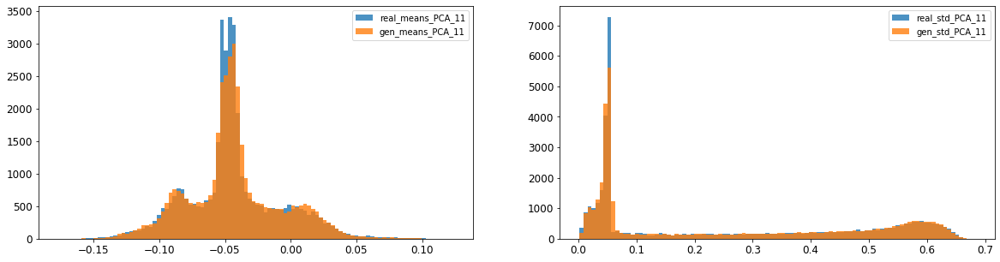

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.005684906352351367
12: mean 1-BC divergence = 0.004028293935389837

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01797802571490309
12: std 1-BC divergence = 0.012723020482998115


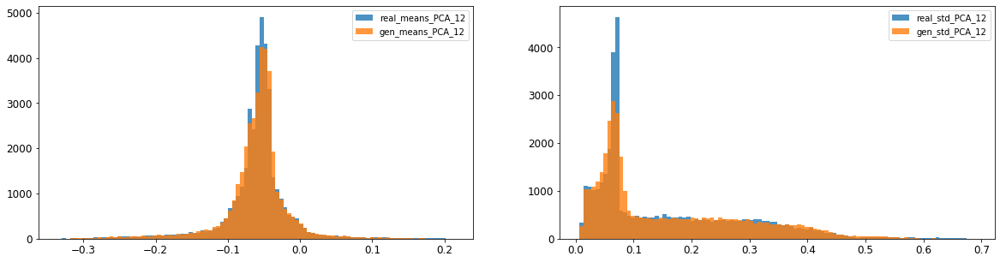

13: mean KL divergence (r,g) = 0.046367323615842566
13: mean JS divergence = 0.011329020172891512
13: mean 1-BC divergence = 0.00790535259317493

13: std KL divergence (r,g) = 0.0656493208191481
13: std JS divergence = 0.016029216209449276
13: std 1-BC divergence = 0.011256459810160657


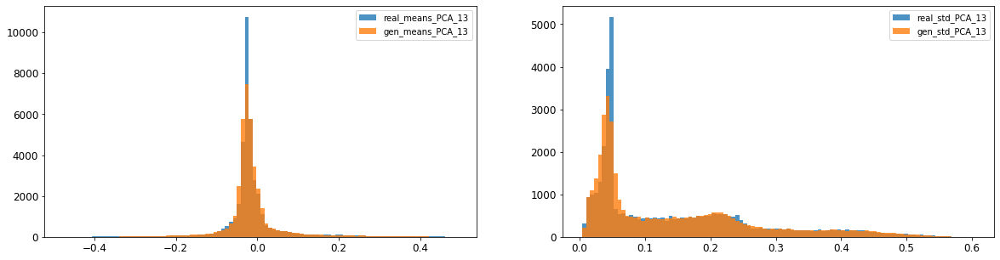

14: mean KL divergence (r,g) = 0.0747684589642943
14: mean JS divergence = 0.01867921895699801
14: mean 1-BC divergence = 0.013062599838893019

14: std KL divergence (r,g) = 0.023854894540885054
14: std JS divergence = 0.005871441783782514
14: std 1-BC divergence = 0.004092108374063375


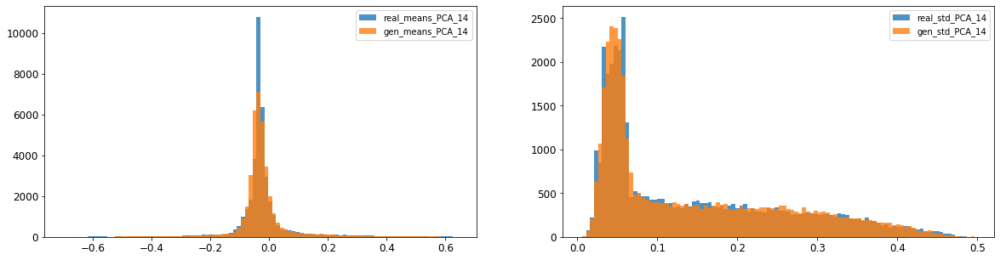

15: mean KL divergence (r,g) = 1.7559558787138634
15: mean JS divergence = 0.47375244534327593
15: mean 1-BC divergence = 0.4337877540989882

15: std KL divergence (r,g) = 7.068413156055134
15: std JS divergence = 0.9682732771961582
15: std 1-BC divergence = 0.9136827075607705


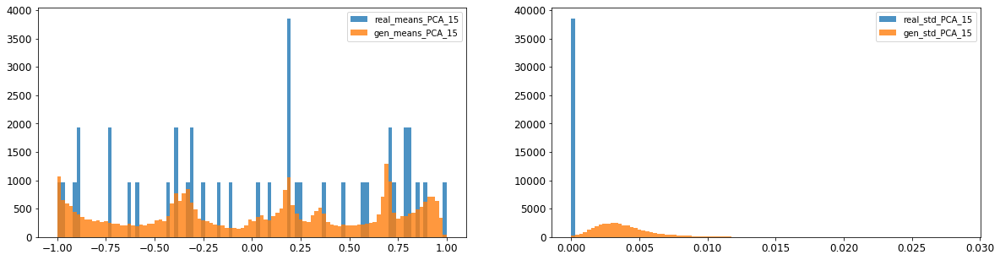

16: mean KL divergence (r,g) = 1.3985754557137304
16: mean JS divergence = 0.39311920207068
16: mean 1-BC divergence = 0.362428816507085

16: std KL divergence (r,g) = 5.247478145727481
16: std JS divergence = 0.9116962171142744
16: std 1-BC divergence = 0.8377533127027217


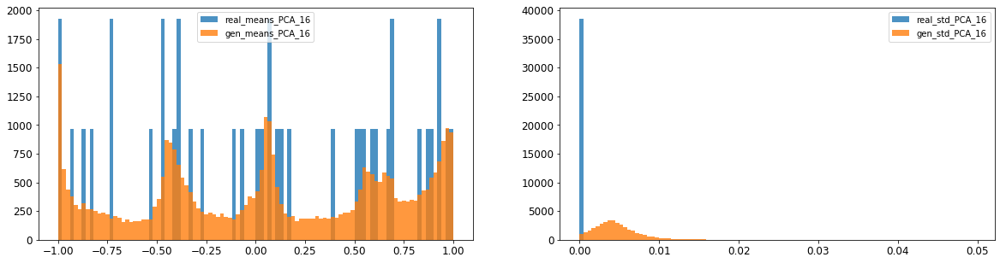



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.012675700108532069
Compose 1-BC divergence = 0.009335012176606705

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.012255789773518683
Compose weighted 1-BC divergence = 0.00917187062623348

Multivariate KL divergence = 42.39959366035288


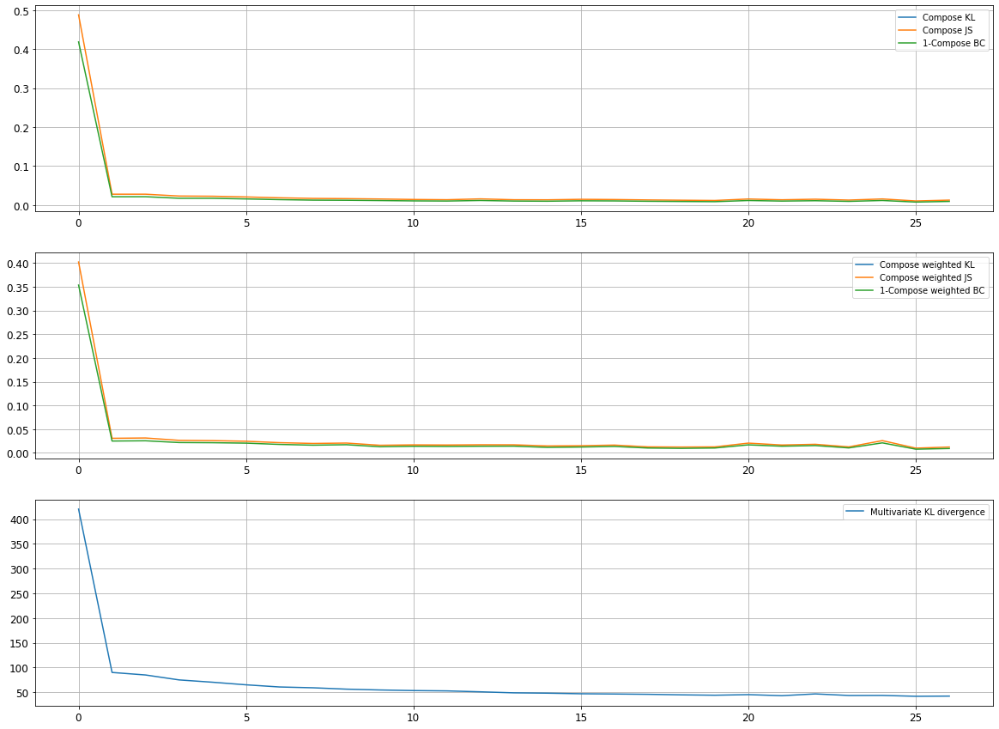

Epoch 5202/10000
discriminator loss: 0.041598 - generator loss: 8.279593 - 22s
Epoch 5203/10000
discriminator loss: 0.062859 - generator loss: 8.203916 - 23s
Epoch 5204/10000
discriminator loss: 0.247875 - generator loss: 7.990027 - 23s
Epoch 5205/10000
discriminator loss: 0.055749 - generator loss: 7.874029 - 22s
Epoch 5206/10000
discriminator loss: 0.043756 - generator loss: 8.285397 - 23s
Epoch 5207/10000
discriminator loss: 0.051133 - generator loss: 8.204597 - 23s
Epoch 5208/10000
discriminator loss: 0.356936 - generator loss: 7.607477 - 22s
Epoch 5209/10000
discriminator loss: 0.055273 - generator loss: 7.938893 - 22s
Epoch 5210/10000
discriminator loss: 0.037612 - generator loss: 8.355051 - 22s
Epoch 5211/10000
discriminator loss: 0.047490 - generator loss: 8.223228 - 23s
Epoch 5212/10000
discriminator loss: 0.333225 - generator loss: 7.232270 - 23s
Epoch 5213/10000
discriminator loss: 0.038834 - generator loss: 8.293542 - 23s
Epoch 5214/10000
discriminator loss: 0.145719 - gene

discriminator loss: 0.164912 - generator loss: 7.669930 - 28s
Epoch 5307/10000
discriminator loss: 0.038097 - generator loss: 8.365603 - 28s
Epoch 5308/10000
discriminator loss: 0.043733 - generator loss: 8.320324 - 28s
Epoch 5309/10000
discriminator loss: 0.252299 - generator loss: 7.636871 - 29s
Epoch 5310/10000
discriminator loss: 0.042065 - generator loss: 8.229366 - 28s
Epoch 5311/10000
discriminator loss: 0.044333 - generator loss: 8.340832 - 29s
Epoch 5312/10000
discriminator loss: 0.262586 - generator loss: 7.872438 - 29s
Epoch 5313/10000
discriminator loss: 0.049193 - generator loss: 8.124932 - 28s
Epoch 5314/10000
discriminator loss: 0.049451 - generator loss: 8.286122 - 28s
Epoch 5315/10000
discriminator loss: 0.209839 - generator loss: 7.823091 - 28s
Epoch 5316/10000
discriminator loss: 0.043293 - generator loss: 8.213271 - 28s
Epoch 5317/10000
discriminator loss: 0.042666 - generator loss: 8.406258 - 28s
Epoch 5318/10000
discriminator loss: 0.266174 - generator loss: 7.789

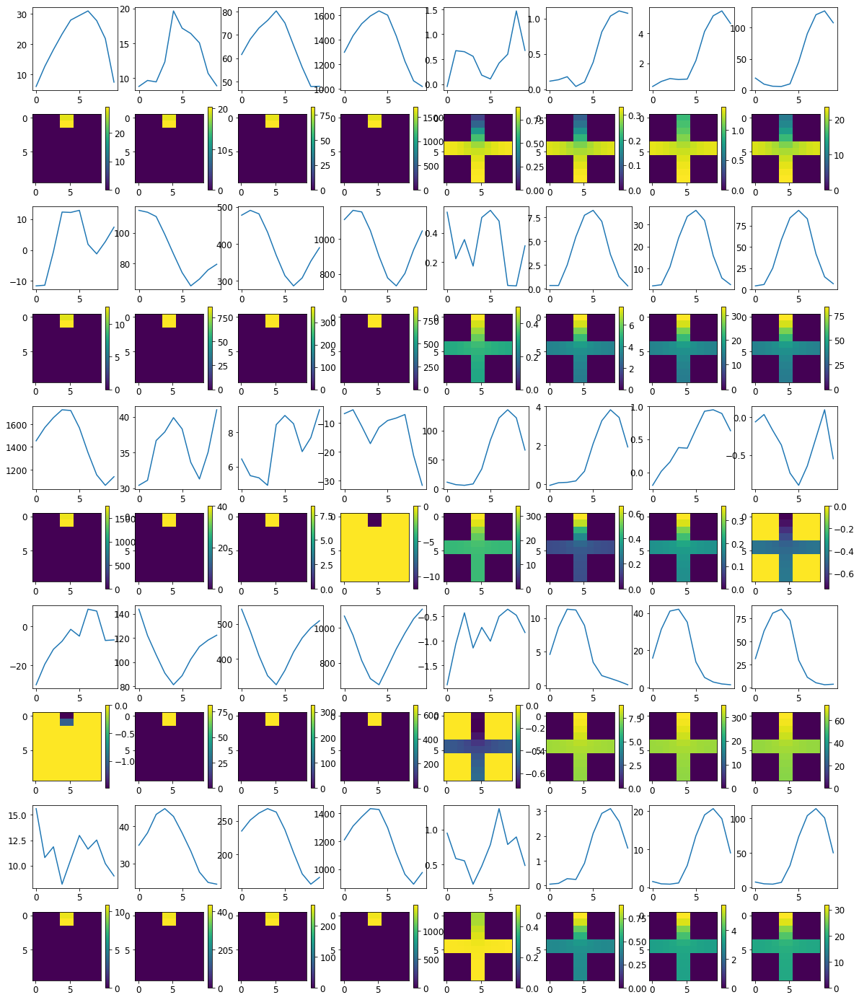


R0 generated:
[[19.66773    17.62509   ]
 [19.674393   17.531904  ]
 [19.671919   17.514961  ]
 [19.669767   17.508347  ]
 [19.667622   17.553766  ]
 [19.669762   17.515947  ]
 [19.684822   17.56722   ]
 [19.690369   17.521574  ]
 [19.66965    17.451088  ]
 [19.67766    17.519852  ]
 [17.20825     0.35786474]
 [17.18269     0.34541377]
 [17.180655    0.33373833]
 [17.1909      0.32079986]
 [17.149153    0.321085  ]
 [17.20029     0.32544076]
 [17.140774    0.3122813 ]
 [17.161545    0.3124306 ]
 [17.19419     0.32076663]
 [17.172308    0.3213608 ]
 [16.72307     0.7358637 ]
 [16.8825      0.6959462 ]
 [16.857443    0.6768041 ]
 [16.87713     0.68484336]
 [16.812342    0.7059616 ]
 [16.814863    0.72005635]
 [16.751255    0.70280176]
 [16.790562    0.69914746]
 [16.812273    0.7572437 ]
 [16.913652    0.67235744]
 [19.754896   16.728552  ]
 [19.749458   16.612598  ]
 [19.733248   16.628479  ]
 [19.730558   16.580078  ]
 [19.737566   16.626297  ]
 [19.74101    16.52241   ]
 [19.749332  

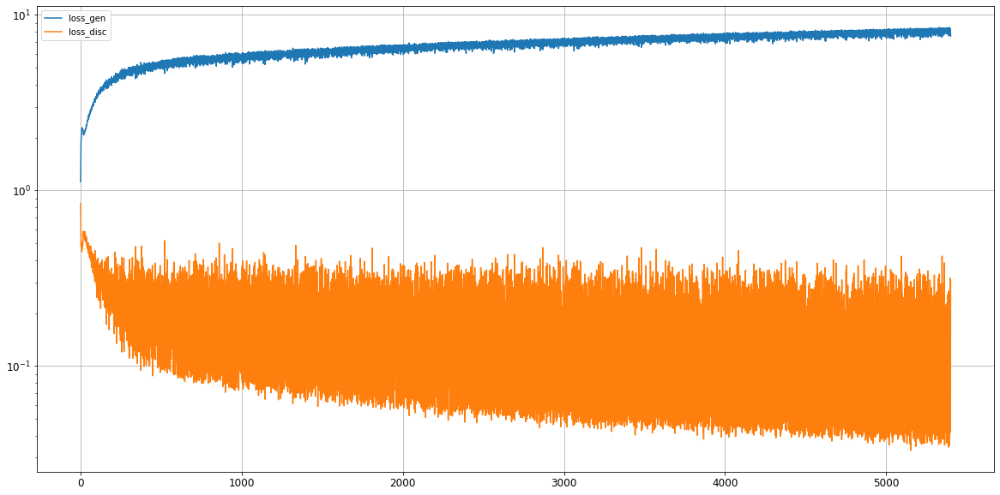

0: mean KL divergence (r,g) = 0.03165863593117225
0: mean JS divergence = 0.008224420188058851
0: mean 1-BC divergence = 0.006068846748204182

0: std KL divergence (r,g) = 0.0735411152859423
0: std JS divergence = 0.023582977461630565
0: std 1-BC divergence = 0.02103628395158652


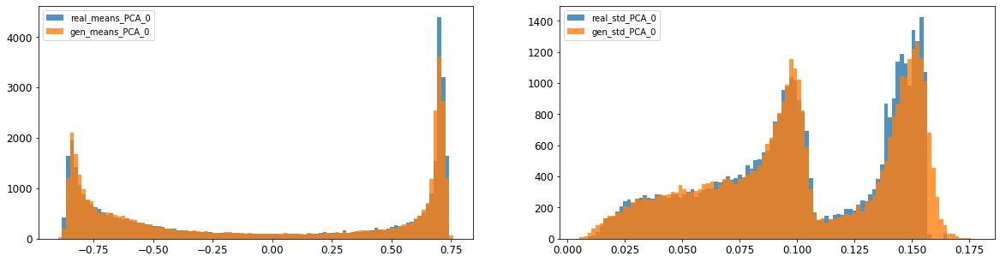

1: mean KL divergence (r,g) = 0.018954397849376966
1: mean JS divergence = 0.004927194505837187
1: mean 1-BC divergence = 0.0034929800587742976

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.01089751362055331
1: std 1-BC divergence = 0.00790045032579001


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


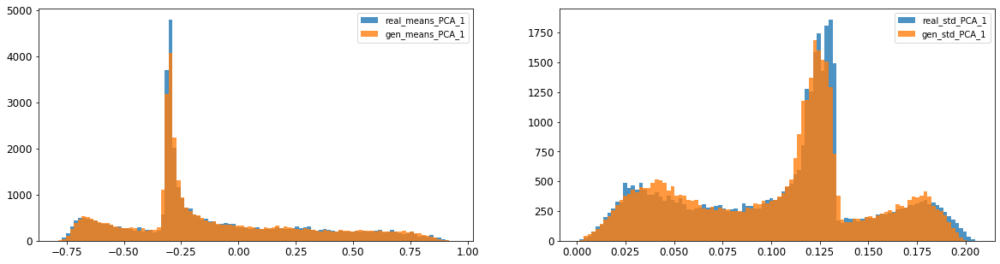

2: mean KL divergence (r,g) = 0.012988808007813428
2: mean JS divergence = 0.0031692395911705838
2: mean 1-BC divergence = 0.00226437847555927

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.010609576216120775
2: std 1-BC divergence = 0.009255135127284042


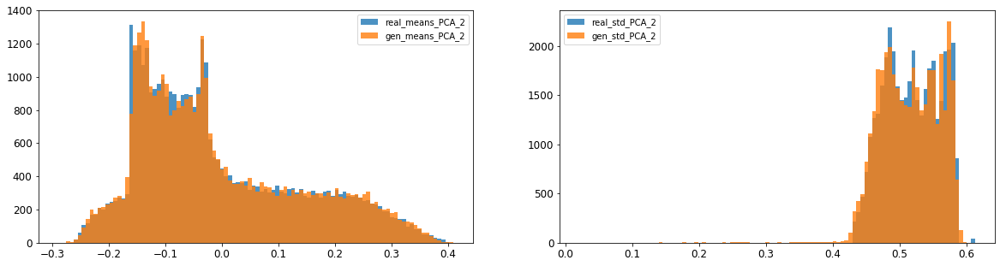

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.022238370017450305
3: mean 1-BC divergence = 0.016224867403474064

3: std KL divergence (r,g) = 0.38136790699395373
3: std JS divergence = 0.07410180232407493
3: std 1-BC divergence = 0.05399090975633336


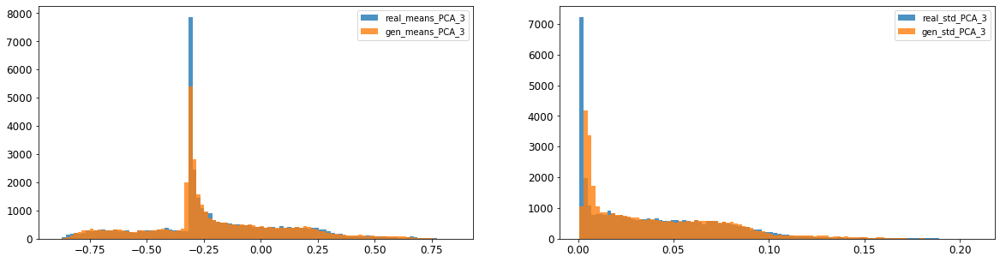

4: mean KL divergence (r,g) = 0.04369356535216189
4: mean JS divergence = 0.012277963481073602
4: mean 1-BC divergence = 0.009954338635711713

4: std KL divergence (r,g) = 0.017702997674478194
4: std JS divergence = 0.004350228854450156
4: std 1-BC divergence = 0.003069731910883222


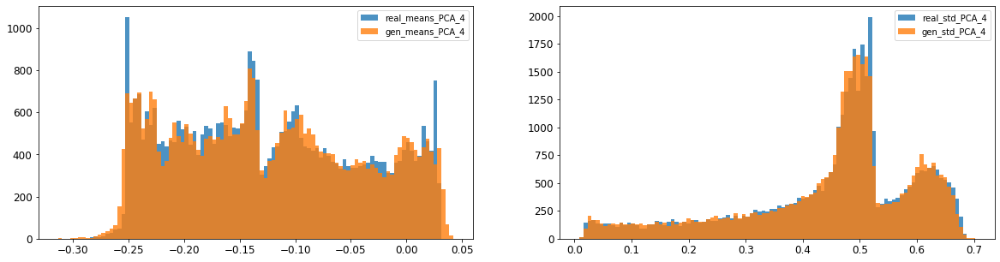

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.017799293130522142
5: mean 1-BC divergence = 0.013523245935892936

5: std KL divergence (r,g) = 0.05410609013109756
5: std JS divergence = 0.014845253251144061
5: std 1-BC divergence = 0.013071453191056626


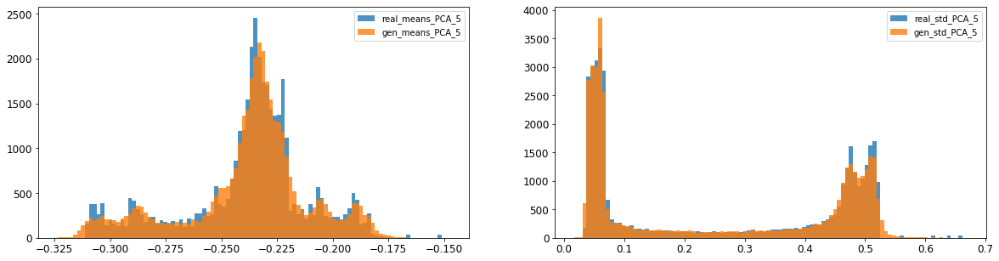

6: mean KL divergence (r,g) = 0.014955191495777688
6: mean JS divergence = 0.0037575764770656555
6: mean 1-BC divergence = 0.002665717722912353

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.00715069929811203
6: std 1-BC divergence = 0.005062365778740308


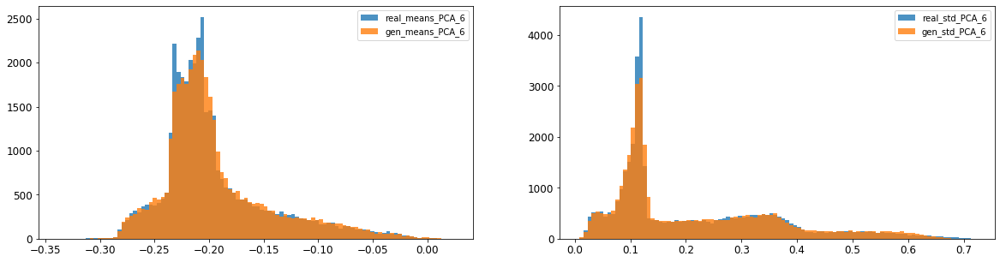

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.02671563326496614
7: mean 1-BC divergence = 0.02174175003443035

7: std KL divergence (r,g) = 0.03996726275749977
7: std JS divergence = 0.00950749151724593
7: std 1-BC divergence = 0.00666738364634234


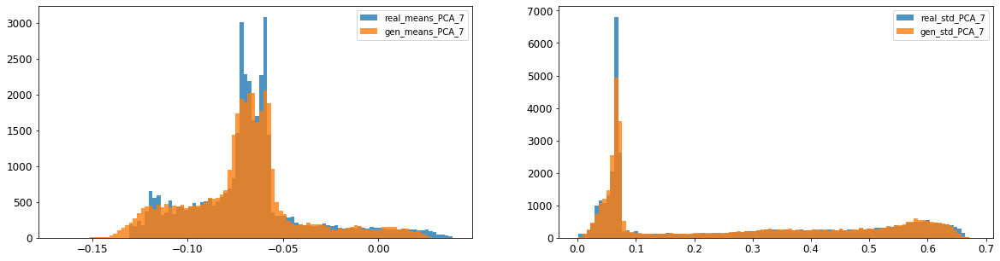

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0026848336465580772
8: mean 1-BC divergence = 0.0018972977892912635

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.010889222877809185
8: std 1-BC divergence = 0.007714635273969206


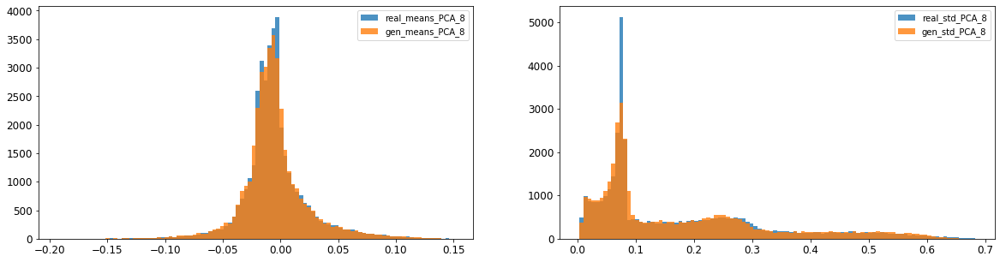

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0038416495949637605
9: mean 1-BC divergence = 0.0027220428732789292

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.01159715941071792
9: std 1-BC divergence = 0.008440449237471559


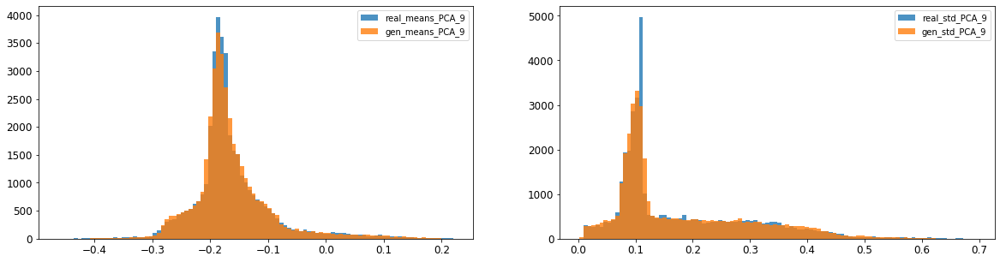

10: mean KL divergence (r,g) = 0.02240837415708535
10: mean JS divergence = 0.005531246386212094
10: mean 1-BC divergence = 0.003931353977222551

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.0048966464026310675
10: std 1-BC divergence = 0.004171837384758903


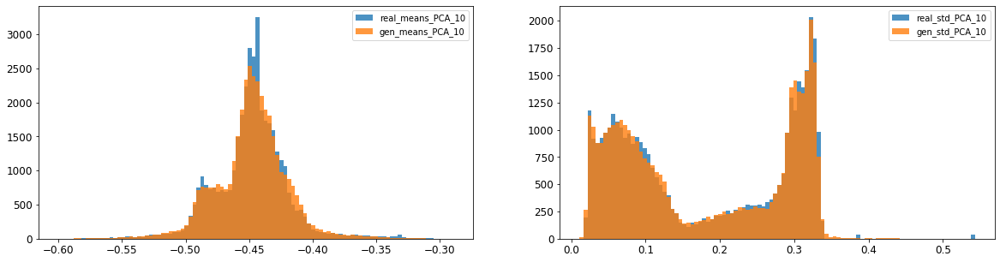

11: mean KL divergence (r,g) = 0.038127605620790934
11: mean JS divergence = 0.009733992251709693
11: mean 1-BC divergence = 0.006841589270416448

11: std KL divergence (r,g) = 0.047622607464692046
11: std JS divergence = 0.013151250067206216
11: std 1-BC divergence = 0.009474197101299597


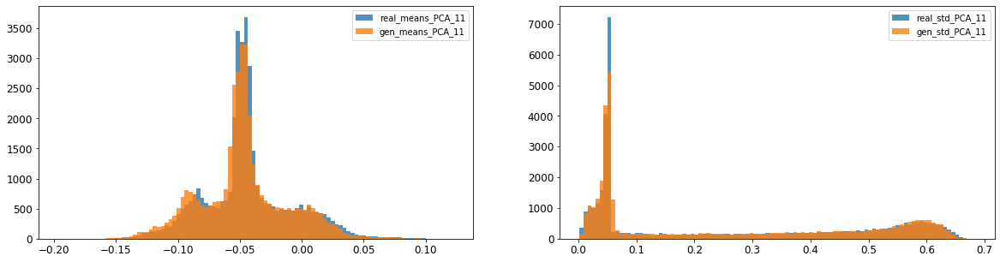

12: mean KL divergence (r,g) = 0.02245521332297101
12: mean JS divergence = 0.005638446457425072
12: mean 1-BC divergence = 0.003936901148988925

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.014590343781521565
12: std 1-BC divergence = 0.010300998371966186


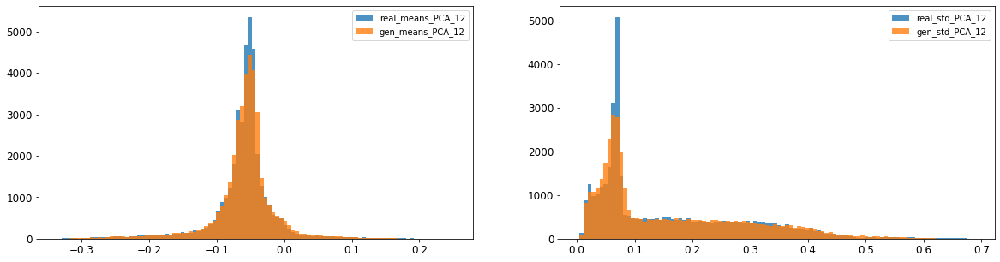

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.025107116251293228
13: mean 1-BC divergence = 0.017595066758937294

13: std KL divergence (r,g) = 0.06280613082003642
13: std JS divergence = 0.01531104760352683
13: std 1-BC divergence = 0.0107247832653109


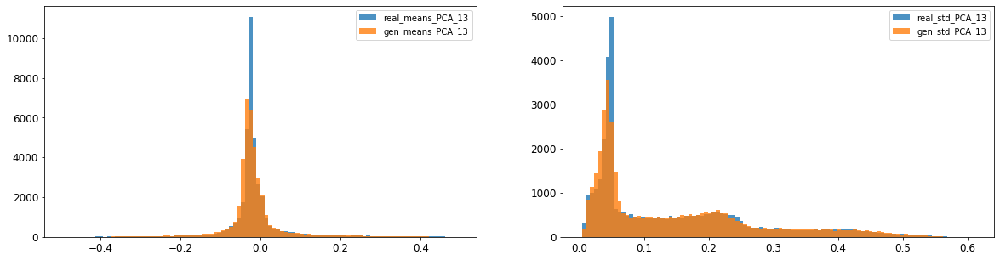

14: mean KL divergence (r,g) = 0.08600046270517389
14: mean JS divergence = 0.021115903673982736
14: mean 1-BC divergence = 0.01478930267609968

14: std KL divergence (r,g) = 0.028692085988640374
14: std JS divergence = 0.007033380133731653
14: std 1-BC divergence = 0.004946126900098435


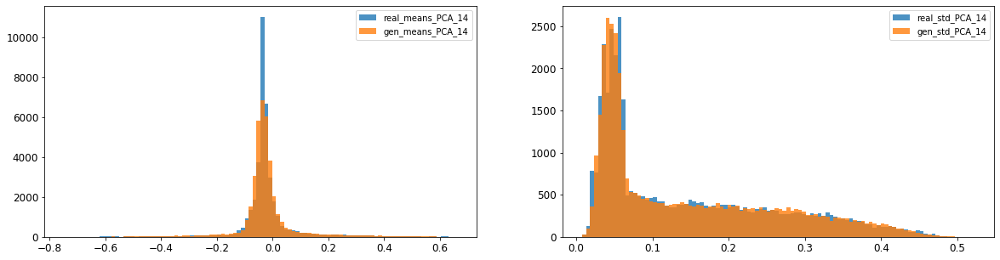

15: mean KL divergence (r,g) = 1.740775693015228
15: mean JS divergence = 0.46943083534186897
15: mean 1-BC divergence = 0.42987871677262646

15: std KL divergence (r,g) = 6.8757680781127375
15: std JS divergence = 0.9645578285525085
15: std 1-BC divergence = 0.9077229328966945


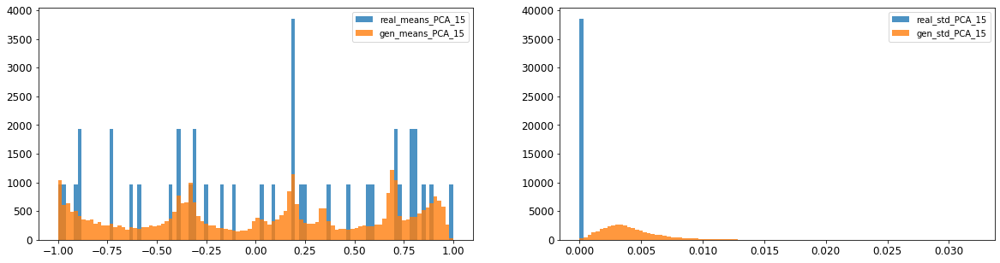

16: mean KL divergence (r,g) = 1.3859402053519516
16: mean JS divergence = 0.390544793948734
16: mean 1-BC divergence = 0.3599606432112957

16: std KL divergence (r,g) = 5.771840635444666
16: std JS divergence = 0.9338590478081618
16: std 1-BC divergence = 0.8647144476104035


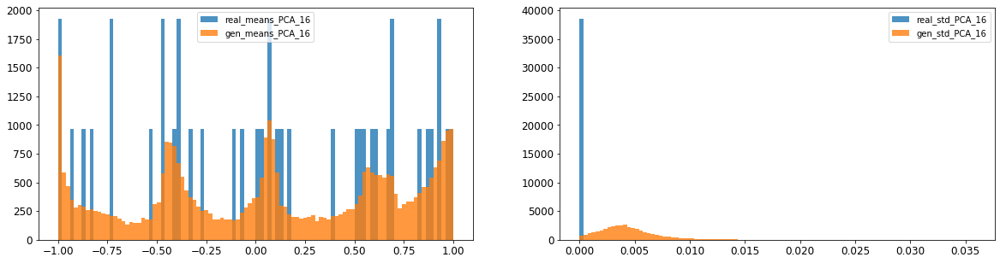



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.013509249057958842
Compose 1-BC divergence = 0.010115880691069501

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.014542930846722202
Compose weighted 1-BC divergence = 0.011794706608376448

Multivariate KL divergence = 41.82916363706265


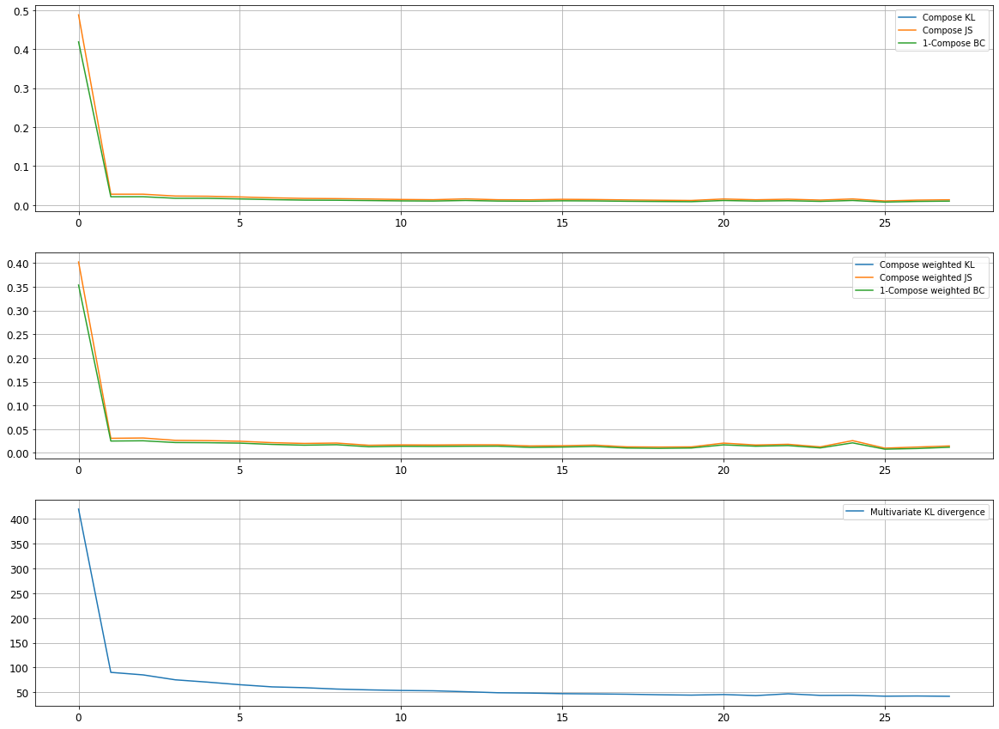

Epoch 5402/10000
discriminator loss: 0.035720 - generator loss: 8.408206 - 27s
Epoch 5403/10000
discriminator loss: 0.045140 - generator loss: 8.355113 - 28s
Epoch 5404/10000
discriminator loss: 0.237551 - generator loss: 7.534496 - 28s
Epoch 5405/10000
discriminator loss: 0.036217 - generator loss: 8.402428 - 28s
Epoch 5406/10000
discriminator loss: 0.039748 - generator loss: 8.377340 - 28s
Epoch 5407/10000
discriminator loss: 0.214839 - generator loss: 8.386542 - 28s
Epoch 5408/10000
discriminator loss: 0.163140 - generator loss: 7.575948 - 28s
Epoch 5409/10000
discriminator loss: 0.037385 - generator loss: 8.532915 - 28s
Epoch 5410/10000
discriminator loss: 0.306415 - generator loss: 8.075329 - 28s
Epoch 5411/10000
discriminator loss: 0.053078 - generator loss: 7.909511 - 28s
Epoch 5412/10000
discriminator loss: 0.045545 - generator loss: 8.291533 - 29s
Epoch 5413/10000
discriminator loss: 0.045060 - generator loss: 8.342142 - 29s
Epoch 5414/10000
discriminator loss: 0.222194 - gene

discriminator loss: 0.042084 - generator loss: 8.260800 - 28s
Epoch 5507/10000
discriminator loss: 0.297317 - generator loss: 7.735634 - 28s
Epoch 5508/10000
discriminator loss: 0.047009 - generator loss: 8.129340 - 28s
Epoch 5509/10000
discriminator loss: 0.041122 - generator loss: 8.453846 - 28s
Epoch 5510/10000
discriminator loss: 0.041879 - generator loss: 8.445130 - 29s
Epoch 5511/10000
discriminator loss: 0.290338 - generator loss: 7.583323 - 28s
Epoch 5512/10000
discriminator loss: 0.036864 - generator loss: 8.399293 - 28s
Epoch 5513/10000
discriminator loss: 0.037555 - generator loss: 8.465067 - 28s
Epoch 5514/10000
discriminator loss: 0.037302 - generator loss: 8.470481 - 28s
Epoch 5515/10000
discriminator loss: 0.326579 - generator loss: 7.520716 - 28s
Epoch 5516/10000
discriminator loss: 0.036568 - generator loss: 8.419048 - 28s
Epoch 5517/10000
discriminator loss: 0.044363 - generator loss: 8.360490 - 28s
Epoch 5518/10000
discriminator loss: 0.288059 - generator loss: 7.761

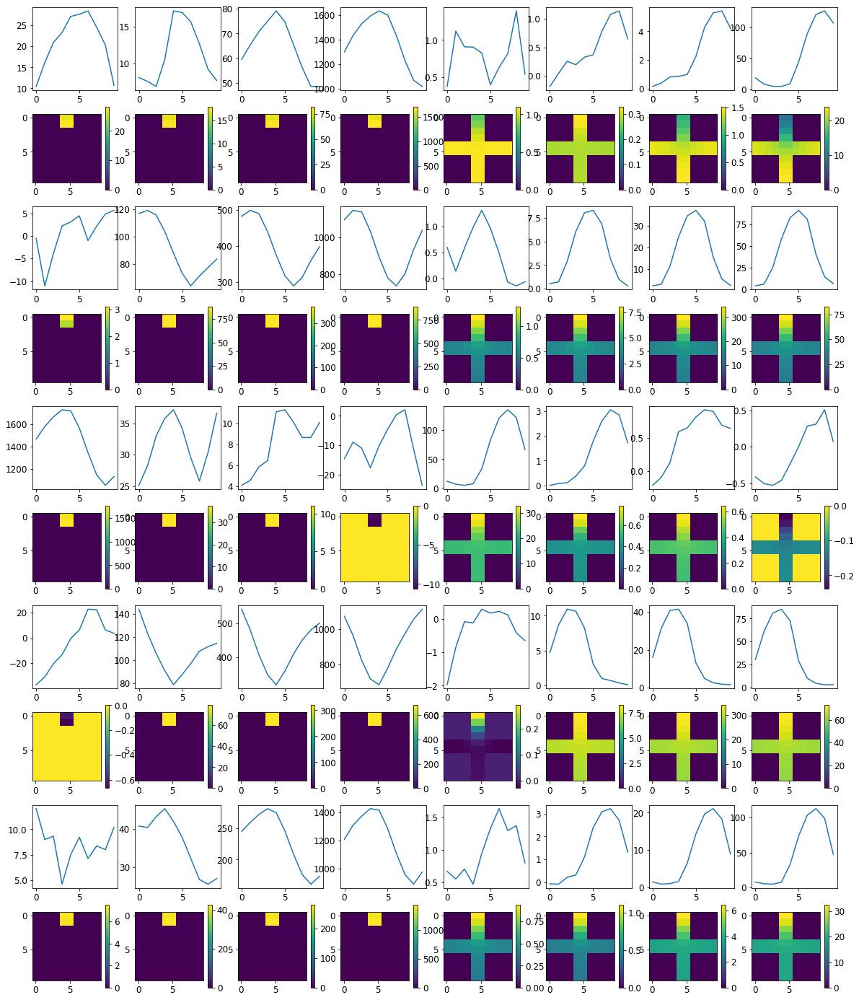


R0 generated:
[[19.667986   17.24501   ]
 [19.674582   17.135038  ]
 [19.673008   17.103182  ]
 [19.672058   17.05797   ]
 [19.660833   17.107391  ]
 [19.658081   17.097946  ]
 [19.66881    17.170506  ]
 [19.671677   17.172289  ]
 [19.643698   17.123005  ]
 [19.656767   17.25465   ]
 [17.080013    0.33235344]
 [17.08731     0.32198182]
 [17.137259    0.3085273 ]
 [17.15525     0.30096272]
 [17.142181    0.30102336]
 [17.14749     0.3033622 ]
 [17.114153    0.29246226]
 [17.09886     0.29565823]
 [17.146135    0.30401117]
 [17.118832    0.30552024]
 [16.957363    0.77495253]
 [17.146023    0.738827  ]
 [17.18424     0.7253981 ]
 [17.18839     0.7315703 ]
 [17.131462    0.7361669 ]
 [17.117323    0.7490505 ]
 [17.107056    0.7512348 ]
 [17.09404     0.72581154]
 [17.119282    0.7940887 ]
 [17.084814    0.7159816 ]
 [19.76724    16.605543  ]
 [19.764498   16.473566  ]
 [19.7513     16.450253  ]
 [19.751547   16.39309   ]
 [19.753721   16.437996  ]
 [19.75536    16.328066  ]
 [19.765913  

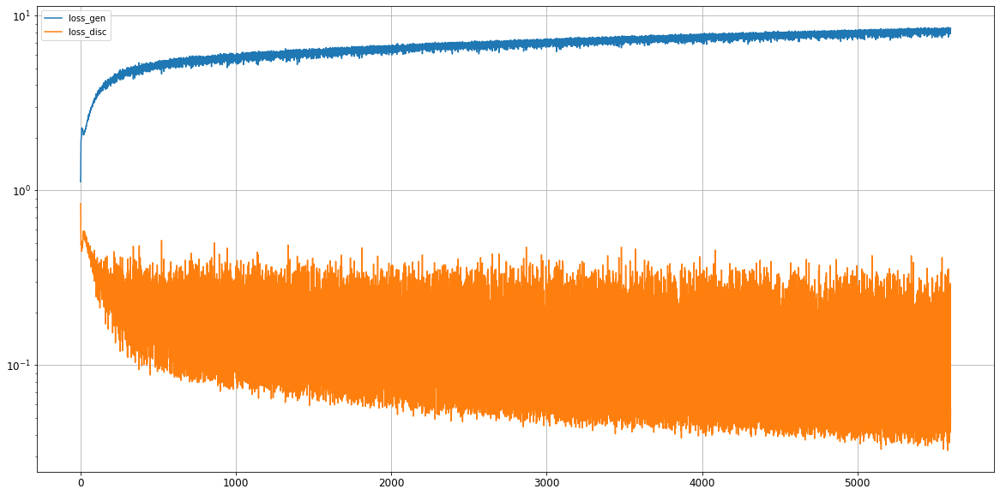

0: mean KL divergence (r,g) = 0.027395827235855166
0: mean JS divergence = 0.006893188455124824
0: mean 1-BC divergence = 0.004968343487733673

0: std KL divergence (r,g) = 0.07256133087220012
0: std JS divergence = 0.023488500346794054
0: std 1-BC divergence = 0.02172502236315299


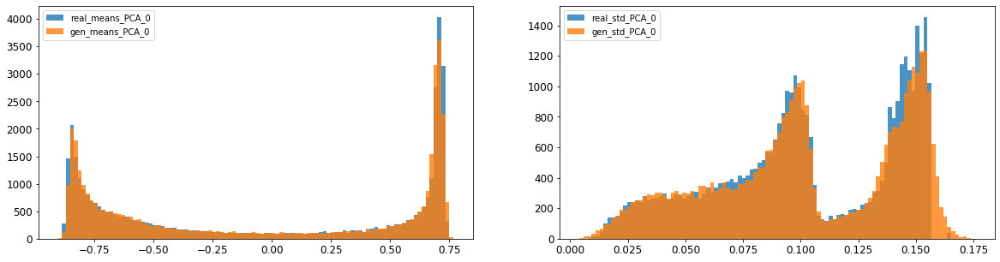

1: mean KL divergence (r,g) = 0.01696104026078014
1: mean JS divergence = 0.004289418551982196
1: mean 1-BC divergence = 0.0030116556241913672

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.006325214052389772
1: std 1-BC divergence = 0.004510663507392154


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


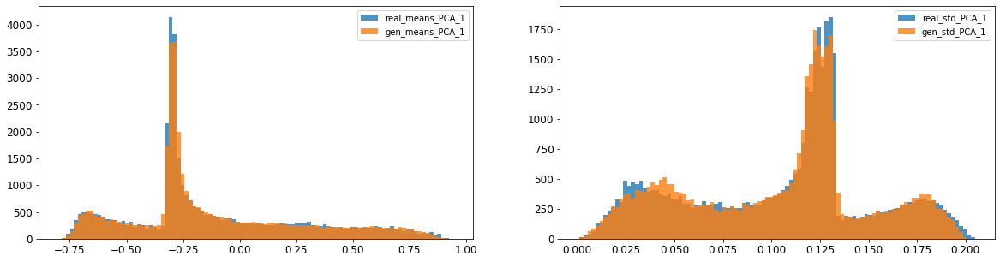

2: mean KL divergence (r,g) = inf
2: mean JS divergence = 0.00450365118087426
2: mean 1-BC divergence = 0.0032635742133230172

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.01042700557343532
2: std 1-BC divergence = 0.00936396119138605


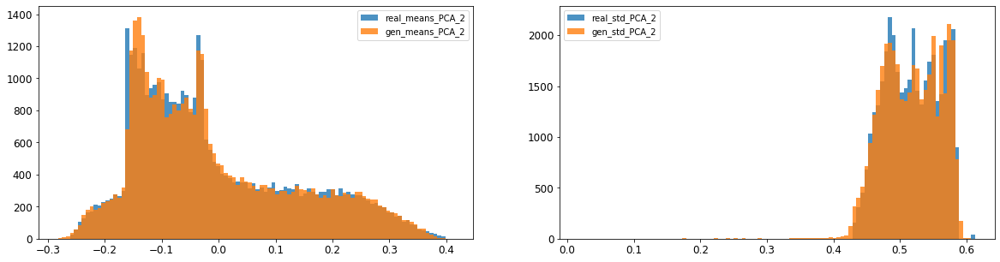

3: mean KL divergence (r,g) = 0.02997706997768339
3: mean JS divergence = 0.006642227025164151
3: mean 1-BC divergence = 0.00470853198774801

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.06624633512268122
3: std 1-BC divergence = 0.04800019806802891


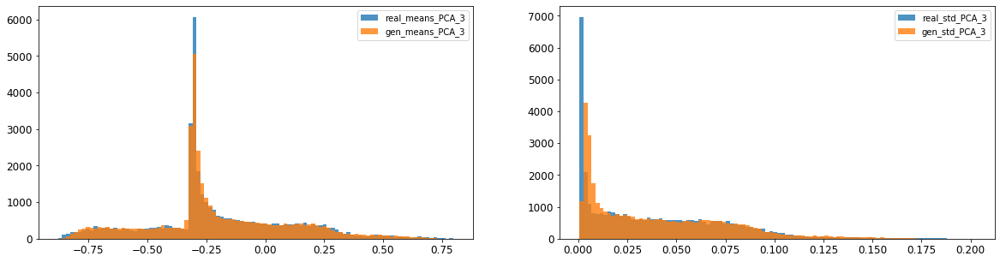

4: mean KL divergence (r,g) = 0.04684028806086523
4: mean JS divergence = 0.011012690178288757
4: mean 1-BC divergence = 0.008183432203169194

4: std KL divergence (r,g) = 0.015011794939533491
4: std JS divergence = 0.003659420550870804
4: std 1-BC divergence = 0.002588670567452822


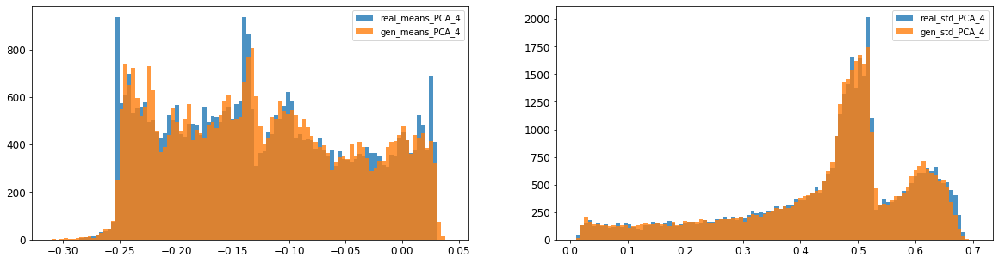

5: mean KL divergence (r,g) = 0.05573839843964402
5: mean JS divergence = 0.013387188398744927
5: mean 1-BC divergence = 0.009660732285133533

5: std KL divergence (r,g) = 0.043935144713810936
5: std JS divergence = 0.012474212457128094
5: std 1-BC divergence = 0.011206143370564914


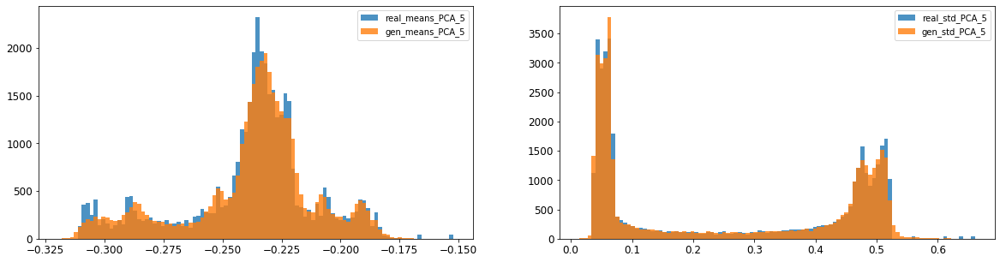

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0048064627758745435
6: mean 1-BC divergence = 0.0034186851232282933

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.012123515248545227
6: std 1-BC divergence = 0.008831922664201852


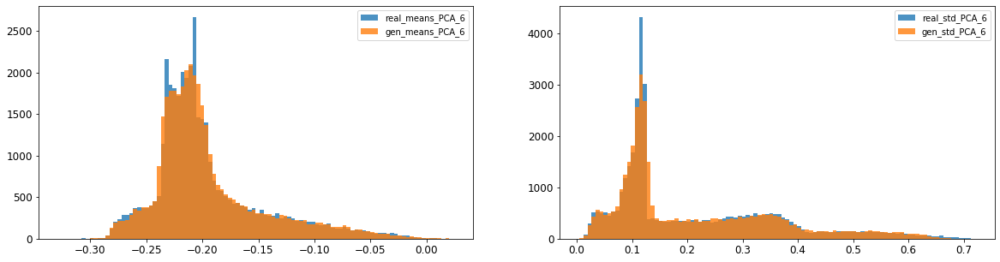

7: mean KL divergence (r,g) = 0.06320604881889698
7: mean JS divergence = 0.015486490054180586
7: mean 1-BC divergence = 0.011262330092077888

7: std KL divergence (r,g) = 0.029374208678402236
7: std JS divergence = 0.0070076915397253884
7: std 1-BC divergence = 0.0049162898597697735


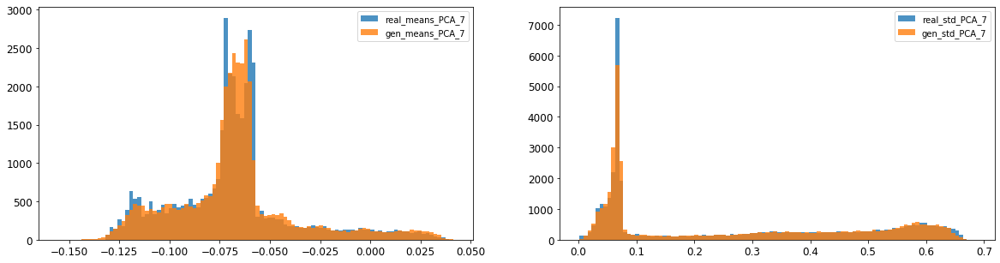

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0029319392110029297
8: mean 1-BC divergence = 0.002070174336452957

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.00968664628579552
8: std 1-BC divergence = 0.006959972073181331


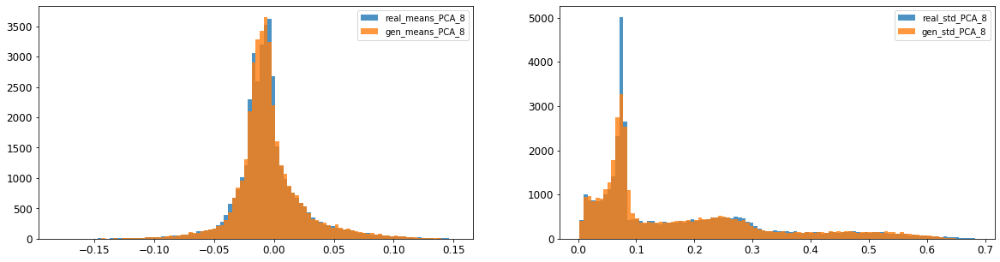

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0041675248023165185
9: mean 1-BC divergence = 0.003034895216963207

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.01110299983550233
9: std 1-BC divergence = 0.007891697852190127


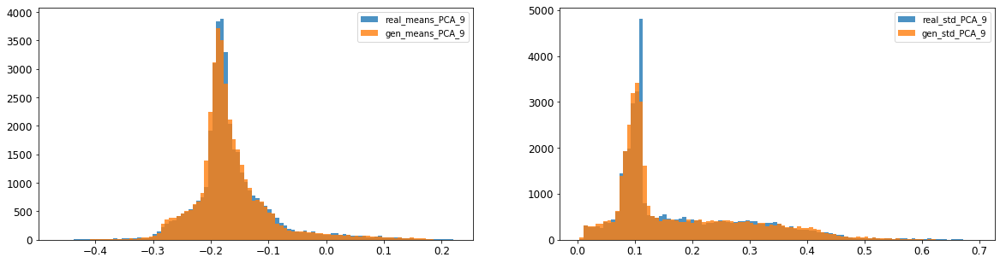

10: mean KL divergence (r,g) = 0.017183257317262998
10: mean JS divergence = 0.0041900711553617565
10: mean 1-BC divergence = 0.0029598014266970507

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004456880799197089
10: std 1-BC divergence = 0.003930070199183455


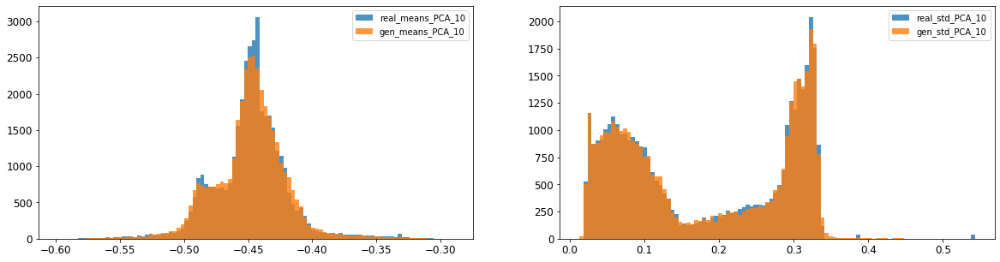

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.011830300512003334
11: mean 1-BC divergence = 0.008312610434476952

11: std KL divergence (r,g) = 0.02039500807135953
11: std JS divergence = 0.0051110788766954695
11: std 1-BC divergence = 0.0036229342683182786


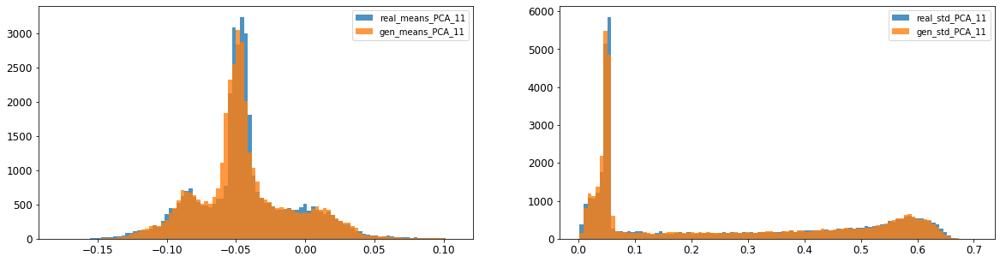

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.006018698752301639
12: mean 1-BC divergence = 0.0042580754833280166

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.016125015817174862
12: std 1-BC divergence = 0.01148393224071198


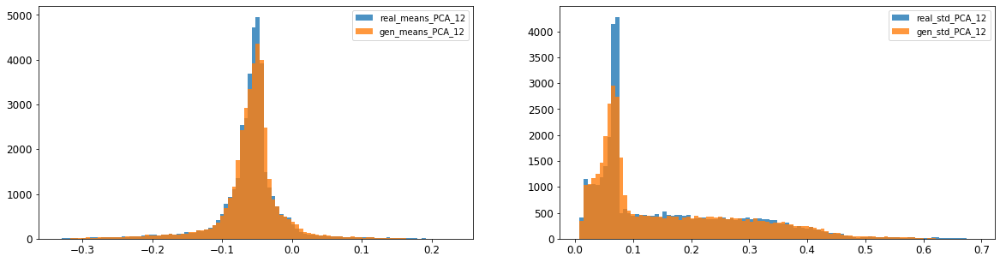

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.01507043058568315
13: mean 1-BC divergence = 0.010524514630950166

13: std KL divergence (r,g) = 0.05871994844969312
13: std JS divergence = 0.014606059864425088
13: std 1-BC divergence = 0.010241557835909298


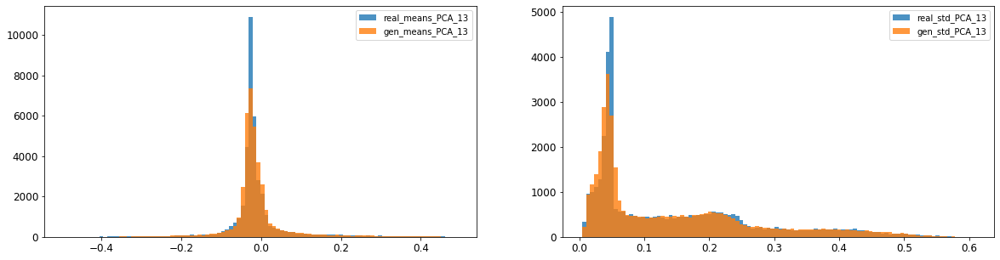

14: mean KL divergence (r,g) = 0.08124213192398261
14: mean JS divergence = 0.02005957608549086
14: mean 1-BC divergence = 0.014028222913042177

14: std KL divergence (r,g) = 0.027470994651356172
14: std JS divergence = 0.006671927852727199
14: std 1-BC divergence = 0.004660820322630266


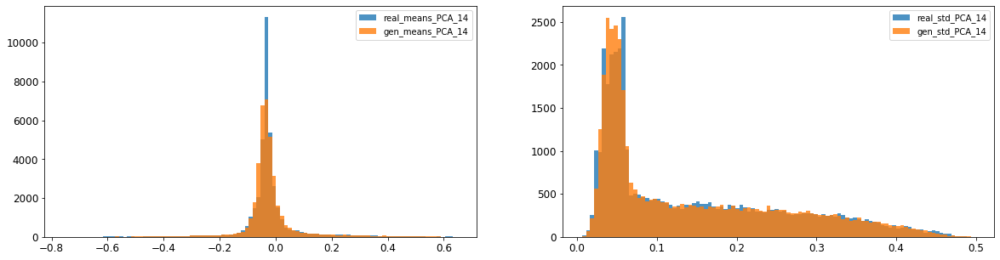

15: mean KL divergence (r,g) = 1.7094679975846194
15: mean JS divergence = 0.4617049839486913
15: mean 1-BC divergence = 0.4226976128760316

15: std KL divergence (r,g) = 6.644605447148558
15: std JS divergence = 0.9595485821370902
15: std 1-BC divergence = 0.9000259639106025


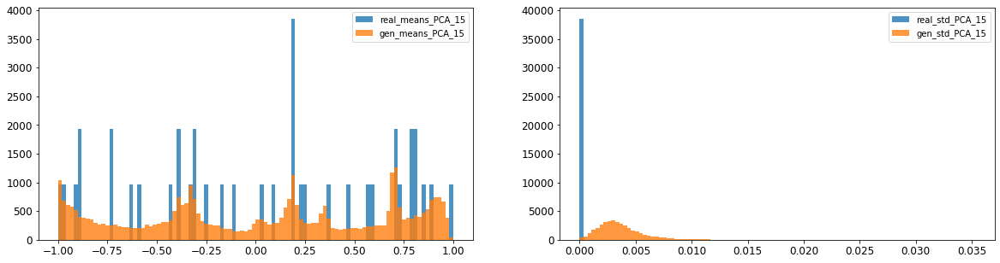

16: mean KL divergence (r,g) = 1.3684391830524332
16: mean JS divergence = 0.38661593220931945
16: mean 1-BC divergence = 0.3565263281565675

16: std KL divergence (r,g) = 5.663464474399873
16: std JS divergence = 0.9297582131836195
16: std 1-BC divergence = 0.8595364446405546


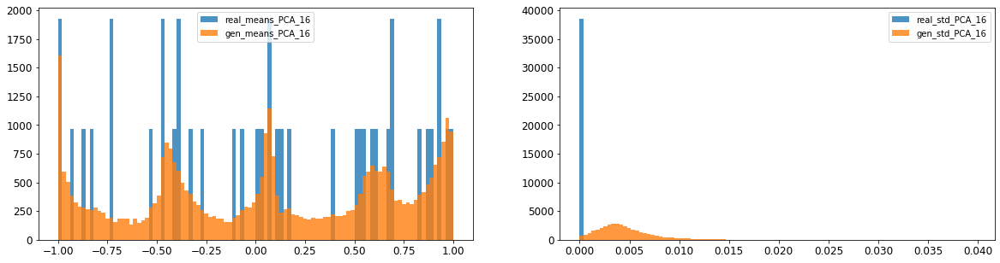



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01136007873158273
Compose 1-BC divergence = 0.008453314528086286

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.012920181762136088
Compose weighted 1-BC divergence = 0.010743144724987719

Multivariate KL divergence = 41.02377670867438


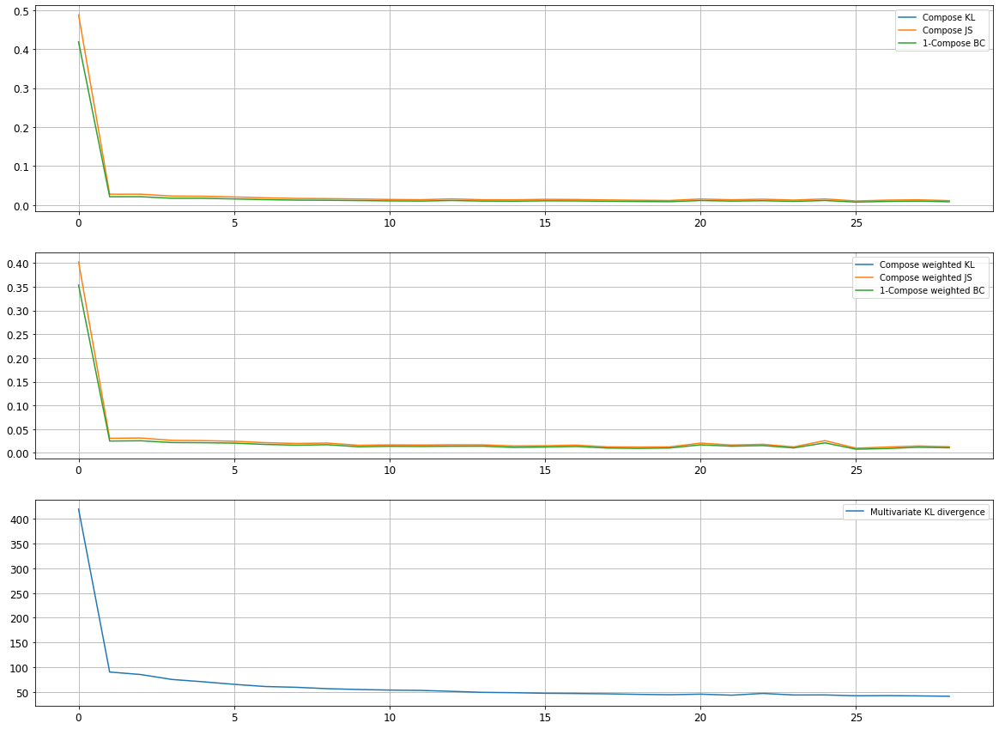

Epoch 5602/10000
discriminator loss: 0.204408 - generator loss: 7.937063 - 27s
Epoch 5603/10000
discriminator loss: 0.054998 - generator loss: 8.171886 - 28s
Epoch 5604/10000
discriminator loss: 0.052936 - generator loss: 8.193032 - 28s
Epoch 5605/10000
discriminator loss: 0.339993 - generator loss: 8.164829 - 28s
Epoch 5606/10000
discriminator loss: 0.050402 - generator loss: 8.001079 - 28s
Epoch 5607/10000
discriminator loss: 0.039168 - generator loss: 8.501732 - 28s
Epoch 5608/10000
discriminator loss: 0.166392 - generator loss: 8.254668 - 28s
Epoch 5609/10000
discriminator loss: 0.083034 - generator loss: 8.032424 - 28s
Epoch 5610/10000
discriminator loss: 0.046872 - generator loss: 8.392557 - 29s
Epoch 5611/10000
discriminator loss: 0.298233 - generator loss: 7.922109 - 28s
Epoch 5612/10000
discriminator loss: 0.041488 - generator loss: 8.225415 - 28s
Epoch 5613/10000
discriminator loss: 0.038259 - generator loss: 8.525504 - 28s
Epoch 5614/10000
discriminator loss: 0.158740 - gene

discriminator loss: 0.236179 - generator loss: 7.996405 - 28s
Epoch 5707/10000
discriminator loss: 0.036697 - generator loss: 8.512959 - 28s
Epoch 5708/10000
discriminator loss: 0.049334 - generator loss: 8.493486 - 28s
Epoch 5709/10000
discriminator loss: 0.255841 - generator loss: 7.781810 - 28s
Epoch 5710/10000
discriminator loss: 0.035498 - generator loss: 8.453505 - 28s
Epoch 5711/10000
discriminator loss: 0.046760 - generator loss: 8.442753 - 28s
Epoch 5712/10000
discriminator loss: 0.272012 - generator loss: 7.863591 - 28s
Epoch 5713/10000
discriminator loss: 0.037854 - generator loss: 8.425397 - 28s
Epoch 5714/10000
discriminator loss: 0.042316 - generator loss: 8.429365 - 28s
Epoch 5715/10000
discriminator loss: 0.253102 - generator loss: 7.907082 - 28s
Epoch 5716/10000
discriminator loss: 0.036253 - generator loss: 8.359531 - 28s
Epoch 5717/10000
discriminator loss: 0.043109 - generator loss: 8.454145 - 28s
Epoch 5718/10000
discriminator loss: 0.155293 - generator loss: 7.982

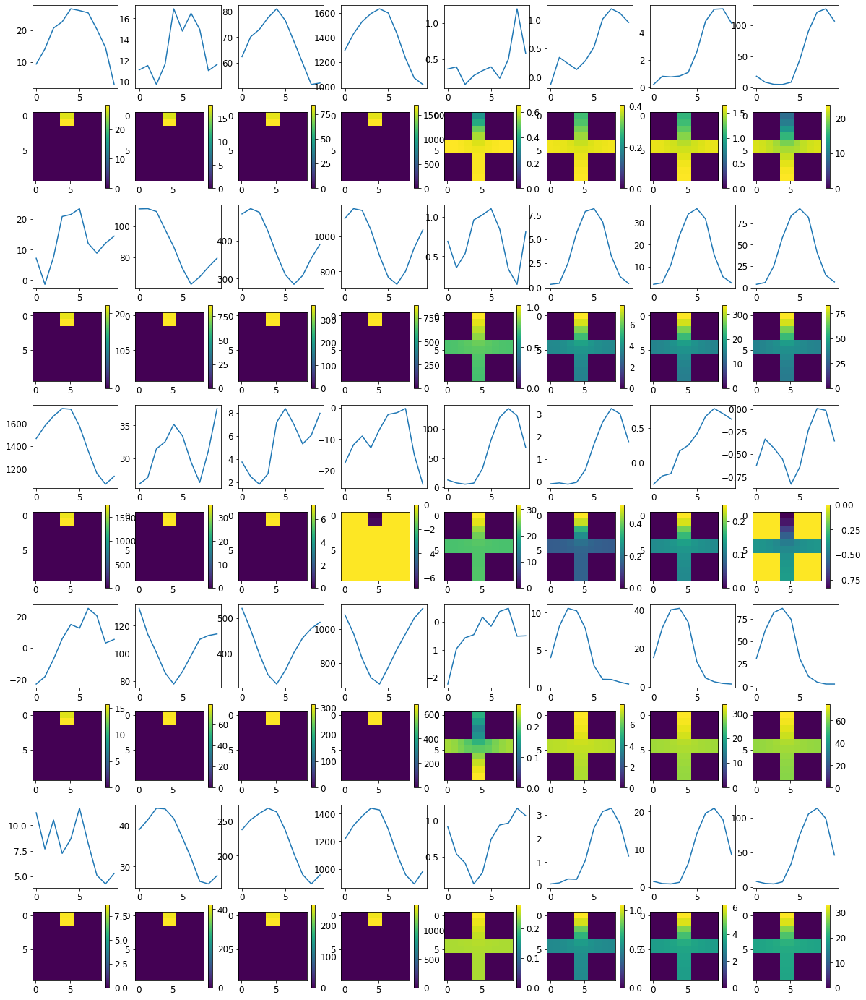


R0 generated:
[[19.67043    17.3317    ]
 [19.67914    17.265356  ]
 [19.680246   17.223549  ]
 [19.677137   17.229664  ]
 [19.67538    17.205616  ]
 [19.672024   17.1902    ]
 [19.687658   17.222878  ]
 [19.690187   17.258533  ]
 [19.6772     17.240467  ]
 [19.681547   17.313343  ]
 [17.163584    0.39218497]
 [17.165464    0.38564956]
 [17.201052    0.3736995 ]
 [17.192795    0.36428005]
 [17.180899    0.3621278 ]
 [17.188084    0.36790985]
 [17.174221    0.35311362]
 [17.159048    0.35729098]
 [17.191084    0.3623004 ]
 [17.173492    0.35927176]
 [16.830194    0.8917502 ]
 [17.025532    0.8882003 ]
 [17.062716    0.87790793]
 [17.06725     0.89366806]
 [17.036755    0.8870288 ]
 [17.012203    0.9133734 ]
 [17.033813    0.9132947 ]
 [17.020662    0.8947946 ]
 [17.054283    0.9651966 ]
 [17.072527    0.8816305 ]
 [19.757364   16.61521   ]
 [19.752787   16.529955  ]
 [19.742504   16.556614  ]
 [19.739809   16.553808  ]
 [19.74665    16.552689  ]
 [19.748505   16.485477  ]
 [19.761251  

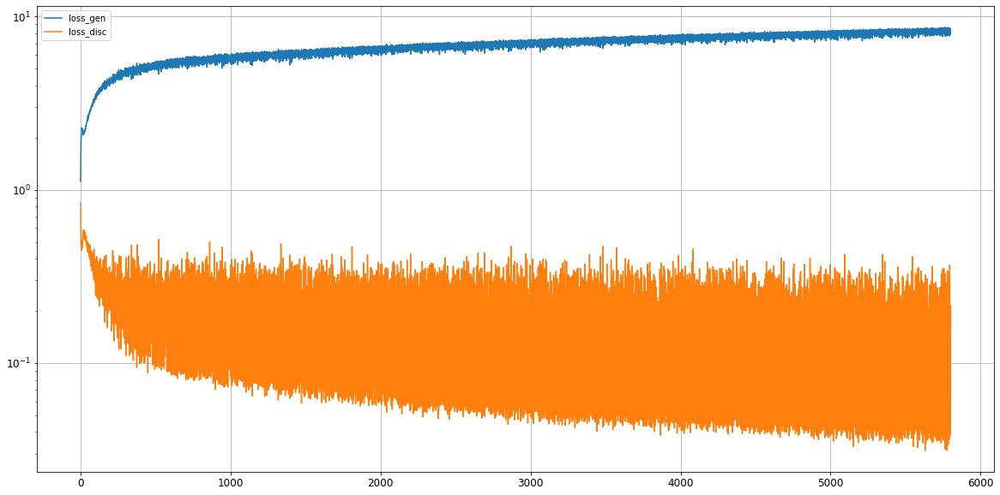

0: mean KL divergence (r,g) = 0.028839232550746028
0: mean JS divergence = 0.007575529507375062
0: mean 1-BC divergence = 0.005735611760361747

0: std KL divergence (r,g) = 0.044379984190210074
0: std JS divergence = 0.012798348551736328
0: std 1-BC divergence = 0.010984272222980151


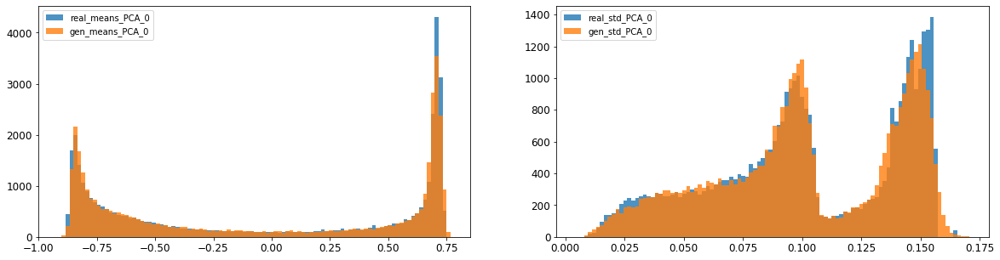

1: mean KL divergence (r,g) = 0.033423168767026785
1: mean JS divergence = 0.008851605963304487
1: mean 1-BC divergence = 0.006271316479675493

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.008344822559966006
1: std 1-BC divergence = 0.005942362324073747


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


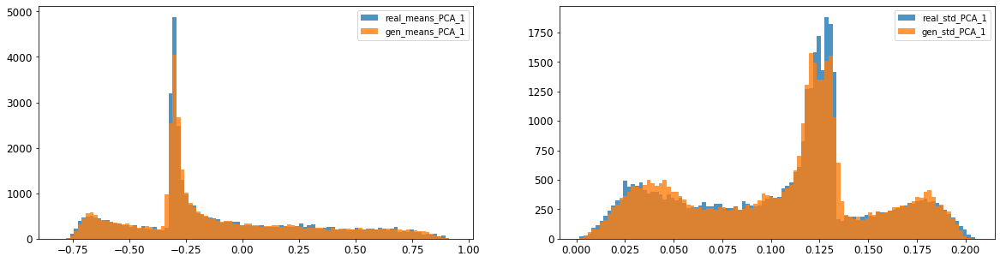

2: mean KL divergence (r,g) = 0.015769127756011237
2: mean JS divergence = 0.003844178437232017
2: mean 1-BC divergence = 0.0027635837825052967

2: std KL divergence (r,g) = 0.03686762994962669
2: std JS divergence = 0.010976201020607286
2: std 1-BC divergence = 0.010029543534750385


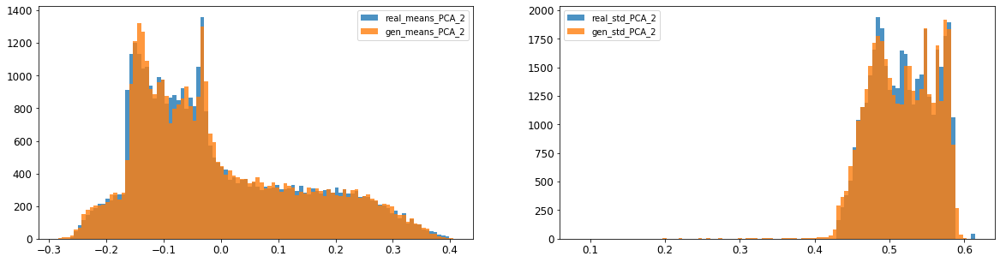

3: mean KL divergence (r,g) = 0.05179110842522947
3: mean JS divergence = 0.012555346424874315
3: mean 1-BC divergence = 0.00899886880231926

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.055169363537884125
3: std 1-BC divergence = 0.039939974816039614


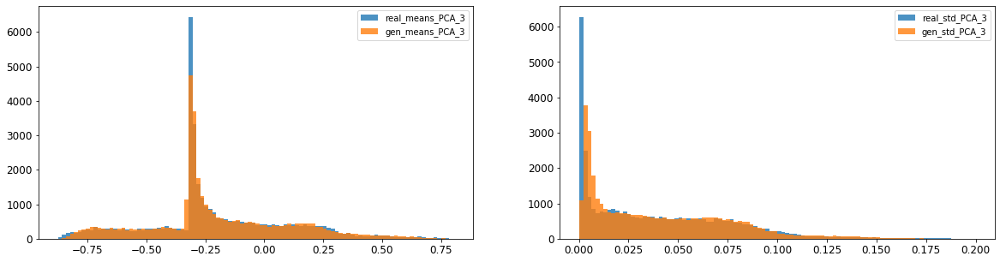

4: mean KL divergence (r,g) = 0.03802961903896744
4: mean JS divergence = 0.010586847831025868
4: mean 1-BC divergence = 0.008590272590633052

4: std KL divergence (r,g) = 0.019306896953388265
4: std JS divergence = 0.004674930256575283
4: std 1-BC divergence = 0.0033161529318801453


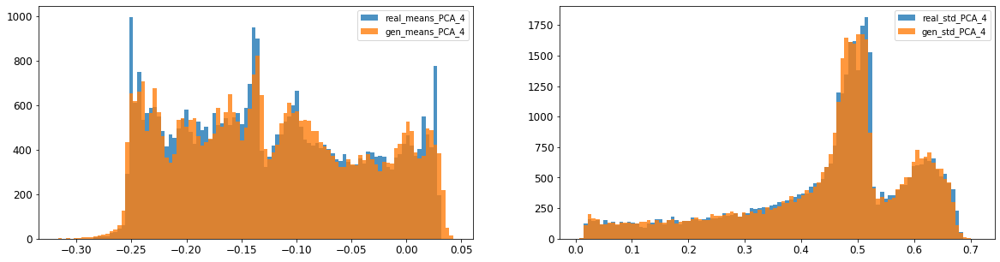

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.01567937493485695
5: mean 1-BC divergence = 0.011913003949375889

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.015524094763507934
5: std 1-BC divergence = 0.013084820496882421


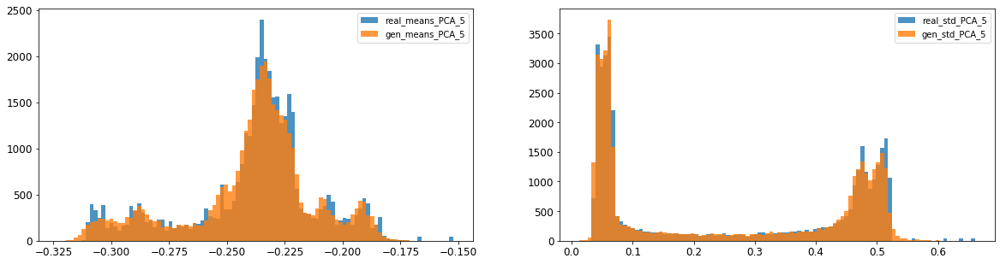

6: mean KL divergence (r,g) = 0.021982641972380614
6: mean JS divergence = 0.005544255522418025
6: mean 1-BC divergence = 0.003924780779086312

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.0074155041590729925
6: std 1-BC divergence = 0.005328139484168659


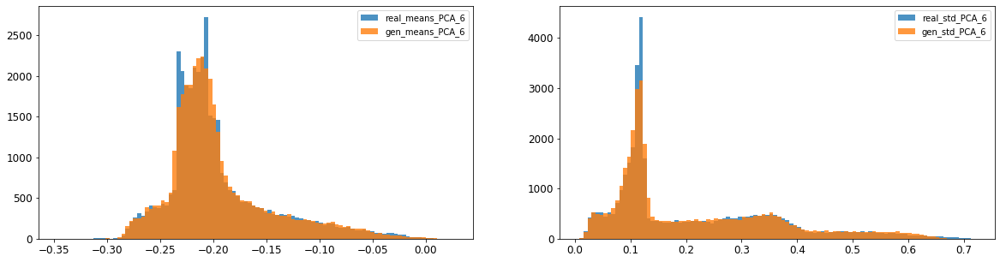

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.011199539428146804
7: mean 1-BC divergence = 0.009024334922317467

7: std KL divergence (r,g) = 0.03128453322694703
7: std JS divergence = 0.007223028747297229
7: std 1-BC divergence = 0.0050994680312674845


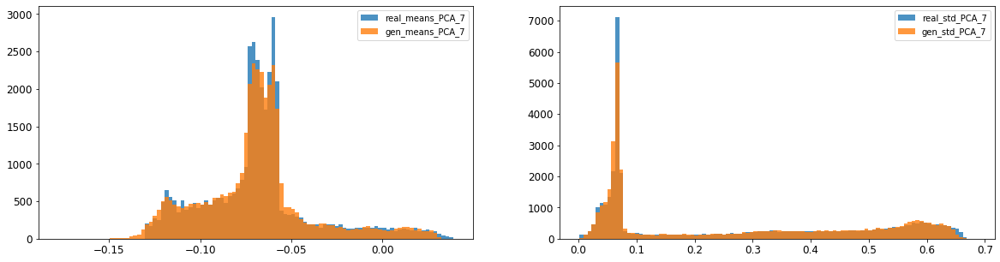

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002923196645002963
8: mean 1-BC divergence = 0.002050784888450785

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.01027639586186393
8: std 1-BC divergence = 0.007268559627848448


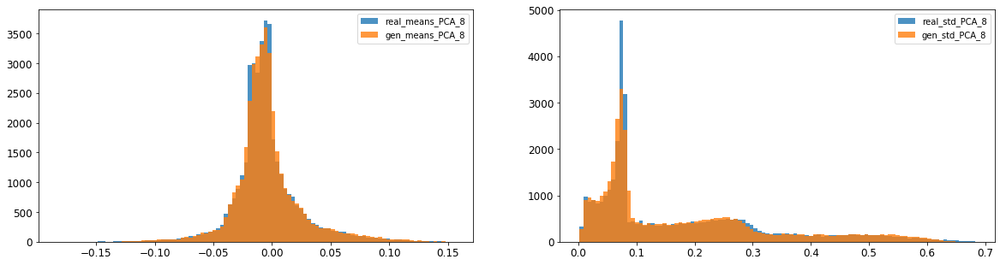

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003925209153435642
9: mean 1-BC divergence = 0.002771751264306399

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010059374347604174
9: std 1-BC divergence = 0.0071555763833491826


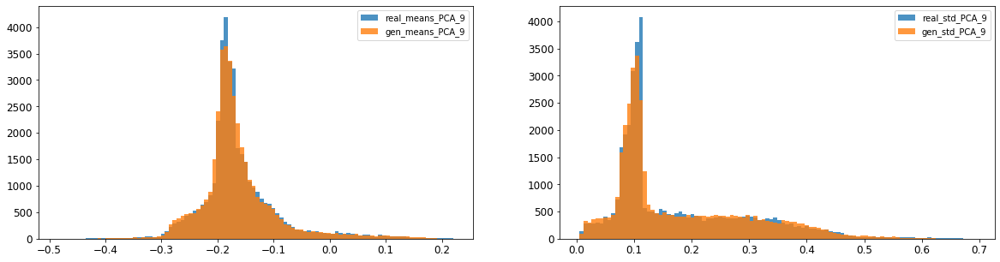

10: mean KL divergence (r,g) = 0.015965753376270344
10: mean JS divergence = 0.004017954617419318
10: mean 1-BC divergence = 0.0028422873246748415

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004578671709786795
10: std 1-BC divergence = 0.003849765257718407


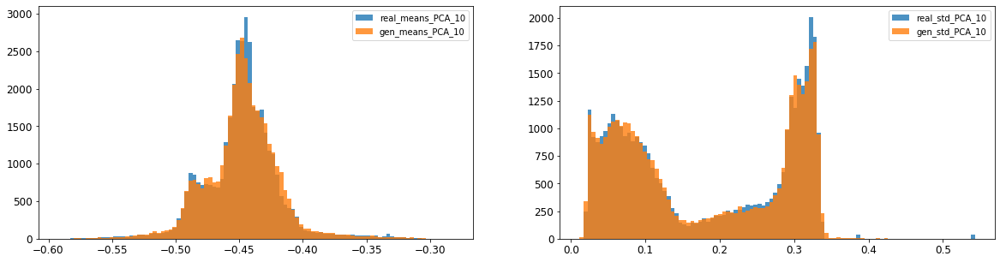

11: mean KL divergence (r,g) = 0.018962324150033513
11: mean JS divergence = 0.004755200305770584
11: mean 1-BC divergence = 0.003347968481174024

11: std KL divergence (r,g) = 0.029603760349047614
11: std JS divergence = 0.0075268611567905
11: std 1-BC divergence = 0.005303720159557379


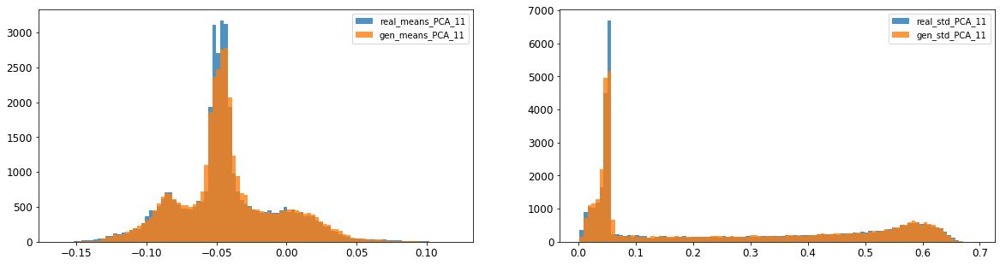

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.005004545739810783
12: mean 1-BC divergence = 0.0035022455378128647

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01769882738478236
12: std 1-BC divergence = 0.012555361373532858


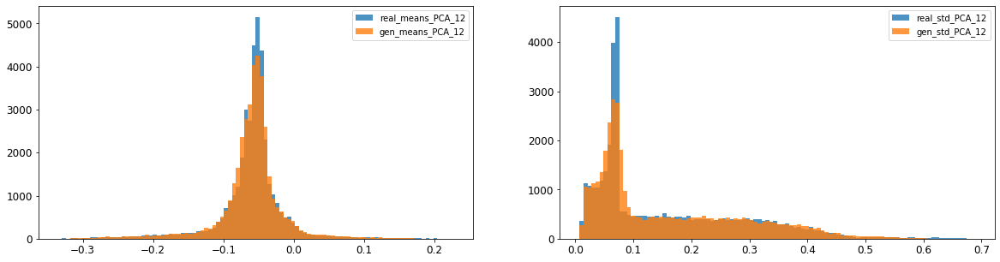

13: mean KL divergence (r,g) = 0.05281514434491702
13: mean JS divergence = 0.013199494942591428
13: mean 1-BC divergence = 0.009232034526798993

13: std KL divergence (r,g) = 0.07010227944361104
13: std JS divergence = 0.016935383441156825
13: std 1-BC divergence = 0.011839047929835478


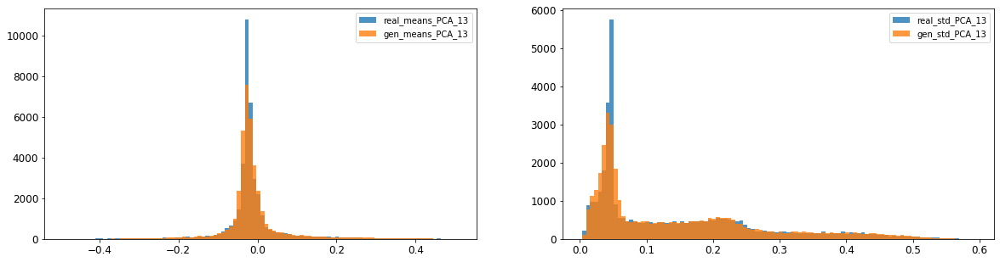

14: mean KL divergence (r,g) = 0.06389261318647509
14: mean JS divergence = 0.015653499984569975
14: mean 1-BC divergence = 0.010972264063010662

14: std KL divergence (r,g) = 0.02930513906354671
14: std JS divergence = 0.007354132270925191
14: std 1-BC divergence = 0.005133084541523503


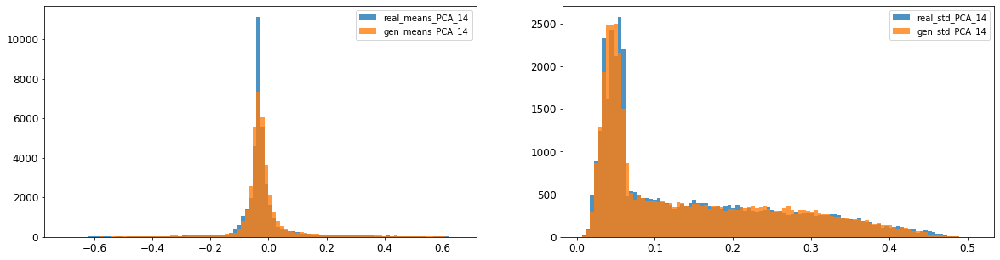

15: mean KL divergence (r,g) = 1.7120159968237183
15: mean JS divergence = 0.4614395147501251
15: mean 1-BC divergence = 0.42234695984572823

15: std KL divergence (r,g) = 6.403597347644763
15: std JS divergence = 0.9536094920805993
15: std 1-BC divergence = 0.8913167644457051


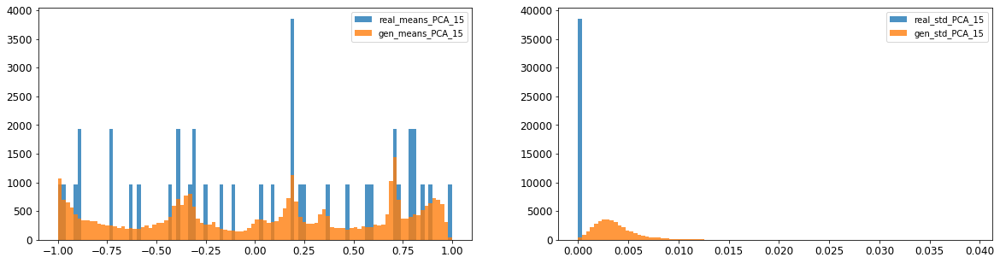

16: mean KL divergence (r,g) = 1.3730978701880006
16: mean JS divergence = 0.387952853427856
16: mean 1-BC divergence = 0.3576777455606156

16: std KL divergence (r,g) = 5.490168688618322
16: std JS divergence = 0.9227009728843527
16: std 1-BC divergence = 0.850841752617559


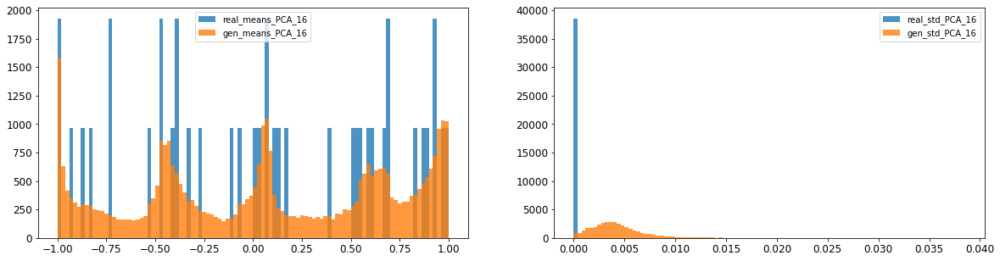



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010729057306913039
Compose 1-BC divergence = 0.007959031942263772

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.01066946477619108
Compose weighted 1-BC divergence = 0.008378631038581275

Multivariate KL divergence = 41.072048173936665


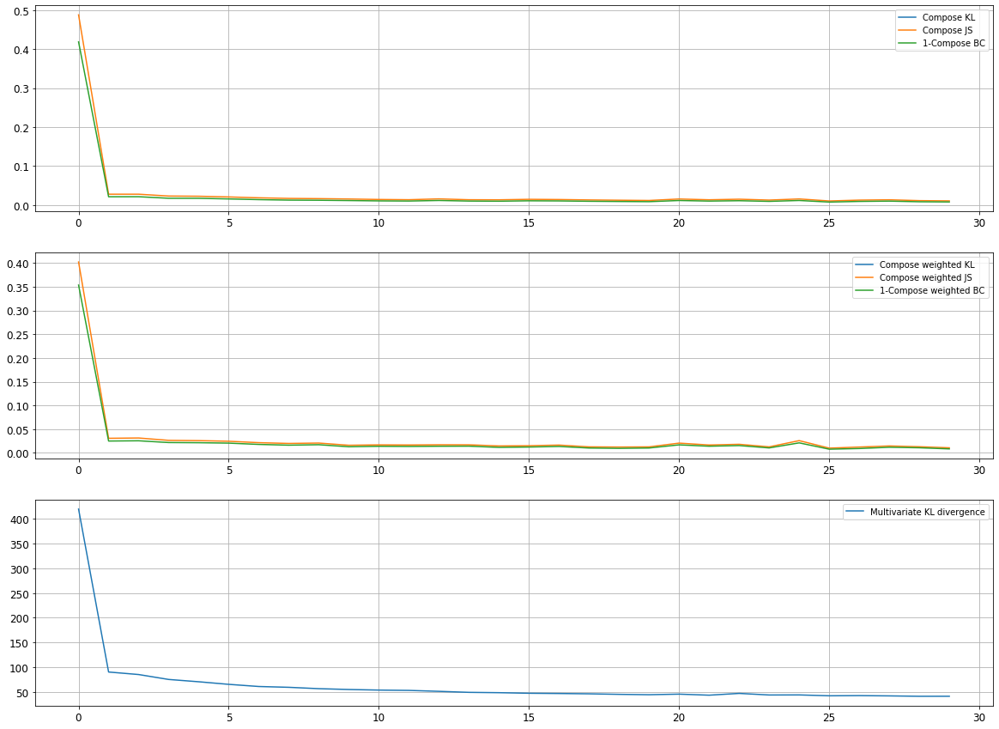

Epoch 5802/10000
discriminator loss: 0.047464 - generator loss: 8.341319 - 28s
Epoch 5803/10000
discriminator loss: 0.044485 - generator loss: 8.498840 - 28s
Epoch 5804/10000
discriminator loss: 0.325989 - generator loss: 7.807035 - 28s
Epoch 5805/10000
discriminator loss: 0.039760 - generator loss: 8.456486 - 28s
Epoch 5806/10000
discriminator loss: 0.039124 - generator loss: 8.593785 - 28s
Epoch 5807/10000
discriminator loss: 0.265057 - generator loss: 8.287139 - 28s
Epoch 5808/10000
discriminator loss: 0.068765 - generator loss: 7.974364 - 28s
Epoch 5809/10000
discriminator loss: 0.040117 - generator loss: 8.496595 - 28s
Epoch 5810/10000
discriminator loss: 0.146920 - generator loss: 8.102743 - 28s
Epoch 5811/10000
discriminator loss: 0.035900 - generator loss: 8.589814 - 28s
Epoch 5812/10000
discriminator loss: 0.245583 - generator loss: 7.831039 - 28s
Epoch 5813/10000
discriminator loss: 0.041425 - generator loss: 8.393627 - 29s
Epoch 5814/10000
discriminator loss: 0.036084 - gene

discriminator loss: 0.039620 - generator loss: 8.671503 - 28s
Epoch 5907/10000
discriminator loss: 0.046020 - generator loss: 8.475395 - 28s
Epoch 5908/10000
discriminator loss: 0.291261 - generator loss: 7.804945 - 28s
Epoch 5909/10000
discriminator loss: 0.040630 - generator loss: 8.420265 - 28s
Epoch 5910/10000
discriminator loss: 0.046214 - generator loss: 8.582199 - 28s
Epoch 5911/10000
discriminator loss: 0.045959 - generator loss: 8.499238 - 28s
Epoch 5912/10000
discriminator loss: 0.323746 - generator loss: 7.725274 - 28s
Epoch 5913/10000
discriminator loss: 0.062648 - generator loss: 8.039810 - 28s
Epoch 5914/10000
discriminator loss: 0.057085 - generator loss: 8.496868 - 28s
Epoch 5915/10000
discriminator loss: 0.035648 - generator loss: 8.633661 - 28s
Epoch 5916/10000
discriminator loss: 0.191971 - generator loss: 7.984827 - 28s
Epoch 5917/10000
discriminator loss: 0.043892 - generator loss: 8.515327 - 28s
Epoch 5918/10000
discriminator loss: 0.046427 - generator loss: 8.524

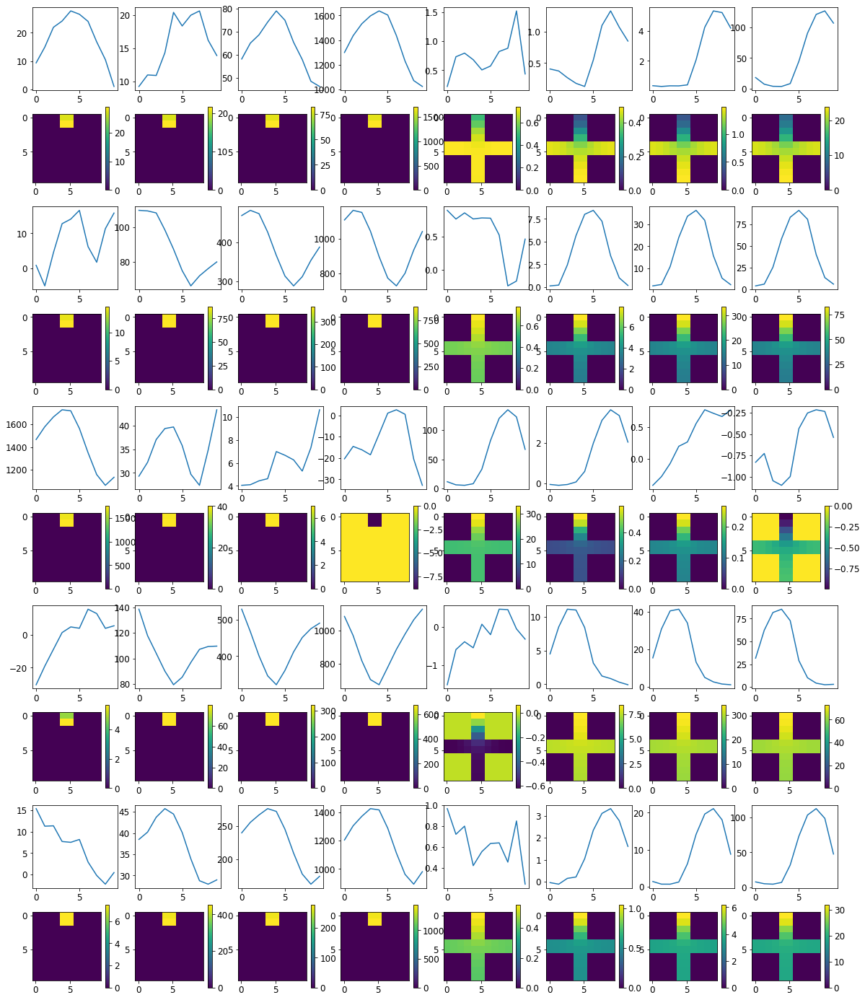


R0 generated:
[[19.64919    17.057957  ]
 [19.656002   16.929972  ]
 [19.65977    16.82573   ]
 [19.6609     16.78917   ]
 [19.65976    16.78205   ]
 [19.657038   16.730684  ]
 [19.670498   16.781408  ]
 [19.672703   16.83231   ]
 [19.64983    16.77097   ]
 [19.655008   16.910019  ]
 [17.107166    0.33935884]
 [17.095848    0.3304916 ]
 [17.108042    0.3203456 ]
 [17.116104    0.31037167]
 [17.11673     0.31044045]
 [17.140993    0.31458747]
 [17.14863     0.30173534]
 [17.163351    0.30408582]
 [17.189825    0.30949643]
 [17.171835    0.31200668]
 [16.94747     0.7107238 ]
 [17.118484    0.6769132 ]
 [17.119957    0.66439575]
 [17.11927     0.6632494 ]
 [17.07348     0.67500997]
 [17.049248    0.69747746]
 [17.03336     0.6933689 ]
 [17.038288    0.6785546 ]
 [17.059916    0.74496007]
 [17.090057    0.68208534]
 [19.777287   16.588102  ]
 [19.77174    16.464169  ]
 [19.76233    16.386705  ]
 [19.763397   16.322454  ]
 [19.766186   16.251757  ]
 [19.769106   16.165955  ]
 [19.778452  

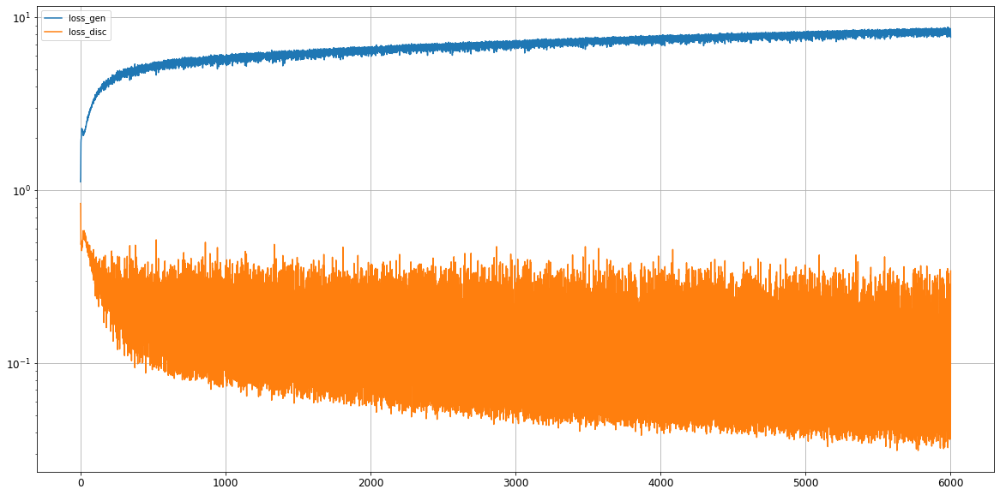

0: mean KL divergence (r,g) = 0.02755880743121661
0: mean JS divergence = 0.007550930031523825
0: mean 1-BC divergence = 0.005599852008494999

0: std KL divergence (r,g) = 0.035123896887685156
0: std JS divergence = 0.010793914439347668
0: std 1-BC divergence = 0.009731922950639404


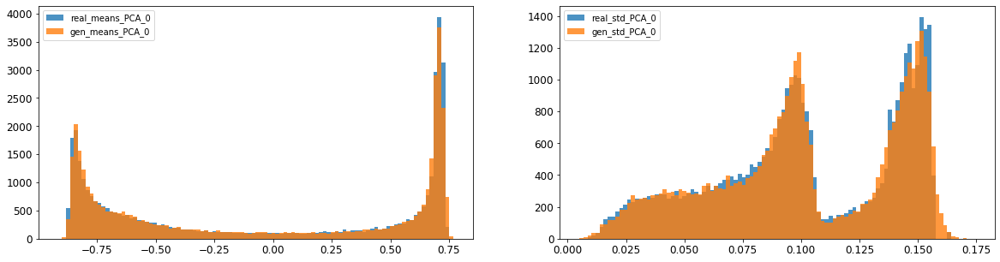

1: mean KL divergence (r,g) = 0.012470941652053615
1: mean JS divergence = 0.0031813826464796562
1: mean 1-BC divergence = 0.0022305928815977705

1: std KL divergence (r,g) = 0.023591225158871784
1: std JS divergence = 0.005815461458224257
1: std 1-BC divergence = 0.004057881521304818


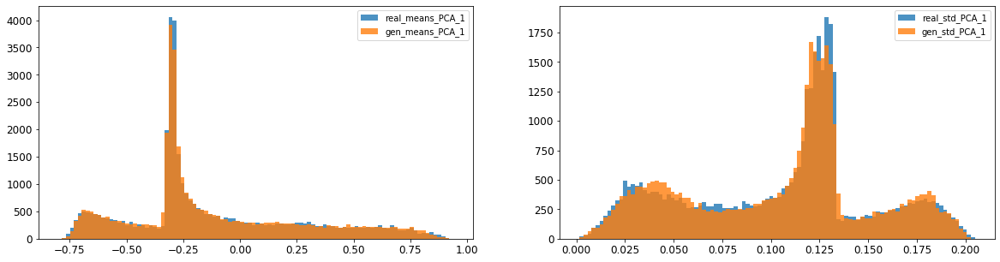

2: mean KL divergence (r,g) = 0.01022118834534217
2: mean JS divergence = 0.0026380687771820773
2: mean 1-BC divergence = 0.0019332821332819217

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.009829706396196005
2: std 1-BC divergence = 0.007814611153863504


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


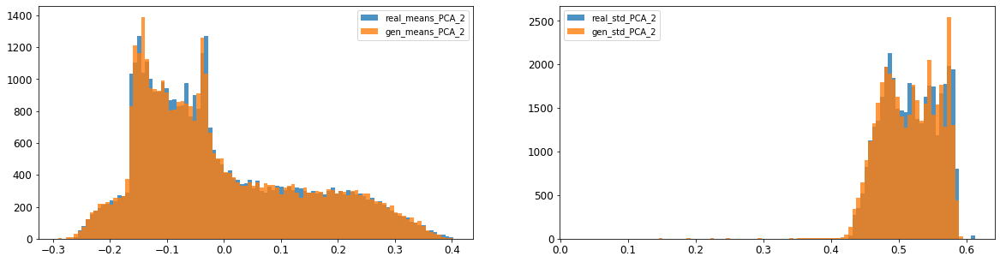

3: mean KL divergence (r,g) = 0.06087828268286459
3: mean JS divergence = 0.016027781811279715
3: mean 1-BC divergence = 0.011495442646199283

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.06073870713563617
3: std 1-BC divergence = 0.043642654019005245


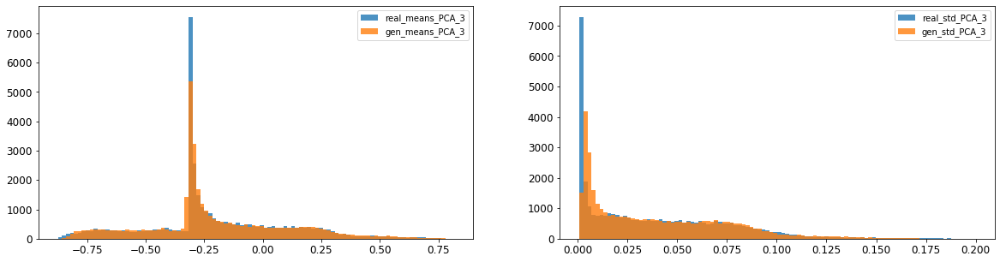

4: mean KL divergence (r,g) = 0.03281448869173723
4: mean JS divergence = 0.00891060629331029
4: mean 1-BC divergence = 0.00689664226111153

4: std KL divergence (r,g) = 0.0274536336489427
4: std JS divergence = 0.006541885378201389
4: std 1-BC divergence = 0.004653204145118606


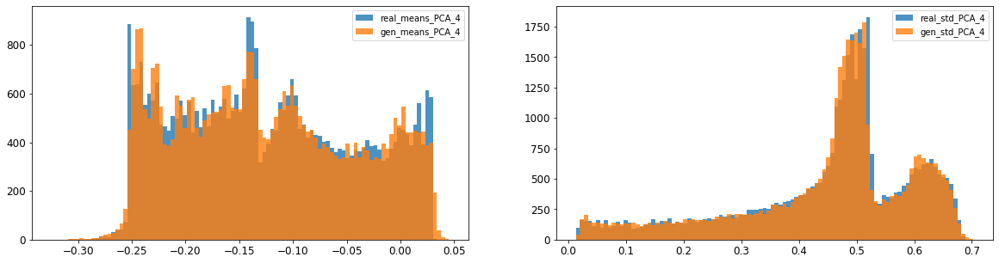

5: mean KL divergence (r,g) = 0.0780843986273512
5: mean JS divergence = 0.01773211031695377
5: mean 1-BC divergence = 0.0126525513882072

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.012987700139882676
5: std 1-BC divergence = 0.011087954039446624


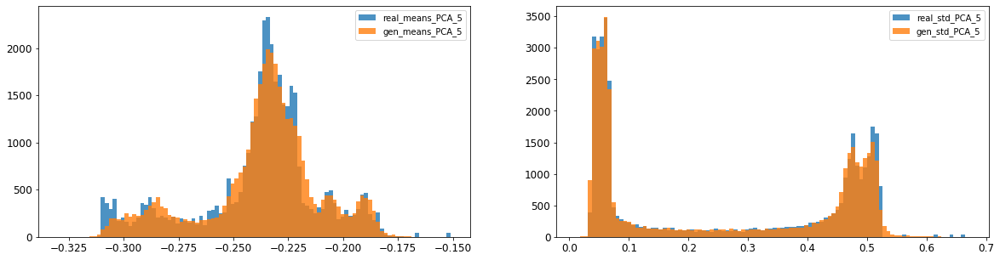

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004144150975189945
6: mean 1-BC divergence = 0.0029626887632183685

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.008229202123910205
6: std 1-BC divergence = 0.005890352348011718


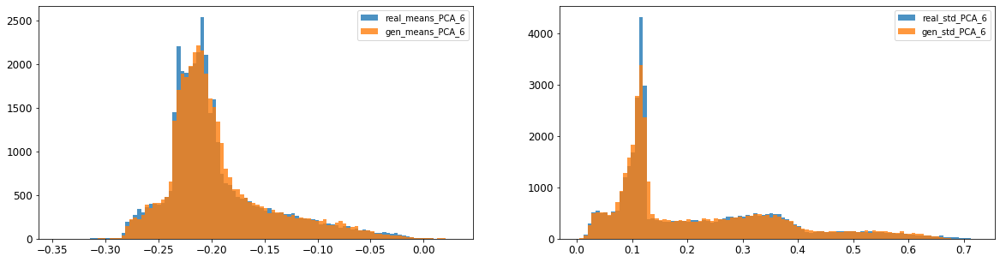

7: mean KL divergence (r,g) = 0.09159680537545241
7: mean JS divergence = 0.023702658609390203
7: mean 1-BC divergence = 0.017012755181249894

7: std KL divergence (r,g) = 0.026883146212889186
7: std JS divergence = 0.006639491959250969
7: std 1-BC divergence = 0.004691073174112326


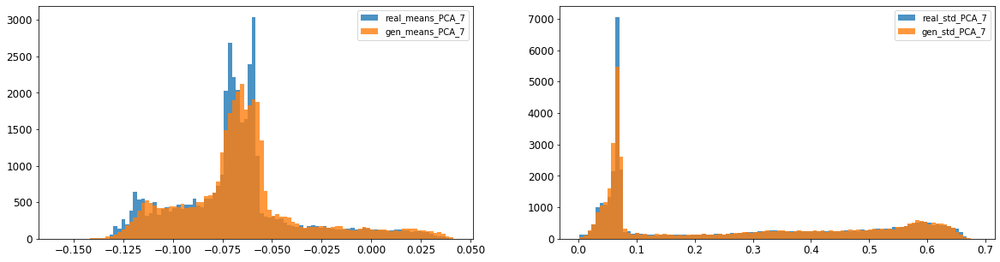

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0028380108491463754
8: mean 1-BC divergence = 0.0020066821984968675

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.01153198078927617
8: std 1-BC divergence = 0.00819672726952847


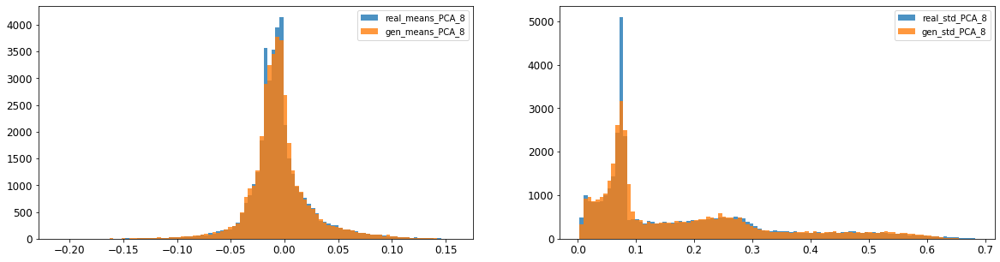

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004467517843497158
9: mean 1-BC divergence = 0.003155661498920548

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010688598073845503
9: std 1-BC divergence = 0.007576547475623863


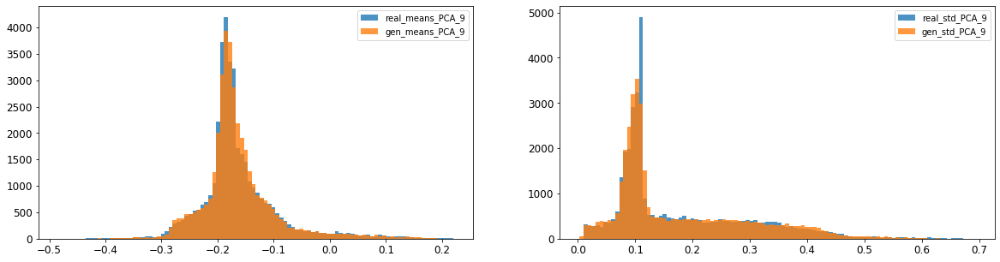

10: mean KL divergence (r,g) = 0.028674307682397218
10: mean JS divergence = 0.007055400195057414
10: mean 1-BC divergence = 0.004989292129635059

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005330573199296114
10: std 1-BC divergence = 0.004535265986091108


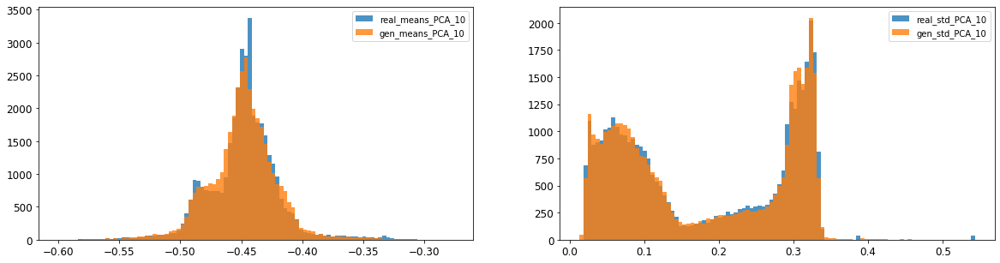

11: mean KL divergence (r,g) = 0.02958030595290114
11: mean JS divergence = 0.007495652813579493
11: mean 1-BC divergence = 0.005234992804225791

11: std KL divergence (r,g) = 0.0423956525250193
11: std JS divergence = 0.011363247509154694
11: std 1-BC divergence = 0.008183650951779198


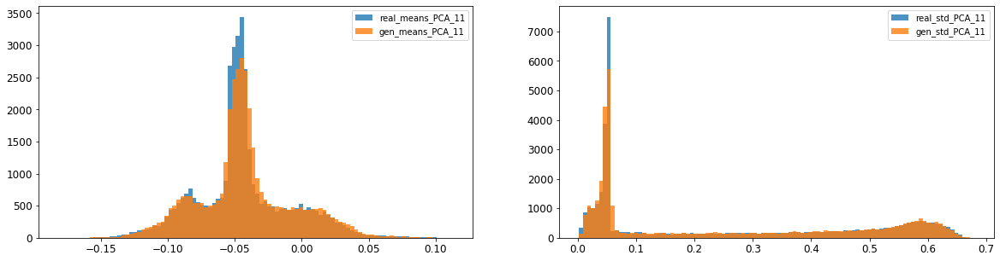

12: mean KL divergence (r,g) = 0.014951868839748047
12: mean JS divergence = 0.003729658753415096
12: mean 1-BC divergence = 0.002616444607075774

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.015325365960869568
12: std 1-BC divergence = 0.01091445431169169


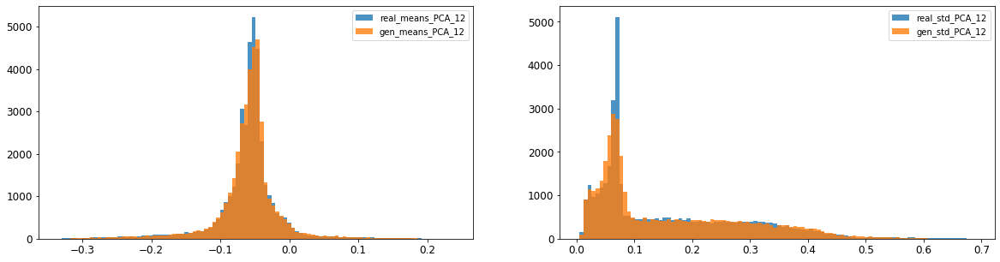

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.015502968659962424
13: mean 1-BC divergence = 0.01082849796412133

13: std KL divergence (r,g) = 0.06048051461181991
13: std JS divergence = 0.0146711235249387
13: std 1-BC divergence = 0.010247002136278827


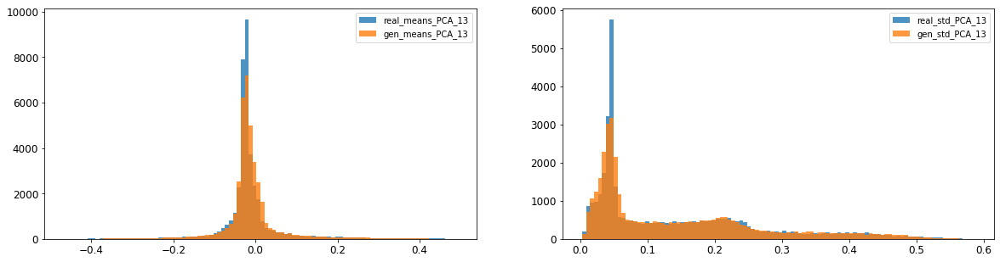

14: mean KL divergence (r,g) = 0.06306835534082979
14: mean JS divergence = 0.015300489729624188
14: mean 1-BC divergence = 0.01069983515538031

14: std KL divergence (r,g) = 0.03208755847629206
14: std JS divergence = 0.008007653794976349
14: std 1-BC divergence = 0.005588125307943059


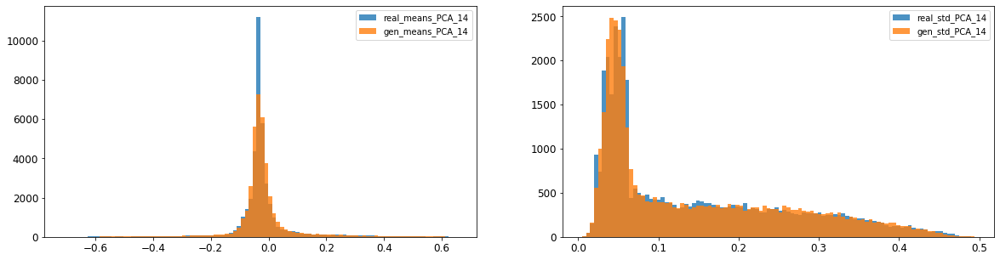

15: mean KL divergence (r,g) = 1.7079841304899035
15: mean JS divergence = 0.4591020527012796
15: mean 1-BC divergence = 0.42038180756626986

15: std KL divergence (r,g) = 6.713683829887609
15: std JS divergence = 0.961112339870775
15: std 1-BC divergence = 0.9023909933849443


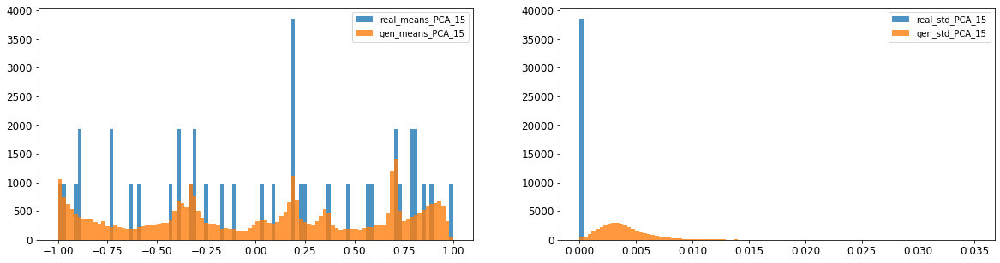

16: mean KL divergence (r,g) = 1.376177854072322
16: mean JS divergence = 0.38737542040549705
16: mean 1-BC divergence = 0.35735725995780343

16: std KL divergence (r,g) = 5.435658556877062
16: std JS divergence = 0.9203471562813881
16: std 1-BC divergence = 0.847997103377876


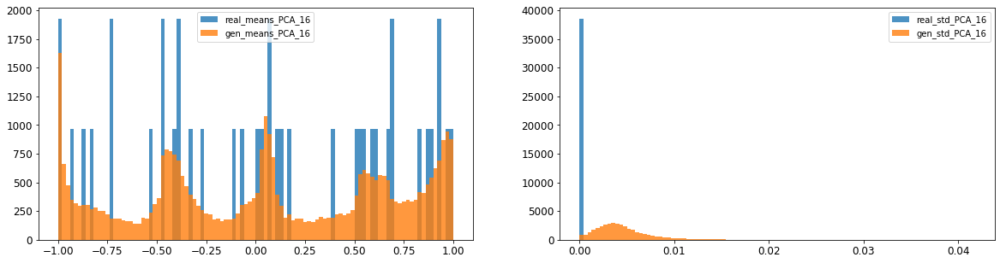



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.011292400006286602
Compose 1-BC divergence = 0.008237554680388448

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.009486125114830478
Compose weighted 1-BC divergence = 0.007453307891053473

Multivariate KL divergence = 41.47915019525388


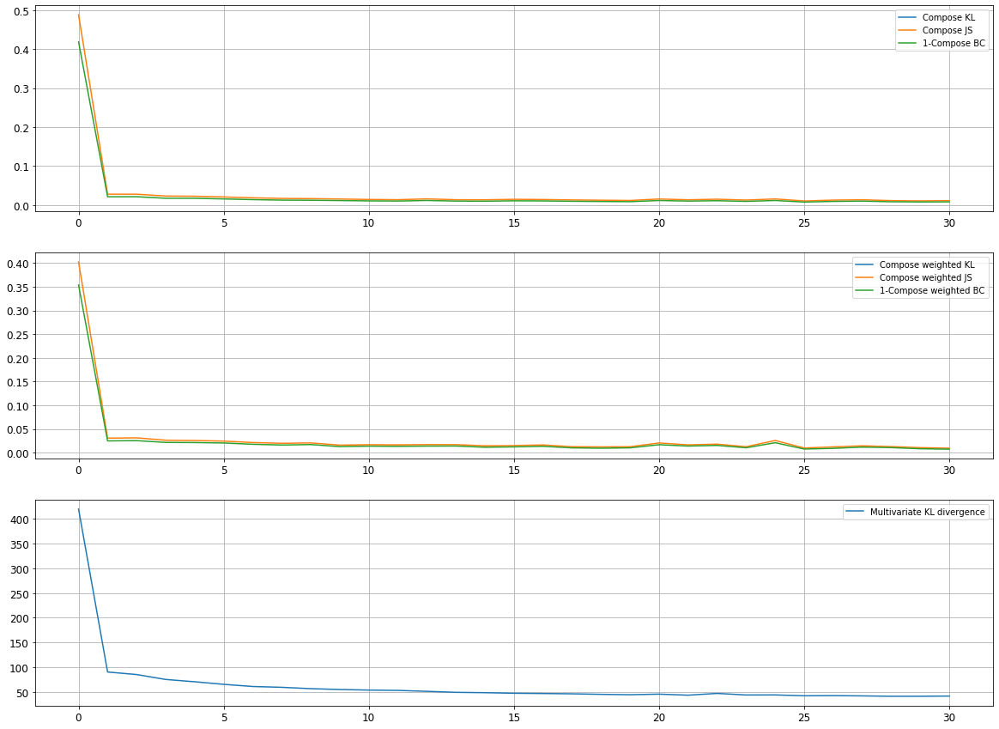

Epoch 6002/10000
discriminator loss: 0.036756 - generator loss: 8.578416 - 27s
Epoch 6003/10000
discriminator loss: 0.036835 - generator loss: 8.658554 - 28s
Epoch 6004/10000
discriminator loss: 0.048859 - generator loss: 8.520942 - 28s
Epoch 6005/10000
discriminator loss: 0.229060 - generator loss: 8.098258 - 28s
Epoch 6006/10000
discriminator loss: 0.041065 - generator loss: 8.561621 - 28s
Epoch 6007/10000
discriminator loss: 0.041209 - generator loss: 8.593558 - 28s
Epoch 6008/10000
discriminator loss: 0.165878 - generator loss: 8.574699 - 28s
Epoch 6009/10000
discriminator loss: 0.231743 - generator loss: 7.835976 - 28s
Epoch 6010/10000
discriminator loss: 0.044954 - generator loss: 8.537248 - 29s
Epoch 6011/10000
discriminator loss: 0.108901 - generator loss: 8.268618 - 28s
Epoch 6012/10000
discriminator loss: 0.042468 - generator loss: 8.540481 - 28s
Epoch 6013/10000
discriminator loss: 0.053289 - generator loss: 8.482082 - 28s
Epoch 6014/10000
discriminator loss: 0.293745 - gene

discriminator loss: 0.218896 - generator loss: 8.547421 - 28s
Epoch 6107/10000
discriminator loss: 0.092837 - generator loss: 8.087877 - 28s
Epoch 6108/10000
discriminator loss: 0.038847 - generator loss: 8.593936 - 28s
Epoch 6109/10000
discriminator loss: 0.044574 - generator loss: 8.643726 - 28s
Epoch 6110/10000
discriminator loss: 0.054656 - generator loss: 8.473135 - 28s
Epoch 6111/10000
discriminator loss: 0.365834 - generator loss: 7.824432 - 29s
Epoch 6112/10000
discriminator loss: 0.038294 - generator loss: 8.513679 - 28s
Epoch 6113/10000
discriminator loss: 0.031236 - generator loss: 8.781910 - 29s
Epoch 6114/10000
discriminator loss: 0.139007 - generator loss: 8.314271 - 28s
Epoch 6115/10000
discriminator loss: 0.038475 - generator loss: 8.660550 - 28s
Epoch 6116/10000
discriminator loss: 0.230857 - generator loss: 8.150187 - 28s
Epoch 6117/10000
discriminator loss: 0.039576 - generator loss: 8.480109 - 28s
Epoch 6118/10000
discriminator loss: 0.034618 - generator loss: 8.693

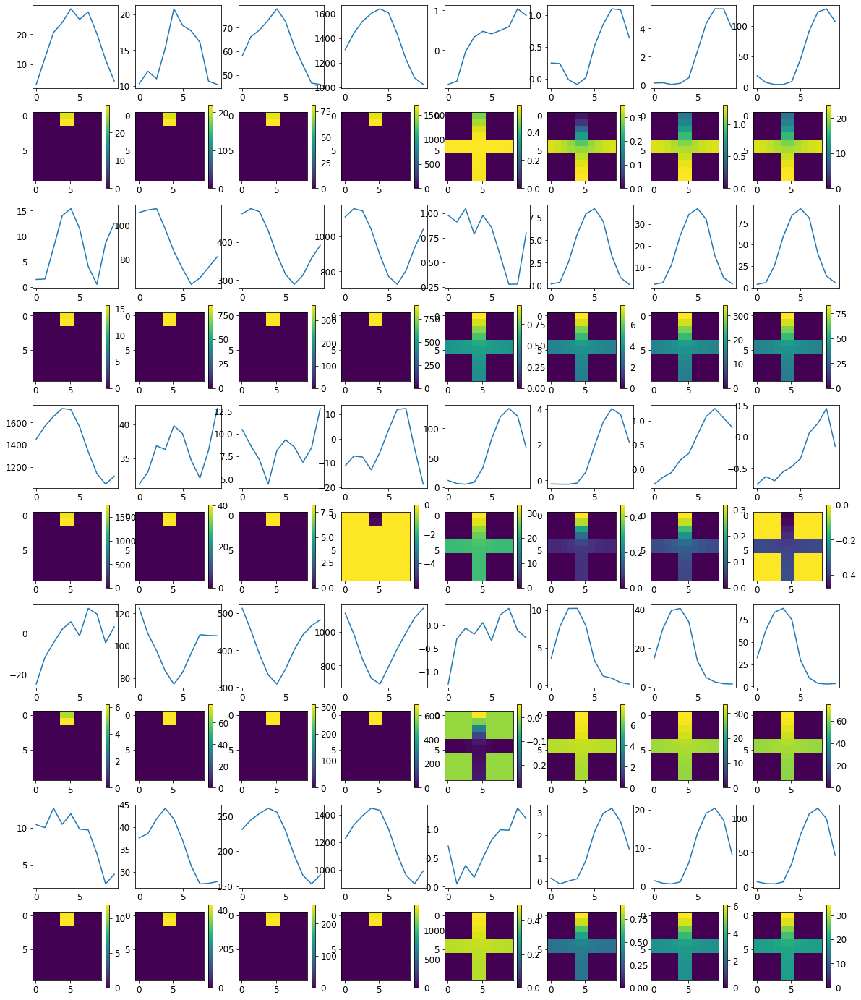


R0 generated:
[[19.574966   17.503496  ]
 [19.578632   17.457153  ]
 [19.59304    17.487785  ]
 [19.59728    17.530373  ]
 [19.59569    17.550201  ]
 [19.591843   17.524317  ]
 [19.610378   17.537132  ]
 [19.61106    17.519611  ]
 [19.589855   17.430557  ]
 [19.60029    17.5106    ]
 [16.997057    0.37852347]
 [16.983942    0.37076765]
 [17.041271    0.36449054]
 [17.044796    0.35336262]
 [17.012543    0.35536265]
 [17.049826    0.35954818]
 [17.031105    0.3436738 ]
 [17.028112    0.34232217]
 [17.056297    0.35097423]
 [17.051207    0.35239583]
 [16.798023    0.7561655 ]
 [16.92754     0.72392404]
 [16.964283    0.72857606]
 [16.969643    0.7519573 ]
 [16.908628    0.7469945 ]
 [16.94188     0.77450174]
 [16.924458    0.7378911 ]
 [16.906754    0.69666404]
 [16.895584    0.75170946]
 [16.96906     0.6795284 ]
 [19.747868   16.564405  ]
 [19.743914   16.55518   ]
 [19.738886   16.59516   ]
 [19.742315   16.57612   ]
 [19.748804   16.577269  ]
 [19.752777   16.514997  ]
 [19.762661  

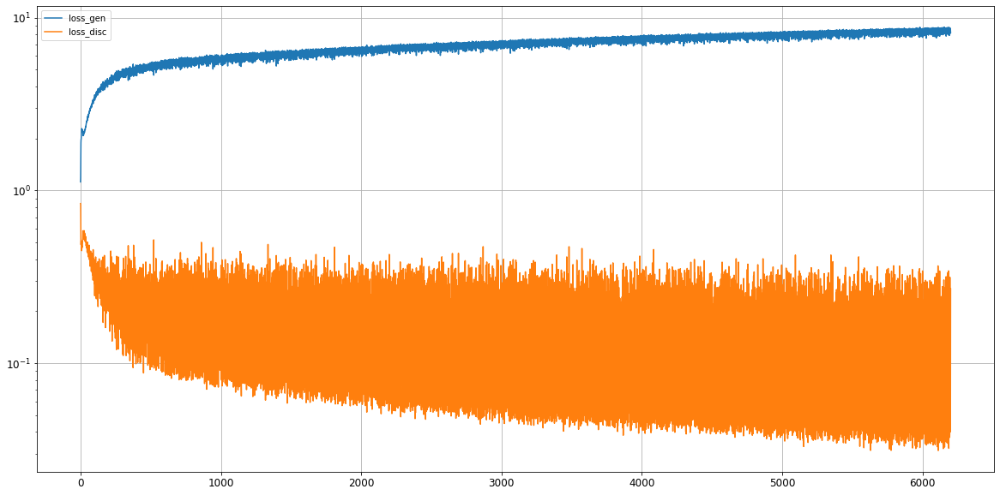

0: mean KL divergence (r,g) = 0.03143514611038442
0: mean JS divergence = 0.00823799685069906
0: mean 1-BC divergence = 0.00610872121378081

0: std KL divergence (r,g) = 0.08628040623289543
0: std JS divergence = 0.026800704464577052
0: std 1-BC divergence = 0.024072866762975487


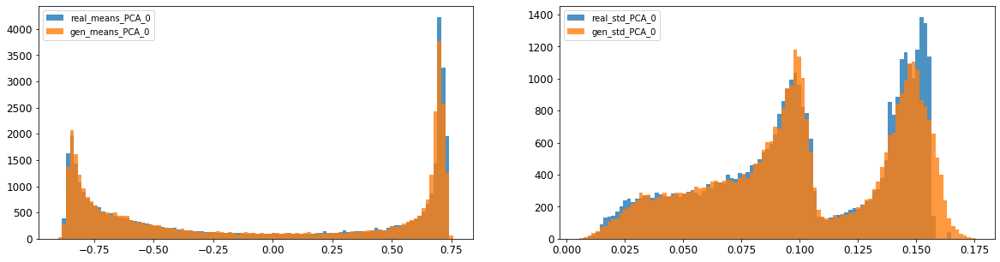

1: mean KL divergence (r,g) = 0.02437820128387072
1: mean JS divergence = 0.006153875820577258
1: mean 1-BC divergence = 0.00431685917594693

1: std KL divergence (r,g) = 0.021554630053929352
1: std JS divergence = 0.005221805090996895
1: std 1-BC divergence = 0.0036309461533627907


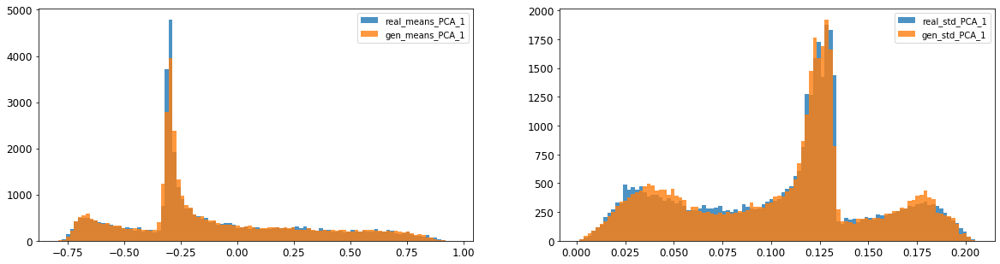

/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


2: mean KL divergence (r,g) = inf
2: mean JS divergence = 0.0031962018014891685
2: mean 1-BC divergence = 0.002405158015353792

2: std KL divergence (r,g) = 0.025548803664064756
2: std JS divergence = 0.006853643212885483
2: std 1-BC divergence = 0.0059382311216009676


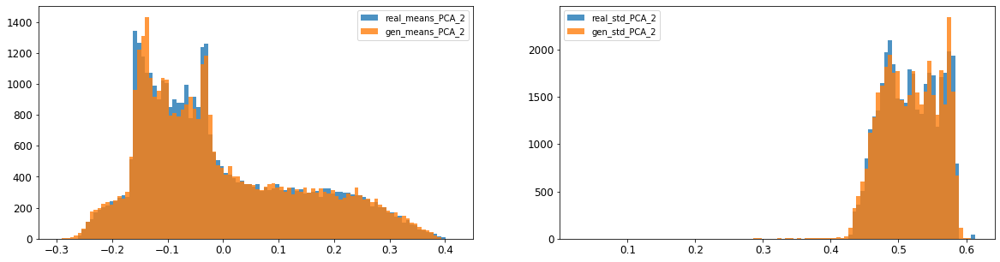

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.01982447348280797
3: mean 1-BC divergence = 0.014044196624678373

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.06555857034020174
3: std 1-BC divergence = 0.04742812337438429


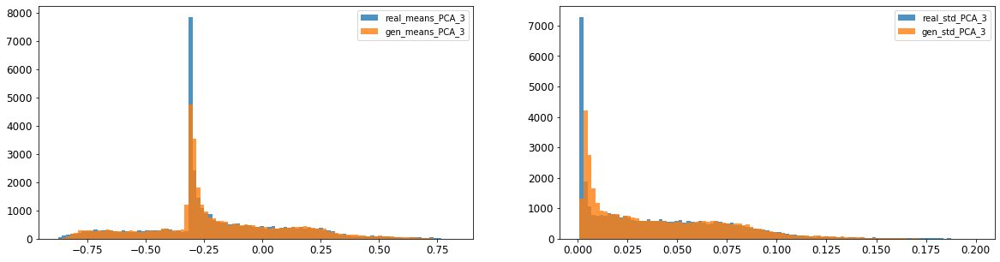

4: mean KL divergence (r,g) = 0.03680462288442205
4: mean JS divergence = 0.010485699870334828
4: mean 1-BC divergence = 0.008046260753200807

4: std KL divergence (r,g) = 0.0216471231541262
4: std JS divergence = 0.005250947768126772
4: std 1-BC divergence = 0.003742581011327517


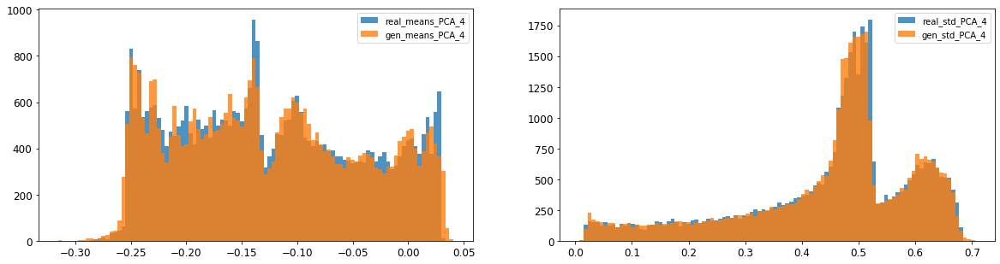

5: mean KL divergence (r,g) = 0.07242438012043667
5: mean JS divergence = 0.01804234742018585
5: mean 1-BC divergence = 0.013050856791558929

5: std KL divergence (r,g) = 0.045561406092725985
5: std JS divergence = 0.012949298141968407
5: std 1-BC divergence = 0.01138795442471896


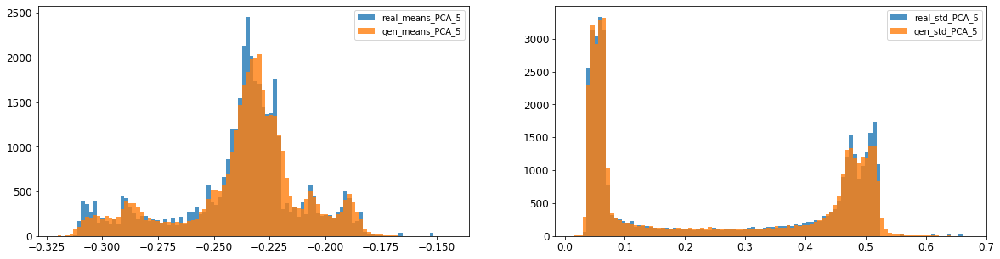

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.005397952427549596
6: mean 1-BC divergence = 0.0038144338054011406

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.011046228448547895
6: std 1-BC divergence = 0.007857017555887635


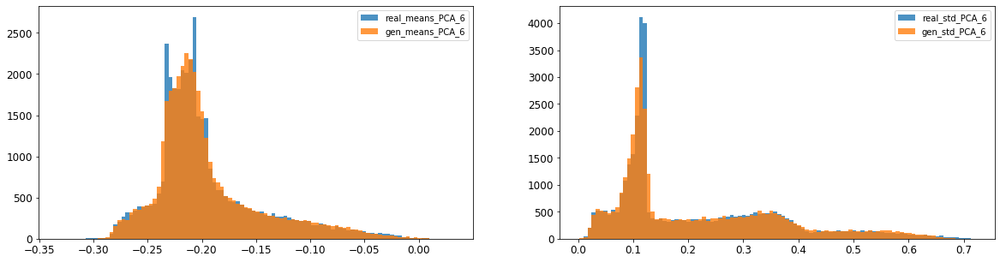

7: mean KL divergence (r,g) = 0.08179711416336154
7: mean JS divergence = 0.020273936868009032
7: mean 1-BC divergence = 0.01495141141525369

7: std KL divergence (r,g) = 0.05216456044052727
7: std JS divergence = 0.012812564631841269
7: std 1-BC divergence = 0.009046087285781823


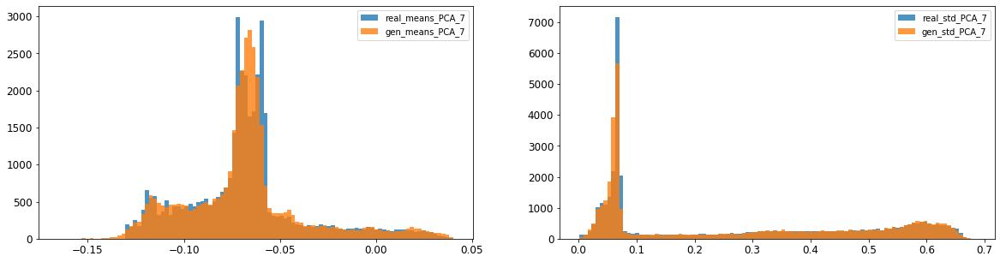

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.006345985813948974
8: mean 1-BC divergence = 0.0044528625561609525

8: std KL divergence (r,g) = 0.04081370970273732
8: std JS divergence = 0.009790986447273114
8: std 1-BC divergence = 0.0068561563066333875


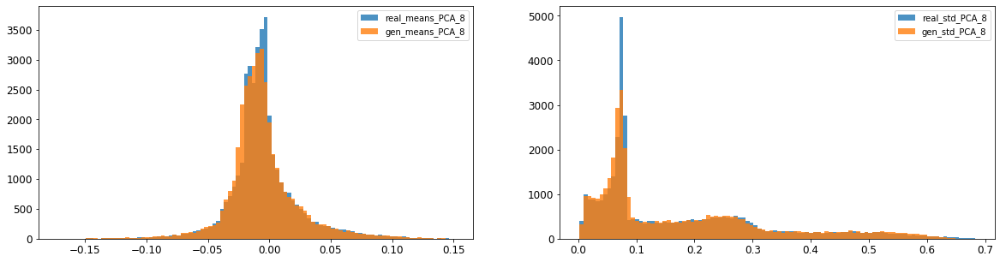

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004586840591230069
9: mean 1-BC divergence = 0.0032392610656993837

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010318037270458581
9: std 1-BC divergence = 0.007422206700781531


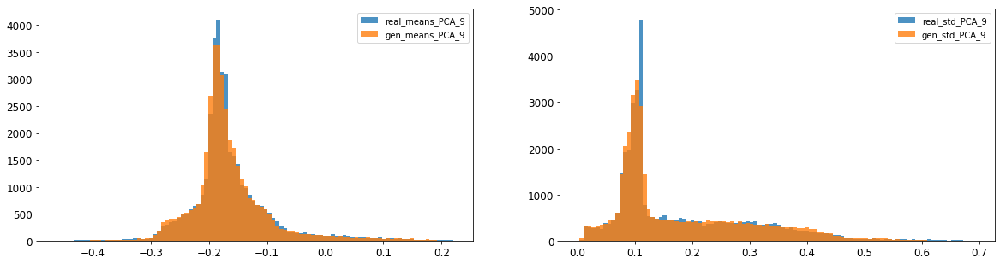

10: mean KL divergence (r,g) = 0.020280696656121103
10: mean JS divergence = 0.005028856664772636
10: mean 1-BC divergence = 0.0035902311536433196

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.006325503991336459
10: std 1-BC divergence = 0.004943540770731891


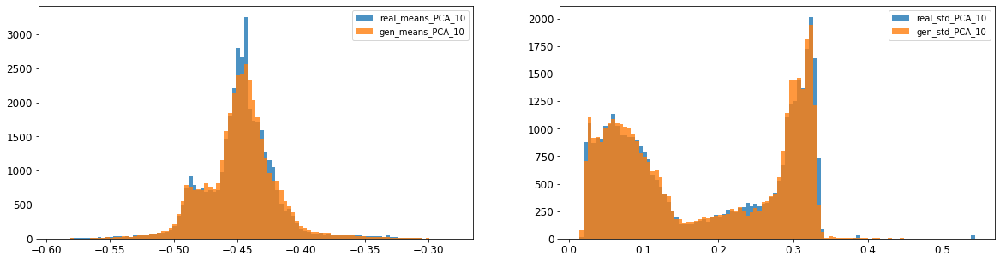

11: mean KL divergence (r,g) = 0.03818734412931404
11: mean JS divergence = 0.009617916784932663
11: mean 1-BC divergence = 0.006700721279765509

11: std KL divergence (r,g) = 0.03366987735133247
11: std JS divergence = 0.009209978048413475
11: std 1-BC divergence = 0.006614489617590813


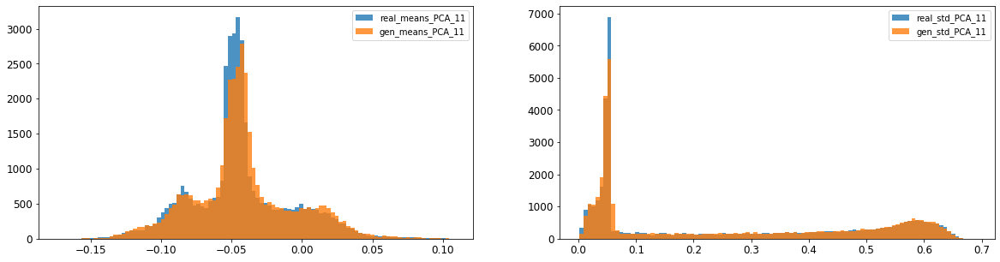

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.003828396881604663
12: mean 1-BC divergence = 0.0027110301591527497

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.015430822355884739
12: std 1-BC divergence = 0.010931905159063393


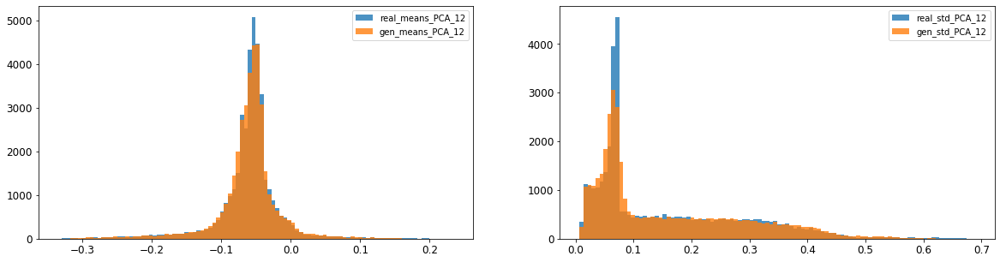

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.009099283872464881
13: mean 1-BC divergence = 0.00637424816457155

13: std KL divergence (r,g) = 0.05637260878685194
13: std JS divergence = 0.014001576236848844
13: std 1-BC divergence = 0.009802661329994966


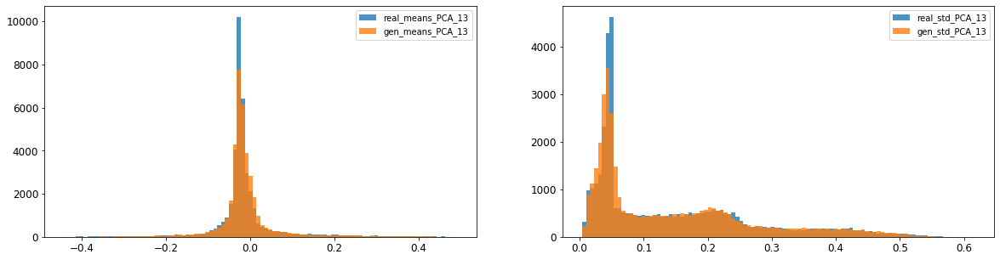

14: mean KL divergence (r,g) = 0.05591737762361444
14: mean JS divergence = 0.013542756797535384
14: mean 1-BC divergence = 0.009444655179287165

14: std KL divergence (r,g) = 0.03284784440174214
14: std JS divergence = 0.007977905978849145
14: std 1-BC divergence = 0.005571205196302831


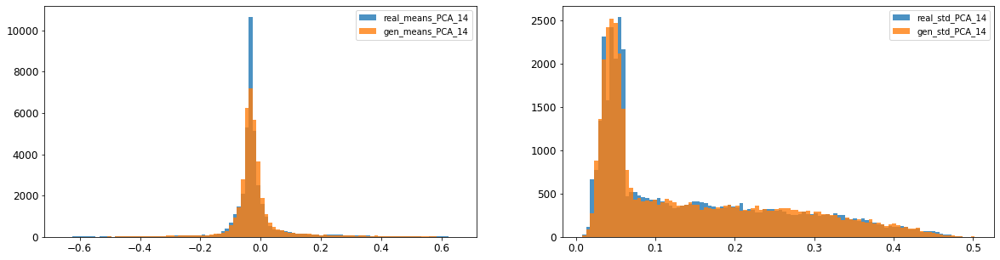

15: mean KL divergence (r,g) = 1.76033354613788
15: mean JS divergence = 0.4743430506735572
15: mean 1-BC divergence = 0.43467755300308886

15: std KL divergence (r,g) = 7.4585330231296485
15: std JS divergence = 0.974685028636701
15: std 1-BC divergence = 0.9245986853201371


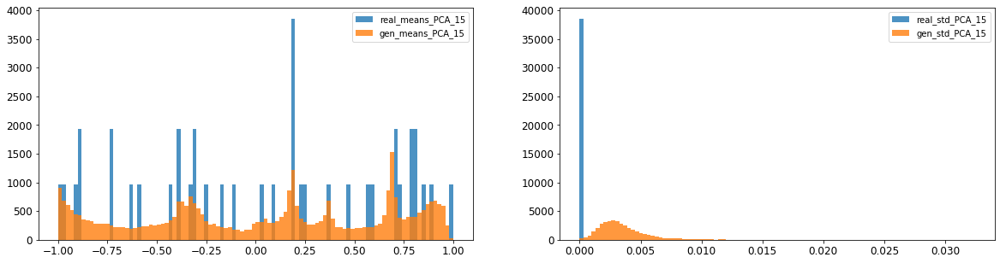

16: mean KL divergence (r,g) = 1.3767113035421708
16: mean JS divergence = 0.38821161680190996
16: mean 1-BC divergence = 0.3578064896386598

16: std KL divergence (r,g) = 5.678731231053185
16: std JS divergence = 0.9303500226013163
16: std 1-BC divergence = 0.8602776822966991


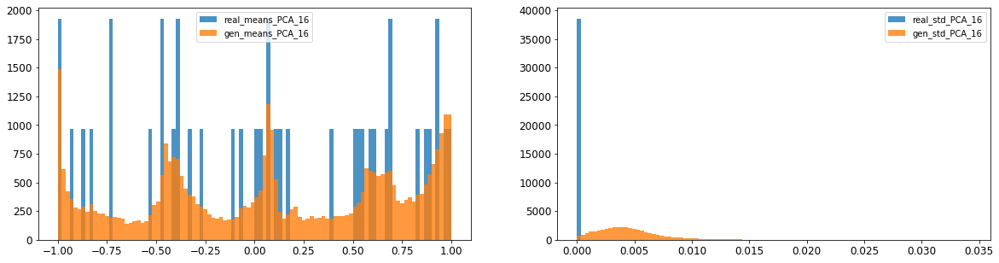



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.012107036479211731
Compose 1-BC divergence = 0.008949896004153413

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.014531796289236228
Compose weighted 1-BC divergence = 0.0118917064118369

Multivariate KL divergence = 41.41857247967941


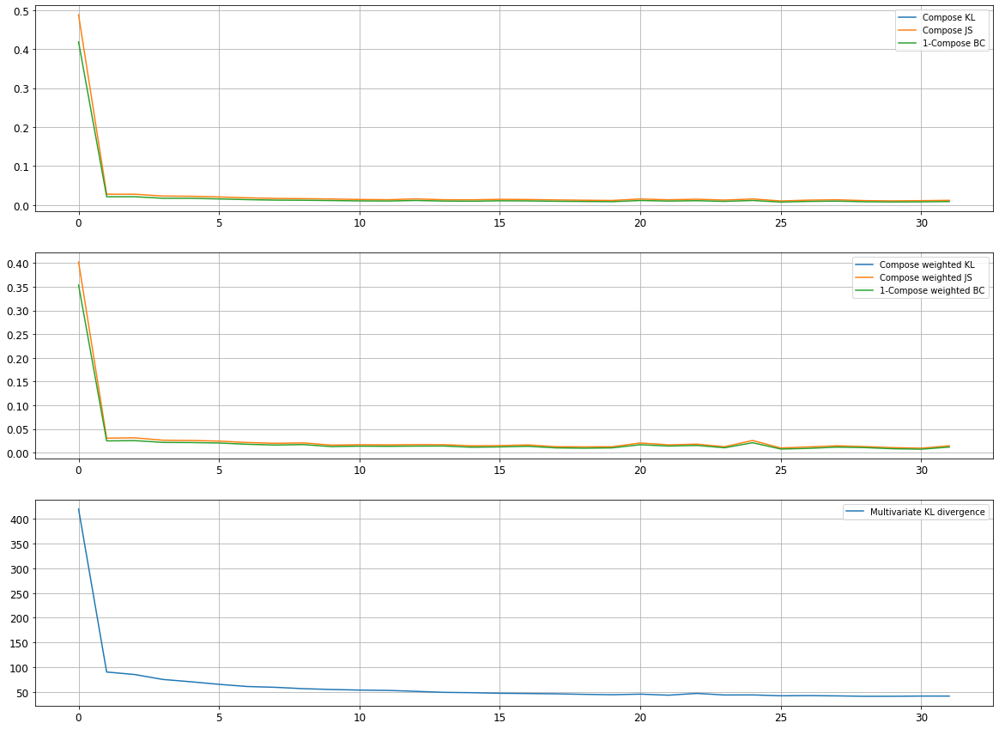

Epoch 6202/10000
discriminator loss: 0.039254 - generator loss: 8.400795 - 27s
Epoch 6203/10000
discriminator loss: 0.035304 - generator loss: 8.742437 - 28s
Epoch 6204/10000
discriminator loss: 0.124800 - generator loss: 8.625118 - 27s
Epoch 6205/10000
discriminator loss: 0.166956 - generator loss: 7.951659 - 28s
Epoch 6206/10000
discriminator loss: 0.037599 - generator loss: 8.665728 - 29s
Epoch 6207/10000
discriminator loss: 0.037034 - generator loss: 8.773180 - 28s
Epoch 6208/10000
discriminator loss: 0.254562 - generator loss: 7.946518 - 28s
Epoch 6209/10000
discriminator loss: 0.031878 - generator loss: 8.720324 - 28s
Epoch 6210/10000
discriminator loss: 0.046507 - generator loss: 8.637661 - 28s
Epoch 6211/10000
discriminator loss: 0.248387 - generator loss: 8.358116 - 28s
Epoch 6212/10000
discriminator loss: 0.048410 - generator loss: 8.233303 - 28s
Epoch 6213/10000
discriminator loss: 0.214262 - generator loss: 8.474403 - 29s
Epoch 6214/10000
discriminator loss: 0.052967 - gene

discriminator loss: 0.036745 - generator loss: 8.665373 - 28s
Epoch 6307/10000
discriminator loss: 0.040111 - generator loss: 8.620478 - 28s
Epoch 6308/10000
discriminator loss: 0.167630 - generator loss: 8.144815 - 28s
Epoch 6309/10000
discriminator loss: 0.045897 - generator loss: 8.640516 - 28s
Epoch 6310/10000
discriminator loss: 0.241419 - generator loss: 8.089399 - 29s
Epoch 6311/10000
discriminator loss: 0.038143 - generator loss: 8.648978 - 29s
Epoch 6312/10000
discriminator loss: 0.253811 - generator loss: 8.119351 - 28s
Epoch 6313/10000
discriminator loss: 0.037614 - generator loss: 8.619157 - 29s
Epoch 6314/10000
discriminator loss: 0.035005 - generator loss: 8.774943 - 28s
Epoch 6315/10000
discriminator loss: 0.052354 - generator loss: 8.616800 - 28s
Epoch 6316/10000
discriminator loss: 0.249355 - generator loss: 8.281195 - 28s
Epoch 6317/10000
discriminator loss: 0.052756 - generator loss: 8.359582 - 28s
Epoch 6318/10000
discriminator loss: 0.036995 - generator loss: 8.717

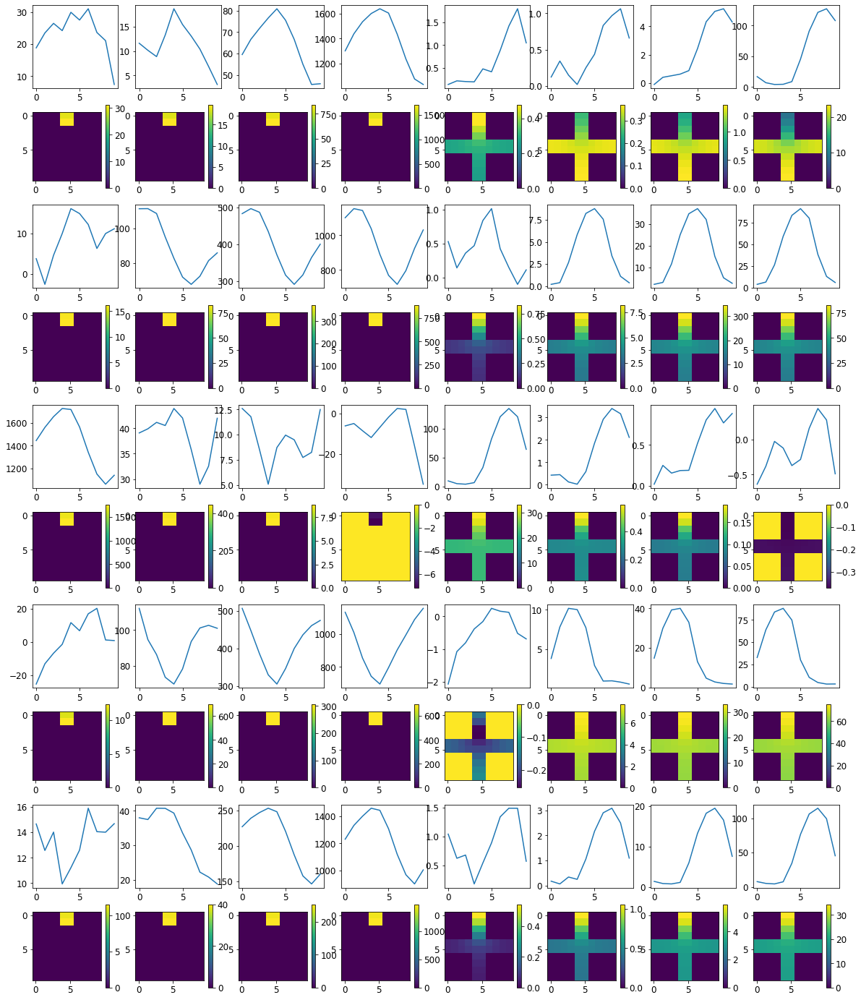


R0 generated:
[[19.57887    17.65854   ]
 [19.583033   17.515095  ]
 [19.581238   17.569489  ]
 [19.58143    17.545483  ]
 [19.56737    17.583998  ]
 [19.5633     17.536177  ]
 [19.580227   17.573555  ]
 [19.58088    17.544764  ]
 [19.557749   17.550285  ]
 [19.581326   17.559307  ]
 [17.008942    0.3188692 ]
 [17.006922    0.31084746]
 [17.032967    0.30649227]
 [17.006931    0.2947212 ]
 [16.993942    0.29953703]
 [17.041056    0.3016496 ]
 [17.072796    0.29245466]
 [17.053797    0.2906517 ]
 [17.100407    0.30016854]
 [17.114677    0.30041343]
 [16.879345    0.8259705 ]
 [17.013578    0.7851492 ]
 [17.026882    0.81239814]
 [17.008493    0.8326172 ]
 [16.967146    0.8474776 ]
 [16.964474    0.8556737 ]
 [16.965336    0.8381077 ]
 [16.954136    0.81363493]
 [16.9602      0.857721  ]
 [17.031206    0.7716912 ]
 [19.75411    16.623365  ]
 [19.752655   16.522425  ]
 [19.741697   16.567766  ]
 [19.743525   16.472532  ]
 [19.7443     16.46656   ]
 [19.748138   16.332344  ]
 [19.753225  

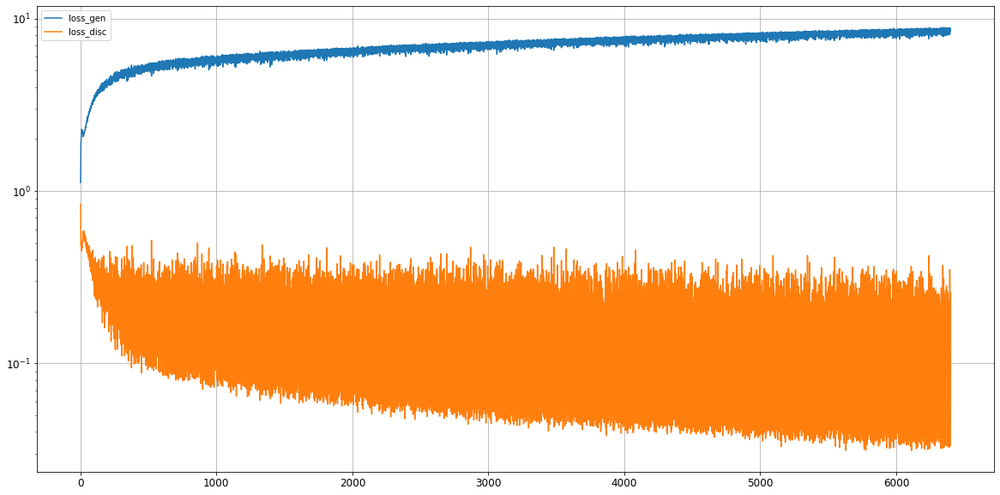

0: mean KL divergence (r,g) = 0.01257304265160681
0: mean JS divergence = 0.0032970477510696128
0: mean 1-BC divergence = 0.002473743434272424

0: std KL divergence (r,g) = 0.048660005420443256
0: std JS divergence = 0.014303637988471025
0: std 1-BC divergence = 0.012647261845039393


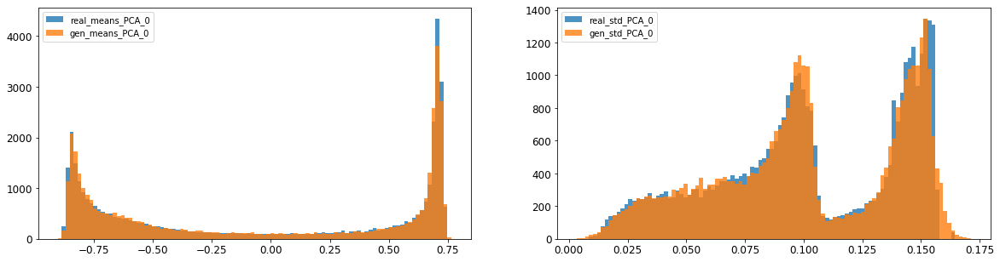

1: mean KL divergence (r,g) = 0.031616007599515945
1: mean JS divergence = 0.008223376026407929
1: mean 1-BC divergence = 0.005823965724408908

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.017693681324839866
1: std 1-BC divergence = 0.012880530091291309


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


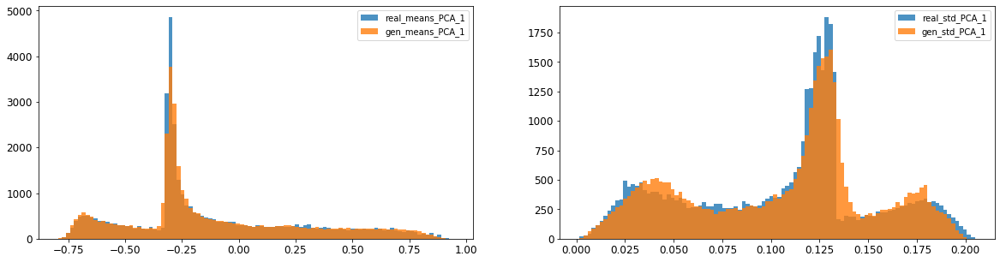

2: mean KL divergence (r,g) = 0.025919572437837882
2: mean JS divergence = 0.006282765163410633
2: mean 1-BC divergence = 0.004474359951293194

2: std KL divergence (r,g) = 0.04595667252027817
2: std JS divergence = 0.0134335488587982
2: std 1-BC divergence = 0.011460177453849751


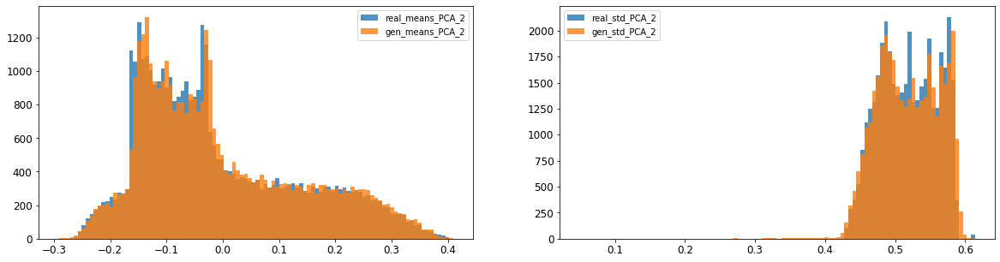

3: mean KL divergence (r,g) = 0.07017529641565
3: mean JS divergence = 0.01729871128723135
3: mean 1-BC divergence = 0.012128593114554498

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0759089519814739
3: std 1-BC divergence = 0.055185569967304504


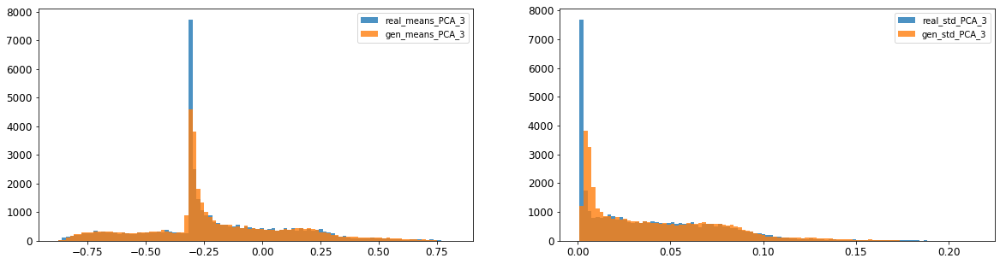

4: mean KL divergence (r,g) = 0.08800635902324737
4: mean JS divergence = 0.02064473357454745
4: mean 1-BC divergence = 0.01595311971257718

4: std KL divergence (r,g) = 0.017490355860067783
4: std JS divergence = 0.00461760175465966
4: std 1-BC divergence = 0.0033528880487004864


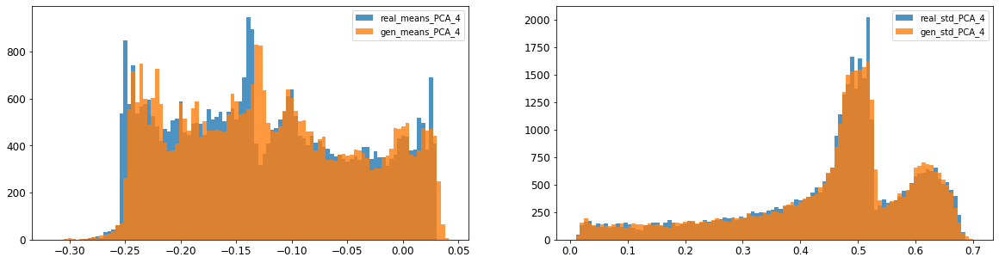

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.023144901911520827
5: mean 1-BC divergence = 0.01674924517763876

5: std KL divergence (r,g) = 0.04781530502319706
5: std JS divergence = 0.013801327417423888
5: std 1-BC divergence = 0.01252207975125652


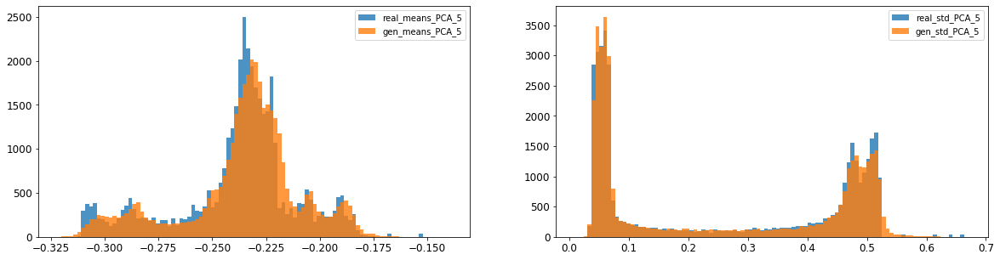

6: mean KL divergence (r,g) = 0.05696287513325804
6: mean JS divergence = 0.011858801920331995
6: mean 1-BC divergence = 0.008502633814899463

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.00622277597754407
6: std 1-BC divergence = 0.004480166726865575


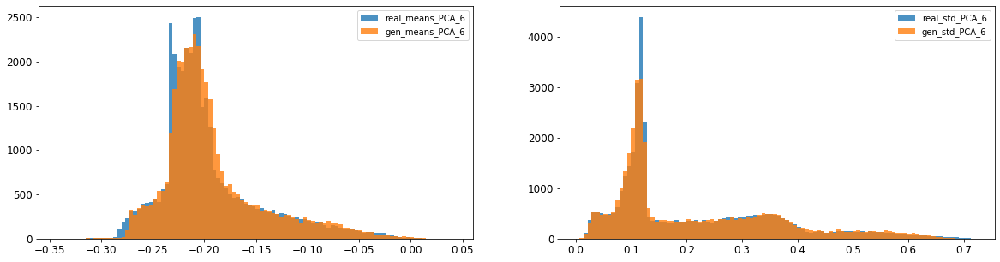

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.03436965073977718
7: mean 1-BC divergence = 0.025869227384908045

7: std KL divergence (r,g) = 0.024043865541545594
7: std JS divergence = 0.005859040216618717
7: std 1-BC divergence = 0.004114919317498966


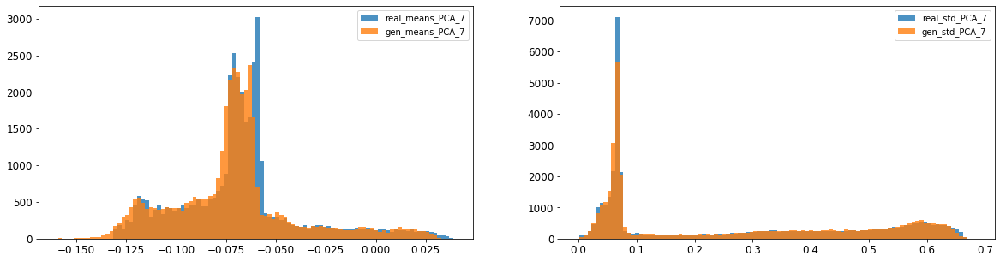

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.007390532900694791
8: mean 1-BC divergence = 0.005176398064842491

8: std KL divergence (r,g) = 0.03690001526679424
8: std JS divergence = 0.00887653125072939
8: std 1-BC divergence = 0.006228258209503124


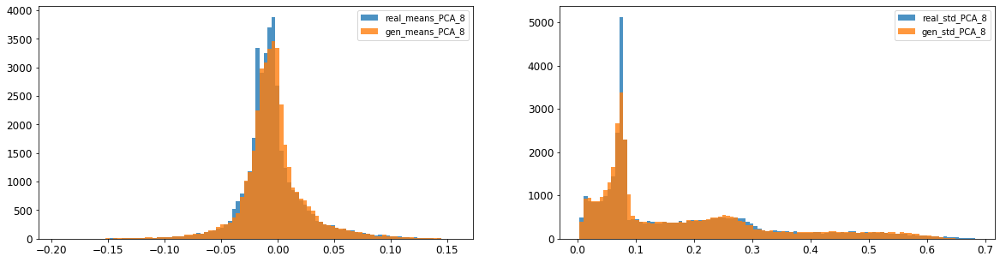

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.01086837503134435
9: mean 1-BC divergence = 0.007621101878262704

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.011313426343836159
9: std 1-BC divergence = 0.008000925144908577


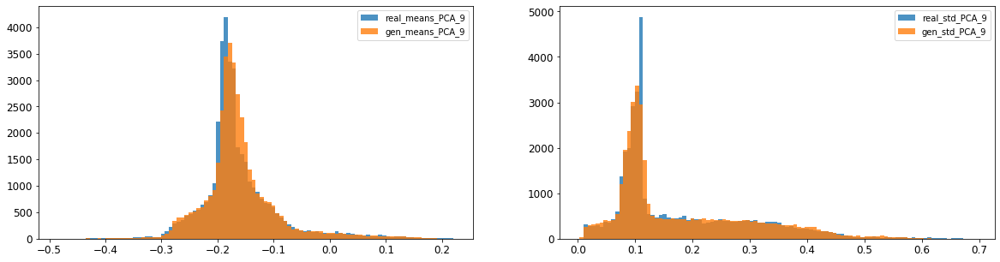

10: mean KL divergence (r,g) = 0.11348763469250976
10: mean JS divergence = 0.02843813680938915
10: mean 1-BC divergence = 0.019961442524681905

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.011617398360202202
10: std 1-BC divergence = 0.009217657106474375


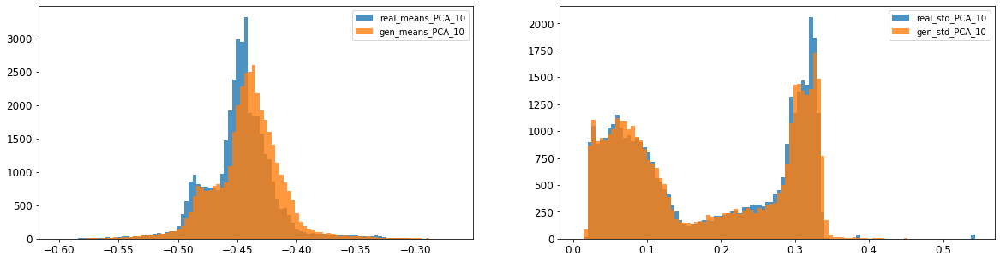

11: mean KL divergence (r,g) = 0.16306040510351444
11: mean JS divergence = 0.0406520615339878
11: mean 1-BC divergence = 0.028677000727121982

11: std KL divergence (r,g) = 0.05330024813393516
11: std JS divergence = 0.014543468077016558
11: std 1-BC divergence = 0.010484627694208104


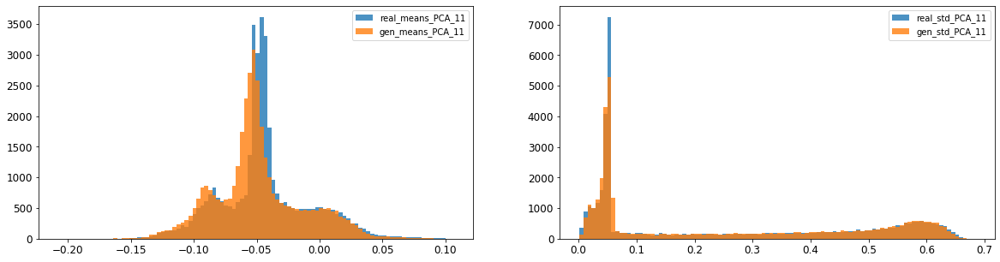

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.014785433824407978
12: mean 1-BC divergence = 0.010402708650220194

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.017906415744404672
12: std 1-BC divergence = 0.0127146993062206


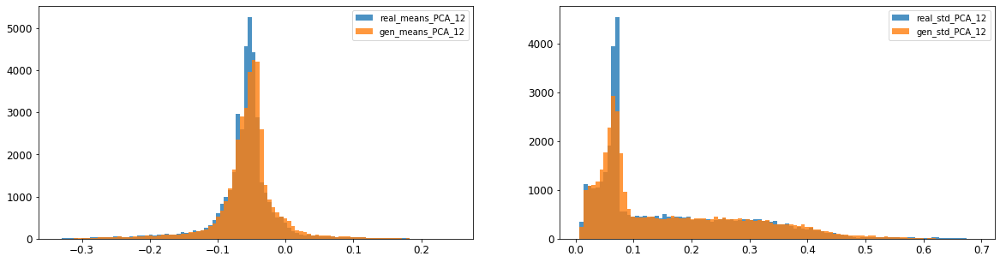

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.012269556955207272
13: mean 1-BC divergence = 0.008594123028734746

13: std KL divergence (r,g) = inf
13: std JS divergence = 0.015961147457507076
13: std 1-BC divergence = 0.01119148214075072


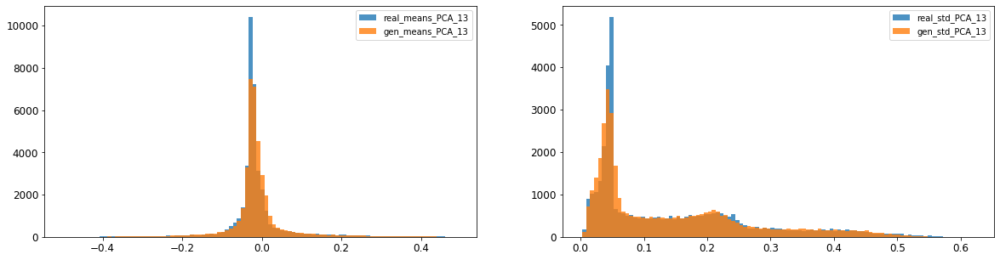

14: mean KL divergence (r,g) = 0.03903358160643946
14: mean JS divergence = 0.009621532497983032
14: mean 1-BC divergence = 0.006757544575040075

14: std KL divergence (r,g) = 0.02821637317421357
14: std JS divergence = 0.006649345869373253
14: std 1-BC divergence = 0.004641830619570686


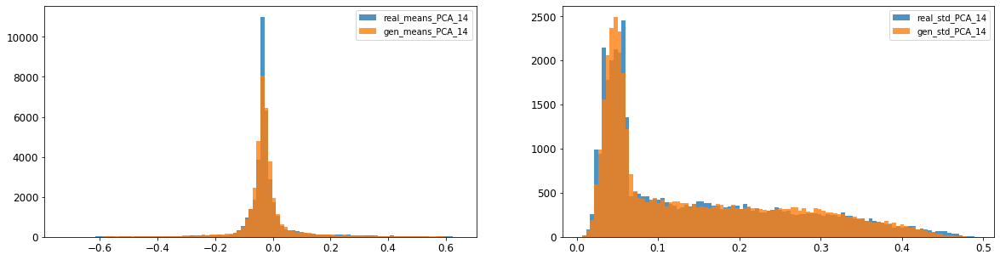

15: mean KL divergence (r,g) = 1.7797912979807995
15: mean JS divergence = 0.47812696204168637
15: mean 1-BC divergence = 0.4378708547521726

15: std KL divergence (r,g) = 6.721567428963442
15: std JS divergence = 0.9612870871494872
15: std 1-BC divergence = 0.9026573213209154


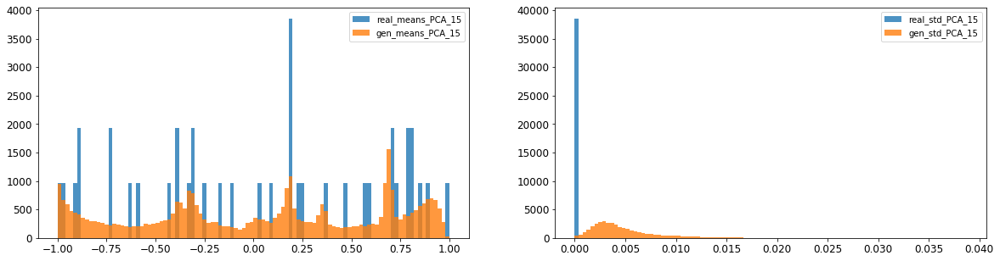

16: mean KL divergence (r,g) = 1.3924493557906508
16: mean JS divergence = 0.3895151462561707
16: mean 1-BC divergence = 0.3584506477165119

16: std KL divergence (r,g) = 5.578684054202855
16: std JS divergence = 0.9263848256573561
16: std 1-BC divergence = 0.8553480203271983


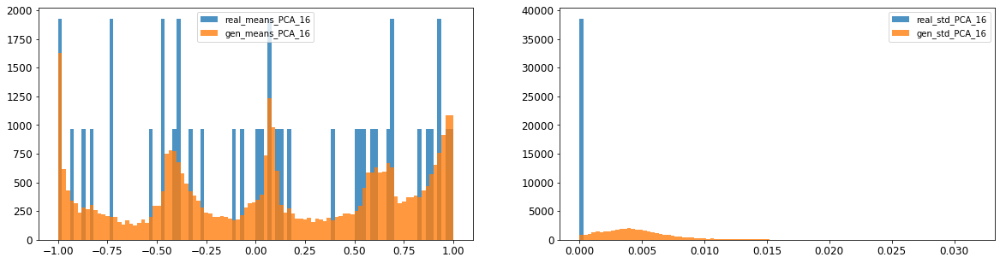



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.016261797218340337
Compose 1-BC divergence = 0.011942942706229975

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.012203896897274863
Compose weighted 1-BC divergence = 0.009604598647062312

Multivariate KL divergence = 42.74489103893129


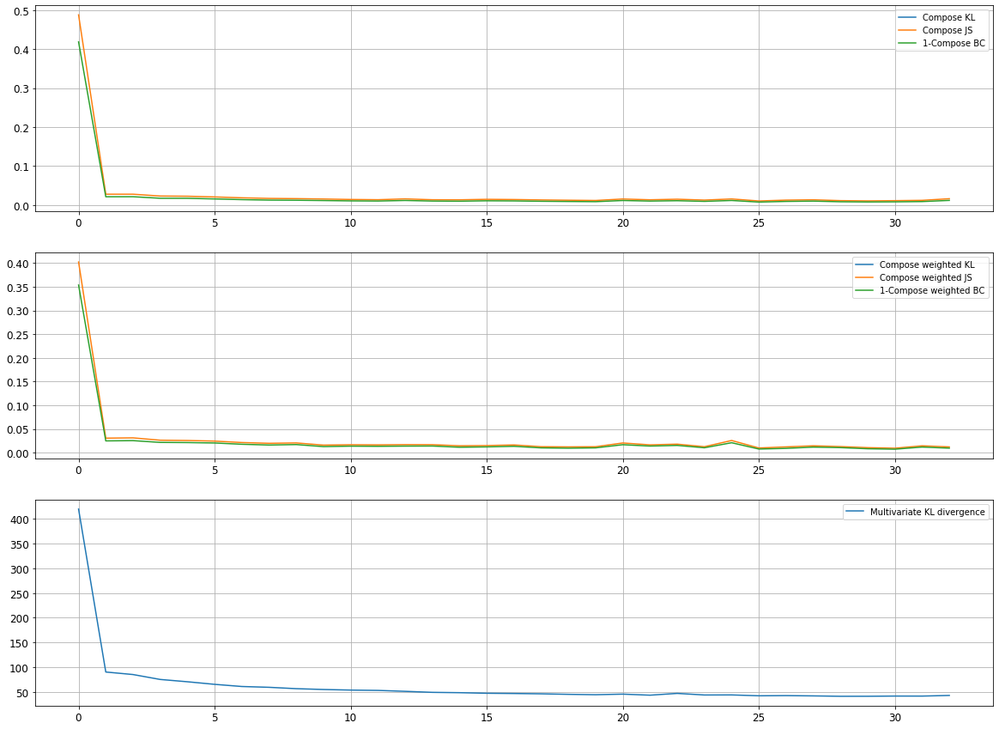

Epoch 6402/10000
discriminator loss: 0.080167 - generator loss: 8.108738 - 28s
Epoch 6403/10000
discriminator loss: 0.032300 - generator loss: 8.820168 - 28s
Epoch 6404/10000
discriminator loss: 0.050225 - generator loss: 8.573557 - 28s
Epoch 6405/10000
discriminator loss: 0.262252 - generator loss: 8.600890 - 28s
Epoch 6406/10000
discriminator loss: 0.091802 - generator loss: 8.001898 - 28s
Epoch 6407/10000
discriminator loss: 0.035544 - generator loss: 8.764805 - 28s
Epoch 6408/10000
discriminator loss: 0.040792 - generator loss: 8.713707 - 28s
Epoch 6409/10000
discriminator loss: 0.240434 - generator loss: 8.826688 - 28s
Epoch 6410/10000
discriminator loss: 0.102846 - generator loss: 7.838473 - 29s
Epoch 6411/10000
discriminator loss: 0.032409 - generator loss: 8.808011 - 29s
Epoch 6412/10000
discriminator loss: 0.045615 - generator loss: 8.726354 - 28s
Epoch 6413/10000
discriminator loss: 0.239559 - generator loss: 8.188814 - 29s
Epoch 6414/10000
discriminator loss: 0.039713 - gene

discriminator loss: 0.285489 - generator loss: 8.171357 - 28s
Epoch 6507/10000
discriminator loss: 0.038046 - generator loss: 8.598717 - 29s
Epoch 6508/10000
discriminator loss: 0.036305 - generator loss: 8.776153 - 29s
Epoch 6509/10000
discriminator loss: 0.040929 - generator loss: 8.707261 - 29s
Epoch 6510/10000
discriminator loss: 0.231049 - generator loss: 8.223774 - 28s
Epoch 6511/10000
discriminator loss: 0.037312 - generator loss: 8.732004 - 28s
Epoch 6512/10000
discriminator loss: 0.238098 - generator loss: 8.283234 - 28s
Epoch 6513/10000
discriminator loss: 0.038195 - generator loss: 8.639217 - 29s
Epoch 6514/10000
discriminator loss: 0.036006 - generator loss: 8.834054 - 28s
Epoch 6515/10000
discriminator loss: 0.066749 - generator loss: 8.559590 - 28s
Epoch 6516/10000
discriminator loss: 0.305963 - generator loss: 8.145700 - 28s
Epoch 6517/10000
discriminator loss: 0.035743 - generator loss: 8.746207 - 28s
Epoch 6518/10000
discriminator loss: 0.033742 - generator loss: 8.856

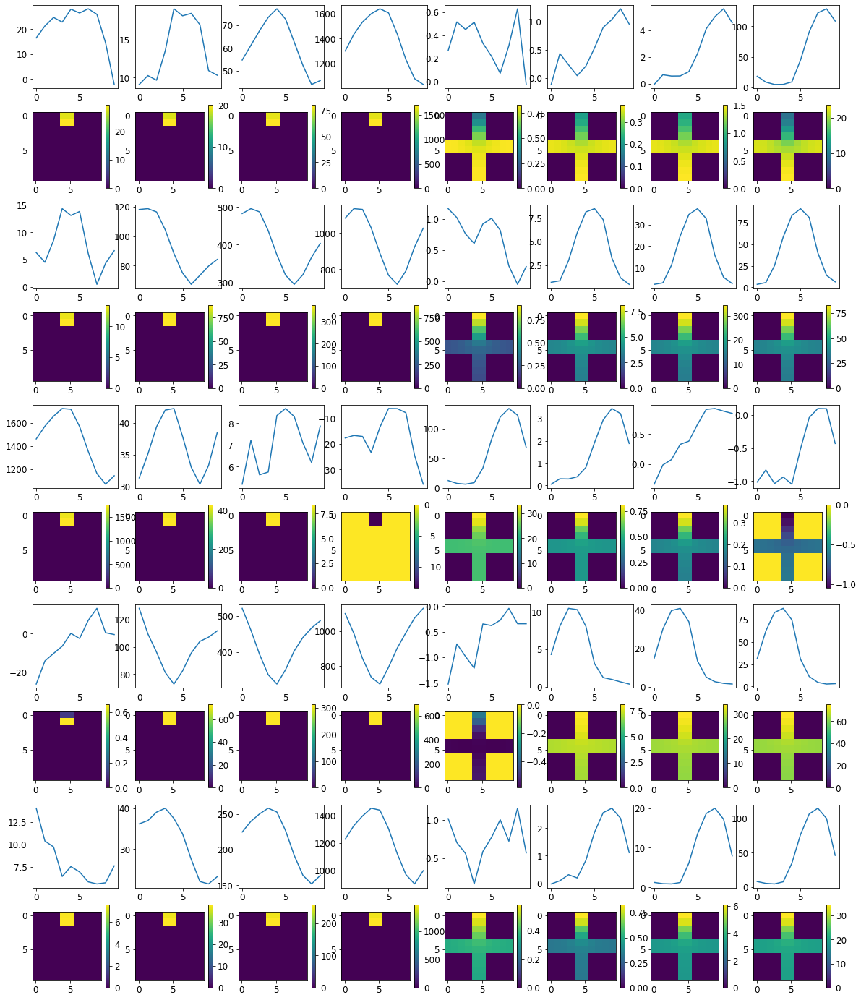


R0 generated:
[[19.539385   17.536846  ]
 [19.551863   17.454254  ]
 [19.567137   17.45886   ]
 [19.564404   17.451332  ]
 [19.565325   17.482212  ]
 [19.556505   17.419552  ]
 [19.576202   17.465294  ]
 [19.577713   17.47585   ]
 [19.549885   17.446316  ]
 [19.553385   17.565838  ]
 [16.951103    0.37766632]
 [17.000956    0.366318  ]
 [17.072695    0.3626118 ]
 [17.051165    0.35029608]
 [17.045238    0.35318768]
 [17.028484    0.3564204 ]
 [17.035997    0.34581962]
 [17.051575    0.3495602 ]
 [17.054806    0.3655378 ]
 [17.051807    0.3776016 ]
 [16.753496    0.66193444]
 [16.896975    0.61570144]
 [16.950878    0.61868286]
 [16.955515    0.63767624]
 [16.946337    0.65078497]
 [16.923862    0.661626  ]
 [16.93873     0.6601805 ]
 [16.908112    0.62986267]
 [16.890541    0.6933538 ]
 [16.946444    0.64909863]
 [19.765604   16.459093  ]
 [19.765783   16.371185  ]
 [19.762554   16.396564  ]
 [19.762648   16.364687  ]
 [19.766176   16.36722   ]
 [19.768923   16.271133  ]
 [19.777218  

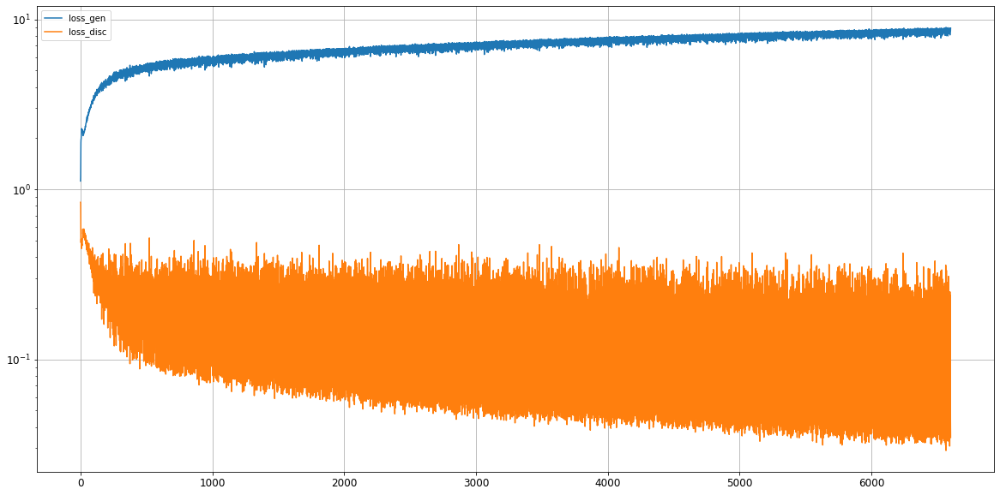

0: mean KL divergence (r,g) = 0.02288046768940242
0: mean JS divergence = 0.006325189406495517
0: mean 1-BC divergence = 0.004920418592693543

0: std KL divergence (r,g) = 0.05517080227877281
0: std JS divergence = 0.012493900764311266
0: std 1-BC divergence = 0.009416808344878236


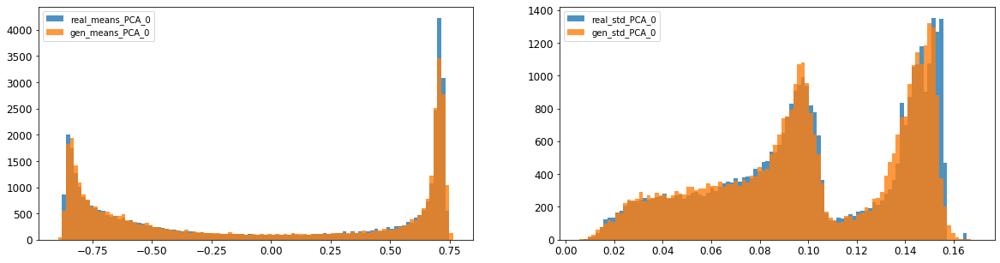

1: mean KL divergence (r,g) = 0.018999783891238527
1: mean JS divergence = 0.004693129358864943
1: mean 1-BC divergence = 0.003260286083726971

1: std KL divergence (r,g) = 0.043011798258728424
1: std JS divergence = 0.009796104307052276
1: std 1-BC divergence = 0.006858650792539667


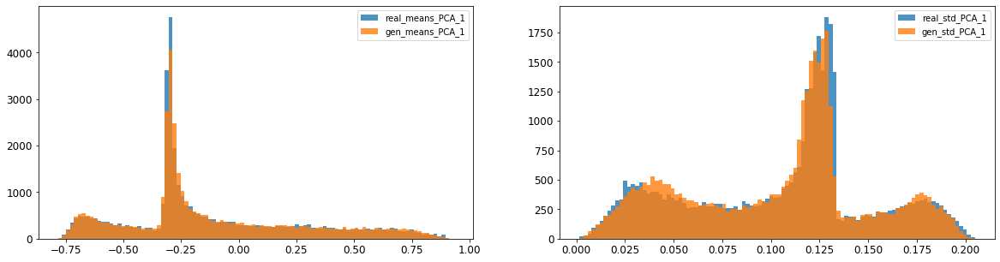

2: mean KL divergence (r,g) = 0.010620477314870291
2: mean JS divergence = 0.0026885246929528508
2: mean 1-BC divergence = 0.00196017720498054

2: std KL divergence (r,g) = 0.03019231227647206
2: std JS divergence = 0.008201909188556851
2: std 1-BC divergence = 0.0070390440331445925


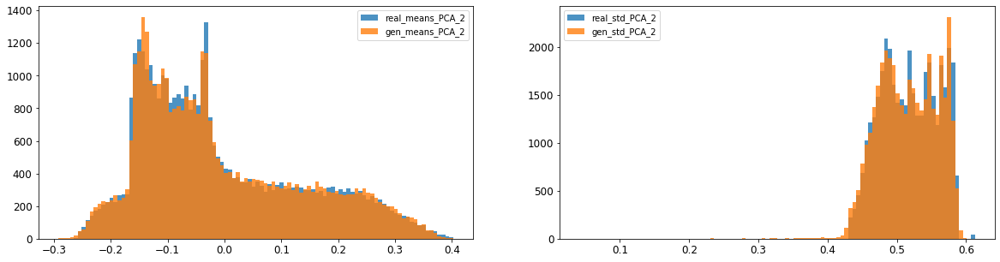

3: mean KL divergence (r,g) = 0.09043576745275811
3: mean JS divergence = 0.024746581390914603
3: mean 1-BC divergence = 0.018041100487078188

3: std KL divergence (r,g) = 0.3930810455811927
3: std JS divergence = 0.07357111904564477
3: std 1-BC divergence = 0.05395476089158269


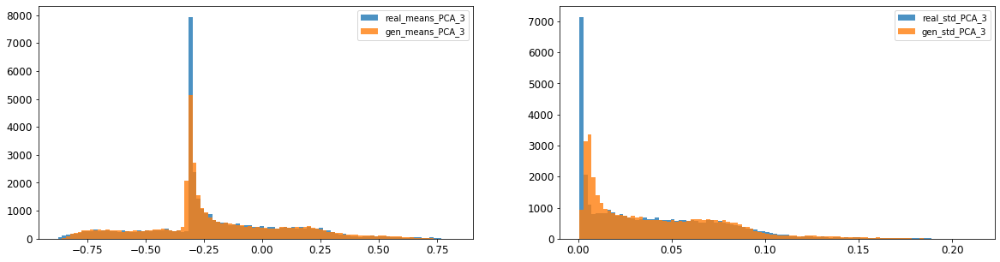

4: mean KL divergence (r,g) = 0.036410051238625375
4: mean JS divergence = 0.009866910693216659
4: mean 1-BC divergence = 0.007442080659744388

4: std KL divergence (r,g) = 0.022550228454324868
4: std JS divergence = 0.005513364193154019
4: std 1-BC divergence = 0.003932704789112895


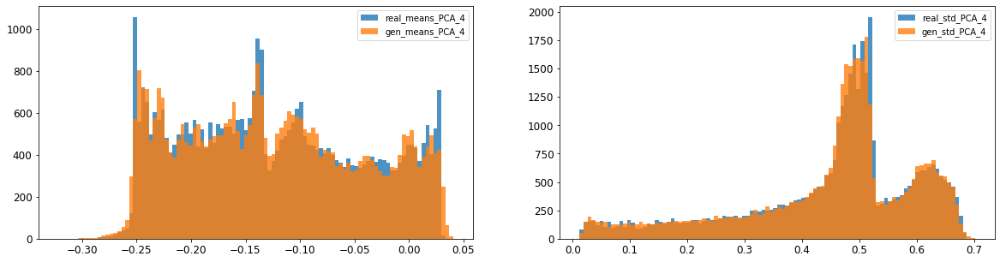

/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.016151566376918353
5: mean 1-BC divergence = 0.012119167508486517

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.010621733334768076
5: std 1-BC divergence = 0.009438430491365835


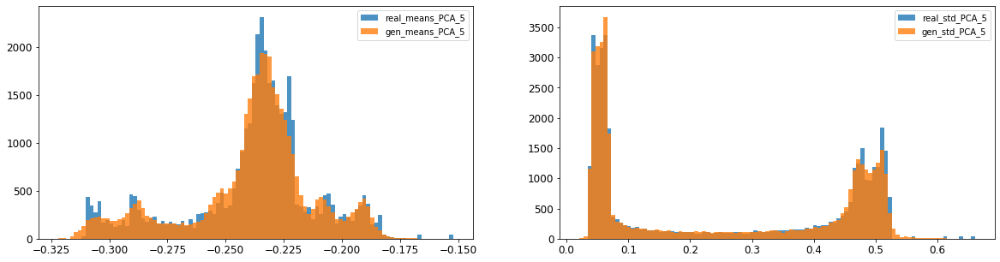

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004835630674836608
6: mean 1-BC divergence = 0.0034754032020377634

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.007433734864910949
6: std 1-BC divergence = 0.005365390252335955


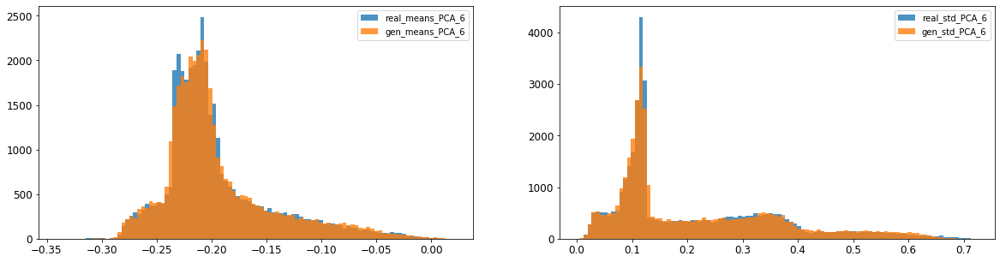

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.022515111390175663
7: mean 1-BC divergence = 0.017575791321333023

7: std KL divergence (r,g) = 0.036655070148245705
7: std JS divergence = 0.00869719404192542
7: std 1-BC divergence = 0.006134633169884163


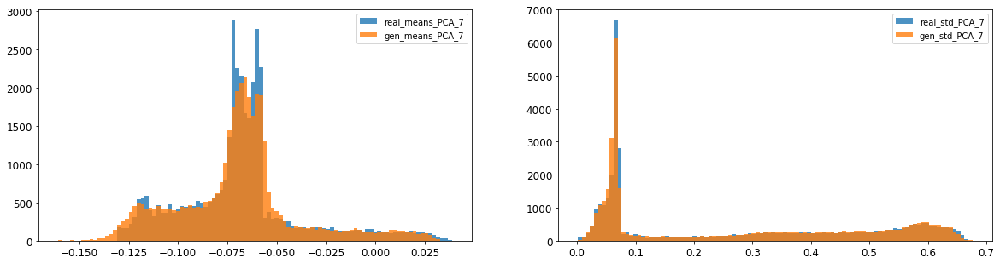

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002105672242901234
8: mean 1-BC divergence = 0.0014895960620053827

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008664623690127386
8: std 1-BC divergence = 0.006126509363608257


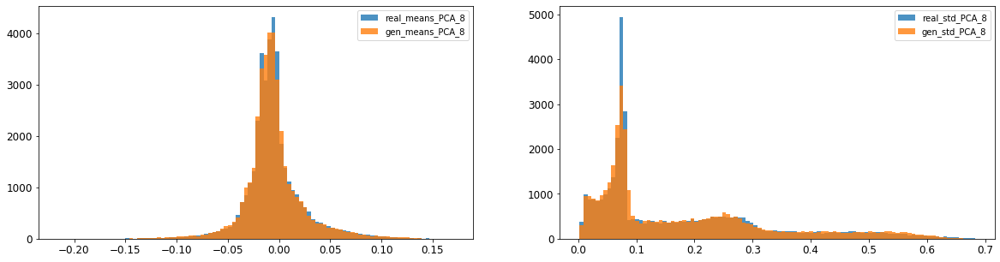

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004515760746564878
9: mean 1-BC divergence = 0.0032376227325451312

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.01067780683242178
9: std 1-BC divergence = 0.0075513886245099915


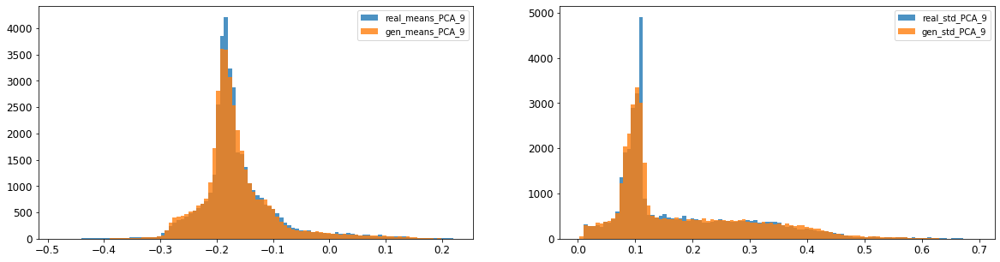

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.004353973317366574
10: mean 1-BC divergence = 0.0031100982719016734

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005537005062227731
10: std 1-BC divergence = 0.004510216178485238


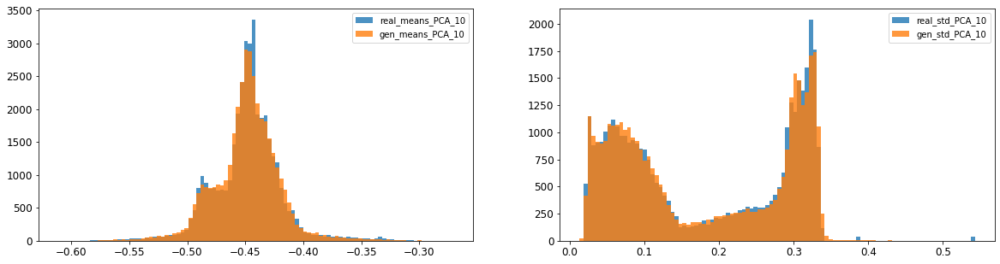

11: mean KL divergence (r,g) = 0.018555475145659816
11: mean JS divergence = 0.004556855770426337
11: mean 1-BC divergence = 0.0032133466569596036

11: std KL divergence (r,g) = 0.03264971556070419
11: std JS divergence = 0.00833212865825304
11: std 1-BC divergence = 0.005895630965222498


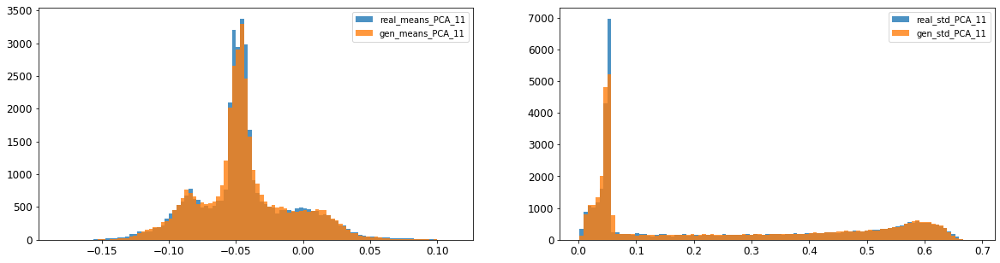

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.0044967249989371445
12: mean 1-BC divergence = 0.0031751866297407005

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.016412739052656278
12: std 1-BC divergence = 0.011607499314242653


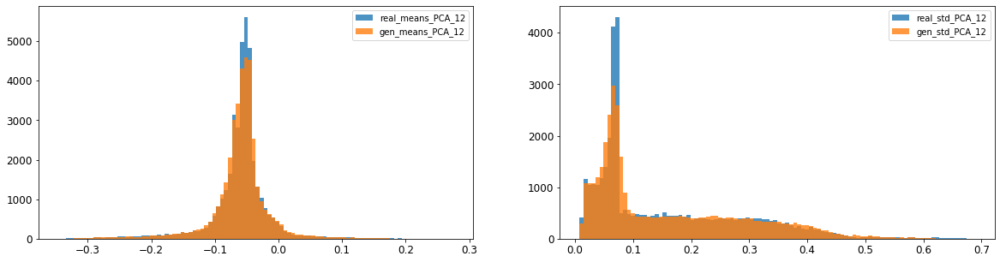

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.015203502115176027
13: mean 1-BC divergence = 0.010706401404777077

13: std KL divergence (r,g) = 0.050242218391862166
13: std JS divergence = 0.012686193558625313
13: std 1-BC divergence = 0.008891313171303206


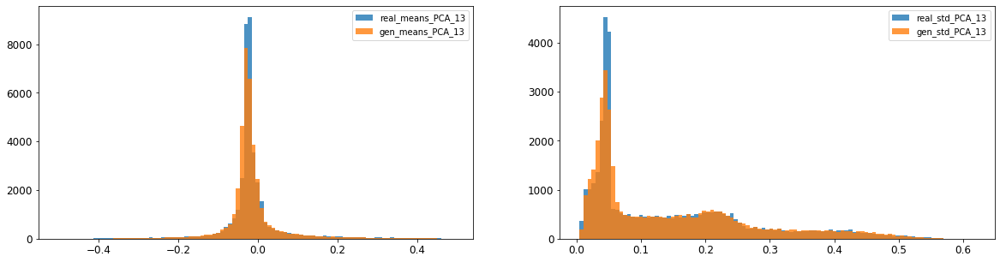

14: mean KL divergence (r,g) = 0.06696712934634354
14: mean JS divergence = 0.016662624857013038
14: mean 1-BC divergence = 0.011693386363714309

14: std KL divergence (r,g) = 0.02908422426927837
14: std JS divergence = 0.00725636344691347
14: std 1-BC divergence = 0.005084554637981853


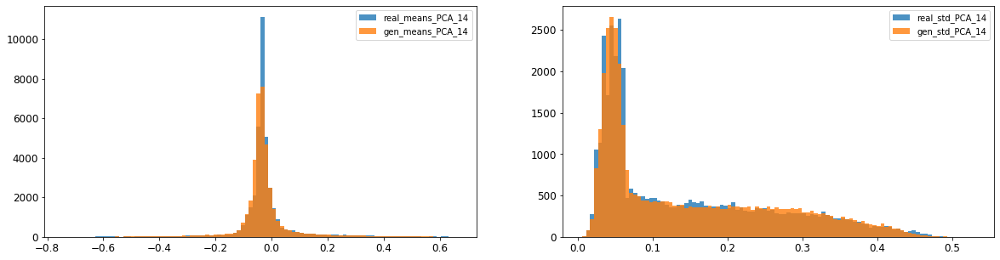

15: mean KL divergence (r,g) = 1.7207811151681345
15: mean JS divergence = 0.46737351535033733
15: mean 1-BC divergence = 0.4282290411648547

15: std KL divergence (r,g) = 6.819692153706649
15: std JS divergence = 0.9634002442826479
15: std 1-BC divergence = 0.9059120404466227


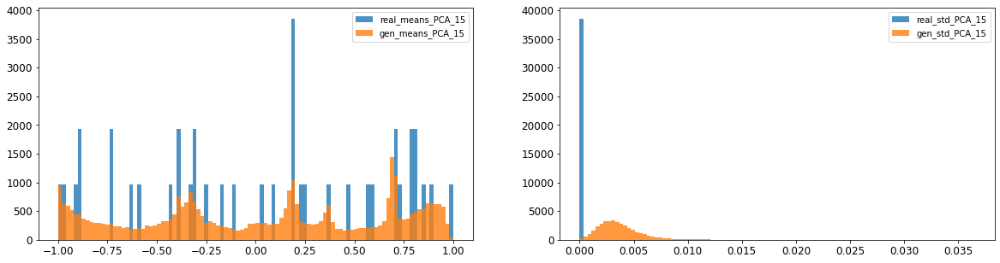

16: mean KL divergence (r,g) = 1.3989224053992177
16: mean JS divergence = 0.39143178246526844
16: mean 1-BC divergence = 0.360205251948543

16: std KL divergence (r,g) = 5.349149563622387
16: std JS divergence = 0.9164735027942201
16: std 1-BC divergence = 0.8433707872701461


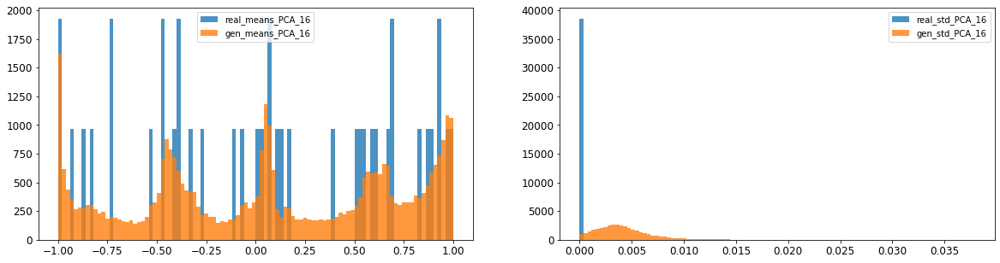



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.011653789269143634
Compose 1-BC divergence = 0.008574253273397336

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.010588860412306058
Compose weighted 1-BC divergence = 0.007926328291722018

Multivariate KL divergence = 40.0899007696565


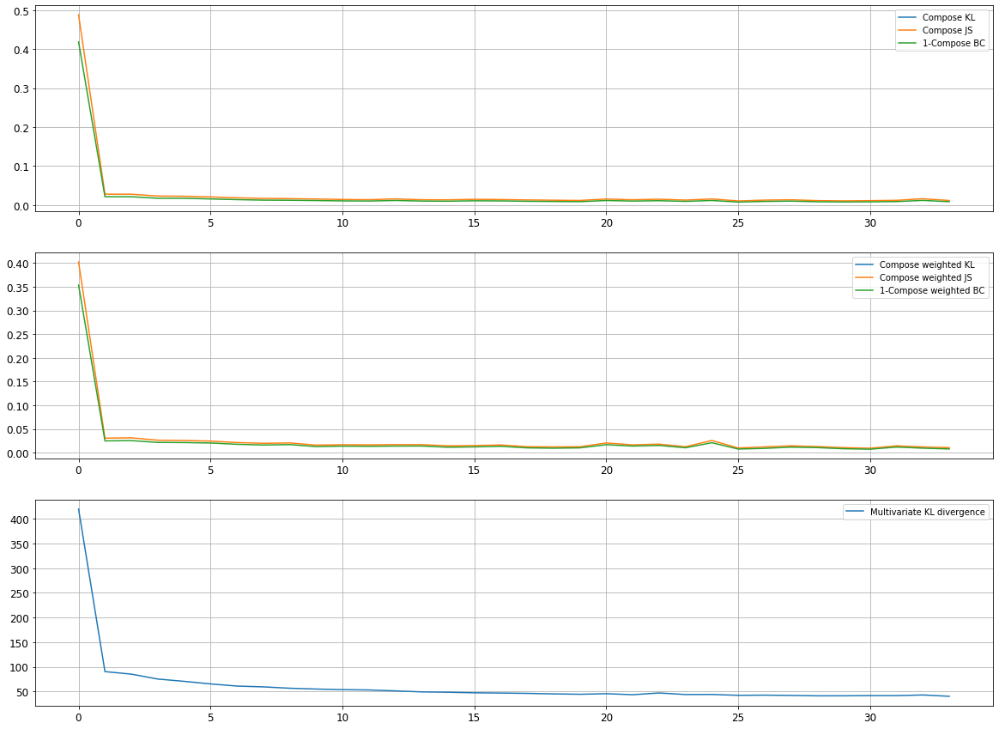

Epoch 6602/10000
discriminator loss: 0.176778 - generator loss: 8.599733 - 28s
Epoch 6603/10000
discriminator loss: 0.122349 - generator loss: 8.198833 - 28s
Epoch 6604/10000
discriminator loss: 0.037201 - generator loss: 8.832142 - 28s
Epoch 6605/10000
discriminator loss: 0.039326 - generator loss: 8.770177 - 29s
Epoch 6606/10000
discriminator loss: 0.211828 - generator loss: 8.807714 - 28s
Epoch 6607/10000
discriminator loss: 0.151898 - generator loss: 7.906547 - 28s
Epoch 6608/10000
discriminator loss: 0.035038 - generator loss: 8.733107 - 29s
Epoch 6609/10000
discriminator loss: 0.043958 - generator loss: 8.744555 - 29s
Epoch 6610/10000
discriminator loss: 0.277025 - generator loss: 8.477049 - 28s
Epoch 6611/10000
discriminator loss: 0.053160 - generator loss: 8.380831 - 29s
Epoch 6612/10000
discriminator loss: 0.034132 - generator loss: 8.837502 - 28s
Epoch 6613/10000
discriminator loss: 0.043107 - generator loss: 8.767390 - 29s
Epoch 6614/10000
discriminator loss: 0.044878 - gene

discriminator loss: 0.038109 - generator loss: 8.813150 - 28s
Epoch 6707/10000
discriminator loss: 0.264156 - generator loss: 8.623440 - 28s
Epoch 6708/10000
discriminator loss: 0.071915 - generator loss: 8.294510 - 28s
Epoch 6709/10000
discriminator loss: 0.036361 - generator loss: 8.829000 - 29s
Epoch 6710/10000
discriminator loss: 0.035573 - generator loss: 8.951054 - 29s
Epoch 6711/10000
discriminator loss: 0.286520 - generator loss: 8.580396 - 29s
Epoch 6712/10000
discriminator loss: 0.059391 - generator loss: 8.346921 - 28s
Epoch 6713/10000
discriminator loss: 0.046241 - generator loss: 8.696439 - 28s
Epoch 6714/10000
discriminator loss: 0.034569 - generator loss: 8.873857 - 28s
Epoch 6715/10000
discriminator loss: 0.043786 - generator loss: 8.838812 - 28s
Epoch 6716/10000
discriminator loss: 0.307768 - generator loss: 8.175750 - 28s
Epoch 6717/10000
discriminator loss: 0.048438 - generator loss: 8.486423 - 28s
Epoch 6718/10000
discriminator loss: 0.035801 - generator loss: 8.880

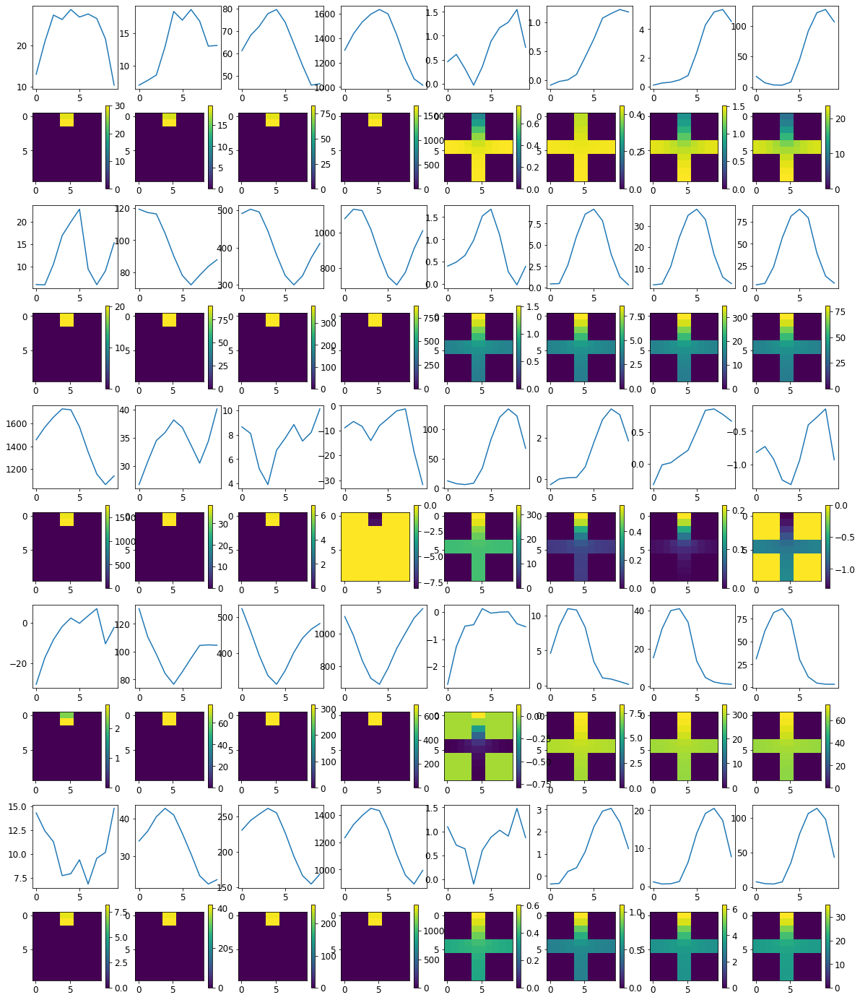


R0 generated:
[[19.588984   17.37552   ]
 [19.593365   17.302042  ]
 [19.596535   17.357641  ]
 [19.59994    17.381481  ]
 [19.5934     17.426708  ]
 [19.588541   17.385223  ]
 [19.606644   17.451471  ]
 [19.603651   17.431273  ]
 [19.586842   17.377354  ]
 [19.599016   17.577288  ]
 [17.008966    0.38574696]
 [16.994215    0.37945354]
 [17.01445     0.37055305]
 [17.023033    0.35987297]
 [17.02371     0.3652474 ]
 [17.047619    0.37036064]
 [17.045725    0.36095577]
 [17.045399    0.3661827 ]
 [17.087288    0.382509  ]
 [17.070639    0.39184445]
 [17.015278    0.7209188 ]
 [17.102322    0.69405174]
 [17.121117    0.6990186 ]
 [17.147572    0.7080573 ]
 [17.13888     0.7120451 ]
 [17.132387    0.7236436 ]
 [17.128325    0.6863845 ]
 [17.123728    0.6610767 ]
 [17.11899     0.69455785]
 [17.193567    0.64438015]
 [19.778837   16.413227  ]
 [19.776712   16.338726  ]
 [19.771276   16.390476  ]
 [19.775381   16.379095  ]
 [19.77581    16.378456  ]
 [19.77973    16.273863  ]
 [19.787773  

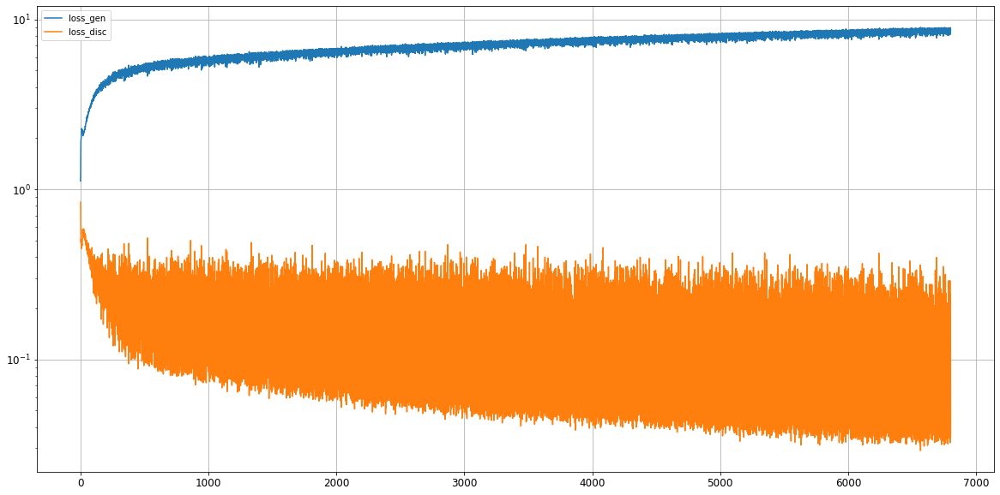

0: mean KL divergence (r,g) = 0.03581075743385609
0: mean JS divergence = 0.00926998475450002
0: mean 1-BC divergence = 0.006817012303170222

0: std KL divergence (r,g) = 0.04882749107114974
0: std JS divergence = 0.014766327409423782
0: std 1-BC divergence = 0.012842346511612757


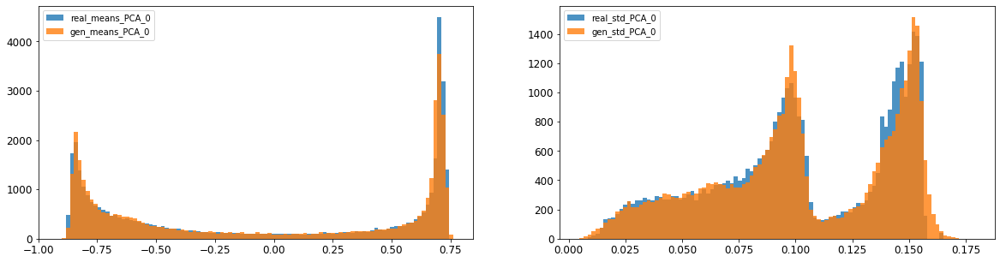

1: mean KL divergence (r,g) = 0.013975504065346164
1: mean JS divergence = 0.0035579367868081484
1: mean 1-BC divergence = 0.00249115751988338

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.008544097199215015
1: std 1-BC divergence = 0.006137476632042671


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


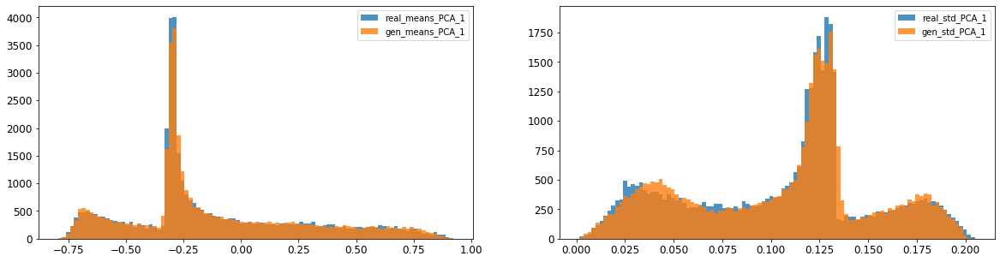

2: mean KL divergence (r,g) = 0.013598293728846009
2: mean JS divergence = 0.003289153567157999
2: mean 1-BC divergence = 0.0023372837851998174

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.01068069695837493
2: std 1-BC divergence = 0.008622188942793652


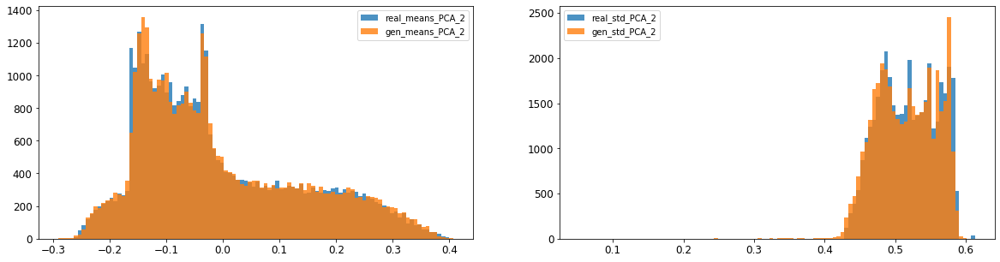

3: mean KL divergence (r,g) = 0.061050336752121605
3: mean JS divergence = 0.014278095281233102
3: mean 1-BC divergence = 0.010020411079229796

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.04677527270080949
3: std 1-BC divergence = 0.03325349775362818


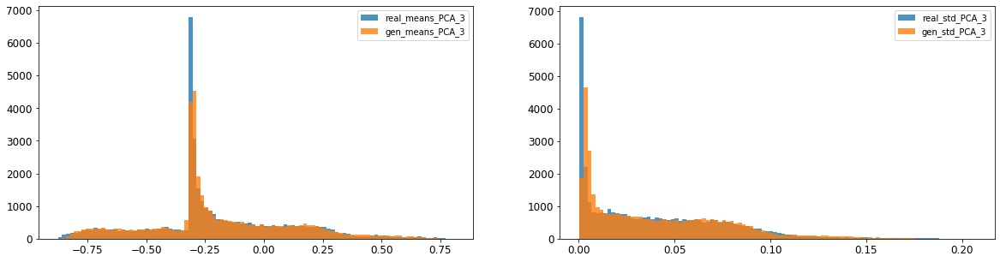

4: mean KL divergence (r,g) = 0.03382943239447557
4: mean JS divergence = 0.008479684459206067
4: mean 1-BC divergence = 0.00631146329835941

4: std KL divergence (r,g) = 0.027083214045605285
4: std JS divergence = 0.006346040197548982
4: std 1-BC divergence = 0.004502590335215717


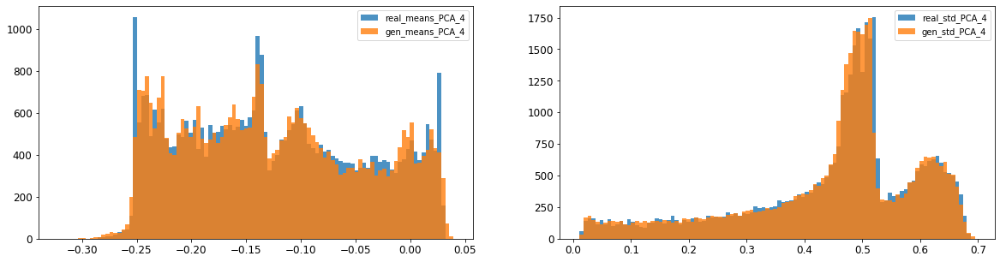

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.015528343174144511
5: mean 1-BC divergence = 0.011490559219078489

5: std KL divergence (r,g) = 0.054904351943240705
5: std JS divergence = 0.01540057416071503
5: std 1-BC divergence = 0.013883692952734394


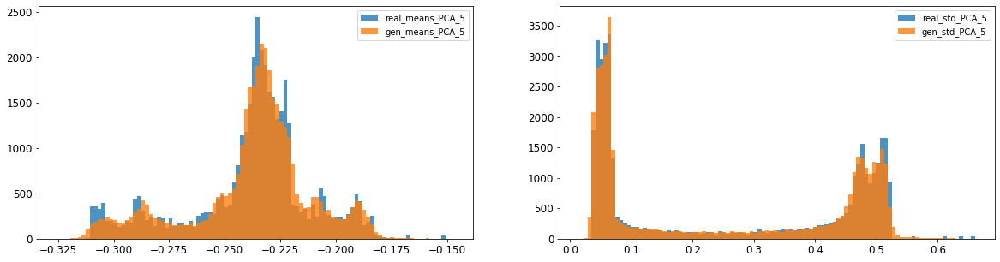

6: mean KL divergence (r,g) = 0.024914086369562848
6: mean JS divergence = 0.006025396420499068
6: mean 1-BC divergence = 0.004279056073544951

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.005447513335718912
6: std 1-BC divergence = 0.0038932848683667087


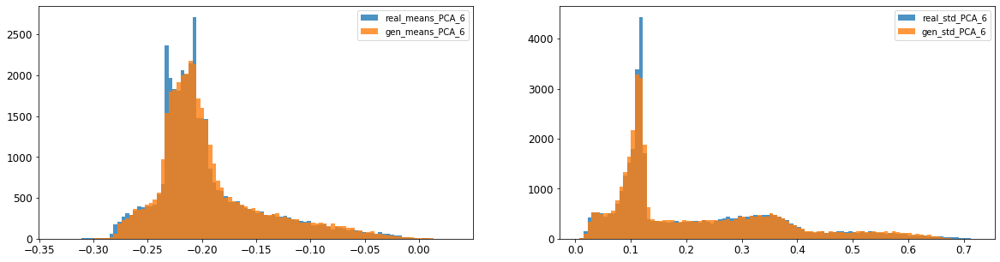

7: mean KL divergence (r,g) = 0.04961186739569249
7: mean JS divergence = 0.012793773157290935
7: mean 1-BC divergence = 0.009467199188153752

7: std KL divergence (r,g) = 0.021792140104472515
7: std JS divergence = 0.005208653274467753
7: std 1-BC divergence = 0.0036859152728460076


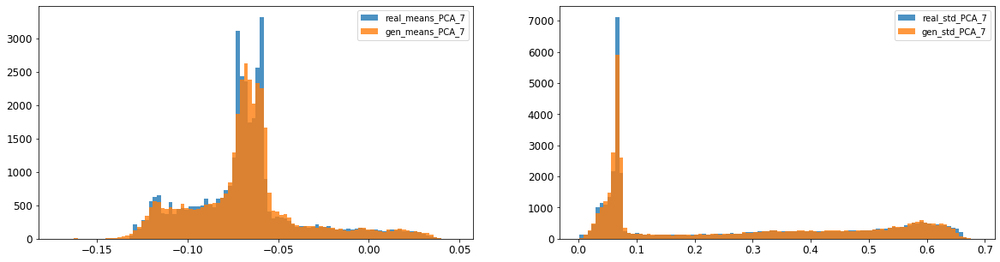

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.004006073979854753
8: mean 1-BC divergence = 0.002813897446371838

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008679835652286451
8: std 1-BC divergence = 0.0061284684884960194


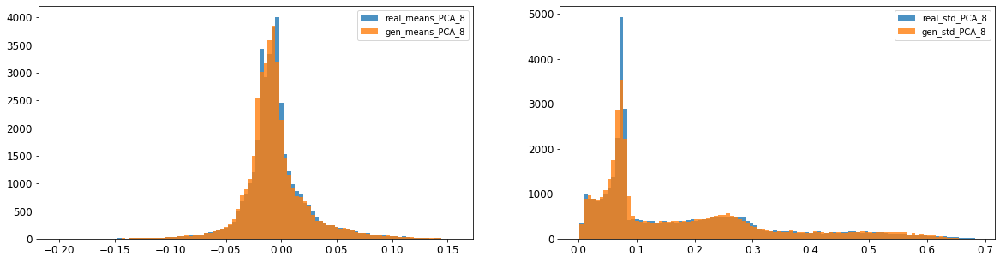

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004544468239564057
9: mean 1-BC divergence = 0.003256118651703499

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.00958273050797574
9: std 1-BC divergence = 0.006755086982708658


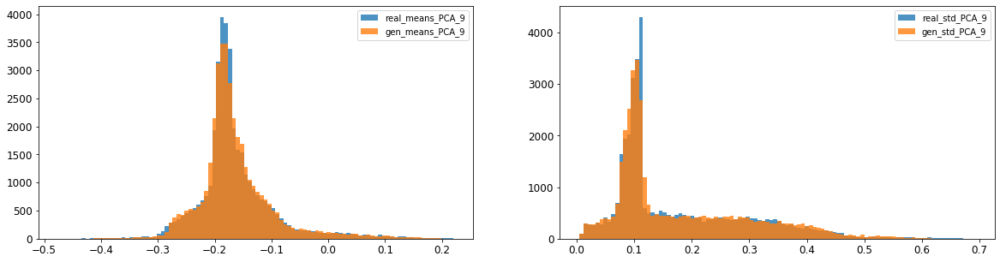

10: mean KL divergence (r,g) = 0.017336248366233768
10: mean JS divergence = 0.004284420623581652
10: mean 1-BC divergence = 0.0030223671243190253

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004390027308543533
10: std 1-BC divergence = 0.0037737280917259364


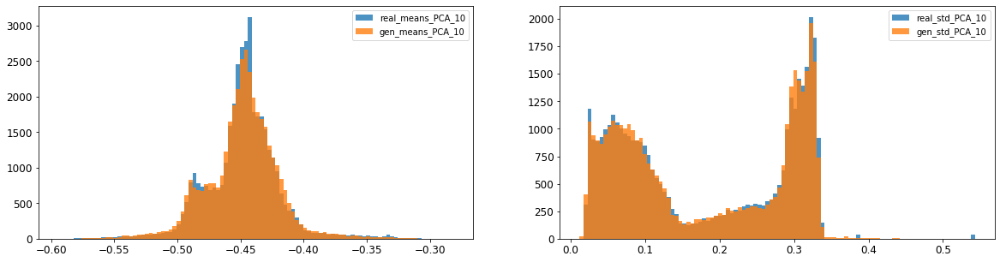

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.01462933202828227
11: mean 1-BC divergence = 0.010248114443960565

11: std KL divergence (r,g) = 0.03881242774782176
11: std JS divergence = 0.010057697244433617
11: std 1-BC divergence = 0.007118345855450903


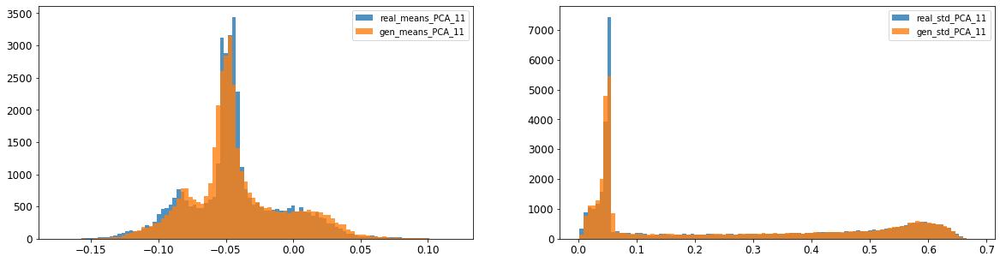

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004032891088923322
12: mean 1-BC divergence = 0.002864353372555195

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01614555201709582
12: std 1-BC divergence = 0.01145520154402202


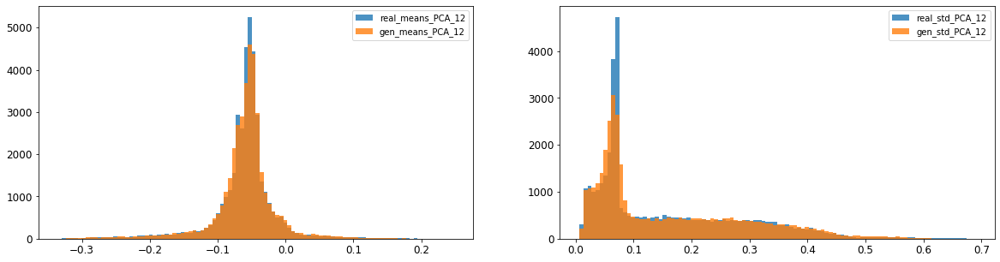

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.018010544062797958
13: mean 1-BC divergence = 0.012610062981364578

13: std KL divergence (r,g) = inf
13: std JS divergence = 0.016688221186853962
13: std 1-BC divergence = 0.011677579720773656


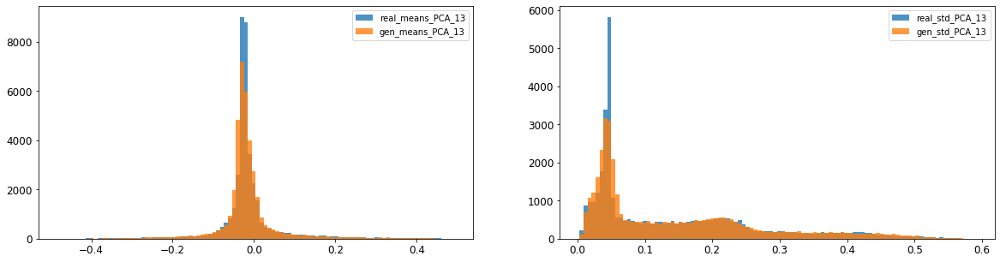

14: mean KL divergence (r,g) = 0.06943432181074291
14: mean JS divergence = 0.017206044113301136
14: mean 1-BC divergence = 0.01206153141697075

14: std KL divergence (r,g) = 0.025037535030811426
14: std JS divergence = 0.00611178572188642
14: std 1-BC divergence = 0.00425833322648228


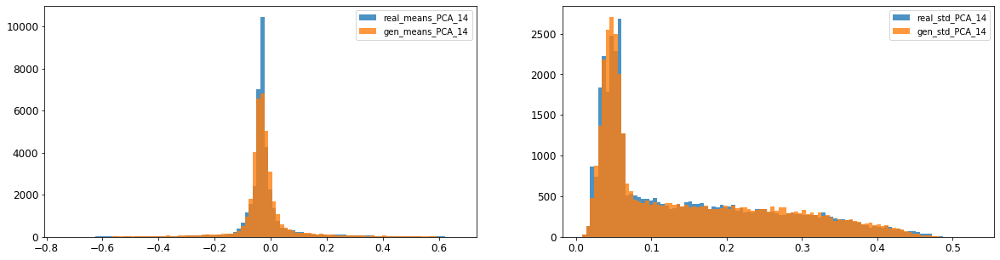

15: mean KL divergence (r,g) = 1.7016607947650266
15: mean JS divergence = 0.46376674255302774
15: mean 1-BC divergence = 0.4245330756422505

15: std KL divergence (r,g) = 7.135287999770295
15: std JS divergence = 0.9694733911281629
15: std 1-BC divergence = 0.9156602824624753


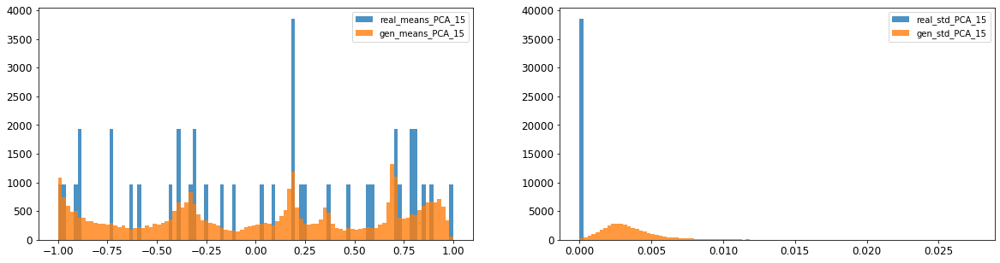

16: mean KL divergence (r,g) = 1.368638578670744
16: mean JS divergence = 0.3878525899124274
16: mean 1-BC divergence = 0.35774465381976717

16: std KL divergence (r,g) = 5.698044706110018
16: std JS divergence = 0.9310919847113774
16: std 1-BC divergence = 0.8612097962225366


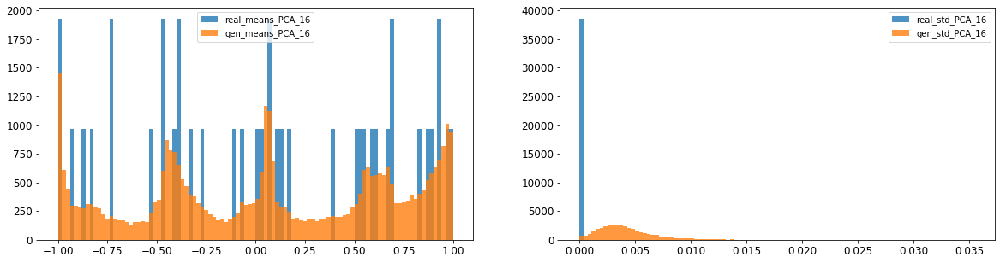



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01082537222041648
Compose 1-BC divergence = 0.007935944169425557

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.010958879120845103
Compose weighted 1-BC divergence = 0.008589231716170764

Multivariate KL divergence = 39.273372140887396


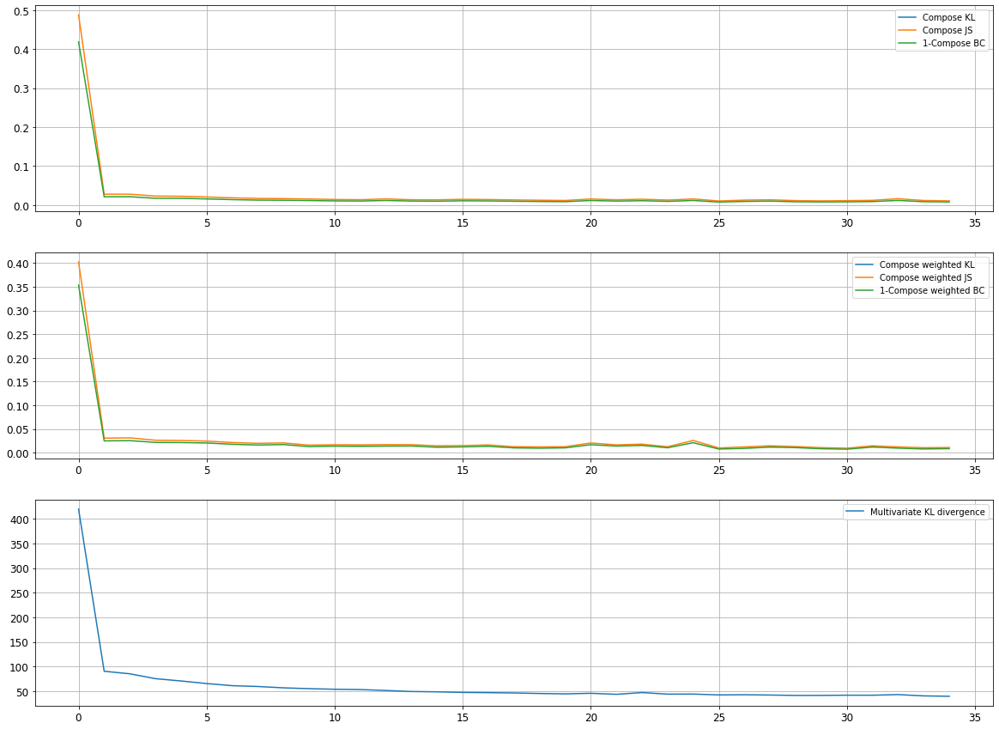

Epoch 6802/10000
discriminator loss: 0.045426 - generator loss: 8.776138 - 27s
Epoch 6803/10000
discriminator loss: 0.281513 - generator loss: 8.006811 - 28s
Epoch 6804/10000
discriminator loss: 0.038139 - generator loss: 8.539302 - 28s
Epoch 6805/10000
discriminator loss: 0.032597 - generator loss: 8.927508 - 28s
Epoch 6806/10000
discriminator loss: 0.041036 - generator loss: 8.925123 - 29s
Epoch 6807/10000
discriminator loss: 0.236116 - generator loss: 8.218724 - 28s
Epoch 6808/10000
discriminator loss: 0.037538 - generator loss: 8.757527 - 29s
Epoch 6809/10000
discriminator loss: 0.165649 - generator loss: 8.471180 - 28s
Epoch 6810/10000
discriminator loss: 0.034979 - generator loss: 8.948174 - 29s
Epoch 6811/10000
discriminator loss: 0.030467 - generator loss: 8.976496 - 28s
Epoch 6812/10000
discriminator loss: 0.301037 - generator loss: 8.716588 - 28s
Epoch 6813/10000
discriminator loss: 0.074533 - generator loss: 8.308184 - 29s
Epoch 6814/10000
discriminator loss: 0.036512 - gene

discriminator loss: 0.060110 - generator loss: 8.391394 - 28s
Epoch 6907/10000
discriminator loss: 0.035604 - generator loss: 8.938848 - 28s
Epoch 6908/10000
discriminator loss: 0.032860 - generator loss: 8.990726 - 29s
Epoch 6909/10000
discriminator loss: 0.211593 - generator loss: 8.330779 - 29s
Epoch 6910/10000
discriminator loss: 0.039389 - generator loss: 8.812627 - 28s
Epoch 6911/10000
discriminator loss: 0.032787 - generator loss: 8.985035 - 28s
Epoch 6912/10000
discriminator loss: 0.221929 - generator loss: 8.260037 - 29s
Epoch 6913/10000
discriminator loss: 0.032634 - generator loss: 8.904738 - 29s
Epoch 6914/10000
discriminator loss: 0.206380 - generator loss: 8.313984 - 28s
Epoch 6915/10000
discriminator loss: 0.033117 - generator loss: 8.927471 - 29s
Epoch 6916/10000
discriminator loss: 0.048982 - generator loss: 8.802965 - 28s
Epoch 6917/10000
discriminator loss: 0.255921 - generator loss: 8.502251 - 28s
Epoch 6918/10000
discriminator loss: 0.041841 - generator loss: 8.617

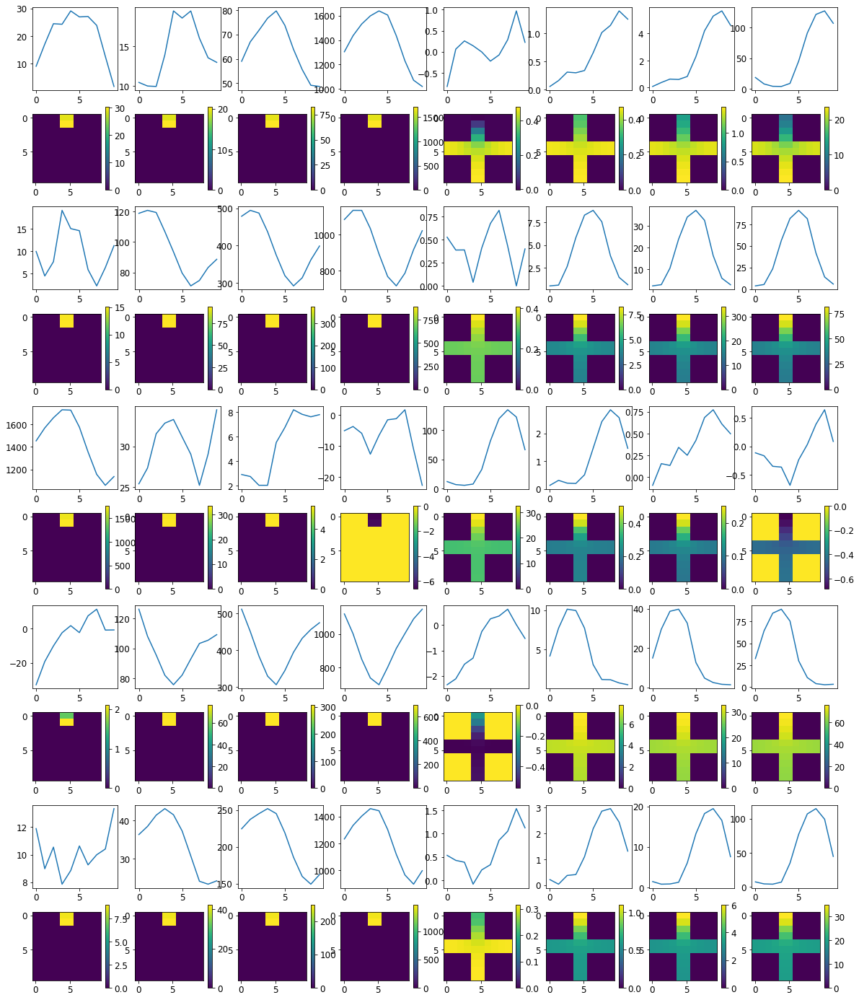


R0 generated:
[[19.433533   17.70733   ]
 [19.44656    17.629953  ]
 [19.465857   17.673285  ]
 [19.467606   17.631792  ]
 [19.460161   17.678282  ]
 [19.456858   17.639206  ]
 [19.48474    17.733059  ]
 [19.489742   17.712109  ]
 [19.46762    17.720606  ]
 [19.489805   17.796595  ]
 [17.074987    0.32575446]
 [17.084562    0.31179383]
 [17.095541    0.30395868]
 [17.089622    0.29739296]
 [17.058214    0.29956853]
 [17.067438    0.30024377]
 [17.053938    0.2932588 ]
 [17.044277    0.2917841 ]
 [17.053394    0.29400516]
 [17.089588    0.30274817]
 [16.838106    0.63203883]
 [16.957926    0.58639884]
 [16.979538    0.59282637]
 [16.987812    0.6040202 ]
 [16.94136     0.5946468 ]
 [16.933432    0.6096127 ]
 [16.948544    0.59014237]
 [16.942299    0.55805135]
 [16.93919     0.60159916]
 [16.97013     0.55665946]
 [19.72311    16.565971  ]
 [19.72524    16.527231  ]
 [19.724375   16.580667  ]
 [19.726645   16.530933  ]
 [19.724865   16.555016  ]
 [19.729218   16.467926  ]
 [19.73732   

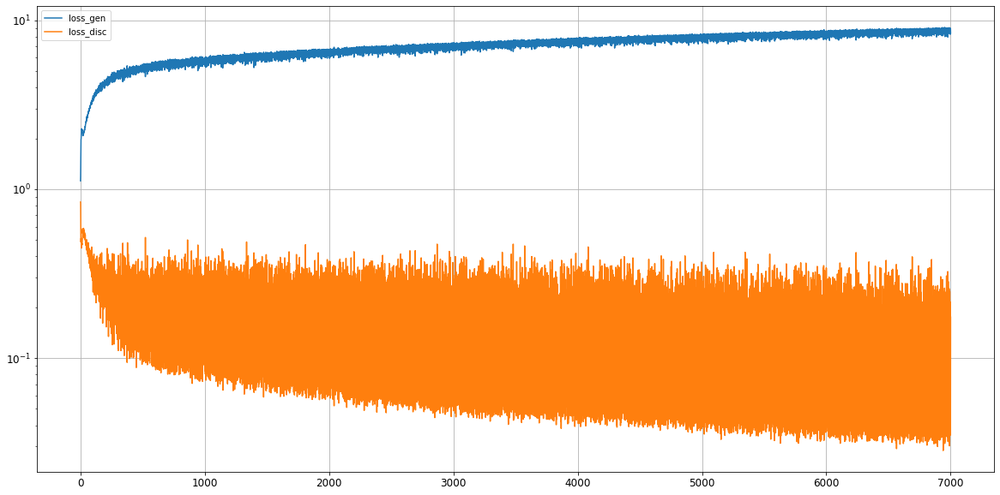

0: mean KL divergence (r,g) = 0.025664674069648206
0: mean JS divergence = 0.0068036471570083416
0: mean 1-BC divergence = 0.005176143516456788

0: std KL divergence (r,g) = 0.04292967037008245
0: std JS divergence = 0.012351678979251126
0: std 1-BC divergence = 0.010622827624282016


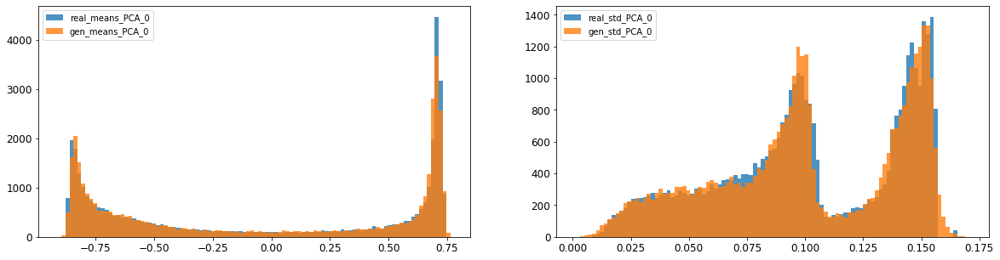

1: mean KL divergence (r,g) = 0.0210091660307275
1: mean JS divergence = 0.005300013063785665
1: mean 1-BC divergence = 0.003722483678811228

1: std KL divergence (r,g) = 0.022643606760739916
1: std JS divergence = 0.005803449399456799
1: std 1-BC divergence = 0.004078032460705372


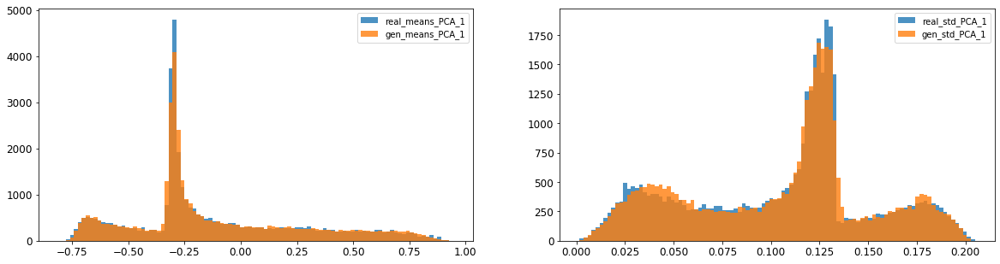

/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


2: mean KL divergence (r,g) = inf
2: mean JS divergence = 0.0029950313296535844
2: mean 1-BC divergence = 0.0021940622281493294

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.009691526245664262
2: std 1-BC divergence = 0.007438514884715586


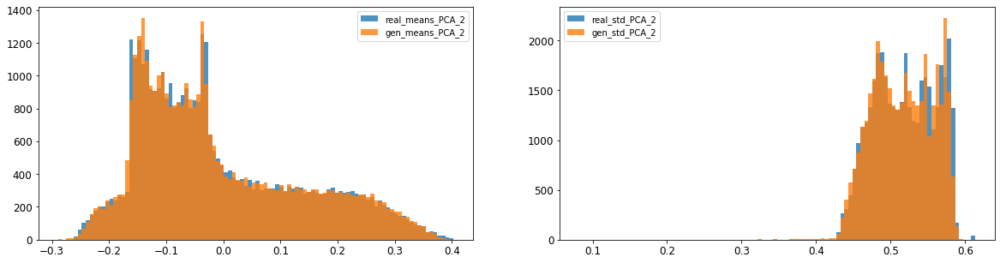

3: mean KL divergence (r,g) = 0.06932357611537134
3: mean JS divergence = 0.016638958676210222
3: mean 1-BC divergence = 0.011711838901367844

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.061013925160055354
3: std 1-BC divergence = 0.044023546902158706


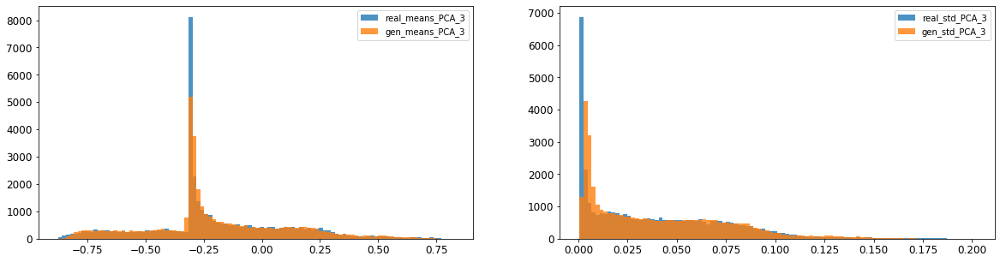

4: mean KL divergence (r,g) = 0.03825370140119095
4: mean JS divergence = 0.011031369460832038
4: mean 1-BC divergence = 0.008771994740337186

4: std KL divergence (r,g) = 0.019296322243846607
4: std JS divergence = 0.00471124777972979
4: std 1-BC divergence = 0.003376349315193705


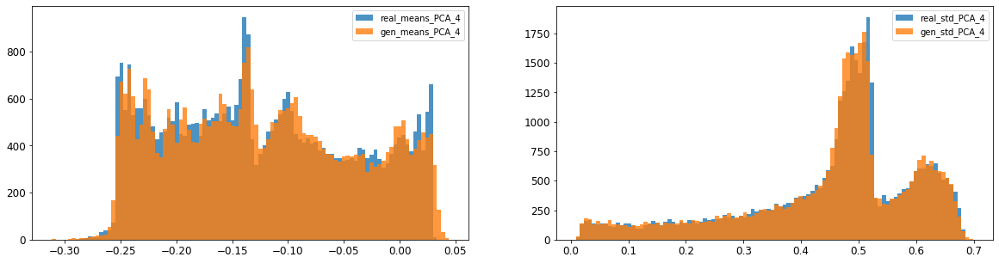

5: mean KL divergence (r,g) = 0.057318438599373404
5: mean JS divergence = 0.013948856228938142
5: mean 1-BC divergence = 0.010454575600201799

5: std KL divergence (r,g) = 0.05916997164873171
5: std JS divergence = 0.015641905274982104
5: std 1-BC divergence = 0.013156388895819049


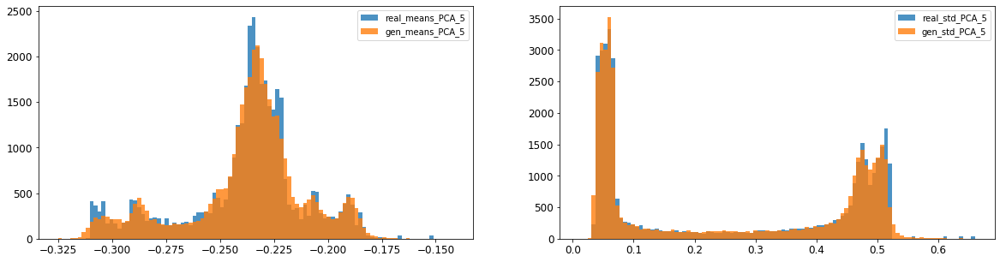

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004250747139351474
6: mean 1-BC divergence = 0.0030013225655637354

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.00788778007131256
6: std 1-BC divergence = 0.005656172640688961


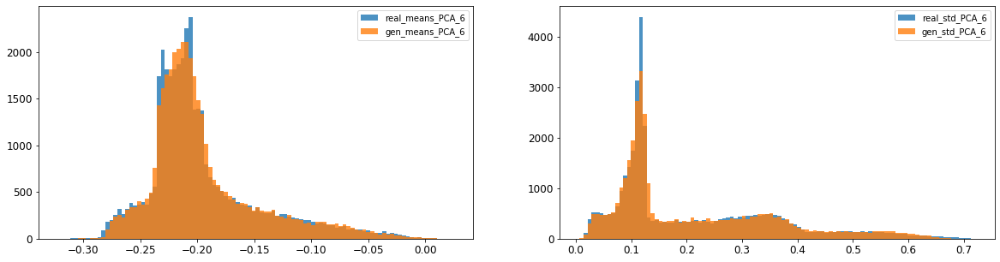

7: mean KL divergence (r,g) = 0.03890438651273329
7: mean JS divergence = 0.010299121771082494
7: mean 1-BC divergence = 0.0077463527376896435

7: std KL divergence (r,g) = 0.02321750207565265
7: std JS divergence = 0.005785117103228729
7: std 1-BC divergence = 0.004050332648217081


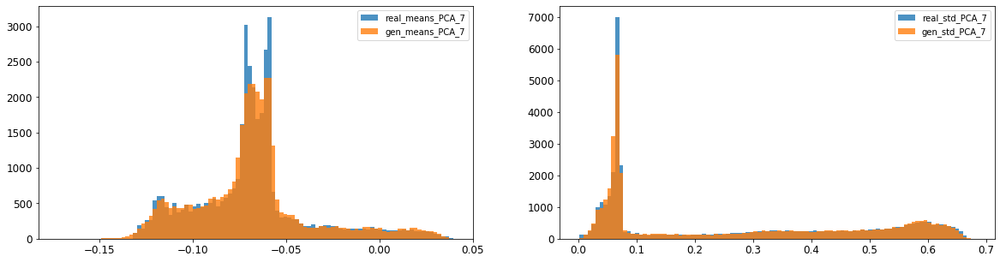

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.004409480400683769
8: mean 1-BC divergence = 0.0031326241795628373

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008979459847752889
8: std 1-BC divergence = 0.006412175813565457


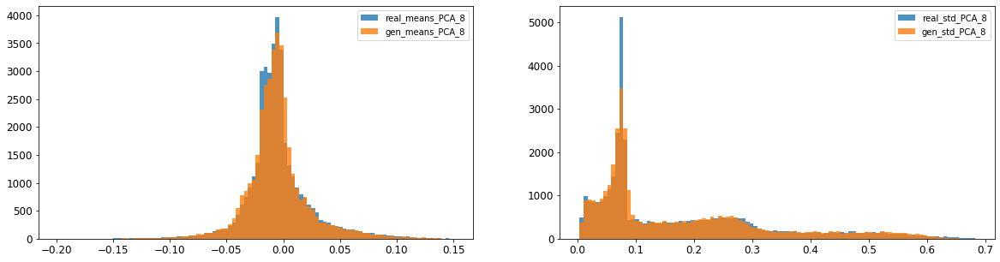

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004594210681632318
9: mean 1-BC divergence = 0.0033025087952816

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010396092606243891
9: std 1-BC divergence = 0.007358099035517651


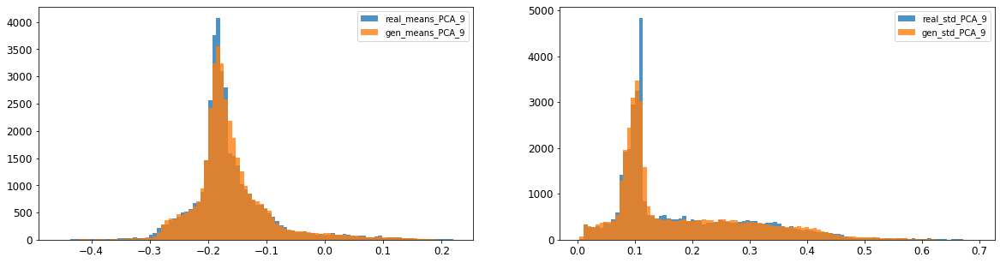

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.005147245550118859
10: mean 1-BC divergence = 0.003674742545149323

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.0052288899397567095
10: std 1-BC divergence = 0.004439225617429932


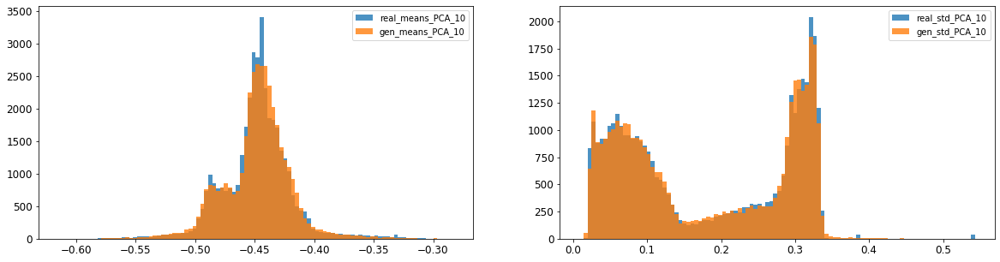

11: mean KL divergence (r,g) = 0.030290225182841184
11: mean JS divergence = 0.00762266762350906
11: mean 1-BC divergence = 0.005342847512303517

11: std KL divergence (r,g) = 0.025619841056868806
11: std JS divergence = 0.006382817860810387
11: std 1-BC divergence = 0.004489430806553729


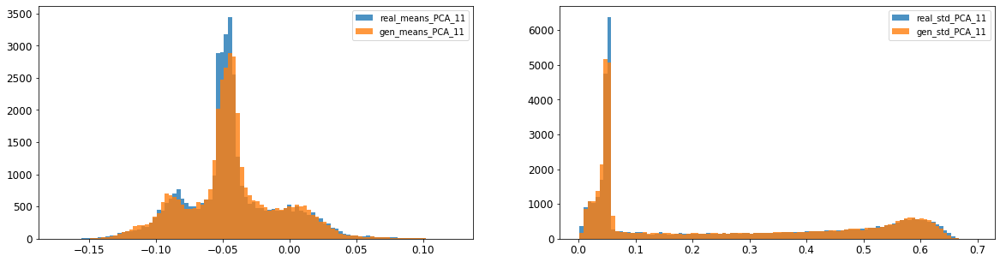

12: mean KL divergence (r,g) = 0.01428036101842542
12: mean JS divergence = 0.0036436070878230918
12: mean 1-BC divergence = 0.0025663710796723915

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.014807815304405194
12: std 1-BC divergence = 0.010499202194037882


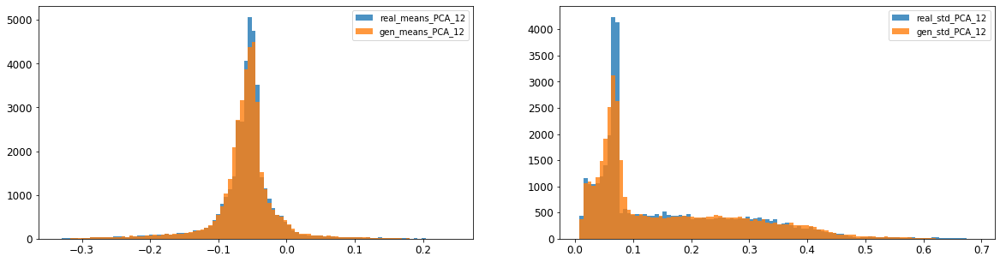

13: mean KL divergence (r,g) = 0.05414559530056193
13: mean JS divergence = 0.013301498641156179
13: mean 1-BC divergence = 0.00927324002642027

13: std KL divergence (r,g) = 0.0558366709279053
13: std JS divergence = 0.013828063798320182
13: std 1-BC divergence = 0.00968598361154882


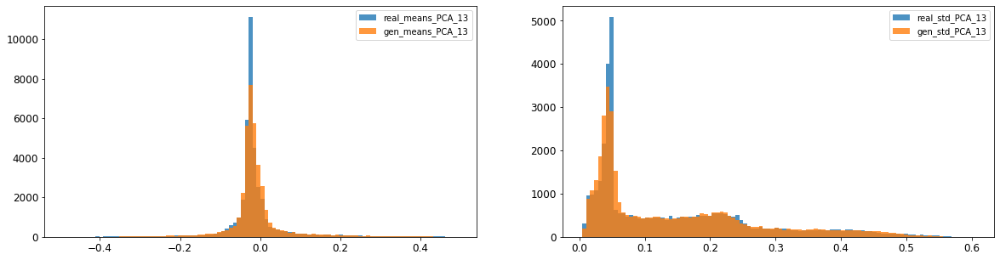

14: mean KL divergence (r,g) = 0.06759017527307755
14: mean JS divergence = 0.0169387431836624
14: mean 1-BC divergence = 0.011832693807239392

14: std KL divergence (r,g) = 0.02960944297792919
14: std JS divergence = 0.007365572461548939
14: std 1-BC divergence = 0.005132013718920692


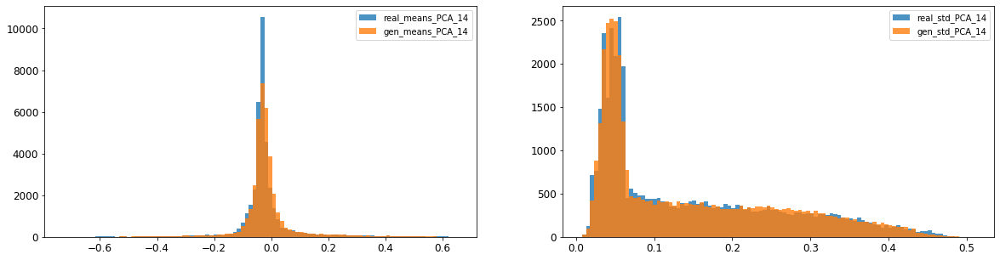

15: mean KL divergence (r,g) = 1.74204427618504
15: mean JS divergence = 0.4699009784143013
15: mean 1-BC divergence = 0.4303037075353211

15: std KL divergence (r,g) = 7.279123772343946
15: std JS divergence = 0.9719086142149196
15: std 1-BC divergence = 0.919761518491129


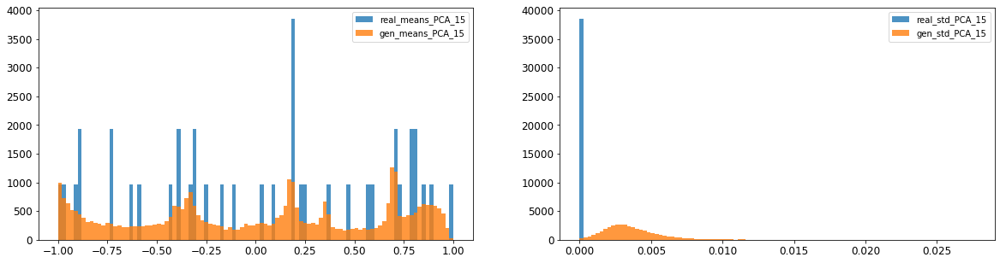

16: mean KL divergence (r,g) = 1.366715366590123
16: mean JS divergence = 0.38636310608577185
16: mean 1-BC divergence = 0.35619740932499855

16: std KL divergence (r,g) = 5.534615415960477
16: std JS divergence = 0.9245718480547092
16: std 1-BC divergence = 0.8531217894895862


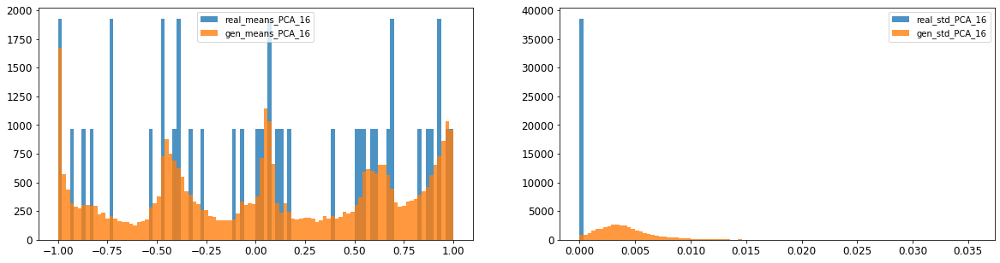



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010560017994265553
Compose 1-BC divergence = 0.007744069936118647

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.009841989823327254
Compose weighted 1-BC divergence = 0.007680111644919441

Multivariate KL divergence = 38.34752359790072


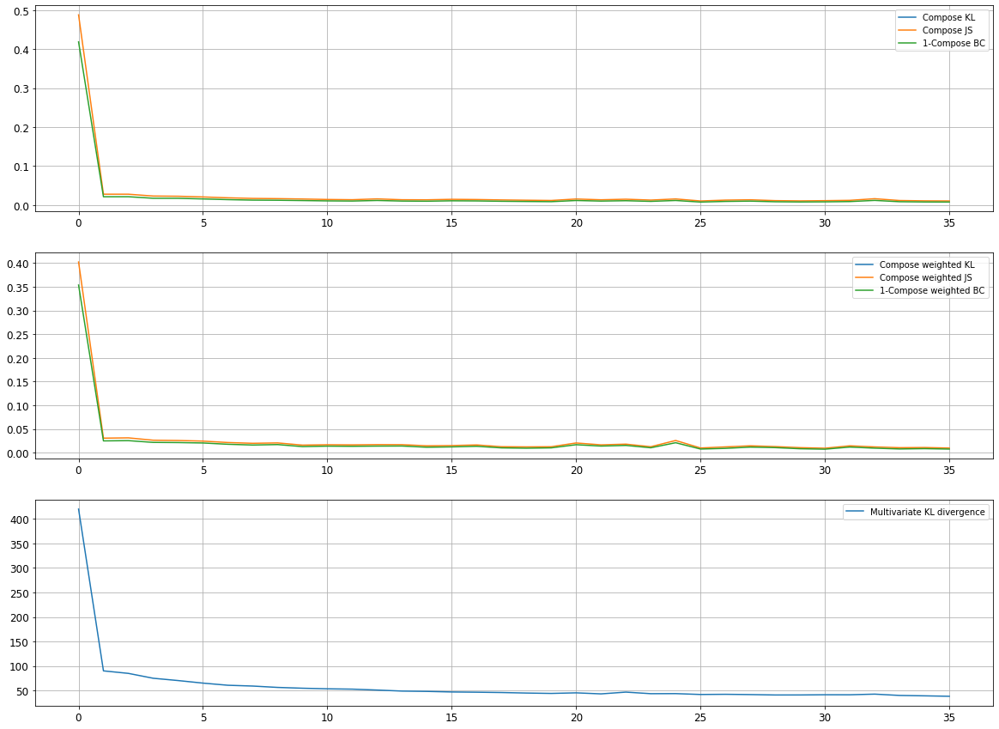

Epoch 7002/10000
discriminator loss: 0.032365 - generator loss: 9.013868 - 28s
Epoch 7003/10000
discriminator loss: 0.036329 - generator loss: 9.000308 - 28s
Epoch 7004/10000
discriminator loss: 0.261667 - generator loss: 8.322611 - 28s
Epoch 7005/10000
discriminator loss: 0.034283 - generator loss: 8.979290 - 28s
Epoch 7006/10000
discriminator loss: 0.136826 - generator loss: 8.480381 - 29s
Epoch 7007/10000
discriminator loss: 0.171506 - generator loss: 8.313917 - 29s
Epoch 7008/10000
discriminator loss: 0.033985 - generator loss: 8.968243 - 29s
Epoch 7009/10000
discriminator loss: 0.033837 - generator loss: 8.995013 - 29s
Epoch 7010/10000
discriminator loss: 0.035972 - generator loss: 8.924179 - 28s
Epoch 7011/10000
discriminator loss: 0.321913 - generator loss: 8.223448 - 29s
Epoch 7012/10000
discriminator loss: 0.033391 - generator loss: 8.928746 - 29s
Epoch 7013/10000
discriminator loss: 0.034908 - generator loss: 9.012272 - 29s
Epoch 7014/10000
discriminator loss: 0.238071 - gene

discriminator loss: 0.037698 - generator loss: 8.741795 - 28s
Epoch 7107/10000
discriminator loss: 0.030293 - generator loss: 9.059022 - 28s
Epoch 7108/10000
discriminator loss: 0.236729 - generator loss: 8.462378 - 28s
Epoch 7109/10000
discriminator loss: 0.040080 - generator loss: 8.788632 - 28s
Epoch 7110/10000
discriminator loss: 0.032742 - generator loss: 9.133450 - 28s
Epoch 7111/10000
discriminator loss: 0.077431 - generator loss: 8.832528 - 28s
Epoch 7112/10000
discriminator loss: 0.217005 - generator loss: 8.338831 - 28s
Epoch 7113/10000
discriminator loss: 0.031685 - generator loss: 9.039427 - 28s
Epoch 7114/10000
discriminator loss: 0.042165 - generator loss: 8.890997 - 29s
Epoch 7115/10000
discriminator loss: 0.299459 - generator loss: 8.917907 - 28s
Epoch 7116/10000
discriminator loss: 0.058837 - generator loss: 8.325415 - 28s
Epoch 7117/10000
discriminator loss: 0.033113 - generator loss: 8.936684 - 28s
Epoch 7118/10000
discriminator loss: 0.032022 - generator loss: 9.011

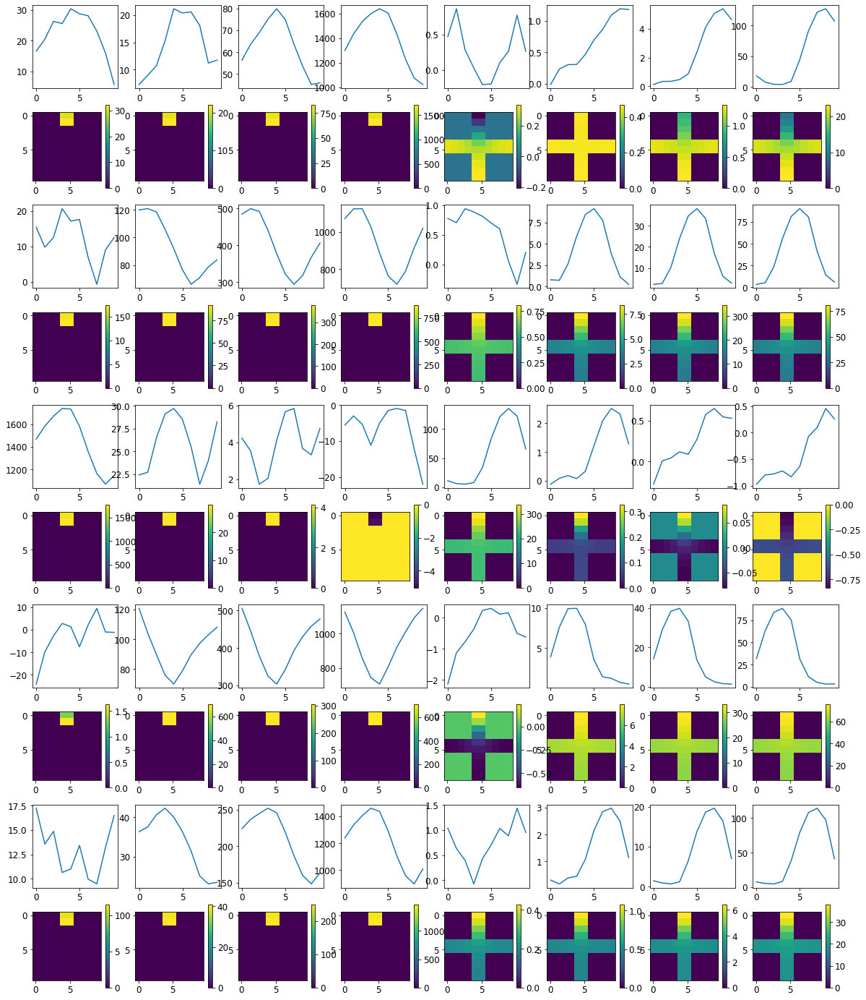


R0 generated:
[[19.397566   18.219368  ]
 [19.410149   18.189705  ]
 [19.416489   18.175833  ]
 [19.425678   18.137444  ]
 [19.41831    18.155525  ]
 [19.4072     18.114046  ]
 [19.431637   18.135351  ]
 [19.429518   18.149096  ]
 [19.399855   18.14266   ]
 [19.419132   18.311567  ]
 [16.987019    0.36981076]
 [16.993076    0.36185607]
 [17.037056    0.3582671 ]
 [17.046204    0.3491019 ]
 [17.045738    0.3536909 ]
 [17.070211    0.35740352]
 [17.08147     0.3459193 ]
 [17.084007    0.3496267 ]
 [17.092457    0.35124537]
 [17.090984    0.36383048]
 [16.892456    0.76960605]
 [17.000044    0.74091685]
 [17.046158    0.7465315 ]
 [17.08493     0.7696078 ]
 [17.055723    0.78385764]
 [17.034647    0.7989629 ]
 [17.03529     0.8055718 ]
 [17.012812    0.7807048 ]
 [17.038013    0.8183726 ]
 [17.013237    0.7567976 ]
 [19.718071   16.869122  ]
 [19.716974   16.822004  ]
 [19.711397   16.827414  ]
 [19.717201   16.834332  ]
 [19.716825   16.867893  ]
 [19.722725   16.806196  ]
 [19.733086  

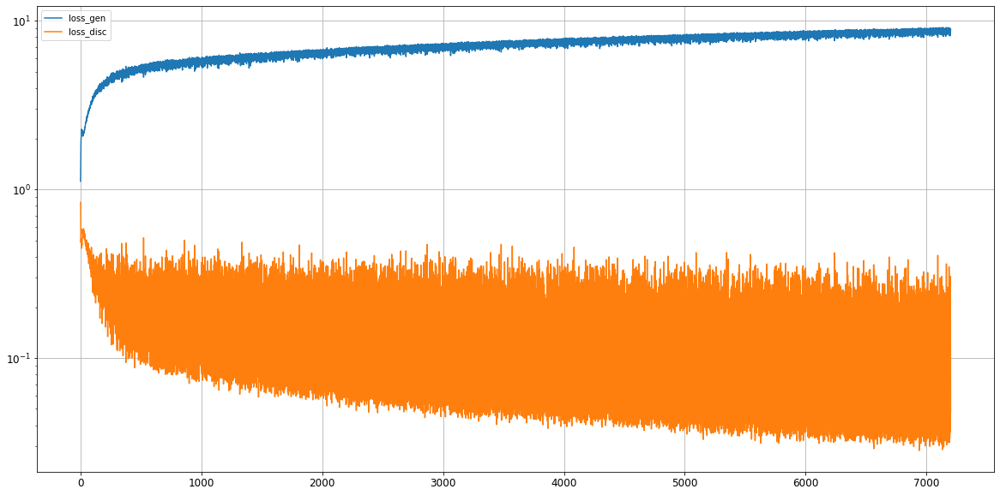

0: mean KL divergence (r,g) = 0.03344098701038442
0: mean JS divergence = 0.009638213725943045
0: mean 1-BC divergence = 0.008233566116095159

0: std KL divergence (r,g) = 0.03601929630806967
0: std JS divergence = 0.00992317981039981
0: std 1-BC divergence = 0.007992227154763443


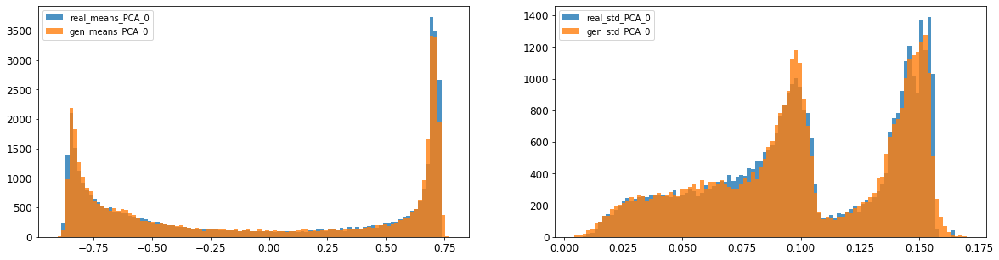

1: mean KL divergence (r,g) = 0.018871294311506505
1: mean JS divergence = 0.004661989818098831
1: mean 1-BC divergence = 0.003315481433343148

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.0076447615385409114
1: std 1-BC divergence = 0.0054285572012116035


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


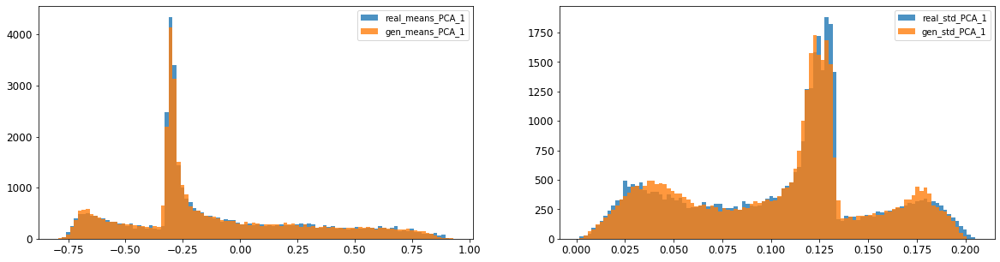

2: mean KL divergence (r,g) = 0.015611523758369066
2: mean JS divergence = 0.0037140212848083528
2: mean 1-BC divergence = 0.0026267015340686317

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.007722956913844336
2: std 1-BC divergence = 0.006562418008361881


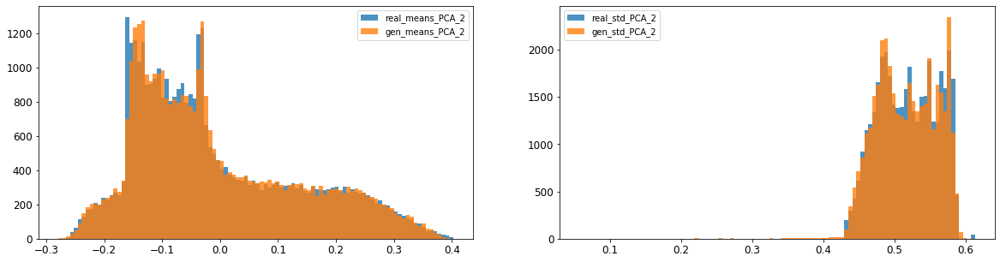

3: mean KL divergence (r,g) = 0.03944749335640758
3: mean JS divergence = 0.009242628824077167
3: mean 1-BC divergence = 0.0064725027295542414

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0545129467364629
3: std 1-BC divergence = 0.03909036904288332


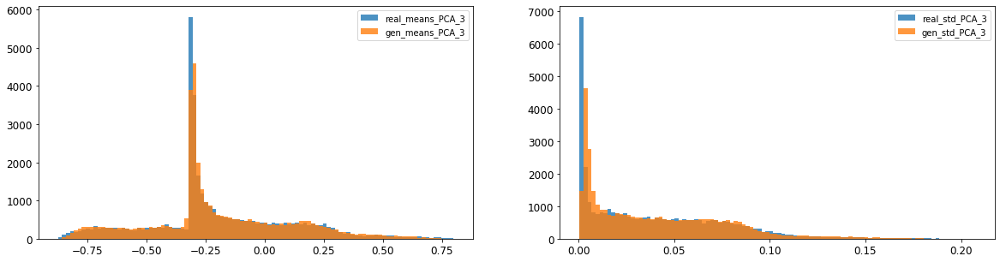

4: mean KL divergence (r,g) = 0.04503482757450576
4: mean JS divergence = 0.011639302713357965
4: mean 1-BC divergence = 0.00879782891836367

4: std KL divergence (r,g) = 0.02673223184879615
4: std JS divergence = 0.006413540347036763
4: std 1-BC divergence = 0.004565893606013005


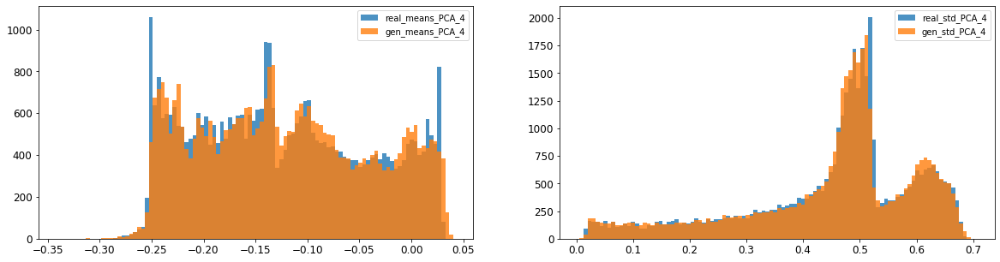

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.012882919642995483
5: mean 1-BC divergence = 0.009533052888267557

5: std KL divergence (r,g) = 0.06197742003725142
5: std JS divergence = 0.016464909025962163
5: std 1-BC divergence = 0.01377637596012804


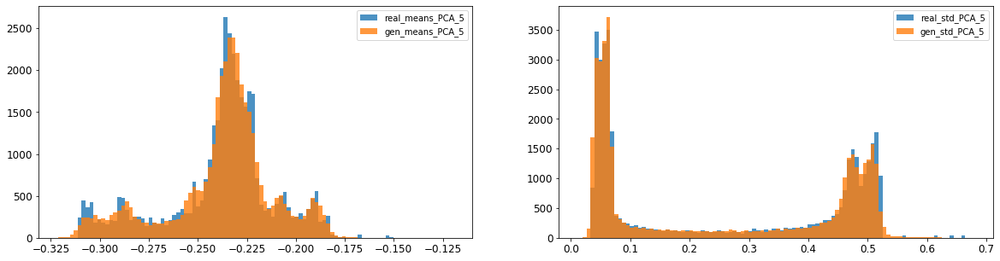

6: mean KL divergence (r,g) = 0.015351357525926644
6: mean JS divergence = 0.003906135909729675
6: mean 1-BC divergence = 0.0027792456927331344

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.005416567975712371
6: std 1-BC divergence = 0.003853723097352213


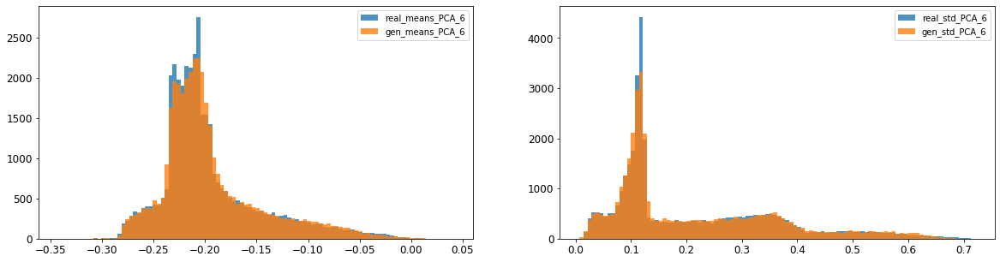

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.015464561166352666
7: mean 1-BC divergence = 0.011994851134184747

7: std KL divergence (r,g) = 0.021799957798556212
7: std JS divergence = 0.0053660748715001596
7: std 1-BC divergence = 0.0037708153187451243


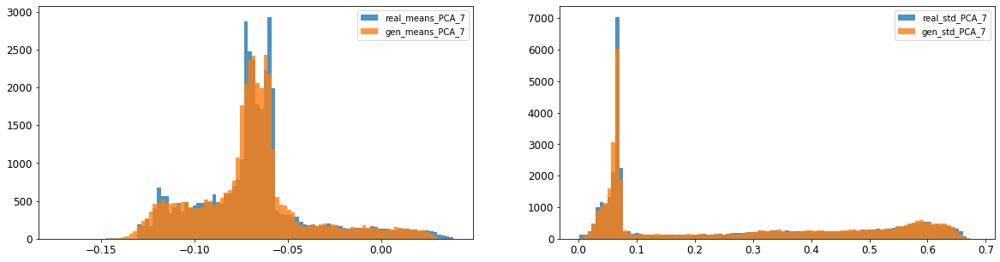

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002312629256180528
8: mean 1-BC divergence = 0.0016403313080896043

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.00825582899087848
8: std 1-BC divergence = 0.005903879181847316


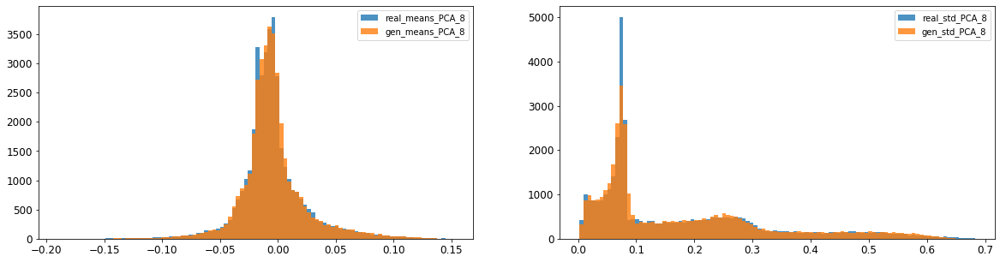

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0046016342383713715
9: mean 1-BC divergence = 0.003278333904004338

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.007710111108863073
9: std 1-BC divergence = 0.005527020625140322


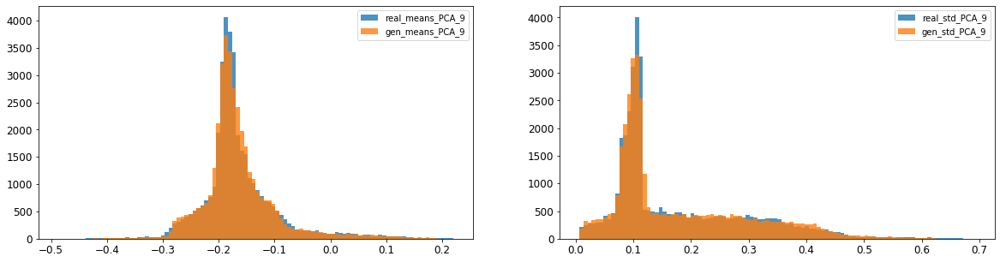

10: mean KL divergence (r,g) = 0.021463445928686056
10: mean JS divergence = 0.005334614213012756
10: mean 1-BC divergence = 0.0037878290687736182

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007994921336573304
10: std 1-BC divergence = 0.00635562742213458


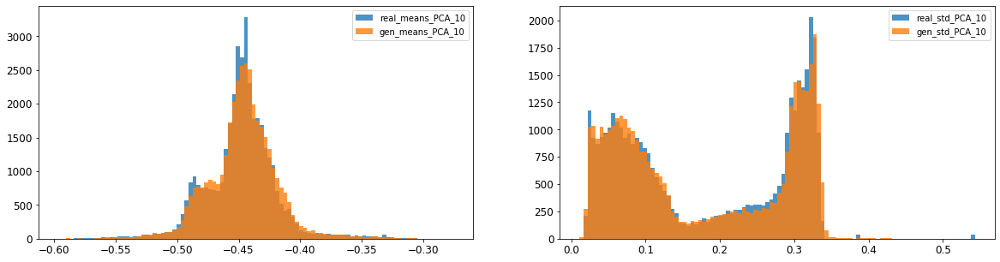

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.01252498917502489
11: mean 1-BC divergence = 0.008788713141889115

11: std KL divergence (r,g) = 0.026226623674239353
11: std JS divergence = 0.006606913401415766
11: std 1-BC divergence = 0.004646488166406226


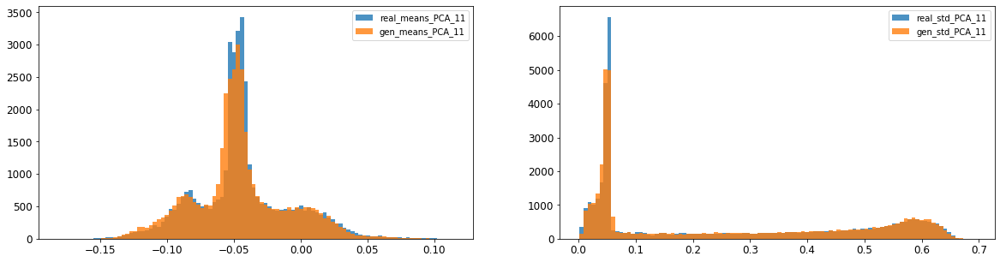

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004048422565651484
12: mean 1-BC divergence = 0.002885745397900874

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.014444792440189678
12: std 1-BC divergence = 0.010321634687958658


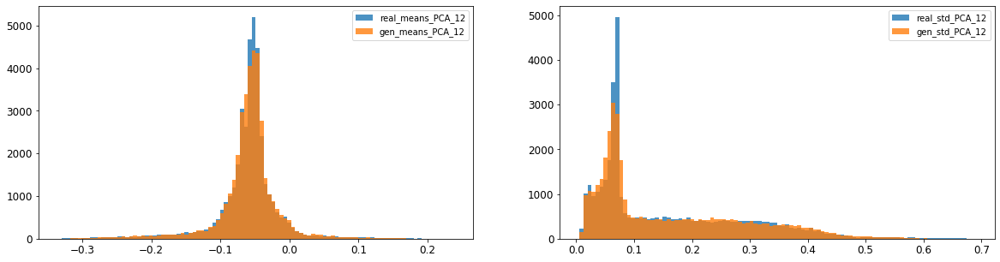

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.015376056346129399
13: mean 1-BC divergence = 0.010772784050684936

13: std KL divergence (r,g) = 0.050606277520470706
13: std JS divergence = 0.012127653300610153
13: std 1-BC divergence = 0.008472362835531544


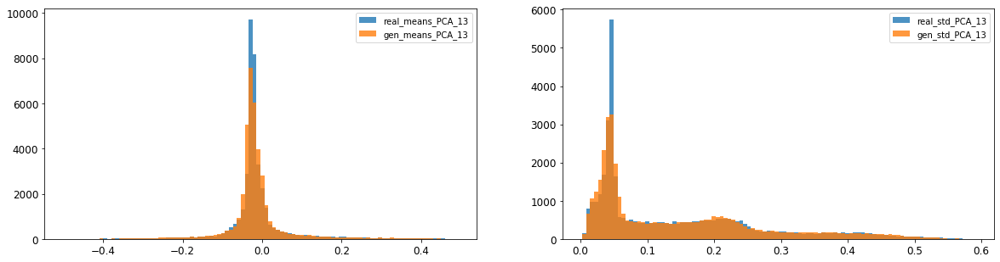

14: mean KL divergence (r,g) = 0.05275934164276833
14: mean JS divergence = 0.013043962794033297
14: mean 1-BC divergence = 0.009163656079268945

14: std KL divergence (r,g) = 0.032005880829057365
14: std JS divergence = 0.00784953157877986
14: std 1-BC divergence = 0.005484169612837597


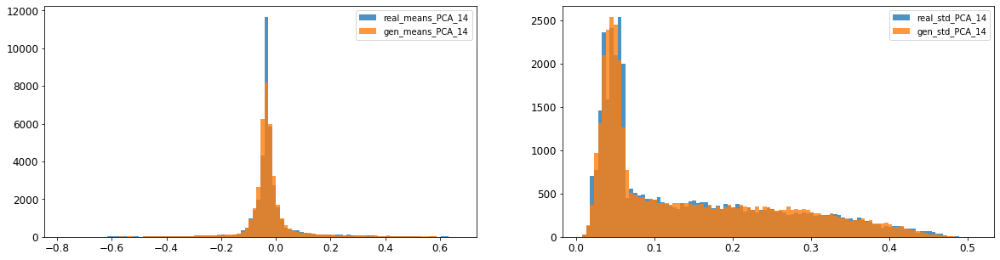

15: mean KL divergence (r,g) = 1.757307753936371
15: mean JS divergence = 0.47411233193535085
15: mean 1-BC divergence = 0.43431354342995865

15: std KL divergence (r,g) = 7.08357296322614
15: std JS divergence = 0.9685492364338867
15: std 1-BC divergence = 0.9141350283637049


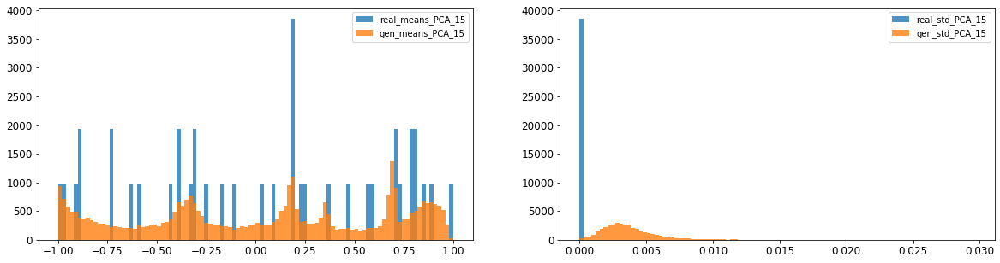

16: mean KL divergence (r,g) = 1.3803925386334268
16: mean JS divergence = 0.3878125458966408
16: mean 1-BC divergence = 0.3577666391172758

16: std KL divergence (r,g) = 5.8007781823425635
16: std JS divergence = 0.9349152571813528
16: std 1-BC divergence = 0.8660644441320788


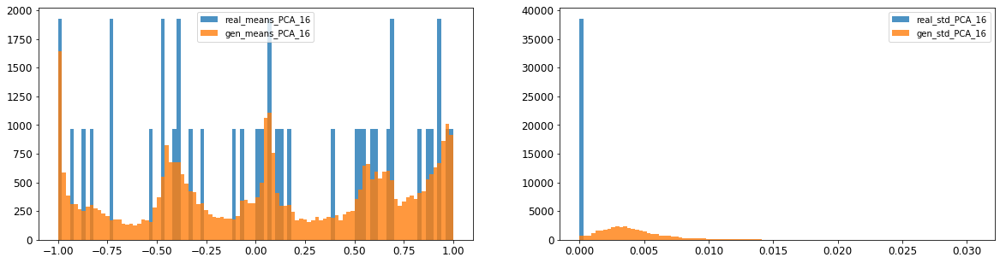



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010228225701684555
Compose 1-BC divergence = 0.007527406177284535

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.009733269268000564
Compose weighted 1-BC divergence = 0.007656437049283427

Multivariate KL divergence = 38.30311233783258


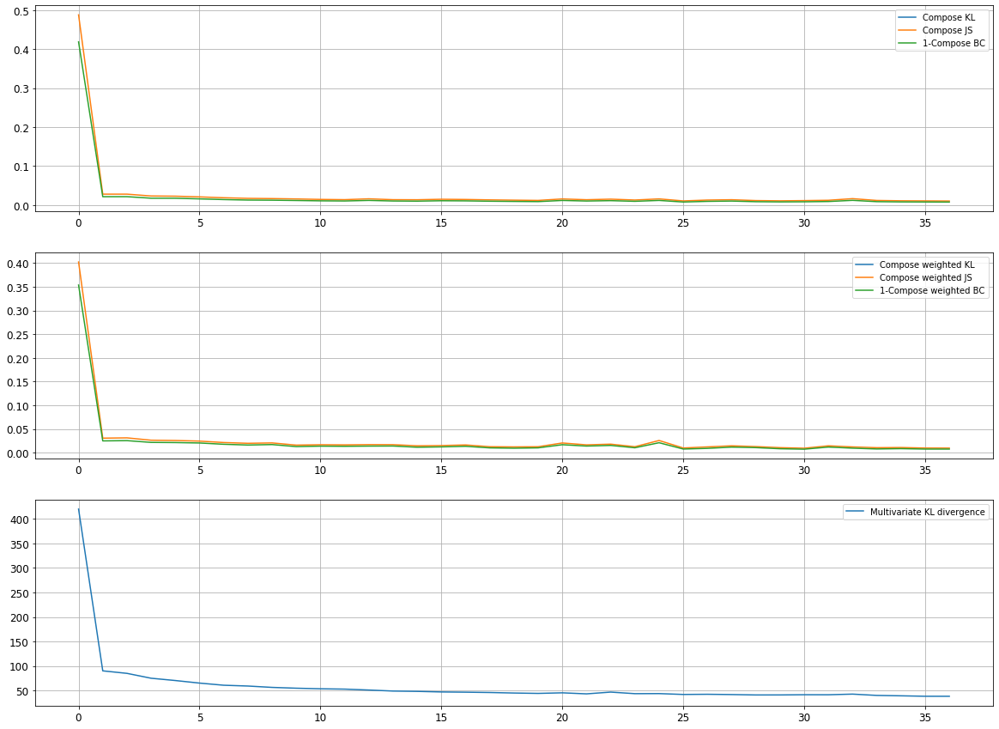

Epoch 7202/10000
discriminator loss: 0.031898 - generator loss: 9.070623 - 27s
Epoch 7203/10000
discriminator loss: 0.247861 - generator loss: 8.578340 - 28s
Epoch 7204/10000
discriminator loss: 0.037233 - generator loss: 8.878930 - 28s
Epoch 7205/10000
discriminator loss: 0.034586 - generator loss: 9.018688 - 28s
Epoch 7206/10000
discriminator loss: 0.060610 - generator loss: 8.940156 - 28s
Epoch 7207/10000
discriminator loss: 0.339731 - generator loss: 7.982643 - 29s
Epoch 7208/10000
discriminator loss: 0.034005 - generator loss: 8.996271 - 29s
Epoch 7209/10000
discriminator loss: 0.036908 - generator loss: 9.054759 - 29s
Epoch 7210/10000
discriminator loss: 0.032800 - generator loss: 9.027226 - 29s
Epoch 7211/10000
discriminator loss: 0.163682 - generator loss: 8.549851 - 29s
Epoch 7212/10000
discriminator loss: 0.032605 - generator loss: 9.059322 - 29s
Epoch 7213/10000
discriminator loss: 0.179827 - generator loss: 8.499496 - 29s
Epoch 7214/10000
discriminator loss: 0.033913 - gene

discriminator loss: 0.038787 - generator loss: 8.928273 - 28s
Epoch 7307/10000
discriminator loss: 0.031722 - generator loss: 9.144902 - 28s
Epoch 7308/10000
discriminator loss: 0.238841 - generator loss: 8.344404 - 28s
Epoch 7309/10000
discriminator loss: 0.038696 - generator loss: 8.865368 - 29s
Epoch 7310/10000
discriminator loss: 0.035207 - generator loss: 9.067547 - 28s
Epoch 7311/10000
discriminator loss: 0.044140 - generator loss: 8.954701 - 28s
Epoch 7312/10000
discriminator loss: 0.170377 - generator loss: 8.555347 - 29s
Epoch 7313/10000
discriminator loss: 0.032782 - generator loss: 9.029882 - 28s
Epoch 7314/10000
discriminator loss: 0.150039 - generator loss: 8.951232 - 28s
Epoch 7315/10000
discriminator loss: 0.132645 - generator loss: 8.483388 - 28s
Epoch 7316/10000
discriminator loss: 0.031529 - generator loss: 9.065003 - 28s
Epoch 7317/10000
discriminator loss: 0.033985 - generator loss: 9.109909 - 28s
Epoch 7318/10000
discriminator loss: 0.272330 - generator loss: 8.360

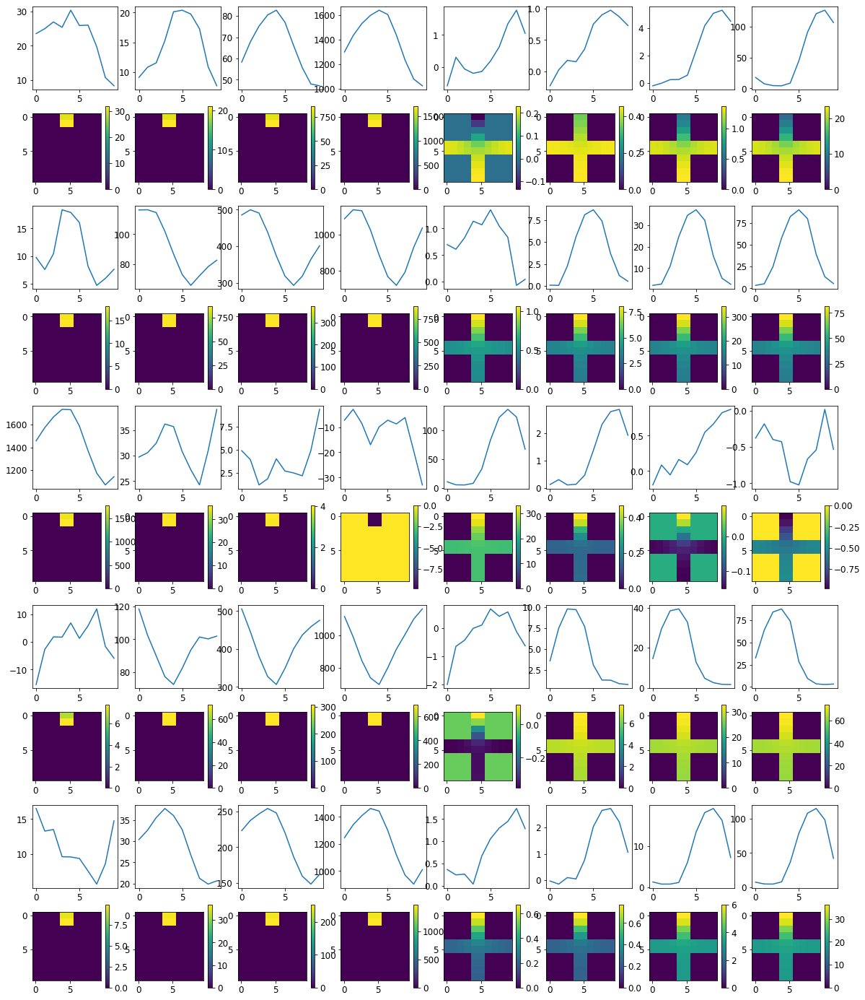


R0 generated:
[[19.504402   17.9403    ]
 [19.505247   17.881506  ]
 [19.517406   17.88983   ]
 [19.499985   17.892666  ]
 [19.488945   17.874493  ]
 [19.475409   17.838715  ]
 [19.499714   17.880518  ]
 [19.489958   17.893795  ]
 [19.459745   17.86274   ]
 [19.472927   18.030176  ]
 [17.080637    0.3057535 ]
 [17.072136    0.29785538]
 [17.136322    0.2881298 ]
 [17.100237    0.28501955]
 [17.10659     0.279676  ]
 [17.073153    0.28279266]
 [17.107533    0.27287236]
 [17.045929    0.27505025]
 [17.059744    0.27866372]
 [17.04931     0.2896768 ]
 [16.87253     0.4173027 ]
 [16.965816    0.39043394]
 [17.041155    0.37795144]
 [16.998663    0.3903278 ]
 [16.989458    0.37076414]
 [16.974571    0.3854449 ]
 [16.979952    0.36581534]
 [16.917889    0.35334805]
 [16.93255     0.36742353]
 [16.939545    0.36793843]
 [19.772036   16.327246  ]
 [19.76912    16.25603   ]
 [19.765701   16.285376  ]
 [19.762094   16.301775  ]
 [19.759333   16.233433  ]
 [19.764034   16.182981  ]
 [19.774134  

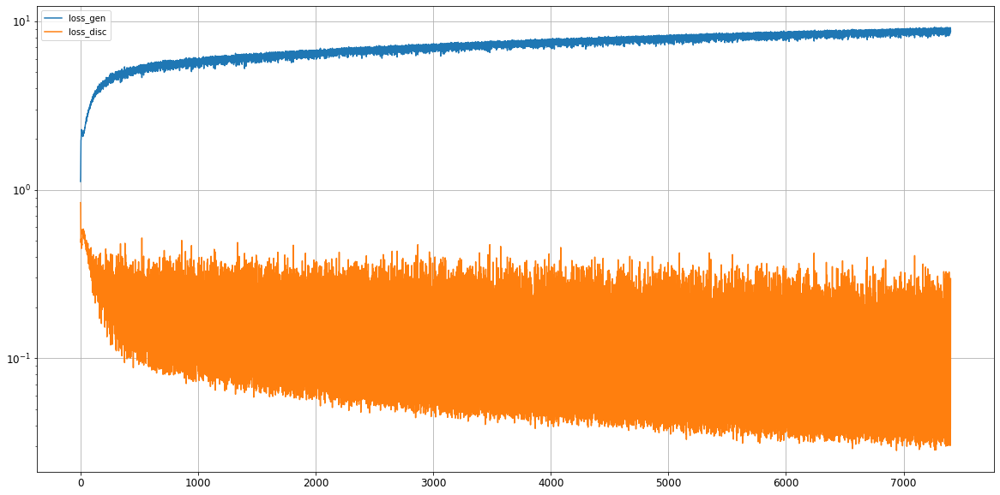

0: mean KL divergence (r,g) = 0.024673799668953066
0: mean JS divergence = 0.006484261089530127
0: mean 1-BC divergence = 0.004829916896775477

0: std KL divergence (r,g) = 0.04058893386073887
0: std JS divergence = 0.012299088556934741
0: std 1-BC divergence = 0.010706686113550967


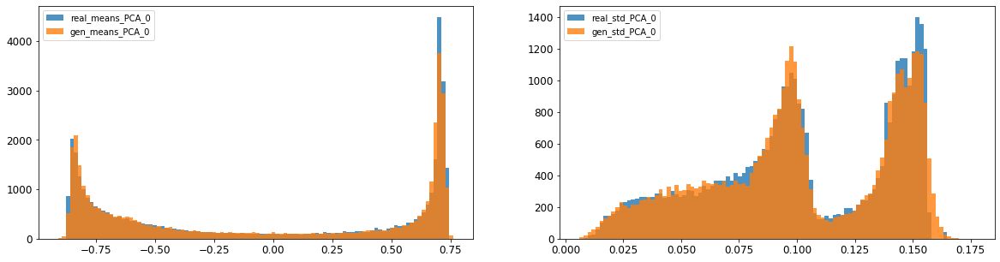

1: mean KL divergence (r,g) = 0.014218650225444314
1: mean JS divergence = 0.003620777101463167
1: mean 1-BC divergence = 0.002571450465422953

1: std KL divergence (r,g) = 0.025192726483659663
1: std JS divergence = 0.006279143488515665
1: std 1-BC divergence = 0.004367639118144528


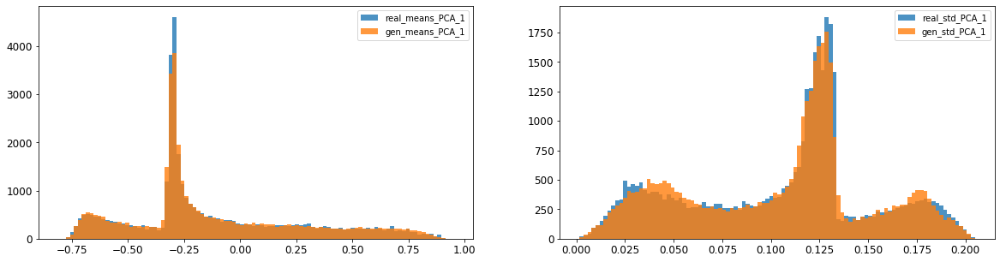

2: mean KL divergence (r,g) = 0.01116021407557854
2: mean JS divergence = 0.002778808278213327
2: mean 1-BC divergence = 0.0019668125045793072

2: std KL divergence (r,g) = 0.026684247353897246
2: std JS divergence = 0.007305927260969634
2: std 1-BC divergence = 0.006378190319459409


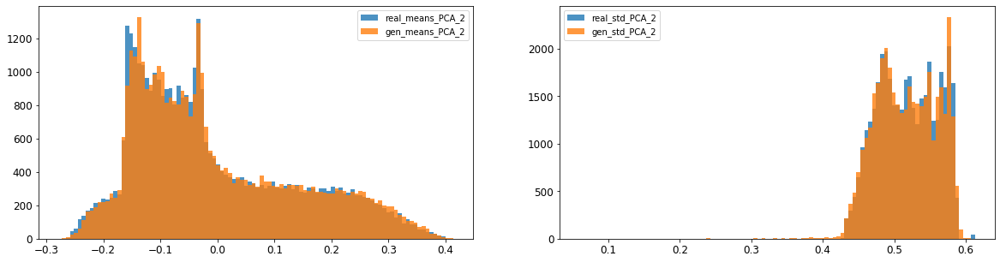

3: mean KL divergence (r,g) = 0.0627299504081899
3: mean JS divergence = 0.015289438017633956
3: mean 1-BC divergence = 0.010665748445721879

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.08577479196462569
3: std 1-BC divergence = 0.06387203852981216


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


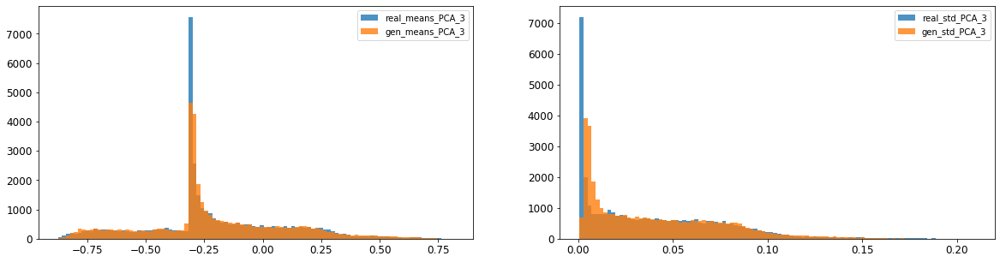

4: mean KL divergence (r,g) = 0.04593706524487803
4: mean JS divergence = 0.011144759698509827
4: mean 1-BC divergence = 0.008067071588427455

4: std KL divergence (r,g) = 0.012658872187541009
4: std JS divergence = 0.003188126164985463
4: std 1-BC divergence = 0.002301360275079656


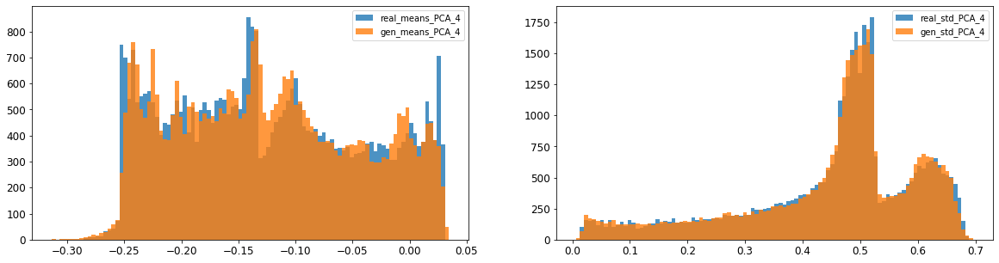

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.017302403742052594
5: mean 1-BC divergence = 0.0126210541376931

5: std KL divergence (r,g) = 0.04552765405261364
5: std JS divergence = 0.013448277112702056
5: std 1-BC divergence = 0.012012073699001036


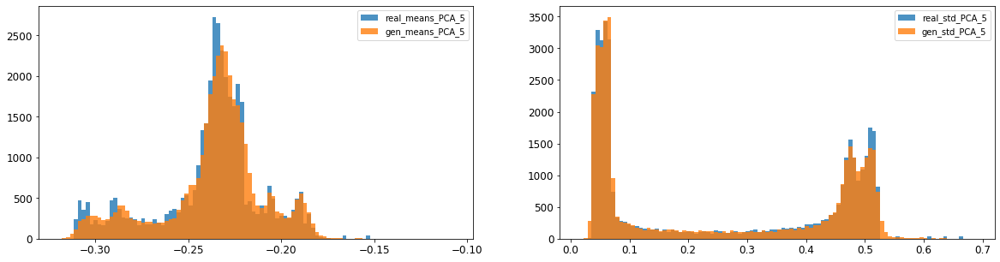

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.004779387714366961
6: mean 1-BC divergence = 0.0034039997660719745

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.006270154552649591
6: std 1-BC divergence = 0.004513324083855075


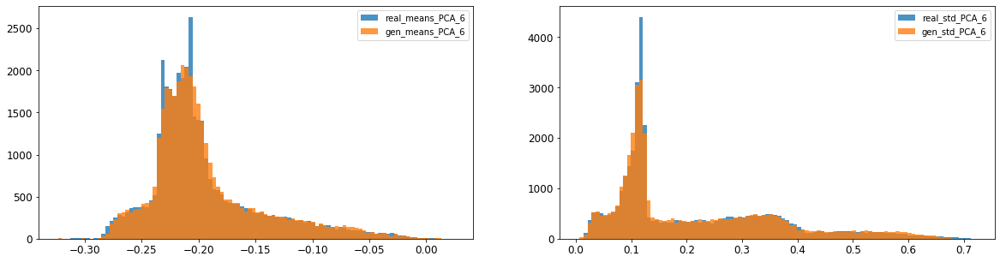

7: mean KL divergence (r,g) = 0.05436955022866165
7: mean JS divergence = 0.013724877548804916
7: mean 1-BC divergence = 0.010017527077307298

7: std KL divergence (r,g) = 0.040373814791766466
7: std JS divergence = 0.010077650760124412
7: std 1-BC divergence = 0.007063893136533439


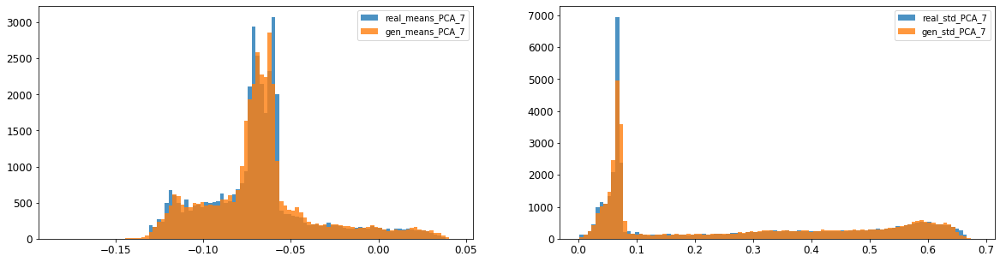

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0031301688552298956
8: mean 1-BC divergence = 0.0022141494831838804

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.00936753708648044
8: std 1-BC divergence = 0.006577929160019869


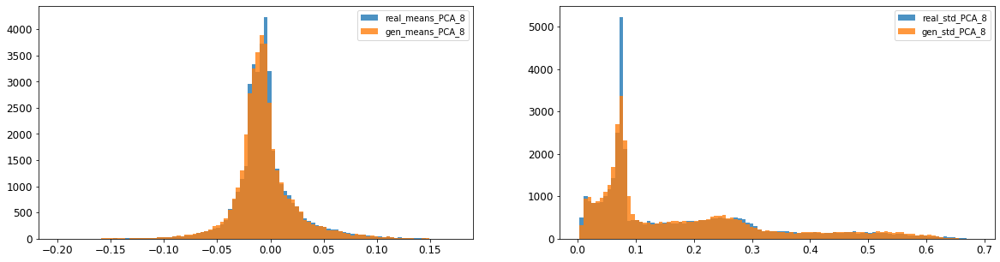

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0056758355839359315
9: mean 1-BC divergence = 0.004031046751188927

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010115796940105535
9: std 1-BC divergence = 0.0072724552792329256


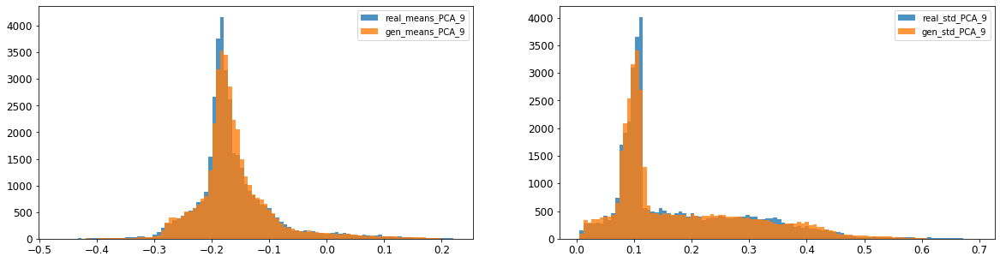

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.006751718546251279
10: mean 1-BC divergence = 0.004738288071727714

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.006431705816446616
10: std 1-BC divergence = 0.0054465019550048455


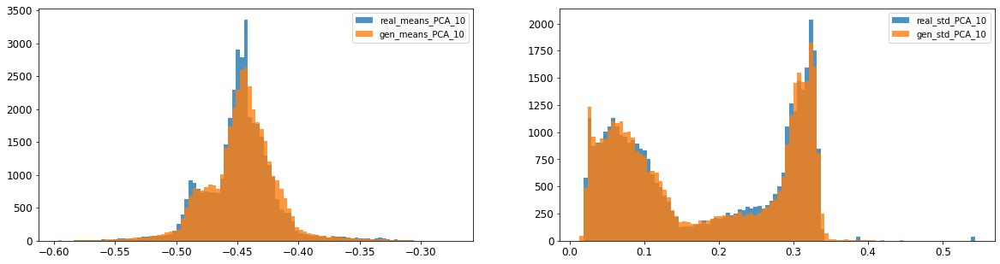

11: mean KL divergence (r,g) = 0.02214040102111281
11: mean JS divergence = 0.0055207910080108825
11: mean 1-BC divergence = 0.0038835842657476416

11: std KL divergence (r,g) = 0.03652587465402707
11: std JS divergence = 0.009906891295035908
11: std 1-BC divergence = 0.007083571841047798


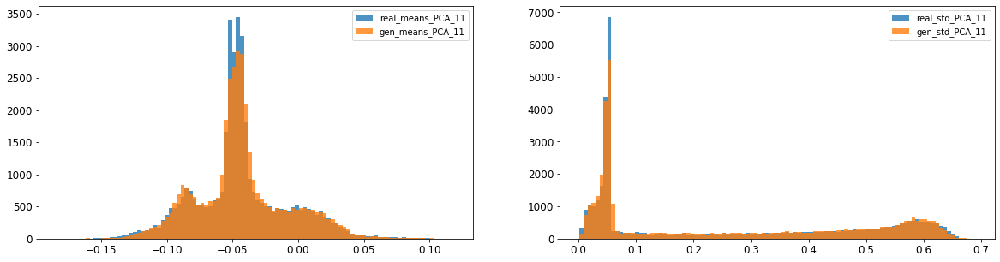

12: mean KL divergence (r,g) = 0.02298849540252124
12: mean JS divergence = 0.005572471415663912
12: mean 1-BC divergence = 0.0038976971939278515

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.015484506193621322
12: std 1-BC divergence = 0.011017953482276854


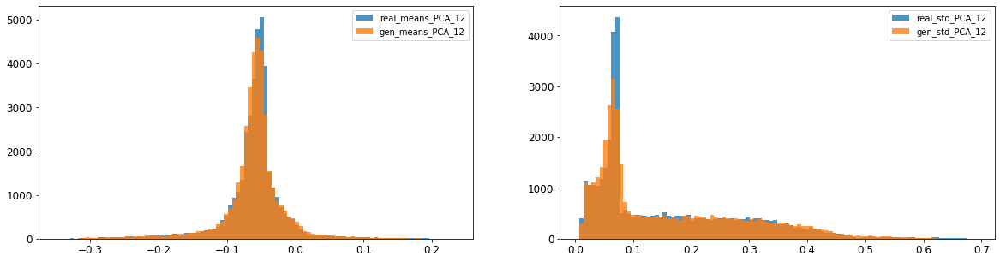

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.011448405291768052
13: mean 1-BC divergence = 0.008034297861069462

13: std KL divergence (r,g) = 0.07172968641912499
13: std JS divergence = 0.017349523773889354
13: std 1-BC divergence = 0.012128696076669554


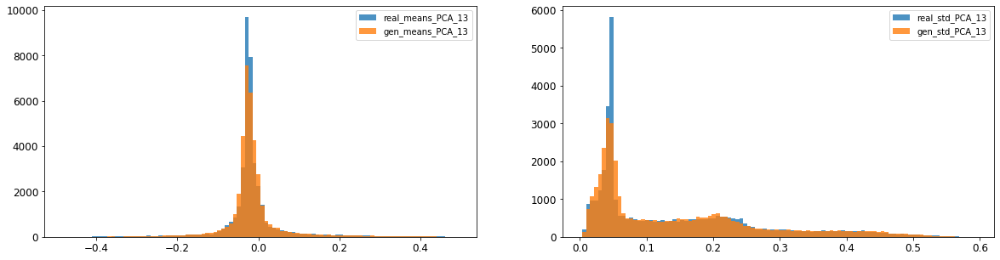

14: mean KL divergence (r,g) = 0.03396554325381078
14: mean JS divergence = 0.008313905274401161
14: mean 1-BC divergence = 0.005839989200549622

14: std KL divergence (r,g) = 0.03287058490136198
14: std JS divergence = 0.008168547909112311
14: std 1-BC divergence = 0.005701978204468383


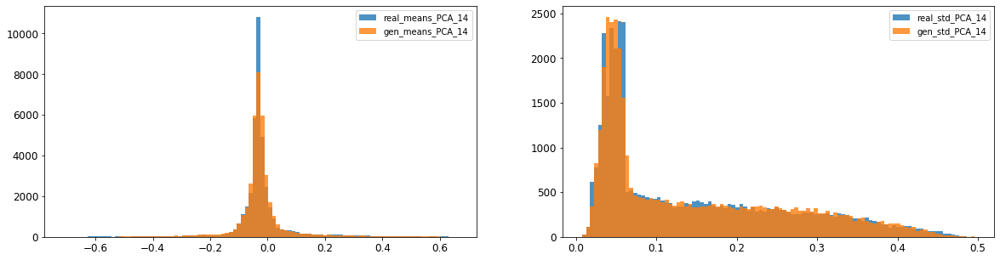

15: mean KL divergence (r,g) = 1.7250124218830303
15: mean JS divergence = 0.46607994791417773
15: mean 1-BC divergence = 0.4269665749903462

15: std KL divergence (r,g) = 6.717620244446779
15: std JS divergence = 0.9611996881681398
15: std 1-BC divergence = 0.902524066393808


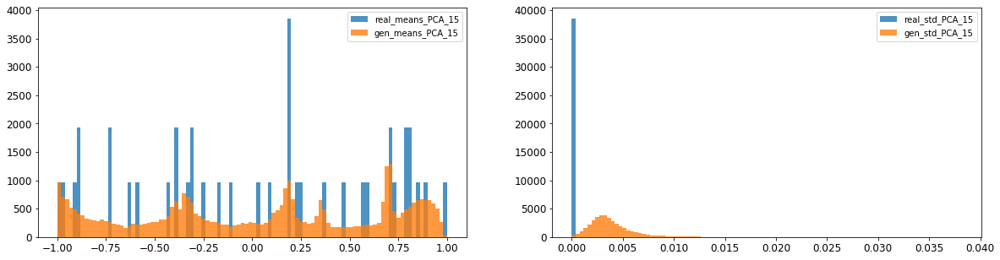

16: mean KL divergence (r,g) = 1.3498161674161204
16: mean JS divergence = 0.3794726486445196
16: mean 1-BC divergence = 0.3499384377555257

16: std KL divergence (r,g) = 5.1591786199783165
16: std JS divergence = 0.90734188157118
16: std 1-BC divergence = 0.8327114406254521


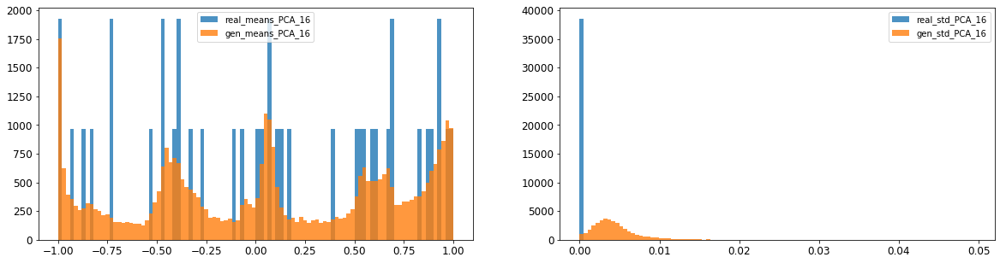



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.011433522601401158
Compose 1-BC divergence = 0.00844089749945165

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.010115743661163525
Compose weighted 1-BC divergence = 0.007937977522878947

Multivariate KL divergence = 39.15518067801295


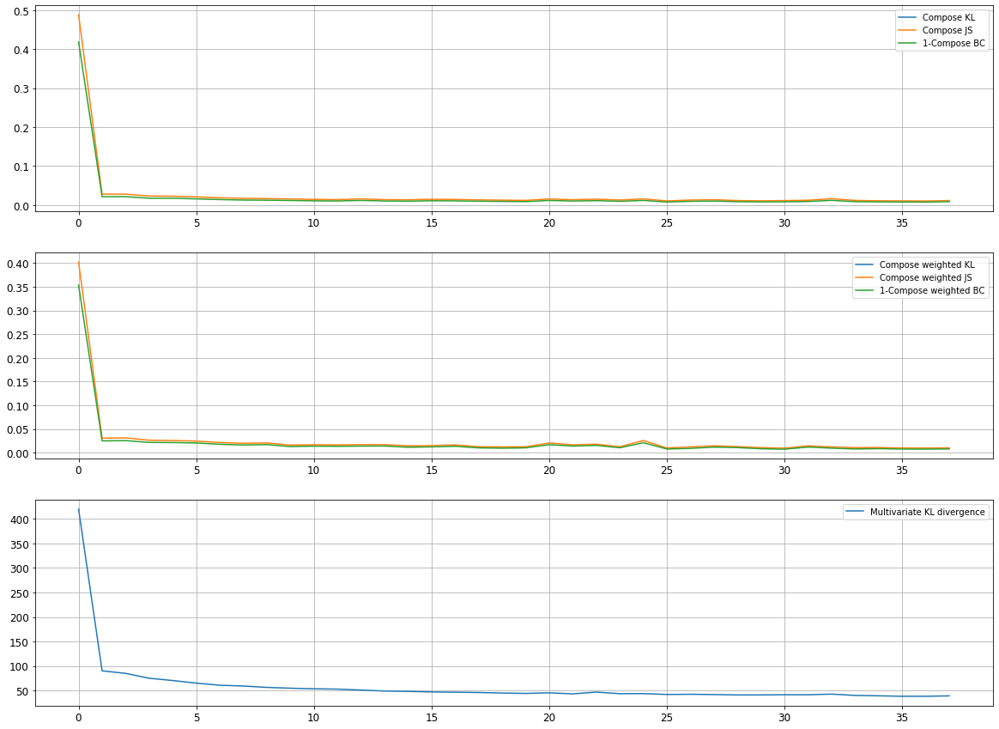

Epoch 7402/10000
discriminator loss: 0.050295 - generator loss: 8.580911 - 27s
Epoch 7403/10000
discriminator loss: 0.033186 - generator loss: 9.124649 - 28s
Epoch 7404/10000
discriminator loss: 0.079415 - generator loss: 8.959816 - 28s
Epoch 7405/10000
discriminator loss: 0.035666 - generator loss: 8.966473 - 28s
Epoch 7406/10000
discriminator loss: 0.044578 - generator loss: 9.051944 - 29s
Epoch 7407/10000
discriminator loss: 0.240093 - generator loss: 8.420594 - 28s
Epoch 7408/10000
discriminator loss: 0.035479 - generator loss: 8.965783 - 29s
Epoch 7409/10000
discriminator loss: 0.039474 - generator loss: 9.069203 - 29s
Epoch 7410/10000
discriminator loss: 0.033574 - generator loss: 9.148907 - 28s
Epoch 7411/10000
discriminator loss: 0.338059 - generator loss: 8.776072 - 29s
Epoch 7412/10000
discriminator loss: 0.068008 - generator loss: 8.296256 - 28s
Epoch 7413/10000
discriminator loss: 0.032952 - generator loss: 9.023005 - 29s
Epoch 7414/10000
discriminator loss: 0.029759 - gene

discriminator loss: 0.039723 - generator loss: 9.035953 - 28s
Epoch 7507/10000
discriminator loss: 0.040510 - generator loss: 9.145640 - 28s
Epoch 7508/10000
discriminator loss: 0.211075 - generator loss: 8.513235 - 28s
Epoch 7509/10000
discriminator loss: 0.031311 - generator loss: 9.197176 - 28s
Epoch 7510/10000
discriminator loss: 0.038533 - generator loss: 9.073010 - 28s
Epoch 7511/10000
discriminator loss: 0.175972 - generator loss: 8.681627 - 28s
Epoch 7512/10000
discriminator loss: 0.036045 - generator loss: 9.059701 - 28s
Epoch 7513/10000
discriminator loss: 0.211435 - generator loss: 8.765931 - 28s
Epoch 7514/10000
discriminator loss: 0.047375 - generator loss: 8.807200 - 28s
Epoch 7515/10000
discriminator loss: 0.034918 - generator loss: 9.127478 - 28s
Epoch 7516/10000
discriminator loss: 0.282337 - generator loss: 8.423000 - 28s
Epoch 7517/10000
discriminator loss: 0.033547 - generator loss: 9.103122 - 28s
Epoch 7518/10000
discriminator loss: 0.108532 - generator loss: 8.820

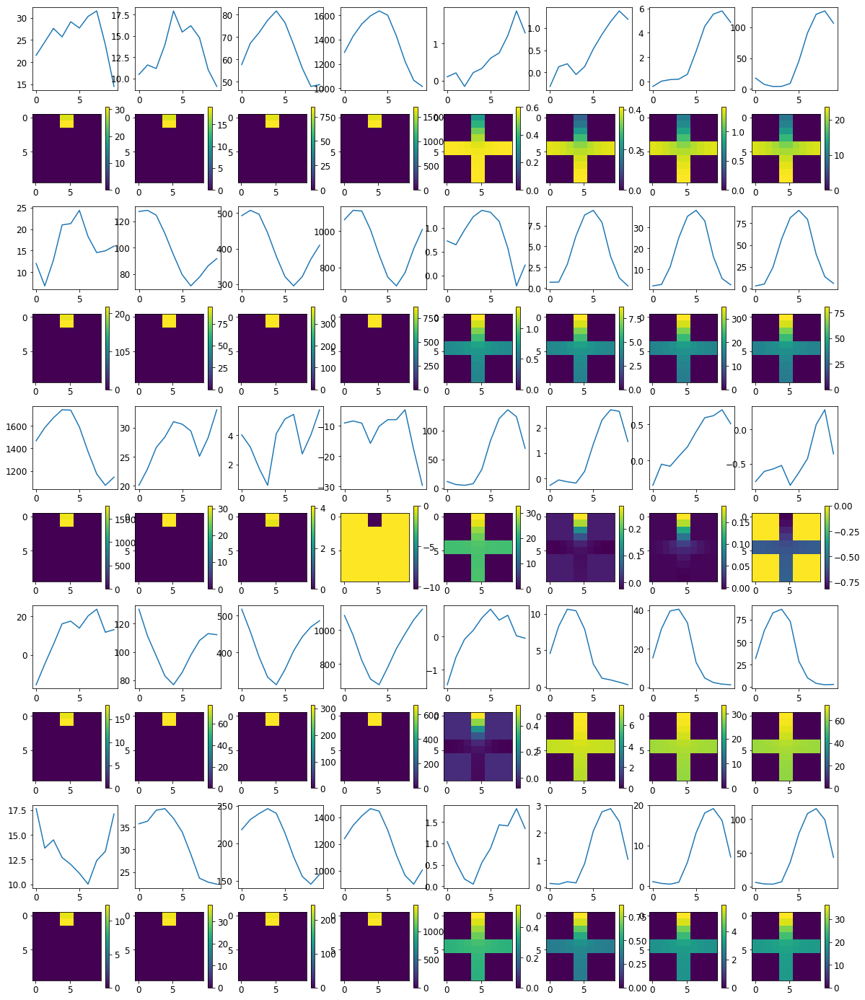


R0 generated:
[[19.408722   17.956646  ]
 [19.42146    17.854813  ]
 [19.429998   17.87409   ]
 [19.423817   17.833904  ]
 [19.414984   17.840036  ]
 [19.40976    17.787874  ]
 [19.434595   17.860697  ]
 [19.425419   17.879713  ]
 [19.392212   17.89691   ]
 [19.421173   18.031996  ]
 [16.916708    0.30077845]
 [16.935019    0.29133162]
 [16.958567    0.28631228]
 [16.944817    0.28096697]
 [16.9314      0.2828953 ]
 [16.943098    0.28613794]
 [16.92255     0.27888122]
 [16.901413    0.27846313]
 [16.914434    0.27918267]
 [16.941801    0.2876686 ]
 [16.70168     0.30931273]
 [16.785843    0.2899555 ]
 [16.815212    0.28693503]
 [16.829742    0.2862003 ]
 [16.789753    0.28472042]
 [16.776743    0.28988668]
 [16.800825    0.28354895]
 [16.791412    0.27604443]
 [16.837744    0.28783825]
 [16.902304    0.2895077 ]
 [19.732403   16.63561   ]
 [19.735415   16.53301   ]
 [19.73094    16.57056   ]
 [19.73107    16.540403  ]
 [19.72764    16.55177   ]
 [19.730753   16.45957   ]
 [19.737465  

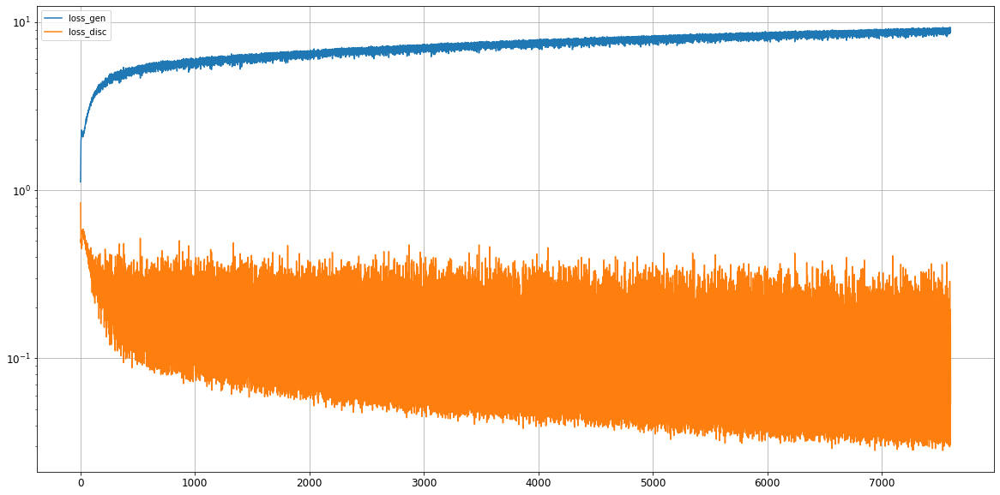

0: mean KL divergence (r,g) = 0.03504100197371565
0: mean JS divergence = 0.008467815983149624
0: mean 1-BC divergence = 0.006456160341529071

0: std KL divergence (r,g) = 0.04640127754507292
0: std JS divergence = 0.0111953432352392
0: std 1-BC divergence = 0.00857509439349069


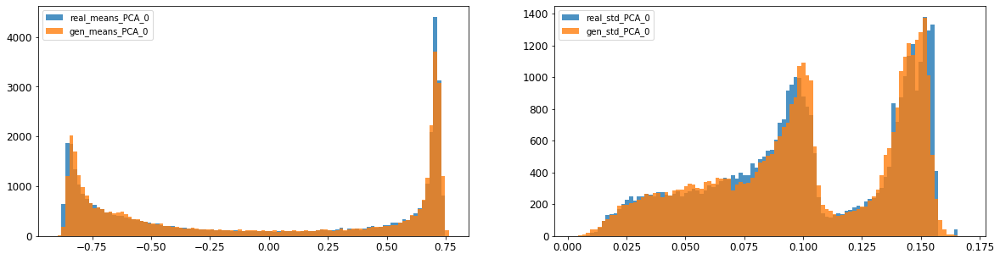

1: mean KL divergence (r,g) = 0.013193223683021388
1: mean JS divergence = 0.003310692424479151
1: mean 1-BC divergence = 0.002323034585701711

1: std KL divergence (r,g) = 0.031156373550750304
1: std JS divergence = 0.007633103722207053
1: std 1-BC divergence = 0.005357705061341811


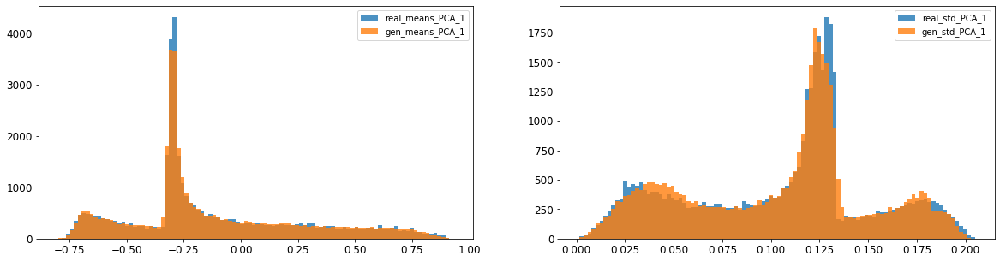

/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


2: mean KL divergence (r,g) = inf
2: mean JS divergence = 0.003737713466941091
2: mean 1-BC divergence = 0.0027351788326199777

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.009516639773217771
2: std 1-BC divergence = 0.008290090186476196


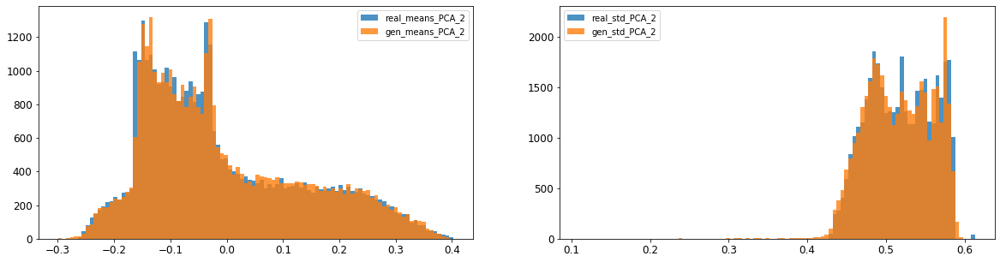

3: mean KL divergence (r,g) = 0.033891881712559024
3: mean JS divergence = 0.008054828297659824
3: mean 1-BC divergence = 0.005674677502493397

3: std KL divergence (r,g) = 0.2879975479225385
3: std JS divergence = 0.05917798841285636
3: std 1-BC divergence = 0.0425518292534004


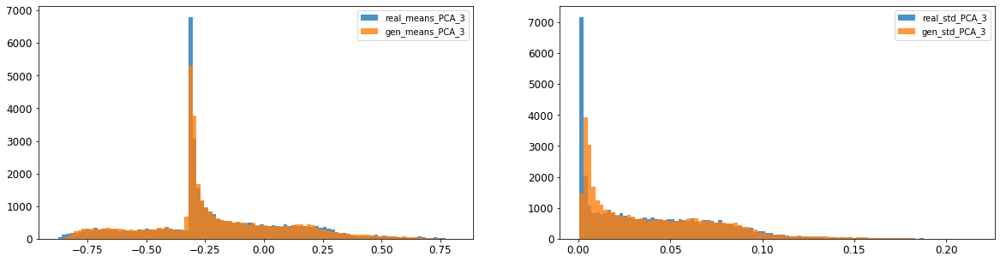

4: mean KL divergence (r,g) = 0.0390829017230381
4: mean JS divergence = 0.010778216875722613
4: mean 1-BC divergence = 0.008483722672841143

4: std KL divergence (r,g) = 0.01386043406296726
4: std JS divergence = 0.0034756518101556793
4: std 1-BC divergence = 0.0024718122294014044


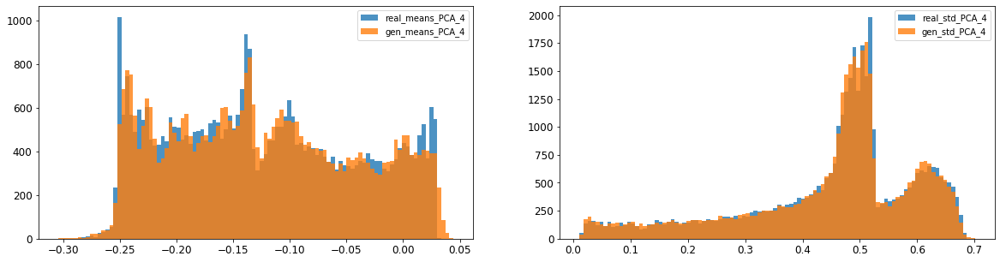

5: mean KL divergence (r,g) = 0.06519227369122134
5: mean JS divergence = 0.0163554378486699
5: mean 1-BC divergence = 0.01209554495265508

5: std KL divergence (r,g) = 0.047720617527500515
5: std JS divergence = 0.014107714859675123
5: std 1-BC divergence = 0.012230828616213274


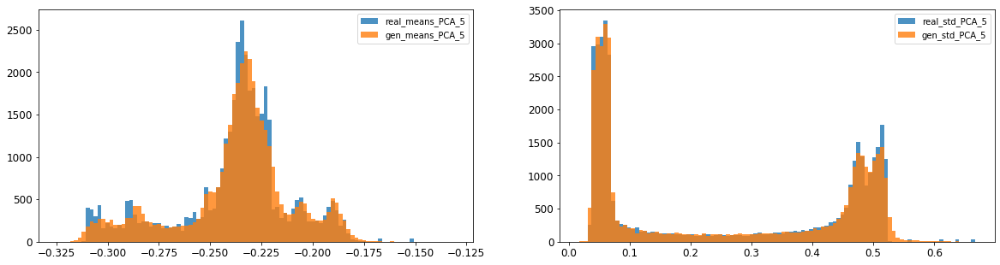

6: mean KL divergence (r,g) = 0.013448890120978992
6: mean JS divergence = 0.0034581173852049375
6: mean 1-BC divergence = 0.0024615035433207533

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.00959006385861487
6: std 1-BC divergence = 0.006871837462432362


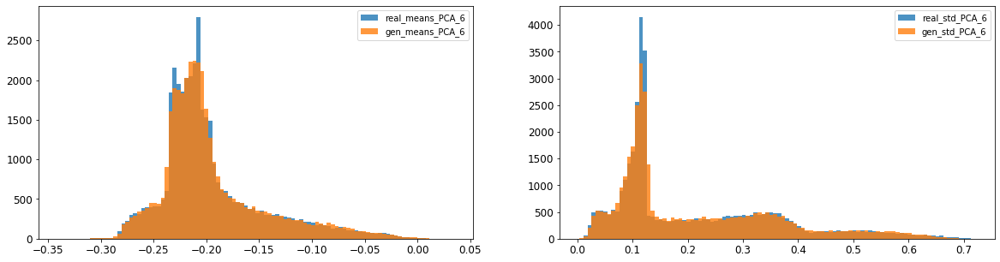

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.013443713835344208
7: mean 1-BC divergence = 0.010042347384615846

7: std KL divergence (r,g) = 0.030549911290906062
7: std JS divergence = 0.007401130773949649
7: std 1-BC divergence = 0.005173459448353124


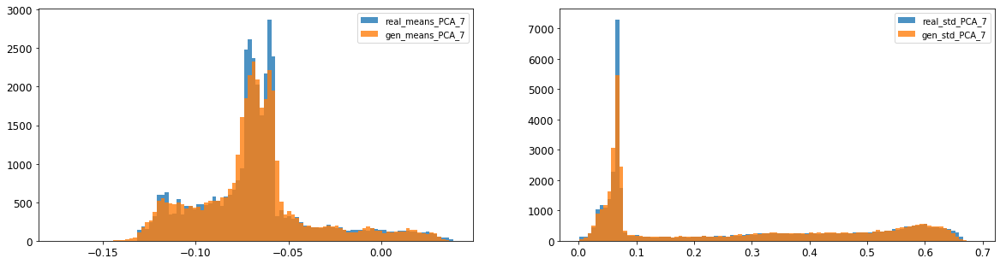

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0033183902017414383
8: mean 1-BC divergence = 0.0023533151817679565

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008408726241805357
8: std 1-BC divergence = 0.005967164399865443


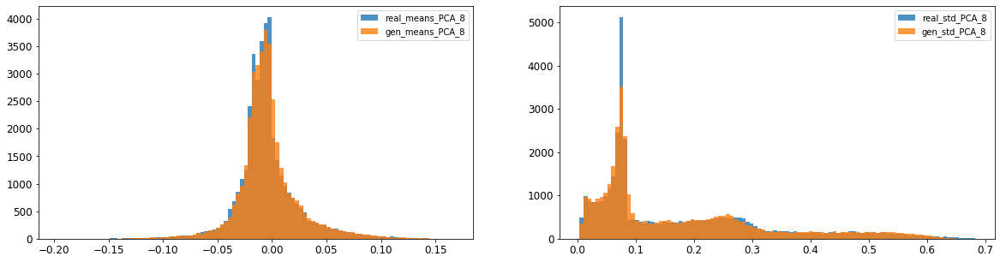

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004028984903053228
9: mean 1-BC divergence = 0.002910336391086399

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.01106976060474089
9: std 1-BC divergence = 0.007868198225707834


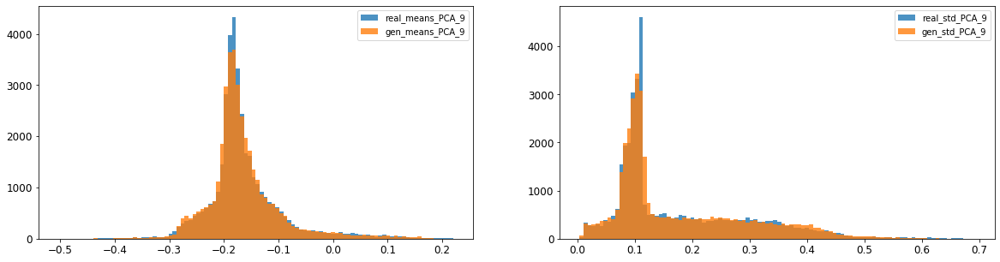

10: mean KL divergence (r,g) = 0.019272652099591014
10: mean JS divergence = 0.004901596930673423
10: mean 1-BC divergence = 0.003478189128104381

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.00562347738410157
10: std 1-BC divergence = 0.004627233837381173


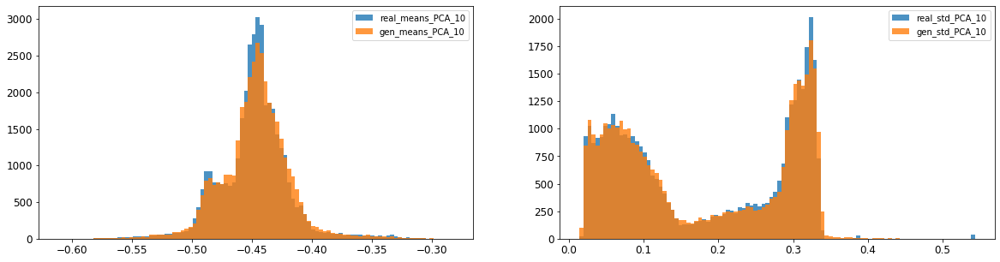

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.005113634744701647
11: mean 1-BC divergence = 0.0036287609280675204

11: std KL divergence (r,g) = 0.03728296366654822
11: std JS divergence = 0.010246908423016107
11: std 1-BC divergence = 0.007353903469345724


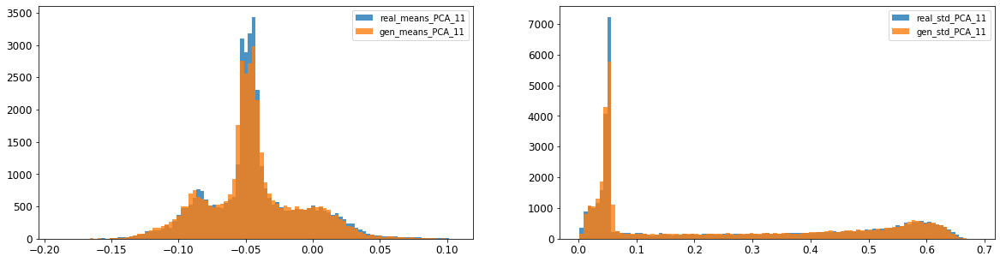

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.010271785100334394
12: mean 1-BC divergence = 0.007233278680585431

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01693749421974996
12: std 1-BC divergence = 0.012041333476209837


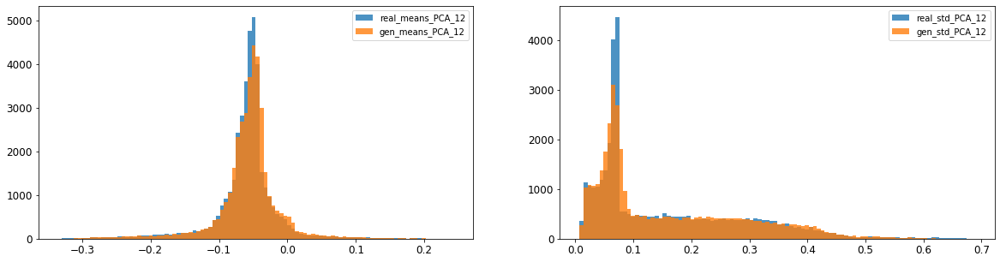

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.015027193512794173
13: mean 1-BC divergence = 0.010526202319737776

13: std KL divergence (r,g) = 0.06321247357922942
13: std JS divergence = 0.016032769155484985
13: std 1-BC divergence = 0.011261706821342976


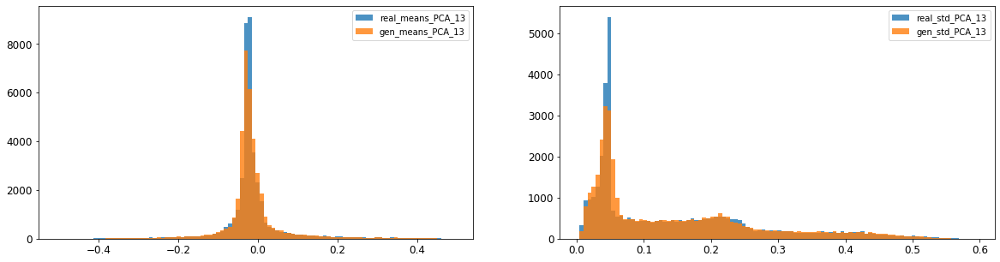

14: mean KL divergence (r,g) = 0.05573439886862078
14: mean JS divergence = 0.01374689408155774
14: mean 1-BC divergence = 0.00962203567361719

14: std KL divergence (r,g) = 0.026158269541371234
14: std JS divergence = 0.006435311698577828
14: std 1-BC divergence = 0.004521732084665331


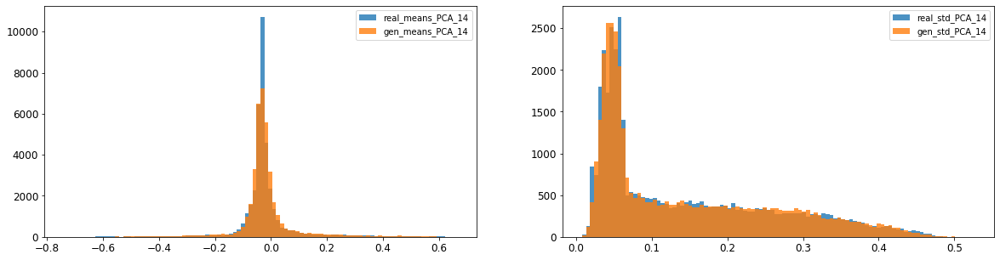

15: mean KL divergence (r,g) = 1.741925583737866
15: mean JS divergence = 0.46996025212898784
15: mean 1-BC divergence = 0.4313666282858827

15: std KL divergence (r,g) = 7.308507579125041
15: std JS divergence = 0.9723825843195735
15: std 1-BC divergence = 0.9205744926679517


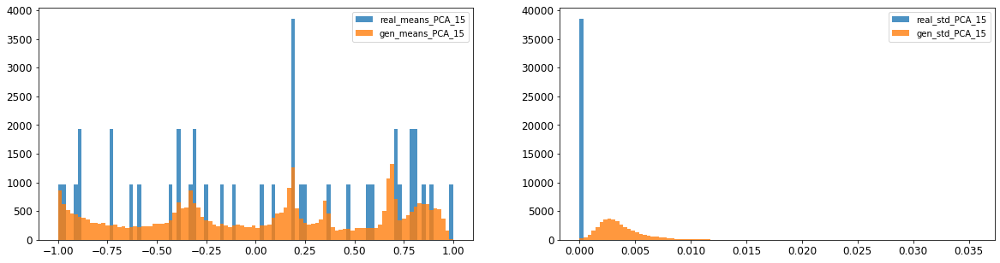

16: mean KL divergence (r,g) = 1.353784947168673
16: mean JS divergence = 0.38057181805727136
16: mean 1-BC divergence = 0.35090278438605116

16: std KL divergence (r,g) = 5.481776023641723
16: std JS divergence = 0.9223428598666406
16: std 1-BC divergence = 0.850407268017134


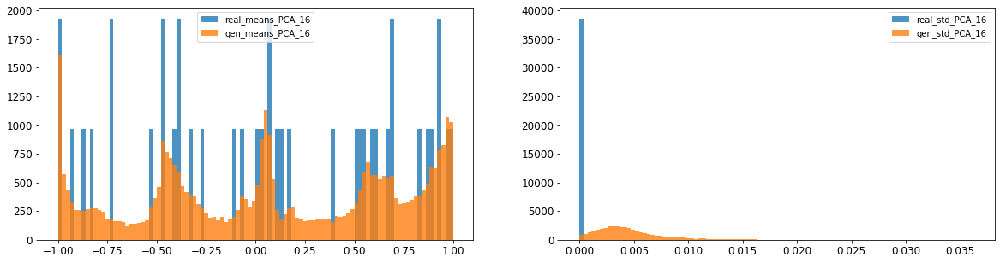



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01069556999218066
Compose 1-BC divergence = 0.00783960723614574

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.009754850165241778
Compose weighted 1-BC divergence = 0.007343102355476527

Multivariate KL divergence = 37.524497742454


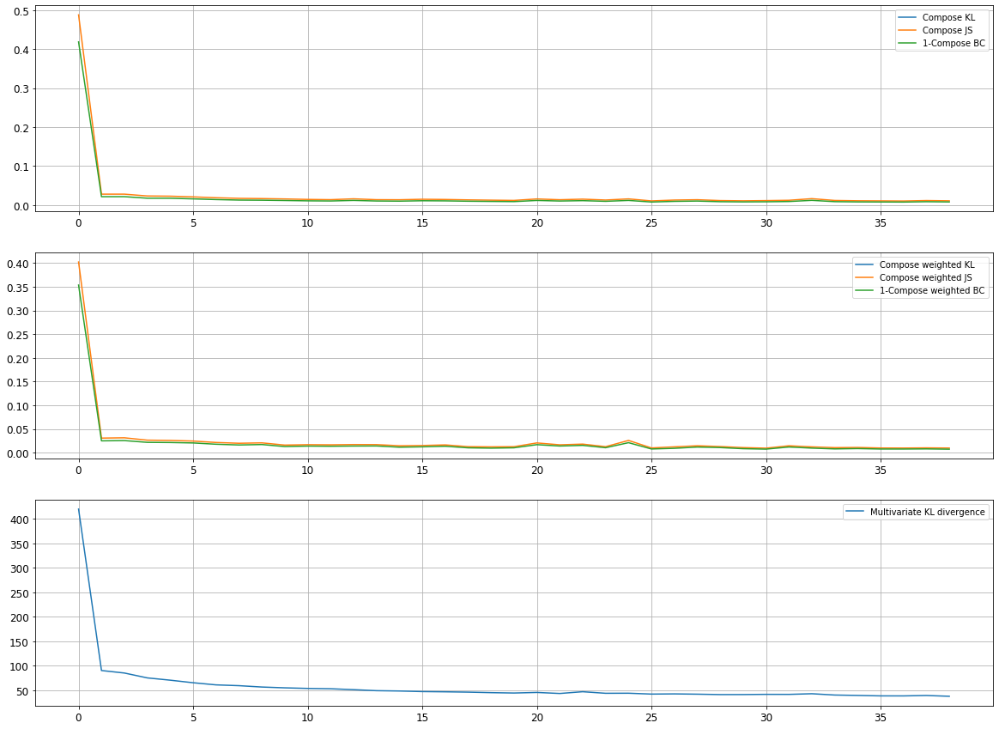

Epoch 7602/10000
discriminator loss: 0.036958 - generator loss: 9.169154 - 27s
Epoch 7603/10000
discriminator loss: 0.231822 - generator loss: 8.407647 - 28s
Epoch 7604/10000
discriminator loss: 0.038548 - generator loss: 9.081965 - 29s
Epoch 7605/10000
discriminator loss: 0.032580 - generator loss: 9.181078 - 29s
Epoch 7606/10000
discriminator loss: 0.192675 - generator loss: 8.700041 - 28s
Epoch 7607/10000
discriminator loss: 0.033896 - generator loss: 9.024961 - 29s
Epoch 7608/10000
discriminator loss: 0.164583 - generator loss: 8.723684 - 29s
Epoch 7609/10000
discriminator loss: 0.033625 - generator loss: 9.051491 - 29s
Epoch 7610/10000
discriminator loss: 0.028602 - generator loss: 9.274647 - 29s
Epoch 7611/10000
discriminator loss: 0.043842 - generator loss: 9.094121 - 29s
Epoch 7612/10000
discriminator loss: 0.298302 - generator loss: 8.330928 - 29s
Epoch 7613/10000
discriminator loss: 0.038328 - generator loss: 8.983731 - 29s
Epoch 7614/10000
discriminator loss: 0.037101 - gene

discriminator loss: 0.043958 - generator loss: 9.092022 - 28s
Epoch 7707/10000
discriminator loss: 0.292837 - generator loss: 8.414434 - 28s
Epoch 7708/10000
discriminator loss: 0.027071 - generator loss: 9.383009 - 28s
Epoch 7709/10000
discriminator loss: 0.029591 - generator loss: 9.307658 - 28s
Epoch 7710/10000
discriminator loss: 0.124491 - generator loss: 9.119519 - 29s
Epoch 7711/10000
discriminator loss: 0.044704 - generator loss: 9.067786 - 28s
Epoch 7712/10000
discriminator loss: 0.034181 - generator loss: 9.302433 - 28s
Epoch 7713/10000
discriminator loss: 0.285907 - generator loss: 8.506129 - 28s
Epoch 7714/10000
discriminator loss: 0.032817 - generator loss: 9.098368 - 29s
Epoch 7715/10000
discriminator loss: 0.031487 - generator loss: 9.305275 - 28s
Epoch 7716/10000
discriminator loss: 0.067720 - generator loss: 8.969486 - 28s
Epoch 7717/10000
discriminator loss: 0.201301 - generator loss: 8.582237 - 28s
Epoch 7718/10000
discriminator loss: 0.084720 - generator loss: 8.779

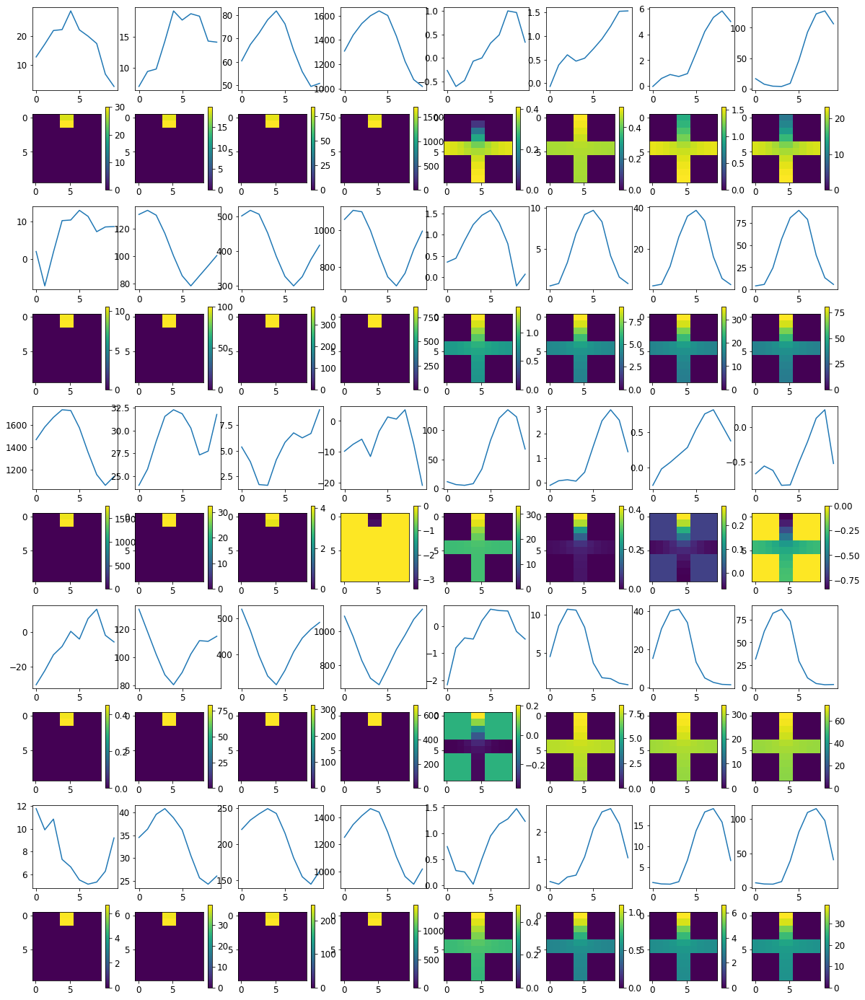


R0 generated:
[[19.426016   17.561138  ]
 [19.435202   17.449     ]
 [19.450066   17.471024  ]
 [19.442965   17.467813  ]
 [19.44488    17.492716  ]
 [19.444242   17.421515  ]
 [19.48197    17.46331   ]
 [19.477392   17.453825  ]
 [19.445335   17.388208  ]
 [19.469948   17.552296  ]
 [16.83255     0.32323197]
 [16.846512    0.31383178]
 [16.868418    0.3079967 ]
 [16.875013    0.30408815]
 [16.915222    0.3008776 ]
 [16.923323    0.30507708]
 [16.953907    0.29527456]
 [16.93797     0.29909563]
 [16.941803    0.301119  ]
 [16.988512    0.31391868]
 [16.728931    0.32941344]
 [16.829527    0.3105938 ]
 [16.875664    0.3064427 ]
 [16.874405    0.3090002 ]
 [16.85074     0.30546775]
 [16.84104     0.31678286]
 [16.877632    0.30975997]
 [16.85118     0.30023268]
 [16.87648     0.31548488]
 [16.92713     0.31584233]
 [19.745117   16.6201    ]
 [19.747189   16.542656  ]
 [19.746323   16.554607  ]
 [19.747318   16.535122  ]
 [19.7473     16.50151   ]
 [19.751663   16.437088  ]
 [19.75886   

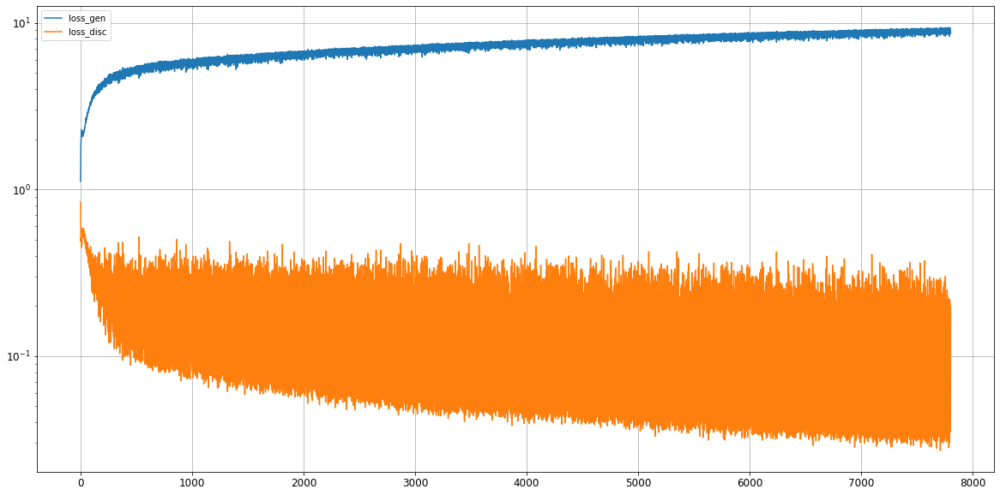

0: mean KL divergence (r,g) = 0.02763233698304074
0: mean JS divergence = 0.0075387658178527805
0: mean 1-BC divergence = 0.0059079481536162826

0: std KL divergence (r,g) = 0.04603302076479871
0: std JS divergence = 0.013416389333588612
0: std 1-BC divergence = 0.011565019963362233


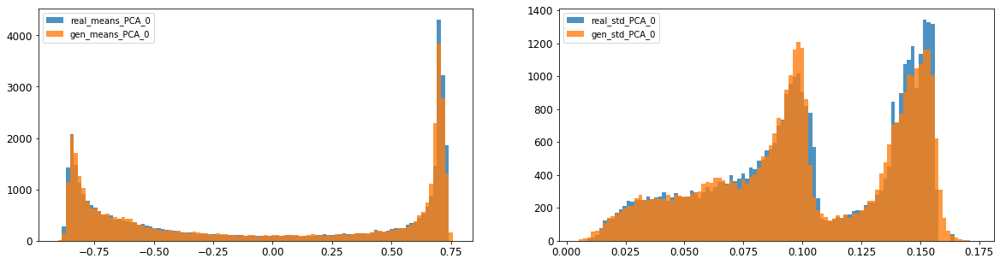

1: mean KL divergence (r,g) = 0.02587078025981533
1: mean JS divergence = 0.006337420289190642
1: mean 1-BC divergence = 0.004444821375323094

1: std KL divergence (r,g) = 0.022199337021985767
1: std JS divergence = 0.005403824443906392
1: std 1-BC divergence = 0.0037737751945519094


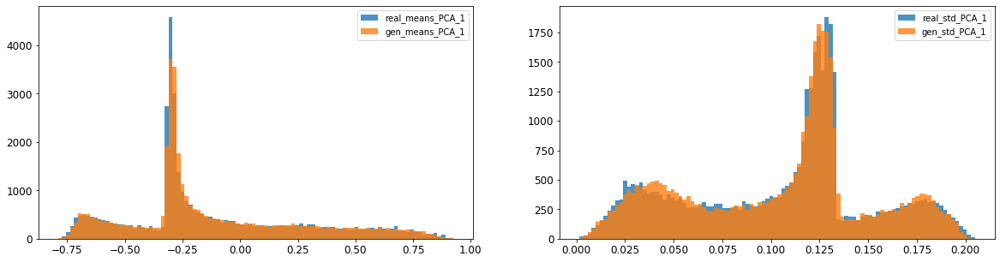

2: mean KL divergence (r,g) = 0.011150417298073447
2: mean JS divergence = 0.00275519074635953
2: mean 1-BC divergence = 0.001990257095242587


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until



2: std KL divergence (r,g) = inf
2: std JS divergence = 0.00813017016876532
2: std 1-BC divergence = 0.007022371310896336


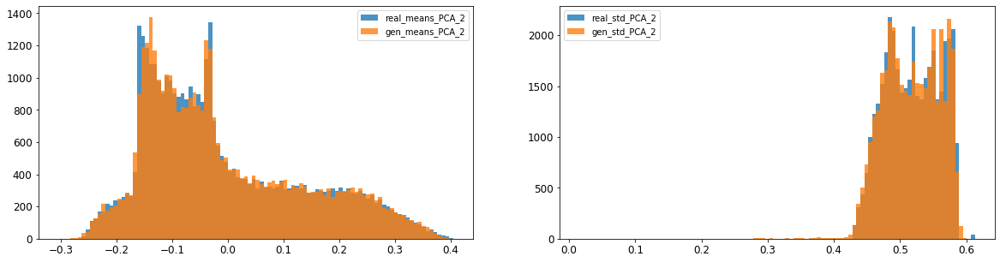

3: mean KL divergence (r,g) = 0.074033294467595
3: mean JS divergence = 0.01676157642783082
3: mean 1-BC divergence = 0.011789363017303267

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0774831031585909
3: std 1-BC divergence = 0.05833342766732663


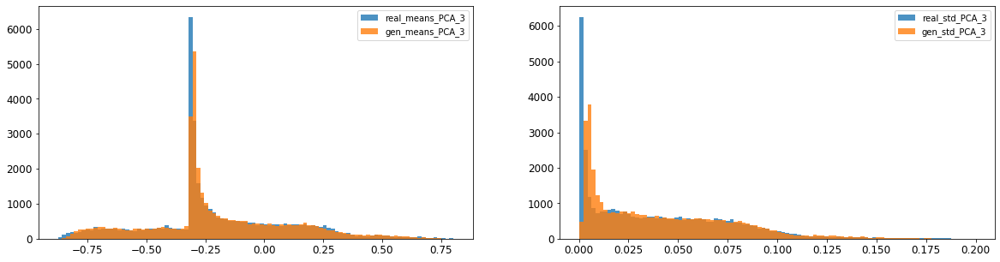

4: mean KL divergence (r,g) = 0.037589978691574585
4: mean JS divergence = 0.010183809511036465
4: mean 1-BC divergence = 0.007774332154464658

4: std KL divergence (r,g) = 0.016654371945989115
4: std JS divergence = 0.0040837170914138484
4: std 1-BC divergence = 0.002897634612464839


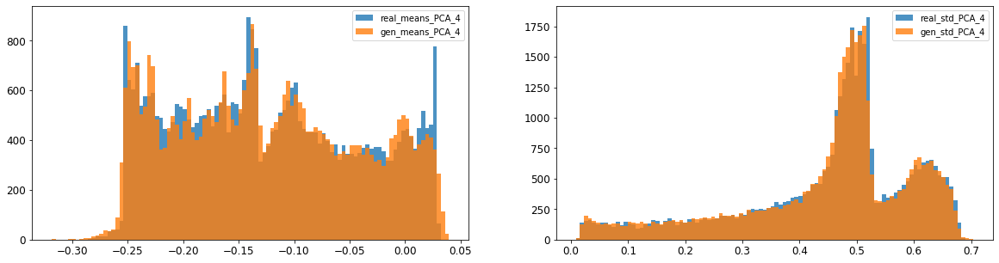

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.014985482492663064
5: mean 1-BC divergence = 0.011188210488879968

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.010244031467843438
5: std 1-BC divergence = 0.008713740657756208


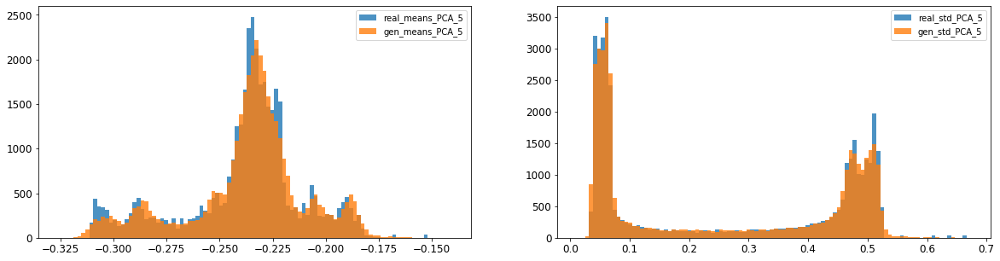

6: mean KL divergence (r,g) = 0.013864864072392588
6: mean JS divergence = 0.0034047702140940737
6: mean 1-BC divergence = 0.0024243626924530526

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.005645622349741378
6: std 1-BC divergence = 0.004128929292794958


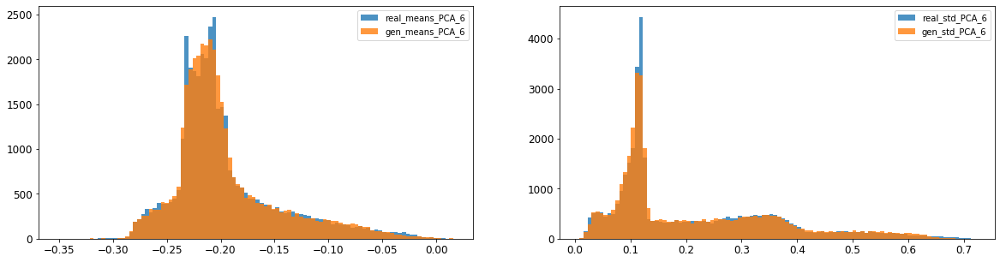

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.0211919965444394
7: mean 1-BC divergence = 0.015841645055459264

7: std KL divergence (r,g) = 0.02372560411866464
7: std JS divergence = 0.005836579886759799
7: std 1-BC divergence = 0.004097182173323999


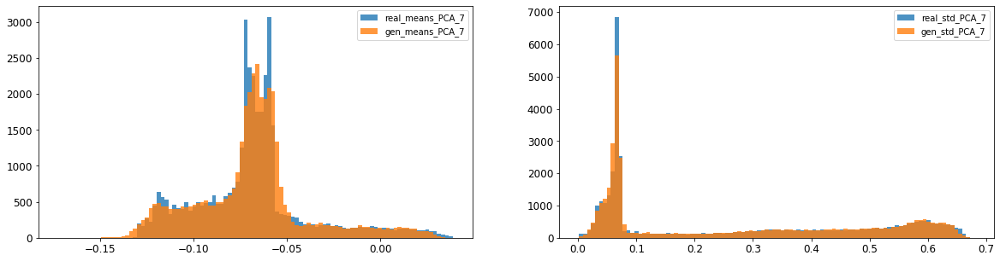

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.008902355983533287
8: mean 1-BC divergence = 0.006269731107753196

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.007564275759934571
8: std 1-BC divergence = 0.005339612273146055


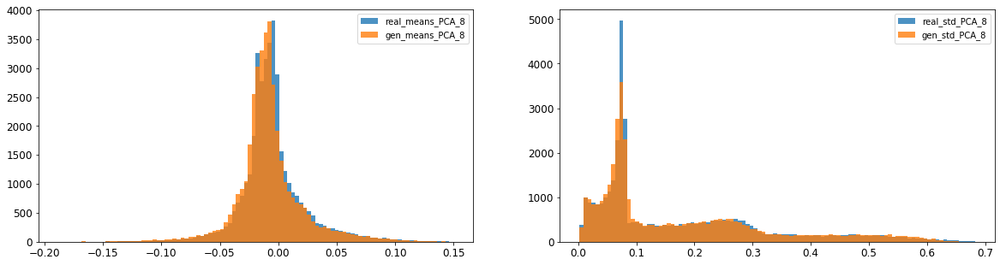

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003651854783558805
9: mean 1-BC divergence = 0.002625360642524943

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.009600606136188919
9: std 1-BC divergence = 0.006773899761814861


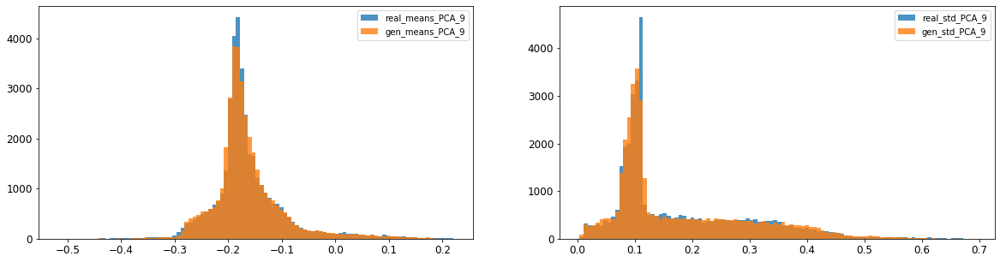

10: mean KL divergence (r,g) = inf
10: mean JS divergence = 0.006630163572102934
10: mean 1-BC divergence = 0.004664499366663133

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004276253997483017
10: std 1-BC divergence = 0.0035177214377590804


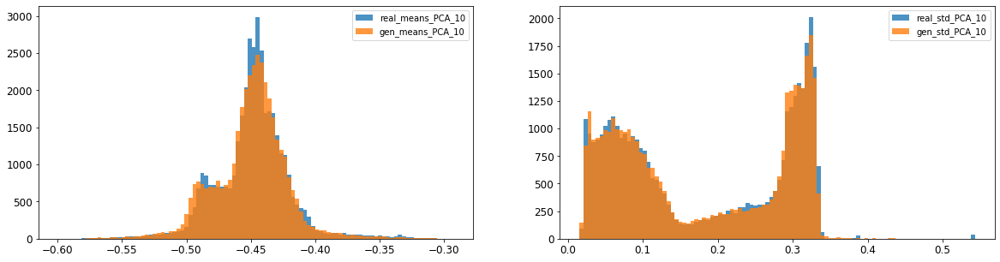

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.008297671304260186
11: mean 1-BC divergence = 0.005827233373072227

11: std KL divergence (r,g) = 0.029547257577539975
11: std JS divergence = 0.0072582482350989335
11: std 1-BC divergence = 0.005104878167474847


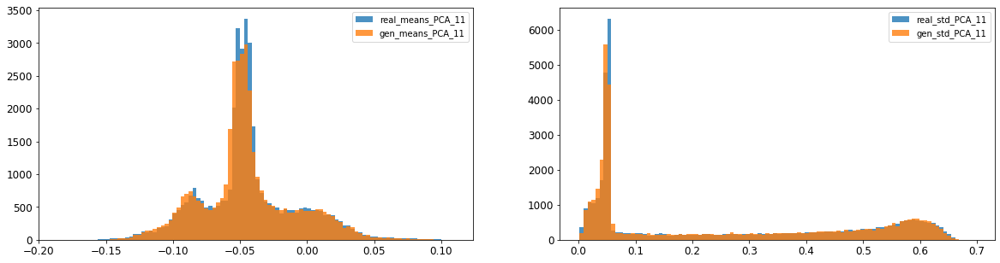

12: mean KL divergence (r,g) = 0.01675817956567609
12: mean JS divergence = 0.004176537861252412
12: mean 1-BC divergence = 0.002933352392074373

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.015745961691391686
12: std 1-BC divergence = 0.011191170326957933


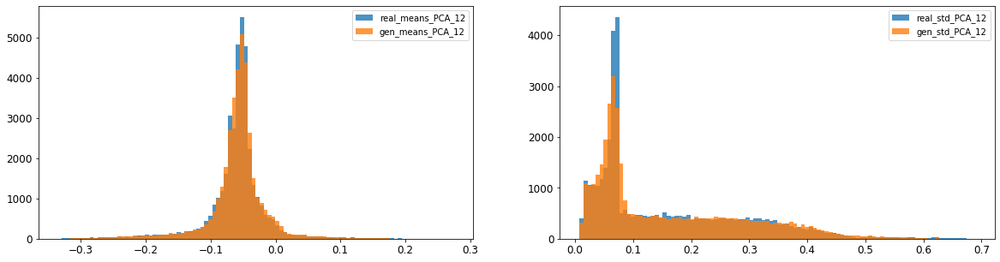

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.013776858738188107
13: mean 1-BC divergence = 0.009645037173090065

13: std KL divergence (r,g) = 0.06615679577553886
13: std JS divergence = 0.016486058011129207
13: std 1-BC divergence = 0.01155311458240782


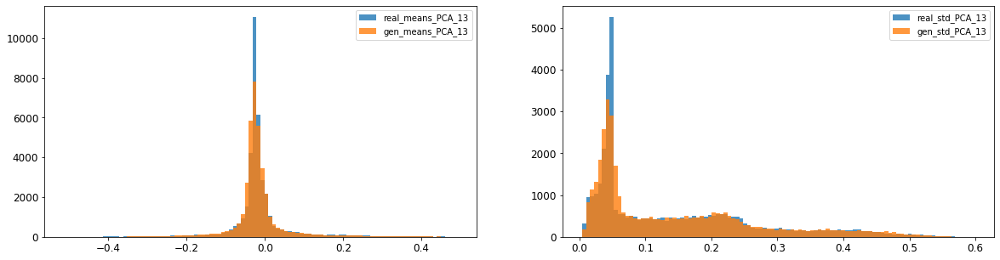

14: mean KL divergence (r,g) = 0.05298687469200052
14: mean JS divergence = 0.013476599139459724
14: mean 1-BC divergence = 0.00946157437843076

14: std KL divergence (r,g) = 0.030466124189010072
14: std JS divergence = 0.007525235824761951
14: std 1-BC divergence = 0.005241421556753112


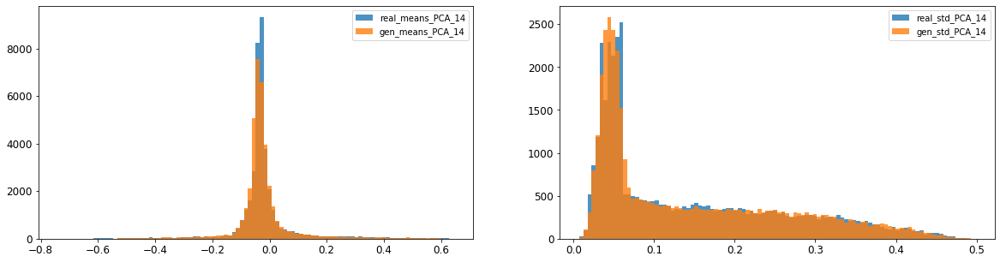

15: mean KL divergence (r,g) = 1.753053939999806
15: mean JS divergence = 0.470667365740181
15: mean 1-BC divergence = 0.4315162325771682

15: std KL divergence (r,g) = 7.40043006856608
15: std JS divergence = 0.9738161462615127
15: std 1-BC divergence = 0.9230649422222561


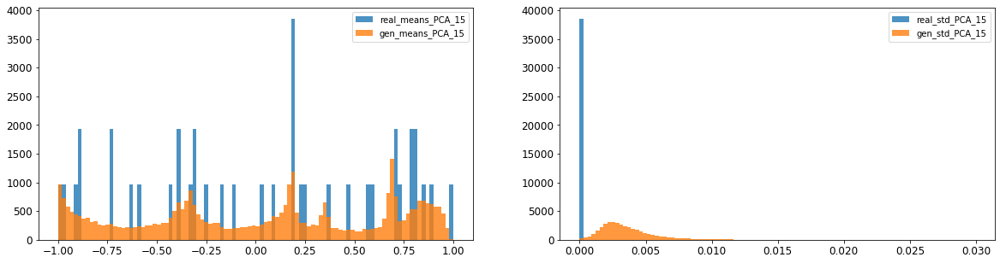

16: mean KL divergence (r,g) = 1.368600311503896
16: mean JS divergence = 0.38478676908340936
16: mean 1-BC divergence = 0.3548768244475009

16: std KL divergence (r,g) = 5.652119500805864
16: std JS divergence = 0.9293153719095192
16: std 1-BC divergence = 0.8589830732710028


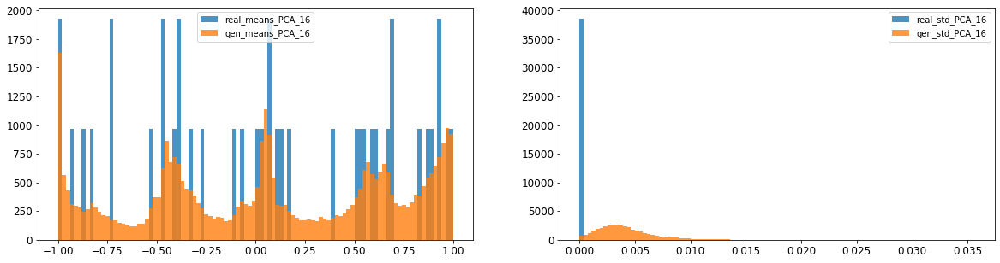



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.011359037699414008
Compose 1-BC divergence = 0.008401387581504882

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.010730320367808495
Compose weighted 1-BC divergence = 0.008499083180599887

Multivariate KL divergence = 37.32402885490558


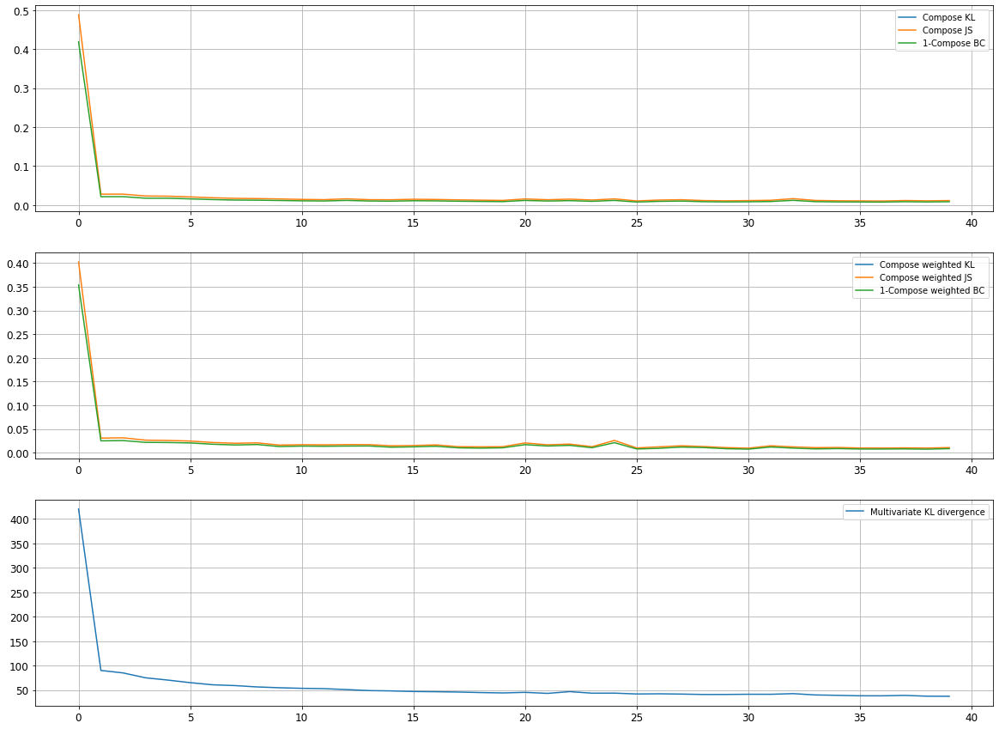

Epoch 7802/10000
discriminator loss: 0.032147 - generator loss: 9.321492 - 27s
Epoch 7803/10000
discriminator loss: 0.038010 - generator loss: 9.154332 - 28s
Epoch 7804/10000
discriminator loss: 0.218362 - generator loss: 8.538674 - 28s
Epoch 7805/10000
discriminator loss: 0.032468 - generator loss: 9.281489 - 29s
Epoch 7806/10000
discriminator loss: 0.038741 - generator loss: 9.178031 - 29s
Epoch 7807/10000
discriminator loss: 0.241410 - generator loss: 8.415614 - 29s
Epoch 7808/10000
discriminator loss: 0.031683 - generator loss: 9.125163 - 28s
Epoch 7809/10000
discriminator loss: 0.034763 - generator loss: 9.263582 - 28s
Epoch 7810/10000
discriminator loss: 0.312355 - generator loss: 8.455902 - 28s
Epoch 7811/10000
discriminator loss: 0.030918 - generator loss: 9.139838 - 29s
Epoch 7812/10000
discriminator loss: 0.042506 - generator loss: 9.082198 - 28s
Epoch 7813/10000
discriminator loss: 0.084578 - generator loss: 9.039648 - 28s
Epoch 7814/10000
discriminator loss: 0.087272 - gene

discriminator loss: 0.035688 - generator loss: 9.200968 - 28s
Epoch 7907/10000
discriminator loss: 0.291275 - generator loss: 8.548633 - 28s
Epoch 7908/10000
discriminator loss: 0.035229 - generator loss: 9.053419 - 28s
Epoch 7909/10000
discriminator loss: 0.028650 - generator loss: 9.343078 - 28s
Epoch 7910/10000
discriminator loss: 0.067669 - generator loss: 9.010421 - 28s
Epoch 7911/10000
discriminator loss: 0.043249 - generator loss: 9.240194 - 28s
Epoch 7912/10000
discriminator loss: 0.238682 - generator loss: 8.692950 - 28s
Epoch 7913/10000
discriminator loss: 0.072234 - generator loss: 9.026026 - 28s
Epoch 7914/10000
discriminator loss: 0.034142 - generator loss: 9.287516 - 28s
Epoch 7915/10000
discriminator loss: 0.290526 - generator loss: 8.653341 - 28s
Epoch 7916/10000
discriminator loss: 0.035463 - generator loss: 9.029988 - 28s
Epoch 7917/10000
discriminator loss: 0.034196 - generator loss: 9.277064 - 28s
Epoch 7918/10000
discriminator loss: 0.028975 - generator loss: 9.403

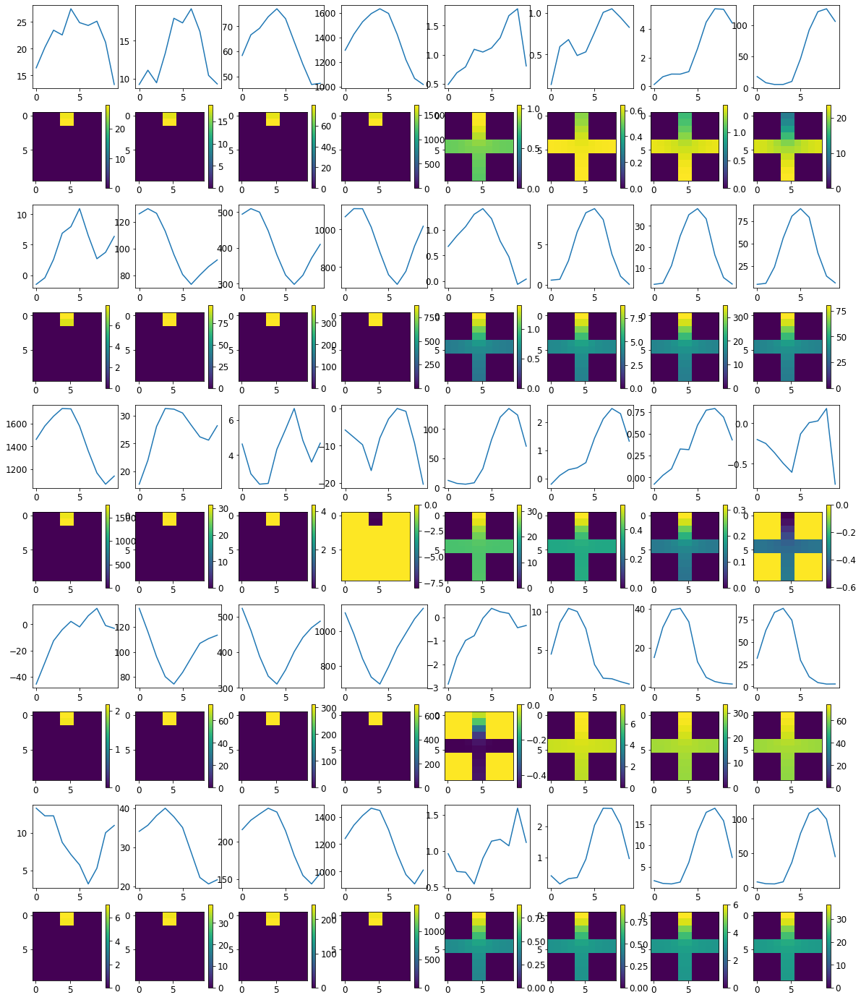


R0 generated:
[[19.506433   17.390928  ]
 [19.523746   17.280771  ]
 [19.534334   17.324995  ]
 [19.522968   17.327288  ]
 [19.509026   17.363853  ]
 [19.502283   17.289068  ]
 [19.516563   17.382053  ]
 [19.514896   17.396843  ]
 [19.484015   17.369635  ]
 [19.50091    17.51928   ]
 [17.237606    0.29662037]
 [17.243864    0.2841029 ]
 [17.236391    0.2774503 ]
 [17.232197    0.27584267]
 [17.218754    0.27462107]
 [17.218609    0.2763558 ]
 [17.185787    0.27251723]
 [17.133291    0.27552256]
 [17.141228    0.28026375]
 [17.142544    0.29176602]
 [16.988312    0.34412512]
 [17.114637    0.32517546]
 [17.151415    0.31888962]
 [17.160645    0.32520637]
 [17.118168    0.31363413]
 [17.124327    0.32316667]
 [17.129494    0.31455076]
 [17.098856    0.30341876]
 [17.111116    0.31549713]
 [17.085289    0.319759  ]
 [19.734037   16.35884   ]
 [19.736557   16.265604  ]
 [19.733515   16.232573  ]
 [19.735062   16.153168  ]
 [19.732727   16.10763   ]
 [19.736412   16.011211  ]
 [19.74345   

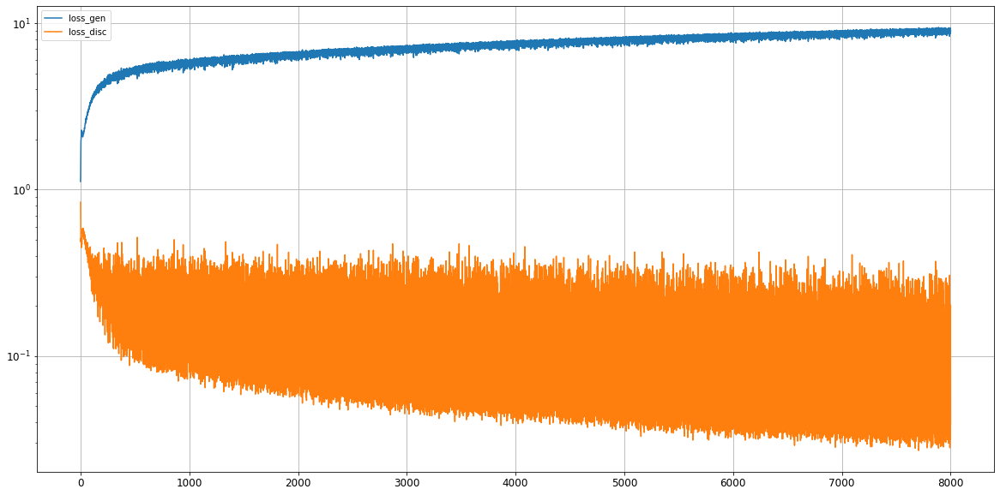

0: mean KL divergence (r,g) = 0.02836168999334769
0: mean JS divergence = 0.007337791676238041
0: mean 1-BC divergence = 0.005357216031268153

0: std KL divergence (r,g) = 0.04293399367753123
0: std JS divergence = 0.011658526683946574
0: std 1-BC divergence = 0.00959880766719734


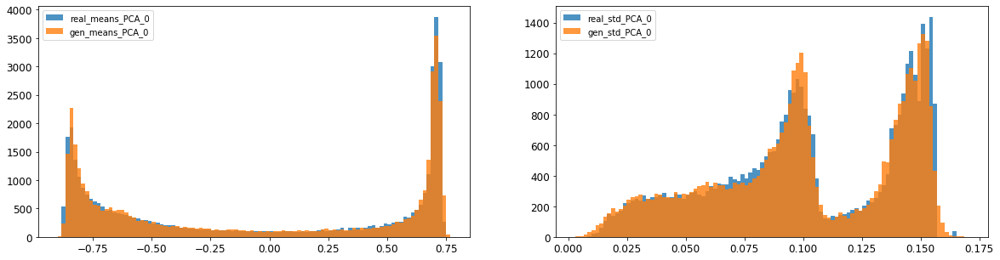

1: mean KL divergence (r,g) = 0.02850211605539215
1: mean JS divergence = 0.007304046945202271
1: mean 1-BC divergence = 0.005101416239093104

1: std KL divergence (r,g) = 0.03661977230728613
1: std JS divergence = 0.008746411752363147
1: std 1-BC divergence = 0.006096587930812247


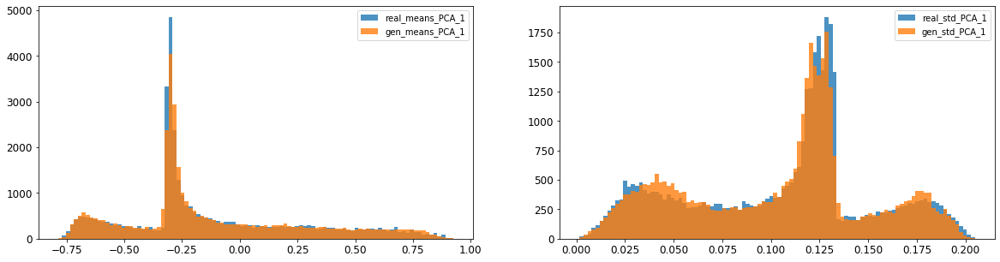

2: mean KL divergence (r,g) = 0.012094689905650316
2: mean JS divergence = 0.0030226961704907926
2: mean 1-BC divergence = 0.002216156965431204

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.01002810996955647
2: std 1-BC divergence = 0.008327693932212554


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


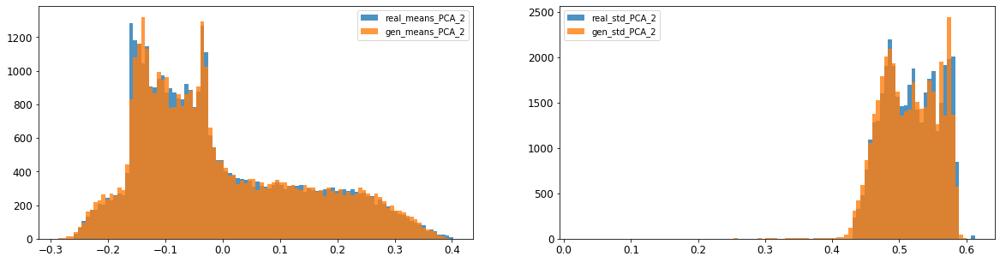

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.008349529015455461
3: mean 1-BC divergence = 0.005894067706814887

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.04512967954303188
3: std 1-BC divergence = 0.03207867750695759


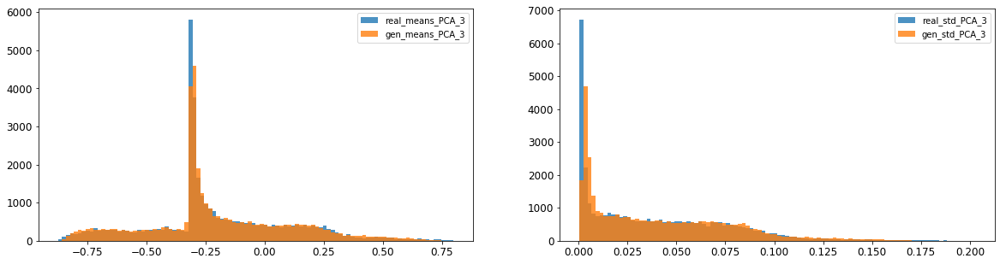

4: mean KL divergence (r,g) = 0.03566166855113529
4: mean JS divergence = 0.010471230483286346
4: mean 1-BC divergence = 0.00851007372085033

4: std KL divergence (r,g) = 0.015651976837323552
4: std JS divergence = 0.003835030007693279
4: std 1-BC divergence = 0.0026971572472853644


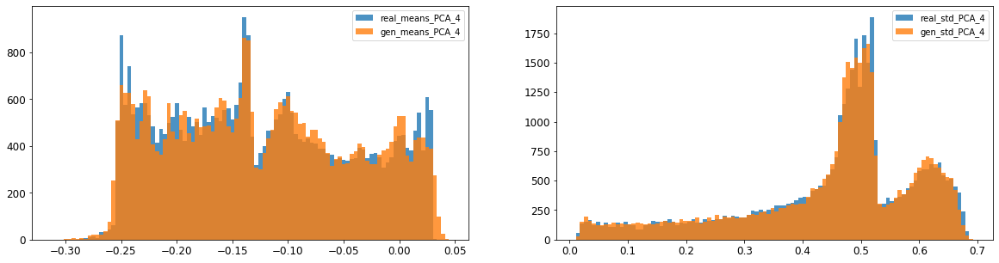

5: mean KL divergence (r,g) = 0.06806077690224895
5: mean JS divergence = 0.01674734653846762
5: mean 1-BC divergence = 0.0120322637035859

5: std KL divergence (r,g) = 0.04206049608939117
5: std JS divergence = 0.011503350455120798
5: std 1-BC divergence = 0.010085254103195163


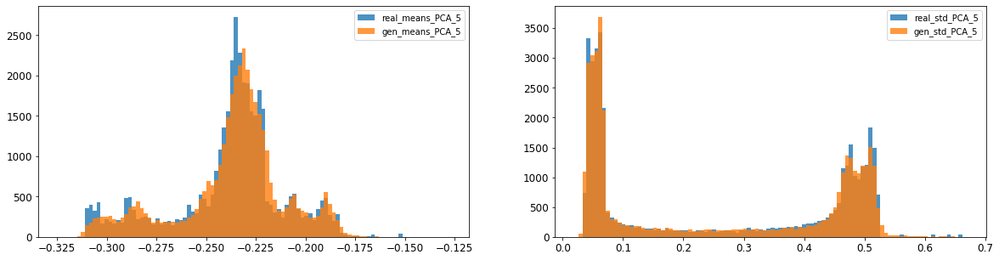

6: mean KL divergence (r,g) = 0.018149023581165397
6: mean JS divergence = 0.004525052460115534
6: mean 1-BC divergence = 0.0032285739747001108

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.006999647945372865
6: std 1-BC divergence = 0.004981499970093006


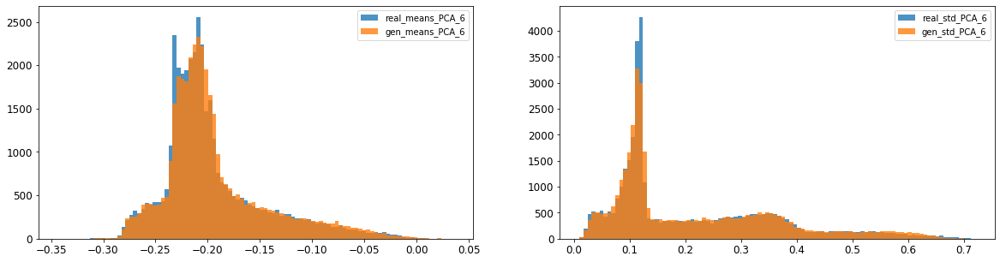

7: mean KL divergence (r,g) = 0.052442332777903035
7: mean JS divergence = 0.013934455283928098
7: mean 1-BC divergence = 0.010331425113946469

7: std KL divergence (r,g) = 0.023688383468454713
7: std JS divergence = 0.005672140289576436
7: std 1-BC divergence = 0.0039814275744305405


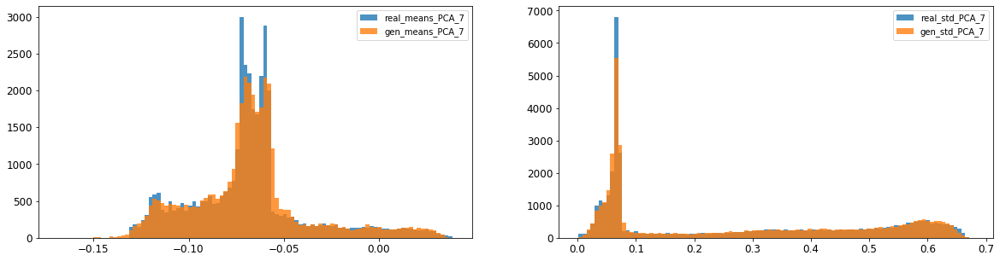

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0026127690325295537
8: mean 1-BC divergence = 0.0018382183990376388

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008435596055453833
8: std 1-BC divergence = 0.005970581841651779


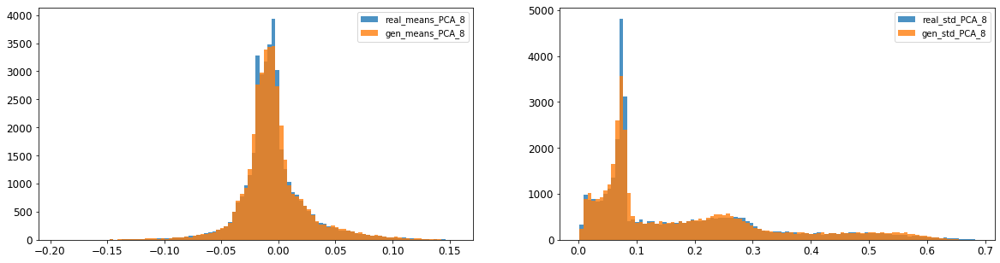

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.005670433559798293
9: mean 1-BC divergence = 0.004006491423875436

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.011052199491277902
9: std 1-BC divergence = 0.007859862078154145


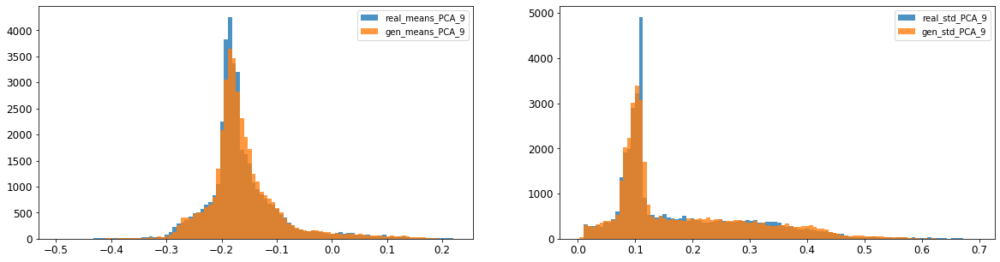

10: mean KL divergence (r,g) = 0.02974033452142921
10: mean JS divergence = 0.007508293197290805
10: mean 1-BC divergence = 0.005248853525196551

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004909961581147194
10: std 1-BC divergence = 0.004088434686368547


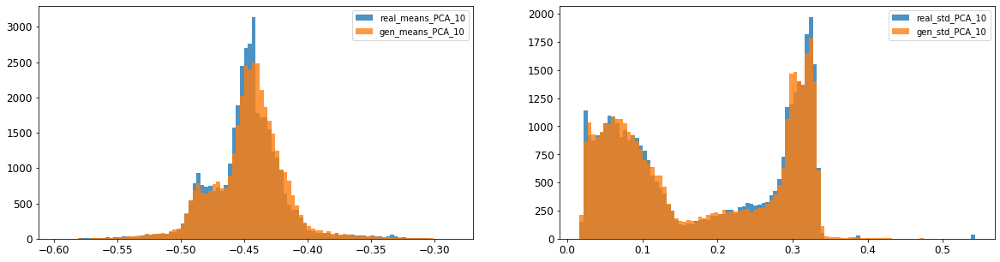

11: mean KL divergence (r,g) = 0.022962933410476085
11: mean JS divergence = 0.005818771398309081
11: mean 1-BC divergence = 0.004106323212782703

11: std KL divergence (r,g) = 0.04682644282253282
11: std JS divergence = 0.012624795548818804
11: std 1-BC divergence = 0.009050085481765446


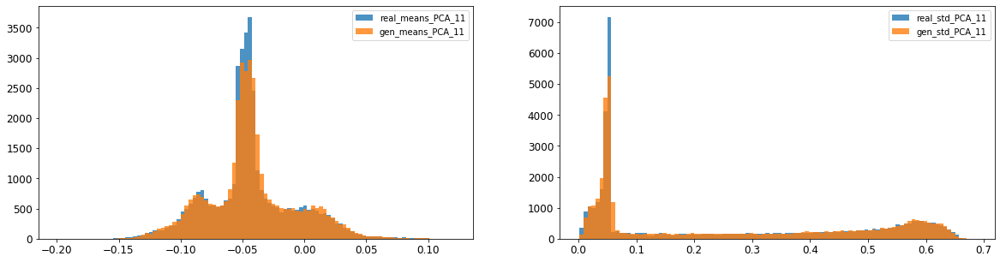

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.007343645081107985
12: mean 1-BC divergence = 0.005153465338921248

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01708672042277811
12: std 1-BC divergence = 0.012167254026623886


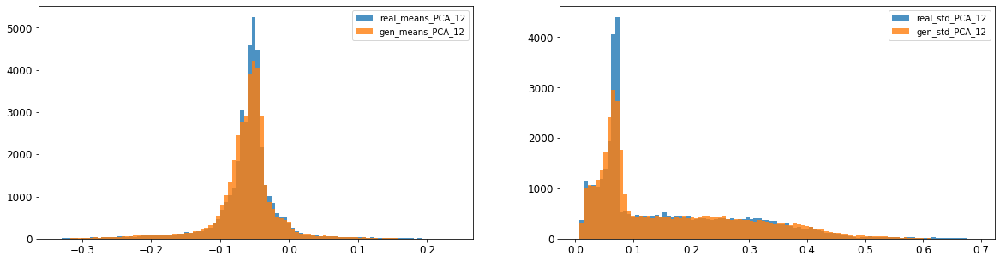

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.0149610780405139
13: mean 1-BC divergence = 0.010442144310479073

13: std KL divergence (r,g) = 0.0718637721395365
13: std JS divergence = 0.01749285515813066
13: std 1-BC divergence = 0.012264522139313838


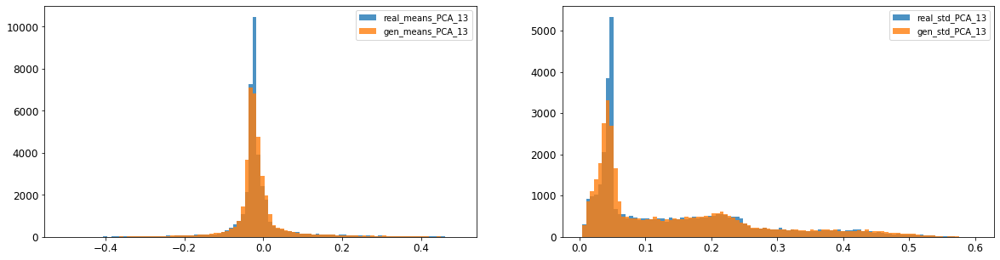

14: mean KL divergence (r,g) = 0.0459642638971754
14: mean JS divergence = 0.011426516332683594
14: mean 1-BC divergence = 0.007977763091654988

14: std KL divergence (r,g) = 0.026364799119598725
14: std JS divergence = 0.006653954928373138
14: std 1-BC divergence = 0.004646932176860408


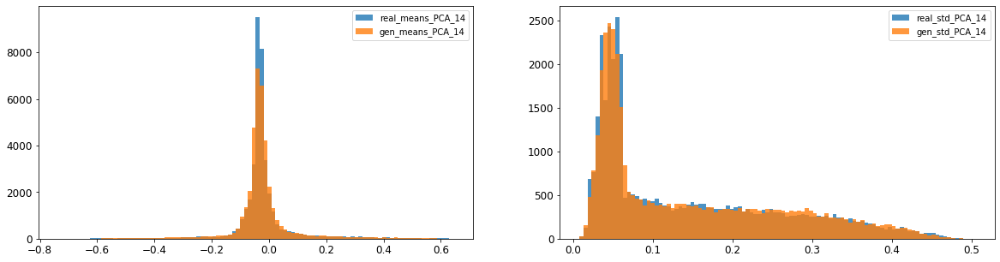

15: mean KL divergence (r,g) = 1.6666919925124863
15: mean JS divergence = 0.44591812091533056
15: mean 1-BC divergence = 0.40952909378023106

15: std KL divergence (r,g) = 7.068413156055134
15: std JS divergence = 0.9682732771961582
15: std 1-BC divergence = 0.9136827075607705


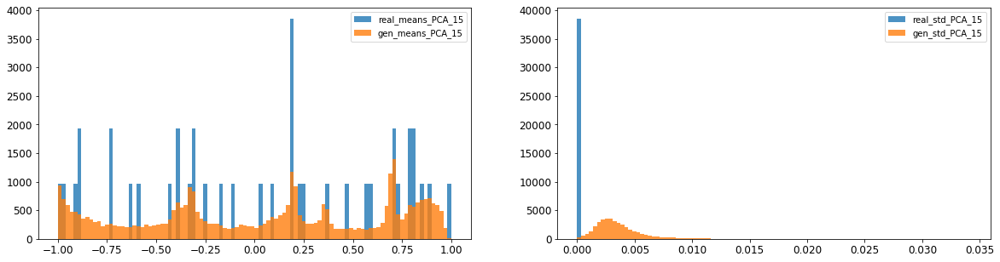

16: mean KL divergence (r,g) = 1.3676210745635657
16: mean JS divergence = 0.3826477252524825
16: mean 1-BC divergence = 0.35258385402092485

16: std KL divergence (r,g) = 5.696101682192226
16: std JS divergence = 0.9310176776330973
16: std 1-BC divergence = 0.8611163033161593


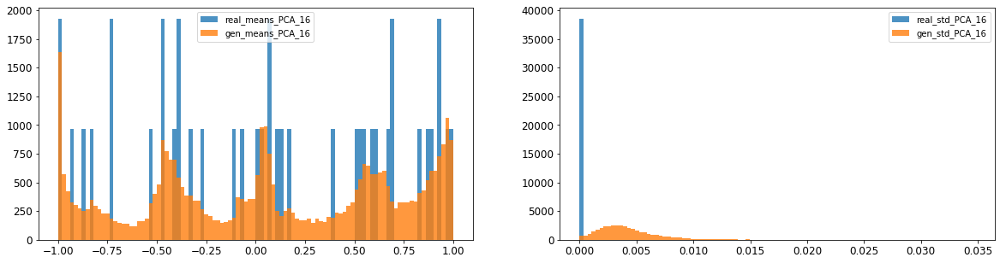



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010295421168268615
Compose 1-BC divergence = 0.007511307704018866

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.00970685586047601
Compose weighted 1-BC divergence = 0.007379596887757134

Multivariate KL divergence = 37.058392356719324


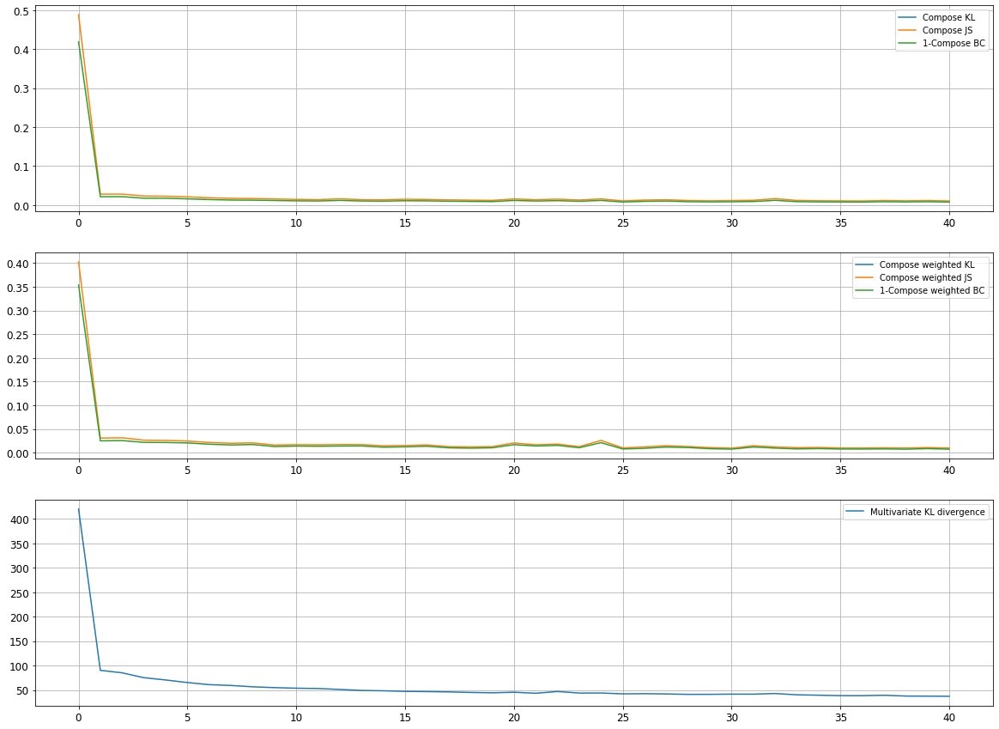

Epoch 8002/10000
discriminator loss: 0.032055 - generator loss: 9.276012 - 28s
Epoch 8003/10000
discriminator loss: 0.029056 - generator loss: 9.309319 - 28s
Epoch 8004/10000
discriminator loss: 0.234274 - generator loss: 8.619643 - 28s
Epoch 8005/10000
discriminator loss: 0.037514 - generator loss: 9.156238 - 28s
Epoch 8006/10000
discriminator loss: 0.030716 - generator loss: 9.300845 - 29s
Epoch 8007/10000
discriminator loss: 0.230223 - generator loss: 8.978930 - 29s
Epoch 8008/10000
discriminator loss: 0.042337 - generator loss: 8.867234 - 29s
Epoch 8009/10000
discriminator loss: 0.029829 - generator loss: 9.276573 - 29s
Epoch 8010/10000
discriminator loss: 0.240734 - generator loss: 8.592981 - 29s
Epoch 8011/10000
discriminator loss: 0.033113 - generator loss: 9.118671 - 29s
Epoch 8012/10000
discriminator loss: 0.032977 - generator loss: 9.312566 - 28s
Epoch 8013/10000
discriminator loss: 0.066558 - generator loss: 9.302206 - 29s
Epoch 8014/10000
discriminator loss: 0.135843 - gene

discriminator loss: 0.180985 - generator loss: 8.783238 - 23s
Epoch 8107/10000
discriminator loss: 0.070321 - generator loss: 9.046281 - 23s
Epoch 8108/10000
discriminator loss: 0.031588 - generator loss: 9.329452 - 23s
Epoch 8109/10000
discriminator loss: 0.216780 - generator loss: 9.062449 - 23s
Epoch 8110/10000
discriminator loss: 0.043642 - generator loss: 8.907409 - 23s
Epoch 8111/10000
discriminator loss: 0.030713 - generator loss: 9.360256 - 23s
Epoch 8112/10000
discriminator loss: 0.170801 - generator loss: 8.816209 - 23s
Epoch 8113/10000
discriminator loss: 0.034075 - generator loss: 9.242369 - 23s
Epoch 8114/10000
discriminator loss: 0.038348 - generator loss: 9.314837 - 22s
Epoch 8115/10000
discriminator loss: 0.283777 - generator loss: 8.335264 - 22s
Epoch 8116/10000
discriminator loss: 0.030218 - generator loss: 9.295776 - 23s
Epoch 8117/10000
discriminator loss: 0.029699 - generator loss: 9.495729 - 23s
Epoch 8118/10000
discriminator loss: 0.247746 - generator loss: 8.965

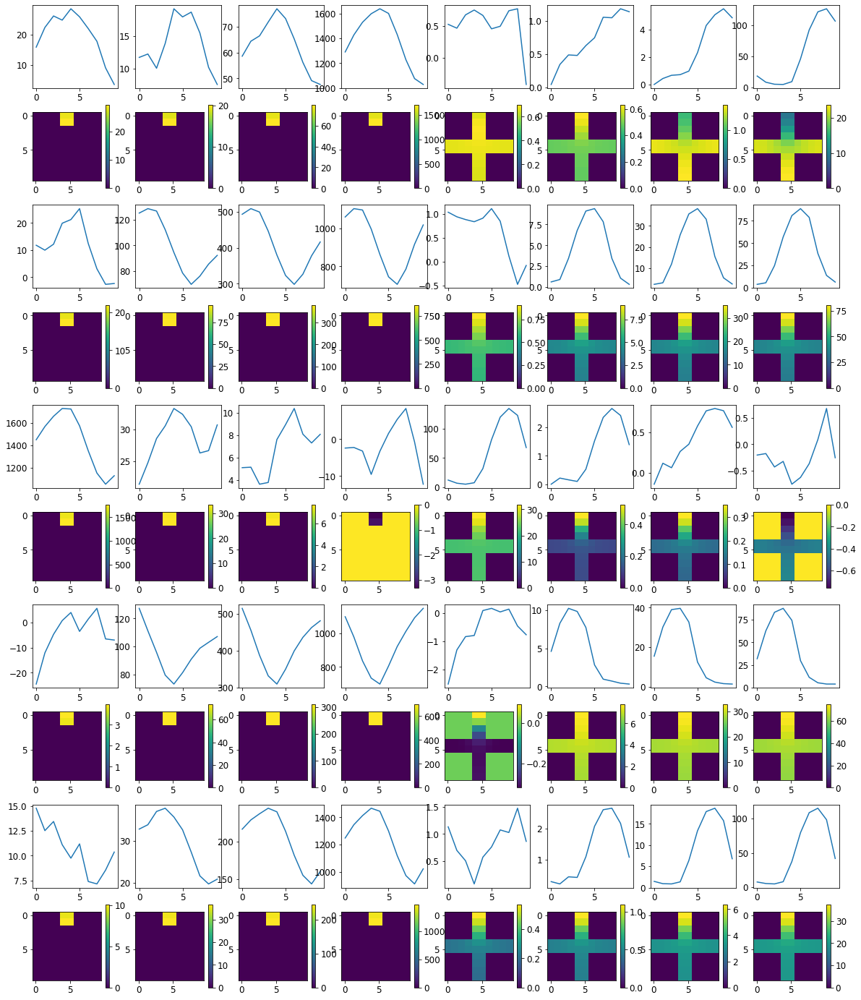


R0 generated:
[[19.470242   17.645853  ]
 [19.494625   17.566603  ]
 [19.502846   17.584694  ]
 [19.500916   17.586153  ]
 [19.49639    17.631565  ]
 [19.494326   17.55588   ]
 [19.514252   17.640467  ]
 [19.516985   17.624102  ]
 [19.483875   17.610926  ]
 [19.511671   17.76654   ]
 [17.134039    0.32263896]
 [17.16165     0.30968827]
 [17.127457    0.3025196 ]
 [17.145784    0.30113006]
 [17.137545    0.3010986 ]
 [17.148846    0.30088693]
 [17.157534    0.29722387]
 [17.152136    0.30170268]
 [17.164988    0.30856928]
 [17.195452    0.32400808]
 [16.761257    0.29470485]
 [16.879131    0.28046784]
 [16.86948     0.2748001 ]
 [16.901031    0.27632838]
 [16.880875    0.27199653]
 [16.930285    0.27829403]
 [16.936266    0.27194464]
 [16.915117    0.26507628]
 [16.903196    0.27419075]
 [17.01173     0.27834186]
 [19.755924   16.522837  ]
 [19.763754   16.47519   ]
 [19.76162    16.448946  ]
 [19.76628    16.396324  ]
 [19.76895    16.41478   ]
 [19.773275   16.302588  ]
 [19.777786  

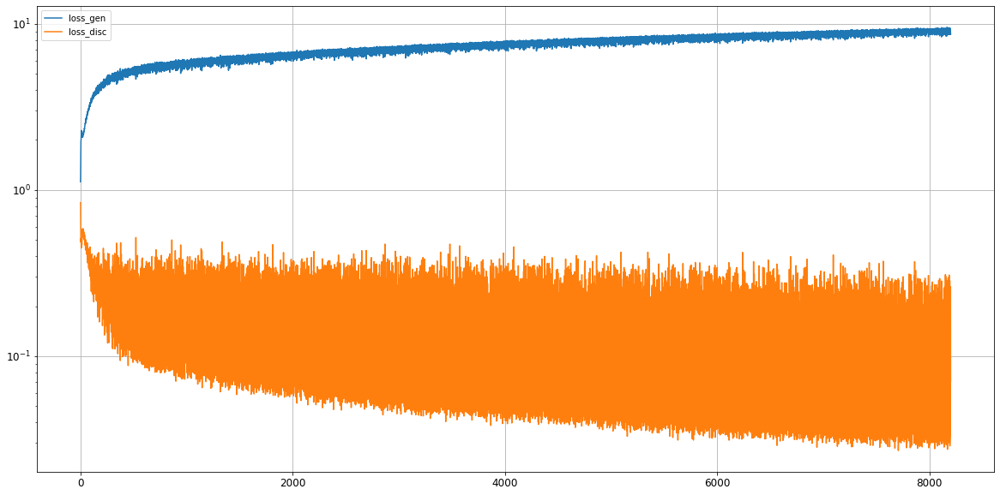

0: mean KL divergence (r,g) = 0.019263156771928542
0: mean JS divergence = 0.004872905567372113
0: mean 1-BC divergence = 0.0034816067043150767

0: std KL divergence (r,g) = 0.05255206287049873
0: std JS divergence = 0.01634664159490819
0: std 1-BC divergence = 0.014867333766545587


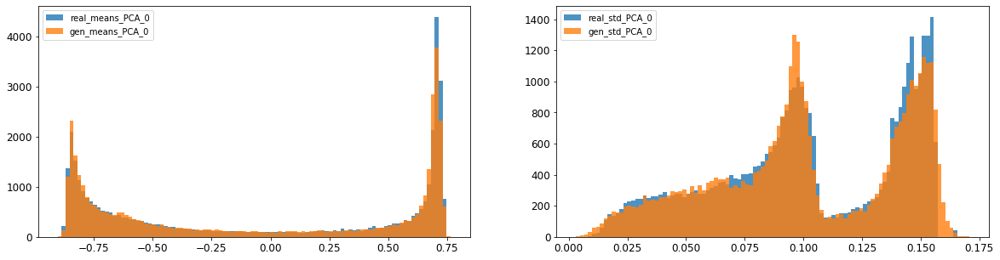

1: mean KL divergence (r,g) = 0.017837217380367247
1: mean JS divergence = 0.0045074314557640854
1: mean 1-BC divergence = 0.003187518117268584

1: std KL divergence (r,g) = 0.060520259756233444
1: std JS divergence = 0.013077882989997226
1: std 1-BC divergence = 0.009230405911423656


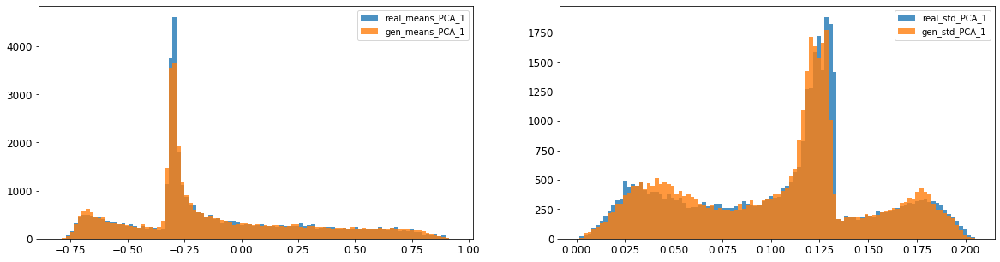

2: mean KL divergence (r,g) = 0.01388045105453842
2: mean JS divergence = 0.0035188524237614862
2: mean 1-BC divergence = 0.0025227610003055734

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.008780066403027751
2: std 1-BC divergence = 0.007452953079436497


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


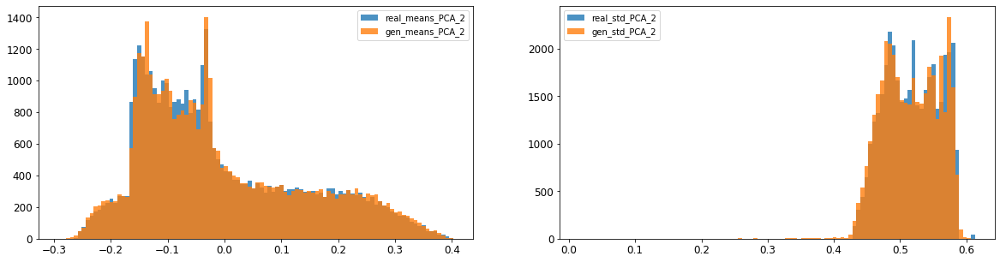

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.015596406194391562
3: mean 1-BC divergence = 0.011099815750033382

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.04678353358170783
3: std 1-BC divergence = 0.033252078764506976


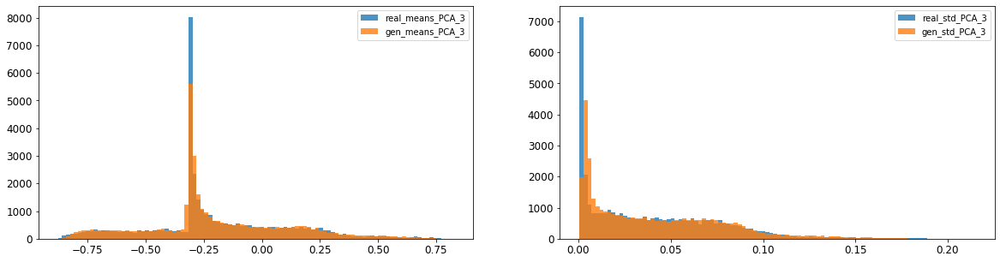

4: mean KL divergence (r,g) = 0.04258491299938619
4: mean JS divergence = 0.012179843763110139
4: mean 1-BC divergence = 0.009664679030196743

4: std KL divergence (r,g) = 0.018767537681838926
4: std JS divergence = 0.00458650448719841
4: std 1-BC divergence = 0.0032719234906665173


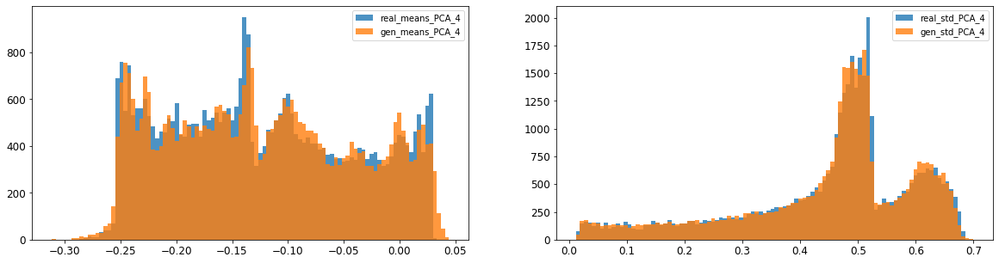

5: mean KL divergence (r,g) = 0.05087416117392872
5: mean JS divergence = 0.012438514320783302
5: mean 1-BC divergence = 0.009233597460228449

5: std KL divergence (r,g) = inf
5: std JS divergence = 0.0146293478529457
5: std 1-BC divergence = 0.012616592919413416


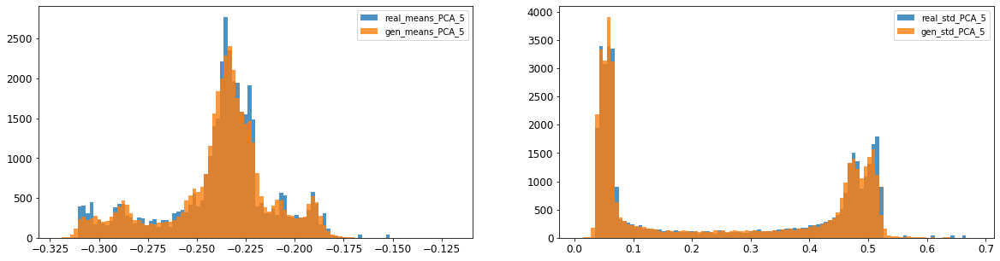

6: mean KL divergence (r,g) = 0.020513367032037263
6: mean JS divergence = 0.005205420603943887
6: mean 1-BC divergence = 0.00366131680608206

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.00887240453993701
6: std 1-BC divergence = 0.0063885022101123345


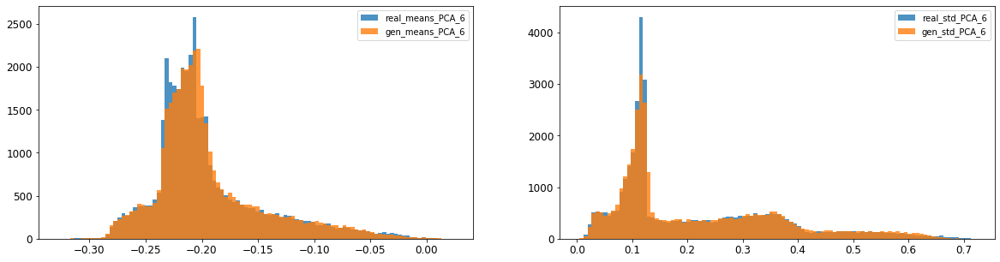

7: mean KL divergence (r,g) = 0.05678502493133301
7: mean JS divergence = 0.014030101615126245
7: mean 1-BC divergence = 0.010441271628197746

7: std KL divergence (r,g) = 0.022794723400595632
7: std JS divergence = 0.005560711638882692
7: std 1-BC divergence = 0.003904912207481681


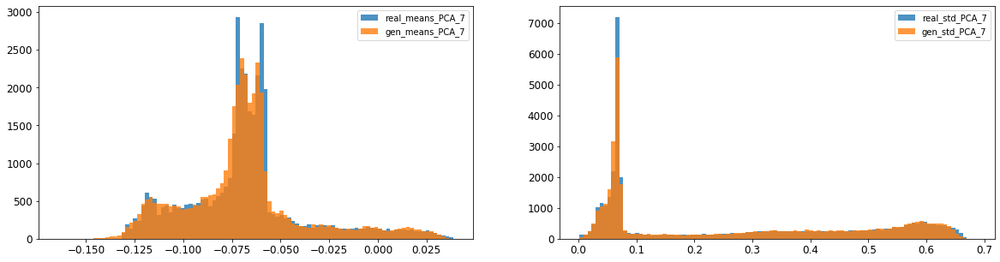

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.003827881722979496
8: mean 1-BC divergence = 0.002713957798401334

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008561946025691665
8: std 1-BC divergence = 0.006151850141167481


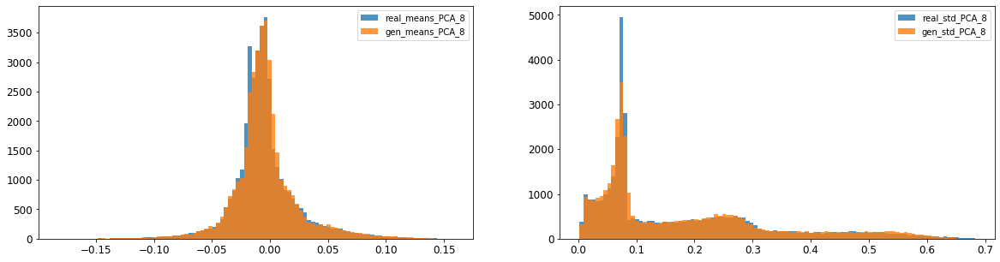

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.00452923545451688
9: mean 1-BC divergence = 0.0033365011147055146

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010346402388052333
9: std 1-BC divergence = 0.007320585344164354


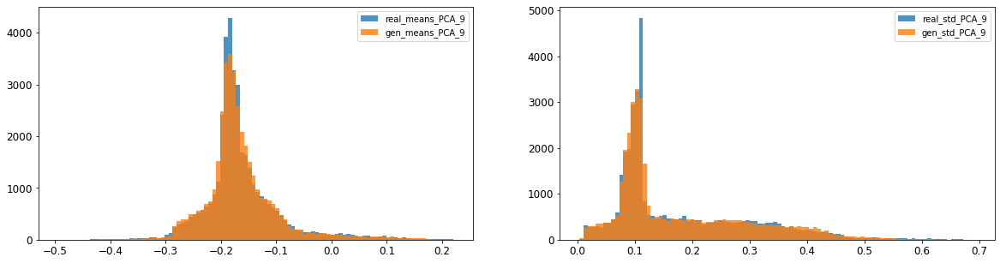

10: mean KL divergence (r,g) = 0.030474569582976663
10: mean JS divergence = 0.007581545602067316
10: mean 1-BC divergence = 0.0053307344238211485

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005621771926620922
10: std 1-BC divergence = 0.004655125070957


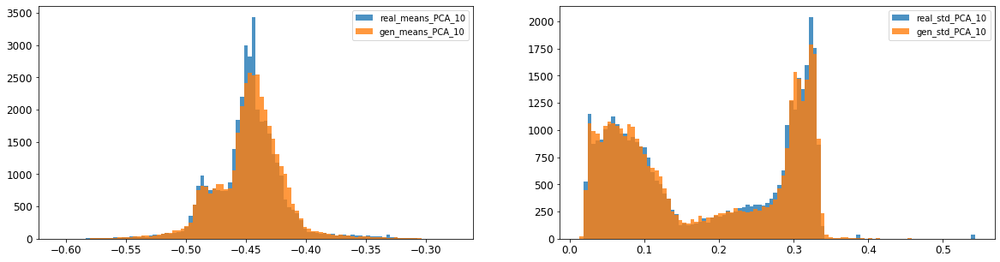

11: mean KL divergence (r,g) = 0.023606165649443497
11: mean JS divergence = 0.006140591109198029
11: mean 1-BC divergence = 0.004378380447598862

11: std KL divergence (r,g) = 0.038428148188879345
11: std JS divergence = 0.009972680264113968
11: std 1-BC divergence = 0.0070379130607555185


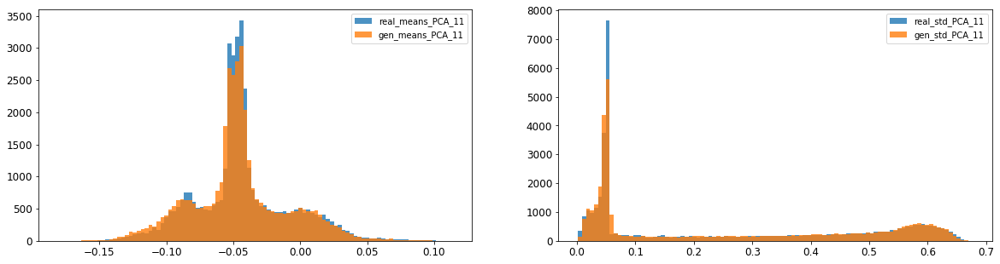

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.012323166661757819
12: mean 1-BC divergence = 0.008689854356408788

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.015338988353379428
12: std 1-BC divergence = 0.010960606438011222


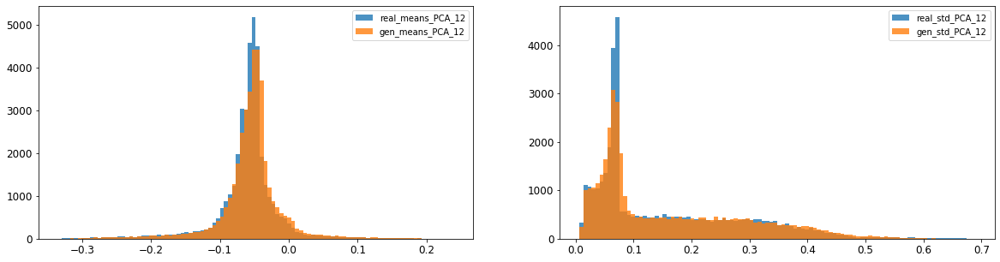

13: mean KL divergence (r,g) = 0.05120466365053044
13: mean JS divergence = 0.012762962578847526
13: mean 1-BC divergence = 0.008914071912653365

13: std KL divergence (r,g) = 0.06736781217284808
13: std JS divergence = 0.01655095502241614
13: std 1-BC divergence = 0.01159737141470274


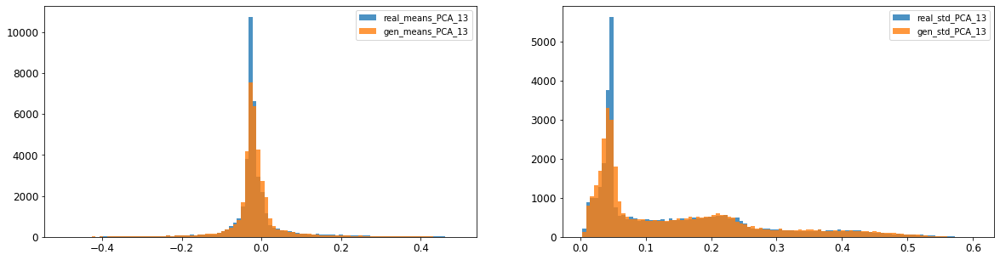

14: mean KL divergence (r,g) = 0.048230856334658484
14: mean JS divergence = 0.012111899661285522
14: mean 1-BC divergence = 0.008483484850329459

14: std KL divergence (r,g) = 0.027525136096389596
14: std JS divergence = 0.006888914903689941
14: std 1-BC divergence = 0.004810188031581841


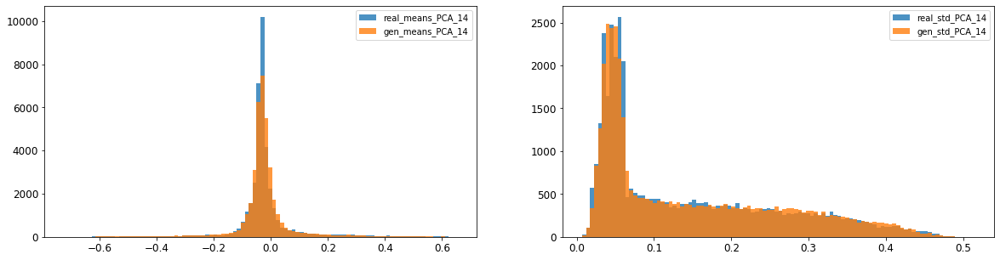

15: mean KL divergence (r,g) = 1.7139186236152026
15: mean JS divergence = 0.4568165374925775
15: mean 1-BC divergence = 0.4185258097384297

15: std KL divergence (r,g) = 7.773888464093525
15: std JS divergence = 0.9789369432801964
15: std 1-BC divergence = 0.9324052144293308


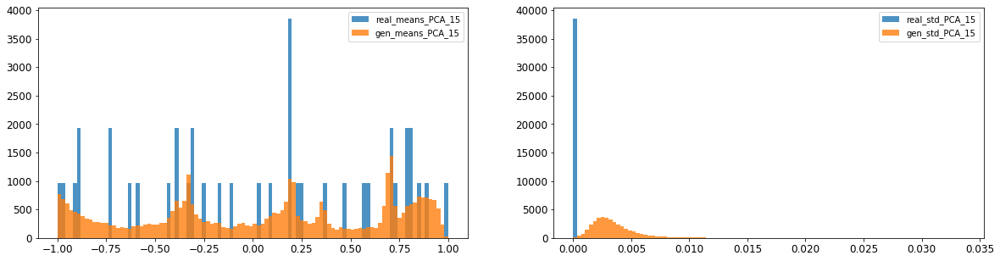

16: mean KL divergence (r,g) = 1.3639715345723036
16: mean JS divergence = 0.3848371717973379
16: mean 1-BC divergence = 0.35479478749906546

16: std KL divergence (r,g) = 5.0772370064421395
16: std JS divergence = 0.9031232474211006
16: std 1-BC divergence = 0.8278925448555373


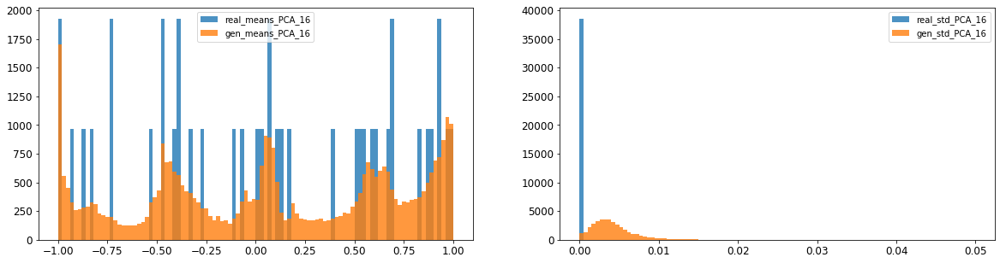



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.01078485035691582
Compose 1-BC divergence = 0.00795526310838246

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.010725192520074096
Compose weighted 1-BC divergence = 0.008626206024187844

Multivariate KL divergence = 36.52220399048221


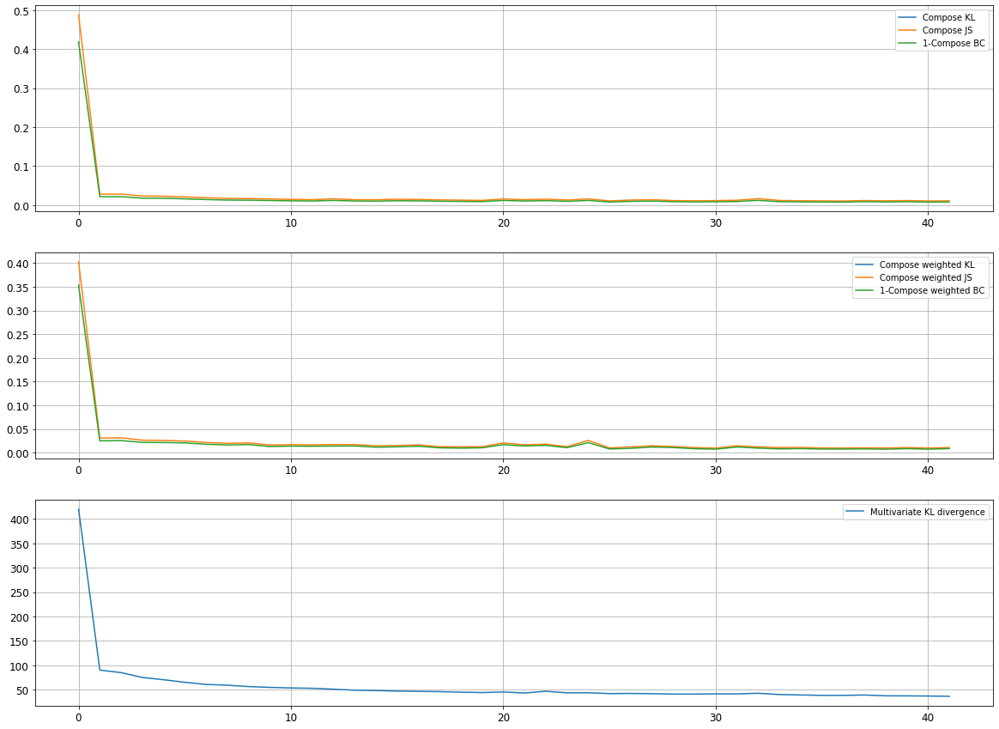

Epoch 8202/10000
discriminator loss: 0.032383 - generator loss: 9.402751 - 28s
Epoch 8203/10000
discriminator loss: 0.033135 - generator loss: 9.387767 - 28s
Epoch 8204/10000
discriminator loss: 0.144385 - generator loss: 8.820398 - 29s
Epoch 8205/10000
discriminator loss: 0.029088 - generator loss: 9.354029 - 29s
Epoch 8206/10000
discriminator loss: 0.171495 - generator loss: 8.851317 - 29s
Epoch 8207/10000
discriminator loss: 0.034033 - generator loss: 9.418714 - 29s
Epoch 8208/10000
discriminator loss: 0.153039 - generator loss: 9.294762 - 29s
Epoch 8209/10000
discriminator loss: 0.078767 - generator loss: 8.757518 - 29s
Epoch 8210/10000
discriminator loss: 0.036301 - generator loss: 9.213370 - 29s
Epoch 8211/10000
discriminator loss: 0.269548 - generator loss: 8.726832 - 29s
Epoch 8212/10000
discriminator loss: 0.035882 - generator loss: 9.120269 - 28s
Epoch 8213/10000
discriminator loss: 0.029549 - generator loss: 9.453969 - 28s
Epoch 8214/10000
discriminator loss: 0.032938 - gene

discriminator loss: 0.028503 - generator loss: 9.479662 - 23s
Epoch 8307/10000
discriminator loss: 0.310793 - generator loss: 8.873151 - 23s
Epoch 8308/10000
discriminator loss: 0.038101 - generator loss: 9.144420 - 23s
Epoch 8309/10000
discriminator loss: 0.029792 - generator loss: 9.468493 - 23s
Epoch 8310/10000
discriminator loss: 0.035251 - generator loss: 9.317369 - 23s
Epoch 8311/10000
discriminator loss: 0.240243 - generator loss: 8.632767 - 23s
Epoch 8312/10000
discriminator loss: 0.030519 - generator loss: 9.449933 - 23s
Epoch 8313/10000
discriminator loss: 0.031812 - generator loss: 9.421112 - 23s
Epoch 8314/10000
discriminator loss: 0.282086 - generator loss: 8.456479 - 23s
Epoch 8315/10000
discriminator loss: 0.029946 - generator loss: 9.390903 - 23s
Epoch 8316/10000
discriminator loss: 0.032110 - generator loss: 9.423047 - 23s
Epoch 8317/10000
discriminator loss: 0.026924 - generator loss: 9.564482 - 23s
Epoch 8318/10000
discriminator loss: 0.198321 - generator loss: 8.635

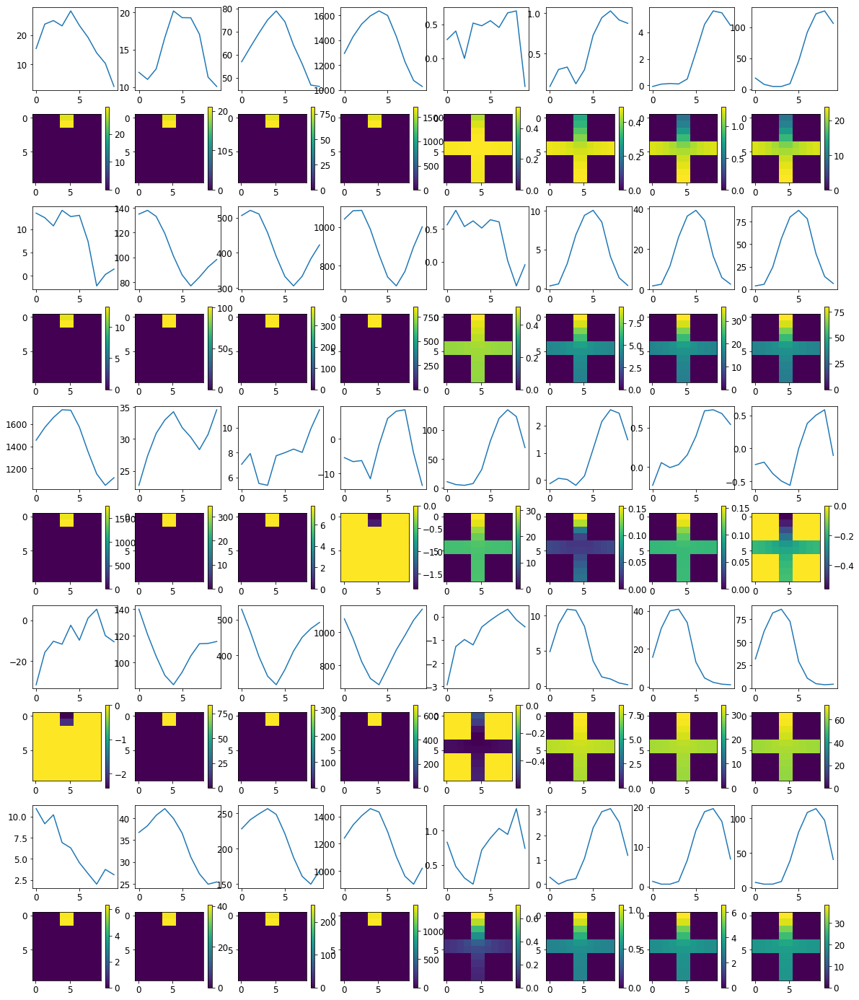


R0 generated:
[[19.361355   17.914984  ]
 [19.388205   17.825584  ]
 [19.407316   17.813372  ]
 [19.396763   17.8005    ]
 [19.37925    17.798563  ]
 [19.371178   17.735691  ]
 [19.400358   17.782095  ]
 [19.394838   17.794186  ]
 [19.352736   17.815939  ]
 [19.39541    17.955643  ]
 [16.8868      0.3672562 ]
 [16.940716    0.35244307]
 [16.989517    0.34746104]
 [16.977888    0.34828147]
 [16.98745     0.3446184 ]
 [16.981241    0.34580213]
 [16.994057    0.33694363]
 [16.963516    0.34557647]
 [16.98953     0.35148677]
 [17.026604    0.36710227]
 [16.791164    0.34602427]
 [16.941307    0.32855862]
 [16.999985    0.32513407]
 [17.000734    0.33152312]
 [16.949928    0.3275615 ]
 [16.929821    0.3404982 ]
 [16.943954    0.33602175]
 [16.896488    0.31870243]
 [16.910503    0.3316654 ]
 [16.951223    0.33527422]
 [19.689884   16.462395  ]
 [19.69699    16.381386  ]
 [19.694405   16.359667  ]
 [19.691925   16.337744  ]
 [19.683733   16.342813  ]
 [19.684507   16.268667  ]
 [19.689302  

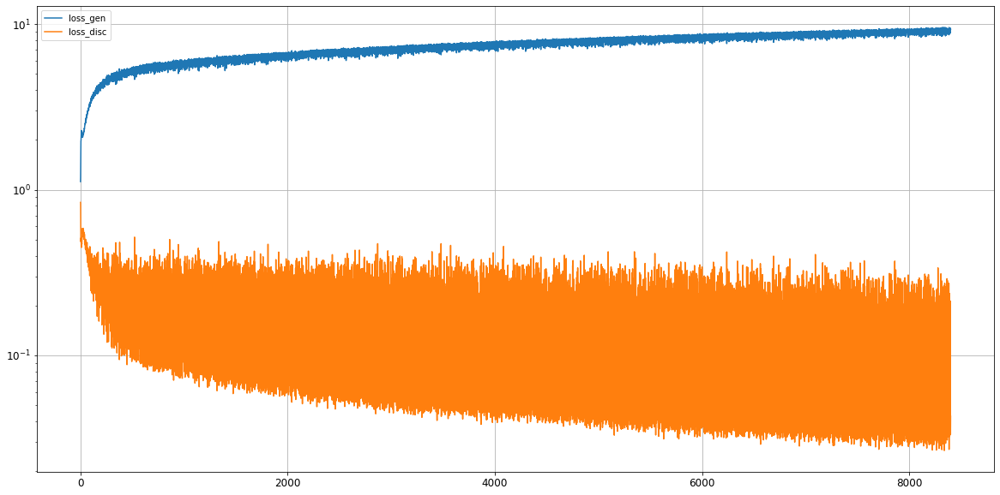

0: mean KL divergence (r,g) = 0.03635847914016034
0: mean JS divergence = 0.00951242196219452
0: mean 1-BC divergence = 0.00722572222140061

0: std KL divergence (r,g) = 0.05729913896445571
0: std JS divergence = 0.017297353896771752
0: std 1-BC divergence = 0.015113611137083982


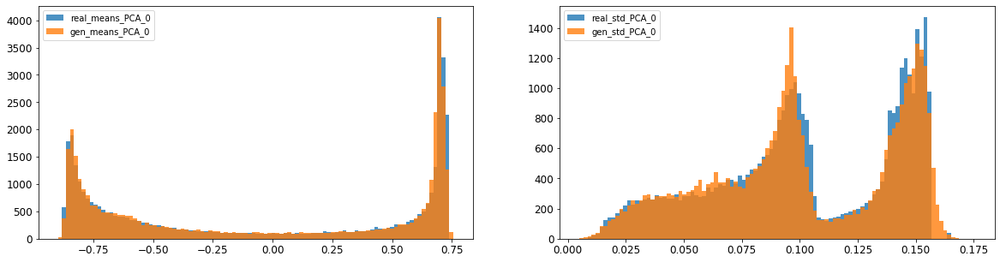

1: mean KL divergence (r,g) = 0.015550785672171266
1: mean JS divergence = 0.003964503746889709
1: mean 1-BC divergence = 0.0028031822901797288

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.007958998693386057
1: std 1-BC divergence = 0.005646531404214672


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


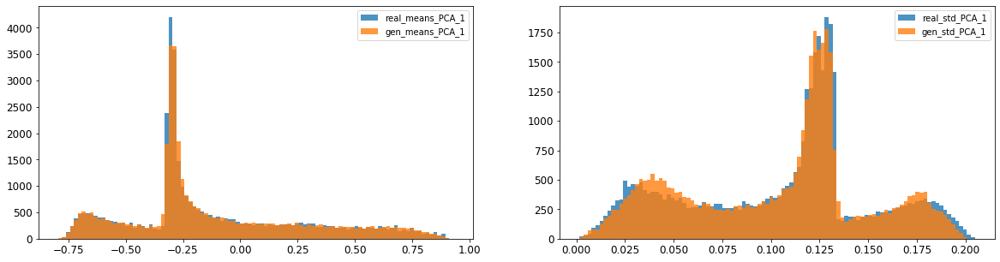

2: mean KL divergence (r,g) = 0.016697437455988607
2: mean JS divergence = 0.004167924937392866
2: mean 1-BC divergence = 0.0029895621834165054

2: std KL divergence (r,g) = 0.026755697832031543
2: std JS divergence = 0.007861989056061353
2: std 1-BC divergence = 0.007057069660262205


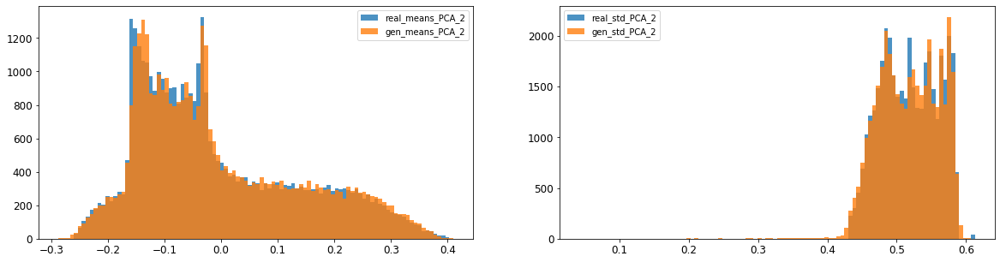

3: mean KL divergence (r,g) = 0.0570521024647484
3: mean JS divergence = 0.013162825916646938
3: mean 1-BC divergence = 0.009267165129875687

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.03963436579813154
3: std 1-BC divergence = 0.02804855254670069


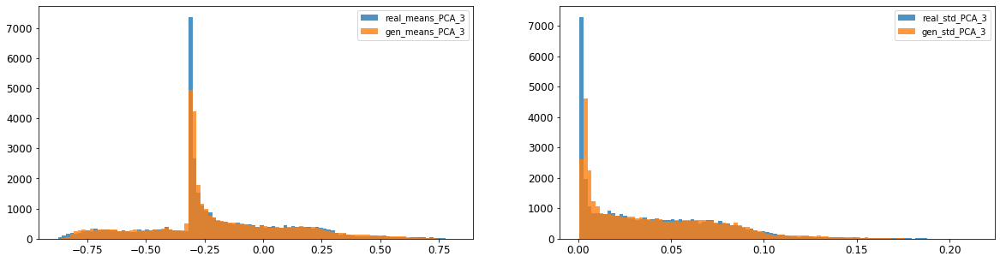

4: mean KL divergence (r,g) = 0.06203301417589758
4: mean JS divergence = 0.015942682173377132
4: mean 1-BC divergence = 0.01252565085263213

4: std KL divergence (r,g) = 0.015172891281826549
4: std JS divergence = 0.0037372247006461404
4: std 1-BC divergence = 0.002649792581569943


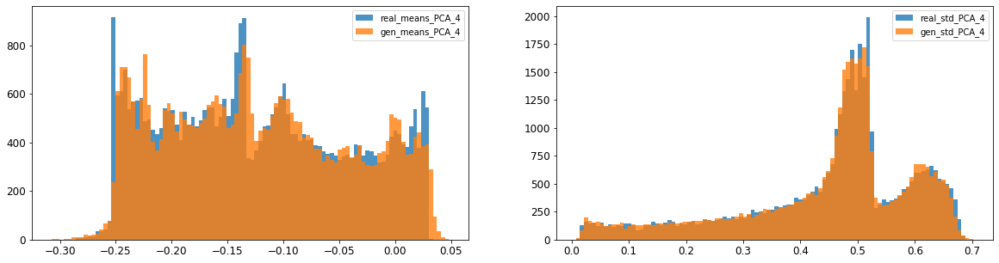

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.014601051209282493
5: mean 1-BC divergence = 0.011279651375233679

5: std KL divergence (r,g) = 0.03659065158573728
5: std JS divergence = 0.009908239198540352
5: std 1-BC divergence = 0.008758771083354211


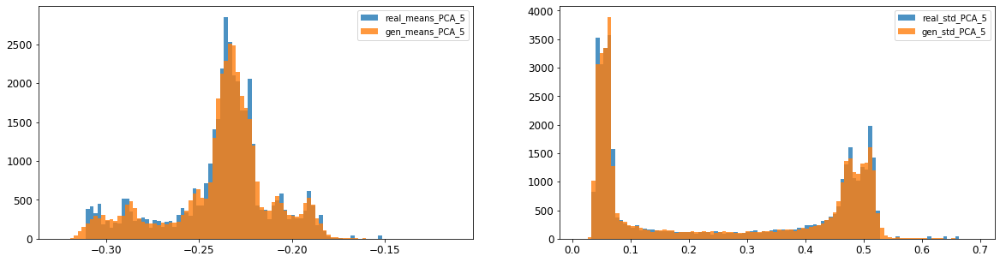

6: mean KL divergence (r,g) = 0.014533651402000915
6: mean JS divergence = 0.0036938601281088644
6: mean 1-BC divergence = 0.002634576927122656

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.007054905698918481
6: std 1-BC divergence = 0.0050851975657966175


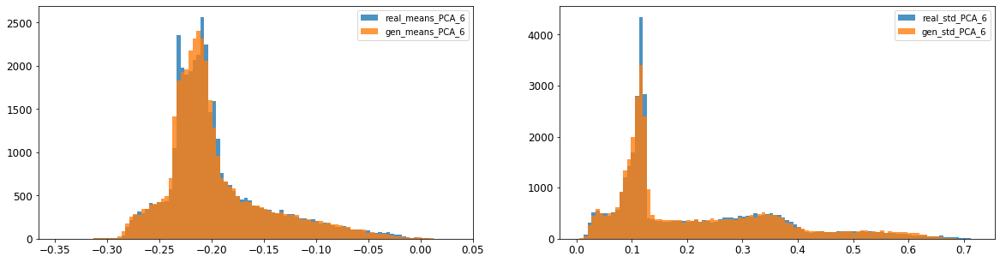

7: mean KL divergence (r,g) = 0.07464094516976337
7: mean JS divergence = 0.02007183431363234
7: mean 1-BC divergence = 0.014601992009908193

7: std KL divergence (r,g) = 0.024260039628910973
7: std JS divergence = 0.005914155335449487
7: std 1-BC divergence = 0.00415847689524429


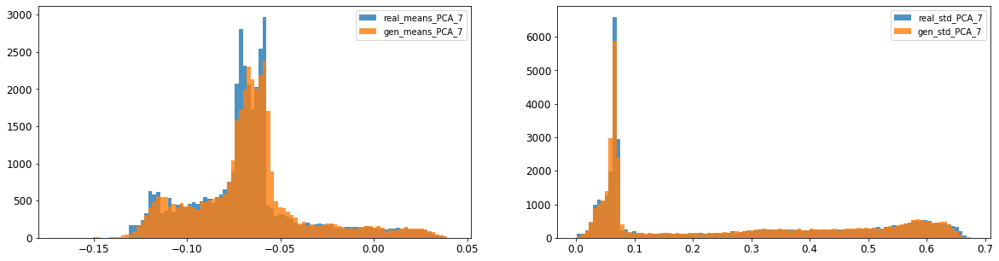

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002732949618625513
8: mean 1-BC divergence = 0.001922061329293956

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.00828470925536669
8: std 1-BC divergence = 0.005839536404034673


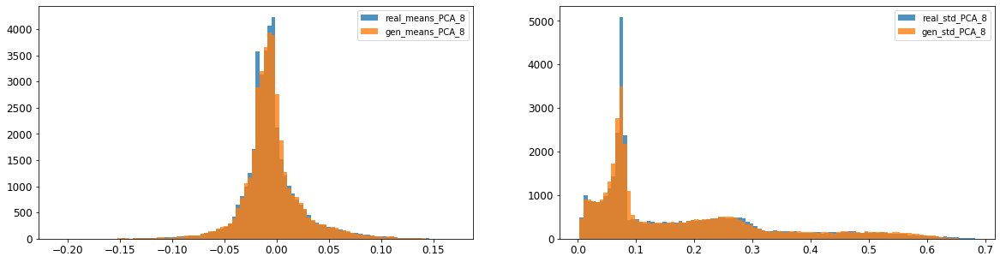

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.00356678516982358
9: mean 1-BC divergence = 0.002577541064182731

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.007399778210362646
9: std 1-BC divergence = 0.005299808875926404


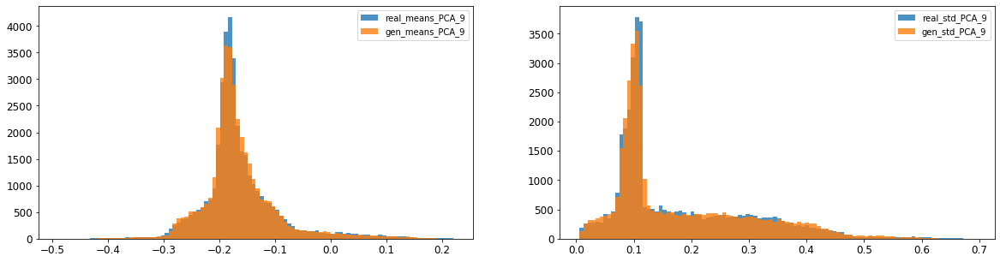

10: mean KL divergence (r,g) = 0.02201229942617115
10: mean JS divergence = 0.005506108927421613
10: mean 1-BC divergence = 0.0038894094637987875

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.005005316611642049
10: std 1-BC divergence = 0.004169597918749712


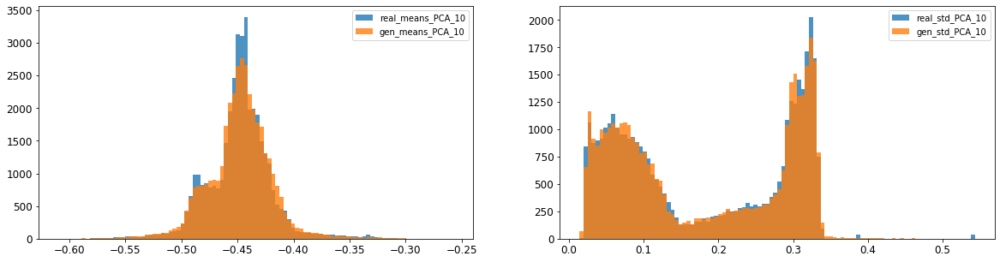

11: mean KL divergence (r,g) = 0.04210043003094667
11: mean JS divergence = 0.01046784129418616
11: mean 1-BC divergence = 0.0073566376614917495

11: std KL divergence (r,g) = 0.029477494503414924
11: std JS divergence = 0.007277796479554453
11: std 1-BC divergence = 0.005100687543536986


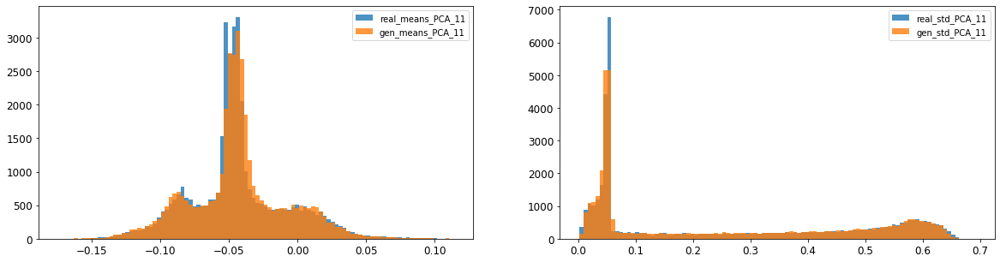

12: mean KL divergence (r,g) = 0.02742101711856666
12: mean JS divergence = 0.007008948800216192
12: mean 1-BC divergence = 0.004914960560407078

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.014938042022559547
12: std 1-BC divergence = 0.010622862721123338


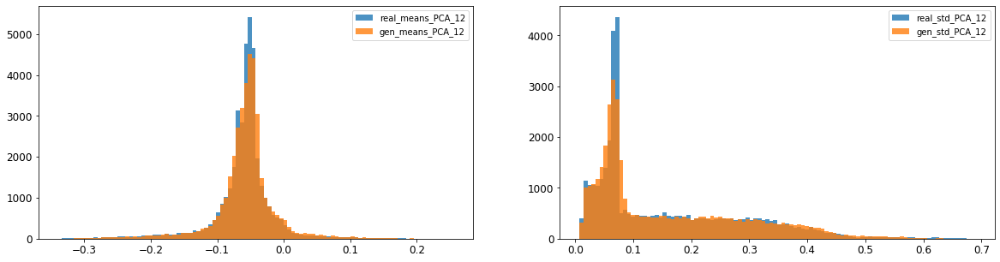

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.012803109671908033
13: mean 1-BC divergence = 0.009020990171043075

13: std KL divergence (r,g) = 0.06739882169060148
13: std JS divergence = 0.016539537917738
13: std 1-BC divergence = 0.01160783267259391


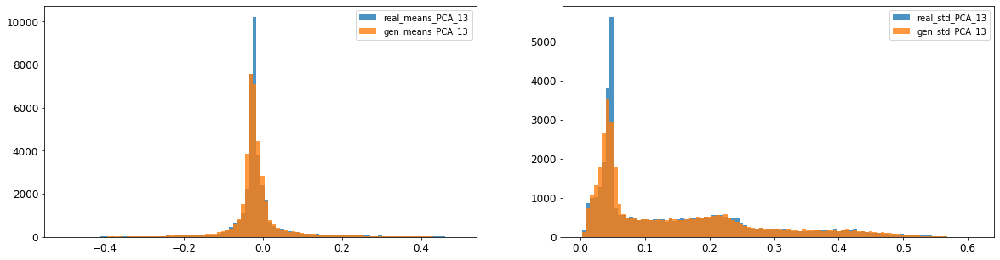

14: mean KL divergence (r,g) = 0.05294655298512435
14: mean JS divergence = 0.013008419551455059
14: mean 1-BC divergence = 0.009128647417653402

14: std KL divergence (r,g) = 0.027460339047327347
14: std JS divergence = 0.006911809918916911
14: std 1-BC divergence = 0.004830261397089086


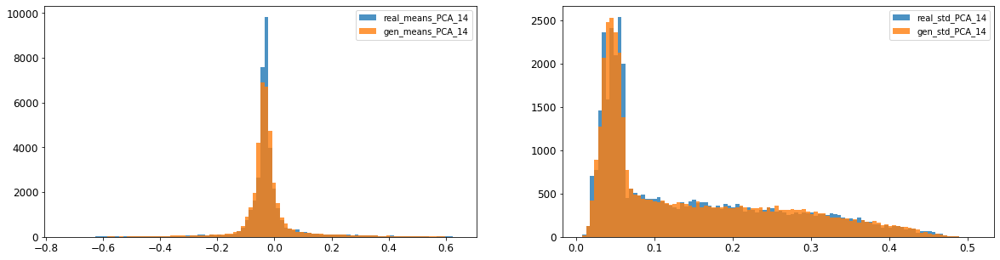

15: mean KL divergence (r,g) = 1.7217305756380494
15: mean JS divergence = 0.4442971480187916
15: mean 1-BC divergence = 0.40849439239626684

15: std KL divergence (r,g) = 6.529416509286158
15: std JS divergence = 0.9568066566228377
15: std 1-BC divergence = 0.8959541198733003


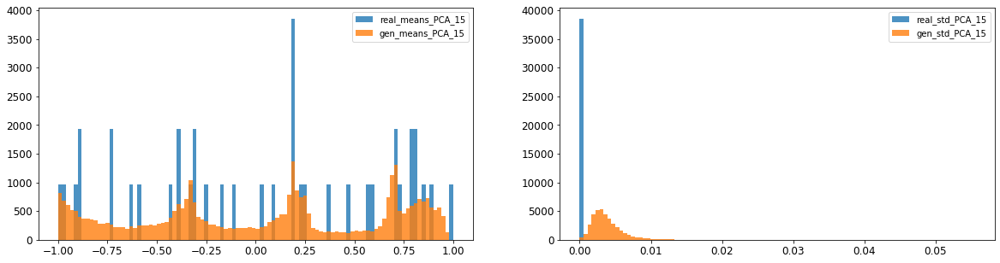

16: mean KL divergence (r,g) = 1.364183192426044
16: mean JS divergence = 0.3809443793160369
16: mean 1-BC divergence = 0.35082672938043846

16: std KL divergence (r,g) = 4.951390055775379
16: std JS divergence = 0.8962960172077038
16: std 1-BC divergence = 0.8202199336017941


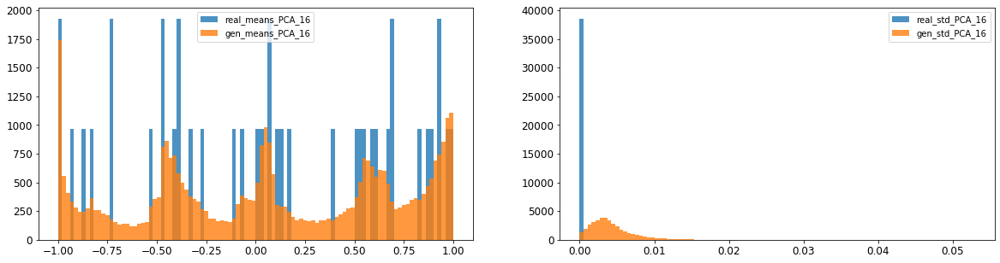



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010197849673840218
Compose 1-BC divergence = 0.007537544702163945

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.011493462779129639
Compose weighted 1-BC divergence = 0.009190994990275425

Multivariate KL divergence = 36.95720485488166


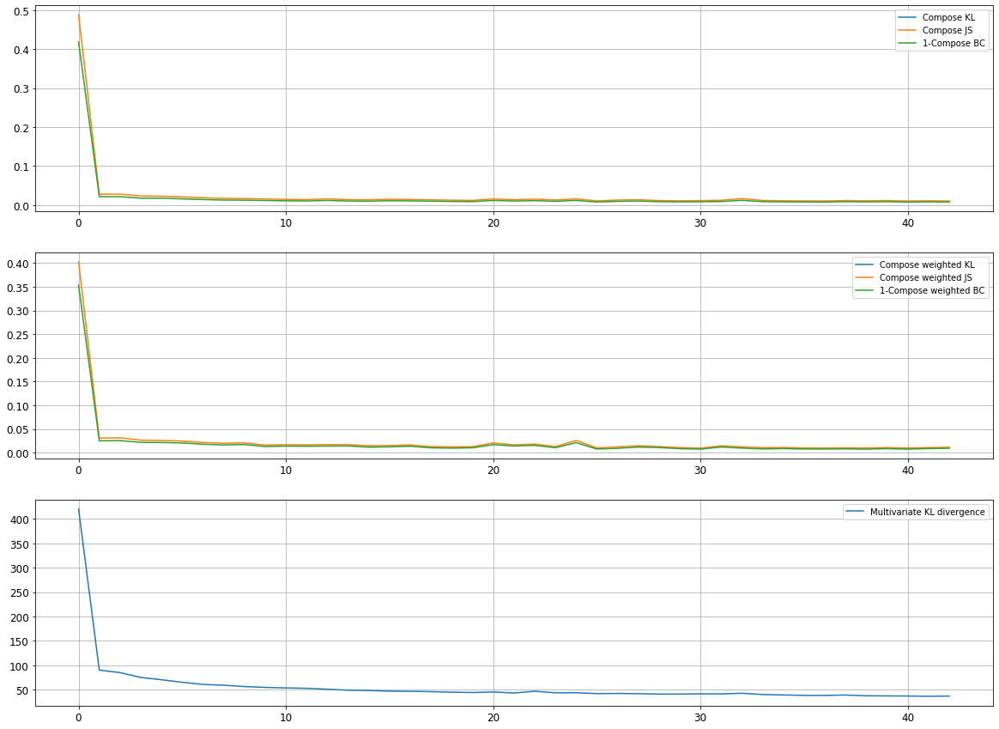

Epoch 8402/10000
discriminator loss: 0.188590 - generator loss: 8.703918 - 29s
Epoch 8403/10000
discriminator loss: 0.039478 - generator loss: 9.436874 - 29s
Epoch 8404/10000
discriminator loss: 0.048475 - generator loss: 9.293053 - 29s
Epoch 8405/10000
discriminator loss: 0.296938 - generator loss: 8.583211 - 29s
Epoch 8406/10000
discriminator loss: 0.030503 - generator loss: 9.299645 - 29s
Epoch 8407/10000
discriminator loss: 0.034700 - generator loss: 9.389815 - 29s
Epoch 8408/10000
discriminator loss: 0.190721 - generator loss: 9.126225 - 29s
Epoch 8409/10000
discriminator loss: 0.034551 - generator loss: 9.398809 - 29s
Epoch 8410/10000
discriminator loss: 0.029008 - generator loss: 9.490733 - 29s
Epoch 8411/10000
discriminator loss: 0.196827 - generator loss: 8.854804 - 29s
Epoch 8412/10000
discriminator loss: 0.036028 - generator loss: 9.332062 - 29s
Epoch 8413/10000
discriminator loss: 0.034470 - generator loss: 9.363581 - 28s
Epoch 8414/10000
discriminator loss: 0.145908 - gene

discriminator loss: 0.035465 - generator loss: 9.242157 - 29s
Epoch 8507/10000
discriminator loss: 0.197296 - generator loss: 8.990562 - 29s
Epoch 8508/10000
discriminator loss: 0.038114 - generator loss: 9.208613 - 29s
Epoch 8509/10000
discriminator loss: 0.028890 - generator loss: 9.471433 - 29s
Epoch 8510/10000
discriminator loss: 0.037646 - generator loss: 9.405850 - 28s
Epoch 8511/10000
discriminator loss: 0.123175 - generator loss: 9.056302 - 28s
Epoch 8512/10000
discriminator loss: 0.320876 - generator loss: 8.723304 - 29s
Epoch 8513/10000
discriminator loss: 0.034390 - generator loss: 9.203638 - 28s
Epoch 8514/10000
discriminator loss: 0.028247 - generator loss: 9.562611 - 29s
Epoch 8515/10000
discriminator loss: 0.036481 - generator loss: 9.428572 - 29s
Epoch 8516/10000
discriminator loss: 0.055786 - generator loss: 9.205565 - 29s
Epoch 8517/10000
discriminator loss: 0.212302 - generator loss: 8.808620 - 29s
Epoch 8518/10000
discriminator loss: 0.031918 - generator loss: 9.424

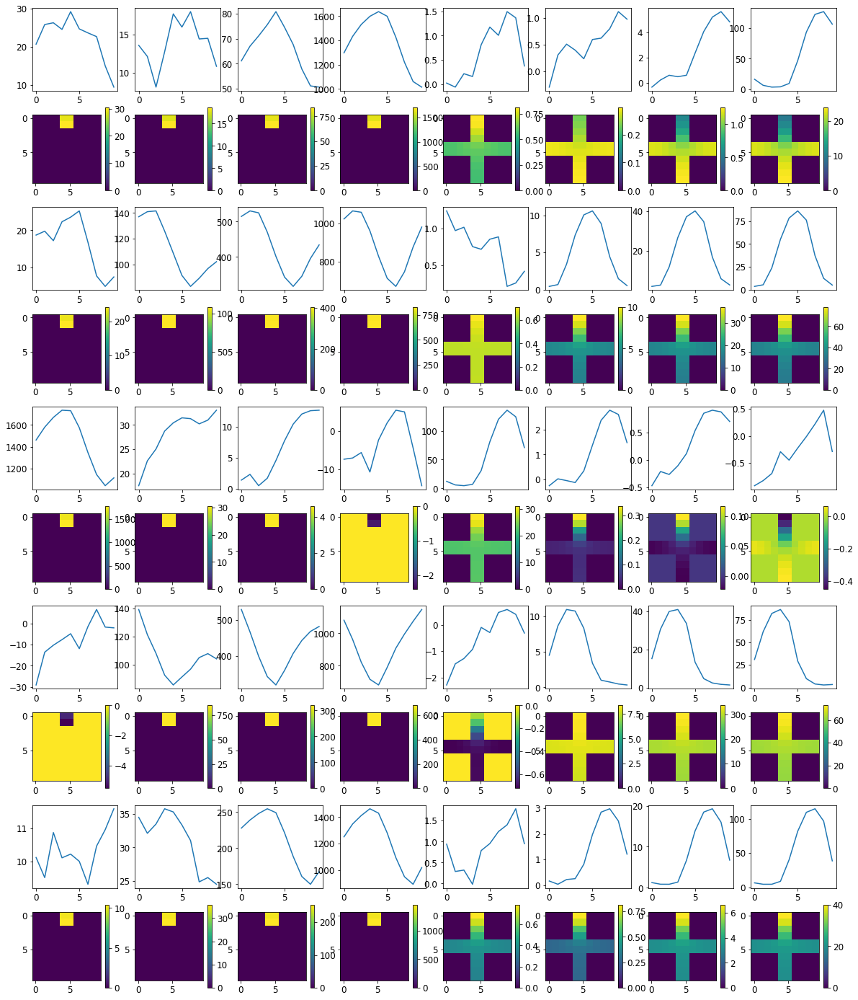


R0 generated:
[[19.34584    17.485275  ]
 [19.360285   17.415163  ]
 [19.37794    17.454527  ]
 [19.367916   17.447548  ]
 [19.36627    17.467884  ]
 [19.356602   17.401808  ]
 [19.387218   17.480549  ]
 [19.38503    17.512615  ]
 [19.34156    17.505396  ]
 [19.366858   17.674883  ]
 [17.081318    0.40068254]
 [17.076586    0.38297838]
 [17.057379    0.38177896]
 [17.02692     0.38344836]
 [17.051033    0.3796833 ]
 [17.067072    0.37937832]
 [17.069986    0.36999503]
 [17.020567    0.3795987 ]
 [17.060629    0.39001292]
 [17.07007     0.40819114]
 [16.887766    0.42654487]
 [16.949528    0.40036592]
 [16.948357    0.40113735]
 [16.942486    0.416526  ]
 [16.906628    0.40947396]
 [16.878225    0.42177626]
 [16.919668    0.4149318 ]
 [16.870771    0.38852718]
 [16.931053    0.40489894]
 [16.97247     0.40295604]
 [19.698736   16.402851  ]
 [19.697727   16.311762  ]
 [19.694357   16.36795   ]
 [19.693714   16.37819   ]
 [19.691135   16.407143  ]
 [19.693241   16.379105  ]
 [19.700293  

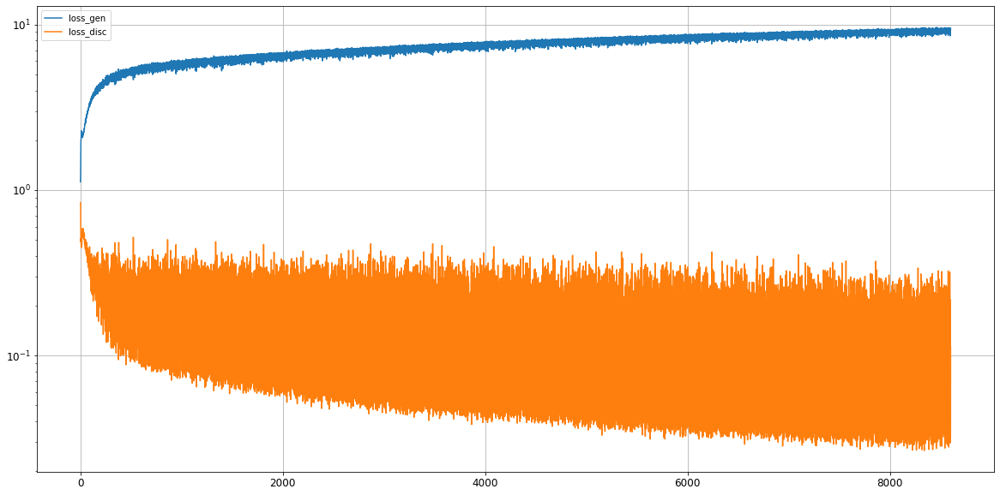

0: mean KL divergence (r,g) = 0.07108832508132602
0: mean JS divergence = 0.016902377136578557
0: mean 1-BC divergence = 0.012039586884206477

0: std KL divergence (r,g) = 0.11786480111468836
0: std JS divergence = 0.036899379604062005
0: std 1-BC divergence = 0.03291151666960823


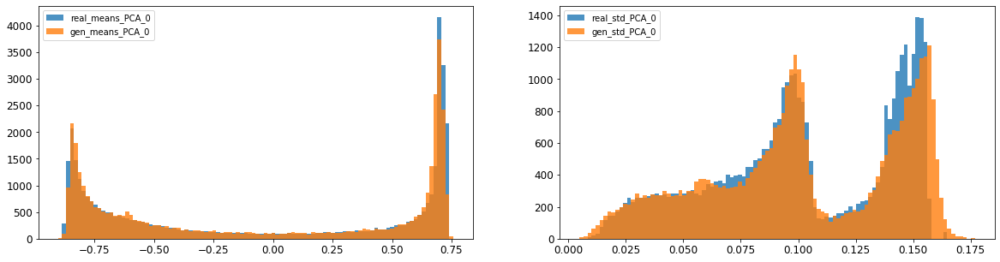

1: mean KL divergence (r,g) = 0.026612792947038694
1: mean JS divergence = 0.006772188237355195
1: mean 1-BC divergence = 0.004770894593421393

1: std KL divergence (r,g) = 0.04897921182288958
1: std JS divergence = 0.01364720328452397
1: std 1-BC divergence = 0.00972815670818672


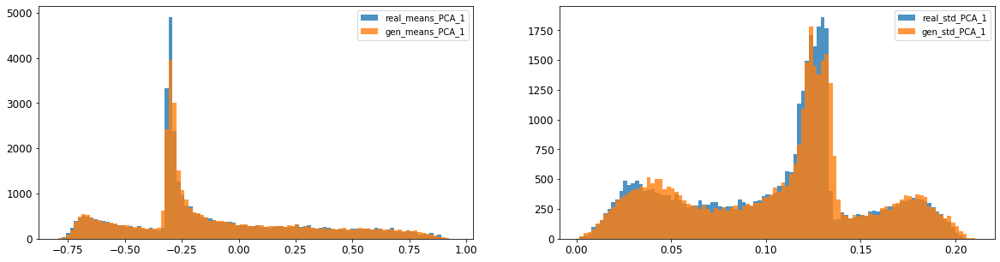

2: mean KL divergence (r,g) = 0.009719593279297119
2: mean JS divergence = 0.002413311797818375
2: mean 1-BC divergence = 0.0017350147933294924

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.009720347961903042
2: std 1-BC divergence = 0.008034911268542055


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


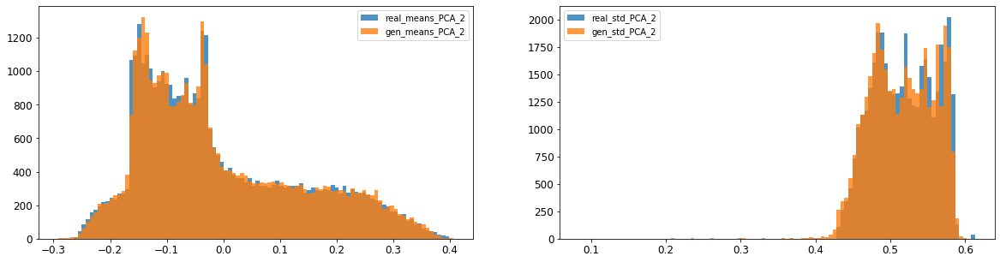

3: mean KL divergence (r,g) = 0.0691905829598185
3: mean JS divergence = 0.01874515036619805
3: mean 1-BC divergence = 0.01346959570466133

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.0639564583286714
3: std 1-BC divergence = 0.04608583302474456


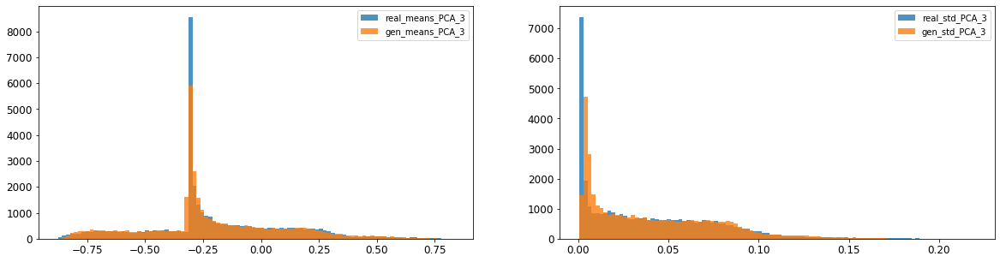

4: mean KL divergence (r,g) = 0.0350654678029656
4: mean JS divergence = 0.009004400760687016
4: mean 1-BC divergence = 0.006790298921091953

4: std KL divergence (r,g) = 0.013223260160243343
4: std JS divergence = 0.003358803240407981
4: std 1-BC divergence = 0.002435077970363242


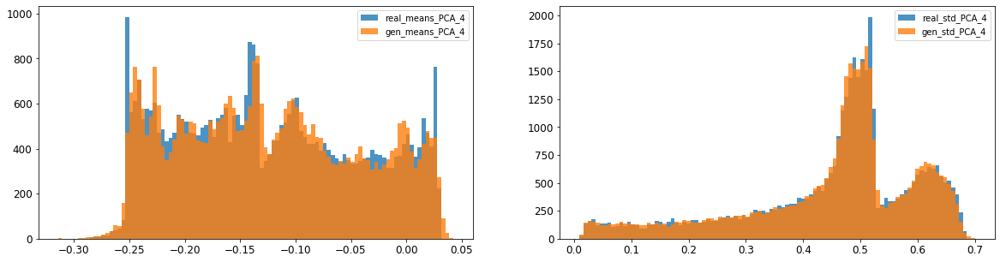

5: mean KL divergence (r,g) = 0.0601638863409348
5: mean JS divergence = 0.014679973821495097
5: mean 1-BC divergence = 0.010551311123167317

5: std KL divergence (r,g) = 0.03870305232021987
5: std JS divergence = 0.010148693563589448
5: std 1-BC divergence = 0.008592312787132461


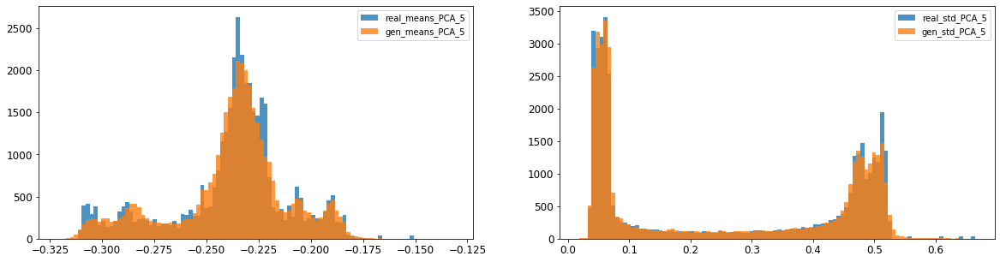

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0037621350357947753
6: mean 1-BC divergence = 0.0026648611799994226

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.005663432462587307
6: std 1-BC divergence = 0.003984245984795076


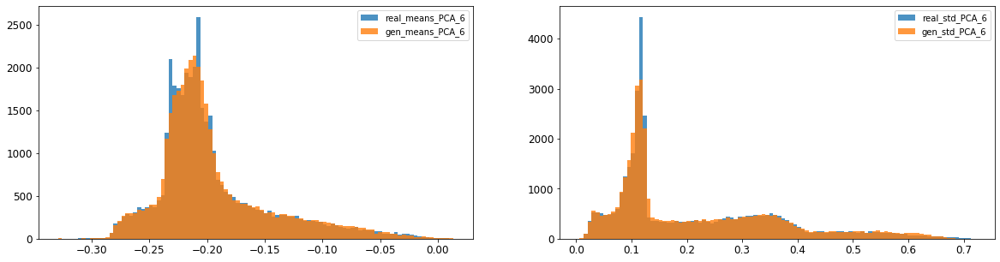

7: mean KL divergence (r,g) = 0.1791268189639668
7: mean JS divergence = 0.04687410443551521
7: mean 1-BC divergence = 0.03378164492086977

7: std KL divergence (r,g) = 0.028143481906339557
7: std JS divergence = 0.006958352089013327
7: std 1-BC divergence = 0.004877734754575647


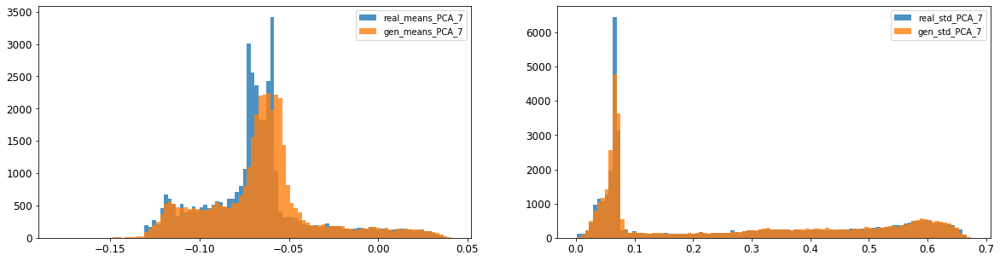

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0037134055505243283
8: mean 1-BC divergence = 0.0026192032849243763

8: std KL divergence (r,g) = 0.034677044093788266
8: std JS divergence = 0.008479895886058613
8: std 1-BC divergence = 0.0059086205512789425


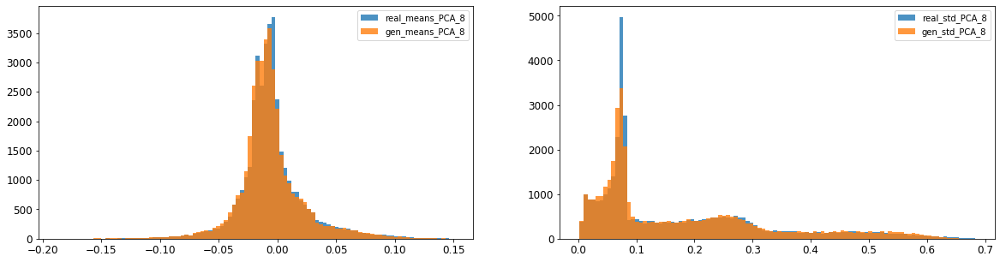

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.004570114605254059
9: mean 1-BC divergence = 0.0033224510525879936

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.009923967667674501
9: std 1-BC divergence = 0.007027093843822496


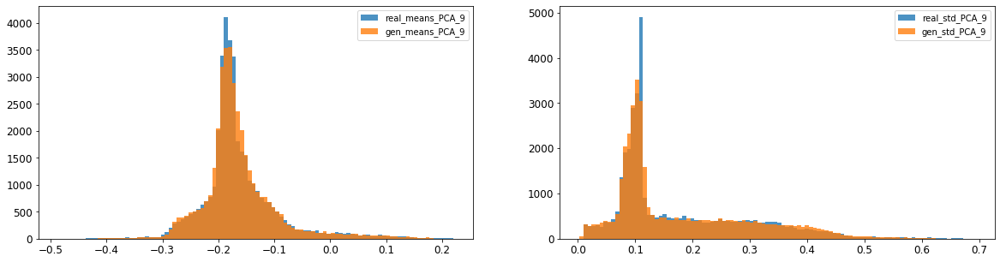

10: mean KL divergence (r,g) = 0.02367834136133517
10: mean JS divergence = 0.005920630626881093
10: mean 1-BC divergence = 0.004193696752544884

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.00519399367986412
10: std 1-BC divergence = 0.004288130639659382


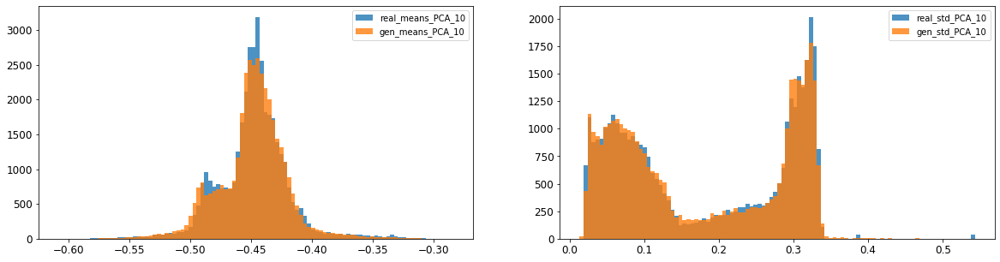

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.011159258462044182
11: mean 1-BC divergence = 0.007860758550092828

11: std KL divergence (r,g) = 0.029812140698473877
11: std JS divergence = 0.00774820062454136
11: std 1-BC divergence = 0.005498988179409414


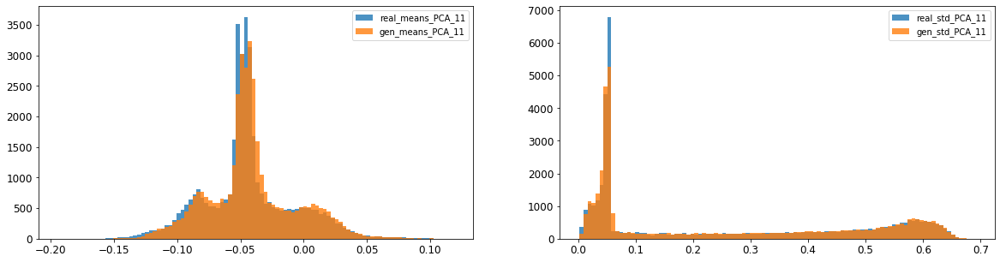

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.012695373027155853
12: mean 1-BC divergence = 0.008962928836672934

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.014483304905812148
12: std 1-BC divergence = 0.010275574151902611


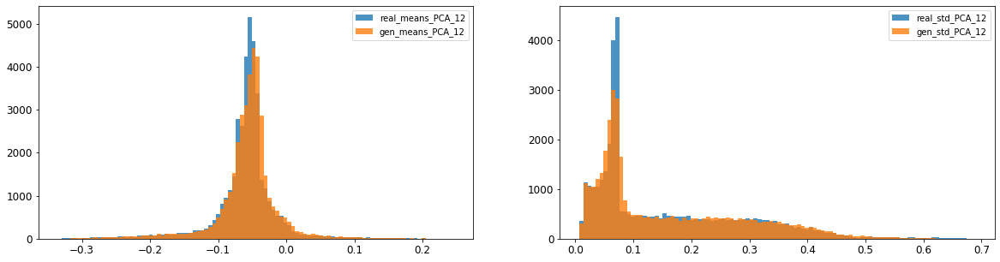

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.021864210292619566
13: mean 1-BC divergence = 0.01533984301204061

13: std KL divergence (r,g) = 0.0692330917515001
13: std JS divergence = 0.016938260003246434
13: std 1-BC divergence = 0.011876722116417993


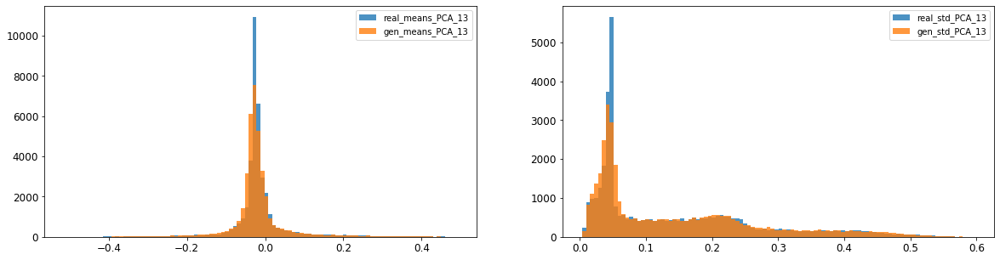

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.02260994483042547
14: mean 1-BC divergence = 0.015975796915814633

14: std KL divergence (r,g) = 0.024430068819512006
14: std JS divergence = 0.00622287763835175
14: std 1-BC divergence = 0.004360210850102519


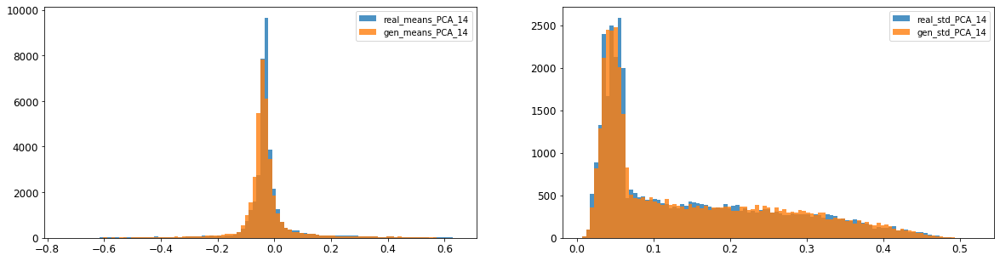

15: mean KL divergence (r,g) = 1.737804046182949
15: mean JS divergence = 0.4580853883376277
15: mean 1-BC divergence = 0.4201743285714975

15: std KL divergence (r,g) = 7.938699333839194
15: std JS divergence = 0.9808756505420471
15: std 1-BC divergence = 0.936157970139262


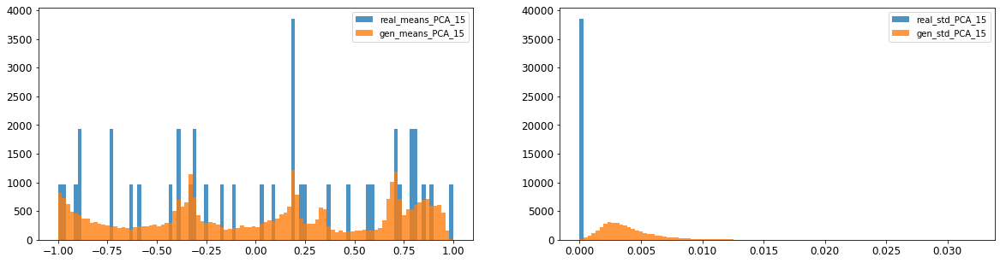

16: mean KL divergence (r,g) = 1.343475457468815
16: mean JS divergence = 0.37724985876952755
16: mean 1-BC divergence = 0.3480278288526263

16: std KL divergence (r,g) = 5.775939203658287
16: std JS divergence = 0.9340096194050633
16: std 1-BC divergence = 0.8649064782996616


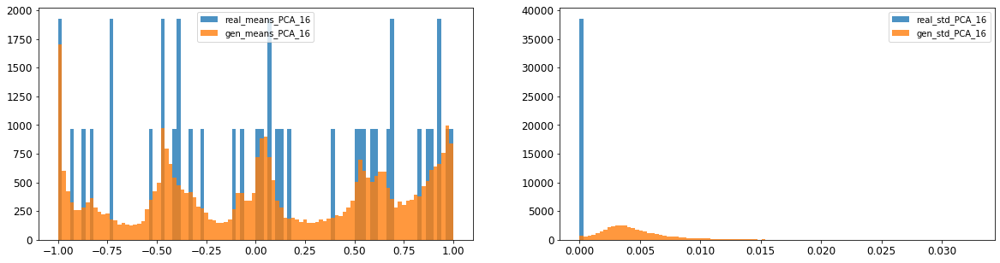



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.014034324997555138
Compose 1-BC divergence = 0.01033210053419864

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.02066047685575608
Compose weighted 1-BC divergence = 0.016643996506684244

Multivariate KL divergence = 38.61612126512895


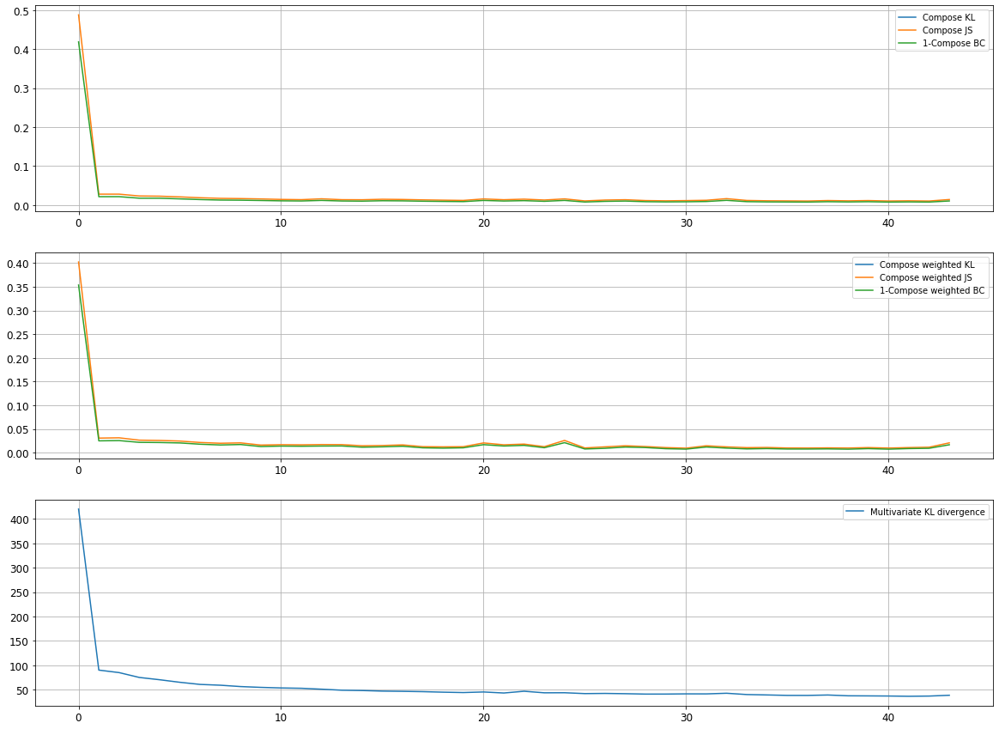

Epoch 8602/10000
discriminator loss: 0.091910 - generator loss: 8.885911 - 27s
Epoch 8603/10000
discriminator loss: 0.166421 - generator loss: 8.711857 - 28s
Epoch 8604/10000
discriminator loss: 0.031464 - generator loss: 9.542650 - 28s
Epoch 8605/10000
discriminator loss: 0.031659 - generator loss: 9.449651 - 29s
Epoch 8606/10000
discriminator loss: 0.173529 - generator loss: 8.965478 - 28s
Epoch 8607/10000
discriminator loss: 0.033301 - generator loss: 9.502584 - 29s
Epoch 8608/10000
discriminator loss: 0.036143 - generator loss: 9.440744 - 29s
Epoch 8609/10000
discriminator loss: 0.211357 - generator loss: 9.268797 - 29s
Epoch 8610/10000
discriminator loss: 0.048192 - generator loss: 9.024125 - 29s
Epoch 8611/10000
discriminator loss: 0.030715 - generator loss: 9.507517 - 29s
Epoch 8612/10000
discriminator loss: 0.204465 - generator loss: 8.863413 - 29s
Epoch 8613/10000
discriminator loss: 0.031562 - generator loss: 9.451904 - 29s
Epoch 8614/10000
discriminator loss: 0.032792 - gene

discriminator loss: 0.030684 - generator loss: 9.538813 - 28s
Epoch 8707/10000
discriminator loss: 0.239717 - generator loss: 8.948288 - 29s
Epoch 8708/10000
discriminator loss: 0.033878 - generator loss: 9.368895 - 28s
Epoch 8709/10000
discriminator loss: 0.026655 - generator loss: 9.585273 - 28s
Epoch 8710/10000
discriminator loss: 0.028012 - generator loss: 9.711287 - 28s
Epoch 8711/10000
discriminator loss: 0.202707 - generator loss: 8.785076 - 28s
Epoch 8712/10000
discriminator loss: 0.154566 - generator loss: 8.815274 - 28s
Epoch 8713/10000
discriminator loss: 0.029267 - generator loss: 9.514201 - 28s
Epoch 8714/10000
discriminator loss: 0.031033 - generator loss: 9.591357 - 28s
Epoch 8715/10000
discriminator loss: 0.243847 - generator loss: 8.806578 - 28s
Epoch 8716/10000
discriminator loss: 0.030471 - generator loss: 9.613289 - 28s
Epoch 8717/10000
discriminator loss: 0.043261 - generator loss: 9.479333 - 28s
Epoch 8718/10000
discriminator loss: 0.043632 - generator loss: 9.353

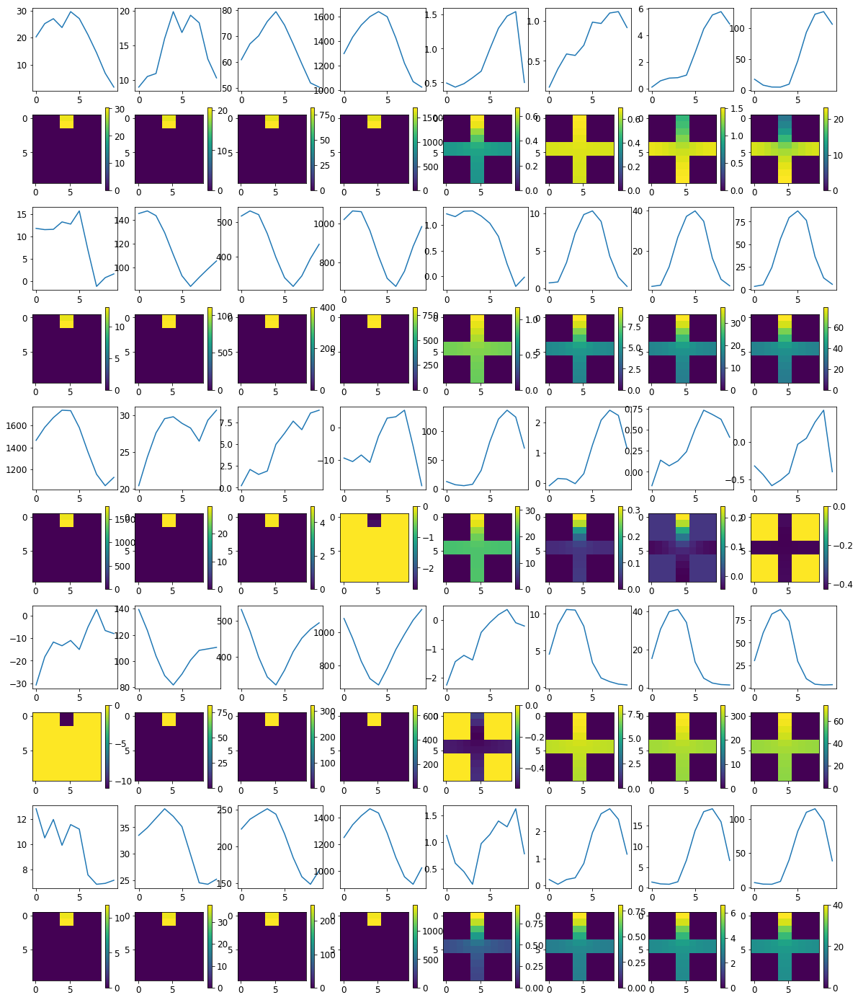


R0 generated:
[[19.308113   17.922613  ]
 [19.347342   17.870632  ]
 [19.373251   17.893291  ]
 [19.374062   17.836773  ]
 [19.377913   17.813723  ]
 [19.373932   17.743778  ]
 [19.408924   17.790295  ]
 [19.408855   17.784239  ]
 [19.362894   17.7947    ]
 [19.385088   17.989347  ]
 [16.94875     0.37429482]
 [17.016912    0.36364213]
 [17.033228    0.36333308]
 [17.012617    0.36405206]
 [17.02402     0.36180535]
 [17.00011     0.36542293]
 [17.008018    0.35718253]
 [16.971668    0.36220363]
 [16.97702     0.37145162]
 [17.02319     0.39000943]
 [16.897808    0.4876149 ]
 [17.004885    0.46749613]
 [17.010683    0.46571302]
 [17.023119    0.47920832]
 [17.015293    0.48118854]
 [16.983658    0.49242842]
 [17.002903    0.48757643]
 [16.9518      0.46374622]
 [16.96817     0.48239732]
 [17.026016    0.47891212]
 [19.67998    16.467552  ]
 [19.69133    16.402779  ]
 [19.690142   16.416908  ]
 [19.693628   16.391207  ]
 [19.691473   16.405975  ]
 [19.69025    16.330265  ]
 [19.69545   

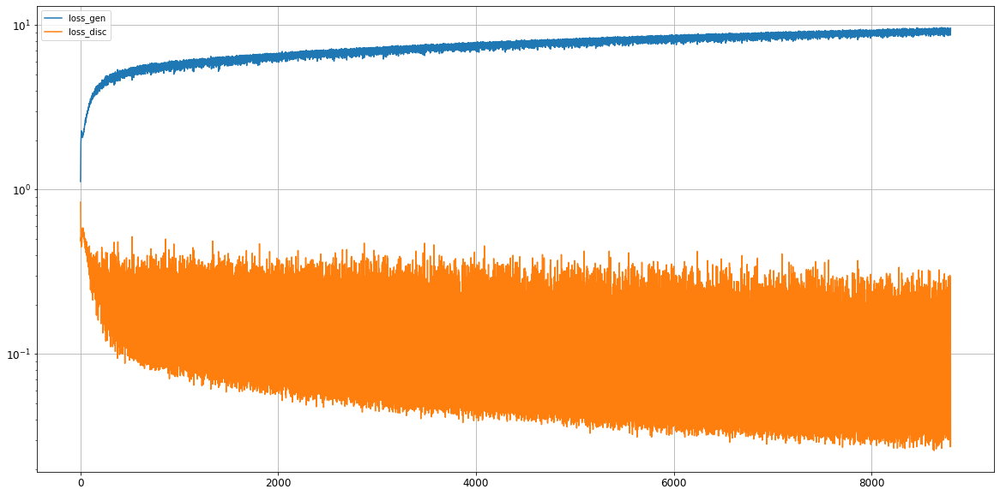

0: mean KL divergence (r,g) = 0.027542390514821546
0: mean JS divergence = 0.006825291526021468
0: mean 1-BC divergence = 0.004940980851431465

0: std KL divergence (r,g) = 0.05443684144363441
0: std JS divergence = 0.01576463646812064
0: std 1-BC divergence = 0.013471778028264714


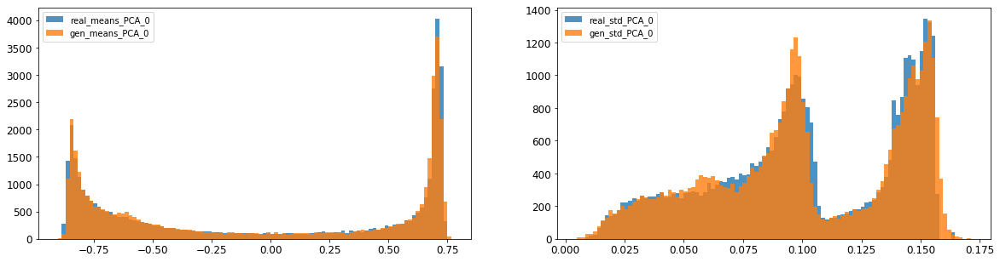

1: mean KL divergence (r,g) = 0.029897474817000107
1: mean JS divergence = 0.007857777806044158
1: mean 1-BC divergence = 0.0055337140988317435

1: std KL divergence (r,g) = 0.02075181393245832
1: std JS divergence = 0.005076321640394416
1: std 1-BC divergence = 0.003534912022421177


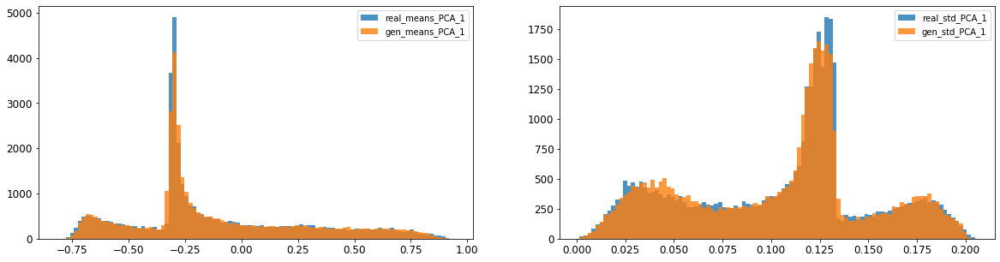

2: mean KL divergence (r,g) = 0.012262417888574828
2: mean JS divergence = 0.0030776495373638717
2: mean 1-BC divergence = 0.002217239977542418


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until



2: std KL divergence (r,g) = inf
2: std JS divergence = 0.005409158578896669
2: std 1-BC divergence = 0.004815279280022899


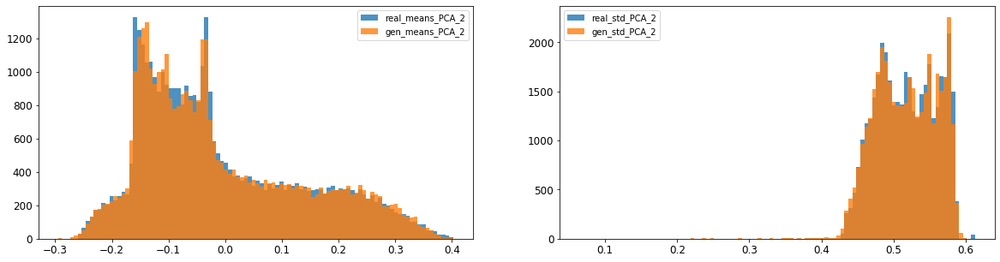

3: mean KL divergence (r,g) = 0.0430847394475167
3: mean JS divergence = 0.010505916793030545
3: mean 1-BC divergence = 0.007347081029282165

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.04047445904688203
3: std 1-BC divergence = 0.02862637086718045


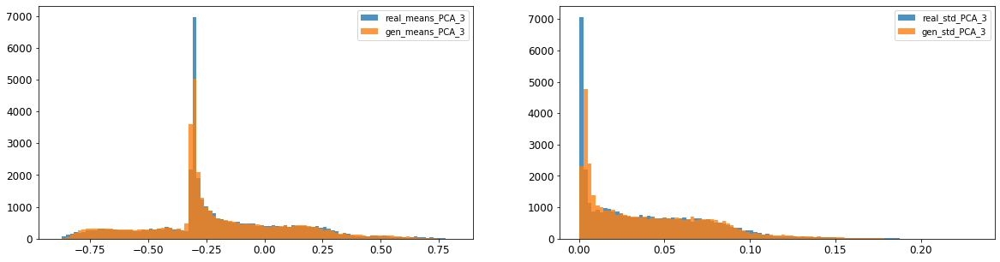

4: mean KL divergence (r,g) = 0.03595792316625645
4: mean JS divergence = 0.010471213024023429
4: mean 1-BC divergence = 0.008887152163599477

4: std KL divergence (r,g) = 0.01964145421787208
4: std JS divergence = 0.004813107572776986
4: std 1-BC divergence = 0.003407848219284859


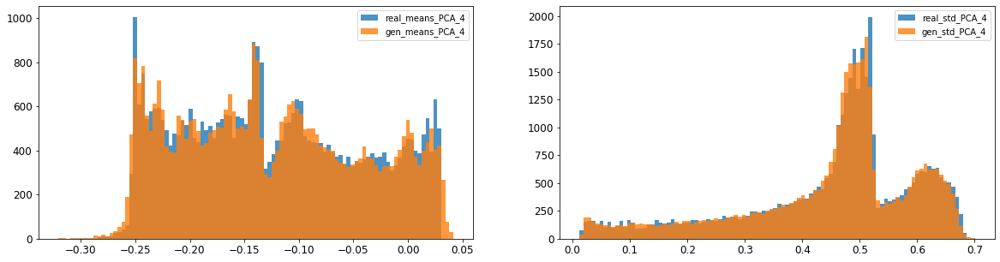

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.017963156521037353
5: mean 1-BC divergence = 0.013950776097573558

5: std KL divergence (r,g) = 0.048539563681855566
5: std JS divergence = 0.013615363656591283
5: std 1-BC divergence = 0.01178915364689248


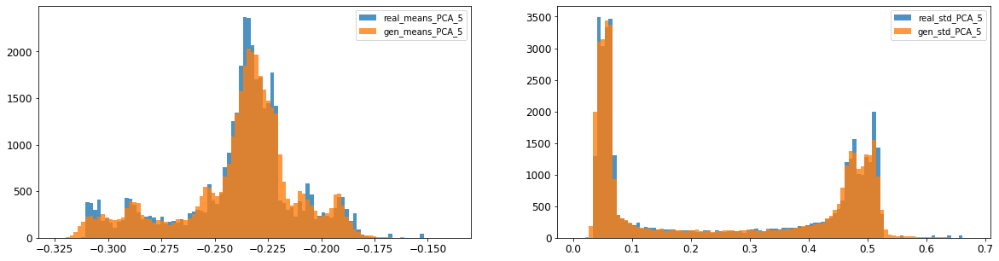

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0031412920278712027
6: mean 1-BC divergence = 0.0023076967661165293

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.008083502880716527
6: std 1-BC divergence = 0.005866139878514032


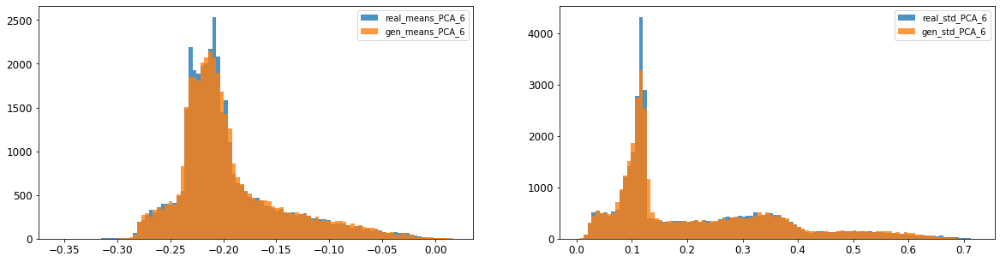

7: mean KL divergence (r,g) = 0.07686500504695834
7: mean JS divergence = 0.01841440322165059
7: mean 1-BC divergence = 0.013404865225983942

7: std KL divergence (r,g) = 0.02767596532946651
7: std JS divergence = 0.0068554341127673064
7: std 1-BC divergence = 0.004824803686639401


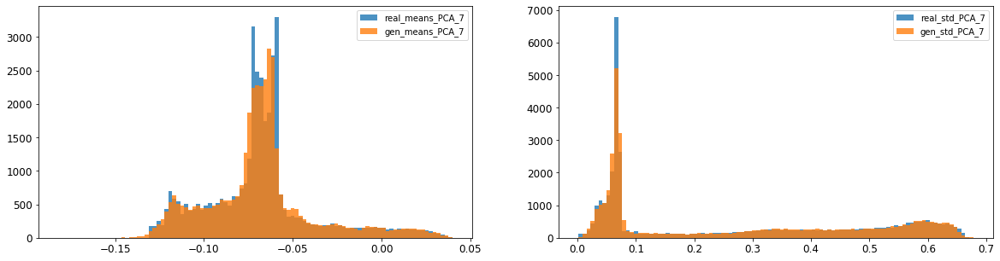

8: mean KL divergence (r,g) = 0.01234688026277022
8: mean JS divergence = 0.003091937697092855
8: mean 1-BC divergence = 0.0021594012930130635

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008454771627681629
8: std 1-BC divergence = 0.00600680451230351


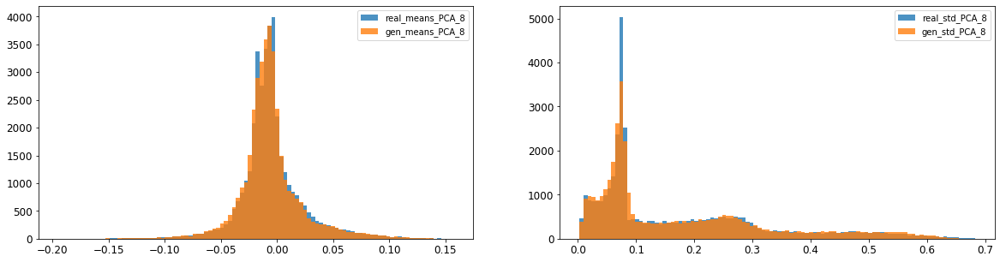

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0046875705453189335
9: mean 1-BC divergence = 0.003366469035466557

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.00937302523763294
9: std 1-BC divergence = 0.006668922229064456


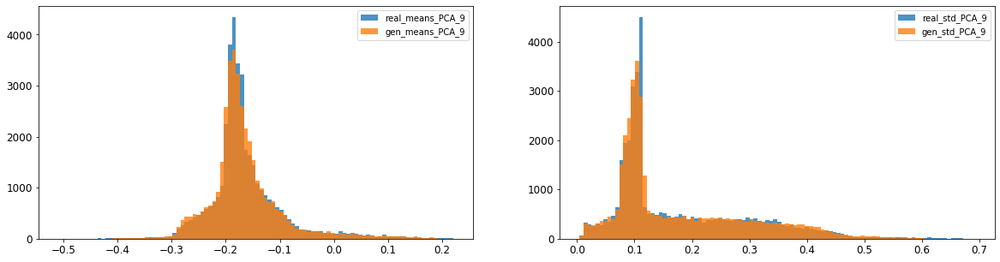

10: mean KL divergence (r,g) = 0.02186488357970498
10: mean JS divergence = 0.00530797740809397
10: mean 1-BC divergence = 0.003742934318632818

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.006234602546733646
10: std 1-BC divergence = 0.005061066296530137


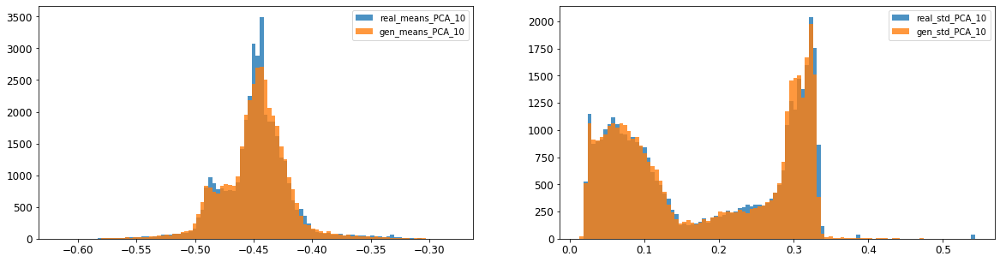

11: mean KL divergence (r,g) = 0.02035795698042476
11: mean JS divergence = 0.0052419381595896685
11: mean 1-BC divergence = 0.0037131776019344587

11: std KL divergence (r,g) = 0.04583139154559462
11: std JS divergence = 0.012214678583625443
11: std 1-BC divergence = 0.008711202048584776


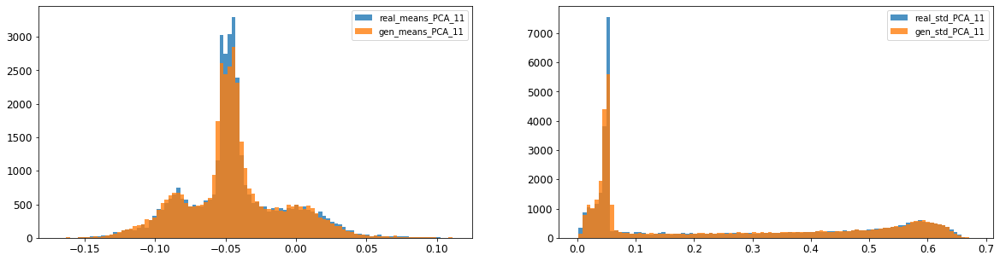

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.005372797522440522
12: mean 1-BC divergence = 0.0037719445963615428

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.013005575425068387
12: std 1-BC divergence = 0.00932767644860466


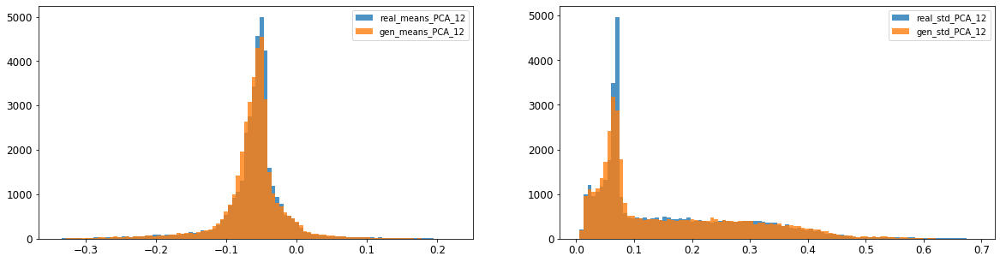

13: mean KL divergence (r,g) = 0.06812347995794513
13: mean JS divergence = 0.017165252018907194
13: mean 1-BC divergence = 0.011997969817775012

13: std KL divergence (r,g) = 0.06823896931502697
13: std JS divergence = 0.01680720595329154
13: std 1-BC divergence = 0.011783885832389651


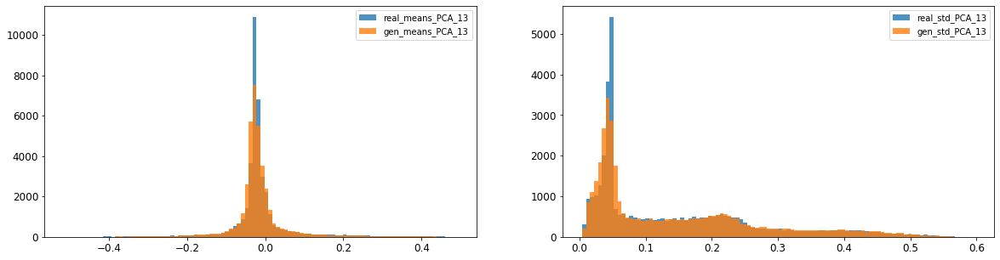

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.018222596119849326
14: mean 1-BC divergence = 0.012787134777290654

14: std KL divergence (r,g) = 0.024232914596242362
14: std JS divergence = 0.0060670046924050074
14: std 1-BC divergence = 0.0042407821619949715


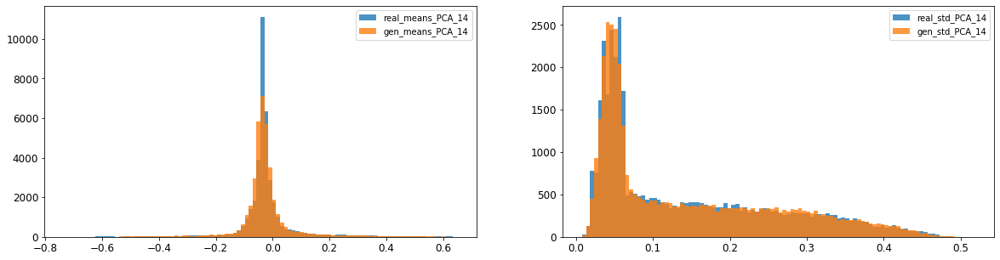

15: mean KL divergence (r,g) = 1.6739083496035705
15: mean JS divergence = 0.4387959680205977
15: mean 1-BC divergence = 0.4038159669037761

15: std KL divergence (r,g) = 7.3324532747500735
15: std JS divergence = 0.9727631370399319
15: std 1-BC divergence = 0.9212309130747579


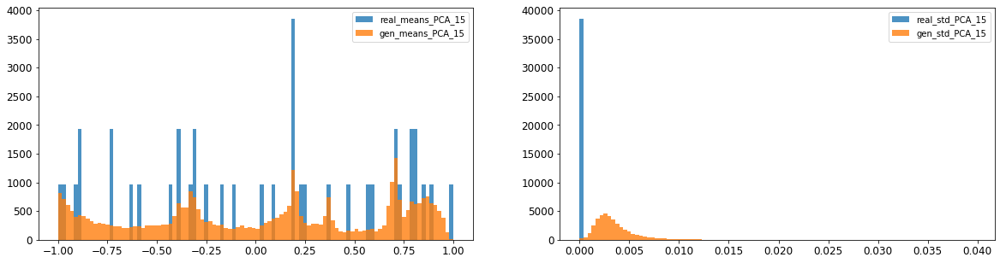

16: mean KL divergence (r,g) = 1.3542515450671837
16: mean JS divergence = 0.3808434326424004
16: mean 1-BC divergence = 0.3509697920250284

16: std KL divergence (r,g) = 5.352206122055725
16: std JS divergence = 0.9166133160546646
16: std 1-BC divergence = 0.8435366202575971


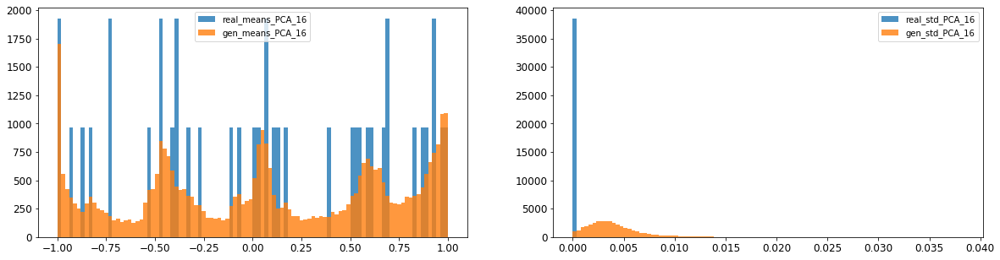



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010319853931730651
Compose 1-BC divergence = 0.007608838760317482

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.010204001462139196
Compose weighted 1-BC divergence = 0.007995463818567417

Multivariate KL divergence = 36.16091422614156


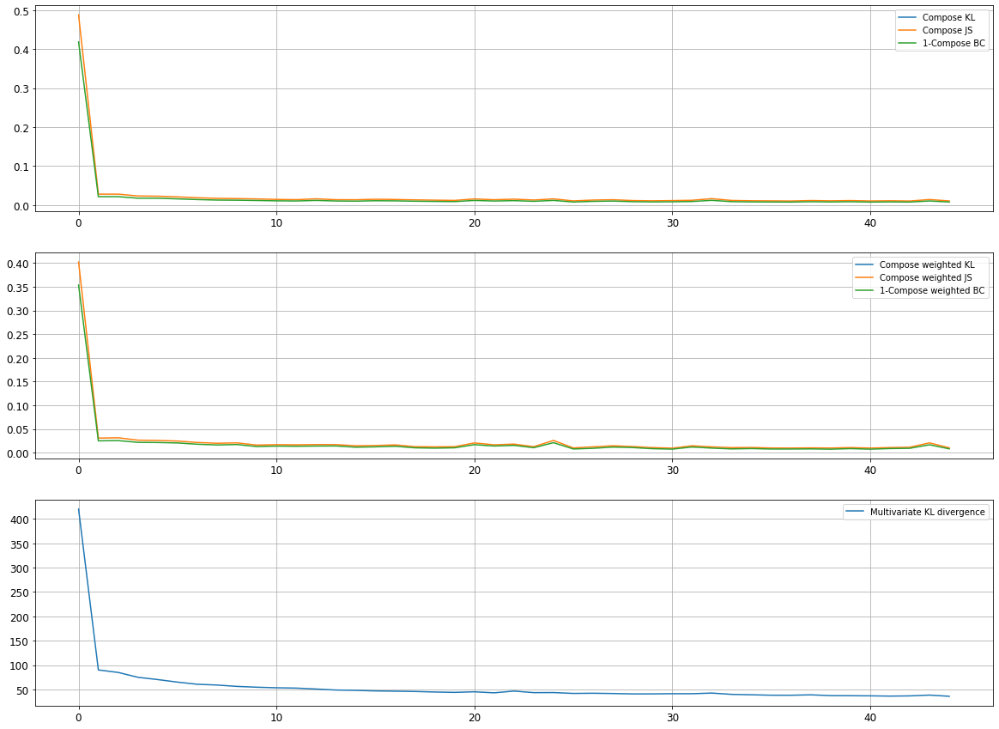

Epoch 8802/10000
discriminator loss: 0.046883 - generator loss: 9.313219 - 28s
Epoch 8803/10000
discriminator loss: 0.172735 - generator loss: 8.943280 - 28s
Epoch 8804/10000
discriminator loss: 0.035934 - generator loss: 9.308229 - 28s
Epoch 8805/10000
discriminator loss: 0.039108 - generator loss: 9.455818 - 28s
Epoch 8806/10000
discriminator loss: 0.052265 - generator loss: 9.357924 - 28s
Epoch 8807/10000
discriminator loss: 0.410465 - generator loss: 8.520482 - 29s
Epoch 8808/10000
discriminator loss: 0.033647 - generator loss: 9.300236 - 29s
Epoch 8809/10000
discriminator loss: 0.029240 - generator loss: 9.607884 - 29s
Epoch 8810/10000
discriminator loss: 0.041854 - generator loss: 9.340861 - 28s
Epoch 8811/10000
discriminator loss: 0.209809 - generator loss: 8.932419 - 29s
Epoch 8812/10000
discriminator loss: 0.031797 - generator loss: 9.494693 - 29s
Epoch 8813/10000
discriminator loss: 0.029910 - generator loss: 9.551573 - 29s
Epoch 8814/10000
discriminator loss: 0.076282 - gene

discriminator loss: 0.146016 - generator loss: 8.867702 - 29s
Epoch 8907/10000
discriminator loss: 0.025388 - generator loss: 9.746900 - 29s
Epoch 8908/10000
discriminator loss: 0.103916 - generator loss: 9.273214 - 29s
Epoch 8909/10000
discriminator loss: 0.041013 - generator loss: 9.487971 - 29s
Epoch 8910/10000
discriminator loss: 0.256398 - generator loss: 8.777642 - 29s
Epoch 8911/10000
discriminator loss: 0.029961 - generator loss: 9.538031 - 29s
Epoch 8912/10000
discriminator loss: 0.047177 - generator loss: 9.433689 - 28s
Epoch 8913/10000
discriminator loss: 0.033492 - generator loss: 9.487959 - 28s
Epoch 8914/10000
discriminator loss: 0.237096 - generator loss: 8.937359 - 29s
Epoch 8915/10000
discriminator loss: 0.040728 - generator loss: 9.526026 - 28s
Epoch 8916/10000
discriminator loss: 0.048924 - generator loss: 9.380268 - 29s
Epoch 8917/10000
discriminator loss: 0.031591 - generator loss: 9.599211 - 29s
Epoch 8918/10000
discriminator loss: 0.252726 - generator loss: 8.735

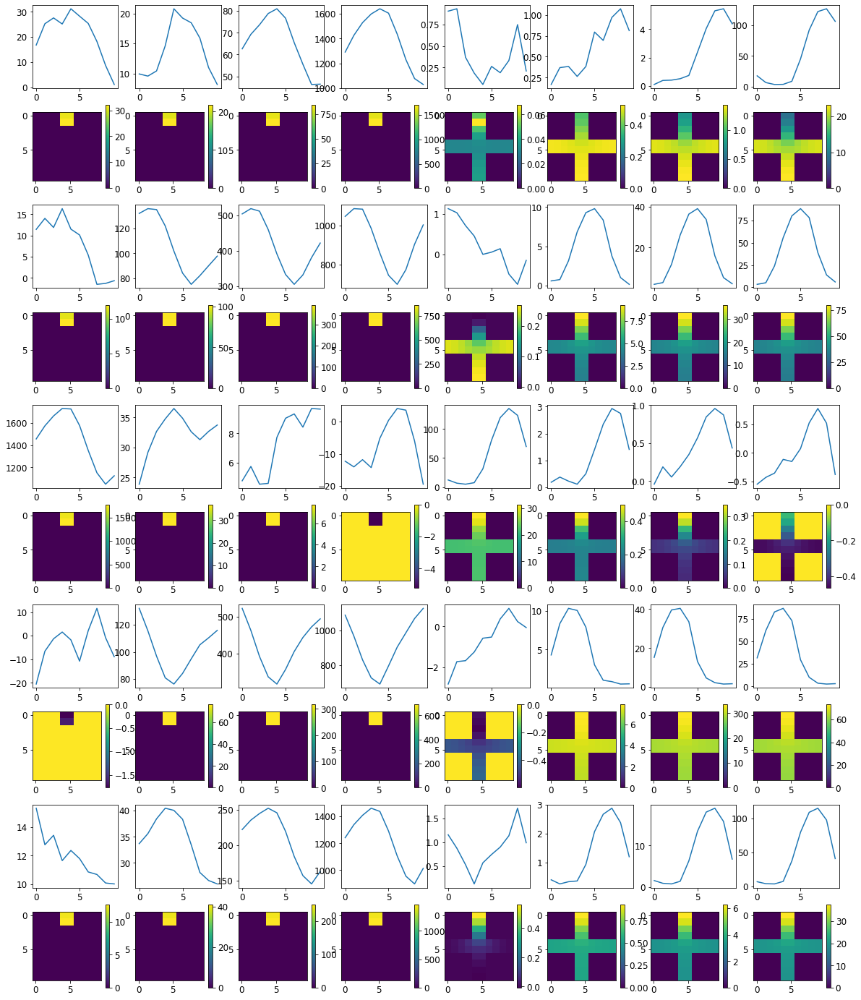


R0 generated:
[[19.396732   17.903536  ]
 [19.427794   17.842957  ]
 [19.442348   17.870075  ]
 [19.433624   17.837254  ]
 [19.434704   17.795876  ]
 [19.424105   17.709213  ]
 [19.449593   17.747093  ]
 [19.448683   17.7405    ]
 [19.401258   17.71724   ]
 [19.421677   17.930056  ]
 [17.015038    0.41182095]
 [17.032045    0.39868832]
 [17.019026    0.3895336 ]
 [16.993448    0.39498097]
 [16.98377     0.38217196]
 [16.972618    0.39081994]
 [16.945463    0.38194862]
 [16.930134    0.39294067]
 [16.968714    0.40061605]
 [16.984491    0.42164856]
 [16.818254    0.44242623]
 [16.89852     0.42174885]
 [16.887829    0.41957155]
 [16.874332    0.4338937 ]
 [16.835302    0.42549062]
 [16.8457      0.44070083]
 [16.866888    0.4262568 ]
 [16.834684    0.40588555]
 [16.837688    0.41458544]
 [16.892128    0.41410613]
 [19.6697     16.991821  ]
 [19.674776   16.931938  ]
 [19.673525   16.920877  ]
 [19.673817   16.888441  ]
 [19.671913   16.849298  ]
 [19.667862   16.79226   ]
 [19.672071  

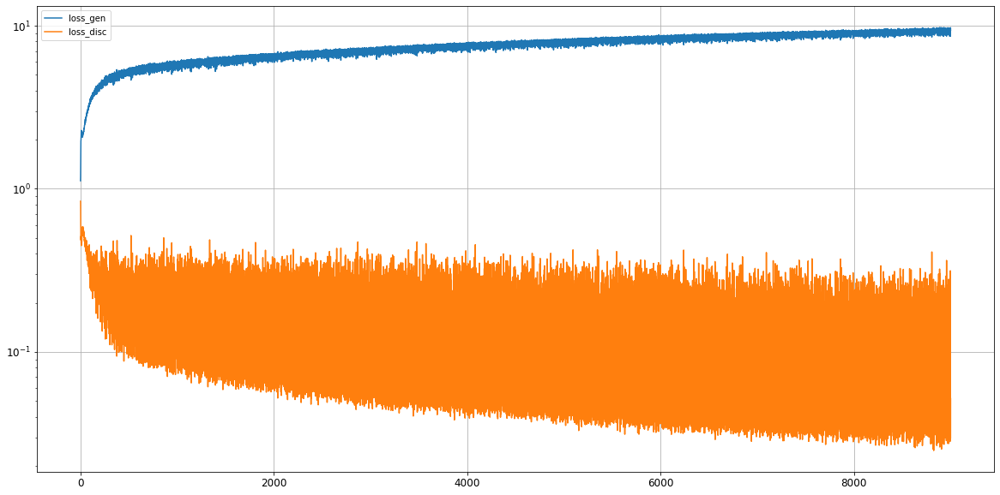

0: mean KL divergence (r,g) = 0.030569201446594852
0: mean JS divergence = 0.008028842904078456
0: mean 1-BC divergence = 0.006153785314450211

0: std KL divergence (r,g) = 0.08341611200429773
0: std JS divergence = 0.026144615168911985
0: std 1-BC divergence = 0.024195887997456644


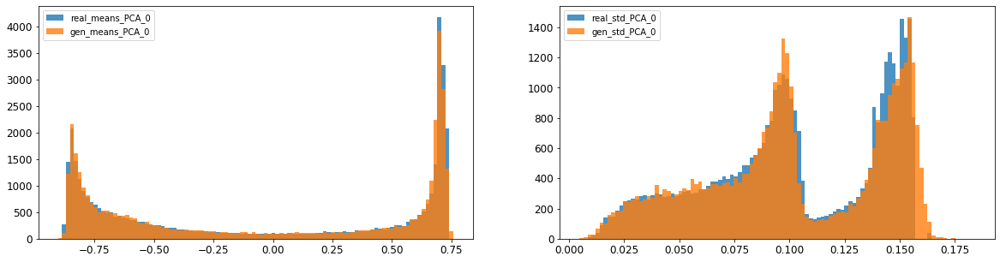

1: mean KL divergence (r,g) = 0.021485334484983156
1: mean JS divergence = 0.005614191443708793
1: mean 1-BC divergence = 0.003955190241897499

1: std KL divergence (r,g) = 0.028705518129240406
1: std JS divergence = 0.006833598383209674
1: std 1-BC divergence = 0.004757882397547597


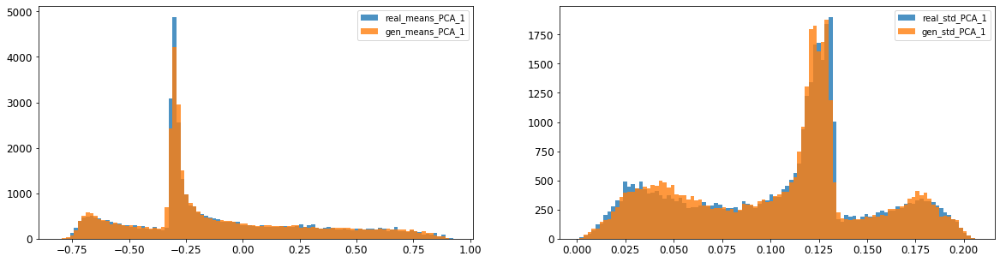

2: mean KL divergence (r,g) = 0.008252745156281289
2: mean JS divergence = 0.002072300698888724
2: mean 1-BC divergence = 0.0014802955343036217

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.006212109125291999
2: std 1-BC divergence = 0.005515468481150032


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


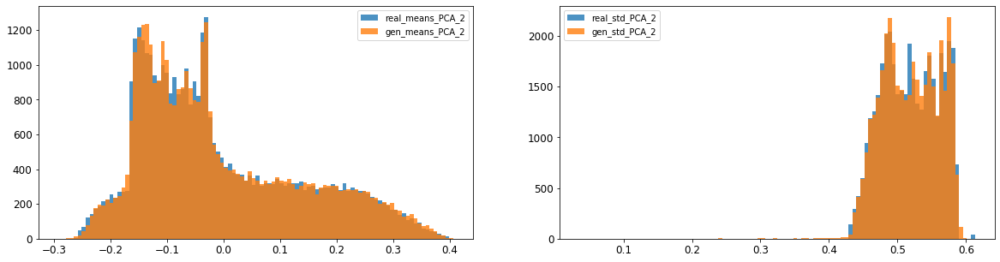

3: mean KL divergence (r,g) = 0.03827268576882643
3: mean JS divergence = 0.009486619268591515
3: mean 1-BC divergence = 0.006655146366348563

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.04638892024087732
3: std 1-BC divergence = 0.03306259507104381


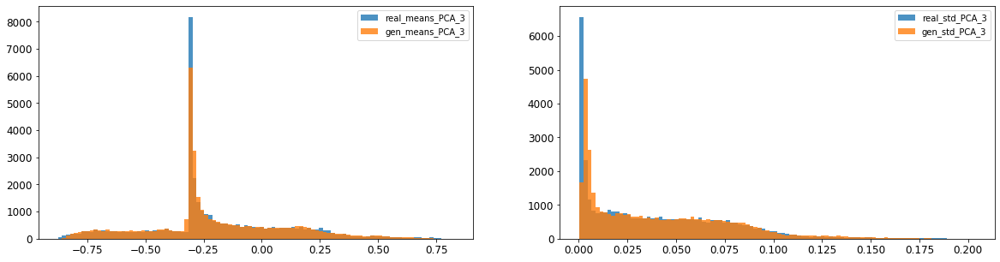

4: mean KL divergence (r,g) = 0.05672153477541453
4: mean JS divergence = 0.015836788581863638
4: mean 1-BC divergence = 0.013503418866242733

4: std KL divergence (r,g) = 0.013314713849774536
4: std JS divergence = 0.003430816267105531
4: std 1-BC divergence = 0.0025199108487584665


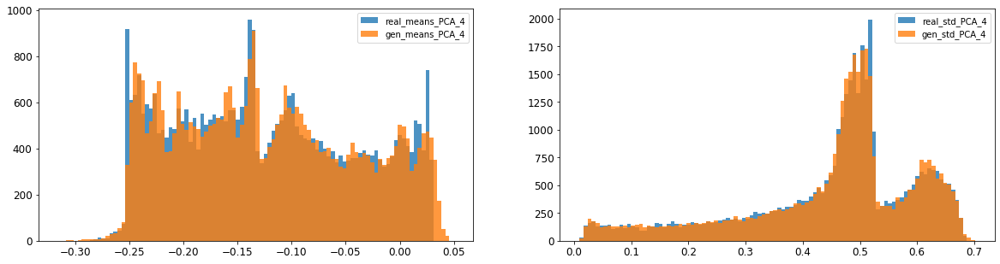

5: mean KL divergence (r,g) = 0.058465614442028205
5: mean JS divergence = 0.014948781327238819
5: mean 1-BC divergence = 0.011136303785945212

5: std KL divergence (r,g) = 0.038811736401730794
5: std JS divergence = 0.010751376548698035
5: std 1-BC divergence = 0.009401416680052566


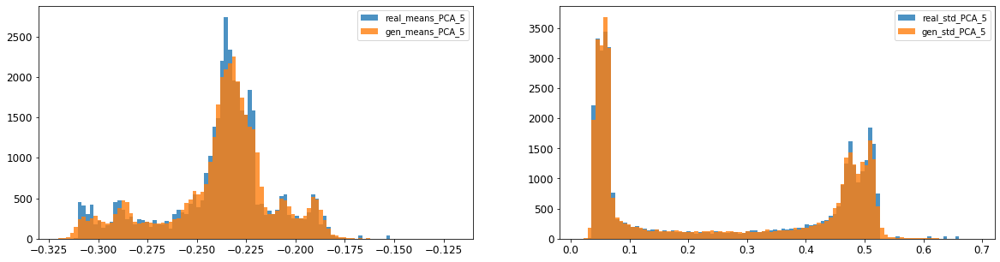

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.003883015048117352
6: mean 1-BC divergence = 0.0027532216600980597

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.007901594014330372
6: std 1-BC divergence = 0.005744303584018229


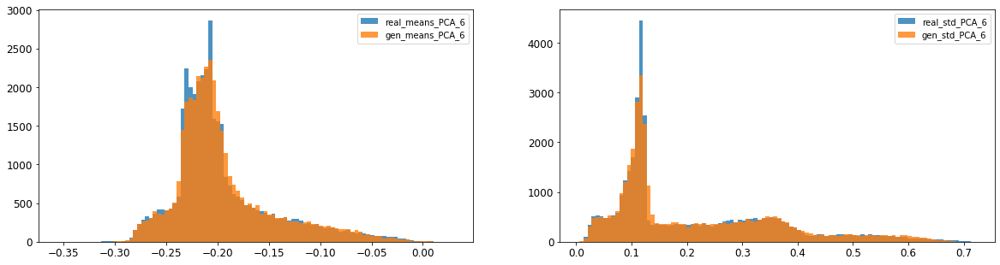

7: mean KL divergence (r,g) = 0.06930034095995793
7: mean JS divergence = 0.016877621401201442
7: mean 1-BC divergence = 0.01235678626092318

7: std KL divergence (r,g) = 0.017303136769056853
7: std JS divergence = 0.0043100179569416485
7: std 1-BC divergence = 0.003105048547508371


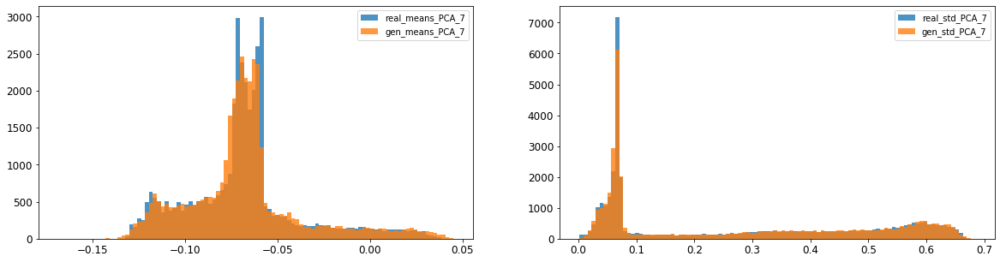

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.006363405847849642
8: mean 1-BC divergence = 0.004446198252321953

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008715882096808854
8: std 1-BC divergence = 0.006182658994863921


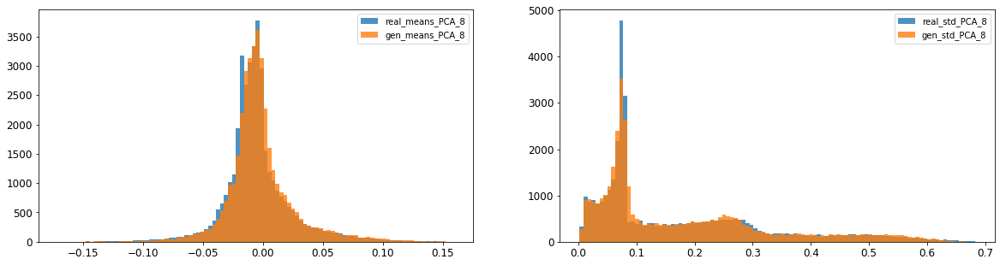

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003996775624833488
9: mean 1-BC divergence = 0.0028722868725774564

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.006212288461149689
9: std 1-BC divergence = 0.004426107293289849


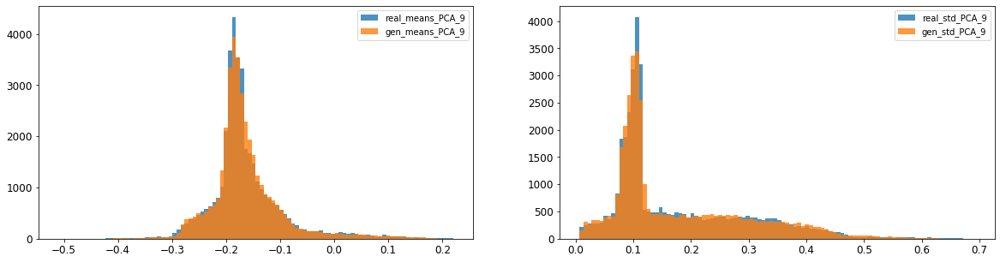

10: mean KL divergence (r,g) = 0.02723917345503798
10: mean JS divergence = 0.006784315391727943
10: mean 1-BC divergence = 0.004752741198213006

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004569206542191191
10: std 1-BC divergence = 0.003900556308796488


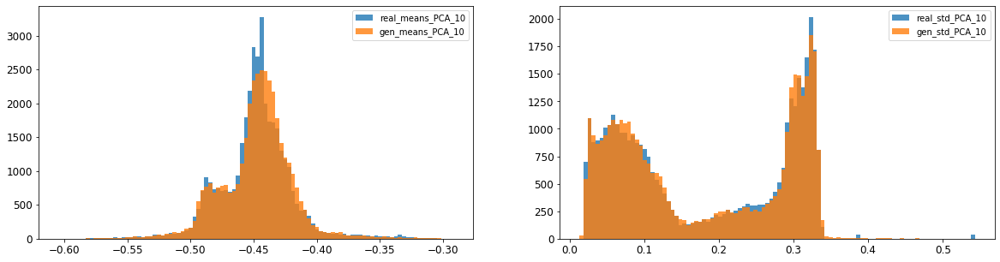

11: mean KL divergence (r,g) = 0.032767582078525266
11: mean JS divergence = 0.008203462261499471
11: mean 1-BC divergence = 0.005765773897392079

11: std KL divergence (r,g) = 0.036055363872467924
11: std JS divergence = 0.009493281129467342
11: std 1-BC divergence = 0.00675363053152811


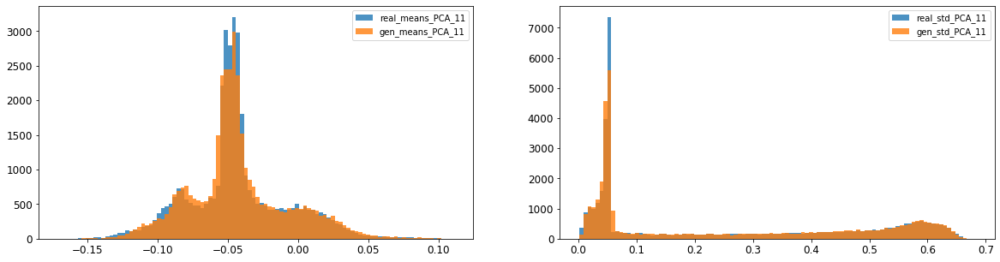

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004095902455669169
12: mean 1-BC divergence = 0.0028978209514282094

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01119583511141971
12: std 1-BC divergence = 0.007910138318580007


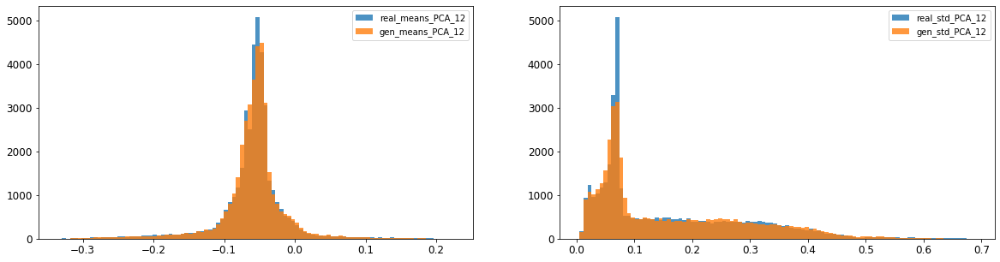

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.01070769727696647
13: mean 1-BC divergence = 0.007500773548916317

13: std KL divergence (r,g) = 0.05553965034329284
13: std JS divergence = 0.013389075945828903
13: std 1-BC divergence = 0.009345847246551187


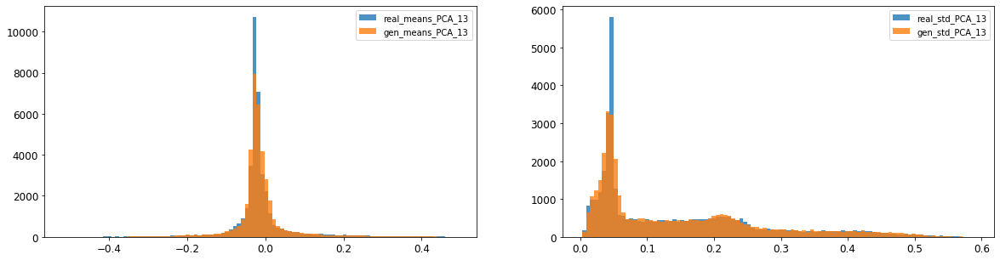

14: mean KL divergence (r,g) = 0.044728798780995026
14: mean JS divergence = 0.011025757013891626
14: mean 1-BC divergence = 0.00774500499241737

14: std KL divergence (r,g) = 0.02860299247112243
14: std JS divergence = 0.007179868811421833
14: std 1-BC divergence = 0.005013413127256894


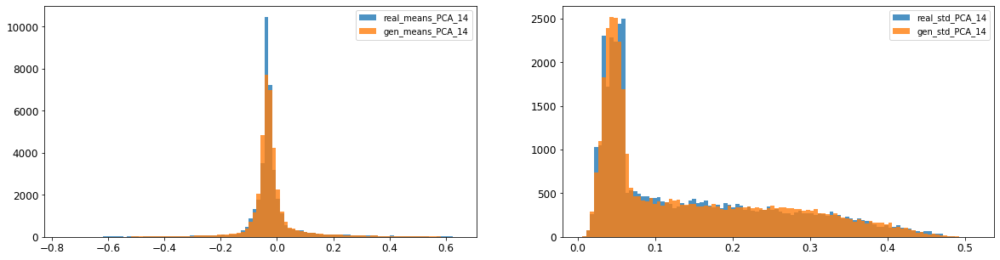

15: mean KL divergence (r,g) = 1.69619000108546
15: mean JS divergence = 0.4469315320344246
15: mean 1-BC divergence = 0.4112660570293277

15: std KL divergence (r,g) = 7.671077658509749
15: std JS divergence = 0.9776327767307522
15: std 1-BC divergence = 0.9299532866147543


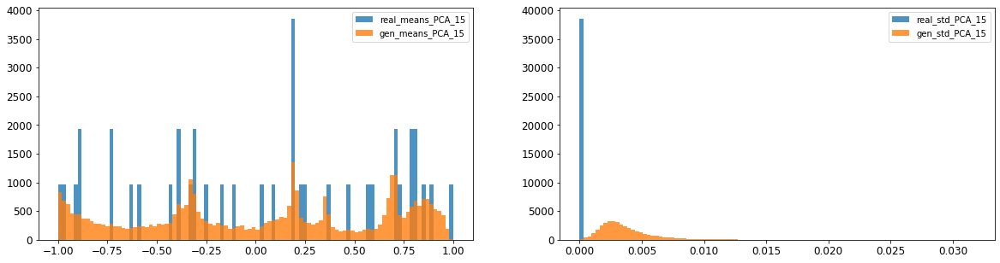

16: mean KL divergence (r,g) = 1.333850213050631
16: mean JS divergence = 0.37631293899588913
16: mean 1-BC divergence = 0.34730178004669054

16: std KL divergence (r,g) = 5.4211427772163745
16: std JS divergence = 0.9197091297319879
16: std 1-BC divergence = 0.8472304826173455


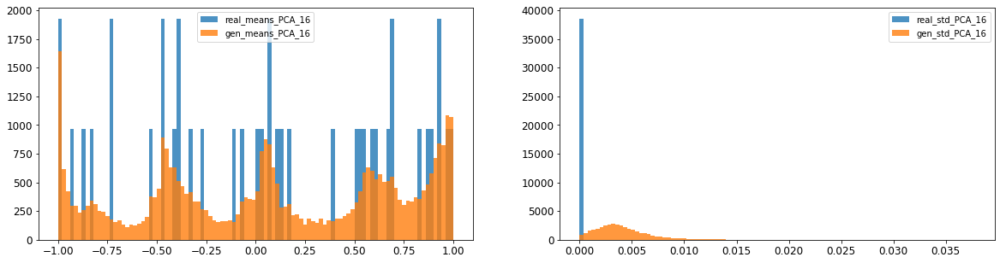



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010021798744992686
Compose 1-BC divergence = 0.00752698710572941

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.01348659947298554
Compose weighted 1-BC divergence = 0.011378004189209867

Multivariate KL divergence = 36.32111861071167


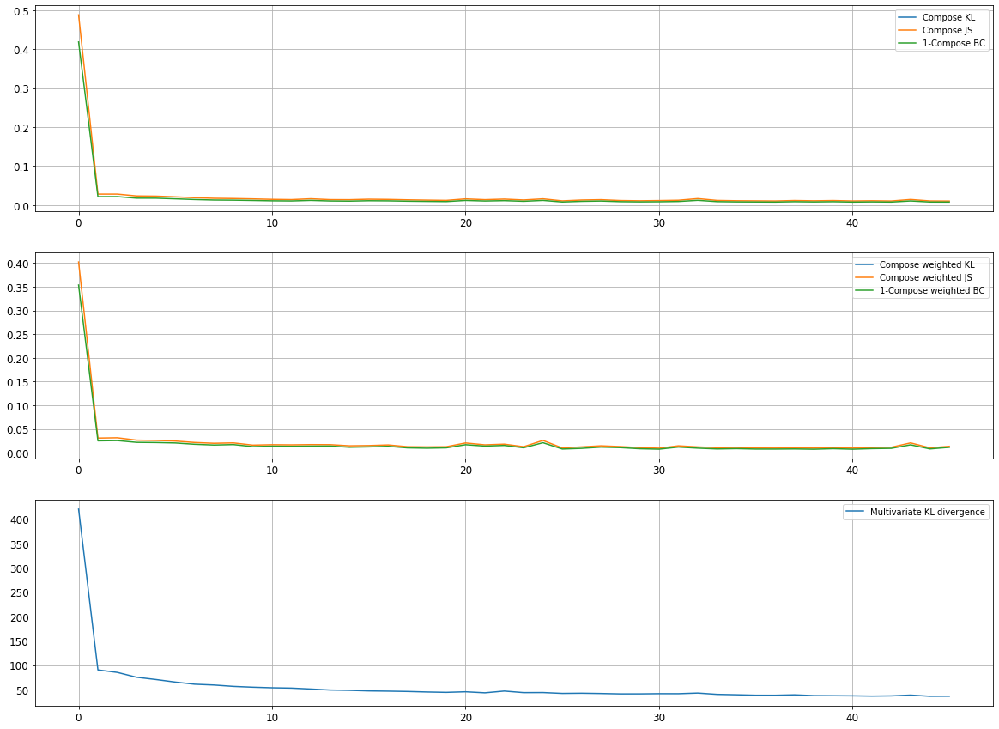

Epoch 9002/10000
discriminator loss: 0.219842 - generator loss: 9.161100 - 27s
Epoch 9003/10000
discriminator loss: 0.033427 - generator loss: 9.450341 - 28s
Epoch 9004/10000
discriminator loss: 0.028960 - generator loss: 9.635357 - 29s
Epoch 9005/10000
discriminator loss: 0.263302 - generator loss: 9.111868 - 29s
Epoch 9006/10000
discriminator loss: 0.047780 - generator loss: 9.115686 - 28s
Epoch 9007/10000
discriminator loss: 0.032041 - generator loss: 9.546994 - 29s
Epoch 9008/10000
discriminator loss: 0.032325 - generator loss: 9.588710 - 28s
Epoch 9009/10000
discriminator loss: 0.037949 - generator loss: 9.473748 - 28s
Epoch 9010/10000
discriminator loss: 0.212987 - generator loss: 8.918610 - 29s
Epoch 9011/10000
discriminator loss: 0.029881 - generator loss: 9.514145 - 28s
Epoch 9012/10000
discriminator loss: 0.314623 - generator loss: 9.006675 - 29s
Epoch 9013/10000
discriminator loss: 0.036723 - generator loss: 9.274110 - 28s
Epoch 9014/10000
discriminator loss: 0.029235 - gene

discriminator loss: 0.104908 - generator loss: 9.503904 - 23s
Epoch 9107/10000
discriminator loss: 0.163416 - generator loss: 8.976825 - 23s
Epoch 9108/10000
discriminator loss: 0.032641 - generator loss: 9.511070 - 25s
Epoch 9109/10000
discriminator loss: 0.159366 - generator loss: 9.295083 - 28s
Epoch 9110/10000
discriminator loss: 0.043717 - generator loss: 9.228590 - 29s
Epoch 9111/10000
discriminator loss: 0.028760 - generator loss: 9.757371 - 28s
Epoch 9112/10000
discriminator loss: 0.178911 - generator loss: 8.987407 - 29s
Epoch 9113/10000
discriminator loss: 0.175425 - generator loss: 9.525451 - 28s
Epoch 9114/10000
discriminator loss: 0.043502 - generator loss: 9.331100 - 28s
Epoch 9115/10000
discriminator loss: 0.027426 - generator loss: 9.639174 - 28s
Epoch 9116/10000
discriminator loss: 0.036393 - generator loss: 9.551794 - 28s
Epoch 9117/10000
discriminator loss: 0.122034 - generator loss: 9.099943 - 28s
Epoch 9118/10000
discriminator loss: 0.040307 - generator loss: 9.564

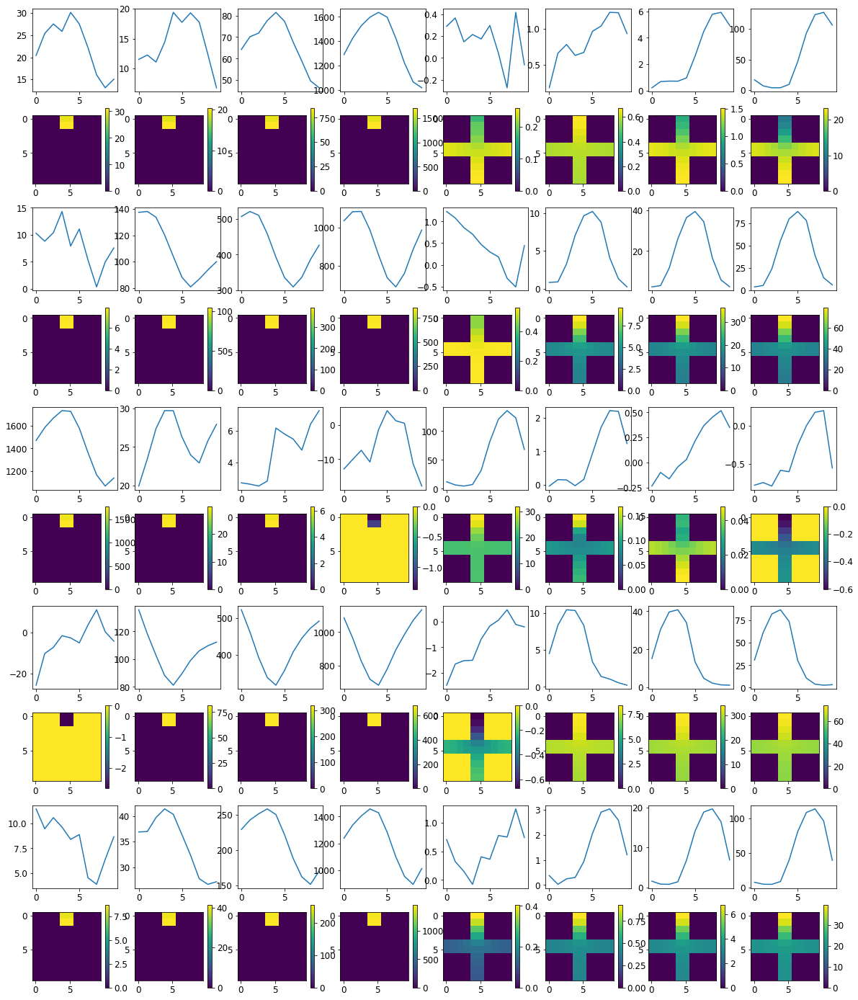


R0 generated:
[[19.290133   18.030304  ]
 [19.317362   17.972858  ]
 [19.334085   18.012602  ]
 [19.324556   17.98953   ]
 [19.317465   17.971968  ]
 [19.30102    17.901922  ]
 [19.330242   17.934755  ]
 [19.334389   17.923128  ]
 [19.28064    17.921862  ]
 [19.314106   18.131111  ]
 [16.970783    0.39244914]
 [17.021425    0.37820977]
 [17.06248     0.37215483]
 [17.055319    0.36993146]
 [17.075386    0.36252606]
 [17.082558    0.36571798]
 [17.098001    0.35005644]
 [17.082674    0.3576566 ]
 [17.136553    0.3638812 ]
 [17.134054    0.381383  ]
 [16.8551      0.5030123 ]
 [16.981909    0.47712082]
 [17.012018    0.48092207]
 [17.021603    0.48697934]
 [17.008831    0.48284572]
 [17.011583    0.49038   ]
 [17.073698    0.478971  ]
 [17.041786    0.4545297 ]
 [17.063917    0.46476254]
 [17.124311    0.4654197 ]
 [19.63085    17.041077  ]
 [19.638763   16.934479  ]
 [19.638508   16.897957  ]
 [19.637594   16.855928  ]
 [19.6359     16.831575  ]
 [19.629414   16.735128  ]
 [19.632725  

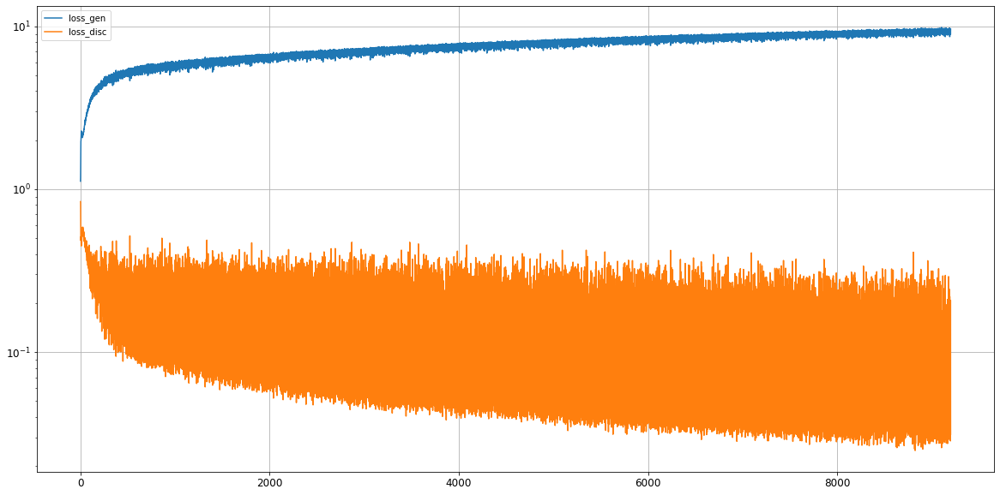

0: mean KL divergence (r,g) = 0.02588063794158213
0: mean JS divergence = 0.00642013170152426
0: mean 1-BC divergence = 0.004544574932902168

0: std KL divergence (r,g) = 0.04033714628973423
0: std JS divergence = 0.009206239847905183
0: std 1-BC divergence = 0.006844557681265906


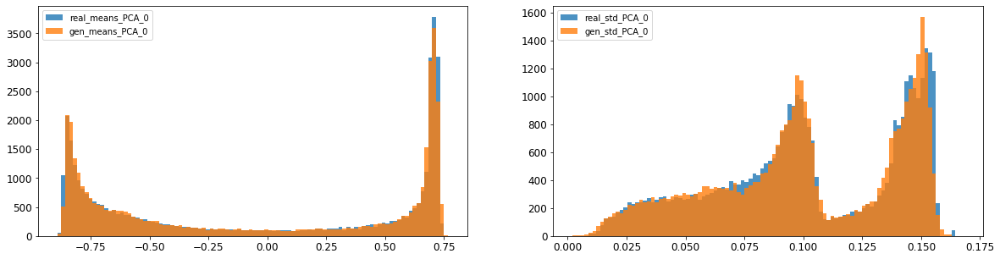

1: mean KL divergence (r,g) = 0.024095653265434284
1: mean JS divergence = 0.0063596743765020666
1: mean 1-BC divergence = 0.004498964524672022

1: std KL divergence (r,g) = 0.023677699808163227
1: std JS divergence = 0.0062295766609300265
1: std 1-BC divergence = 0.004370189043197192


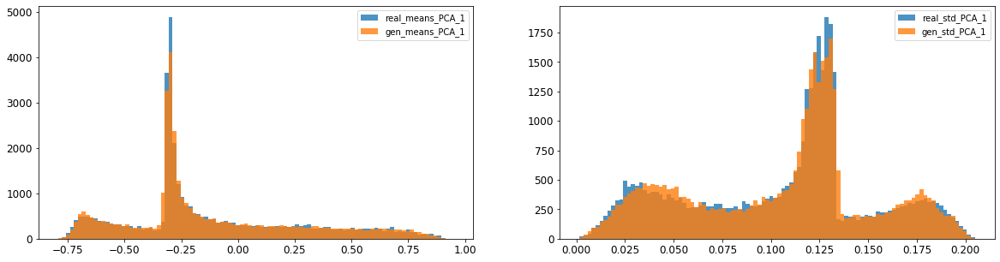

2: mean KL divergence (r,g) = 0.011519819444706487
2: mean JS divergence = 0.0029694785273492864
2: mean 1-BC divergence = 0.0021460117627591924

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.006287489629492365
2: std 1-BC divergence = 0.00563399825001254


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


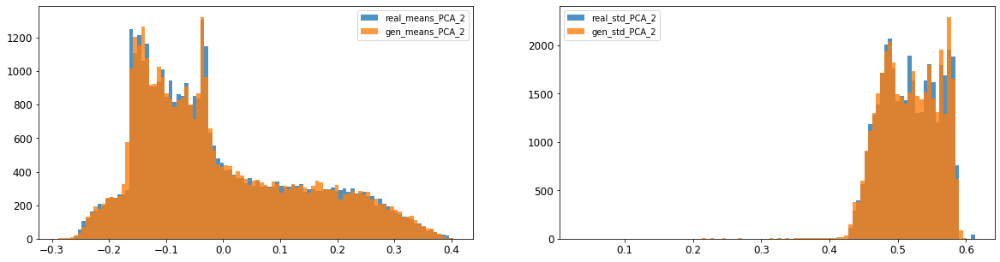

3: mean KL divergence (r,g) = 0.04068743473742457
3: mean JS divergence = 0.010344314353717859
3: mean 1-BC divergence = 0.007405260555707338

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.05117262955157157
3: std 1-BC divergence = 0.03661393783689115


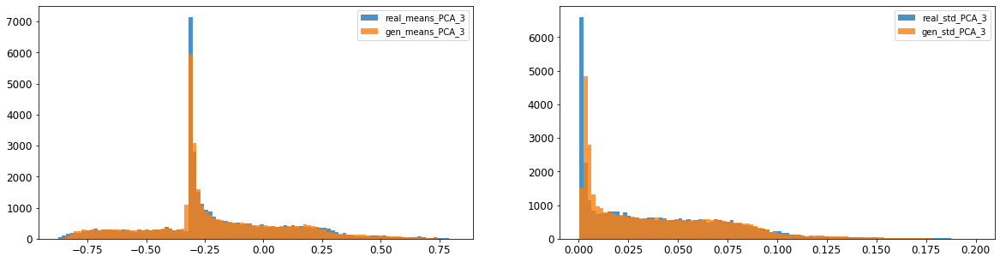

4: mean KL divergence (r,g) = 0.0705744065374907
4: mean JS divergence = 0.020656236502402534
4: mean 1-BC divergence = 0.01643888542808125

4: std KL divergence (r,g) = 0.014126693738774794
4: std JS divergence = 0.0034864998760376093
4: std 1-BC divergence = 0.002444431880539999


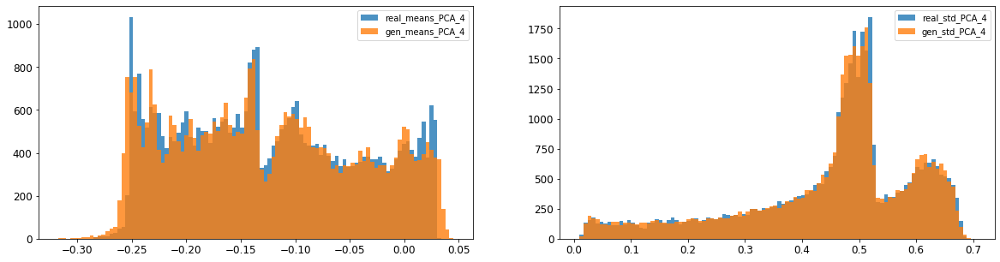

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.020926890865024465
5: mean 1-BC divergence = 0.01592356960836394

5: std KL divergence (r,g) = 0.05289471827754018
5: std JS divergence = 0.01471551007240252
5: std 1-BC divergence = 0.013186721491059594


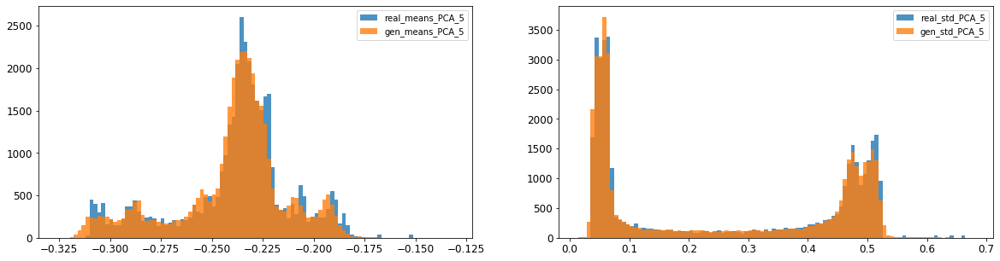

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0033381520656159728
6: mean 1-BC divergence = 0.002416961510779414

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.01074847177906706
6: std 1-BC divergence = 0.007773978538099802


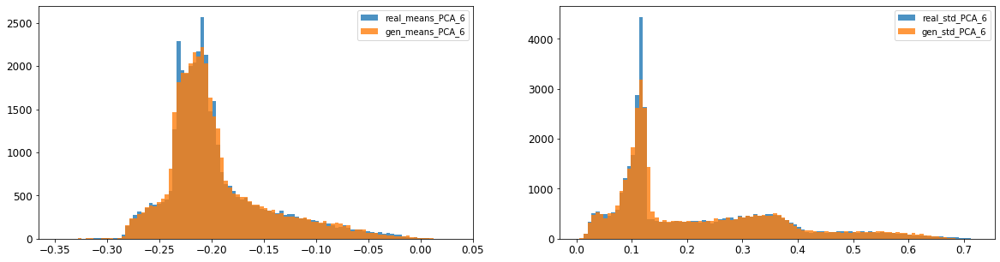

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.014994693462590507
7: mean 1-BC divergence = 0.011346438056059172

7: std KL divergence (r,g) = 0.01915359027890937
7: std JS divergence = 0.004646771608299076
7: std 1-BC divergence = 0.0032927300973322193


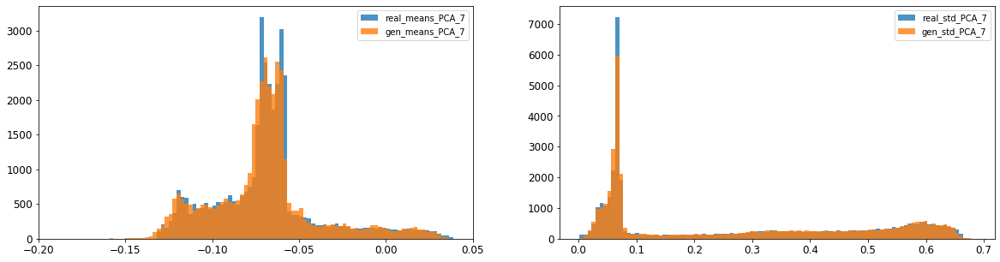

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.0033050136901644272
8: mean 1-BC divergence = 0.0023352092684324477

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008518706452314666
8: std 1-BC divergence = 0.006040879140592925


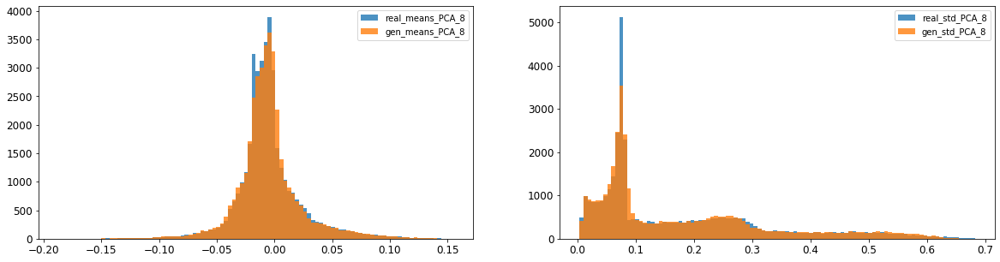

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003812836987316018
9: mean 1-BC divergence = 0.0027377396266955456

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.008305360528988533
9: std 1-BC divergence = 0.005871806454703643


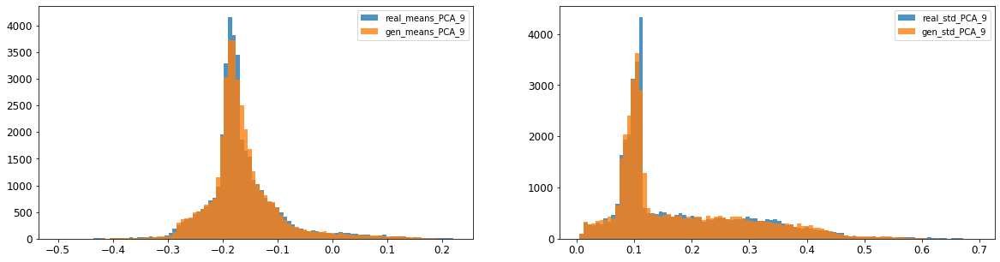

10: mean KL divergence (r,g) = 0.015149250900545771
10: mean JS divergence = 0.003711120409161805
10: mean 1-BC divergence = 0.002650043548790504

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.006068563972024607
10: std 1-BC divergence = 0.004943658446520782


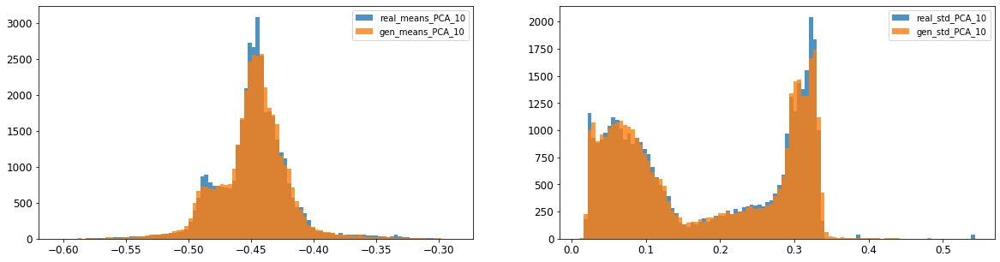

11: mean KL divergence (r,g) = 0.030309290299152292
11: mean JS divergence = 0.0077394458590905576
11: mean 1-BC divergence = 0.00543637805711461

11: std KL divergence (r,g) = 0.0474411174864005
11: std JS divergence = 0.013067890643365672
11: std 1-BC divergence = 0.009427198776967294


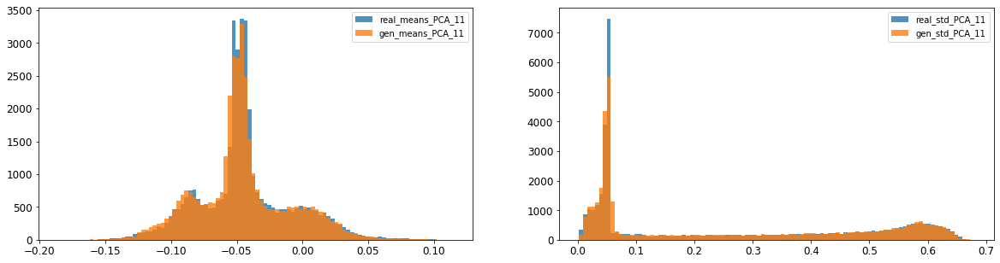

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.004446360161639744
12: mean 1-BC divergence = 0.003126140080860096

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.010686303645093239
12: std 1-BC divergence = 0.007602252960748457


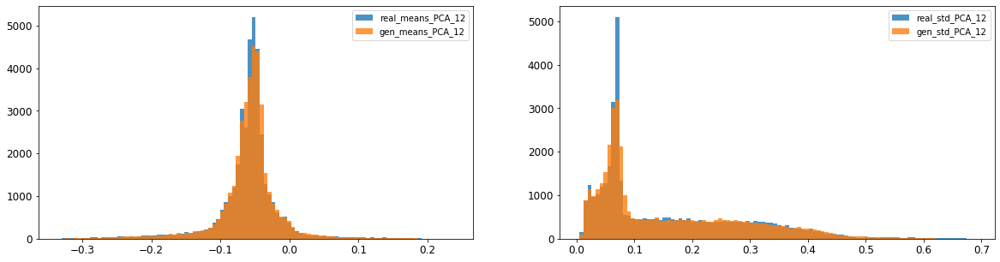

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.01100822823250883
13: mean 1-BC divergence = 0.007745512376828634

13: std KL divergence (r,g) = 0.0680610932291437
13: std JS divergence = 0.016395090393142707
13: std 1-BC divergence = 0.01148496605800542


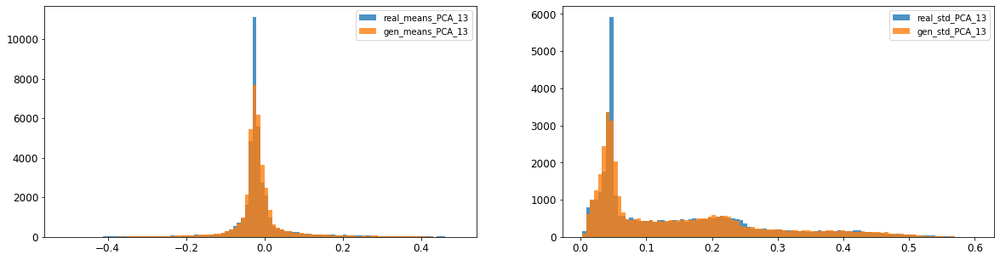

14: mean KL divergence (r,g) = 0.03931551497808903
14: mean JS divergence = 0.009989719414734916
14: mean 1-BC divergence = 0.0070457931596928924

14: std KL divergence (r,g) = 0.030182966450744596
14: std JS divergence = 0.007455109875287287
14: std 1-BC divergence = 0.005209132385780468


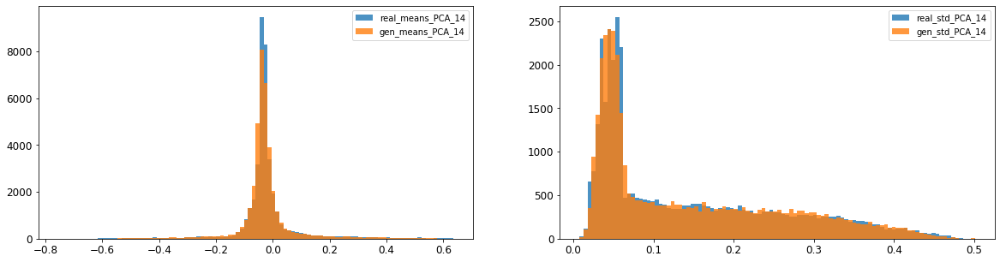

15: mean KL divergence (r,g) = 1.6572155138578077
15: mean JS divergence = 0.4437672324879979
15: mean 1-BC divergence = 0.4074007626153964

15: std KL divergence (r,g) = 7.6408630454627415
15: std JS divergence = 0.9772349027176411
15: std 1-BC divergence = 0.9292159324707057


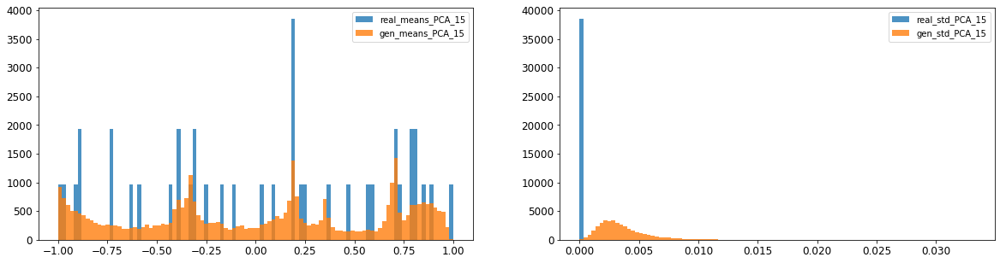

16: mean KL divergence (r,g) = 1.3363611845081913
16: mean JS divergence = 0.37526022215037086
16: mean 1-BC divergence = 0.34609616983956026

16: std KL divergence (r,g) = 5.356803136165822
16: std JS divergence = 0.9168231813779261
16: std 1-BC divergence = 0.8437856998207984


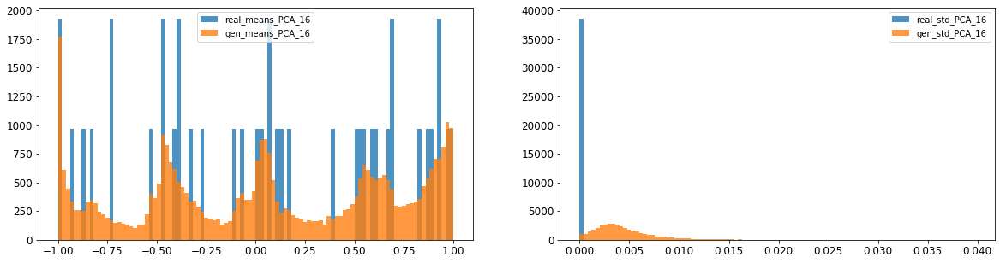



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010233750371508846
Compose 1-BC divergence = 0.007551264051315232

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.008718607033278626
Compose weighted 1-BC divergence = 0.006403074312506085

Multivariate KL divergence = 35.18125734970755


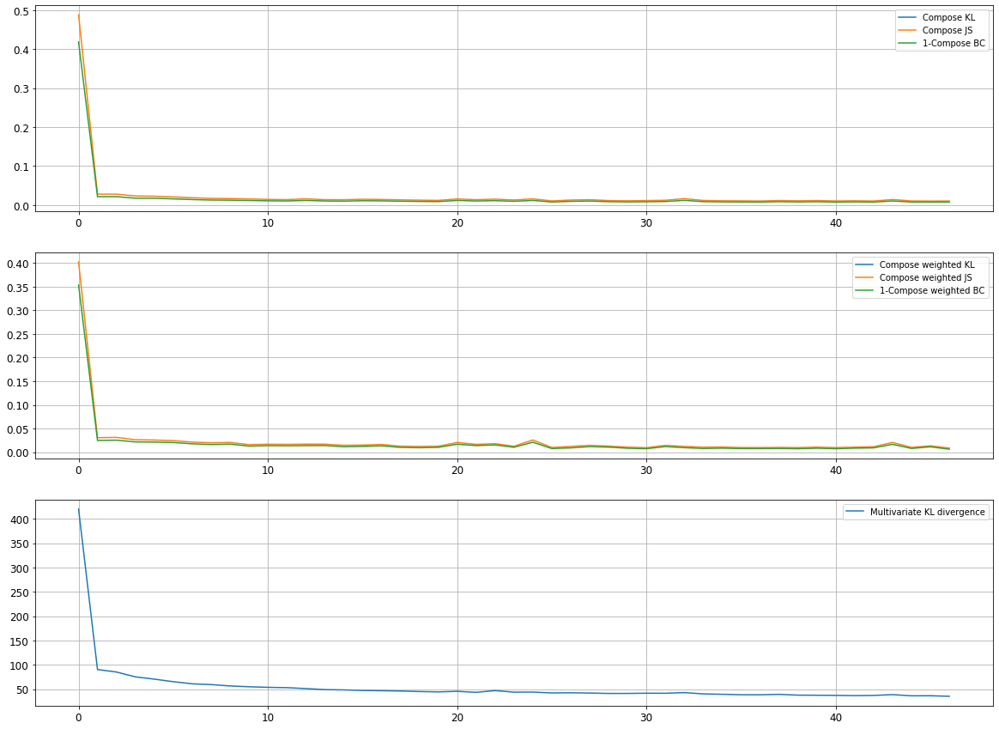

Epoch 9202/10000
discriminator loss: 0.049213 - generator loss: 9.426296 - 27s
Epoch 9203/10000
discriminator loss: 0.029335 - generator loss: 9.740746 - 28s
Epoch 9204/10000
discriminator loss: 0.183879 - generator loss: 9.140009 - 28s
Epoch 9205/10000
discriminator loss: 0.037770 - generator loss: 9.638001 - 28s
Epoch 9206/10000
discriminator loss: 0.150018 - generator loss: 9.082784 - 29s
Epoch 9207/10000
discriminator loss: 0.036681 - generator loss: 9.501415 - 29s
Epoch 9208/10000
discriminator loss: 0.034968 - generator loss: 9.611769 - 29s
Epoch 9209/10000
discriminator loss: 0.187327 - generator loss: 8.798918 - 29s
Epoch 9210/10000
discriminator loss: 0.026702 - generator loss: 9.744967 - 29s
Epoch 9211/10000
discriminator loss: 0.157412 - generator loss: 9.044935 - 28s
Epoch 9212/10000
discriminator loss: 0.027453 - generator loss: 9.558157 - 29s
Epoch 9213/10000
discriminator loss: 0.182669 - generator loss: 9.023570 - 29s
Epoch 9214/10000
discriminator loss: 0.030782 - gene

discriminator loss: 0.034663 - generator loss: 9.649239 - 23s
Epoch 9307/10000
discriminator loss: 0.038971 - generator loss: 9.593751 - 23s
Epoch 9308/10000
discriminator loss: 0.273566 - generator loss: 8.821376 - 23s
Epoch 9309/10000
discriminator loss: 0.032064 - generator loss: 9.576360 - 23s
Epoch 9310/10000
discriminator loss: 0.040566 - generator loss: 9.604876 - 26s
Epoch 9311/10000
discriminator loss: 0.034796 - generator loss: 9.729082 - 29s
Epoch 9312/10000
discriminator loss: 0.289313 - generator loss: 8.486361 - 28s
Epoch 9313/10000
discriminator loss: 0.033509 - generator loss: 9.386173 - 29s
Epoch 9314/10000
discriminator loss: 0.029186 - generator loss: 9.676248 - 29s
Epoch 9315/10000
discriminator loss: 0.030707 - generator loss: 9.659828 - 28s
Epoch 9316/10000
discriminator loss: 0.229370 - generator loss: 9.083867 - 29s
Epoch 9317/10000
discriminator loss: 0.041743 - generator loss: 9.534291 - 29s
Epoch 9318/10000
discriminator loss: 0.031629 - generator loss: 9.659

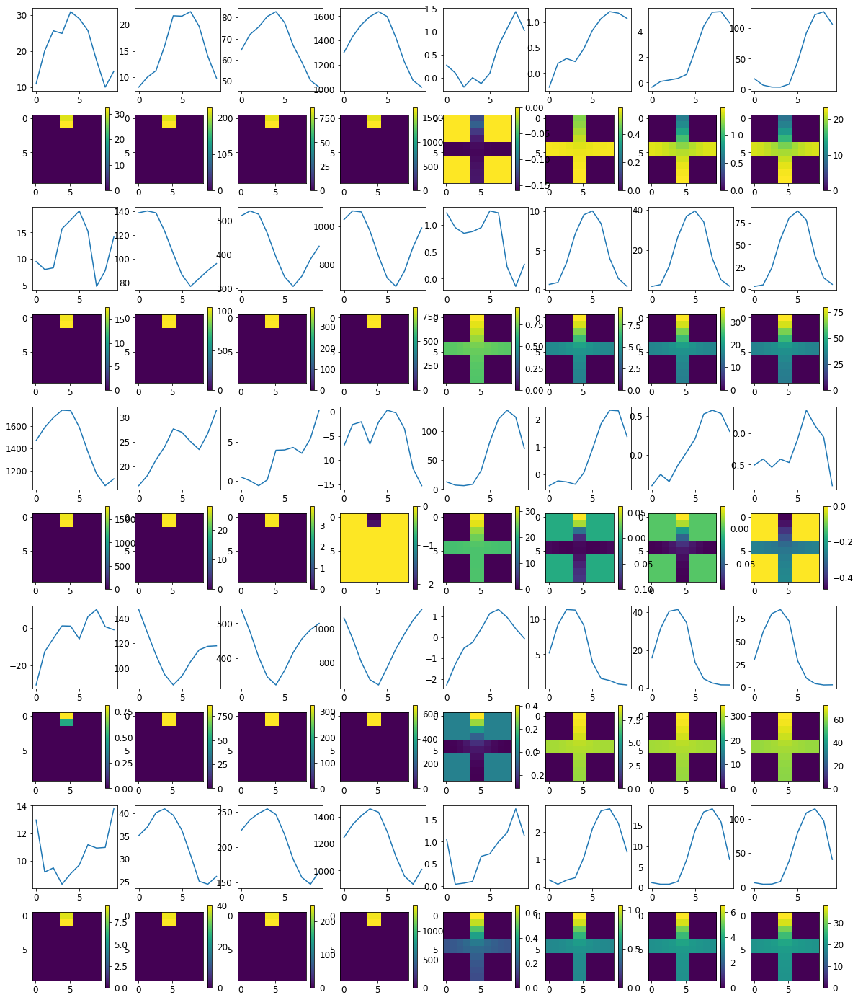


R0 generated:
[[19.274864   17.881222  ]
 [19.293762   17.833725  ]
 [19.314953   17.869503  ]
 [19.303778   17.846514  ]
 [19.308146   17.823982  ]
 [19.297876   17.73539   ]
 [19.326023   17.820509  ]
 [19.325876   17.797388  ]
 [19.262104   17.821775  ]
 [19.298994   17.989094  ]
 [17.049639    0.58008796]
 [17.069206    0.55973184]
 [17.084522    0.56630224]
 [17.050777    0.5685343 ]
 [17.06632     0.5548256 ]
 [17.075235    0.5702096 ]
 [17.063723    0.556386  ]
 [17.041512    0.56182635]
 [17.05489     0.5741269 ]
 [17.061934    0.5984224 ]
 [16.733595    0.631258  ]
 [16.820004    0.61023664]
 [16.858517    0.62648827]
 [16.85457     0.6161341 ]
 [16.828838    0.62157094]
 [16.82796     0.62314886]
 [16.856627    0.607857  ]
 [16.843288    0.5820151 ]
 [16.854967    0.5794366 ]
 [16.917276    0.5832967 ]
 [19.592882   17.203798  ]
 [19.59452    17.123745  ]
 [19.59335    17.119347  ]
 [19.59175    17.122332  ]
 [19.592737   17.133583  ]
 [19.590631   17.061808  ]
 [19.602928  

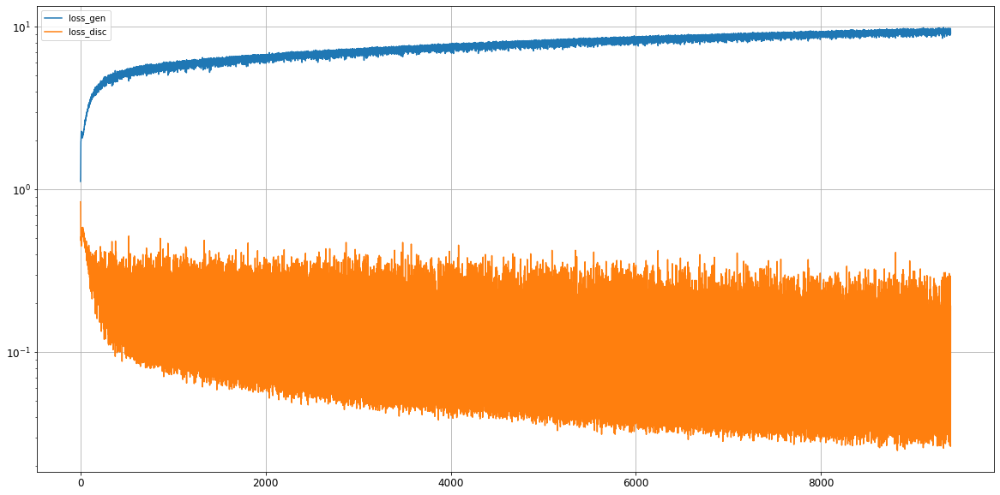

0: mean KL divergence (r,g) = 0.03357908418864936
0: mean JS divergence = 0.009796735255270634
0: mean 1-BC divergence = 0.008606498496209314

0: std KL divergence (r,g) = 0.04139877225991541
0: std JS divergence = 0.01220298713368198
0: std 1-BC divergence = 0.010510426958722396


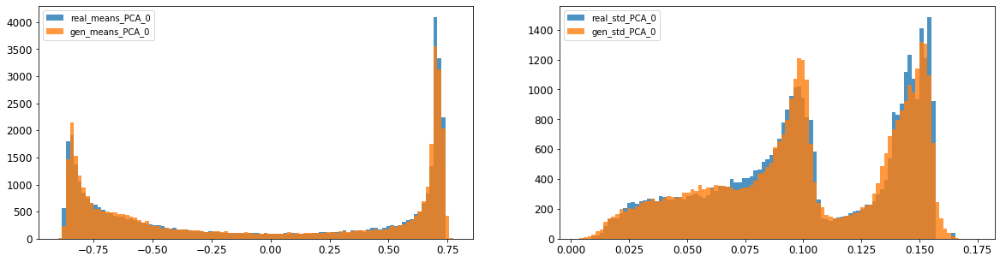

1: mean KL divergence (r,g) = 0.03376833164014831
1: mean JS divergence = 0.009306112231779436
1: mean 1-BC divergence = 0.006642798881483336

1: std KL divergence (r,g) = 0.02160018168777255
1: std JS divergence = 0.005691481791150408
1: std 1-BC divergence = 0.00400124925581169


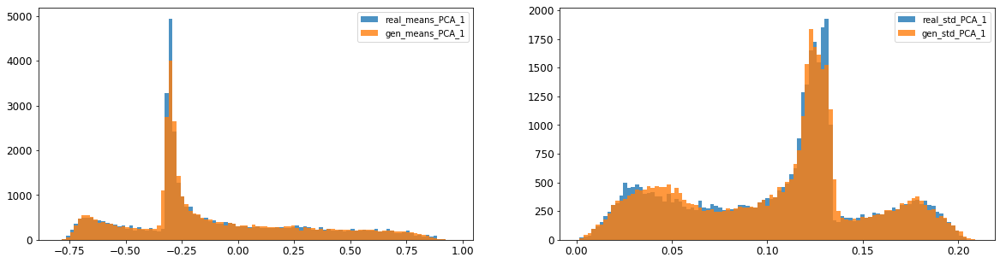

2: mean KL divergence (r,g) = 0.012186582097192986
2: mean JS divergence = 0.0031399110794566483
2: mean 1-BC divergence = 0.002291544142194235

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.007898515330680377
2: std 1-BC divergence = 0.006707840753931826


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


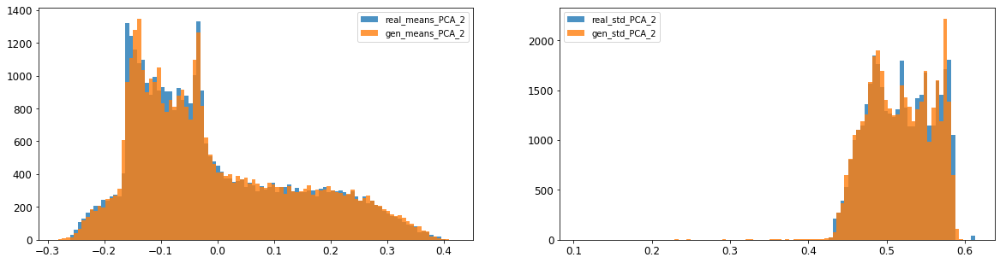

3: mean KL divergence (r,g) = 0.037762403093194286
3: mean JS divergence = 0.010071939800220926
3: mean 1-BC divergence = 0.007160970899280805

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.047239377560437314
3: std 1-BC divergence = 0.03362447839747218


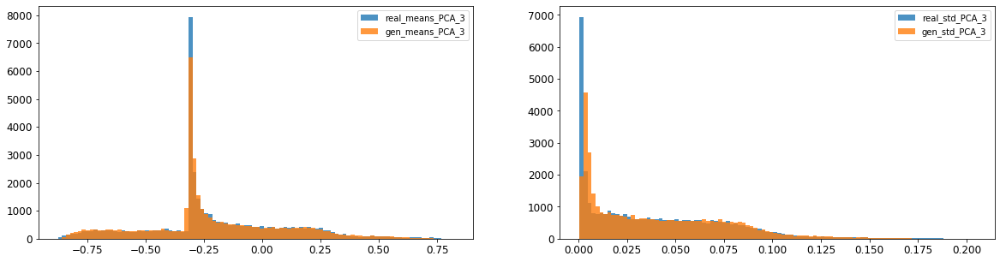

4: mean KL divergence (r,g) = 0.047760230793509426
4: mean JS divergence = 0.01299174420116396
4: mean 1-BC divergence = 0.009832513100205609

4: std KL divergence (r,g) = 0.02448436576697602
4: std JS divergence = 0.005851805741848018
4: std 1-BC divergence = 0.004121896787404822


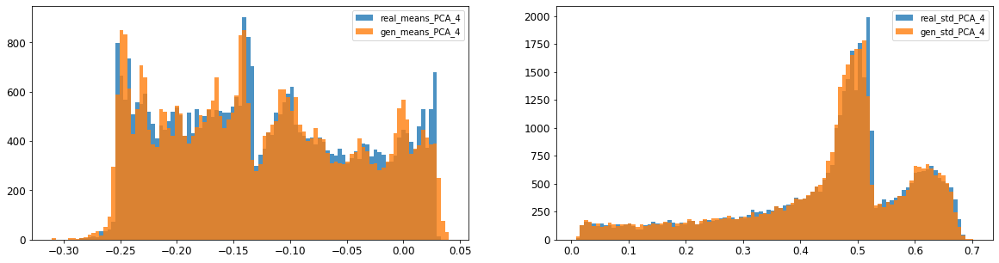

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.016160558832023882
5: mean 1-BC divergence = 0.012008456155811587

5: std KL divergence (r,g) = 0.04807400808075469
5: std JS divergence = 0.013455324784992591
5: std 1-BC divergence = 0.010701396250549555


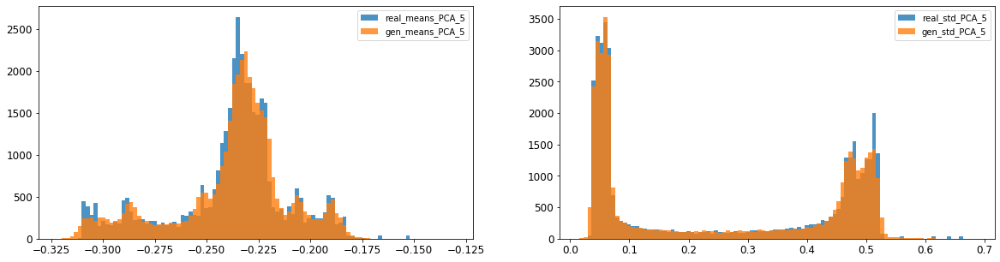

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0049753397748256
6: mean 1-BC divergence = 0.0035521570715015827

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.007139077621406209
6: std 1-BC divergence = 0.005207031556906938


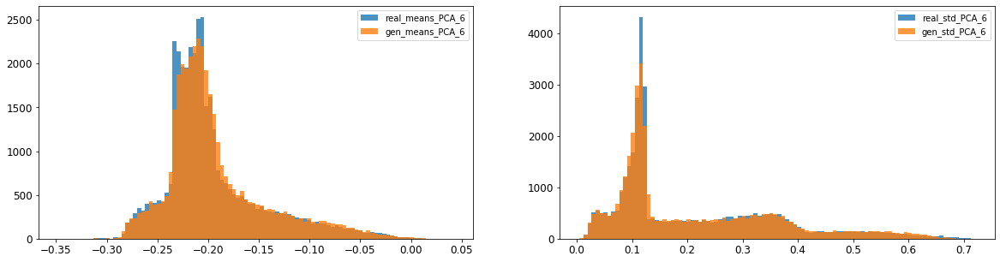

7: mean KL divergence (r,g) = 0.06351032154173042
7: mean JS divergence = 0.01582476481404776
7: mean 1-BC divergence = 0.011567842986336063

7: std KL divergence (r,g) = 0.023005897050583424
7: std JS divergence = 0.005753252387964383
7: std 1-BC divergence = 0.004086004256353748


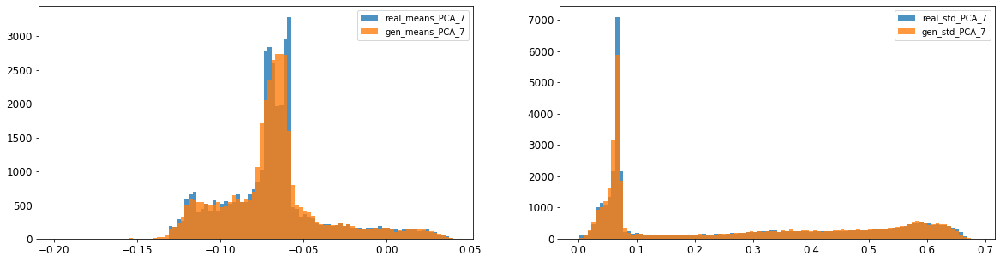

8: mean KL divergence (r,g) = 0.024245643990884733
8: mean JS divergence = 0.006166196277818419
8: mean 1-BC divergence = 0.004327913425632435

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.008381652906330372
8: std 1-BC divergence = 0.0059435215608886205


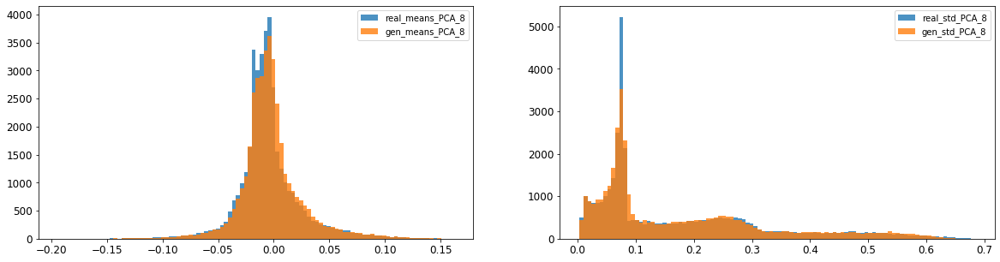

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0032572176493373115
9: mean 1-BC divergence = 0.0023844311137857233

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.010290360699558646
9: std 1-BC divergence = 0.007278826453479215


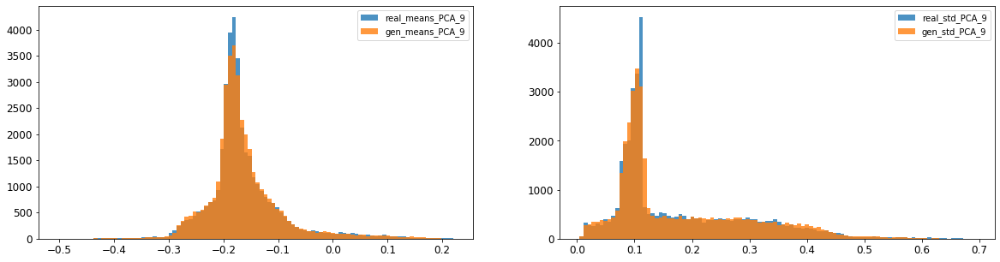

10: mean KL divergence (r,g) = 0.027752751504403258
10: mean JS divergence = 0.006903821934627918
10: mean 1-BC divergence = 0.004880233441969306

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007142049690396269
10: std 1-BC divergence = 0.005689641628253694


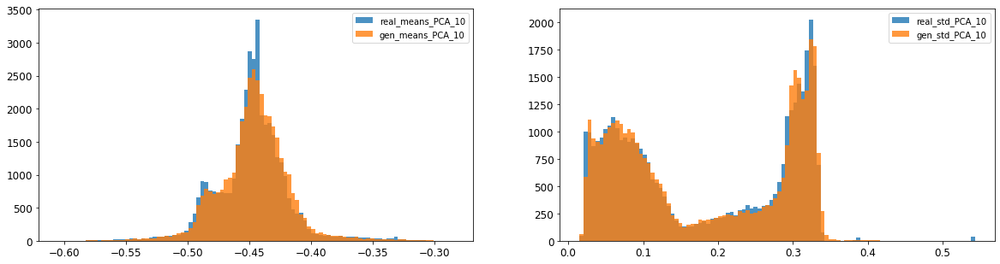

11: mean KL divergence (r,g) = 0.015799842300121946
11: mean JS divergence = 0.003951533806438619
11: mean 1-BC divergence = 0.002789961592853052

11: std KL divergence (r,g) = 0.044944447447405264
11: std JS divergence = 0.01235525647254624
11: std 1-BC divergence = 0.008876831084878578


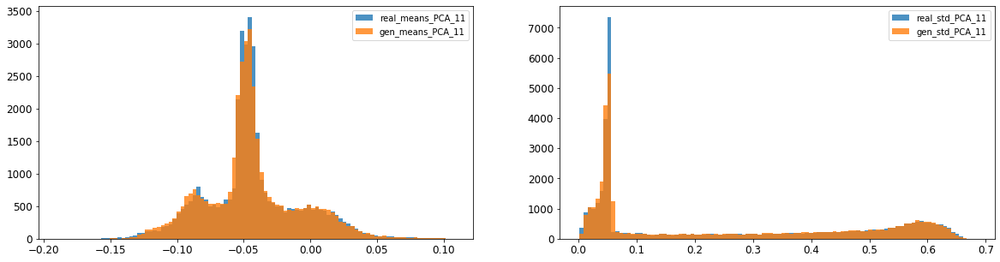

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.009400626494861914
12: mean 1-BC divergence = 0.006619596483973478

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.01381089428138456
12: std 1-BC divergence = 0.009799893753163702


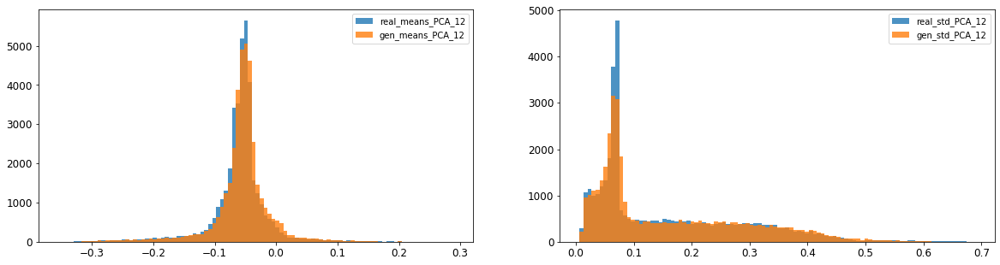

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.010964939029758026
13: mean 1-BC divergence = 0.007699582662185733

13: std KL divergence (r,g) = 0.06400363188160443
13: std JS divergence = 0.01585578701182675
13: std 1-BC divergence = 0.011121634558031945


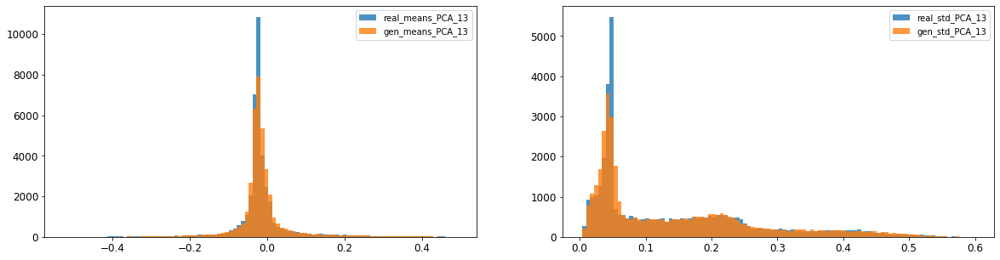

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.01885872682755267
14: mean 1-BC divergence = 0.013265500266006147

14: std KL divergence (r,g) = 0.023137668916453618
14: std JS divergence = 0.005715819364991292
14: std 1-BC divergence = 0.003999069600617022


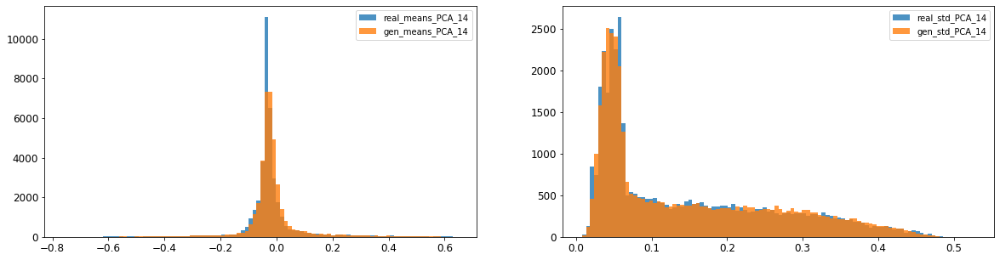

15: mean KL divergence (r,g) = 1.7156458695938404
15: mean JS divergence = 0.44698966692067993
15: mean 1-BC divergence = 0.4113994283102902

15: std KL divergence (r,g) = 7.8410026599520615
15: std JS divergence = 0.9797483257298545
15: std 1-BC divergence = 0.933959325287283


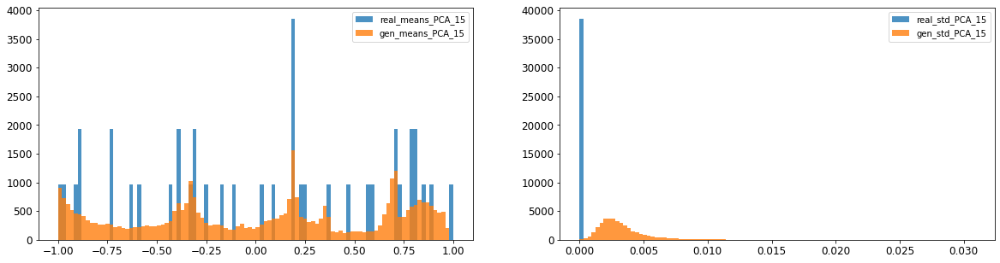

16: mean KL divergence (r,g) = 1.3464058429522154
16: mean JS divergence = 0.379043589447835
16: mean 1-BC divergence = 0.34999309628054465

16: std KL divergence (r,g) = 5.68065098521655
16: std JS divergence = 0.9304241083476266
16: std 1-BC divergence = 0.8603706136789147


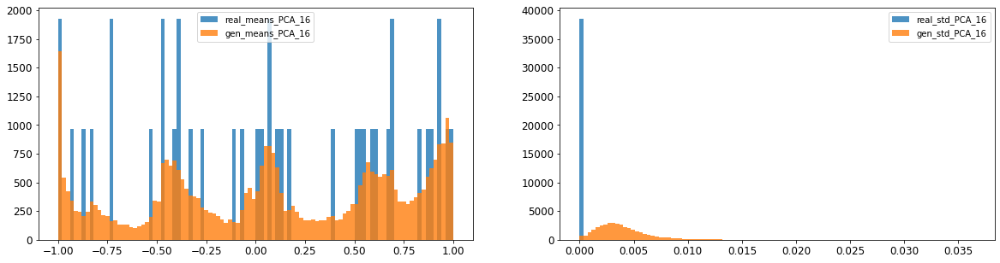



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010685127026279303
Compose 1-BC divergence = 0.007843324785863248

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.01056356869414852
Compose weighted 1-BC divergence = 0.008556623185737355

Multivariate KL divergence = 36.45023471178926


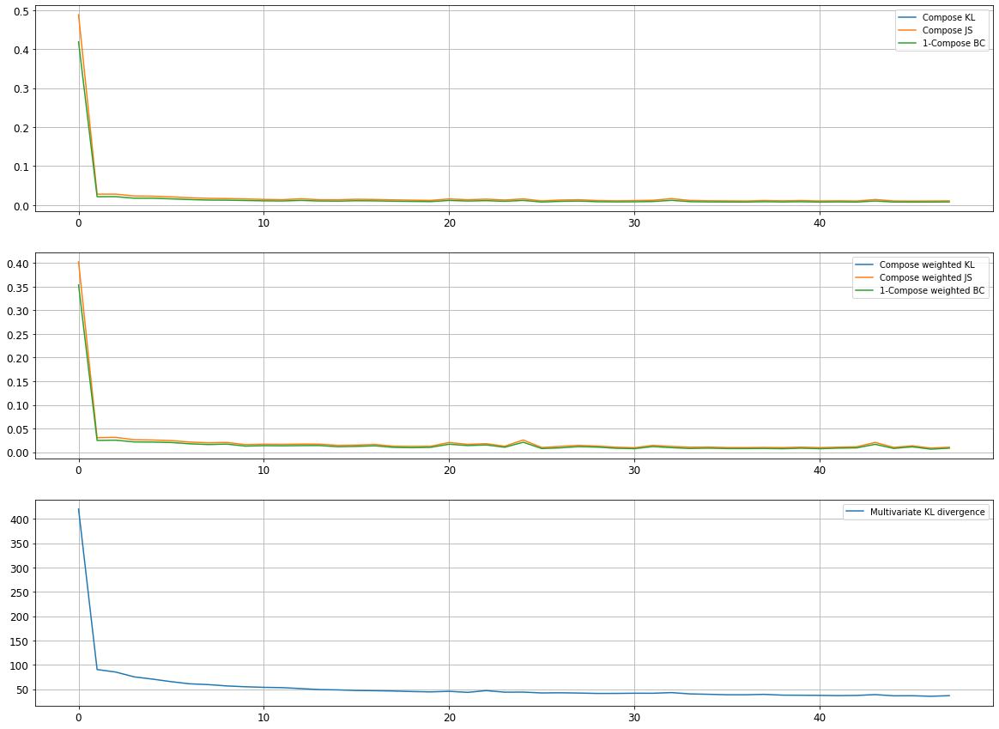

Epoch 9402/10000
discriminator loss: 0.032388 - generator loss: 9.654366 - 25s
Epoch 9403/10000
discriminator loss: 0.166600 - generator loss: 9.313170 - 28s
Epoch 9404/10000
discriminator loss: 0.036913 - generator loss: 9.469838 - 28s
Epoch 9405/10000
discriminator loss: 0.027275 - generator loss: 9.809571 - 28s
Epoch 9406/10000
discriminator loss: 0.187723 - generator loss: 9.141285 - 29s
Epoch 9407/10000
discriminator loss: 0.033468 - generator loss: 9.650591 - 29s
Epoch 9408/10000
discriminator loss: 0.059281 - generator loss: 9.637627 - 29s
Epoch 9409/10000
discriminator loss: 0.028338 - generator loss: 9.800120 - 29s
Epoch 9410/10000
discriminator loss: 0.232171 - generator loss: 8.857774 - 29s
Epoch 9411/10000
discriminator loss: 0.025926 - generator loss: 9.796157 - 29s
Epoch 9412/10000
discriminator loss: 0.027058 - generator loss: 9.773120 - 28s
Epoch 9413/10000
discriminator loss: 0.132420 - generator loss: 9.210222 - 29s
Epoch 9414/10000
discriminator loss: 0.212154 - gene

discriminator loss: 0.203114 - generator loss: 8.972391 - 28s
Epoch 9507/10000
discriminator loss: 0.032259 - generator loss: 9.558984 - 25s
Epoch 9508/10000
discriminator loss: 0.027855 - generator loss: 9.806321 - 23s
Epoch 9509/10000
discriminator loss: 0.028848 - generator loss: 9.766140 - 23s
Epoch 9510/10000
discriminator loss: 0.285218 - generator loss: 8.978914 - 23s
Epoch 9511/10000
discriminator loss: 0.032069 - generator loss: 9.554555 - 23s
Epoch 9512/10000
discriminator loss: 0.034750 - generator loss: 9.618327 - 25s
Epoch 9513/10000
discriminator loss: 0.201201 - generator loss: 9.201766 - 28s
Epoch 9514/10000
discriminator loss: 0.035542 - generator loss: 9.549108 - 28s
Epoch 9515/10000
discriminator loss: 0.034466 - generator loss: 9.583521 - 29s
Epoch 9516/10000
discriminator loss: 0.255012 - generator loss: 9.271026 - 28s
Epoch 9517/10000
discriminator loss: 0.031872 - generator loss: 9.519494 - 28s
Epoch 9518/10000
discriminator loss: 0.028870 - generator loss: 9.664

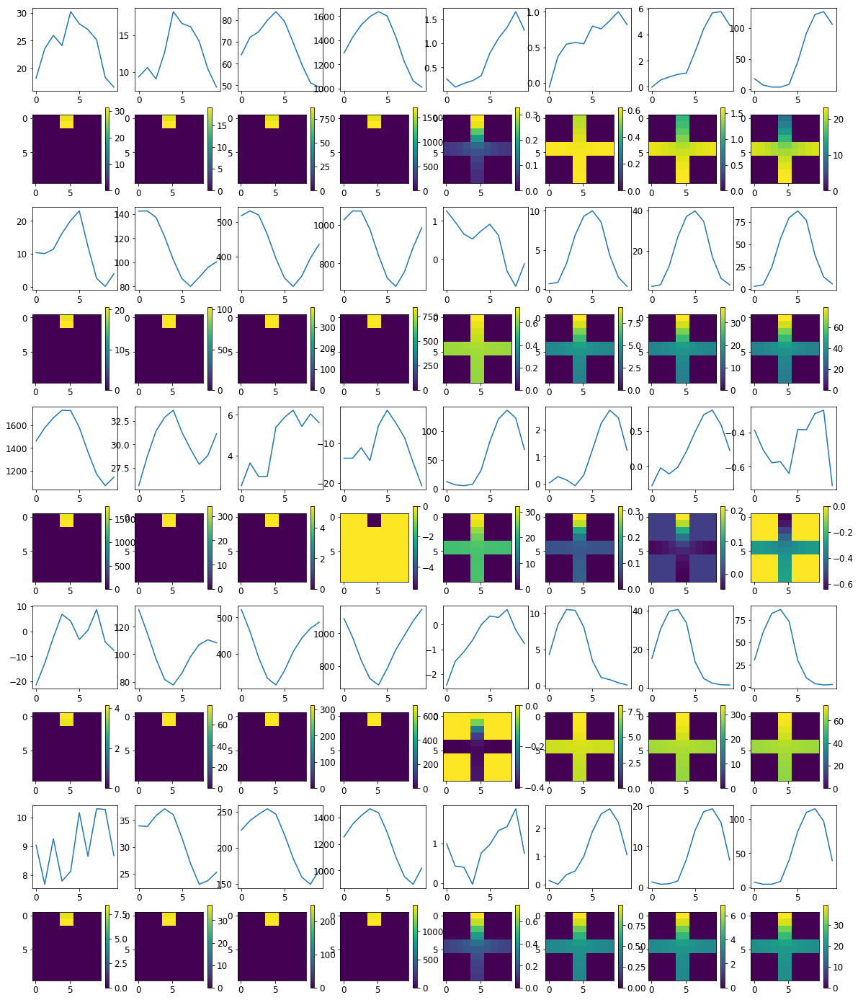


R0 generated:
[[19.375751   17.640896  ]
 [19.403547   17.55163   ]
 [19.408436   17.53552   ]
 [19.399672   17.487001  ]
 [19.39168    17.487432  ]
 [19.385738   17.41006   ]
 [19.416111   17.529968  ]
 [19.42898    17.521038  ]
 [19.37635    17.548998  ]
 [19.407972   17.793558  ]
 [16.991943    0.5306875 ]
 [17.04193     0.5134545 ]
 [17.045233    0.5141204 ]
 [17.047956    0.52928454]
 [17.070211    0.5112294 ]
 [17.08102     0.5117256 ]
 [17.105415    0.5080468 ]
 [17.10826     0.50795645]
 [17.132824    0.5109996 ]
 [17.127087    0.53220534]
 [16.58511     0.46545178]
 [16.737104    0.45623294]
 [16.790537    0.4594225 ]
 [16.812433    0.4527203 ]
 [16.778465    0.45791227]
 [16.776226    0.45907265]
 [16.779987    0.4446537 ]
 [16.732378    0.42717344]
 [16.74498     0.42717752]
 [16.815485    0.42654312]
 [19.671867   16.613031  ]
 [19.683449   16.51565   ]
 [19.68089    16.451458  ]
 [19.68522    16.393284  ]
 [19.68421    16.418728  ]
 [19.684345   16.31283   ]
 [19.691883  

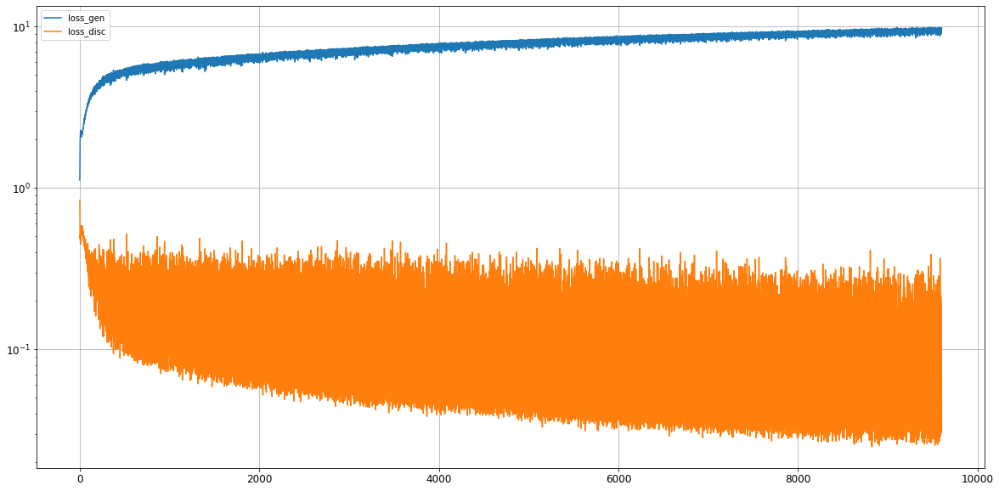

0: mean KL divergence (r,g) = 0.04109521406170397
0: mean JS divergence = 0.010548727523338505
0: mean 1-BC divergence = 0.007720999162054376

0: std KL divergence (r,g) = 0.036554456220836466
0: std JS divergence = 0.009876192530679399
0: std 1-BC divergence = 0.008120370552449407


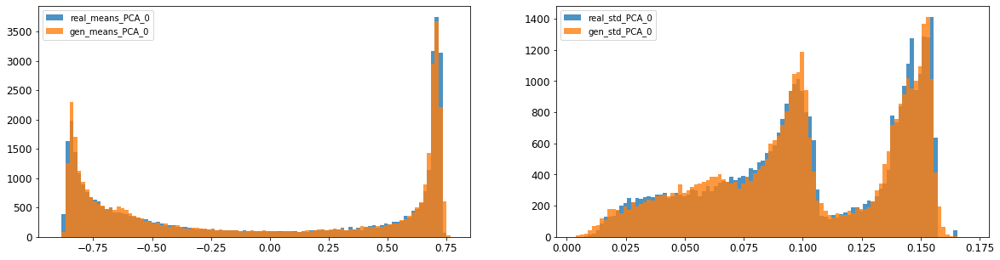

1: mean KL divergence (r,g) = 0.016301277056304995
1: mean JS divergence = 0.004177112672529468
1: mean 1-BC divergence = 0.0029578668518331908

1: std KL divergence (r,g) = 0.02153624624637319
1: std JS divergence = 0.005407010999371548
1: std 1-BC divergence = 0.003764618797117092


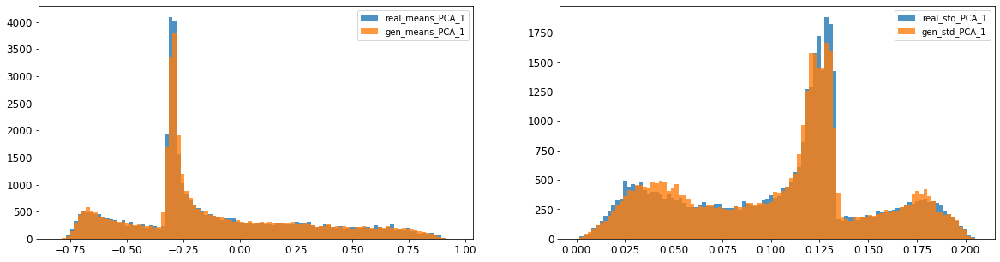

2: mean KL divergence (r,g) = 0.009833595855173224
2: mean JS divergence = 0.00250073395577561
2: mean 1-BC divergence = 0.0017893066216041476

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.005873073864526816
2: std 1-BC divergence = 0.00513308558320702


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


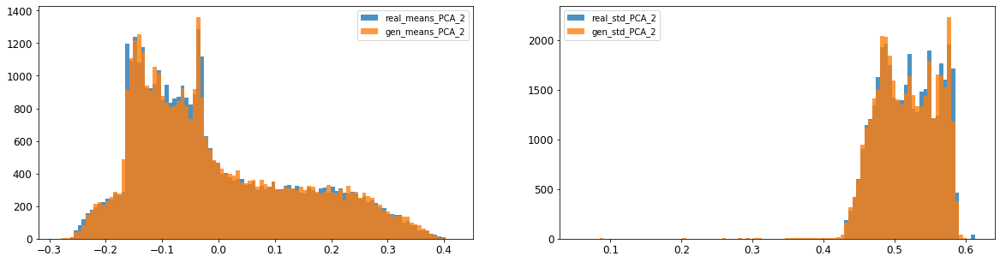

3: mean KL divergence (r,g) = inf
3: mean JS divergence = 0.011620297474928208
3: mean 1-BC divergence = 0.008228345262156433

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.06490968458213604
3: std 1-BC divergence = 0.046986074082998264


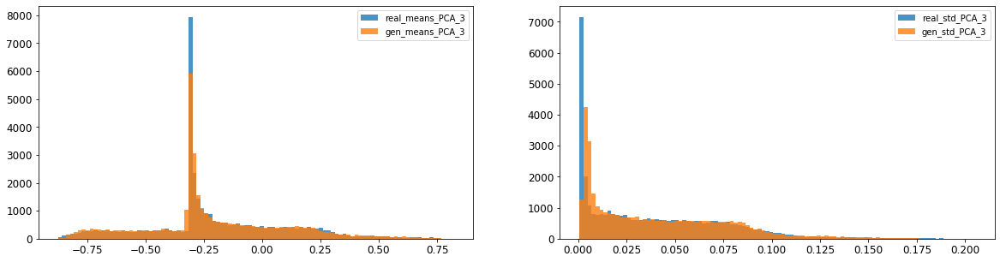

4: mean KL divergence (r,g) = 0.04544165806298069
4: mean JS divergence = 0.013149432405881269
4: mean 1-BC divergence = 0.011025239281575505

4: std KL divergence (r,g) = 0.014837472459226538
4: std JS divergence = 0.003713166416863559
4: std 1-BC divergence = 0.0026495951362768277


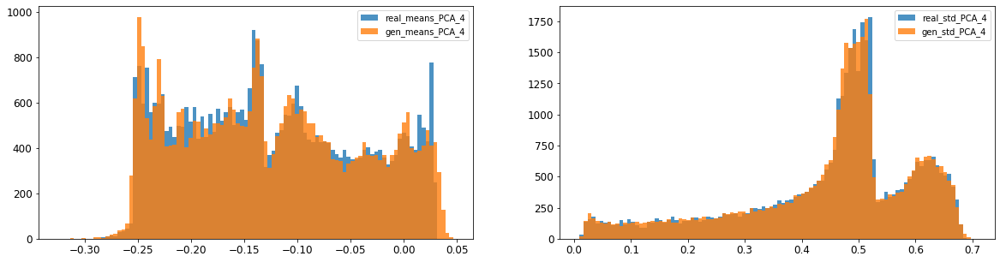

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.016733854851887664
5: mean 1-BC divergence = 0.0129105315041671

5: std KL divergence (r,g) = 0.04577783352284713
5: std JS divergence = 0.013026305843388822
5: std 1-BC divergence = 0.011144506188275005


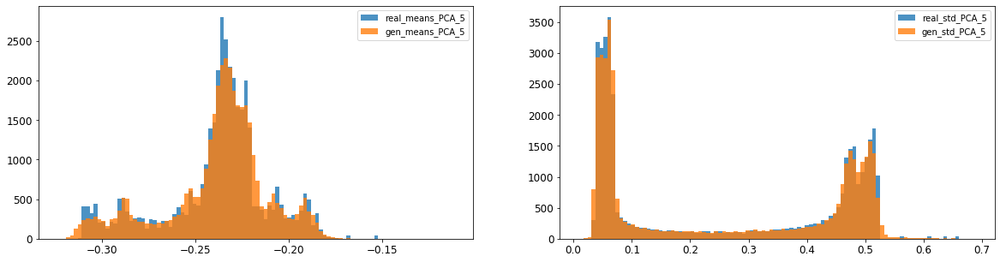

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.0030134758720603986
6: mean 1-BC divergence = 0.0021837802482739255

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.007551302500241386
6: std 1-BC divergence = 0.005421177341242811


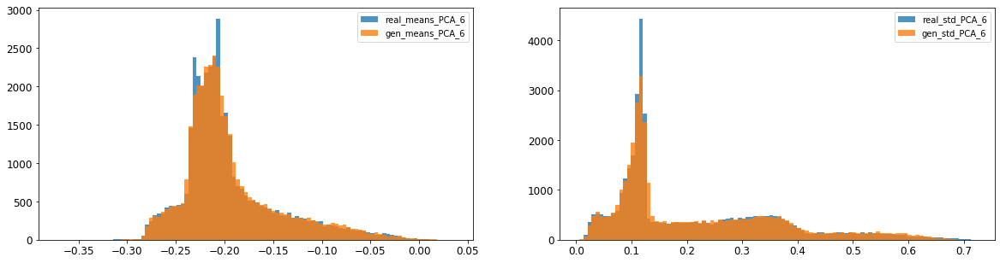

7: mean KL divergence (r,g) = inf
7: mean JS divergence = 0.015559858967948065
7: mean 1-BC divergence = 0.011804530520096335

7: std KL divergence (r,g) = 0.01995414652633431
7: std JS divergence = 0.0049524794653809205
7: std 1-BC divergence = 0.003473419720262494


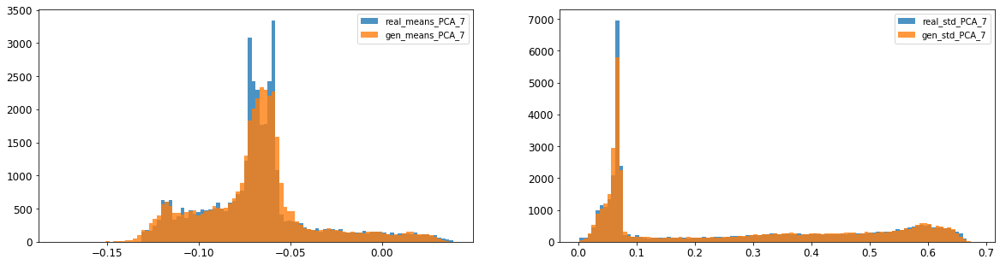

8: mean KL divergence (r,g) = 0.012442412052142486
8: mean JS divergence = 0.0030682982694949477
8: mean 1-BC divergence = 0.0021457357234763164

8: std KL divergence (r,g) = 0.032747069619338084
8: std JS divergence = 0.00787497164700146
8: std 1-BC divergence = 0.0055160674754796135


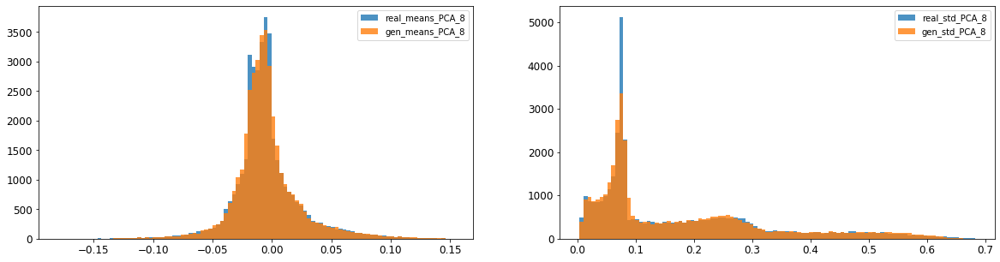

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.0035327582186933746
9: mean 1-BC divergence = 0.0025608345872304428

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.007977776383593708
9: std 1-BC divergence = 0.005631544154283463


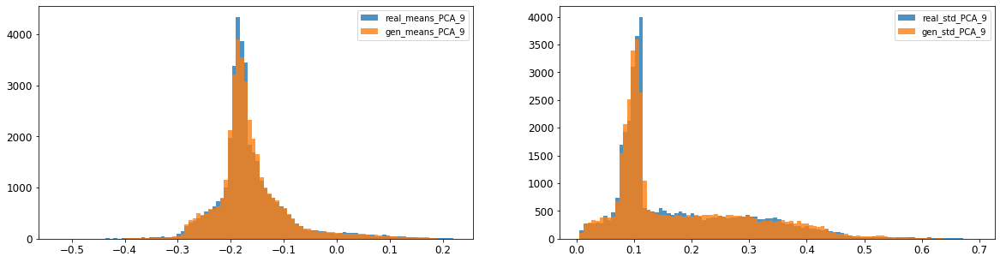

10: mean KL divergence (r,g) = 0.01977832694517388
10: mean JS divergence = 0.00485720775342681
10: mean 1-BC divergence = 0.0034256329214671366

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.004661139261506452
10: std 1-BC divergence = 0.003921976737313093


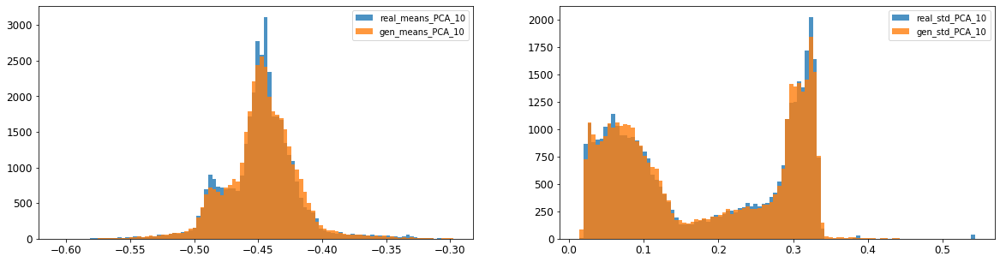

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.008369267253278977
11: mean 1-BC divergence = 0.005916961107066854

11: std KL divergence (r,g) = 0.030635340125859337
11: std JS divergence = 0.00815243372746857
11: std 1-BC divergence = 0.005780579353953597


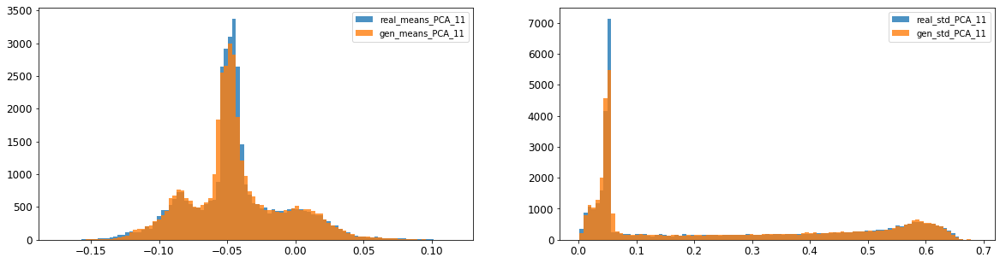

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.009452089525385956
12: mean 1-BC divergence = 0.0065988154295140156

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.014681336852088242
12: std 1-BC divergence = 0.010393353220912505


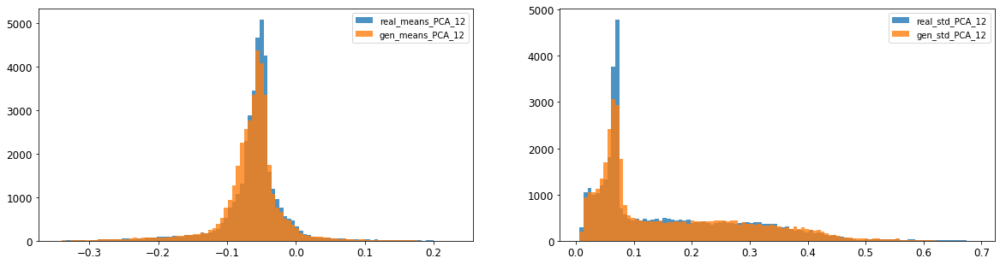

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.010673416665976904
13: mean 1-BC divergence = 0.007502730485040909

13: std KL divergence (r,g) = 0.05802619407874488
13: std JS divergence = 0.013852188720590453
13: std 1-BC divergence = 0.00968017322887671


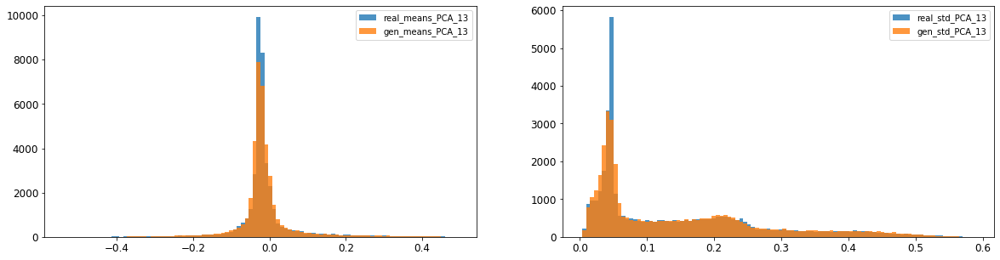

14: mean KL divergence (r,g) = 0.0715681534695042
14: mean JS divergence = 0.017284685295247227
14: mean 1-BC divergence = 0.012103016531857747

14: std KL divergence (r,g) = 0.022917209803340995
14: std JS divergence = 0.005804862872412848
14: std 1-BC divergence = 0.004056595945749697


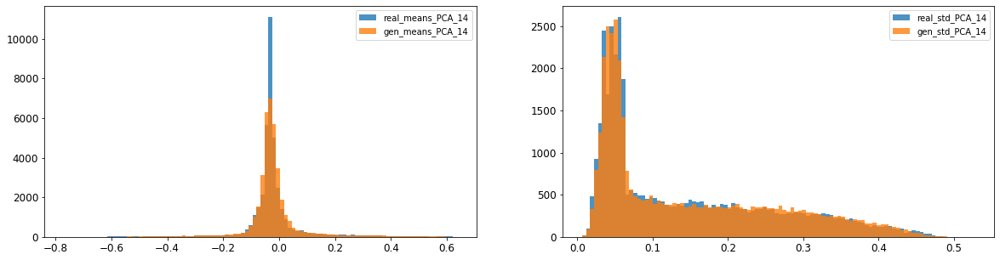

15: mean KL divergence (r,g) = 1.674641984209161
15: mean JS divergence = 0.4451646425028909
15: mean 1-BC divergence = 0.40940051318986603

15: std KL divergence (r,g) = 8.01415156226866
15: std JS divergence = 0.9817044995138166
15: std 1-BC divergence = 0.9378057843774399


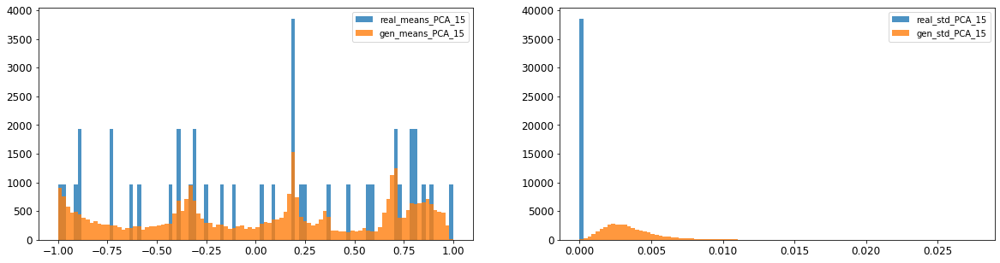

16: mean KL divergence (r,g) = 1.3305239222902843
16: mean JS divergence = 0.372525371069113
16: mean 1-BC divergence = 0.3432577462958507

16: std KL divergence (r,g) = 5.258905492925295
16: std JS divergence = 0.9122455966081482
16: std 1-BC divergence = 0.8383946064665323


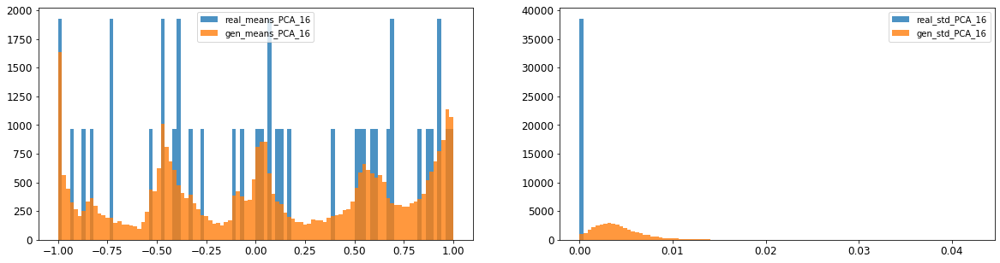



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.010428504745770117
Compose 1-BC divergence = 0.0076849154585271195

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.009858044226703815
Compose weighted 1-BC divergence = 0.007494893885813925

Multivariate KL divergence = 35.878363042266066


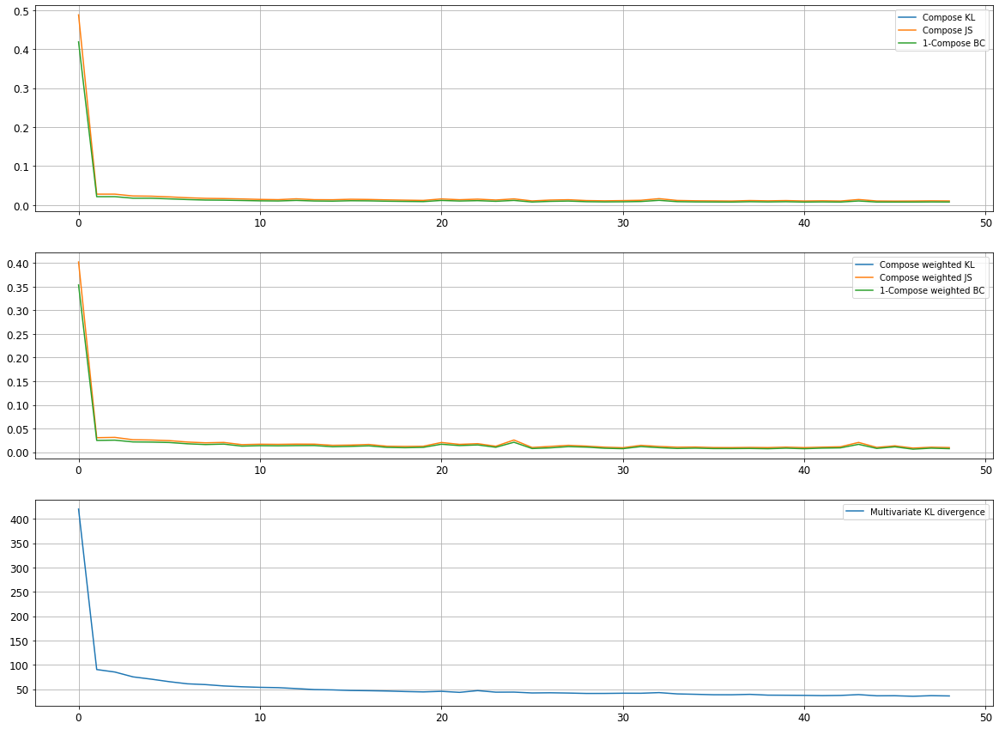

Epoch 9602/10000
discriminator loss: 0.144792 - generator loss: 9.265424 - 27s
Epoch 9603/10000
discriminator loss: 0.032013 - generator loss: 9.674413 - 28s
Epoch 9604/10000
discriminator loss: 0.029075 - generator loss: 9.755199 - 28s
Epoch 9605/10000
discriminator loss: 0.230373 - generator loss: 9.110734 - 29s
Epoch 9606/10000
discriminator loss: 0.029510 - generator loss: 9.592498 - 29s
Epoch 9607/10000
discriminator loss: 0.029926 - generator loss: 9.820374 - 28s
Epoch 9608/10000
discriminator loss: 0.037058 - generator loss: 9.669919 - 29s
Epoch 9609/10000
discriminator loss: 0.186598 - generator loss: 9.124189 - 28s
Epoch 9610/10000
discriminator loss: 0.028109 - generator loss: 9.805745 - 29s
Epoch 9611/10000
discriminator loss: 0.232535 - generator loss: 9.080379 - 29s
Epoch 9612/10000
discriminator loss: 0.041543 - generator loss: 9.367833 - 29s
Epoch 9613/10000
discriminator loss: 0.027675 - generator loss: 9.854130 - 29s
Epoch 9614/10000
discriminator loss: 0.030354 - gene

discriminator loss: 0.054749 - generator loss: 9.631450 - 29s
Epoch 9707/10000
discriminator loss: 0.029134 - generator loss: 9.737371 - 28s
Epoch 9708/10000
discriminator loss: 0.255754 - generator loss: 8.884048 - 28s
Epoch 9709/10000
discriminator loss: 0.075590 - generator loss: 9.403253 - 28s
Epoch 9710/10000
discriminator loss: 0.032324 - generator loss: 9.813910 - 23s
Epoch 9711/10000
discriminator loss: 0.198394 - generator loss: 9.336782 - 23s
Epoch 9712/10000
discriminator loss: 0.032535 - generator loss: 9.653658 - 23s
Epoch 9713/10000
discriminator loss: 0.028024 - generator loss: 9.742682 - 23s
Epoch 9714/10000
discriminator loss: 0.043366 - generator loss: 9.626927 - 24s
Epoch 9715/10000
discriminator loss: 0.172758 - generator loss: 9.216590 - 28s
Epoch 9716/10000
discriminator loss: 0.131980 - generator loss: 9.077541 - 28s
Epoch 9717/10000
discriminator loss: 0.028249 - generator loss: 9.798853 - 29s
Epoch 9718/10000
discriminator loss: 0.030523 - generator loss: 9.778

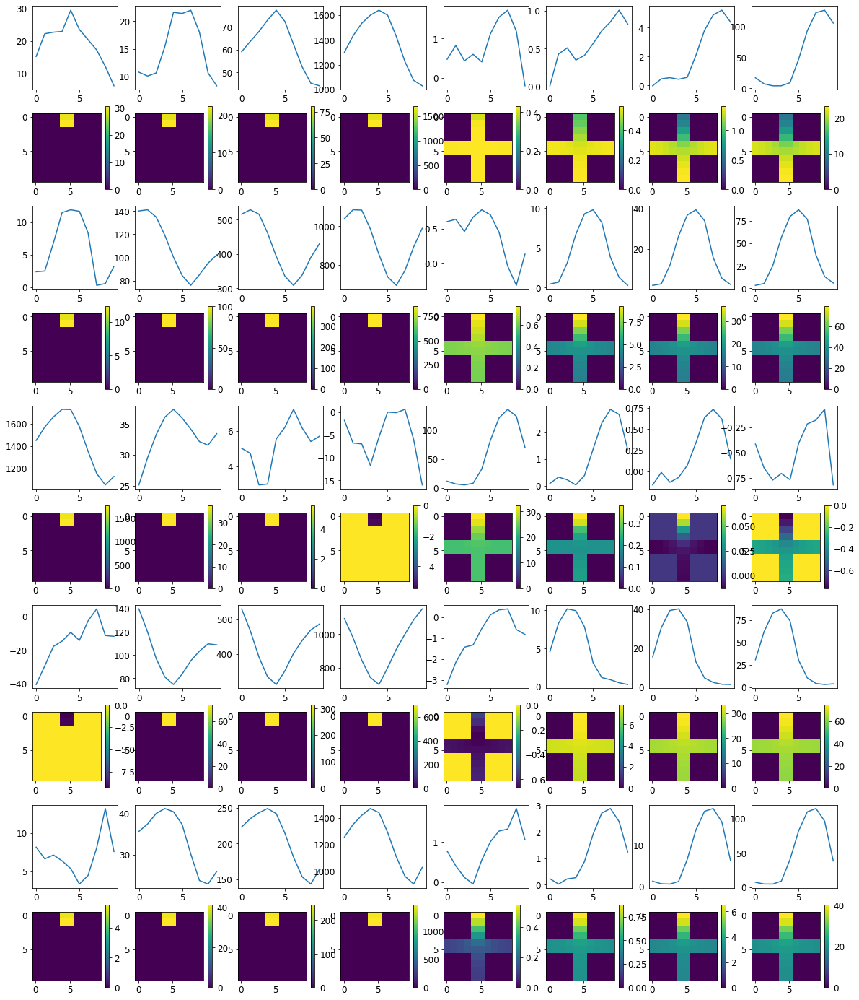


R0 generated:
[[19.138193   17.90551   ]
 [19.173916   17.871035  ]
 [19.188042   17.89645   ]
 [19.186756   17.87332   ]
 [19.19097    17.868235  ]
 [19.180397   17.785107  ]
 [19.215033   17.830051  ]
 [19.211754   17.841911  ]
 [19.120445   17.849028  ]
 [19.174599   18.086433  ]
 [16.948015    0.51321954]
 [17.002224    0.4995592 ]
 [17.00125     0.4994554 ]
 [17.006151    0.5122778 ]
 [17.029392    0.48765573]
 [17.060137    0.4970781 ]
 [17.079697    0.48455828]
 [17.066313    0.48937413]
 [17.102169    0.4977982 ]
 [17.102165    0.52276605]
 [16.490705    0.43334618]
 [16.617577    0.41739833]
 [16.619442    0.4131784 ]
 [16.623465    0.41700706]
 [16.54765     0.4135411 ]
 [16.567408    0.42606032]
 [16.590832    0.41110373]
 [16.569061    0.39550576]
 [16.59104     0.40645465]
 [16.711975    0.41613767]
 [19.585676   16.992579  ]
 [19.600603   16.950184  ]
 [19.6004     16.9236    ]
 [19.603987   16.901932  ]
 [19.608608   16.9313    ]
 [19.611599   16.84485   ]
 [19.622223  

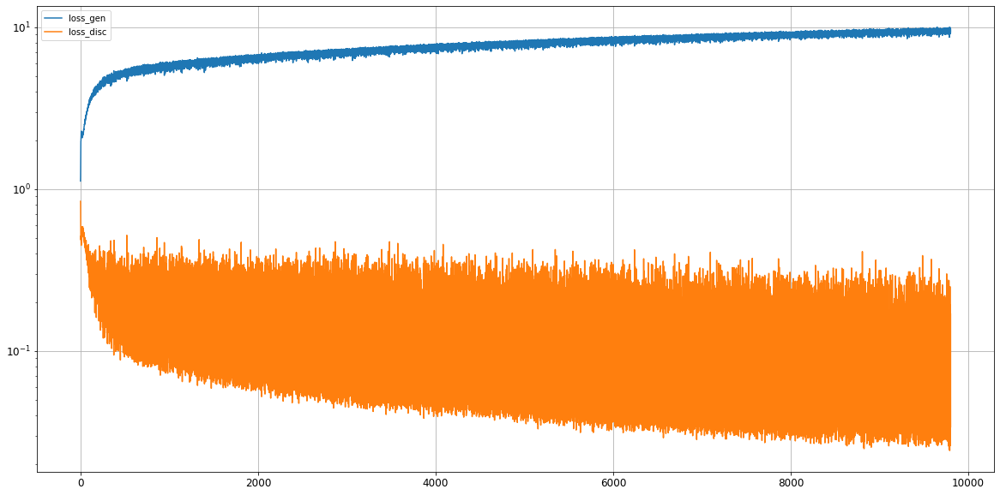

0: mean KL divergence (r,g) = 0.0228320587035787
0: mean JS divergence = 0.006302656205671031
0: mean 1-BC divergence = 0.005121179275103138

0: std KL divergence (r,g) = 0.036028912639514174
0: std JS divergence = 0.009750692902671242
0: std 1-BC divergence = 0.007875654853904845


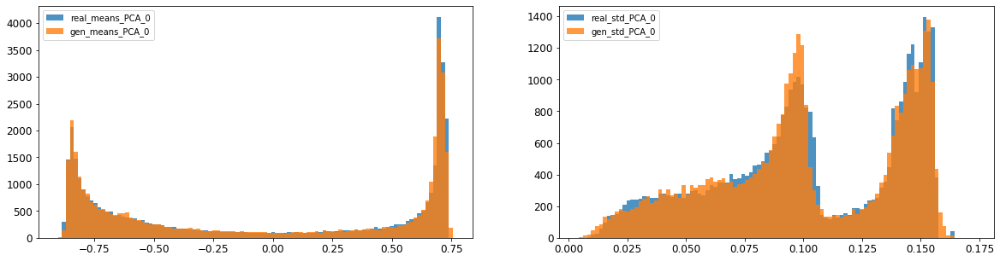

1: mean KL divergence (r,g) = 0.015712410411461833
1: mean JS divergence = 0.0039483989570428596
1: mean 1-BC divergence = 0.0027934124124379123

1: std KL divergence (r,g) = inf
1: std JS divergence = 0.007360432434263697
1: std 1-BC divergence = 0.005307132812113702


/home/viluiz/anaconda3/envs/py3ml/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


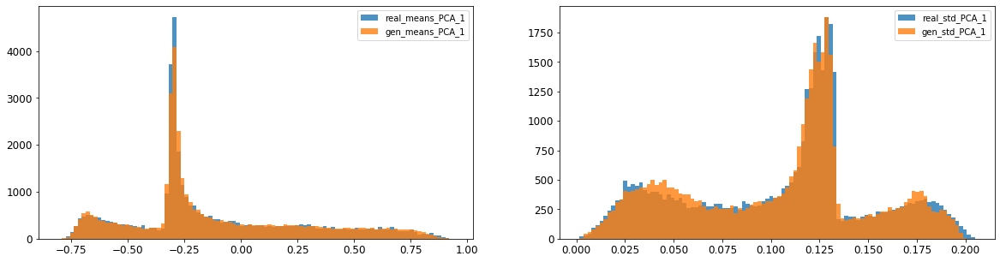

2: mean KL divergence (r,g) = 0.012987793644703453
2: mean JS divergence = 0.0031132249686921204
2: mean 1-BC divergence = 0.00224590449633566

2: std KL divergence (r,g) = inf
2: std JS divergence = 0.00493322952299896
2: std 1-BC divergence = 0.004354228799800075


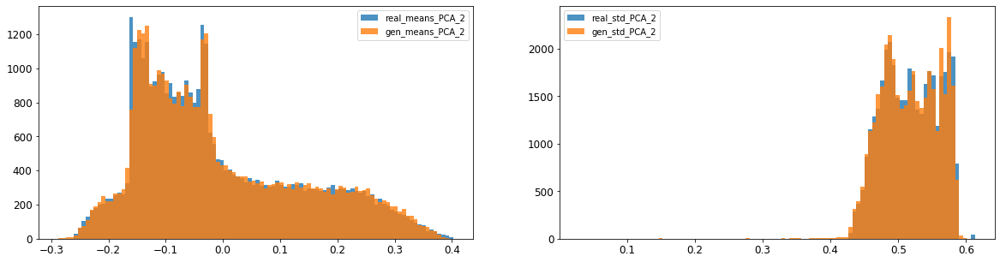

3: mean KL divergence (r,g) = 0.04759443913221466
3: mean JS divergence = 0.011652186917019428
3: mean 1-BC divergence = 0.00814307439889339

3: std KL divergence (r,g) = inf
3: std JS divergence = 0.04019302831623926
3: std 1-BC divergence = 0.02841735479736418


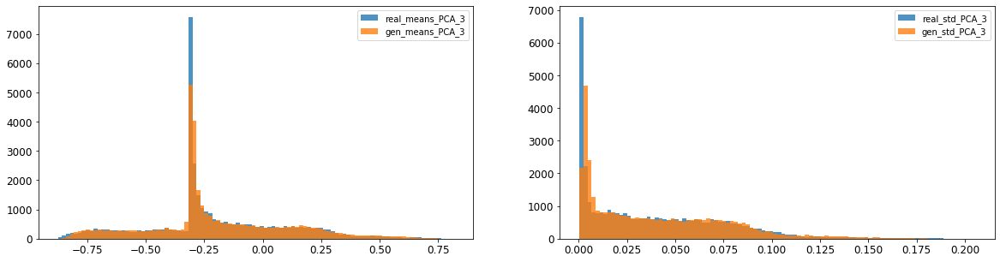

4: mean KL divergence (r,g) = 0.03393314872544687
4: mean JS divergence = 0.008813079088632918
4: mean 1-BC divergence = 0.006536307358410709

4: std KL divergence (r,g) = 0.017687343062525486
4: std JS divergence = 0.00433587875987871
4: std 1-BC divergence = 0.003084285157475719


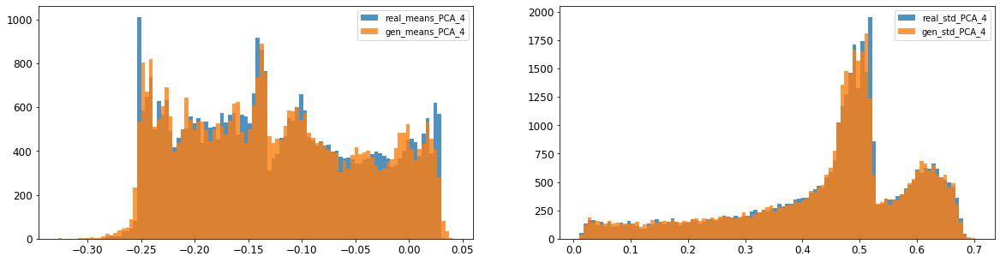

5: mean KL divergence (r,g) = inf
5: mean JS divergence = 0.01656710419808083
5: mean 1-BC divergence = 0.012810718909834429

5: std KL divergence (r,g) = 0.05812303059246086
5: std JS divergence = 0.016412161614457
5: std 1-BC divergence = 0.014752877873153158


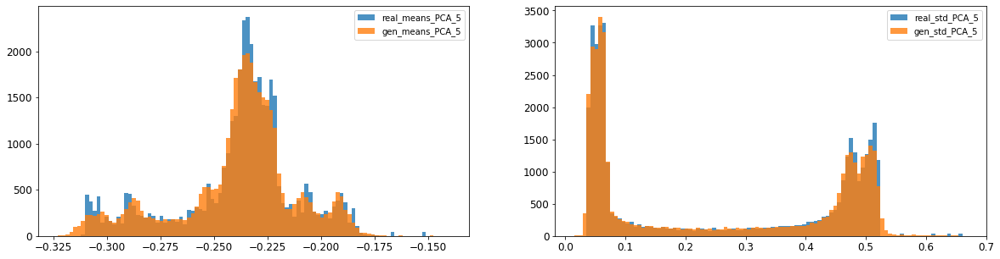

6: mean KL divergence (r,g) = inf
6: mean JS divergence = 0.005103323312648744
6: mean 1-BC divergence = 0.0036360612012710236

6: std KL divergence (r,g) = inf
6: std JS divergence = 0.007306321505515485
6: std 1-BC divergence = 0.005303394996643229


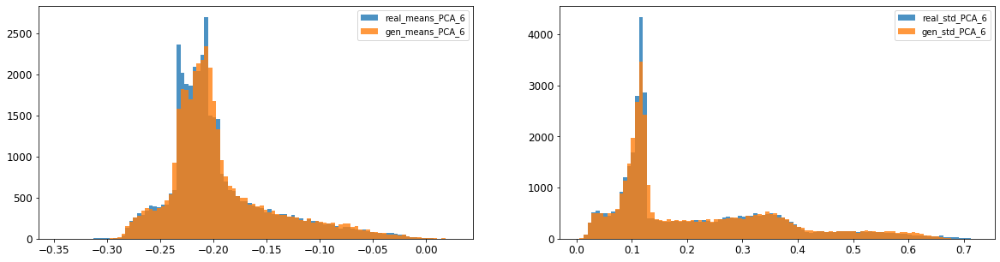

7: mean KL divergence (r,g) = 0.1196907910455637
7: mean JS divergence = 0.032793735152996814
7: mean 1-BC divergence = 0.023820813660228035

7: std KL divergence (r,g) = 0.02112092960698198
7: std JS divergence = 0.0051266510704656935
7: std 1-BC divergence = 0.003605893195295029


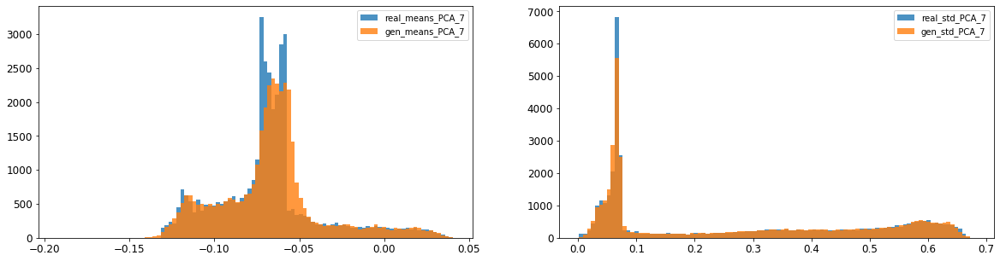

8: mean KL divergence (r,g) = inf
8: mean JS divergence = 0.002517711851759738
8: mean 1-BC divergence = 0.0017882364201304846

8: std KL divergence (r,g) = inf
8: std JS divergence = 0.009393207220448847
8: std 1-BC divergence = 0.006659239475323875


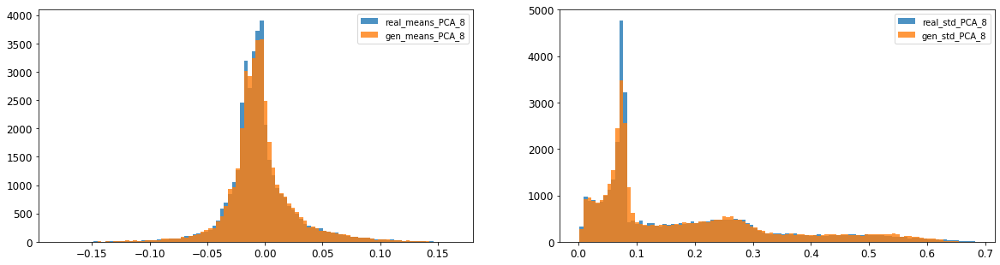

9: mean KL divergence (r,g) = inf
9: mean JS divergence = 0.003571571704819984
9: mean 1-BC divergence = 0.002588871019519101

9: std KL divergence (r,g) = inf
9: std JS divergence = 0.006946712146899566
9: std 1-BC divergence = 0.005054618572703173


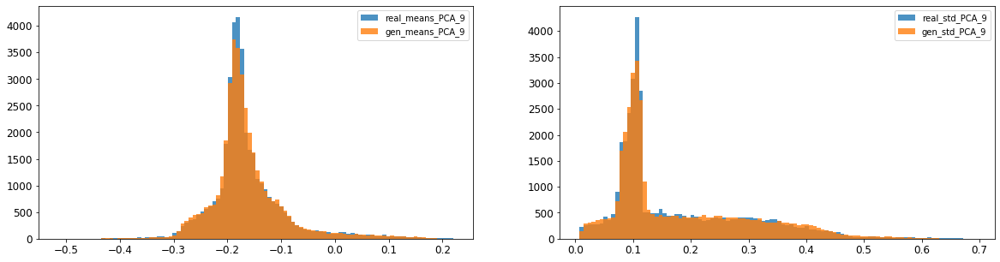

10: mean KL divergence (r,g) = 0.02083971832015845
10: mean JS divergence = 0.005017105932754945
10: mean 1-BC divergence = 0.003554912741396521

10: std KL divergence (r,g) = inf
10: std JS divergence = 0.007547487986980296
10: std 1-BC divergence = 0.006009869469143614


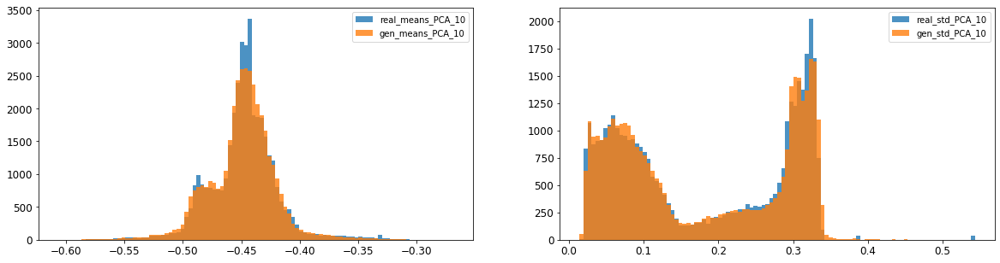

11: mean KL divergence (r,g) = inf
11: mean JS divergence = 0.004781583134455826
11: mean 1-BC divergence = 0.0034520534779286516

11: std KL divergence (r,g) = 0.02802728733350397
11: std JS divergence = 0.007725970945643895
11: std 1-BC divergence = 0.005549053229395473


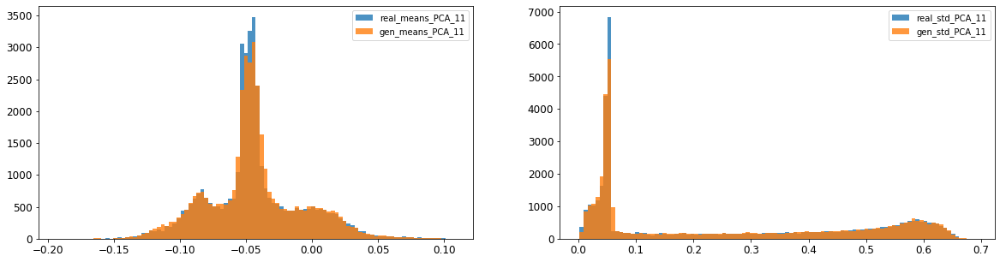

12: mean KL divergence (r,g) = inf
12: mean JS divergence = 0.008573297896986633
12: mean 1-BC divergence = 0.006043156291343221

12: std KL divergence (r,g) = inf
12: std JS divergence = 0.014237502616834893
12: std 1-BC divergence = 0.010136145162352617


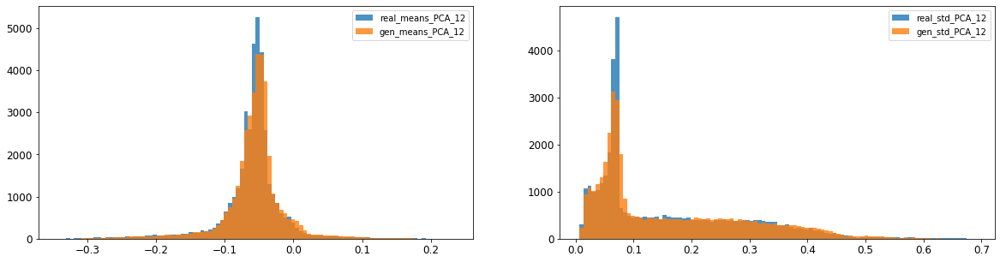

13: mean KL divergence (r,g) = inf
13: mean JS divergence = 0.010977363724110924
13: mean 1-BC divergence = 0.007772507601456313

13: std KL divergence (r,g) = inf
13: std JS divergence = 0.012698565056808348
13: std 1-BC divergence = 0.008875291889539283


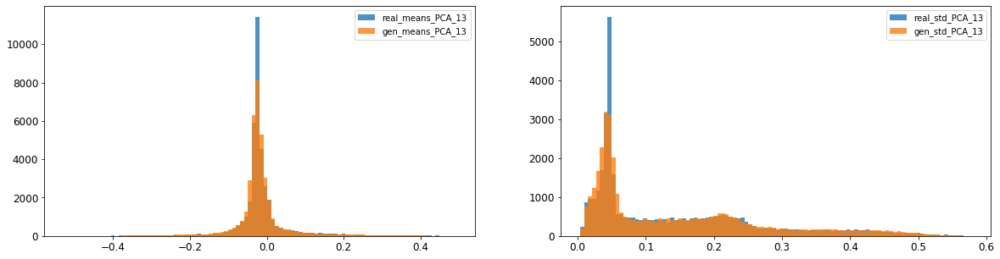

14: mean KL divergence (r,g) = inf
14: mean JS divergence = 0.012046680940796441
14: mean 1-BC divergence = 0.008507372701535787

14: std KL divergence (r,g) = 0.0273644844960511
14: std JS divergence = 0.00693140153114575
14: std 1-BC divergence = 0.0048723879807662795


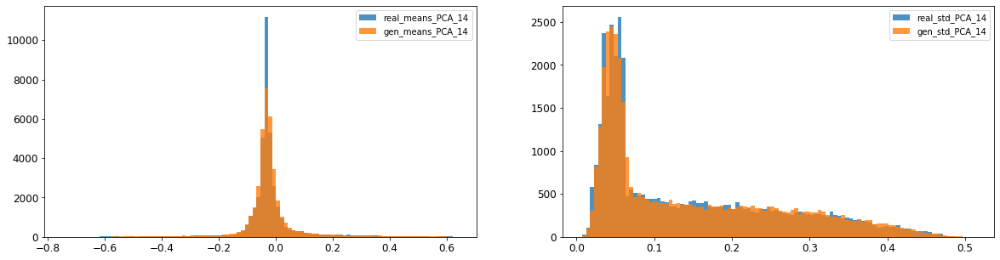

15: mean KL divergence (r,g) = 1.8148507892216228
15: mean JS divergence = 0.4653616030157455
15: mean 1-BC divergence = 0.42785456382154496

15: std KL divergence (r,g) = 7.603963462651212
15: std JS divergence = 0.9767397289003312
15: std 1-BC divergence = 0.9283049031251938


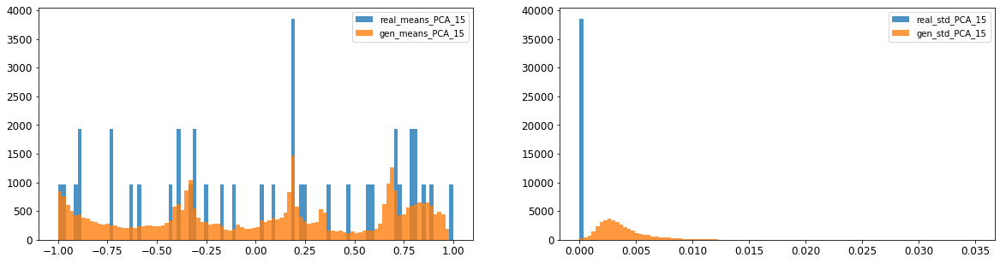

16: mean KL divergence (r,g) = 1.315448157097262
16: mean JS divergence = 0.3708609407127699
16: mean 1-BC divergence = 0.34194453010281733

16: std KL divergence (r,g) = 5.600324885587864
16: std JS divergence = 0.9272600800236102
16: std 1-BC divergence = 0.8564288721799893


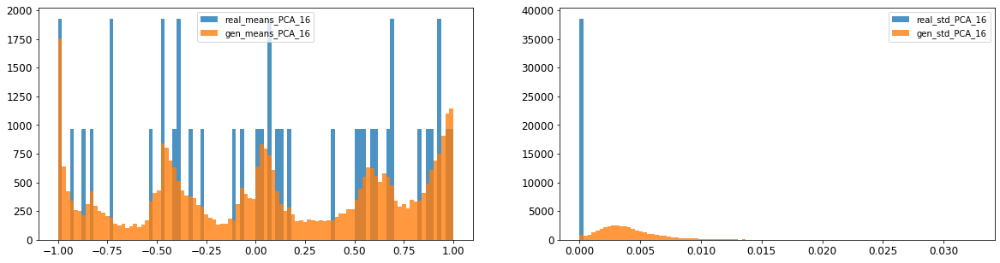



--------------------------------------------------------

Compose KL divergence (r,g) = inf
Compose JS divergence = 0.009889275587257362
Compose 1-BC divergence = 0.007289067007693384

Compose weighted KL divergence (r,g) = inf
Compose weighted JS divergence = 0.008272089453914678
Compose weighted 1-BC divergence = 0.006406585400529297

Multivariate KL divergence = 34.77223013827033


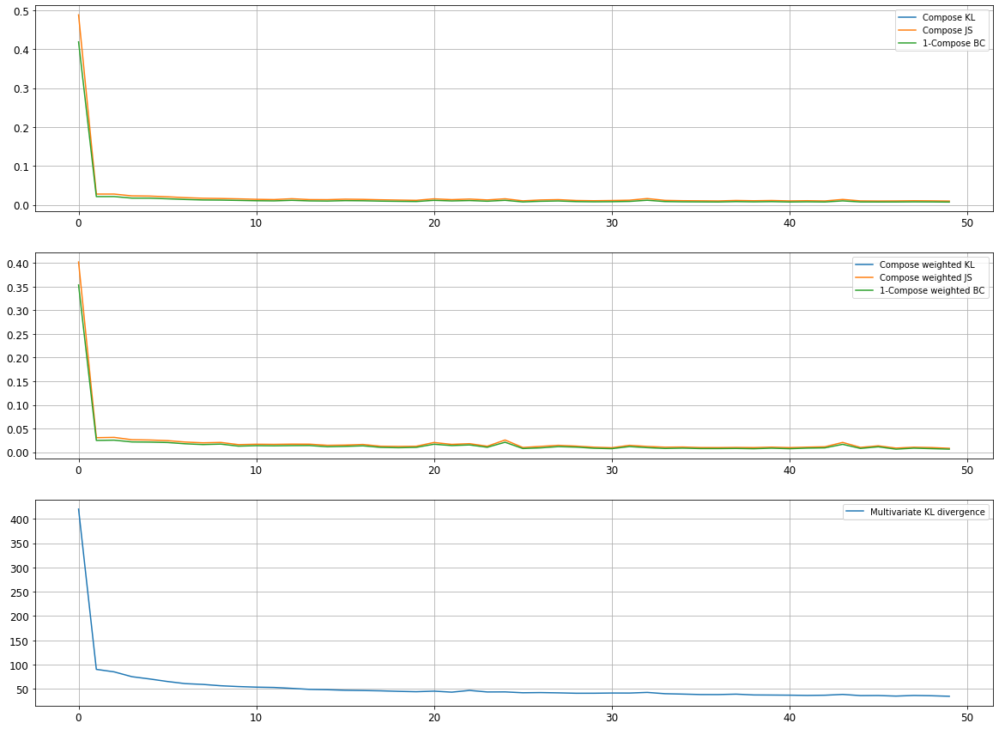

Epoch 9802/10000
discriminator loss: 0.031270 - generator loss: 9.873336 - 27s
Epoch 9803/10000
discriminator loss: 0.280031 - generator loss: 9.081107 - 28s
Epoch 9804/10000
discriminator loss: 0.035290 - generator loss: 9.489568 - 29s
Epoch 9805/10000
discriminator loss: 0.028049 - generator loss: 9.747307 - 29s
Epoch 9806/10000
discriminator loss: 0.027881 - generator loss: 9.908288 - 28s
Epoch 9807/10000
discriminator loss: 0.109353 - generator loss: 9.338562 - 29s
Epoch 9808/10000
discriminator loss: 0.051437 - generator loss: 9.513460 - 28s
Epoch 9809/10000
discriminator loss: 0.034878 - generator loss: 9.712469 - 29s
Epoch 9810/10000
discriminator loss: 0.249887 - generator loss: 8.914451 - 29s
Epoch 9811/10000
discriminator loss: 0.033826 - generator loss: 9.551462 - 28s
Epoch 9812/10000
discriminator loss: 0.024943 - generator loss: 9.933298 - 28s
Epoch 9813/10000
discriminator loss: 0.245619 - generator loss: 9.361402 - 28s
Epoch 9814/10000
discriminator loss: 0.041754 - gene

discriminator loss: 0.035104 - generator loss: 9.884501 - 28s
Epoch 9907/10000
discriminator loss: 0.041708 - generator loss: 9.845036 - 28s
Epoch 9908/10000
discriminator loss: 0.227134 - generator loss: 9.024891 - 28s
Epoch 9909/10000
discriminator loss: 0.028246 - generator loss: 9.707932 - 29s
Epoch 9910/10000
discriminator loss: 0.040847 - generator loss: 9.795244 - 28s
Epoch 9911/10000
discriminator loss: 0.155997 - generator loss: 9.140497 - 29s
Epoch 9912/10000
discriminator loss: 0.026340 - generator loss: 9.907969 - 28s
Epoch 9913/10000
discriminator loss: 0.226142 - generator loss: 9.139819 - 25s
Epoch 9914/10000
discriminator loss: 0.029166 - generator loss: 9.825572 - 23s
Epoch 9915/10000
discriminator loss: 0.031951 - generator loss: 9.789796 - 23s
Epoch 9916/10000
discriminator loss: 0.042149 - generator loss: 9.747200 - 23s
Epoch 9917/10000
discriminator loss: 0.157071 - generator loss: 9.210163 - 23s
Epoch 9918/10000
discriminator loss: 0.033635 - generator loss: 9.812

In [31]:
hist = train(train_dataset, model_name='dcgan-winit', epochs=10000)